In [1]:
%matplotlib notebook
import numpy as np
import matplotlib.pyplot as plt
from lcls_beamline_toolbox.xraybeamline2d import beam1d as beam, optics1d as optics, beamline1d as beamline

### Beam parameters

In [41]:
# number of sampling points
N = 2048
# photon energy in eV
E0 = 17795

# parameter dictionary. z_source is in LCLS coordinates (20 meters upstream of undulator exit)
beam_params = {
    'photonEnergy': E0,
    'N': N,
    'sigma_x': 15e-6,
    'sigma_y': 15e-6,
    'rangeFactor': 5,
    'scaleFactor': 10,
    'z_source': 630
}

### Define beamline

In [42]:
# crystal asymmetry angle
alphaAsym = 27.98*np.pi/180

# distance between crystal 2 and 1st CRL, 2nd CRL and crystal 4 
f1 = 9.8
# distance between CRLs and focus
f2 = 10

# crystal reflection hkl index
hkl = [6,6,0]

# initialize the beam
b1 = beam.Beam(beam_params=beam_params)

# viewing point upstream of monochromator
im0 = optics.PPM('im0', z=870, FOV=2e-3, N=256)
crl0 = optics.CRL('crl0', z=830, roc=435e-6, diameter=2e-3)

# first crystal: symmetric reflection
crystal1 = optics.Crystal('c1', hkl=hkl, length=10e-2, width=20e-3, z=880, E0=E0,
                          alphaAsym=0, orientation=0, pol='s', delta=0.e-6)

# second crystal: asymmetric reflection, orientation flipped relative to crystal1
crystal2 = optics.Crystal('c2', hkl=hkl, length=10e-2, width=20e-3, z=crystal1.z+.2, E0=E0,alphaAsym=alphaAsym, 
                          orientation=2,pol='s', delta=0e-6)
# printing crystal incidence and reflection angles for confirmation
print('crystal 2 incidence angle: {:.2f} degrees'.format(crystal2.alpha*180/np.pi))
print('crystal 2 exit angle: {:.2f} degrees'.format(crystal2.beta0*180/np.pi))

im_upstream = optics.PPM('im_upstream', z=crystal2.z + f1 - .1, FOV=2e-3, N=256)

# CRL with ~1 meter focal length (modeled as single element for now)
crl1 = optics.CRL('crl1', z=crystal2.z+f1, roc=21e-6, diameter=5e-3)

# viewing point downstream of first crl
im1 = optics.PPM('im1', z=crl1.z+.1,N=256,FOV=2e-3)

# viewing point at focus
focus = optics.PPM('focus', z=crl1.z+f2+.03, FOV=100e-6, N=256)

# slit at focus
slit = optics.Slit('slit', z=crl1.z+f2 + 1e-3+.03, x_width=10e-6, y_width=2e-3)

# second CRL with ~1 meter focal length, for collimation
crl2 = optics.CRL('crl2', z=crl1.z+2*f2, roc=21e-6, diameter=5e-3)

# third crystal, symmetric reflection, same orientation as crystal2
crystal3 = optics.Crystal('c3', hkl=hkl, length=10e-2, width=10e-3, z=crl2.z+2, E0=E0,alphaAsym=0, orientation=2,
                         asym_type='emergence',pol='s')

# fourth crystal, asymmetric reflection, same orientation as crystal1
crystal4 = optics.Crystal('c4', hkl=hkl, length=10e-2, width=10e-3, z=crl2.z+2 + (f1-2)*np.cos(crystal1.beta0*2), E0=E0,alphaAsym=-alphaAsym, 
                          asym_type='emergence', orientation=0,pol='s')

# viewing point just downstream of monochromator
im2 = optics.PPM('im2', z=crystal4.z+.1, FOV=2e-3, N=256)

# list of devices to propagate through
devices = [crl0,im0,crystal1,crystal2,im_upstream, im1, crl1, focus, slit, crl2, crystal3, crystal4, im2]
# devices = [im0,crystal1,crystal2,im_upstream, im1, crl1, focus, crl2, crystal3, crystal4, im2]

# initialize beamline
mono_beamline = beamline.Beamline(devices)

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145623718254422
10.145623718254422
x is focused
y is focused
b 1.00
b 10.01
crystal 2 incidence angle: 60.96 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.10
after c1: 1.1511
after c2: -0.0002
after c3: -1.1513
after c4: -0.0002


In [43]:
print('crystal 2 incidence angle: {:.2f} degrees'.format(crystal2.alpha*180/np.pi))
print('crystal 2 exit angle: {:.2f} degrees'.format(crystal2.beta0*180/np.pi))

crystal 2 incidence angle: 60.96 degrees
crystal 2 exit angle: 5.01 degrees


### Propagation through monochromator at central photon energy

FWHM in x: 349.36756845025576 microns
FWHM in y: 349.36756845025576 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145623718254422
10.145623718254422
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13932.993620
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706125156349.61 microns
zRy: 145496584.59 microns
remaining distance: 40000000.00 microns
goal for zx: 13972993620.17 microns
current zx: 13932993620.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13972.993620
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13972.993620
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 706125156349.6

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:3169: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(8, 8))


<IPython.core.display.Javascript object>


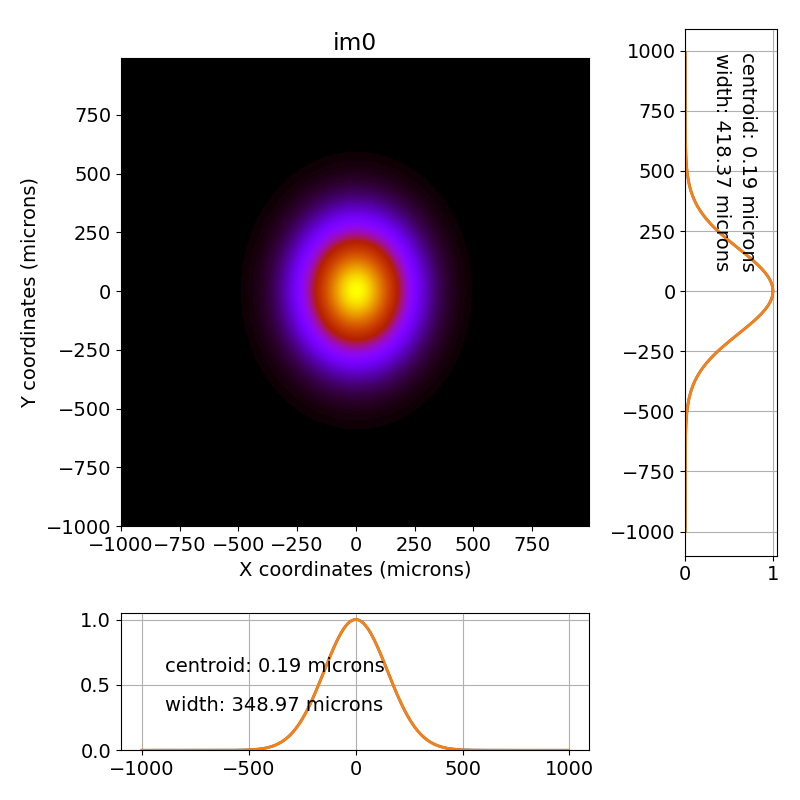

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:3169: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(8, 8))


<IPython.core.display.Javascript object>


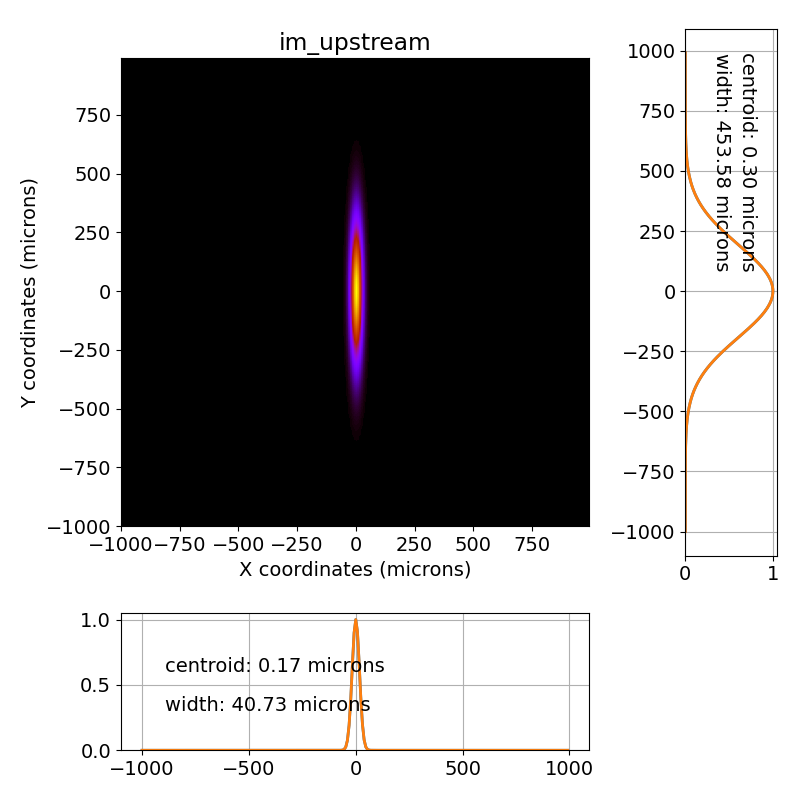

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:3169: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(8, 8))


<IPython.core.display.Javascript object>


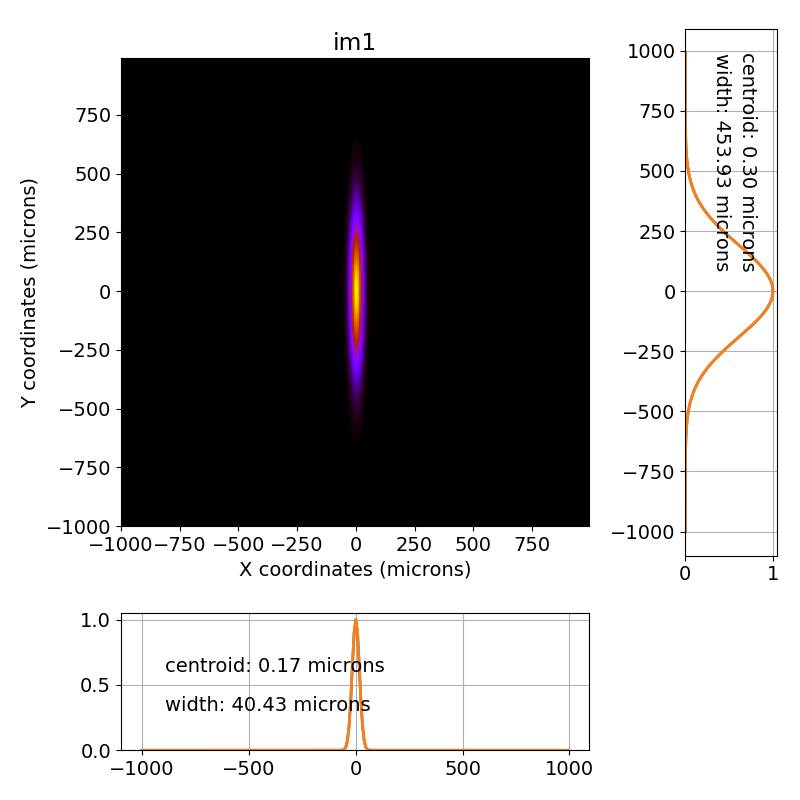

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:3169: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(8, 8))


<IPython.core.display.Javascript object>


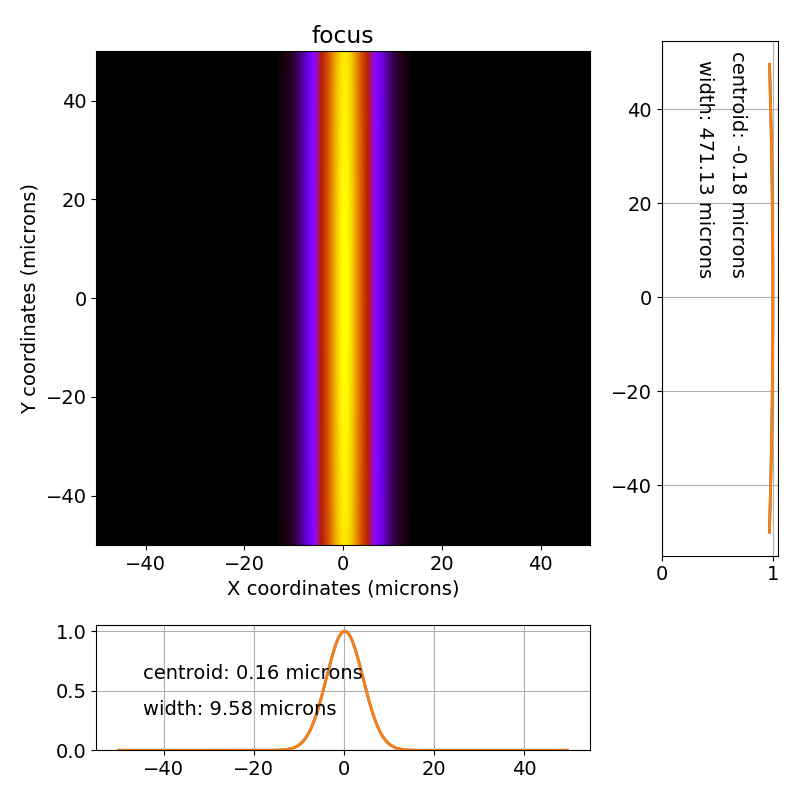

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:3169: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(8, 8))


<IPython.core.display.Javascript object>


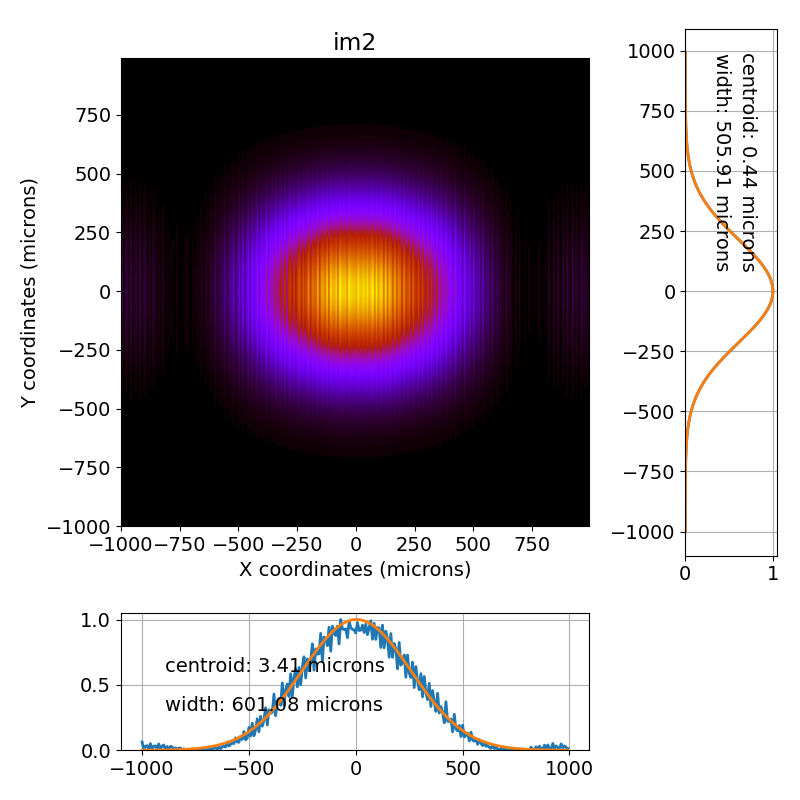

In [44]:
# propagate
b2 = mono_beamline.propagate_beamline(b1)

# view beam at various locations
mono_beamline.im0.view_beam()
mono_beamline.im_upstream.view_beam()
mono_beamline.im1.view_beam()
mono_beamline.focus.view_beam()
mono_beamline.im2.view_beam()

## Time-domain propagation

In [30]:
# reset central photon energy
beam_params['photonEnergy'] = 17795

# initialize pulse. tau sets transform-limited pulse duration in fs (FWHM). Time window is in fs.
pulse = beam.Pulse(beam_params=beam_params, tau=50, time_window=5000)

print('Number of spectral components: {:d}'.format(pulse.N))

Number of spectral components: 224


In [31]:
# propagate pulse through beamline. This will take a minute or so (depends on number of spectral 
# components which is proportional to the ratio time_window/tau).
pulse.propagate(beamline=mono_beamline, screen_names=['im0','focus','im2'])

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.14557069729145
10.14557069729145
x is focused
y is focused
FWHM in x: 349.3693895660758 microns
FWHM in y: 349.3693895660758 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.14557069729145
10.14557069729145
crl0
zRx: 7.07e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13943.077371
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707143940090.22 microns
zRy: 145495828.13 microns
remaining distance: 40000000.00 microns
goal for zx: 13983077370.70 microns
current zx: 13943077370.70 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13983.077371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13983.077371
zy: 

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:2982: RuntimeWarning: invalid value encountered in true_divide
  line_x = line_x / np.max(line_x)
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:2983: RuntimeWarning: invalid value encountered in true_divide
  line_y = line_y / np.max(line_y)
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:2990: RuntimeWarning: invalid value encountered in less
  norm_x[norm_x < 0] = 0
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:2996: RuntimeWarning: invalid value encountered in less
  norm_y[norm_y < 0] = 0
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:3018: RuntimeWarning: invalid value encountered in greater
  mask = line_x > .1
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:3032

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145571172815783
10.145571172815783
x is focused
y is focused
FWHM in x: 349.3693732331137 microns
FWHM in y: 349.3693732331137 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145571172815783
10.145571172815783
crl0
zRx: 7.07e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13942.986869
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707134793196.79 microns
zRy: 145495834.91 microns
remaining distance: 40000000.00 microns
goal for zx: 13982986868.61 microns
current zx: 13942986868.61 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13982.986869
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13982.986869


zRx: 4.13e+04
zRy: 1.45e+02
zx: 337.475907
zy: 282.490500
azimuth -1151.31 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8687e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41314523449.84 microns
zRy: 145495841.69 microns
remaining distance: 8004351.66 microns
goal for zx: 345480258.62 microns
current zx: 337475906.97 microns
goal for zy: 290494851.87 microns
current zy: 282490500.21 microns
current step size: 8004351.66 microns
x remains focused
y stays unfocused
zx: 345.480259
zy: 290.494852
azimuth -1151.31 mrad
c4
[-2.80985277e-08  0.00000000e+00  5.05998535e-08]
Calculated distance to focus: -34785.276507
zRx: 4.36e+06
zRy: 1.45e+02
zx: 34809.685572
zy: 290.494852
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8687e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.91
zRx: 4362551322827.28 microns
zRy: 145495841.69 microns
remaining distance: 99900.94 microns


Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: 34808.252556
zy: 290.594751
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145573074913111
10.145573074913111
x is focused
y is focused
FWHM in x: 349.369307901281 microns
FWHM in y: 349.369307901281 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145573074913111
10.145573074913111
crl0
zRx: 7.07e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13942.624872
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707098207402.09 microns
zRy: 145495862.05 microns
remaining distance: 40000000.00 microns
goal for zx: 13982624872.01 microns
current zx: 1

Calculated distance to focus: -13992.443881
zRx: 7.08e+05
zRy: 1.45e+02
zx: 13992.443882
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 708091659779.40 microns
zRy: 145495875.62 microns
remaining distance: 490850.44 microns
goal for zx: 13992934732.16 microns
current zx: 13992443881.72 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13992.934732
zy: 250.490850
azimuth 1151.13 mrad
c2
[-2.85412461e-05  0.00000000e+00  2.50146714e-06]
Calculated distance to focus: -139.601938
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.556295
zy: 250.490850
azimuth -0.18 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4644e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7064842686.75 microns
zRy: 145495875.62 microns
rem

zx: 13992.753746
zy: 250.490850
azimuth 1151.13 mrad
c2
[-2.79949113e-05  0.00000000e+00  2.45359194e-06]
Calculated distance to focus: -139.600133
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.555364
zy: 250.490850
azimuth -0.18 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4644e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7064660123.83 microns
zRy: 145495889.19 microns
remaining distance: 9900000.17 microns
goal for zx: 149455364.43 microns
current zx: 139555364.26 microns
goal for zy: 260390850.61 microns
current zy: 250490850.44 microns
current step size: 9900000.17 microns
x remains focused
y stays unfocused
zx: 149.455364
zy: 260.390851
azimuth -0.18 mrad
im_upstream
zx: 149.455364
zy: 260.390851
azimuth -0.18 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4642e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7064660123.83 microns
zRy: 145495889.19 microns
remaining distance: 10

zx: 149.454433
zy: 260.390851
azimuth -0.18 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4642e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7064477563.71 microns
zRy: 145495902.75 microns
remaining distance: 100000.00 microns
goal for zx: 149554433.33 microns
current zx: 149454433.33 microns
goal for zy: 260490850.61 microns
current zy: 260390850.61 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 149.554433
zy: 260.490851
azimuth -0.18 mrad
crl1
zRx: 3.99e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482272
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4639e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39856913.13 microns
zRy: 145495902.75 microns
remaining distance: 100000.00 microns
goal for zx: -10382272.41 microns
current zx: -10482272.41 microns
goal for zy: 260590850.61 microns
current zy: 260490850.

zx: 13981.900935
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13981.900935
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707025044350.51 microns
zRy: 145495916.32 microns
remaining distance: 10000000.00 microns
goal for zx: 13991900935.17 microns
current zx: 13981900935.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 13991.900935
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13991.900935
zRx: 7.08e+05
zRy: 1.45e+02
zx: 13991.900934
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 708036749136.65 microns
zRy: 145495916.32 microns
remaining distance: 490850.44 microns
goal for zx: 139

zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.552571
zy: 250.490850
azimuth -0.19 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4642e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7064112473.05 microns
zRy: 145495929.89 microns
remaining distance: 9900000.17 microns
goal for zx: 149452571.27 microns
current zx: 139552571.10 microns
goal for zy: 260390850.61 microns
current zy: 250490850.44 microns
current step size: 9900000.17 microns
x remains focused
y stays unfocused
zx: 149.452571
zy: 260.390851
azimuth -0.19 mrad
im_upstream
zx: 149.452571
zy: 260.390851
azimuth -0.19 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4640e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7064112473.05 microns
zRy: 145495929.89 microns
remaining distance: 100000.00 microns
goal for zx: 149552571.27 microns
current zx: 149452571.27 microns
goal for zy: 260490850.61 microns
current zy: 260390850.61 micron

zx: -0.452292
zy: 270.520851
azimuth -0.21 mrad
focus
Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: -0.452292
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4427e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39855571.51 microns
zRy: 145495943.46 microns
remaining distance: 1000.00 microns
goal for zx: -451292.27 microns
current zx: -452292.27 microns
goal for zy: 270521850.84 microns
current zy: 270520850.84 microns
current step size: 1000.00 microns
x remains focused
y stays unfocused
zx: -0.451292
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451292
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4215e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39855571.51 microns
zRy: 1

zx: 9.517701
zy: 280.490851
azimuth -0.21 mrad
crl2
zRx: 4.08e+04
zRy: 1.45e+02
focal length: 9.80
zx: 335.370855
zy: 280.490851
azimuth -0.24 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: 4.4168e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 3.20
zRx: 40796386990.50 microns
zRy: 145495957.03 microns
remaining distance: 1999703.64 microns
goal for zx: 337370558.97 microns
current zx: 335370855.33 microns
goal for zy: 282490554.71 microns
current zy: 280490851.06 microns
current step size: 1999703.64 microns
x remains focused
y stays unfocused
zx: 337.370559
zy: 282.490555
azimuth -0.24 mrad
c3
[-2.12559299e-05  0.00000000e+00  1.37914809e-05]
Calculated distance to focus: -337.370559
zRx: 4.13e+04
zRy: 1.45e+02
zx: 337.384328
zy: 282.490555
azimuth -1151.32 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41287717581.61 microns
zRy:

zx: 345.377812
zy: 290.494817
azimuth -1151.32 mrad
c4
[-2.32298102e-08  0.00000000e+00  4.18322632e-08]
Calculated distance to focus: -34774.961502
zRx: 4.36e+06
zRy: 1.45e+02
zx: 34795.126856
zy: 290.494817
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.91
zRx: 4358916062308.04 microns
zRy: 145495970.60 microns
remaining distance: 99918.13 microns
goal for zx: 34795226774.47 microns
current zx: 34795126856.34 microns
goal for zy: 290594734.70 microns
current zy: 290494816.57 microns
current step size: 99918.13 microns
x remains focused
y stays unfocused
zx: 34795.226774
zy: 290.594735
azimuth -0.22 mrad
im2
Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: 34795.226774
zy: 290.594735
azimuth -0.22 mrad
FWHM in x: 25.03158005400378

zx: 13990.905645
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13990.905645
zRx: 7.08e+05
zRy: 1.45e+02
zx: 13990.905646
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707936096858.01 microns
zRy: 145495990.95 microns
remaining distance: 490850.44 microns
goal for zx: 13991396496.32 microns
current zx: 13990905645.88 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13991.396496
zy: 250.490850
azimuth 1151.13 mrad
c2
[-2.38975131e-05  0.00000000e+00  2.09452823e-06]
Calculated distance to focus: -139.586592
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.548381
zy: 250.490850
azimuth -0.19 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4640e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta 

zx: 13991.215547
zy: 250.490850
azimuth 1151.13 mrad
c2
[-2.33512085e-05  0.00000000e+00  2.04665311e-06]
Calculated distance to focus: -139.584787
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.547450
zy: 250.490850
azimuth -0.19 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4639e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7063108578.71 microns
zRy: 145496004.52 microns
remaining distance: 9900000.18 microns
goal for zx: 149447450.58 microns
current zx: 139547450.40 microns
goal for zy: 260390850.62 microns
current zy: 250490850.44 microns
current step size: 9900000.18 microns
x remains focused
y stays unfocused
zx: 149.447451
zy: 260.390851
azimuth -0.19 mrad
im_upstream
zx: 149.447451
zy: 260.390851
azimuth -0.19 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4637e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7063108578.71 microns
zRy: 145496004.52 microns
remaining distance: 10

/Users/seaberg/beamline/lib/python3.7/site-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


zx: -0.452329
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4424e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39853112.16 microns
zRy: 145496018.09 microns
remaining distance: 1000.00 microns
goal for zx: -451329.08 microns
current zx: -452329.08 microns
goal for zy: 270521850.84 microns
current zy: 270520850.84 microns
current step size: 1000.00 microns
x remains focused
y stays unfocused
zx: -0.451329
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451329
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4213e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39853112.16 microns
zRy: 145496018.09 microns
remaining distance: 9969000.22 microns
goal for zx: 9517671.14 microns
current zx: -451329.08 microns
goal for zy: 280490851.07 microns
current zy: 270521850.84 microns
current step size: 9969000.22 microns
x remains foc

zRx: 4.36e+06
zRy: 1.45e+02
zx: 34788.233873
zy: 290.494800
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4357195437136.26 microns
zRy: 145496031.66 microns
remaining distance: 99926.28 microns
goal for zx: 34788333799.37 microns
current zx: 34788233873.09 microns
goal for zy: 290594726.12 microns
current zy: 290494799.85 microns
current step size: 99926.28 microns
x remains focused
y stays unfocused
zx: 34788.333799
zy: 290.594726
azimuth -0.22 mrad
im2
Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: 34788.333799
zy: 290.594726
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145585438545732
10.145585438545732
x i

zRx: 7.08e+05
zRy: 1.45e+02
zx: 13990.091420
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707853760474.15 microns
zRy: 145496052.01 microns
remaining distance: 490850.44 microns
goal for zx: 13990582270.05 microns
current zx: 13990091419.61 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13990.582270
zy: 250.490850
azimuth 1151.13 mrad
c2
[-2.14391700e-05  0.00000000e+00  1.87909025e-06]
Calculated distance to focus: -139.578469
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.544192
zy: 250.490850
azimuth -0.19 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4637e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7062469836.04 microns
zRy: 145496052.01 microns
remaining distance: 9900000.18 microns
goal for

zx: 149.543261
zy: 260.490851
azimuth -0.19 mrad
crl1
zRx: 3.99e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482353
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4633e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39851547.29 microns
zRy: 145496065.58 microns
remaining distance: 100000.00 microns
goal for zx: -10382352.73 microns
current zx: -10482352.73 microns
goal for zy: 260590850.62 microns
current zy: 260490850.62 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -10.382353
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382353
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4422e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39851547.29 microns
zRy: 145496065.58 microns
remaining distance: 9930000.22 microns
goal for zx: -452352.51 microns
current zx: -10382352.73 microns
goal 

zx: 337.276325
zy: 282.490612
azimuth -0.23 mrad
c3
[-1.71191158e-05  0.00000000e+00  1.11074526e-05]
Calculated distance to focus: -337.276325
zRx: 4.13e+04
zRy: 1.45e+02
zx: 337.287411
zy: 282.490612
azimuth -1151.32 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41259359882.12 microns
zRy: 145496079.15 microns
remaining distance: 8004174.44 microns
goal for zx: 345291585.59 microns
current zx: 337287411.15 microns
goal for zy: 290494786.84 microns
current zy: 282490612.40 microns
current step size: 8004174.44 microns
x remains focused
y stays unfocused
zx: 345.291586
zy: 290.494787
azimuth -1151.32 mrad
c4
[-1.91276148e-08  0.00000000e+00  3.44450266e-08]
Calculated distance to focus: -34766.279636
zRx: 4.36e+06
zRy: 1.45e+02
zx: 34782.874053
zy: 290.494787
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect

zRx: 4.36e+06
zRy: 1.45e+02
zx: 34781.342939
zy: 290.494783
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4355475663017.77 microns
zRy: 145496092.72 microns
remaining distance: 99934.42 microns
goal for zx: 34781442873.41 microns
current zx: 34781342938.99 microns
goal for zy: 290594717.55 microns
current zy: 290494783.13 microns
current step size: 99934.42 microns
x remains focused
y stays unfocused
zx: 34781.442873
zy: 290.594718
azimuth -0.22 mrad
im2
Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: 34781.442873
zy: 290.594718
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145589718264715
10.145589718264715
x i

zx: 13989.277294
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13989.277294
zRx: 7.08e+05
zRy: 1.45e+02
zx: 13989.277296
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707771439223.32 microns
zRy: 145496113.07 microns
remaining distance: 490850.44 microns
goal for zx: 13989768146.08 microns
current zx: 13989277295.64 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13989.768146
zy: 250.490850
azimuth 1151.13 mrad
c2
[-1.89808987e-05  0.00000000e+00  1.66365245e-06]
Calculated distance to focus: -139.570347
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.540003
zy: 250.490850
azimuth -0.19 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4635e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta 

zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.539072
zy: 250.490850
azimuth -0.19 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4634e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7061466243.68 microns
zRy: 145496126.64 microns
remaining distance: 9900000.18 microns
goal for zx: 149439071.87 microns
current zx: 139539071.68 microns
goal for zy: 260390850.63 microns
current zy: 250490850.44 microns
current step size: 9900000.18 microns
x remains focused
y stays unfocused
zx: 149.439072
zy: 260.390851
azimuth -0.19 mrad
im_upstream
zx: 149.439072
zy: 260.390851
azimuth -0.19 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4633e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7061466243.68 microns
zRy: 145496126.64 microns
remaining distance: 100000.00 microns
goal for zx: 149539071.87 microns
current zx: 149439071.87 microns
goal for zy: 260490850.63 microns
current zy: 260390850.63 micron

zx: -0.452389
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4419e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39849088.51 microns
zRy: 145496140.21 microns
remaining distance: 1000.00 microns
goal for zx: -451389.32 microns
current zx: -452389.32 microns
goal for zy: 270521850.85 microns
current zy: 270520850.85 microns
current step size: 1000.00 microns
x remains focused
y stays unfocused
zx: -0.451389
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451389
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4208e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39849088.51 microns
zRy: 145496140.21 microns
remaining distance: 9969000.22 microns
goal for zx: 9517610.90 microns
current zx: -451389.32 microns
goal for zy: 280490851.08 microns
current zy: 270521850.85 microns
current step size: 9969000.22 microns
x remains foc

zRx: 4.12e+04
zRy: 1.45e+02
zx: 337.228210
zy: 282.490648
azimuth -1151.32 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41242042853.69 microns
zRy: 145496153.78 microns
remaining distance: 8004118.75 microns
goal for zx: 345232328.34 microns
current zx: 337228209.58 microns
goal for zy: 290494766.41 microns
current zy: 282490647.66 microns
current step size: 8004118.75 microns
x remains focused
y stays unfocused
zx: 345.232328
zy: 290.494766
azimuth -1151.32 mrad
c4
[-1.63061766e-08  0.00000000e+00  2.93641783e-08]
Calculated distance to focus: -34760.313218
zRx: 4.35e+06
zRy: 1.45e+02
zx: 34774.454084
zy: 290.494766
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4353756747148.52 microns
zRy: 145496153.78 microns
remaining distance: 99942.56 microns


zx: 34773.023410
zy: 290.594707
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145594949032361
10.145594949032361
x is focused
y is focused
FWHM in x: 349.36855658696794 microns
FWHM in y: 349.36855658696794 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145594949032361
10.145594949032361
crl0
zRx: 7.07e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13938.463262
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706677675248.78 microns
zRy: 145496174.13 microns
remaining distance: 40000000.00 microns
goal for zx: 13978463261.62 microns
current zx: 13938463261.62 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13978.463262
z

Calculated distance to focus: -13988.282378
zRx: 7.08e+05
zRy: 1.45e+02
zx: 13988.282377
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707670843190.32 microns
zRy: 145496187.70 microns
remaining distance: 490850.44 microns
goal for zx: 13988773227.62 microns
current zx: 13988282377.18 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13988.773228
zy: 250.490850
azimuth 1151.13 mrad
c2
[-1.59764425e-05  0.00000000e+00  1.40033983e-06]
Calculated distance to focus: -139.560421
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.534883
zy: 250.490850
azimuth -0.20 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4632e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7060645256.88 microns
zRy: 145496187.70 microns
rem

zRx: 7.08e+05
zRy: 1.45e+02
zx: 13988.101499
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707652555367.78 microns
zRy: 145496201.27 microns
remaining distance: 490850.44 microns
goal for zx: 13988592349.15 microns
current zx: 13988101498.71 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13988.592349
zy: 250.490850
azimuth 1151.13 mrad
c2
[-1.54301893e-05  0.00000000e+00  1.35246484e-06]
Calculated distance to focus: -139.558616
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.533952
zy: 250.490850
azimuth -0.20 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4631e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7060462830.60 microns
zRy: 145496201.27 microns
remaining distance: 9900000.19 microns
goal for

zx: -0.452426
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4416e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39846630.07 microns
zRy: 145496214.84 microns
remaining distance: 1000.00 microns
goal for zx: -451426.14 microns
current zx: -452426.14 microns
goal for zy: 270521850.86 microns
current zy: 270520850.86 microns
current step size: 1000.00 microns
x remains focused
y stays unfocused
zx: -0.451426
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451426
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4205e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39846630.07 microns
zRy: 145496214.84 microns
remaining distance: 9969000.22 microns
goal for zx: 9517574.09 microns
current zx: -451426.14 microns
goal for zy: 280490851.08 microns
current zy: 270521850.86 microns
current step size: 9969000.22 microns
x remains foc

zRx: 4.12e+04
zRy: 1.45e+02
zx: 337.169027
zy: 282.490683
azimuth -1151.33 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41224735317.67 microns
zRy: 145496228.41 microns
remaining distance: 8004063.07 microns
goal for zx: 345173089.76 microns
current zx: 337169026.69 microns
goal for zy: 290494745.98 microns
current zy: 282490682.91 microns
current step size: 8004063.07 microns
x remains focused
y stays unfocused
zx: 345.173090
zy: 290.494746
azimuth -1151.33 mrad
c4
[-1.34837779e-08  0.00000000e+00  2.42816000e-08]
Calculated distance to focus: -34754.348680
zRx: 4.35e+06
zRy: 1.45e+02
zx: 34766.037124
zy: 290.494746
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4351656997173.48 microns
zRy: 145496228.41 microns
remaining distance: 99952.52 microns


zx: 34764.607056
zy: 290.594697
azimuth -0.22 mrad
im2
zx: 34764.607056
zy: 290.594697
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.14560017980001
10.14560017980001
x is focused
y is focused
FWHM in x: 349.36837692533015 microns
FWHM in y: 349.36837692533015 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.14560017980001
10.14560017980001
crl0
zRx: 7.07e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13937.468462
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706577168927.32 microns
zRy: 145496248.76 microns
remaining distance: 40000000.00 microns
goal for zx: 13977468461.96 microns
current zx: 13937468461.96 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x b

crl0
zRx: 7.07e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13937.287605
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706558897359.89 microns
zRy: 145496262.33 microns
remaining distance: 40000000.00 microns
goal for zx: 13977287604.55 microns
current zx: 13937287604.55 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13977.287605
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13977.287605
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706558897359.89 microns
zRy: 145496262.33 microns
remaining distance: 10000000.00 microns
goal for zx: 13987287604.55 microns
current zx: 13977287604.55 microns
goal for zy: 250000000.00 mi

zRx: 7.08e+05
zRy: 1.45e+02
zx: 13987.106753
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707551985214.13 microns
zRy: 145496275.90 microns
remaining distance: 490850.44 microns
goal for zx: 13987597603.09 microns
current zx: 13987106752.65 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13987.597603
zy: 250.490850
azimuth 1151.13 mrad
c2
[-1.24258598e-05  0.00000000e+00  1.08915254e-06]
Calculated distance to focus: -139.548692
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.528832
zy: 250.490850
azimuth -0.20 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4628e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7059459601.14 microns
zRy: 145496275.90 microns
remaining distance: 9900000.20 microns
goal for

zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.527901
zy: 250.490850
azimuth -0.20 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4628e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7059277219.03 microns
zRy: 145496289.46 microns
remaining distance: 9900000.20 microns
goal for zx: 149427901.22 microns
current zx: 139527901.03 microns
goal for zy: 260390850.64 microns
current zy: 250490850.44 microns
current step size: 9900000.20 microns
x remains focused
y stays unfocused
zx: 149.427901
zy: 260.390851
azimuth -0.20 mrad
im_upstream
zx: 149.427901
zy: 260.390851
azimuth -0.20 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4626e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7059277219.03 microns
zRy: 145496289.46 microns
remaining distance: 100000.00 microns
goal for zx: 149527901.23 microns
current zx: 149427901.22 microns
goal for zy: 260490850.64 microns
current zy: 260390850.64 micron

zx: -10.382470
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4413e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39843725.10 microns
zRy: 145496303.03 microns
remaining distance: 9930000.22 microns
goal for zx: -452469.65 microns
current zx: -10382469.87 microns
goal for zy: 270520850.87 microns
current zy: 260590850.64 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452470
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452470
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4413e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39843725.10 microns
zRy: 145496303.03 microns
remaining distance: 1000.00 microns
goal for zx: -451469.65 microns
current zx: -452469.65 microns
goal for zy: 270521850.87 microns
current zy: 270520850.87 microns
current step size: 1000.00 microns
x remains

zx: -0.451476
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451476
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4201e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39843278.23 microns
zRy: 145496316.60 microns
remaining distance: 9969000.22 microns
goal for zx: 9517523.88 microns
current zx: -451476.34 microns
goal for zy: 280490851.09 microns
current zy: 270521850.87 microns
current step size: 9969000.22 microns
x remains focused
y stays unfocused
zx: 9.517524
zy: 280.490851
azimuth -0.21 mrad
crl2
zRx: 4.07e+04
zRy: 1.45e+02
focal length: 9.80
zx: 335.093360
zy: 280.490851
azimuth -0.22 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: 4.4157e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 3.20
zRx: 40715418996.14 microns
zRy: 145496316.60 microns
remaining distance: 1999873.48 microns
goal for zx: 337093233.58 microns
current zx: 335093360.10 microns
goal 

Calculated distance to focus: -337.082777
zRx: 4.12e+04
zRy: 1.45e+02
zx: 337.088354
zy: 282.490731
azimuth -1151.33 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41201149597.96 microns
zRy: 145496330.17 microns
remaining distance: 8003987.14 microns
goal for zx: 345092340.71 microns
current zx: 337088353.57 microns
goal for zy: 290494718.12 microns
current zy: 282490730.98 microns
current step size: 8003987.14 microns
x remains focused
y stays unfocused
zx: 345.092341
zy: 290.494718
azimuth -1151.33 mrad
c4
[-9.63350344e-09  0.00000000e+00  1.73480225e-08]
Calculated distance to focus: -34746.218322
zRx: 4.35e+06
zRy: 1.45e+02
zx: 34754.564507
zy: 290.494718
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4348795778494.18 microns
zRy: 145496330.17 mic

zRx: 4.35e+06
zRy: 1.45e+02
zx: 34753.035232
zy: 290.494714
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4348414455397.98 microns
zRy: 145496343.74 microns
remaining distance: 99967.90 microns
goal for zx: 34753135199.68 microns
current zx: 34753035231.79 microns
goal for zy: 290594682.30 microns
current zy: 290494714.41 microns
current step size: 99967.90 microns
x remains focused
y stays unfocused
zx: 34753.135200
zy: 290.594682
azimuth -0.22 mrad
im2
zx: 34753.135200
zy: 290.594682
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145607312664984
10.145607312664984
x is focused
y is focused
FWHM in x: 349.36813193248673 microns
FWHM in y: 349.36813193248673 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145607312664984
10.14560

zx: -10.382497
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4411e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39841937.67 microns
zRy: 145496357.31 microns
remaining distance: 9930000.22 microns
goal for zx: -452496.42 microns
current zx: -10382496.65 microns
goal for zy: 270520850.87 microns
current zy: 260590850.65 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452496
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452496
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4411e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39841937.67 microns
zRy: 145496357.31 microns
remaining distance: 1000.00 microns
goal for zx: -451496.42 microns
current zx: -452496.42 microns
goal for zy: 270521850.87 microns
current zy: 270520850.87 microns
current step size: 1000.00 microns
x remains

zx: -10.382503
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4410e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39841490.84 microns
zRy: 145496370.88 microns
remaining distance: 9930000.22 microns
goal for zx: -452503.12 microns
current zx: -10382503.34 microns
goal for zy: 270520850.87 microns
current zy: 260590850.65 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452503
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452503
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4410e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39841490.84 microns
zRy: 145496370.88 microns
remaining distance: 1000.00 microns
goal for zx: -451503.12 microns
current zx: -452503.12 microns
goal for zy: 270521850.87 microns
current zy: 270520850.87 microns
current step size: 1000.00 microns
x remains

zx: 34749.312537
zy: 290.594678
azimuth -0.22 mrad
im2
zx: 34749.312537
zy: 290.594678
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.14560969028664
10.14560969028664
x is focused
y is focused
FWHM in x: 349.36805026828216 microns
FWHM in y: 349.36805026828216 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.14560969028664
10.14560969028664
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13935.660099
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706394485217.65 microns
zRy: 145496384.45 microns
remaining distance: 40000000.00 microns
goal for zx: 13975660099.06 microns
current zx: 13935660099.06 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x b

zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.520920
zy: 250.490850
azimuth -0.20 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4624e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7057909513.09 microns
zRy: 145496391.23 microns
remaining distance: 9900000.21 microns
goal for zx: 149420920.10 microns
current zx: 139520919.90 microns
goal for zy: 260390850.65 microns
current zy: 250490850.44 microns
current step size: 9900000.21 microns
x remains focused
y stays unfocused
zx: 149.420920
zy: 260.390851
azimuth -0.20 mrad
im_upstream
zx: 149.420920
zy: 260.390851
azimuth -0.20 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4622e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7057909513.09 microns
zRy: 145496391.23 microns
remaining distance: 100000.00 microns
goal for zx: 149520920.10 microns
current zx: 149420920.10 microns
goal for zy: 260490850.65 microns
current zy: 260390850.65 micron

zx: -10.382517
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382517
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4409e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39840597.22 microns
zRy: 145496398.02 microns
remaining distance: 9930000.22 microns
goal for zx: -452516.50 microns
current zx: -10382516.73 microns
goal for zy: 270520850.87 microns
current zy: 260590850.65 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452517
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452517
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4409e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39840597.22 microns
zRy: 145496398.02 microns
remaining distance: 1000.00 microns
goal for zx: -451516.50 microns
current zx: -452516.50 microns
goal for zy: 270521850.87 microns
current zy: 270520850.87

Calculated distance to focus: -337.025276
zRx: 4.12e+04
zRy: 1.45e+02
zx: 337.029216
zy: 282.490766
azimuth -1151.33 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41183864715.46 microns
zRy: 145496404.80 microns
remaining distance: 8003931.46 microns
goal for zx: 345033147.24 microns
current zx: 337029215.78 microns
goal for zy: 290494697.70 microns
current zy: 282490766.24 microns
current step size: 8003931.46 microns
x remains focused
y stays unfocused
zx: 345.033147
zy: 290.494698
azimuth -1151.33 mrad
c4
[-6.8088335e-09  0.0000000e+00  1.2261354e-08]
Calculated distance to focus: -34740.258325
zRx: 4.35e+06
zRy: 1.45e+02
zx: 34746.154870
zy: 290.494698
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4346699051041.33 microns
zRy: 145496404.80 micron

zRx: 4.35e+06
zRy: 1.45e+02
zx: 34745.390501
zy: 290.494696
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4346508500470.10 microns
zRy: 145496411.58 microns
remaining distance: 99976.94 microns
goal for zx: 34745490478.34 microns
current zx: 34745390501.40 microns
goal for zy: 290594672.78 microns
current zy: 290494695.84 microns
current step size: 99976.94 microns
x remains focused
y stays unfocused
zx: 34745.490478
zy: 290.594673
azimuth -0.22 mrad
im2
zx: 34745.490478
zy: 290.594673
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.1456120679083
10.1456120679083
x is focused
y is focused
FWHM in x: 349.36796860411596 microns
FWHM in y: 349.36796860411596 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.1456120679083
10.14561206790

zx: 149.418593
zy: 260.390851
azimuth -0.21 mrad
im_upstream
zx: 149.418593
zy: 260.390851
azimuth -0.21 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4620e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7057453683.92 microns
zRy: 145496425.15 microns
remaining distance: 100000.00 microns
goal for zx: 149518593.14 microns
current zx: 149418593.14 microns
goal for zy: 260490850.65 microns
current zy: 260390850.65 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 149.518593
zy: 260.490851
azimuth -0.21 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482530
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4618e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39839703.64 microns
zRy: 145496425.15 microns
remaining distance: 100000.00 microns
goal for zx: -10382530.12 microns
current zx: -10482530.12 mic

zRx: 4.12e+04
zRy: 1.45e+02
zx: 337.007716
zy: 282.490779
azimuth -1151.34 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41177581678.99 microns
zRy: 145496431.94 microns
remaining distance: 8003911.21 microns
goal for zx: 345011627.07 microns
current zx: 337007715.86 microns
goal for zy: 290494690.27 microns
current zy: 282490779.06 microns
current step size: 8003911.21 microns
x remains focused
y stays unfocused
zx: 345.011627
zy: 290.494690
azimuth -1151.34 mrad
c4
[-5.78144255e-09  0.00000000e+00  1.04112274e-08]
Calculated distance to focus: -34738.091530
zRx: 4.35e+06
zRy: 1.45e+02
zx: 34743.097600
zy: 290.494690
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4345936924534.72 microns
zRy: 145496431.94 microns
remaining distance: 99979.65 microns


current step size: 8003906.15 microns
x remains focused
y stays unfocused
zx: 345.006247
zy: 290.494688
azimuth -1151.34 mrad
c4
[-5.52457491e-09  0.00000000e+00  9.94865990e-09]
Calculated distance to focus: -34737.549868
zRx: 4.35e+06
zRy: 1.45e+02
zx: 34742.333345
zy: 290.494688
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4345746418921.08 microns
zRy: 145496438.72 microns
remaining distance: 99980.56 microns
goal for zx: 34742433325.57 microns
current zx: 34742333345.01 microns
goal for zy: 290594668.97 microns
current zy: 290494688.41 microns
current step size: 99980.56 microns
x remains focused
y stays unfocused
zx: 34742.433326
zy: 290.594669
azimuth -0.22 mrad
im2
zx: 34742.433326
zy: 290.594669
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.1

global_x 0.44
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41172870219.44 microns
zRy: 145496452.29 microns
remaining distance: 8003896.03 microns
goal for zx: 344995488.55 microns
current zx: 336991592.52 microns
goal for zy: 290494684.70 microns
current zy: 282490788.67 microns
current step size: 8003896.03 microns
x remains focused
y stays unfocused
zx: 344.995489
zy: 290.494685
azimuth -1151.34 mrad
c4
[-5.01081587e-09  0.00000000e+00  9.02348218e-09]
Calculated distance to focus: -34736.466595
zRx: 4.35e+06
zRy: 1.45e+02
zx: 34740.804913
zy: 290.494685
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4345365439689.83 microns
zRy: 145496452.29 microns
remaining distance: 99982.37 microns
goal for zx: 34740904895.58 microns
current zx: 34740804913.21 microns
goal for zy: 2905

zx: 9.517450
zy: 280.490851
azimuth -0.21 mrad
crl2
zRx: 4.07e+04
zRy: 1.45e+02
focal length: 9.80
zx: 334.978299
zy: 280.490851
azimuth -0.22 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: 4.4152e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 3.20
zRx: 40681872334.95 microns
zRy: 145496465.86 microns
remaining distance: 1999943.98 microns
goal for zx: 336978243.05 microns
current zx: 334978299.07 microns
goal for zy: 282490795.08 microns
current zy: 280490851.10 microns
current step size: 1999943.98 microns
x remains focused
y stays unfocused
zx: 336.978243
zy: 282.490795
azimuth -0.22 mrad
c3
[-4.02087833e-06  0.00000000e+00  2.60892441e-06]
Calculated distance to focus: -336.978243
zRx: 4.12e+04
zRy: 1.45e+02
zx: 336.980845
zy: 282.490795
azimuth -1151.34 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41169729671.45 microns
zRy:

zx: 13974.394524
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13974.394524
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706266648873.65 microns
zRy: 145496479.43 microns
remaining distance: 10000000.00 microns
goal for zx: 13984394524.21 microns
current zx: 13974394524.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 13984.394524
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13984.394524
zRx: 7.07e+05
zRy: 1.45e+02
zx: 13984.394525
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707277811644.04 microns
zRy: 145496479.43 microns
remaining distance: 490850.44 microns
goal for zx: 139

zx: 34737.084263
zy: 290.594662
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145617298675946
10.145617298675946
x is focused
y is focused
FWHM in x: 349.3677889430854 microns
FWHM in y: 349.3677889430854 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145617298675946
10.145617298675946
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13934.213747
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706248389378.46 microns
zRy: 145496493.00 microns
remaining distance: 40000000.00 microns
goal for zx: 13974213746.57 microns
current zx: 13934213746.57 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13974.213747
zy:

Calculated distance to focus: -336.952119
zRx: 4.12e+04
zRy: 1.45e+02
zx: 336.953977
zy: 282.490811
azimuth -1151.34 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41161879630.70 microns
zRy: 145496499.78 microns
remaining distance: 8003860.60 microns
goal for zx: 344957837.72 microns
current zx: 336953977.12 microns
goal for zy: 290494671.70 microns
current zy: 282490811.10 microns
current step size: 8003860.60 microns
x remains focused
y stays unfocused
zx: 344.957838
zy: 290.494672
azimuth -1151.34 mrad
c4
[-3.21240912e-09  0.00000000e+00  5.78490944e-09]
Calculated distance to focus: -34732.675656
zRx: 4.34e+06
zRy: 1.45e+02
zx: 34735.456211
zy: 290.494672
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4344032345468.54 microns
zRy: 145496499.78 mic

zx: -0.451573
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4193e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39836799.83 microns
zRy: 145496513.35 microns
remaining distance: 9969000.22 microns
goal for zx: 9517426.82 microns
current zx: -451573.41 microns
goal for zy: 280490851.11 microns
current zy: 270521850.88 microns
current step size: 9969000.22 microns
x remains focused
y stays unfocused
zx: 9.517427
zy: 280.490851
azimuth -0.21 mrad
crl2
zRx: 4.07e+04
zRy: 1.45e+02
focal length: 9.80
zx: 334.941704
zy: 280.490851
azimuth -0.21 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: 4.4151e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 3.20
zRx: 40671206006.73 microns
zRy: 145496513.35 microns
remaining distance: 1999966.40 microns
goal for zx: 336941670.21 microns
current zx: 334941703.81 microns
goal for zy: 282490817.51 microns
current zy: 280490851.11

zx: -10.382580
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382580
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4404e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39836353.13 microns
zRy: 145496526.92 microns
remaining distance: 9930000.22 microns
goal for zx: -452580.10 microns
current zx: -10382580.32 microns
goal for zy: 270520850.88 microns
current zy: 260590850.66 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452580
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452580
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4404e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39836353.13 microns
zRy: 145496526.92 microns
remaining distance: 1000.00 microns
goal for zx: -451580.10 microns
current zx: -452580.10 microns
goal for zy: 270521850.88 microns
current zy: 270520850.88

zx: -10.382587
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382587
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4403e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39835906.45 microns
zRy: 145496540.49 microns
remaining distance: 9930000.22 microns
goal for zx: -452586.79 microns
current zx: -10382587.02 microns
goal for zy: 270520850.89 microns
current zy: 260590850.66 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452587
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452587
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4403e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39835906.45 microns
zRy: 145496540.49 microns
remaining distance: 1000.00 microns
goal for zx: -451586.79 microns
current zx: -452586.79 microns
goal for zy: 270521850.89 microns
current zy: 270520850.89

zx: -10.382594
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4403e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39835459.77 microns
zRy: 145496554.06 microns
remaining distance: 9930000.22 microns
goal for zx: -452593.49 microns
current zx: -10382593.71 microns
goal for zy: 270520850.89 microns
current zy: 260590850.66 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452593
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452593
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4403e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39835459.77 microns
zRy: 145496554.06 microns
remaining distance: 1000.00 microns
goal for zx: -451593.49 microns
current zx: -452593.49 microns
goal for zy: 270521850.89 microns
current zy: 270520850.89 microns
current step size: 1000.00 microns
x remains

zx: -0.452600
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452600
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4402e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39835013.11 microns
zRy: 145496567.63 microns
remaining distance: 1000.00 microns
goal for zx: -451600.18 microns
current zx: -452600.18 microns
goal for zy: 270521850.89 microns
current zy: 270520850.89 microns
current step size: 1000.00 microns
x remains focused
y stays unfocused
zx: -0.451600
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451600
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4191e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39835013.11 microns
zRy: 145496567.63 microns
remaining distance: 9969000.22 microns
goal for zx: 9517400.04 microns
current zx: -451600.18 microns
goal for zy: 280490851.11 microns
current zy: 270521850.89 micro

zx: 149.407890
zy: 260.390851
azimuth -0.21 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4614e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7055357363.73 microns
zRy: 145496581.19 microns
remaining distance: 100000.00 microns
goal for zx: 149507889.84 microns
current zx: 149407889.84 microns
goal for zy: 260490850.66 microns
current zy: 260390850.66 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 149.507890
zy: 260.490851
azimuth -0.21 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482607
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4612e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39834566.46 microns
zRy: 145496581.19 microns
remaining distance: 100000.00 microns
goal for zx: -10382607.10 microns
current zx: -10482607.10 microns
goal for zy: 260590850.67 microns
current zy: 260490850.

zx: -0.451610
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451610
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4191e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39834343.14 microns
zRy: 145496587.98 microns
remaining distance: 9969000.22 microns
goal for zx: 9517390.00 microns
current zx: -451610.23 microns
goal for zy: 280490851.11 microns
current zy: 270521850.89 microns
current step size: 9969000.22 microns
x remains focused
y stays unfocused
zx: 9.517390
zy: 280.490851
azimuth -0.21 mrad
crl2
zRx: 4.07e+04
zRy: 1.45e+02
focal length: 9.80
zx: 334.884212
zy: 280.490851
azimuth -0.21 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: 4.4148e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 3.20
zRx: 40654452228.05 microns
zRy: 145496587.98 microns
remaining distance: 2000001.65 microns
goal for zx: 336884214.05 microns
current zx: 334884212.40 microns
goal 

zx: 9.517383
zy: 280.490851
azimuth -0.21 mrad
crl2
zRx: 4.07e+04
zRy: 1.45e+02
focal length: 9.80
zx: 334.873761
zy: 280.490851
azimuth -0.21 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: 4.4148e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 3.20
zRx: 40651407045.85 microns
zRy: 145496601.55 microns
remaining distance: 2000008.05 microns
goal for zx: 336873769.34 microns
current zx: 334873761.29 microns
goal for zy: 282490859.17 microns
current zy: 280490851.11 microns
current step size: 2000008.05 microns
x remains focused
y stays unfocused
zx: 336.873769
zy: 282.490859
azimuth -0.21 mrad
c3
[ 5.74391620e-07  0.00000000e+00 -3.72693024e-07]
Calculated distance to focus: -336.873769
zRx: 4.11e+04
zRy: 1.45e+02
zx: 336.873398
zy: 282.490859
azimuth -1151.34 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41138341204.80 microns
zRy:

zRx: 4.11e+04
zRy: 1.45e+02
zx: 336.862657
zy: 282.490866
azimuth -1151.34 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41135204116.83 microns
zRy: 145496615.12 microns
remaining distance: 8003774.57 microns
goal for zx: 344866431.26 microns
current zx: 336862656.69 microns
goal for zy: 290494640.15 microns
current zy: 282490865.58 microns
current step size: 8003774.57 microns
x remains focused
y stays unfocused
zx: 344.866431
zy: 290.494640
azimuth -1151.34 mrad
c4
[ 1.15677112e-09  0.00000000e+00 -2.08311457e-09]
Calculated distance to focus: -34723.472239
zRx: 4.34e+06
zRy: 1.45e+02
zx: 34722.471609
zy: 290.494640
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4340796954206.87 microns
zRy: 145496615.12 microns
remaining distance: 100004.07 microns

FWHM in x: 349.3674459543601 microns
FWHM in y: 349.3674459543601 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145627284686906
10.145627284686906
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13932.315864
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706056707525.83 microns
zRy: 145496635.47 microns
remaining distance: 40000000.00 microns
goal for zx: 13972315864.50 microns
current zx: 13932315864.50 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13972.315864
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13972.315864
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706056707525.83 m

zx: 13982.135141
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13982.135141
zRx: 7.07e+05
zRy: 1.45e+02
zx: 13982.135141
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707049455711.58 microns
zRy: 145496649.04 microns
remaining distance: 490850.44 microns
goal for zx: 13982625990.95 microns
current zx: 13982135140.51 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13982.625991
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 2.59417876e-06  0.00000000e+00 -2.27404888e-07]
Calculated distance to focus: -139.499092
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.503236
zy: 250.490850
azimuth -0.21 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4614e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta 

zx: 34717.990584
zy: 290.594639
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145629186784236
10.145629186784236
x is focused
y is focused
FWHM in x: 349.3673806232509 microns
FWHM in y: 349.3673806232509 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145629186784236
10.145629186784236
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13931.954422
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706020205565.70 microns
zRy: 145496662.61 microns
remaining distance: 40000000.00 microns
goal for zx: 13971954421.76 microns
current zx: 13931954421.76 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13971.954422
zy:

Calculated distance to focus: -336.821555
zRx: 4.11e+04
zRy: 1.45e+02
zx: 336.819698
zy: 282.490891
azimuth -1151.34 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41122658837.99 microns
zRy: 145496669.39 microns
remaining distance: 8003734.08 microns
goal for zx: 344823432.22 microns
current zx: 336819698.14 microns
goal for zy: 290494625.30 microns
current zy: 282490891.21 microns
current step size: 8003734.08 microns
x remains focused
y stays unfocused
zx: 344.823432
zy: 290.494625
azimuth -1151.34 mrad
c4
[ 3.21365012e-09  0.00000000e+00 -5.78714454e-09]
Calculated distance to focus: -34719.142806
zRx: 4.34e+06
zRy: 1.45e+02
zx: 34716.363777
zy: 290.494625
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4339275473914.36 microns
zRy: 145496669.39 mic

zx: -0.452657
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452657
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4398e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39831216.95 microns
zRy: 145496682.96 microns
remaining distance: 1000.00 microns
goal for zx: -451657.09 microns
current zx: -452657.09 microns
goal for zy: 270521850.90 microns
current zy: 270520850.90 microns
current step size: 1000.00 microns
x remains focused
y stays unfocused
zx: -0.451657
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451657
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4187e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39831216.95 microns
zRy: 145496682.96 microns
remaining distance: 9969000.22 microns
goal for zx: 9517343.14 microns
current zx: -451657.09 microns
goal for zy: 280490851.12 microns
current zy: 270521850.90 micro

zx: 336.800674
zy: 282.490904
azimuth -0.21 mrad
c3
[ 3.79089431e-06  0.00000000e+00 -2.45972565e-06]
Calculated distance to focus: -336.800674
zRx: 4.11e+04
zRy: 1.45e+02
zx: 336.798223
zy: 282.490904
azimuth -1151.35 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41116388126.59 microns
zRy: 145496696.53 microns
remaining distance: 8003713.84 microns
goal for zx: 344801936.61 microns
current zx: 336798222.77 microns
goal for zy: 290494617.87 microns
current zy: 282490904.03 microns
current step size: 8003713.84 microns
x remains focused
y stays unfocused
zx: 344.801937
zy: 290.494618
azimuth -1151.35 mrad
c4
[ 4.24228042e-09  0.00000000e+00 -7.63950303e-09]
Calculated distance to focus: -34716.978484
zRx: 4.34e+06
zRy: 1.45e+02
zx: 34713.310464
zy: 290.494618
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect

zRx: 4.11e+04
zRy: 1.45e+02
zx: 336.787486
zy: 282.490910
azimuth -1151.35 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41113253167.54 microns
zRy: 145496710.10 microns
remaining distance: 8003703.72 microns
goal for zx: 344791189.44 microns
current zx: 336787485.72 microns
goal for zy: 290494614.16 microns
current zy: 282490910.44 microns
current step size: 8003703.72 microns
x remains focused
y stays unfocused
zx: 344.791189
zy: 290.494614
azimuth -1151.35 mrad
c4
[ 4.75664319e-09  0.00000000e+00 -8.56576798e-09]
Calculated distance to focus: -34715.896386
zRx: 4.34e+06
zRy: 1.45e+02
zx: 34711.783966
zy: 290.494614
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8685e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4338134803605.68 microns
zRy: 145496710.10 microns
remaining distance: 100016.73 microns

zx: 34710.357586
zy: 290.594629
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145633942027553
10.145633942027553
x is focused
y is focused
FWHM in x: 349.3672172955853 microns
FWHM in y: 349.3672172955853 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145633942027553
10.145633942027553
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13931.050897
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705928963078.22 microns
zRy: 145496730.45 microns
remaining distance: 40000000.00 microns
goal for zx: 13971050896.97 microns
current zx: 13931050896.97 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13971.050897
zy:

Calculated distance to focus: -13980.870206
zRx: 7.07e+05
zRy: 1.45e+02
zx: 13980.870207
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706921624941.19 microns
zRy: 145496744.02 microns
remaining distance: 490850.44 microns
goal for zx: 13981361056.97 microns
current zx: 13980870206.53 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13981.361057
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 6.41703330e-06  0.00000000e+00 -5.62527513e-07]
Calculated distance to focus: -139.486472
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.496722
zy: 250.490850
azimuth -0.22 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4610e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7053170738.39 microns
zRy: 145496744.02 microns
rem

Calculated distance to focus: -139.484670
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.495791
zy: 250.490850
azimuth -0.22 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4609e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7052988559.05 microns
zRy: 145496757.59 microns
remaining distance: 9900000.24 microns
goal for zx: 149395791.65 microns
current zx: 139495791.41 microns
goal for zy: 260390850.68 microns
current zy: 250490850.44 microns
current step size: 9900000.24 microns
x remains focused
y stays unfocused
zx: 149.395792
zy: 260.390851
azimuth -0.22 mrad
im_upstream
zx: 149.395792
zy: 260.390851
azimuth -0.22 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4607e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7052988559.05 microns
zRy: 145496757.59 microns
remaining distance: 100000.00 microns
goal for zx: 149495791.65 microns
current zx: 149395791.65 microns
goal for zy: 260490850.

zRx: 7.07e+05
zRy: 1.45e+02
zx: 13980.508838
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706885108159.87 microns
zRy: 145496771.16 microns
remaining distance: 490850.44 microns
goal for zx: 13980999688.56 microns
current zx: 13980508838.12 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13980.999689
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 7.50924555e-06  0.00000000e+00 -6.58276753e-07]
Calculated distance to focus: -139.482867
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.494861
zy: 250.490850
azimuth -0.22 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4609e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7052806386.11 microns
zRy: 145496771.16 microns
remaining distance: 9900000.24 microns
goal for

Calculated distance to focus: -34710.486987
zRx: 4.34e+06
zRy: 1.45e+02
zx: 34704.152990
zy: 290.494596
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4336234528394.90 microns
zRy: 145496777.94 microns
remaining distance: 100025.77 microns
goal for zx: 34704253016.13 microns
current zx: 34704152990.36 microns
goal for zy: 290594621.37 microns
current zy: 290494595.60 microns
current step size: 100025.77 microns
x remains focused
y stays unfocused
zx: 34704.253016
zy: 290.594621
azimuth -0.22 mrad
im2
zx: 34704.253016
zy: 290.594621
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145637746222201
10.145637746222201
x is focused
y is focused
FWHM in x: 349.3670866335635 microns
FWHM in y: 349.3670866335635 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergen

zx: 34702.727127
zy: 290.594619
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145638697270867
10.145638697270867
x is focused
y is focused
FWHM in x: 349.36705396807315 microns
FWHM in y: 349.36705396807315 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145638697270867
10.145638697270867
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13930.147489
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705837738319.58 microns
zRy: 145496798.30 microns
remaining distance: 40000000.00 microns
goal for zx: 13970147489.36 microns
current zx: 13930147489.36 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13970.147489
z

zRx: 4.34e+06
zRy: 1.45e+02
zx: 34701.101329
zy: 290.494588
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4335474716243.31 microns
zRy: 145496805.08 microns
remaining distance: 100029.39 microns
goal for zx: 34701201357.99 microns
current zx: 34701101328.61 microns
goal for zy: 290594617.57 microns
current zy: 290494588.18 microns
current step size: 100029.39 microns
x remains focused
y stays unfocused
zx: 34701.201358
zy: 290.594618
azimuth -0.22 mrad
im2
zx: 34701.201358
zy: 290.594618
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145639648319529
10.145639648319529
x is focused
y is focused
FWHM in x: 349.36702130258925 microns
FWHM in y: 349.36702130258925 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145639648319529
10.145

zRx: 4.11e+04
zRy: 1.45e+02
zx: 336.701614
zy: 282.490962
azimuth -1151.35 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41088185353.01 microns
zRy: 145496818.65 microns
remaining distance: 8003622.76 microns
goal for zx: 344705236.75 microns
current zx: 336701613.98 microns
goal for zy: 290494584.47 microns
current zy: 282490961.70 microns
current step size: 8003622.76 microns
x remains focused
y stays unfocused
zx: 344.705237
zy: 290.494584
azimuth -1151.35 mrad
c4
[ 8.87268981e-09  0.00000000e+00 -1.59779492e-08]
Calculated distance to focus: -34707.242091
zRx: 4.34e+06
zRy: 1.45e+02
zx: 34699.575620
zy: 290.494584
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4335094865495.89 microns
zRy: 145496818.65 microns
remaining distance: 100031.19 microns

zRx: 7.07e+05
zRy: 1.45e+02
zx: 13979.695828
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706802955810.09 microns
zRy: 145496832.22 microns
remaining distance: 490850.44 microns
goal for zx: 13980186678.52 microns
current zx: 13979695828.08 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13980.186679
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 9.96667131e-06  0.00000000e+00 -8.73712413e-07]
Calculated distance to focus: -139.474756
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.490673
zy: 250.490850
azimuth -0.22 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4606e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7051986676.12 microns
zRy: 145496832.22 microns
remaining distance: 9900000.24 microns
goal for

zx: 13969.515174
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13969.515174
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705773891534.81 microns
zRy: 145496845.79 microns
remaining distance: 10000000.00 microns
goal for zx: 13979515173.75 microns
current zx: 13969515173.75 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 13979.515174
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13979.515174
zRx: 7.07e+05
zRy: 1.45e+02
zx: 13979.515173
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706784701788.77 microns
zRy: 145496845.79 microns
remaining distance: 490850.44 microns
goal for zx: 139

zx: 149.489278
zy: 260.490851
azimuth -0.22 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482741
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4601e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39825635.87 microns
zRy: 145496852.57 microns
remaining distance: 100000.00 microns
goal for zx: -10382740.99 microns
current zx: -10482741.00 microns
goal for zy: 260590850.69 microns
current zy: 260490850.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -10.382741
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382741
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4391e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39825635.87 microns
zRy: 145496852.57 microns
remaining distance: 9930000.22 microns
goal for zx: -452740.77 microns
current zx: -10382740.99 microns
goal 

zx: 149.388347
zy: 260.390851
azimuth -0.22 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4603e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7051531336.92 microns
zRy: 145496866.14 microns
remaining distance: 100000.00 microns
goal for zx: 149488347.27 microns
current zx: 149388347.26 microns
goal for zy: 260490850.69 microns
current zy: 260390850.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 149.488347
zy: 260.490851
azimuth -0.22 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482748
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4601e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39825189.46 microns
zRy: 145496866.14 microns
remaining distance: 100000.00 microns
goal for zx: -10382747.69 microns
current zx: -10482747.69 microns
goal for zy: 260590850.69 microns
current zy: 260490850.

zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.487417
zy: 250.490850
azimuth -0.22 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4604e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7051349213.05 microns
zRy: 145496879.71 microns
remaining distance: 9900000.25 microns
goal for zx: 149387416.77 microns
current zx: 139487416.52 microns
goal for zy: 260390850.69 microns
current zy: 250490850.44 microns
current step size: 9900000.25 microns
x remains focused
y stays unfocused
zx: 149.387417
zy: 260.390851
azimuth -0.22 mrad
im_upstream
zx: 149.387417
zy: 260.390851
azimuth -0.22 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4602e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7051349213.05 microns
zRy: 145496879.71 microns
remaining distance: 100000.00 microns
goal for zx: 149487416.77 microns
current zx: 149387416.77 microns
goal for zy: 260490850.69 microns
current zy: 260390850.69 micron

zx: 149.386486
zy: 260.390851
azimuth -0.22 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4602e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7051167089.10 microns
zRy: 145496893.28 microns
remaining distance: 100000.00 microns
goal for zx: 149486486.23 microns
current zx: 149386486.23 microns
goal for zy: 260490850.69 microns
current zy: 260390850.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 149.486486
zy: 260.490851
azimuth -0.22 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482761
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4599e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39824296.68 microns
zRy: 145496893.28 microns
remaining distance: 100000.00 microns
goal for zx: -10382761.08 microns
current zx: -10482761.08 microns
goal for zy: 260590850.69 microns
current zy: 260490850.

zx: -10.382768
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382768
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4389e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39823850.31 microns
zRy: 145496906.85 microns
remaining distance: 9930000.22 microns
goal for zx: -452767.55 microns
current zx: -10382767.78 microns
goal for zy: 270520850.92 microns
current zy: 260590850.70 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452768
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452768
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4389e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39823850.31 microns
zRy: 145496906.85 microns
remaining distance: 1000.00 microns
goal for zx: -451767.55 microns
current zx: -452767.55 microns
goal for zy: 270521850.92 microns
current zy: 270520850.92

zx: -10.382774
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382774
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4388e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39823403.95 microns
zRy: 145496920.41 microns
remaining distance: 9930000.22 microns
goal for zx: -452774.25 microns
current zx: -10382774.47 microns
goal for zy: 270520850.92 microns
current zy: 260590850.70 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452774
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452774
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4388e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39823403.95 microns
zRy: 145496920.41 microns
remaining distance: 1000.00 microns
goal for zx: -451774.25 microns
current zx: -452774.25 microns
goal for zy: 270521850.92 microns
current zy: 270520850.92

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145648207757496
10.145648207757496
x is focused
y is focused
FWHM in x: 349.36672731350876 microns
FWHM in y: 349.36672731350876 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145648207757496
10.145648207757496
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13928.341026
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705655341970.71 microns
zRy: 145496933.98 microns
remaining distance: 40000000.00 microns
goal for zx: 13968341025.61 microns
current zx: 13928341025.61 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13968.341026
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13968.34102

zx: -0.451784
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451784
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4177e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39822734.43 microns
zRy: 145496940.77 microns
remaining distance: 9969000.22 microns
goal for zx: 9517215.93 microns
current zx: -451784.29 microns
goal for zy: 280490851.14 microns
current zy: 270521850.92 microns
current step size: 9969000.22 microns
x remains focused
y stays unfocused
zx: 9.517216
zy: 280.490851
azimuth -0.21 mrad
crl2
zRx: 4.06e+04
zRy: 1.45e+02
focal length: 9.80
zx: 334.612683
zy: 280.490851
azimuth -0.20 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: 4.4137e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 3.20
zRx: 40575376271.38 microns
zRy: 145496940.77 microns
remaining distance: 2000168.23 microns
goal for zx: 336612850.82 microns
current zx: 334612682.59 microns
goal 

zRx: 7.07e+05
zRy: 1.45e+02
zx: 13978.070097
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706638694618.46 microns
zRy: 145496954.34 microns
remaining distance: 490850.44 microns
goal for zx: 13978560947.31 microns
current zx: 13978070096.87 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13978.560947
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 1.48813076e-05  0.00000000e+00 -1.30458319e-06]
Calculated distance to focus: -139.458537
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.482299
zy: 250.490850
azimuth -0.23 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4601e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7050347623.50 microns
zRy: 145496954.34 microns
remaining distance: 9900000.25 microns
goal for

zx: 13967.889483
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705609753956.87 microns
zRy: 145496967.91 microns
remaining distance: 10000000.00 microns
goal for zx: 13977889482.87 microns
current zx: 13967889482.87 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 13977.889483
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13977.889483
zRx: 7.07e+05
zRy: 1.45e+02
zx: 13977.889483
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706620446914.31 microns
zRy: 145496967.91 microns
remaining distance: 490850.44 microns
goal for zx: 13978380333.88 microns
current zx: 13977889483.44 microns

zx: 13967.708874
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13967.708874
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705591519991.30 microns
zRy: 145496981.47 microns
remaining distance: 10000000.00 microns
goal for zx: 13977708873.98 microns
current zx: 13967708873.98 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 13977.708874
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13977.708874
zRx: 7.07e+05
zRy: 1.45e+02
zx: 13977.708875
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706602200000.48 microns
zRy: 145496981.47 microns
remaining distance: 490850.44 microns
goal for zx: 139

zRx: 4.33e+06
zRy: 1.45e+02
zx: 34680.513129
zy: 290.494538
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4330350342565.58 microns
zRy: 145496988.26 microns
remaining distance: 100053.79 microns
goal for zx: 34680613182.37 microns
current zx: 34680513128.57 microns
goal for zy: 290594591.87 microns
current zy: 290494538.08 microns
current step size: 100053.79 microns
x remains focused
y stays unfocused
zx: 34680.613182
zy: 290.594592
azimuth -0.22 mrad
im2
zx: 34680.613182
zy: 290.594592
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145652487476482
10.145652487476482
x is focused
y is focused
FWHM in x: 349.36658031915476 microns
FWHM in y: 349.36658031915476 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145652487476482
10.145

zx: 9.517186
zy: 280.490851
azimuth -0.21 mrad
crl2
zRx: 4.06e+04
zRy: 1.45e+02
focal length: 9.80
zx: 334.565729
zy: 280.490851
azimuth -0.19 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: 4.4136e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 3.20
zRx: 40561710761.88 microns
zRy: 145497001.83 microns
remaining distance: 2000197.06 microns
goal for zx: 336565925.63 microns
current zx: 334565728.57 microns
goal for zy: 282491048.21 microns
current zy: 280490851.15 microns
current step size: 2000197.06 microns
x remains focused
y stays unfocused
zx: 336.565926
zy: 282.491048
azimuth -0.19 mrad
c3
[ 1.41286142e-05  0.00000000e+00 -9.16748946e-06]
Calculated distance to focus: -336.565926
zRx: 4.10e+04
zRy: 1.45e+02
zx: 336.556796
zy: 282.491048
azimuth -1151.36 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41045928951.72 microns
zRy:

zx: 149.478112
zy: 260.490851
azimuth -0.23 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482821
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4594e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39820279.73 microns
zRy: 145497015.40 microns
remaining distance: 100000.00 microns
goal for zx: -10382821.34 microns
current zx: -10482821.34 microns
goal for zy: 260590850.70 microns
current zy: 260490850.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -10.382821
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382821
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4385e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39820279.73 microns
zRy: 145497015.40 microns
remaining distance: 9930000.22 microns
goal for zx: -452821.12 microns
current zx: -10382821.34 microns
goal 

zRx: 7.07e+05
zRy: 1.45e+02
zx: 13977.076780
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706538340892.95 microns
zRy: 145497028.96 microns
remaining distance: 490850.44 microns
goal for zx: 13977567630.17 microns
current zx: 13977076779.73 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13977.567630
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 1.78845551e-05  0.00000000e+00 -1.56789275e-06]
Calculated distance to focus: -139.448627
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.477181
zy: 250.490850
azimuth -0.23 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4598e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7049346216.33 microns
zRy: 145497028.96 microns
remaining distance: 9900000.26 microns
goal for

zRx: 7.07e+05
zRy: 1.45e+02
zx: 13976.896192
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706520097054.87 microns
zRy: 145497042.53 microns
remaining distance: 490850.44 microns
goal for zx: 13977387042.18 microns
current zx: 13976896191.74 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13977.387042
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 1.84305886e-05  0.00000000e+00 -1.61576718e-06]
Calculated distance to focus: -139.446825
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.476251
zy: 250.490850
azimuth -0.23 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4598e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7049164163.99 microns
zRy: 145497042.53 microns
remaining distance: 9900000.26 microns
goal for

zx: 149.475321
zy: 260.490851
azimuth -0.23 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482841
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4593e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39818940.96 microns
zRy: 145497056.10 microns
remaining distance: 100000.00 microns
goal for zx: -10382841.42 microns
current zx: -10482841.43 microns
goal for zy: 260590850.71 microns
current zy: 260490850.71 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -10.382841
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382841
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4383e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39818940.96 microns
zRy: 145497056.10 microns
remaining distance: 9930000.22 microns
goal for zx: -452841.20 microns
current zx: -10382841.42 microns
goal 

zx: -0.452848
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4382e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39818494.72 microns
zRy: 145497069.67 microns
remaining distance: 1000.00 microns
goal for zx: -451847.90 microns
current zx: -452847.90 microns
goal for zy: 270521850.93 microns
current zy: 270520850.93 microns
current step size: 1000.00 microns
x remains focused
y stays unfocused
zx: -0.451848
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451848
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4172e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39818494.72 microns
zRy: 145497069.67 microns
remaining distance: 9969000.22 microns
goal for zx: 9517152.33 microns
current zx: -451847.90 microns
goal for zy: 280490851.15 microns
current zy: 270521850.93 microns
current step size: 9969000.22 microns
x remains foc

zx: -10.382855
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382855
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4382e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39818048.50 microns
zRy: 145497083.24 microns
remaining distance: 9930000.22 microns
goal for zx: -452854.59 microns
current zx: -10382854.81 microns
goal for zy: 270520850.93 microns
current zy: 260590850.71 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452855
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452855
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4382e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39818048.50 microns
zRy: 145497083.24 microns
remaining distance: 1000.00 microns
goal for zx: -451854.59 microns
current zx: -452854.59 microns
goal for zy: 270521850.93 microns
current zy: 270520850.93

zx: 336.492955
zy: 282.491093
azimuth -0.19 mrad
c3
[ 1.73444706e-05  0.00000000e+00 -1.12541766e-05]
Calculated distance to focus: -336.492955
zRx: 4.10e+04
zRy: 1.45e+02
zx: 336.481750
zy: 282.491093
azimuth -1151.36 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41024040767.02 microns
zRy: 145497096.81 microns
remaining distance: 8003415.34 microns
goal for zx: 344485165.10 microns
current zx: 336481749.76 microns
goal for zy: 290494508.40 microns
current zy: 282491093.06 microns
current step size: 8003415.34 microns
x remains focused
y stays unfocused
zx: 344.485165
zy: 290.494508
azimuth -1151.36 mrad
c4
[ 1.94293455e-08  0.00000000e+00 -3.49883866e-08]
Calculated distance to focus: -34685.083797
zRx: 4.33e+06
zRy: 1.45e+02
zx: 34668.321421
zy: 290.494508
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect

zRx: 4.33e+06
zRy: 1.45e+02
zx: 34666.797912
zy: 290.494505
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4326938326685.84 microns
zRy: 145497110.38 microns
remaining distance: 100070.06 microns
goal for zx: 34666897982.40 microns
current zx: 34666797912.34 microns
goal for zy: 290594574.75 microns
current zy: 290494504.69 microns
current step size: 100070.06 microns
x remains focused
y stays unfocused
zx: 34666.897982
zy: 290.594575
azimuth -0.22 mrad
im2
Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: 34666.897982
zy: 290.594575
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145661046914448
10.145661046914448
x

zx: 13975.722485
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13975.722485
zRx: 7.06e+05
zRy: 1.45e+02
zx: 13975.722483
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706401529309.98 microns
zRy: 145497130.73 microns
remaining distance: 490850.44 microns
goal for zx: 13976213333.71 microns
current zx: 13975722483.27 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13976.213334
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 2.1979720e-05  0.0000000e+00 -1.9269508e-06]
Calculated distance to focus: -139.435116
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.470203
zy: 250.490850
azimuth -0.23 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4594e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 

zRx: 7.06e+05
zRy: 1.45e+02
zx: 13975.541933
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706383291014.14 microns
zRy: 145497144.30 microns
remaining distance: 490850.44 microns
goal for zx: 13976032783.10 microns
current zx: 13975541932.66 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13976.032783
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 2.25257270e-05  0.00000000e+00 -1.97482517e-06]
Calculated distance to focus: -139.433314
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.469273
zy: 250.490850
azimuth -0.23 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4594e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7047798946.20 microns
zRy: 145497144.30 microns
remaining distance: 9900000.27 microns
goal for

Calculated distance to focus: -34680.763309
zRx: 4.33e+06
zRy: 1.45e+02
zx: 34662.228022
zy: 290.494494
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4325801746599.57 microns
zRy: 145497151.08 microns
remaining distance: 100075.48 microns
goal for zx: 34662328097.30 microns
current zx: 34662228021.82 microns
goal for zy: 290594569.04 microns
current zy: 290494493.56 microns
current step size: 100075.48 microns
x remains focused
y stays unfocused
zx: 34662.328097
zy: 290.594569
azimuth -0.22 mrad
im2
Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: 34662.328097
zy: 290.594569
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 

focal length: 9.80
zx: 334.440578
zy: 280.490851
azimuth -0.19 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: 4.4131e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 3.20
zRx: 40525299243.78 microns
zRy: 145497164.65 microns
remaining distance: 2000273.93 microns
goal for zx: 336440851.66 microns
current zx: 334440577.73 microns
goal for zy: 282491125.09 microns
current zy: 280490851.16 microns
current step size: 2000273.93 microns
x remains focused
y stays unfocused
zx: 336.440852
zy: 282.491125
azimuth -0.19 mrad
c3
[ 1.96414171e-05  0.00000000e+00 -1.27446172e-05]
Calculated distance to focus: -336.440852
zRx: 4.10e+04
zRy: 1.45e+02
zx: 336.428164
zy: 282.491125
azimuth -1151.37 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8683e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 41008415780.46 microns
zRy: 145497164.65 microns
remaining distance: 8003364.76 microns
goal for zx: 344431

zRx: 4.33e+06
zRy: 1.45e+02
zx: 34659.181940
zy: 290.494486
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8684e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4325044236806.39 microns
zRy: 145497178.22 microns
remaining distance: 100079.10 microns
goal for zx: 34659282019.17 microns
current zx: 34659181940.07 microns
goal for zy: 290594565.24 microns
current zy: 290494486.14 microns
current step size: 100079.10 microns
x remains focused
y stays unfocused
zx: 34659.282019
zy: 290.594565
azimuth -0.22 mrad
im2
Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: 34659.282019
zy: 290.594565
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145665802157763
10.145665802157763
x

zRx: 7.06e+05
zRy: 1.45e+02
zx: 13974.819768
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706310343966.72 microns
zRy: 145497198.57 microns
remaining distance: 490850.44 microns
goal for zx: 13975310618.10 microns
current zx: 13974819767.66 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13975.310618
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 2.47097193e-05  0.00000000e+00 -2.16632256e-06]
Calculated distance to focus: -139.426110
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.465552
zy: 250.490850
azimuth -0.24 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4592e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7047070965.85 microns
zRy: 145497198.57 microns
remaining distance: 9900000.28 microns
goal for

zx: 13975.130091
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 2.52557085e-05  0.00000000e+00 -2.21419688e-06]
Calculated distance to focus: -139.424309
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.464621
zy: 250.490850
azimuth -0.24 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4591e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7046888988.21 microns
zRy: 145497212.14 microns
remaining distance: 9900000.28 microns
goal for zx: 149364621.53 microns
current zx: 139464621.25 microns
goal for zy: 260390850.72 microns
current zy: 250490850.44 microns
current step size: 9900000.28 microns
x remains focused
y stays unfocused
zx: 149.364622
zy: 260.390851
azimuth -0.24 mrad
im_upstream
zx: 149.364622
zy: 260.390851
azimuth -0.24 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4589e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7046888988.21 microns
zRy: 145497212.14 microns
remaining distance: 10

Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: -0.452925
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4376e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39813363.85 microns
zRy: 145497225.71 microns
remaining distance: 1000.00 microns
goal for zx: -451924.90 microns
current zx: -452924.90 microns
goal for zy: 270521850.95 microns
current zy: 270520850.95 microns
current step size: 1000.00 microns
x remains focused
y stays unfocused
zx: -0.451925
zy: 270.521851
azimuth -0.21 mrad
slit
zx: -0.451925
zy: 270.521851
azimuth -0.21 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4166e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39813363.85 microns
zRy: 145497225.71 microns
remaining distance: 9969000.22 mic

zRx: 4.10e+04
zRy: 1.45e+02
zx: 336.369238
zy: 282.491160
azimuth -1151.37 mrad
drift11
global_x 0.44
global_y 0.00
x intersect: -6.8683e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -5.06
zRx: 40991237356.98 microns
zRy: 145497239.28 microns
remaining distance: 8003309.12 microns
goal for zx: 344372547.39 microns
current zx: 336369238.27 microns
goal for zy: 290494469.45 microns
current zy: 282491160.33 microns
current step size: 8003309.12 microns
x remains focused
y stays unfocused
zx: 344.372547
zy: 290.494469
azimuth -1151.37 mrad
c4
[ 2.48415878e-08  0.00000000e+00 -4.47347592e-08]
Calculated distance to focus: -34673.744688
zRx: 4.32e+06
zRy: 1.45e+02
zx: 34652.329710
zy: 290.494469
azimuth -0.22 mrad
drift12
global_x -6.87
global_y 0.00
x intersect: -6.8683e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.90
zRx: 4323340443736.27 microns
zRy: 145497239.28 microns
remaining distance: 100087.23 microns

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145671032925412
10.145671032925412
x is focused
y is focused
FWHM in x: 349.3659433450558 microns
FWHM in y: 349.3659433450558 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145671032925412
10.145671032925412
crl0
zRx: 7.05e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13924.007424
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705217879773.97 microns
zRy: 145497259.63 microns
remaining distance: 40000000.00 microns
goal for zx: 13964007423.59 microns
current zx: 13924007423.59 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13964.007424
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13964.007424


Calculated distance to focus: -13973.826915
zRx: 7.06e+05
zRy: 1.45e+02
zx: 13973.826915
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706210060509.96 microns
zRy: 145497273.20 microns
remaining distance: 490850.44 microns
goal for zx: 13974317765.80 microns
current zx: 13973826915.36 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13974.317766
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 2.77126162e-05  0.00000000e+00 -2.42963123e-06]
Calculated distance to focus: -139.416204
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.460435
zy: 250.490850
azimuth -0.24 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4589e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7046070153.67 microns
zRy: 145497273.20 microns
rem

zx: 13963.646412
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705181442998.72 microns
zRy: 145497286.77 microns
remaining distance: 10000000.00 microns
goal for zx: 13973646411.81 microns
current zx: 13963646411.81 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 13973.646412
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13973.646412
zRx: 7.06e+05
zRy: 1.45e+02
zx: 13973.646413
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706191829511.73 microns
zRy: 145497286.77 microns
remaining distance: 490850.44 microns
goal for zx: 13974137262.97 microns
current zx: 13973646412.53 microns

zx: 149.358575
zy: 260.390851
azimuth -0.24 mrad
im_upstream
zx: 149.358575
zy: 260.390851
azimuth -0.24 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4585e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7045706265.35 microns
zRy: 145497300.34 microns
remaining distance: 100000.00 microns
goal for zx: 149458574.59 microns
current zx: 149358574.59 microns
goal for zy: 260490850.73 microns
current zy: 260390850.73 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 149.458575
zy: 260.490851
azimuth -0.24 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482962
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4583e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39810910.49 microns
zRy: 145497300.34 microns
remaining distance: 100000.00 microns
goal for zx: -10382961.95 microns
current zx: -10482961.95 mic

Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: 34644.818613
zy: 290.594547
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145674837120064
10.145674837120064
x is focused
y is focused
FWHM in x: 349.3658126839904 microns
FWHM in y: 349.3658126839904 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145674837120064
10.145674837120064
crl0
zRx: 7.05e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13923.285419
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705145009054.10 microns
zRy: 145497313.91 microns
remaining distance: 40000000.00 microns
goal for zx: 13963285418.75 microns
current zx:

zx: 13973.104929
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13973.104929
zRx: 7.06e+05
zRy: 1.45e+02
zx: 13973.104927
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706137140277.41 microns
zRy: 145497327.48 microns
remaining distance: 490850.44 microns
goal for zx: 13973595777.73 microns
current zx: 13973104927.29 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13973.595778
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 2.98964740e-05  0.00000000e+00 -2.62112827e-06]
Calculated distance to focus: -139.409001
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.456714
zy: 250.490850
azimuth -0.24 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4586e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta 

zx: 149.355784
zy: 260.390851
azimuth -0.24 mrad
im_upstream
zx: 149.355784
zy: 260.390851
azimuth -0.24 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4583e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7045160476.45 microns
zRy: 145497341.05 microns
remaining distance: 100000.00 microns
goal for zx: 149455783.79 microns
current zx: 149355783.79 microns
goal for zy: 260490850.73 microns
current zy: 260390850.73 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 149.455784
zy: 260.490851
azimuth -0.24 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482982
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4581e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39809572.44 microns
zRy: 145497341.05 microns
remaining distance: 100000.00 microns
goal for zx: -10382982.03 microns
current zx: -10482982.04 mic

### Visualize input

<IPython.core.display.Javascript object>


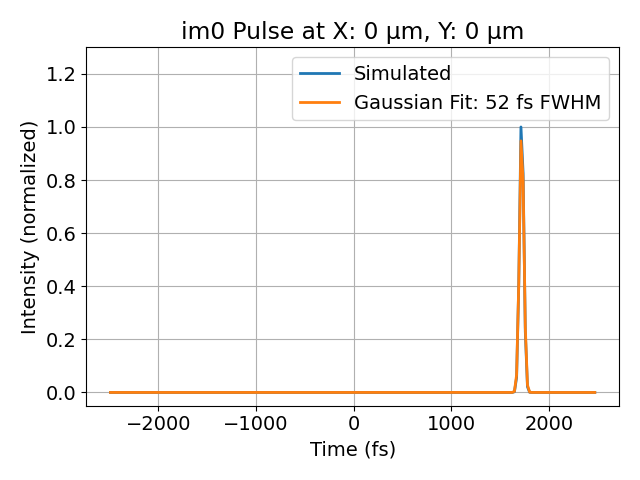

<IPython.core.display.Javascript object>


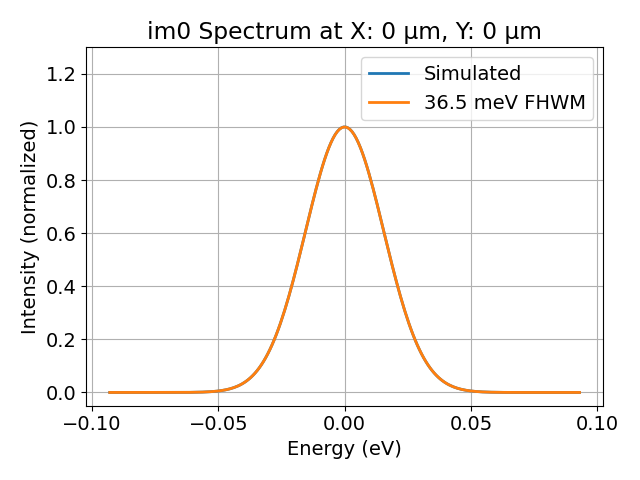

<IPython.core.display.Javascript object>


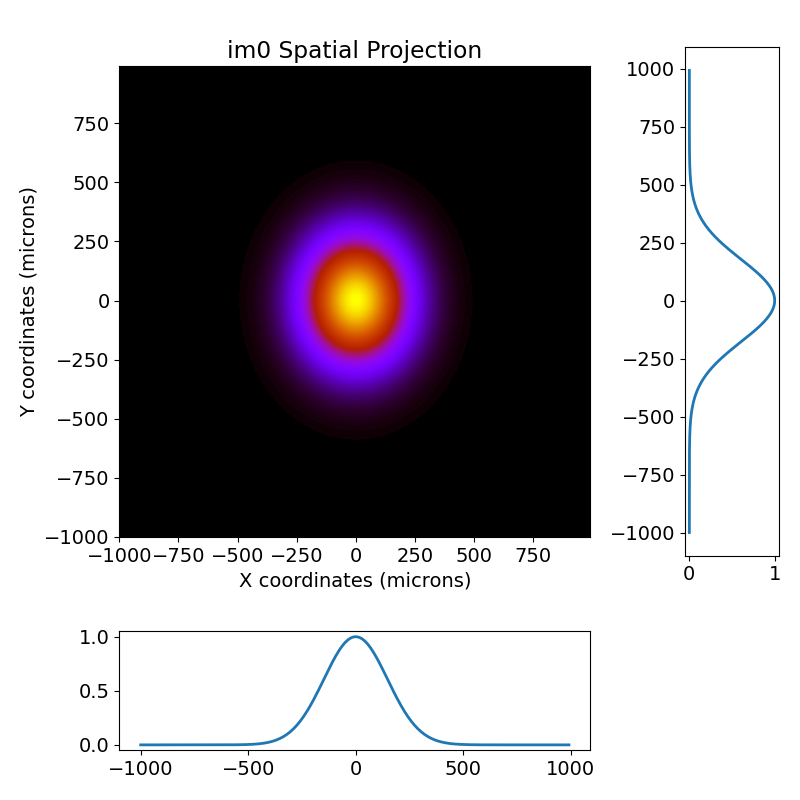

(<matplotlib.axes._subplots.AxesSubplot at 0x120412fd0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x120124358>)

In [32]:
fig_path = '/Users/Matt/OneDrive - SLAC National Accelerator Laboratory/Projects/Tunable Mono/figures/'

# plot input pulse at beam center
pulse.plot_pulse('im0')
# plt.savefig(fig_path+'input_pulse_slit.png')
# plot input spectrum at beam center
pulse.plot_spectrum('im0')
# plt.savefig(fig_path+'input_spectrum_slit.png')
# plot input beam spatial projection
pulse.imshow_projection('im0')
# plt.savefig(fig_path+'input_spatial_slit.png')

### Visualize focus properties

<IPython.core.display.Javascript object>


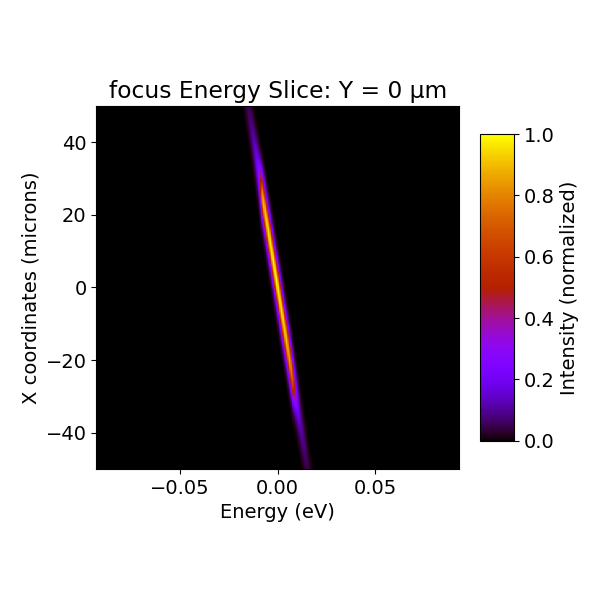

<IPython.core.display.Javascript object>


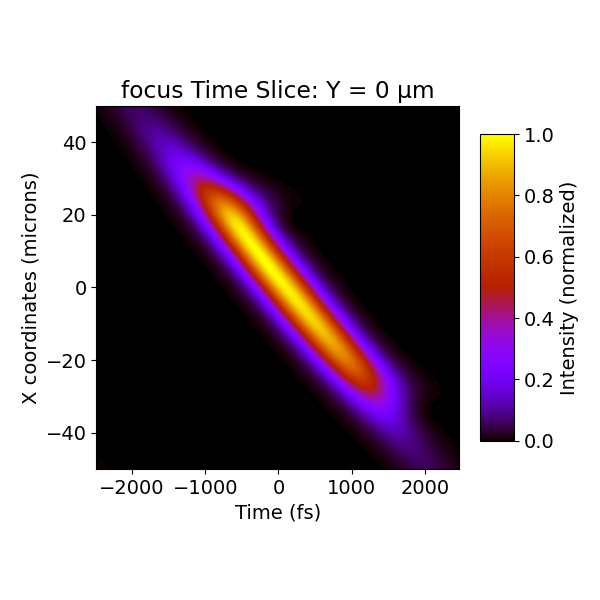

<IPython.core.display.Javascript object>


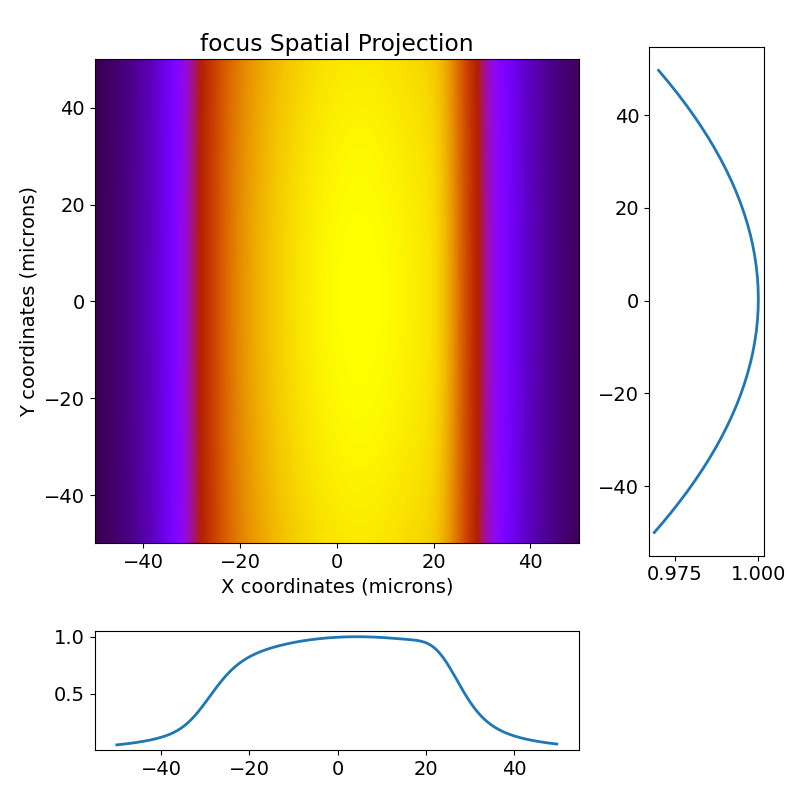

(<matplotlib.axes._subplots.AxesSubplot at 0x11fd2dac8>,
 <matplotlib.axes._subplots.AxesSubplot at 0x120304eb8>)

In [33]:
# plot energy slice of focus
pulse.imshow_energy_slice('focus')
# plt.savefig(fig_path+'option1_focus_energy.png')
# plot time slice of focus
pulse.imshow_time_slice('focus', shift=-1000)
# plt.savefig(fig_path+'option1_focus_time.png')
# show spatial projection
pulse.imshow_projection('focus')
# plt.savefig(fig_path+'option1_focus_spatial.png')

### Visualize output

<IPython.core.display.Javascript object>


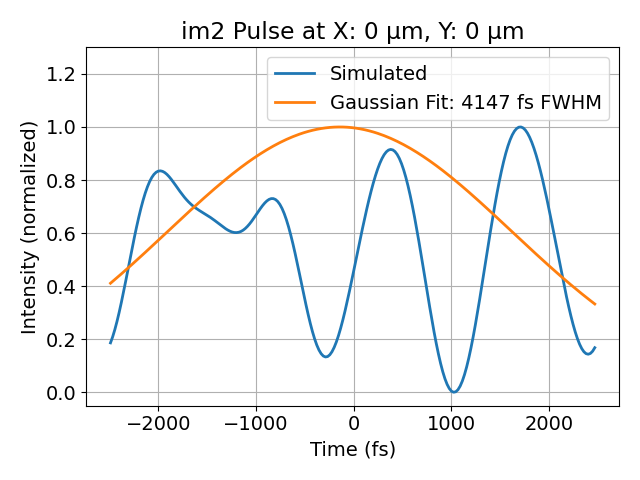

<IPython.core.display.Javascript object>


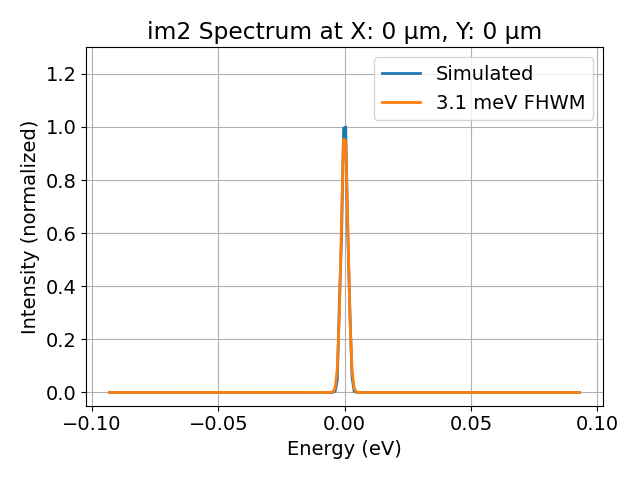

<IPython.core.display.Javascript object>


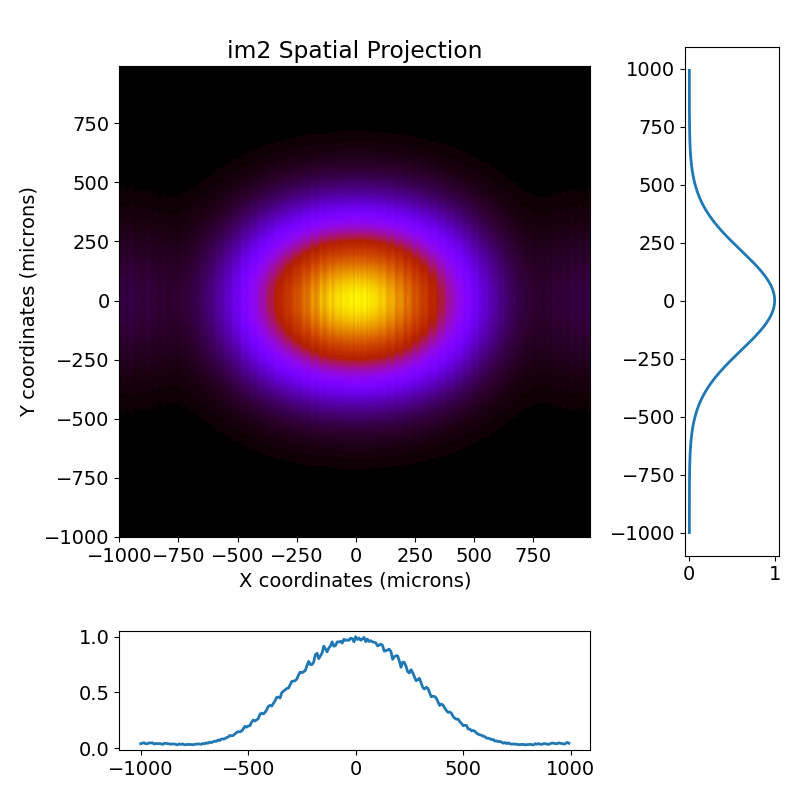

<IPython.core.display.Javascript object>


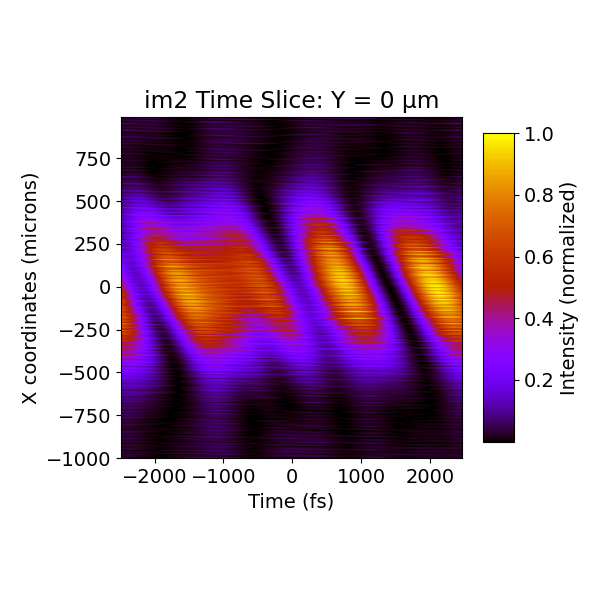

<IPython.core.display.Javascript object>


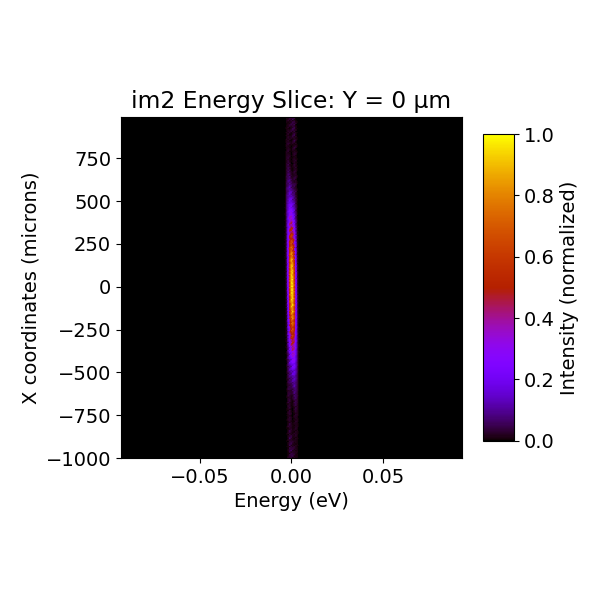

<IPython.core.display.Javascript object>


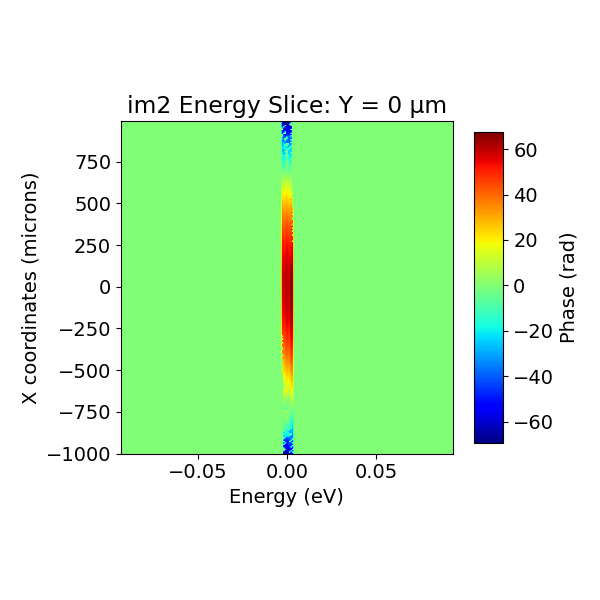

-3.3937907492095336
0.0031024436152313657
0.07146449848178867
17794.999986782695
0.06921154289095652


In [34]:
# plot output pulse at beam center
pulse.plot_pulse('im2', shift=0)
# plt.savefig(fig_path+'option1_output_pulse.png')
# plot output spectraum at beam center
pulse.plot_spectrum('im2')
# plt.savefig(fig_path+'option1_output_spectrum.png')
# show spatial projection of output
pulse.imshow_projection('im2')
# plt.savefig(fig_path+'option1_output_spatial.png')
# show time slice of output
pulse.imshow_time_slice('im2', shift=400)
# plt.savefig(fig_path+'option1_output_time.png')
# show energy slice of output
pulse.imshow_energy_slice('im2')
# plt.savefig(fig_path+'option1_output_energy.png')
# show spectral phase slice of output
pulse.imshow_energy_slice('im2', image_type='phase')

print(pulse.pulsefront_tilt('im2'))
print(pulse.pulse_bandwidth('im2'))
print(pulse.throughput('im0','im2'))
print(pulse.central_energy('im2'))

print(pulse.pulse_bandwidth('im2')/pulse.pulse_bandwidth('im0')*.95**4)

# No slit

In [35]:
# list of devices to propagate through
devices = [crl0,im0,crystal1,crystal2,im_upstream, im1, crl1, focus, crl2, crystal3, crystal4, im2]
# devices = [im0,crystal1,crystal2,im_upstream, im1, crl1, focus, crl2, crystal3, crystal4, im2]

# initialize beamline
mono_beamline = beamline.Beamline(devices)


after c1: 1.1511
after c2: -0.0002
after c3: -1.1513
after c4: -0.0002


## Time-domain propagation

In [36]:
# reset central photon energy
beam_params['photonEnergy'] = 17795

# initialize pulse. tau sets transform-limited pulse duration in fs (FWHM). Time window is in fs.
pulse = beam.Pulse(beam_params=beam_params, tau=40, time_window=1000)

print('Number of spectral components: {:d}'.format(pulse.N))

Number of spectral components: 56


In [37]:
# propagate pulse through beamline. This will take a minute or so (depends on number of spectral 
# components which is proportional to the ratio time_window/tau).
pulse.propagate(beamline=mono_beamline, screen_names=['im0','focus','im2'])

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.14555744205071
10.14555744205071
x is focused
y is focused
FWHM in x: 349.36984484800865 microns
FWHM in y: 349.36984484800865 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.14555744205071
10.14555744205071
crl0
zRx: 7.07e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13945.600589
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707398981356.28 microns
zRy: 145495639.01 microns
remaining distance: 40000000.00 microns
goal for zx: 13985600589.35 microns
current zx: 13945600589.35 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13985.600589
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13985.600589
zy

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:2982: RuntimeWarning: invalid value encountered in true_divide
  line_x = line_x / np.max(line_x)
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:2983: RuntimeWarning: invalid value encountered in true_divide
  line_y = line_y / np.max(line_y)
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:2990: RuntimeWarning: invalid value encountered in less
  norm_x[norm_x < 0] = 0
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:2996: RuntimeWarning: invalid value encountered in less
  norm_y[norm_y < 0] = 0
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:3018: RuntimeWarning: invalid value encountered in greater
  mask = line_x > .1
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/optics1d.py:3032

zRx: 3.99e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482159
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4649e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39864474.35 microns
zRy: 145495673.39 microns
remaining distance: 100000.00 microns
goal for zx: -10382159.28 microns
current zx: -10482159.28 microns
goal for zy: 260590850.60 microns
current zy: 260490850.59 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -10.382159
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.382159
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4438e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39864474.35 microns
zRy: 145495673.39 microns
remaining distance: 9930000.22 microns
goal for zx: -452159.06 microns
current zx: -10382159.28 microns
goal for zy: 270520850.82 microns
current zy: 260590850.60 

zRx: 4.13e+04
zRy: 1.45e+02
zx: 337.554973
zy: 282.490453
azimuth -1151.31 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: -6.8687e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -25.67
zRx: 41337674498.30 microns
zRy: 145495742.16 microns
remaining distance: 8004425.95 microns
goal for zx: 345559399.44 microns
current zx: 337554973.49 microns
goal for zy: 290494879.13 microns
current zy: 282490453.18 microns
current step size: 8004425.95 microns
x remains focused
y stays unfocused
zx: 345.559399
zy: 290.494879
azimuth -1151.31 mrad
c4
[-3.18558464e-08  0.00000000e+00  5.73660360e-08]
Calculated distance to focus: -34793.244937
zRx: 4.37e+06
zRy: 1.45e+02
zx: 34820.933098
zy: 290.494879
azimuth -0.22 mrad
drift11
global_x -6.87
global_y 0.00
x intersect: -6.8687e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 4.59
zRx: 4365360828245.17 microns
zRy: 145495742.16 microns
remaining distance: 99887.66 microns

FWHM in x: 349.3693481768682 microns
FWHM in y: 349.3693481768682 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145571902313337
10.145571902313337
crl0
zRx: 7.07e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13942.848032
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707120761376.56 microns
zRy: 145495845.32 microns
remaining distance: 40000000.00 microns
goal for zx: 13982848032.47 microns
current zx: 13942848032.47 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13982.848032
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13982.848032
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707120761376.56 m

zRx: 7.08e+05
zRy: 1.45e+02
zx: 13991.930756
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 708039765075.05 microns
zRy: 145495914.09 microns
remaining distance: 490850.44 microns
goal for zx: 13992421606.21 microns
current zx: 13991930755.77 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13992.421606
zy: 250.490850
azimuth 1151.13 mrad
c2
[-2.69922719e-05  0.00000000e+00  2.36573009e-06]
Calculated distance to focus: -139.596819
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.553656
zy: 250.490850
azimuth -0.18 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4643e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7064325095.27 microns
zRy: 145495914.09 microns
remaining distance: 9900000.17 microns
goal for

zx: -10.382312
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4426e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39854273.19 microns
zRy: 145495982.86 microns
remaining distance: 9930000.22 microns
goal for zx: -452311.70 microns
current zx: -10382311.92 microns
goal for zy: 270520850.84 microns
current zy: 260590850.62 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452312
zy: 270.520851
azimuth -0.21 mrad
focus
Some of the data contained NaNs or options were incompatible. Using second moment for width.
Some of the data contained NaNs or options were incompatible. Using second moment for width.
zx: -0.452312
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4214e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39854273.19 microns
zRy: 145495982.86 microns
remaining distance: 9970

zx: -10.382346
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4423e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39852007.08 microns
zRy: 145496051.63 microns
remaining distance: 9930000.22 microns
goal for zx: -452345.62 microns
current zx: -10382345.85 microns
goal for zy: 270520850.85 microns
current zy: 260590850.62 microns
current step size: 9930000.22 microns
x remains focused
y stays unfocused
zx: -0.452346
zy: 270.520851
azimuth -0.21 mrad
focus
zx: -0.452346
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4211e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39852007.08 microns
zRy: 145496051.63 microns
remaining distance: 9970000.22 microns
goal for zx: 9517654.60 microns
current zx: -452345.62 microns
goal for zy: 280490851.07 microns
current zy: 270520850.85 microns
current step size: 9970000.22 microns
x r

zx: -0.452380
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4209e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39849741.27 microns
zRy: 145496120.39 microns
remaining distance: 9970000.22 microns
goal for zx: 9517620.68 microns
current zx: -452379.55 microns
goal for zy: 280490851.08 microns
current zy: 270520850.85 microns
current step size: 9970000.22 microns
x remains focused
y stays unfocused
zx: 9.517621
zy: 280.490851
azimuth -0.21 mrad
crl2
zRx: 4.08e+04
zRy: 1.45e+02
focal length: 9.80
zx: 335.244728
zy: 280.490851
azimuth -0.23 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4163e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 16.24
zRx: 40759574243.91 microns
zRy: 145496120.39 microns
remaining distance: 1999780.81 microns
goal for zx: 337244508.43 microns
current zx: 335244727.62 microns
goal for zy: 282490631.89 microns
current zy: 280490851.08

zRx: 4.35e+06
zRy: 1.45e+02
zx: 34770.462601
zy: 290.494757
azimuth -0.22 mrad
drift11
global_x -6.87
global_y 0.00
x intersect: -6.8686e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 4.59
zRx: 4352760942487.86 microns
zRy: 145496189.16 microns
remaining distance: 99947.28 microns
goal for zx: 34770562548.34 microns
current zx: 34770462601.06 microns
goal for zy: 290594704.00 microns
current zy: 290494756.72 microns
current step size: 99947.28 microns
x remains focused
y stays unfocused
zx: 34770.562548
zy: 290.594704
azimuth -0.22 mrad
im2
zx: 34770.562548
zy: 290.594704
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145598412794822
10.145598412794822
x is focused
y is focused
FWHM in x: 349.3684376167924 microns
FWHM in y: 349.3684376167924 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145598412794822
10.1455984

zx: 13986.887885
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13986.887885
zRx: 7.08e+05
zRy: 1.45e+02
zx: 13986.887884
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707529858283.50 microns
zRy: 145496292.32 microns
remaining distance: 490850.44 microns
goal for zx: 13987378734.67 microns
current zx: 13986887884.23 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13987.378735
zy: 250.490850
azimuth 1151.13 mrad
c2
[-1.17647976e-05  0.00000000e+00  1.03121299e-06]
Calculated distance to focus: -139.546508
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.527705
zy: 250.490850
azimuth -0.20 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4628e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta 

zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.522988
zy: 250.490850
azimuth -0.20 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4625e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7058314607.09 microns
zRy: 145496361.09 microns
remaining distance: 9900000.20 microns
goal for zx: 149422987.93 microns
current zx: 139522987.73 microns
goal for zy: 260390850.64 microns
current zy: 250490850.44 microns
current step size: 9900000.20 microns
x remains focused
y stays unfocused
zx: 149.422988
zy: 260.390851
azimuth -0.20 mrad
im_upstream
zx: 149.422988
zy: 260.390851
azimuth -0.20 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4623e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7058314607.09 microns
zRy: 145496361.09 microns
remaining distance: 100000.00 microns
goal for zx: 149522987.93 microns
current zx: 149422987.93 microns
goal for zy: 260490850.65 microns
current zy: 260390850.64 micron

zx: -0.452532
zy: 270.520851
azimuth -0.21 mrad
drift8
global_x 0.44
global_y 0.00
x intersect: 4.4197e-01
component x: 4.4191e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39839548.79 microns
zRy: 145496429.86 microns
remaining distance: 9970000.22 microns
goal for zx: 9517468.01 microns
current zx: -452532.21 microns
goal for zy: 280490851.10 microns
current zy: 270520850.88 microns
current step size: 9970000.22 microns
x remains focused
y stays unfocused
zx: 9.517468
zy: 280.490851
azimuth -0.21 mrad
crl2
zRx: 4.07e+04
zRy: 1.45e+02
focal length: 9.80
zx: 335.006047
zy: 280.490851
azimuth -0.22 mrad
drift9
global_x 0.44
global_y 0.00
x intersect: 4.4153e-01
component x: 4.4148e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 16.24
zRx: 40689961045.96 microns
zRy: 145496429.86 microns
remaining distance: 1999926.97 microns
goal for zx: 337005974.13 microns
current zx: 335006047.15 microns
goal for zy: 282490778.07 microns
current zy: 280490851.10

zx: 34735.686400
zy: 290.594661
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145620103188765
10.145620103188765
x is focused
y is focused
FWHM in x: 349.36769261663807 microns
FWHM in y: 349.36769261663807 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145620103188765
10.145620103188765
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13933.680685
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706194548749.57 microns
zRy: 145496533.01 microns
remaining distance: 40000000.00 microns
goal for zx: 13973680685.27 microns
current zx: 13933680685.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13973.680685
z

Calculated distance to focus: -13982.764614
zRx: 7.07e+05
zRy: 1.45e+02
zx: 13982.764613
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 707113072764.16 microns
zRy: 145496601.78 microns
remaining distance: 490850.44 microns
goal for zx: 13983255463.21 microns
current zx: 13982764612.77 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13983.255463
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 6.91995695e-07  0.00000000e+00 -6.06594577e-08]
Calculated distance to focus: -139.505372
zRx: 7.06e+03
zRy: 1.45e+02
zx: 139.506478
zy: 250.490850
azimuth -0.21 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4615e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7055080880.86 microns
zRy: 145496601.78 microns
rem

zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.501761
zy: 250.490850
azimuth -0.22 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4613e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7054157304.71 microns
zRy: 145496670.55 microns
remaining distance: 9900000.23 microns
goal for zx: 149401761.26 microns
current zx: 139501761.03 microns
goal for zy: 260390850.67 microns
current zy: 250490850.44 microns
current step size: 9900000.23 microns
x remains focused
y stays unfocused
zx: 149.401761
zy: 260.390851
azimuth -0.22 mrad
im_upstream
zx: 149.401761
zy: 260.390851
azimuth -0.22 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4611e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7054157304.71 microns
zRy: 145496670.55 microns
remaining distance: 100000.00 microns
goal for zx: 149501761.26 microns
current zx: 149401761.26 microns
goal for zy: 260490850.67 microns
current zy: 260390850.67 micron

zx: 149.397045
zy: 260.390851
azimuth -0.22 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4608e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7053233880.08 microns
zRy: 145496739.32 microns
remaining distance: 100000.00 microns
goal for zx: 149497044.75 microns
current zx: 149397044.74 microns
goal for zy: 260490850.68 microns
current zy: 260390850.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 149.497045
zy: 260.490851
azimuth -0.22 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482685
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4606e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39829362.31 microns
zRy: 145496739.32 microns
remaining distance: 100000.00 microns
goal for zx: -10382685.12 microns
current zx: -10482685.12 microns
goal for zy: 260590850.68 microns
current zy: 260490850.

zRx: 7.07e+05
zRy: 1.45e+02
zx: 13980.017120
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706835420908.06 microns
zRy: 145496808.09 microns
remaining distance: 490850.44 microns
goal for zx: 13980507970.78 microns
current zx: 13980017120.34 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13980.507971
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 8.99550026e-06  0.00000000e+00 -7.88571827e-07]
Calculated distance to focus: -139.477962
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.492328
zy: 250.490850
azimuth -0.22 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4607e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7052310612.61 microns
zRy: 145496808.09 microns
remaining distance: 9900000.24 microns
goal for

zx: 13979.101531
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13979.101531
zRx: 7.07e+05
zRy: 1.45e+02
zx: 13979.101533
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706742906978.86 microns
zRy: 145496876.86 microns
remaining distance: 490850.44 microns
goal for zx: 13979592383.18 microns
current zx: 13979101532.74 microns
goal for zy: 250490850.44 microns
current zy: 250000000.00 microns
current step size: 490850.44 microns
x remains focused
y stays unfocused
zx: 13979.592383
zy: 250.490850
azimuth 1151.13 mrad
c2
[ 1.17631531e-05  0.00000000e+00 -1.03120882e-06]
Calculated distance to focus: -139.468827
zRx: 7.05e+03
zRy: 1.45e+02
zx: 139.487612
zy: 250.490850
azimuth -0.22 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4604e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta 

zx: 34689.267302
zy: 290.594603
azimuth -0.22 mrad
im2
zx: 34689.267302
zy: 290.594603
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145649023714022
10.145649023714022
x is focused
y is focused
FWHM in x: 349.3666992880603 microns
FWHM in y: 349.3666992880603 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145649023714022
10.145649023714022
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13928.186061
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705639696494.14 microns
zRy: 145496945.62 microns
remaining distance: 40000000.00 microns
goal for zx: 13968186061.05 microns
current zx: 13928186061.05 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x

zx: 34681.539931
zy: 290.594593
azimuth -0.22 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145653843801565
10.145653843801565
x is focused
y is focused
FWHM in x: 349.3665337338487 microns
FWHM in y: 349.3665337338487 microns
FWHM Divergence (x): 1.7 μrad
FWHM Divergence (y): 1.7 μrad
10.145653843801565
10.145653843801565
crl0
zRx: 7.06e+05
zRy: 1.45e+02
focal length: 202.91
zx: 13927.270712
zy: 200.000000
azimuth 0.00 mrad
drift1
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705547284848.71 microns
zRy: 145497014.39 microns
remaining distance: 40000000.00 microns
goal for zx: 13967270711.64 microns
current zx: 13927270711.64 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 13967.270712
zy:

zx: 13966.355483
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13966.355483
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705454891399.19 microns
zRy: 145497083.16 microns
remaining distance: 10000000.00 microns
goal for zx: 13976355482.52 microns
current zx: 13966355482.52 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 13976.355483
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13976.355483
zRx: 7.06e+05
zRy: 1.45e+02
zx: 13976.355483
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706465473511.52 microns
zRy: 145497083.16 microns
remaining distance: 490850.44 microns
goal for zx: 139

zx: 149.368750
zy: 260.390851
azimuth -0.23 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4591e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7047696571.56 microns
zRy: 145497151.93 microns
remaining distance: 100000.00 microns
goal for zx: 149468749.94 microns
current zx: 149368749.94 microns
goal for zy: 260490850.72 microns
current zy: 260390850.71 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 149.468750
zy: 260.490851
azimuth -0.23 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.482889
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4589e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39815789.67 microns
zRy: 145497151.93 microns
remaining distance: 100000.00 microns
goal for zx: -10382888.71 microns
current zx: -10482888.71 microns
goal for zy: 260590850.72 microns
current zy: 260490850.

/Users/seaberg/beamline/lib/python3.7/site-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


zRx: 4.10e+04
zRy: 1.45e+02
zx: 336.383907
zy: 282.491152
azimuth -1151.37 mrad
drift10
global_x 0.44
global_y 0.00
x intersect: -6.8683e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -25.64
zRx: 40995513313.69 microns
zRy: 145497220.70 microns
remaining distance: 8003322.97 microns
goal for zx: 344387230.03 microns
current zx: 336383907.06 microns
goal for zy: 290494474.53 microns
current zy: 282491151.56 microns
current step size: 8003322.97 microns
x remains focused
y stays unfocused
zx: 344.387230
zy: 290.494475
azimuth -1151.37 mrad
c4
[ 2.41355718e-08  0.00000000e+00 -4.34633646e-08]
Calculated distance to focus: -34675.223035
zRx: 4.32e+06
zRy: 1.45e+02
zx: 34654.414575
zy: 290.494475
azimuth -0.22 mrad
drift11
global_x -6.87
global_y 0.00
x intersect: -6.8683e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 4.58
zRx: 4323858805545.20 microns
zRy: 145497220.70 microns
remaining distance: 100084.75 micron

zx: 13963.153128
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 13963.153128
zy: 240.000000
azimuth 0.00 mrad
drift2
global_x 0.00
global_y 0.00
x intersect: 0.0000e+00
component x: 0.0000e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 705131657550.09 microns
zRy: 145497323.85 microns
remaining distance: 10000000.00 microns
goal for zx: 13973153127.68 microns
current zx: 13963153127.68 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 13973.153128
zy: 250.000000
azimuth 0.00 mrad
c1
[0. 0. 0.]
Calculated distance to focus: -13973.153128
zRx: 7.06e+05
zRy: 1.45e+02
zx: 13973.153128
zy: 250.000000
azimuth 1151.13 mrad
drift3
global_x 0.00
global_y 0.00
x intersect: 4.4826e-01
component x: 4.4826e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 706142008386.55 microns
zRy: 145497323.85 microns
remaining distance: 490850.44 microns
goal for zx: 139

zRx: 7.04e+03
zRy: 1.45e+02
zx: 139.452248
zy: 250.490850
azimuth -0.24 mrad
drift4
global_x 0.45
global_y 0.00
x intersect: 4.4584e-01
component x: 4.4616e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7044469017.76 microns
zRy: 145497392.62 microns
remaining distance: 9900000.30 microns
goal for zx: 149352247.84 microns
current zx: 139452247.55 microns
goal for zy: 260390850.74 microns
current zy: 250490850.44 microns
current step size: 9900000.30 microns
x remains focused
y stays unfocused
zx: 149.352248
zy: 260.390851
azimuth -0.24 mrad
im_upstream
zx: 149.352248
zy: 260.390851
azimuth -0.24 mrad
drift5
global_x 0.45
global_y 0.00
x intersect: 4.4581e-01
component x: 4.4614e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 0.00
zRx: 7044469017.76 microns
zRy: 145497392.62 microns
remaining distance: 100000.00 microns
goal for zx: 149452247.85 microns
current zx: 149352247.84 microns
goal for zy: 260490850.74 microns
current zy: 260390850.74 micron

zx: 149.447533
zy: 260.490851
azimuth -0.25 mrad
crl1
zRx: 3.98e+01
zRy: 1.45e+02
focal length: 9.80
zx: -10.483041
zy: 260.490851
azimuth -0.21 mrad
drift6
global_x 0.45
global_y 0.00
x intersect: 4.4576e-01
component x: 4.4612e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39805617.18 microns
zRy: 145497461.39 microns
remaining distance: 100000.00 microns
goal for zx: -10383041.42 microns
current zx: -10483041.43 microns
goal for zy: 260590850.75 microns
current zy: 260490850.75 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -10.383041
zy: 260.590851
azimuth -0.21 mrad
im1
zx: -10.383041
zy: 260.590851
azimuth -0.21 mrad
drift7
global_x 0.45
global_y 0.00
x intersect: 4.4367e-01
component x: 4.4402e-01
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: -0.00
zRx: 39805617.18 microns
zRy: 145497461.39 microns
remaining distance: 9930000.22 microns
goal for zx: -453041.20 microns
current zx: -10383041.42 microns
goal 

zx: 344.142833
zy: 290.494390
azimuth -1151.38 mrad
c4
[ 3.59024706e-08  0.00000000e+00 -6.46532110e-08]
Calculated distance to focus: -34650.615509
zRx: 4.32e+06
zRy: 1.45e+02
zx: 34619.714656
zy: 290.494390
azimuth -0.22 mrad
drift11
global_x -6.87
global_y 0.00
x intersect: -6.8683e+00
component x: -6.8685e+00
y intersect: 0.0000e+00
component y: 0.0000e+00
delta z: 4.58
zRx: 4315235378799.72 microns
zRy: 145497530.16 microns
remaining distance: 100125.96 microns
goal for zx: 34619814781.56 microns
current zx: 34619714655.61 microns
goal for zy: 290594515.91 microns
current zy: 290494389.95 microns
current step size: 100125.96 microns
x remains focused
y stays unfocused
zx: 34619.814782
zy: 290.594516
azimuth -0.22 mrad
im2
zx: 34619.814782
zy: 290.594516
azimuth -0.22 mrad


### Visualize input

<IPython.core.display.Javascript object>


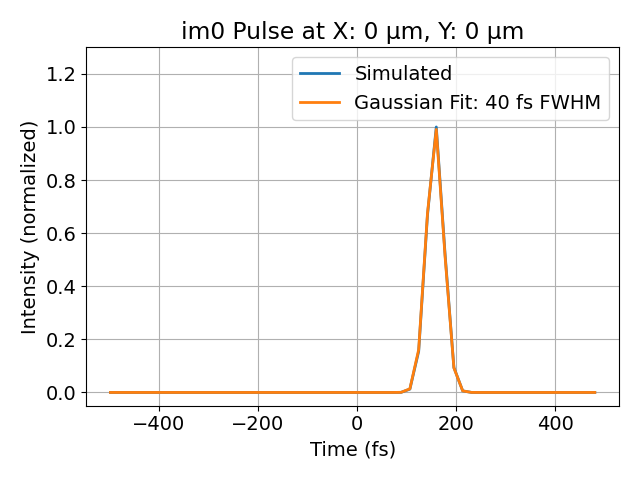

<IPython.core.display.Javascript object>


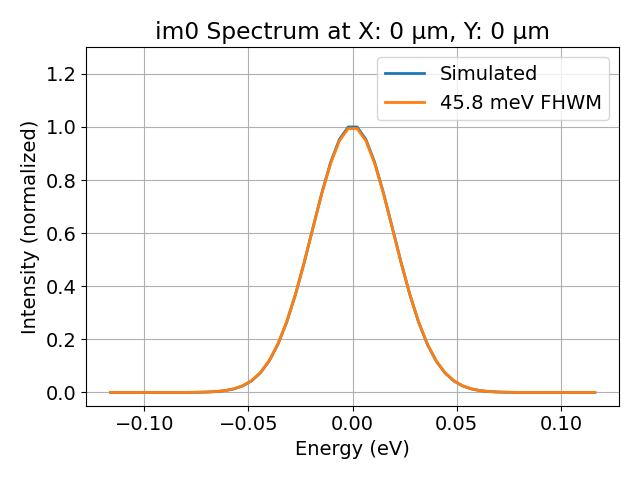

<IPython.core.display.Javascript object>


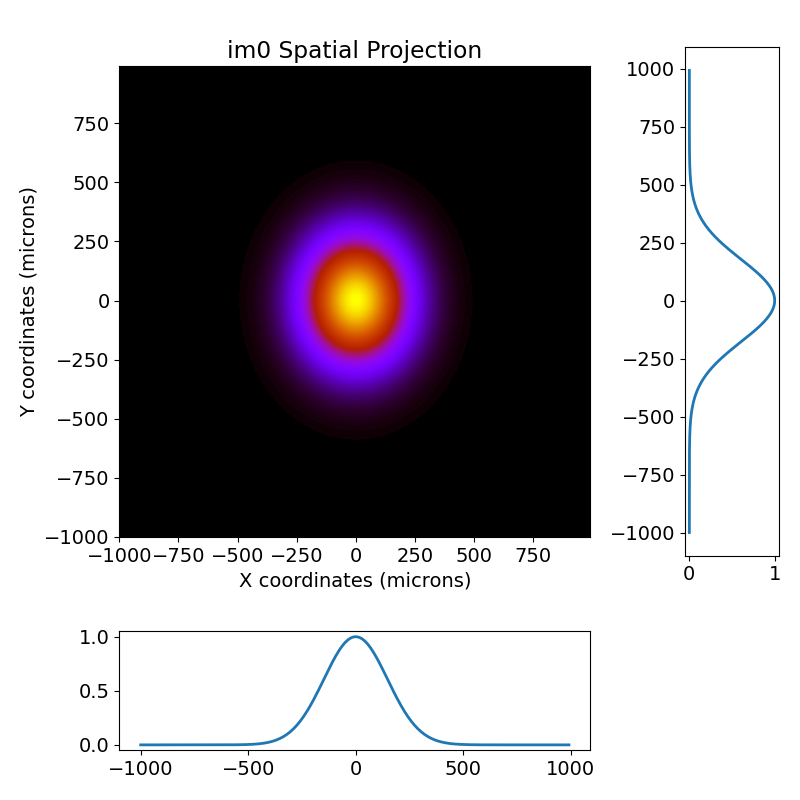

(<matplotlib.axes._subplots.AxesSubplot at 0x120bd97b8>,
 <matplotlib.axes._subplots.AxesSubplot at 0x120c10dd8>)

In [38]:
fig_path = '/Users/Matt/OneDrive - SLAC National Accelerator Laboratory/Projects/Tunable Mono/figures/'

# plot input pulse at beam center
pulse.plot_pulse('im0')
# plt.savefig(fig_path+'input_pulse_no_slit.png')
# plot input spectrum at beam center
pulse.plot_spectrum('im0')
# plt.savefig(fig_path+'input_spectrum_no_slit.png')
# plot input beam spatial projection
pulse.imshow_projection('im0')
# plt.savefig(fig_path+'input_spatial_no_slit.png')

### Visualize focus properties

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/beam1d.py:1189: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(6,6))


<IPython.core.display.Javascript object>


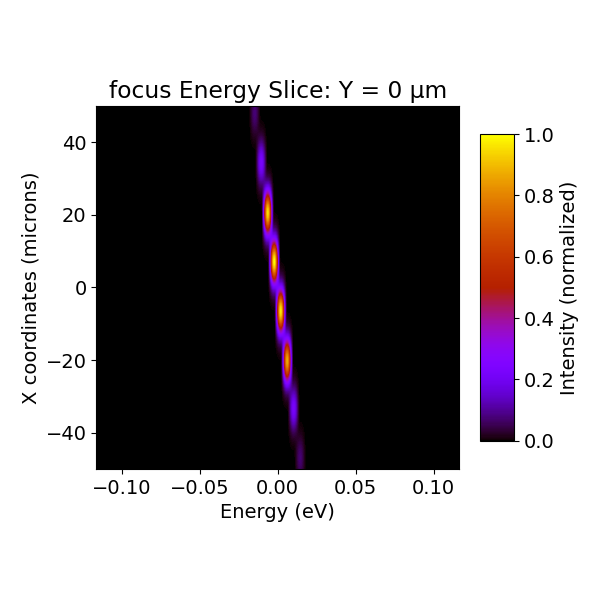

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/beam1d.py:1281: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(6, 6))


<IPython.core.display.Javascript object>


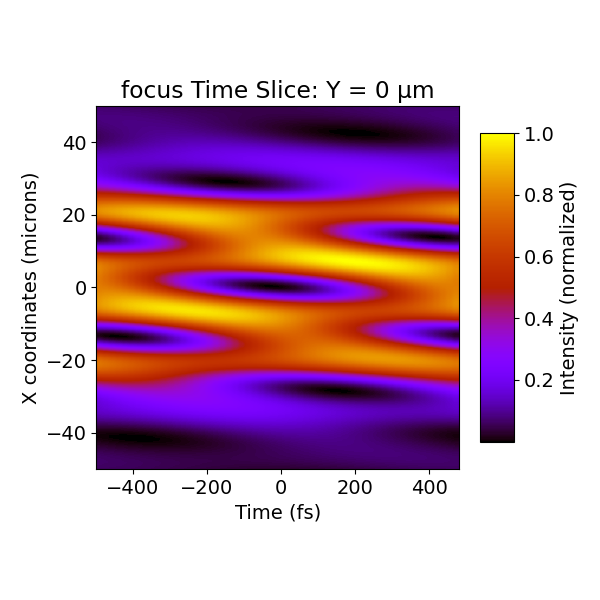

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/beam1d.py:1135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(8, 8))


<IPython.core.display.Javascript object>


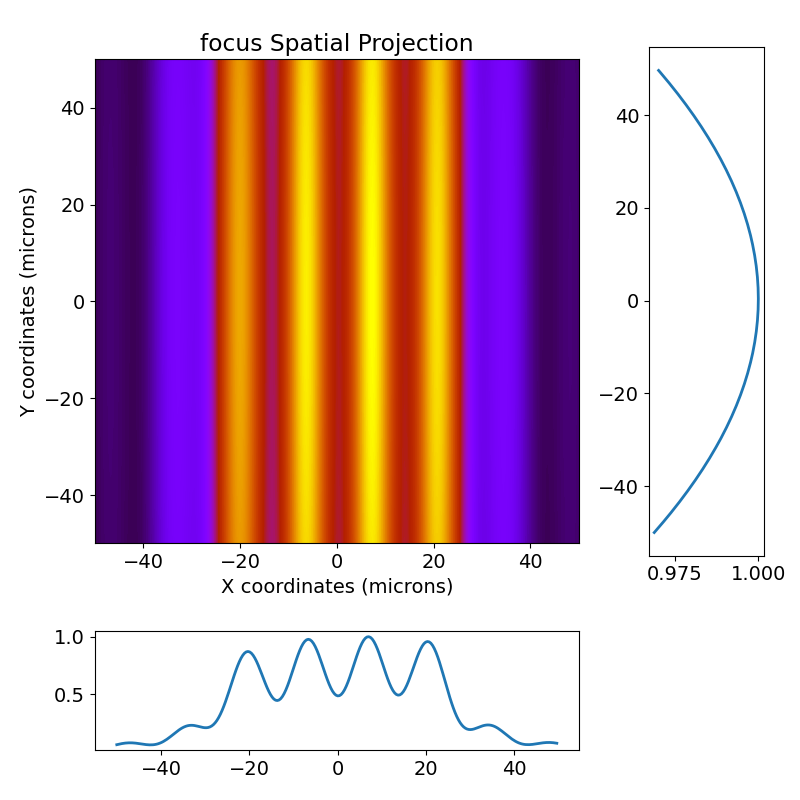

(<matplotlib.axes._subplots.AxesSubplot at 0x120e58c50>,
 <matplotlib.axes._subplots.AxesSubplot at 0x120e89f98>)

In [39]:
# plot energy slice of focus
pulse.imshow_energy_slice('focus')
# plt.savefig(fig_path+'option1_focus_energy_no_slit.png')
# plot time slice of focus
pulse.imshow_time_slice('focus', shift=-1000)
# plt.savefig(fig_path+'option1_focus_time_no_slit.png')
# show spatial projection
pulse.imshow_projection('focus')
# plt.savefig(fig_path+'option1_focus_spatial_no_slit.png')

### Visualize output

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/beam1d.py:1826: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


<IPython.core.display.Javascript object>


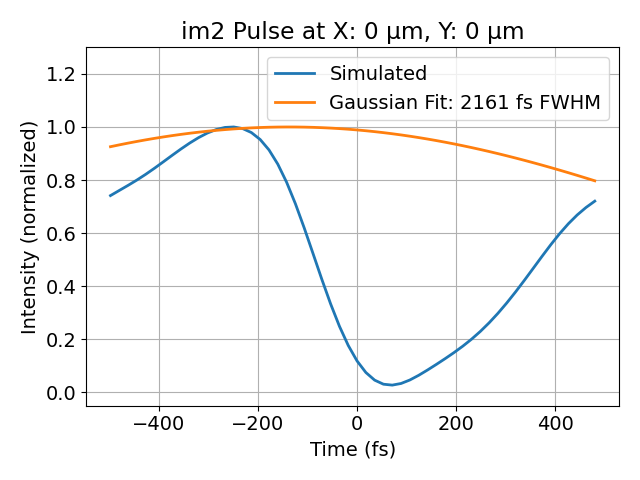

/Users/seaberg/beamline/lib/python3.7/site-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/beam1d.py:1454: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


<IPython.core.display.Javascript object>


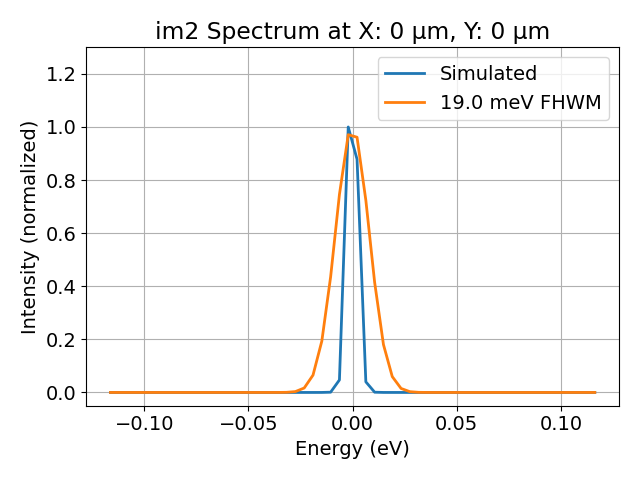

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/beam1d.py:1135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(8, 8))


<IPython.core.display.Javascript object>


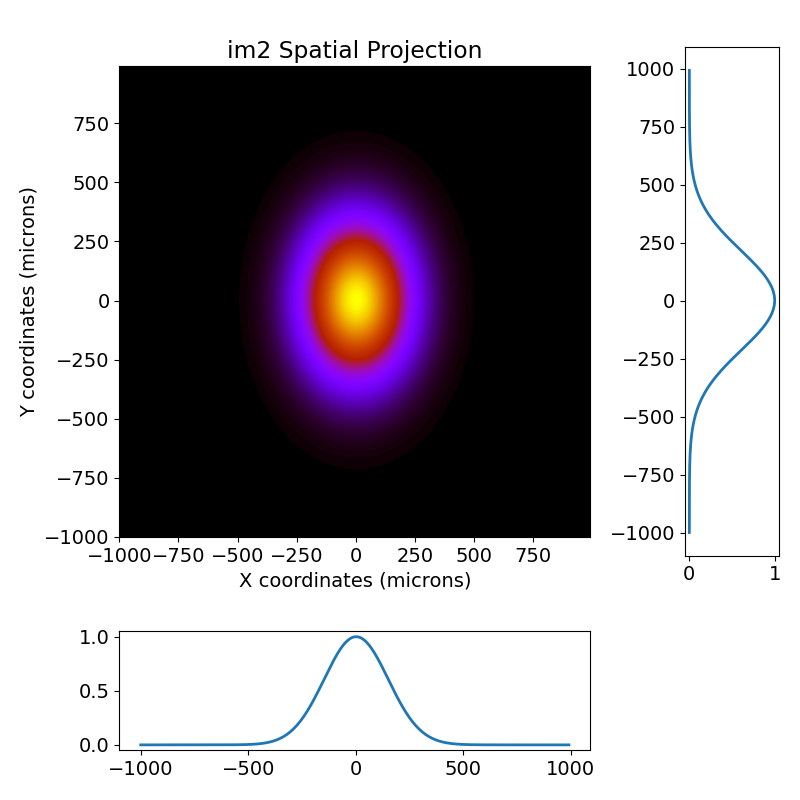

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/beam1d.py:1281: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(6, 6))


<IPython.core.display.Javascript object>


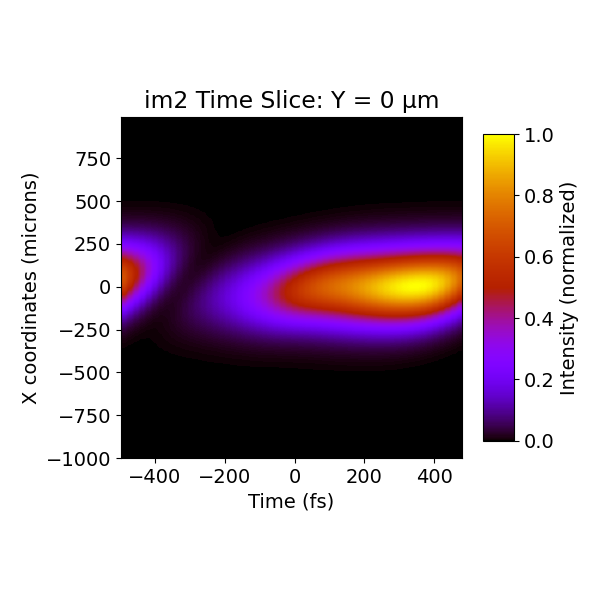

/Users/seaberg/Python/lcls_beamline_toolbox/lcls_beamline_toolbox/xraybeamline2d/beam1d.py:1189: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(6,6))


<IPython.core.display.Javascript object>


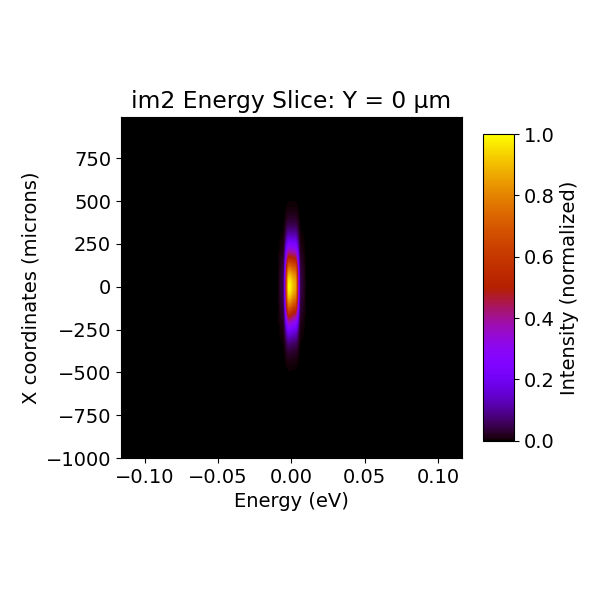

<IPython.core.display.Javascript object>


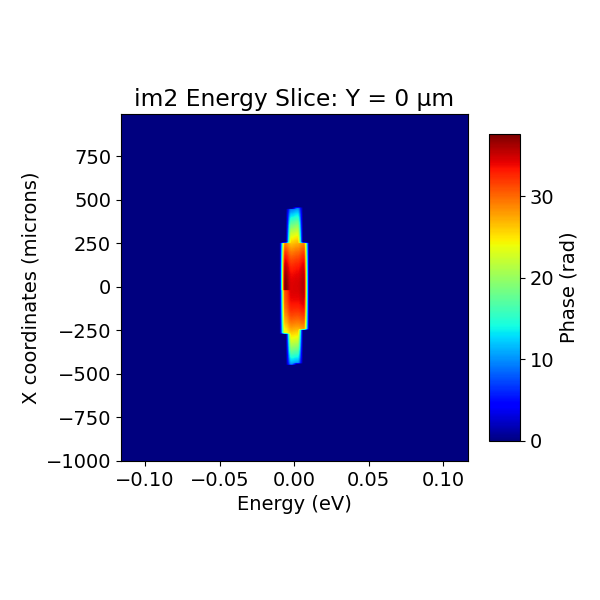

(-101.71697185507055, 537)
[2.88       2.88014286 2.88028571 2.88042857 2.88057143 2.88071429
 2.88085714 2.881      2.88114286 2.88128571 2.88142857 2.88157143
 2.88171429 2.88185714 2.882      2.88214286 2.88228571 2.88242857
 2.88257143 2.88271429 2.88285714 2.883      2.88314286 2.88328571
 2.88342857 2.88357143 2.88371429 2.88385714 2.884      2.88414286
 2.88428571 2.88442857 2.88457143 2.88471429 2.88485714 2.885
 2.88514286 2.88528571 2.88542857 2.88557143 2.88571429 2.88585714
 2.886      2.88614286 2.88628571 2.88642857 2.88657143 2.88671429
 2.88685714 2.887     ]


In [40]:
# plot output pulse at beam center
pulse.plot_pulse('im2', shift=600)
# plt.savefig(fig_path+'option1_output_pulse_no_slit.png')
# plot output spectraum at beam center
pulse.plot_spectrum('im2')
# plt.savefig(fig_path+'option1_output_spectrum_no_slit.png')
# show spatial projection of output
pulse.imshow_projection('im2')
# plt.savefig(fig_path+'option1_output_spatial_no_slit.png')
# show time slice of output
pulse.imshow_time_slice('im2', shift=200)
# plt.savefig(fig_path+'option1_output_time_no_slit.png')
# show energy slice of output
pulse.imshow_energy_slice('im2')
# plt.savefig(fig_path+'option1_output_energy_no_slit.png')
# show spectral phase slice of output
pulse.imshow_energy_slice('im2', image_type='phase')
print(pulse.pulse_duration('im2'))
f1 = np.linspace(2.88, 2.887, 50)
print(f1)

In [9]:
def define_devices(f1, f2):
    # crystal asymmetry angle
    alphaAsym = 19.88*np.pi/180

    # distance between crystal 2 and 1st CRL, 2nd CRL and crystal 4 
#     f1 = 2.884
    # distance between CRLs and focus
#     f2 = 3

    # crystal reflection hkl index
    hkl = [3,1,1]

    # initialize the beam
    b1 = beam.Beam(beam_params=beam_params)

    # viewing point upstream of monochromator
    im0 = optics.PPM('im0', z=870, FOV=2e-3, N=256)
    crl0 = optics.CRL('crl0', z=830, roc=1700e-6, diameter=2e-3)

    # first crystal: symmetric reflection
    crystal1 = optics.Crystal('c1', hkl=hkl, length=10e-2, width=20e-3, z=880, E0=E0,
                              alphaAsym=0, orientation=0, pol='s')

    # second crystal: asymmetric reflection, orientation flipped relative to crystal1
    crystal2 = optics.Crystal('c2', hkl=hkl, length=10e-2, width=20e-3, z=crystal1.z+.2, E0=E0,alphaAsym=alphaAsym, 
                              orientation=2,pol='s')
    # printing crystal incidence and reflection angles for confirmation
    print('crystal 2 incidence angle: {:.2f} degrees'.format(crystal2.alpha*180/np.pi))
    print('crystal 2 exit angle: {:.2f} degrees'.format(crystal2.beta0*180/np.pi))

    im_upstream = optics.PPM('im_upstream', z=crystal2.z + f1 - .1, FOV=2e-3, N=256)

    # CRL with ~1 meter focal length (modeled as single element for now)
    crl1 = optics.CRL('crl1', z=crystal2.z+f1, roc=25.25e-6, diameter=5e-3)

    # viewing point downstream of first crl
    im1 = optics.PPM('im1', z=crl1.z+.1,N=256,FOV=2e-3)

    # viewing point at focus
    focus = optics.PPM('focus', z=crl1.z+f2+.03, FOV=100e-6, N=256)

    # slit at focus
    slit = optics.Slit('slit', z=crl1.z+f2 + 1e-3+.03, x_width=4e-6, y_width=2e-3)

    # second CRL with ~1 meter focal length, for collimation
    crl2 = optics.CRL('crl2', z=crl1.z+2*f2, roc=25.25e-6, diameter=5e-3)

    # third crystal, symmetric reflection, same orientation as crystal2
    crystal3 = optics.Crystal('c3', hkl=hkl, length=10e-2, width=10e-3, z=crl2.z+2, E0=E0,alphaAsym=0, orientation=2,
                             asym_type='emergence',pol='s')

    # fourth crystal, asymmetric reflection, same orientation as crystal1
    crystal4 = optics.Crystal('c4', hkl=hkl, length=10e-2, width=10e-3, z=crl2.z+2 + (f1-2)*np.cos(crystal1.beta0*2), E0=E0,alphaAsym=-alphaAsym, 
                              asym_type='emergence', orientation=0,pol='s')

    # viewing point just downstream of monochromator
    im2 = optics.PPM('im2', z=crystal4.z+.1, FOV=2e-3, N=256)

    # list of devices to propagate through
    devices = [crl0,im0,crystal1,crystal2,im_upstream, im1, crl1, focus, crl2, crystal3, crystal4, im2]
    
    return devices

In [13]:
f1 = np.linspace(2.88, 2.887, 50)

duration = np.zeros(50)

for i, f in enumerate(f1):
    
    devices = define_devices(f, 3)
    # initialize beamline
    mono_beamline = beamline.Beamline(devices)
    # reset central photon energy
    beam_params['photonEnergy'] = 9000

    # initialize pulse. tau sets transform-limited pulse duration in fs (FWHM). Time window is in fs.
    pulse = beam.Pulse(beam_params=beam_params, tau=40, time_window=1000)

    print('Number of spectral components: {:d}'.format(pulse.N))
    pulse.propagate(beamline=mono_beamline, screen_names=['im2'])
    centroid, duration[i] = pulse.pulse_duration('im2')

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

Calculated distance to focus: -304.839913
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.703200
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 2780000.02 microns
goal for zx: 307483200.37 microns
current zx: 304703200.34 microns
goal for zy: 253089563.82 microns
current zy: 250309563.80 microns
current step size: 2780000.02 microns
x remains focused
y stays unfocused
zx: 307.483200
zy: 253.089564
azimuth -0.12 mrad
im_upstream
zx: 307.483200
zy: 253.089564
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 100000.00 microns
goal for zx: 307583200.37 microns
current zx: 307483200.37 microns
goal for zy: 253189563.82 microns
current zy: 253089563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.583200
zy: 253.189564
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030479
zy: 253.18

zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 2780000.02 microns
goal for zx: 307441456.00 microns
current zx: 304661455.98 microns
goal for zy: 253089563.82 microns
current zy: 250309563.80 microns
current step size: 2780000.02 microns
x remains focused
y stays unfocused
zx: 307.441456
zy: 253.089564
azimuth -0.12 mrad
im_upstream
zx: 307.441456
zy: 253.089564
azimuth

zx: -0.000497
zy: 256.219564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11307306200.64 microns
zRy: 73726448.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969502.65 microns
current zx: -497.39 microns
goal for zy: 259189563.90 microns
current zy: 256219563.86 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969503
zy: 259.189564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.618603
zy: 259.189564
azimuth -0.19 mrad
drift9
delta z: 3.73
zRx: 9619203563.23 microns
zRy: 73726448.06 microns
remaining distance: 1999919.94 microns
goal for zx: 285618522.45 microns
current zx: 283618602.51 microns
goal for zy: 261189483.83 microns
current zy: 259189563.90 microns
current step size: 1999919.94 microns
x becomes focused
y stays unfocused
zx: 285.618522
zy: 261.189484
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.618522
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.639079
zy: 261.18948

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
x is focused
y is focused
FWHM in x: 690.1232417334038 microns
FWHM in y: 690.1232417334038 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19780.587336
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 40000000.00 microns
goal for zx: 19820587336.12 microns
current zx: 19780587336.12 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distanc

Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2780000.03 microns
goal for zx: 307295455.07 microns
current zx: 304515455.04 microns
goal for zy: 253089563.82 microns
current zy: 250309563.80 microns
current step size: 2780000.03 microns
x remains focused
y stays unfocused
zx: 307.295455
zy: 253.089564
azimuth -0.13 mrad
im_upstream
zx: 307.295455
zy: 253.089564
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 100000.00 microns
goal for zx: 307395455.07 microns
current zx: 307295455.07 microns
goal for zy: 253189563.82 microns
current zy: 253089563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.395455
zy: 253.189564
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030521
zy: 253.18

zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2780000.03 microns
goal for zx: 307253770.27 microns
current zx: 304473770.24 microns
goal for zy: 253089563.82 microns
current zy: 250309563.80 microns
current step size: 2780000.03 microns
x remains focused
y stays unfocused
zx: 307.253770
zy: 253.089564
azimuth -0.14 mrad
im_upstream
zx: 307.253770
zy: 253.089564
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: 307353770.27 microns
current zx: 307253770.27 microns
goal for zy: 253189563.83 microns
current zy: 253089563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.353770
zy: 253.189564
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030530
zy: 253.189564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11293803275.56 micro

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18670.761474
zy: 262.069674
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 629403418902.42 microns
zRy: 73726724.73 microns
remaining distance: 100040.36 microns
goal for zx: 18670861514.42 microns
current zx: 18670761474.06 microns
goal for zy: 262169714.21 microns
current zy: 262069673.85 microns
current step size: 100040.36 microns
x becomes focused
y stays unfocused
zx: 18670.861514
zy: 262.169714
azimuth -0.12 mrad
im2
zx: 18670.861514
zy: 262.169714
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
x is focused
y is focused
FWHM in x: 690.121298180606 microns
FWHM in y: 690.121298180606 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.352045
zy: 200.000000
azimuth 0.00 mrad

/Users/Matt/beamline/venv/lib/python3.7/site-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11288023554.01 microns
zRy: 73726793.89 microns
remaining distance: 2970000.04 microns
goal for zx: 2969455.42 microns
current zx: -544.62 microns
goal for zy: 259189563.90 microns
current zy: 256219563.87 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969455
zy: 259.189564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.953056
zy: 259.189564
azimuth -0.18 mrad
drift9
delta z: 3.73
zRx: 9570755997.95 microns
zRy: 73726793.89 microns
remaining distance: 1999957.19 microns
goal for zx: 284953012.73 microns
current zx: 282953055.54 microns
goal for zy: 261189521.09 microns
current zy: 259189563.90 microns
current step size: 1999957.19 microns
x becomes focused
y stays unfocused
zx: 284.953013
zy: 261.189521
azimuth -0.18 mrad
c3
Calculated distance to focus: -284.953013
zRx: 9.57e+03
zRy: 7.37e+01
zx: 284.963981
zy: 261.189521
azimuth -868.51 mrad
drift1

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 10000000.00 microns
goal for zx: 19815238370.82 microns
current zx: 19805238370.82 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19815.238371
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19815.238371
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19815.238370
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720789301353.84 microns
zRy: 73726863.06 microns
remaining distance: 309563.80 microns
goal for zx: 19815547933.60 microns
current zx: 19815238369.80 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19815.547934
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.420456
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.36961

zx: 284.694833
zy: 261.189536
azimuth -868.52 mrad
drift10
delta z: 0.47
zRx: 9551475481.06 microns
zRy: 73726932.22 microns
remaining distance: 880163.02 microns
goal for zx: 285574996.15 microns
current zx: 284694833.13 microns
goal for zy: 262069699.02 microns
current zy: 261189536.00 microns
current step size: 880163.02 microns
x remains focused
y stays unfocused
zx: 285.574996
zy: 262.069699
azimuth -868.52 mrad
c4
Calculated distance to focus: -18635.498070
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18640.437730
zy: 262.069699
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 627349254539.55 microns
zRy: 73726932.22 microns
remaining distance: 100022.42 microns
goal for zx: 18640537752.35 microns
current zx: 18640437729.93 microns
goal for zy: 262169721.44 microns
current zy: 262069699.02 microns
current step size: 100022.42 microns
x becomes focused
y stays unfocused
zx: 18640.537752
zy: 262.169721
azimuth -0.12 mrad
im2
zx: 18640.537752
zy: 262.169721
azimuth -0.12 mrad
F

zx: 18630.449258
zy: 262.169724
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
x is focused
y is focused
FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 mic

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
x is focused
y is focused
FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19793316745.19 microns
current zx: 19753316745.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 1

current step size: 1999998.16 microns
x becomes focused
y stays unfocused
zx: 284.224568
zy: 261.189562
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.224568
zRx: 9.52e+03
zRy: 7.37e+01
zx: 284.225044
zy: 261.189562
azimuth -868.53 mrad
drift10
delta z: 0.47
zRx: 9517869124.12 microns
zRy: 73727174.30 microns
remaining distance: 880166.30 microns
goal for zx: 285105210.35 microns
current zx: 284225044.05 microns
goal for zy: 262069728.37 microns
current zy: 261189562.07 microns
current step size: 880166.30 microns
x remains focused
y stays unfocused
zx: 285.105210
zy: 262.069728
azimuth -868.53 mrad
c4
Calculated distance to focus: -18604.841702
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18605.170389
zy: 262.069728
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 624964434545.05 microns
zRy: 73727174.30 microns
remaining distance: 100001.50 microns
goal for zx: 18605270390.05 microns
current zx: 18605170388.55 microns
goal for zy: 262169729.87 microns
current zy: 26206

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2780000.04 microns
goal for zx: 306899983.71 microns
current zx: 304119983.67 microns
goal for zy: 253089563.84 microns
current zy: 250309563.80 microns
current step size: 2780000.04 microns
x remains focused
y stays unfocused
zx: 306.899984
zy: 253.089564
azimuth -0.16 mrad
im_upstream
zx: 306.899984
zy: 253.089564
azimuth

zx: -2.930625
zy: 253.289564
azimuth -0.16 mrad
im1
zx: -2.930625
zy: 253.289564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11255353621.06 microns
zRy: 73727381.79 microns
remaining distance: 2930000.04 microns
goal for zx: -624.91 microns
current zx: -2930624.94 microns
goal for zy: 256219563.88 microns
current zy: 253289563.84 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000625
zy: 256.219564
azimuth -0.16 mrad
focus
zx: -0.000625
zy: 256.219564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11255353621.06 microns
zRy: 73727381.79 microns
remaining distance: 2970000.04 microns
goal for zx: 2969375.13 microns
current zx: -624.91 microns
goal for zy: 259189563.92 microns
current zy: 256219563.88 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969375
zy: 259.189564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.828801
zy: 259.189564
azimuth -0.15 mrad
d

zRy: 7.37e+01
focal length: 3.00
zx: -3.030634
zy: 253.189564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11251519224.11 microns
zRy: 73727450.96 microns
remaining distance: 100000.00 microns
goal for zx: -2930634.39 microns
current zx: -3030634.39 microns
goal for zy: 253289563.84 microns
current zy: 253189563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930634
zy: 253.289564
azimuth -0.16 mrad
im1
zx: -2.930634
zy: 253.289564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11251519224.11 microns
zRy: 73727450.96 microns
remaining distance: 2930000.04 microns
goal for zx: -634.35 microns
current zx: -2930634.39 microns
goal for zy: 256219563.88 microns
current zy: 253289563.84 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000634
zy: 256.219564
azimuth -0.16 mrad
focus
zx: -0.000634
zy: 256.219564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11251519224.11 microns
zRy: 73727450.96 microns
remaining d

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2780000.04 microns
goal for zx: 306713070.61 microns
current zx: 303933070.57 microns
goal for zy: 253089563.84 microns
current zy: 250309563.80 microns
current step size: 2780000.04 microns
x remains focused
y stays unfocused
zx: 306.713071
zy: 253.089564
azimuth -0.18 mrad
im_upstream
zx: 306.713071
zy: 253.089564
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 100000.00 microns
goal for zx: 306813070.61 microns
current zx: 306713070.61 microns
goal for zy: 253189563.84 microns
current zy: 253089563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.813071
zy: 253.189564
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030653
zy: 253.189564
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19776.121245
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717948294559.76 microns
zRy: 73727658.46 microns
remaining distance: 309563.80 microns
goal for zx: 19776430808.53 microns
current zx: 19776121244.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.819511
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2780000.05 microns
goal for zx: 306671570.58 microns
current zx: 303891570.54 microns
goal for zy: 253089563.84 microns
current zy: 250309563.80 microns
current step size: 2780000.05 microns
x remains focused
y stays unfocused
zx: 306.671571
zy: 253.089564
azimuth -0.18 mrad
im_upstream
zx: 306.671571
zy: 253.089564
azimuth

zx: 2.969328
zy: 259.189564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.171660
zy: 259.189564
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9441692112.03 microns
zRy: 73727727.62 microns
remaining distance: 2000057.75 microns
goal for zx: 283171717.55 microns
current zx: 281171659.80 microns
goal for zy: 261189621.67 microns
current zy: 259189563.92 microns
current step size: 2000057.75 microns
x becomes focused
y stays unfocused
zx: 283.171718
zy: 261.189622
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.171718
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.157032
zy: 261.189622
azimuth -868.56 mrad
drift10
delta z: 0.47
zRx: 9441692112.03 microns
zRy: 73727727.62 microns
remaining distance: 880173.79 microns
goal for zx: 284037206.24 microns
current zx: 283157032.44 microns
goal for zy: 262069795.47 microns
current zy: 261189621.67 microns
current step size: 880173.79 microns
x remains focused
y stays unfocused
zx: 284.037206
zy: 2

zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 10000000.00 microns
goal for zx: 19767638000.38 microns
current zx: 19757638000.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19767.638000
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19767.638000
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.638000
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.746424
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 2780000.05 microns
goal for zx: 306526423.89 microns
current zx: 303746423.84 microns
goal for zy: 253089563.85 microns
current zy: 250309563.80 microns
current step size: 2780000.05 microns
x remains focused
y stays unfocused
zx: 306.526424
zy: 253.089564
azimuth -0.19 mrad
im_upstream
zx: 306.526424
zy: 253.089564
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: 306626423.89 microns
current zx: 306526423.89 microns
goal for zy: 253189563.85 microns
current zy: 253089563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.626424
zy: 253.189564
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030696
zy: 253.189564
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 282.692294
zy: 261.189648
azimuth -868.57 mrad
drift10
delta z: 0.47
zRx: 9408640941.18 microns
zRy: 73727969.70 microns
remaining distance: 880177.07 microns
goal for zx: 283572470.69 microns
current zx: 282692293.61 microns
goal for zy: 262069824.82 microns
current zy: 261189647.74 microns
current step size: 880177.07 microns
x remains focused
y stays unfocused
zx: 283.572471
zy: 262.069825
azimuth -868.57 mrad
c4
Calculated distance to focus: -18504.821155
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18490.121700
zy: 262.069825
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 617216321253.88 microns
zRy: 73727969.70 microns
remaining distance: 99932.76 microns
goal for zx: 18490221633.03 microns
current zx: 18490121700.27 microns
goal for zy: 262169757.58 microns
current zy: 262069824.82 microns
current step size: 99932.76 microns
x becomes focused
y stays unfocused
zx: 18490.221633
zy: 262.169758
azimuth -0.12 mrad
im2
zx: 18490.221633
zy: 262.169758
azimuth -0.12 mrad
FWH

zx: -0.000715
zy: 256.219564
azimuth -0.16 mrad
focus
zx: -0.000715
zy: 256.219564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11219004090.91 microns
zRy: 73728038.86 microns
remaining distance: 2970000.04 microns
goal for zx: 2969285.41 microns
current zx: -714.63 microns
goal for zy: 259189563.93 microns
current zy: 256219563.89 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969285
zy: 259.189564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.582860
zy: 259.189564
azimuth -0.12 mrad
drift9
delta z: 3.72
zRx: 9399228389.60 microns
zRy: 73728038.86 microns
remaining distance: 2000091.26 microns
goal for zx: 282582951.34 microns
current zx: 280582860.08 microns
goal for zy: 261189655.19 microns
current zy: 259189563.93 microns
current step size: 2000091.26 microns
x becomes focused
y stays unfocused
zx: 282.582951
zy: 261.189655
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.582951
zR

zx: 19752.386534
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19752.386534
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 2780000.06 microns
goal for zx: 306381437.86 microns
current zx: 303601437.80 microns
goal for zy: 253089563.85 microns
current zy: 250309563.80 microns
current step size: 2780000.06 microns
x remains focused
y stays unfocused
z

zx: 18741.976333
zy: 262.169983
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 mic

zRx: 9.63e+03
zRy: 7.37e+01
zx: 285.842359
zy: 261.189616
azimuth -868.49 mrad
drift10
delta z: 0.46
zRx: 9633815413.82 microns
zRy: 73726344.32 microns
remaining distance: 880298.05 microns
goal for zx: 286722656.79 microns
current zx: 285842358.74 microns
goal for zy: 262069913.57 microns
current zy: 261189615.52 microns
current step size: 880298.05 microns
x remains focused
y stays unfocused
zx: 286.722657
zy: 262.069914
azimuth -868.49 mrad
c4
Calculated distance to focus: -18710.389878
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18726.600695
zy: 262.069914
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 633194824039.85 microns
zRy: 73726344.32 microns
remaining distance: 100073.16 microns
goal for zx: 18726700768.02 microns
current zx: 18726600694.87 microns
goal for zy: 262169986.73 microns
current zy: 262069913.57 microns
current step size: 100073.16 microns
x becomes focused
y stays unfocused
zx: 18726.700768
zy: 262.169987
azimuth -0.12 mrad
im2
zx: 18726.700768
zy: 262

zRy: 73726413.48 microns
remaining distance: 2780142.88 microns
goal for zx: 307420731.63 microns
current zx: 304640588.75 microns
goal for zy: 253089706.68 microns
current zy: 250309563.80 microns
current step size: 2780142.88 microns
x remains focused
y stays unfocused
zx: 307.420732
zy: 253.089707
azimuth -0.13 mrad
im_upstream
zx: 307.420732
zy: 253.089707
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47061818430489.56 microns
zRy: 73726413.48 microns
remaining distance: 100000.00 microns
goal for zx: 307520731.63 microns
current zx: 307420731.63 microns
goal for zy: 253189706.68 microns
current zy: 253089706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.520732
zy: 253.189707
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030493
zy: 253.189707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11309247630.52 microns
zRy: 73726413.48 microns
remaining distance: 100000.00 microns
goal for zx: -2930492.69 microns
cu

zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.639206
zy: 261.189627
azimuth -868.50 mrad
drift10
delta z: 0.46
zRx: 9619212149.88 microns
zRy: 73726448.06 microns
remaining distance: 880299.44 microns
goal for zx: 286519505.26 microns
current zx: 285639205.81 microns
goal for zy: 262069926.14 microns
current zy: 261189626.70 microns
current step size: 880299.44 microns
x remains focused
y stays unfocused
zx: 286.519505
zy: 262.069926
azimuth -868.50 mrad
c4
Calculated distance to focus: -18697.133010
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18711.347238
zy: 262.069926
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 632158003089.77 microns
zRy: 73726448.06 microns
remaining distance: 100064.20 microns
goal for zx: 18711447302.24 microns
current zx: 18711347238.04 microns
goal for zy: 262169990.34 microns
current zy: 262069926.14 microns
current step size: 100064.20 microns
x becomes focused
y stays unfocused
zx: 18711.447302
zy: 262.169990
azimuth -0.12 mrad
im2
zx: 18711.447302
zy: 262

Calculated distance to focus: -18688.305548
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18701.190525
zy: 262.069935
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 631468094199.56 microns
zRy: 73726517.23 microns
remaining distance: 100058.23 microns
goal for zx: 18701290583.34 microns
current zx: 18701190525.11 microns
goal for zy: 262169992.75 microns
current zy: 262069934.52 microns
current step size: 100058.23 microns
x becomes focused
y stays unfocused
zx: 18701.290583
zy: 262.169993
azimuth -0.12 mrad
im2
zx: 18701.290583
zy: 262.169993
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
x is focused
y is focused
FWHM in x: 690.1232417334038 microns
FWHM in y: 690.1232417334038 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19827.174396
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721657310472.01 microns
zRy: 73726620.98 microns
remaining distance: 309563.80 microns
goal for zx: 19827483959.80 microns
current zx: 19827174396.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2780142.88 microns
goal for zx: 307295597.92 microns
current zx: 304515455.04 microns
goal for zy: 253089706.68 microns
current zy: 250309563.80 microns
current step size: 2780142.88 microns
x remains focused
y stays unfocused
zx: 307.295598
zy: 253.089707
azimuth -0.13 mrad
im_upstream
zx: 307.295598
zy: 253.089707
azimuth

azimuth -0.18 mrad
c3
Calculated distance to focus: -285.152462
zRx: 9.59e+03
zRy: 7.37e+01
zx: 285.166302
zy: 261.189653
azimuth -868.51 mrad
drift10
delta z: 0.46
zRx: 9585261792.20 microns
zRy: 73726690.14 microns
remaining distance: 880302.69 microns
goal for zx: 286046604.57 microns
current zx: 285166301.88 microns
goal for zy: 262069955.47 microns
current zy: 261189652.78 microns
current step size: 880302.69 microns
x remains focused
y stays unfocused
zx: 286.046605
zy: 262.069955
azimuth -868.51 mrad
c4
Calculated distance to focus: -18666.273376
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18675.841522
zy: 262.069955
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 629747873319.85 microns
zRy: 73726690.14 microns
remaining distance: 100043.29 microns
goal for zx: 18675941565.33 microns
current zx: 18675841522.04 microns
goal for zy: 262169998.76 microns
current zy: 262069955.47 microns
current step size: 100043.29 microns
x becomes focused
y stays unfocused
zx: 18675.94156

delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 2780142.88 microns
goal for zx: 307212241.64 microns
current zx: 304432098.75 microns
goal for zy: 253089706.68 microns
current zy: 250309563.80 microns
current step size: 2780142.88 microns
x remains focused
y stays unfocused
zx: 307.212242
zy: 253.089707
azimuth -0.14 mrad
im_upstream
zx: 307.212242
zy: 253.089707
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 100000.00 microns
goal for zx: 307312241.64 microns
current zx: 307212241.64 microns
goal for zy: 253189706.68 microns
current zy: 253089706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.312242
zy: 253.189707
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030540
zy: 253.189707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11289960142.25 microns
zRy: 73726759.31 microns
remaining distance: 100000.0

zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 2780142.89 microns
goal for zx: 307170583.38 microns
current zx: 304390440.49 microns
goal for zy: 253089706.68 microns
current zy: 250309563.80 microns
current step size: 2780142.89 microns
x remains focused
y stays unfocused
zx: 307.170583
zy: 253.089707
azimuth -0.14 mrad
im_upstream
zx: 307.170583
zy: 253.089707
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 100000.00 microns
goal for zx: 307270583.38 microns
current zx: 307170583.38 microns
goal for zy: 253189706.68 microns
current zy: 253089706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.270583
zy: 253.189707
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030549
zy: 253.189707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11286108439.17 microns
zRy: 73726828.47 microns
remaining distance: 100000.00 microns
goal

zx: 18645.603195
zy: 262.170006
azimuth -0.12 mrad
im2
zx: 18645.603195
zy: 262.170006
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 40000000.00 microns
goal for zx: 19801830723.95 microns
current zx: 19761830723.95 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 

zx: -0.000568
zy: 256.219707
azimuth -0.16 mrad
focus
zx: -0.000568
zy: 256.219707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11278410810.94 microns
zRy: 73726966.80 microns
remaining distance: 2970000.04 microns
goal for zx: 2969431.82 microns
current zx: -568.22 microns
goal for zy: 259189706.76 microns
current zy: 256219706.73 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969432
zy: 259.189707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.621584
zy: 259.189707
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9546672614.85 microns
zRy: 73726966.80 microns
remaining distance: 1999975.82 microns
goal for zx: 284621559.65 microns
current zx: 282621583.83 microns
goal for zy: 261189682.58 microns
current zy: 259189706.76 microns
current step size: 1999975.82 microns
x becomes focused
y stays unfocused
zx: 284.621560
zy: 261.189683
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.621560
zR

zx: 307.024883
zy: 253.089707
azimuth -0.15 mrad
im_upstream
zx: 307.024883
zy: 253.089707
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 100000.00 microns
goal for zx: 307124883.45 microns
current zx: 307024883.45 microns
goal for zy: 253189706.69 microns
current zy: 253089706.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.124883
zy: 253.189707
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030582
zy: 253.189707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11272642645.25 microns
zRy: 73727070.55 microns
remaining distance: 100000.00 microns
goal for zx: -2930582.43 microns
current zx: -3030582.43 microns
goal for zy: 253289706.69 microns
current zy: 253189706.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930582
zy: 253.289707
azimuth -0.16 mrad
im1
zx: -2.930582
zy: 253.289707
azimuth -0.16 mrad
dr

zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 10000000.00 microns
goal for zx: 19801614829.69 microns
current zx: 19791614829.69 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19801.614830
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19801.614830
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.614829
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719799211306.79 microns
zRy: 73727139.72 microns
remaining distance: 309563.80 microns
goal for zx: 19801924393.09 microns
current zx: 19801614829.29 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19801.924393
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 285.105479
zy: 262.070014
azimuth -868.53 mrad
c4
Calculated distance to focus: -18604.859229
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18605.187915
zy: 262.070014
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 624965615933.84 microns
zRy: 73727174.30 microns
remaining distance: 100001.49 microns
goal for zx: 18605287916.62 microns
current zx: 18605187915.12 microns
goal for zy: 262170015.61 microns
current zy: 262070014.12 microns
current step size: 100001.49 microns
x becomes focused
y stays unfocused
zx: 18605.287917
zy: 262.170016
azimuth -0.12 mrad
im2
zx: 18605.287917
zy: 262.170016
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl

zx: 284.092655
zy: 261.189712
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.092655
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.091228
zy: 261.189712
azimuth -868.53 mrad
drift10
delta z: 0.46
zRx: 9508307098.84 microns
zRy: 73727243.46 microns
remaining distance: 880310.11 microns
goal for zx: 284971538.58 microns
current zx: 284091228.47 microns
goal for zy: 262070022.49 microns
current zy: 261189712.38 microns
current step size: 880310.11 microns
x remains focused
y stays unfocused
zx: 284.971539
zy: 262.070022
azimuth -868.53 mrad
c4
Calculated distance to focus: -18596.118809
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18595.133279
zy: 262.070022
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 624286541821.87 microns
zRy: 73727243.46 microns
remaining distance: 99995.52 microns
goal for zx: 18595233274.42 microns
current zx: 18595133278.90 microns
goal for zy: 262170018.02 microns
current zy: 262070022.49 microns
current step size: 99995.52 microns
x becomes focused
y sta

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 2780142.90 microns
goal for zx: 306837792.56 microns
current zx: 304057649.66 microns
goal for zy: 253089706.69 microns
current zy: 250309563.80 microns
current step size: 2780142.90 microns
x remains focused
y stays unfocused
zx: 306.837793
zy: 253.089707
azimuth -0.17 mrad
im_upstream
zx: 306.837793
zy: 253.089707
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 100000.00 microns
goal for zx: 306937792.56 microns
current zx: 306837792.56 microns
goal for zy: 253189706.70 microns
current zy: 253089706.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.937793
zy: 253.189707
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030625
zy: 253.189707
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 10000000.00 microns
goal for zx: 19786310777.14 microns
current zx: 19776310777.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19786.310777
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18560.017890
zy: 262.070052
azimuth -0.12 mrad
drift11
delta z: -2.99
zRx: 621917804328.02 microns
zRy: 73727485.54 microns
remaining distance: 99974.63 microns
goal for zx: 18560117864.83 microns
current zx: 18560017890.21 microns
goal for zy: 262170026.44 microns
current zy: 262070051.81 microns
current step size: 99974.63 microns
x becomes focused
y stays unfocused
zx: 18560.117865
zy: 262.170026
azimuth -0.12 mrad
im2
zx: 18560.117865
zy: 262.170026
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
x is focused
y is focused
FWHM in x: 690.1141719140965 microns
FWHM in y: 690.1141719140965 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19732.913097
zy: 200.000000
azimuth 0.00 mrad

Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2780142.90 microns
goal for zx: 306713213.47 microns
current zx: 303933070.57 microns
goal for zy: 253089706.70 microns
current zy: 250309563.80 microns
current step size: 2780142.90 microns
x remains focused
y stays unfocused
zx: 306.713213
zy: 253.089707
azimuth -0.18 mrad
im_upstream
zx: 306.713213
zy: 253.089707
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 100000.00 microns
goal for zx: 306813213.47 microns
current zx: 306713213.47 microns
goal for zy: 253189706.70 microns
current zy: 253089706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.813213
zy: 253.189707
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030653
zy: 253.18

Calculated distance to focus: -283.368650
zRx: 9.46e+03
zRy: 7.37e+01
zx: 283.356799
zy: 261.189753
azimuth -868.55 mrad
drift10
delta z: 0.46
zRx: 9455916581.53 microns
zRy: 73727623.87 microns
remaining distance: 880315.22 microns
goal for zx: 284237114.08 microns
current zx: 283356798.86 microns
goal for zy: 262070068.57 microns
current zy: 261189753.35 microns
current step size: 880315.22 microns
x remains focused
y stays unfocused
zx: 284.237114
zy: 262.070069
azimuth -868.55 mrad
c4
Calculated distance to focus: -18548.193162
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18540.004768
zy: 262.070069
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 620569819802.64 microns
zRy: 73727623.87 microns
remaining distance: 99962.69 microns
goal for zx: 18540104731.16 microns
current zx: 18540004768.47 microns
goal for zy: 262170031.25 microns
current zy: 262070068.57 microns
current step size: 99962.69 microns
x becomes focused
y stays unfocused
zx: 18540.104731
zy: 262.170031
azimuth

zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 2780142.90 microns
goal for zx: 306650968.38 microns
current zx: 303870825.47 microns
goal for zy: 253089706.70 microns
current zy: 250309563.80 microns
current step size: 2780142.90 microns
x remains focused
y stays unfocused
zx: 306.650968
zy: 253.089707
azimuth -0.18 mrad
im_upstream
zx: 306.650968
zy: 253.089707
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 100000.00 microns
goal for zx: 306750968.38 microns
current zx: 306650968.38 microns
goal for zy: 253189706.70 microns
current zy: 253089706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.750968
zy: 253.189707
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zR

Calculated distance to focus: -283.171843
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.157157
zy: 261.189765
azimuth -868.56 mrad
drift10
delta z: 0.46
zRx: 9441700509.88 microns
zRy: 73727727.62 microns
remaining distance: 880316.61 microns
goal for zx: 284037474.09 microns
current zx: 283157157.48 microns
goal for zy: 262070081.13 microns
current zy: 261189764.52 microns
current step size: 880316.61 microns
x remains focused
y stays unfocused
zx: 284.037474
zy: 262.070081
azimuth -868.56 mrad
c4
Calculated distance to focus: -18535.165444
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18525.020041
zy: 262.070081
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 619561481717.68 microns
zRy: 73727727.62 microns
remaining distance: 99953.73 microns
goal for zx: 18525119994.26 microns
current zx: 18525020040.53 microns
goal for zy: 262170034.86 microns
current zy: 262070081.13 microns
current step size: 99953.73 microns
x becomes focused
y stays unfocused
zx: 18525.119994
zy: 262.170035
azimuth

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2780142.91 microns
goal for zx: 306588752.80 microns
current zx: 303808609.90 microns
goal for zy: 253089706.70 microns
current zy: 250309563.80 microns
current step size: 2780142.91 microns
x remains focused
y stays unfocused
zx: 306.588753
zy: 253.089707
azimuth -0.19 mrad
im_upstream
zx: 306.588753
zy: 253.089707
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 100000.00 microns
goal for zx: 306688752.80 microns
current zx: 306588752.80 microns
goal for zy: 253189706.71 microns
current zy: 253089706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.688753
zy: 253.189707
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030682
zy: 253.189707
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 19764.246746
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19764.246746
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19764.246745
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717086980976.90 microns
zRy: 73727900.53 microns
remaining distance: 309563.80 microns
goal for zx: 19764556308.76 microns
current zx: 19764246744.96 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19764.556309
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.637087
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.746424
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 2780142.91 microns
goal for zx: 306526566.74 microns
current zx: 303746423.84 microns
goal for zy: 253089706.71 microns
current zy: 250309563.80 microns
current step size: 2780142.91 microns
x remains focused
y stays unfocused
z

zx: 282.779056
zy: 261.189787
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.779056
zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.758716
zy: 261.189787
azimuth -868.56 mrad
drift10
delta z: 0.46
zRx: 9413360678.36 microns
zRy: 73727935.12 microns
remaining distance: 880319.39 microns
goal for zx: 283639035.73 microns
current zx: 282758716.34 microns
goal for zy: 262070106.26 microns
current zy: 261189786.87 microns
current step size: 880319.39 microns
x remains focused
y stays unfocused
zx: 283.639036
zy: 262.070106
azimuth -868.56 mrad
c4
Calculated distance to focus: -18509.164928
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18495.114996
zy: 262.070106
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 617551594126.63 microns
zRy: 73727935.12 microns
remaining distance: 99935.82 microns
goal for zx: 18495214931.46 microns
current zx: 18495114995.64 microns
goal for zy: 262170042.08 microns
current zy: 262070106.26 microns
current step size: 99935.82 microns
x becomes focused
y sta

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 2780142.91 microns
goal for zx: 306443697.94 microns
current zx: 303663555.03 microns
goal for zy: 253089706.71 microns
current zy: 250309563.80 microns
current step size: 2780142.91 microns
x remains focused
y stays unfocused
zx: 306.443698
zy: 253.089707
azimuth -0.20 mrad
im_upstream
zx: 306.443698
zy: 253.089707
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 100000.00 microns
goal for zx: 306543697.94 microns
current zx: 306443697.94 microns
goal for zy: 253189706.71 microns
current zy: 253089706.71 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.543698
zy: 253.189707
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030715
zy: 253.189707
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 2780142.91 microns
goal for zx: 306381580.71 microns
current zx: 303601437.80 microns
goal for zy: 253089706.71 microns
current zy: 250309563.80 microns
current step size: 2780142.91 microns
x remains focused
y stays unfocused
zx: 306.381581
zy: 253.089707
azimuth -0.20 mrad
im_upstream
zx: 306.381581
zy: 253.089707
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 100000.00 microns
goal for zx: 306481580.72 microns
current zx: 306381580.71 microns
goal for zy: 253189706.71 microns
current zy: 253089706.71 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.481581
zy: 253.189707
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zR

Calculated distance to focus: -286.019595
zRx: 9.65e+03
zRy: 7.37e+01
zx: 286.045927
zy: 261.189747
azimuth -868.49 mrad
drift10
delta z: -12.63
zRx: 9648459296.14 microns
zRy: 73726240.57 microns
remaining distance: 880439.67 microns
goal for zx: 286926366.97 microns
current zx: 286045927.30 microns
goal for zy: 262070186.88 microns
current zy: 261189747.22 microns
current step size: 880439.67 microns
x remains focused
y stays unfocused
zx: 286.926367
zy: 262.070187
azimuth -868.49 mrad
c4
Calculated distance to focus: -18723.683200
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18741.893867
zy: 262.070187
azimuth -0.12 mrad
drift11
delta z: 82.02
zRx: 634235196212.87 microns
zRy: 73726240.57 microns
remaining distance: 100082.02 microns
goal for zx: 18741993949.04 microns
current zx: 18741893867.02 microns
goal for zy: 262170268.90 microns
current zy: 262070186.88 microns
current step size: 100082.02 microns
x becomes focused
y stays unfocused
zx: 18741.993949
zy: 262.170269
azi

zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.839913
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.703200
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 2780285.73 microns
goal for zx: 307483486.08 microns
current zx: 304703200.34 microns
goal for zy: 253089849.53 microns
current zy: 250309563.80 microns
current step size: 2780285.73 microns
x remains focused
y stays unfocused
zx: 307.483486
zy: 253.089850
azimuth -0.12 mrad
im_upstream
zx: 307.483486
zy: 253.089850
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 100000.00 microns
goal for zx: 307583486.08 microns
current zx: 307483486.08 microns
goal for zy: 253189849.53 microns
current zy: 253089849.53 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.583486
zy: 253.189850
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zR

zx: 286.722927
zy: 262.070199
azimuth -868.49 mrad
c4
Calculated distance to focus: -18710.407478
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18726.618302
zy: 262.070199
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 633196018862.61 microns
zRy: 73726344.32 microns
remaining distance: 100073.07 microns
goal for zx: 18726718374.73 microns
current zx: 18726618301.66 microns
goal for zy: 262170272.51 microns
current zy: 262070199.44 microns
current step size: 100073.07 microns
x becomes focused
y stays unfocused
zx: 18726.718375
zy: 262.170273
azimuth -0.12 mrad
im2
zx: 18726.718375
zy: 262.170273
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zR

zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030493
zy: 253.189850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11309258137.83 microns
zRy: 73726413.48 microns
remaining distance: 100000.00 microns
goal for zx: -2930492.67 microns
current zx: -3030492.67 microns
goal for zy: 253289849.54 microns
current zy: 253189849.53 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930493
zy: 253.289850
azimuth -0.16 mrad
im1
zx: -2.930493
zy: 253.289850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11309258137.83 microns
zRy: 73726413.48 microns
remaining distance: 2930000.04 microns
goal for zx: -492.63 microns
current zx: -2930492.67 microns
goal for zy: 256219849.57 microns
current zy: 253289849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000493
zy: 256.219850
azimuth -0.16 mrad
focus
zx: -0.000493
zy: 256.219850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11309258137.83 microns
zRy: 73726413.48 micro

zx: 18711.464900
zy: 262.170276
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
x is focused
y is focused
FWHM in x: 690.1238895867715 microns
FWHM in y: 690.1238895867715 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19784.001455
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 40000000.00 microns
goal for zx: 19824001455.24 microns
current zx: 19784001455.24 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721426006919.62 mic

FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
x is focused
y is focused
FWHM in x: 690.1232417334038 microns
FWHM in y: 690.1232417334038 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19780.587336
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 40000000.00 microns
goal for zx: 19820587336.12 microns
current zx: 19780587336.12 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 10000000.00 microns
goal for zx: 19

delta z: 0.00
zRx: 721657310472.01 microns
zRy: 73726620.98 microns
remaining distance: 309563.80 microns
goal for zx: 19827483959.80 microns
current zx: 19827174396.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2780285.74 microns
goal for zx: 307295740.78 microns
current zx: 304515455.04 microns
goal for zy: 253089849.54 microns
current zy: 250309563.80 microns
current step size: 2780285.74 microns
x remains focused
y stays unfocused
zx: 307.295741
zy: 253.089850
azimuth -0.13 mrad
im_upstream
zx: 307.295741
zy: 253.089850
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 micron

Calculated distance to focus: -285.152588
zRx: 9.59e+03
zRy: 7.37e+01
zx: 285.166428
zy: 261.189796
azimuth -868.51 mrad
drift10
delta z: 0.46
zRx: 9585270342.68 microns
zRy: 73726690.14 microns
remaining distance: 880445.64 microns
goal for zx: 286046873.82 microns
current zx: 285166428.18 microns
goal for zy: 262070241.28 microns
current zy: 261189795.64 microns
current step size: 880445.64 microns
x remains focused
y stays unfocused
zx: 286.046874
zy: 262.070241
azimuth -868.51 mrad
c4
Calculated distance to focus: -18666.290946
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18675.859097
zy: 262.070241
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 629749062613.72 microns
zRy: 73726690.14 microns
remaining distance: 100043.24 microns
goal for zx: 18675959139.96 microns
current zx: 18675859096.71 microns
goal for zy: 262170284.53 microns
current zy: 262070241.28 microns
current step size: 100043.24 microns
x becomes focused
y stays unfocused
zx: 18675.959140
zy: 262.170285
azimu

zx: 2.969455
zy: 259.189850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.953308
zy: 259.189850
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9570773068.02 microns
zRy: 73726793.89 microns
remaining distance: 1999957.20 microns
goal for zx: 284953265.07 microns
current zx: 282953307.87 microns
goal for zy: 261189806.82 microns
current zy: 259189849.62 microns
current step size: 1999957.20 microns
x becomes focused
y stays unfocused
zx: 284.953265
zy: 261.189807
azimuth -0.18 mrad
c3
Calculated distance to focus: -284.953265
zRx: 9.57e+03
zRy: 7.37e+01
zx: 284.964233
zy: 261.189807
azimuth -868.51 mrad
drift10
delta z: 0.46
zRx: 9570773068.02 microns
zRy: 73726793.89 microns
remaining distance: 880447.02 microns
goal for zx: 285844680.35 microns
current zx: 284964233.33 microns
goal for zy: 262070253.84 microns
current zy: 261189806.82 microns
current step size: 880447.02 microns
x remains focused
y stays unfocused
zx: 285.844680
zy: 2

Calculated distance to focus: -18644.310738
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18650.571037
zy: 262.070262
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 628035316898.30 microns
zRy: 73726863.06 microns
remaining distance: 100028.33 microns
goal for zx: 18650671065.42 microns
current zx: 18650571037.09 microns
goal for zy: 262170290.54 microns
current zy: 262070262.21 microns
current step size: 100028.33 microns
x becomes focused
y stays unfocused
zx: 18650.671065
zy: 262.170291
azimuth -0.12 mrad
im2
zx: 18650.671065
zy: 262.170291
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
x is focused
y is focused
FWHM in x: 690.1200024848284 microns
FWHM in y: 690.1200024848284 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 197

zx: -2.930568
zy: 253.289850
azimuth -0.16 mrad
im1
zx: -2.930568
zy: 253.289850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11278421300.97 microns
zRy: 73726966.80 microns
remaining distance: 2930000.04 microns
goal for zx: -568.21 microns
current zx: -2930568.24 microns
goal for zy: 256219849.58 microns
current zy: 253289849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000568
zy: 256.219850
azimuth -0.16 mrad
focus
zx: -0.000568
zy: 256.219850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11278421300.97 microns
zRy: 73726966.80 microns
remaining distance: 2970000.04 microns
goal for zx: 2969431.83 microns
current zx: -568.21 microns
goal for zy: 259189849.62 microns
current zy: 256219849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969432
zy: 259.189850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.621710
zy: 259.189850
azimuth -0.17 mrad
d

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
x is focused
y is focused
FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 1

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distanc

zx: -2.930597
zy: 253.289850
azimuth -0.16 mrad
im1
zx: -2.930597
zy: 253.289850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11266889292.80 microns
zRy: 73727174.30 microns
remaining distance: 2930000.04 microns
goal for zx: -596.54 microns
current zx: -2930596.58 microns
goal for zy: 256219849.59 microns
current zy: 253289849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000597
zy: 256.219850
azimuth -0.16 mrad
focus
zx: -0.000597
zy: 256.219850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11266889292.80 microns
zRy: 73727174.30 microns
remaining distance: 2970000.04 microns
goal for zx: 2969403.49 microns
current zx: -596.54 microns
goal for zy: 259189849.63 microns
current zy: 256219849.59 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969403
zy: 259.189850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.224822
zy: 259.189850
azimuth -0.16 mrad
d

zx: 18600.276915
zy: 262.170303
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
x is focused
y is focused
FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19786510842.38 microns
current zx: 19746510842.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718701814635.18 mic

zx: -2.930611
zy: 253.289850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11261129776.36 microns
zRy: 73727278.05 microns
remaining distance: 2930000.04 microns
goal for zx: -610.71 microns
current zx: -2930610.75 microns
goal for zy: 256219849.59 microns
current zy: 253289849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000611
zy: 256.219850
azimuth -0.16 mrad
focus
zx: -0.000611
zy: 256.219850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11261129776.36 microns
zRy: 73727278.05 microns
remaining distance: 2970000.04 microns
goal for zx: 2969389.33 microns
current zx: -610.71 microns
goal for zy: 259189849.63 microns
current zy: 256219849.59 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969389
zy: 259.189850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.026798
zy: 259.189850
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9503535514.04 microns
zRy: 

zx: -2.930630
zy: 253.289850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11253457136.89 microns
zRy: 73727416.38 microns
remaining distance: 2930000.04 microns
goal for zx: -629.60 microns
current zx: -2930629.64 microns
goal for zy: 256219849.59 microns
current zy: 253289849.56 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000630
zy: 256.219850
azimuth -0.16 mrad
focus
zx: -0.000630
zy: 256.219850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11253457136.89 microns
zRy: 73727416.38 microns
remaining distance: 2970000.04 microns
goal for zx: 2969370.44 microns
current zx: -629.60 microns
goal for zy: 259189849.63 microns
current zy: 256219849.59 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969370
zy: 259.189850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.763199
zy: 259.189850
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9484449913.53 microns
zRy: 

zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717591825983.25 microns
zRy: 73727554.71 microns
remaining distance: 10000000.00 microns
goal for zx: 19781214695.14 microns
current zx: 19771214695.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19781.214695
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19781.214695
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19781.214695
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718317905094.66 microns
zRy: 73727554.71 microns
remaining distance: 309563.80 microns
goal for zx: 19781524259.02 microns
current zx: 19781214695.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19781.524259
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.897761
zRx: 4.67e+07
zRy: 7.37e

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717222402190.16 microns
zRy: 73727658.46 microns
remaining distance: 10000000.00 microns
goal for zx: 19776121244.16 microns
current zx: 19766121244.16 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19776.121244
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19776.121244
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19776.121245
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717948294559.76 microns
zRy: 73727658.46 microns
remaining distance: 309563.80 microns
goal for zx: 19776430808.53 microns
current zx: 19776121244.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.819511
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.89157

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2780285.76 microns
goal for zx: 306630369.39 microns
current zx: 303850083.63 microns
goal for zy: 253089849.56 microns
current zy: 250309563.80 microns
current step size: 2780285.76 microns
x remains focused
y stays unfocused
zx: 306.630369
zy: 253.089850
azimuth -0.18 mrad
im_upstream
zx: 306.630369
zy: 253.089850
azimuth

Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2780285.76 microns
goal for zx: 306588895.66 microns
current zx: 303808609.90 microns
goal for zy: 253089849.56 microns
current zy: 250309563.80 microns
current step size: 2780285.76 microns
x remains focused
y stays unfocused
zx: 306.588896
zy: 253.089850
azimuth -0.19 mrad
im_upstream
zx: 306.588896
zy: 253.089850
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 100000.00 microns
goal for zx: 306688895.66 microns
current zx: 306588895.66 microns
goal for zy: 253189849.56 microns
current zy: 253089849.56 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.688896
zy: 253.189850
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030682
zy: 253.18

zx: -2.930691
zy: 253.289850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11228573963.86 microns
zRy: 73727865.95 microns
remaining distance: 2930000.04 microns
goal for zx: -690.99 microns
current zx: -2930691.03 microns
goal for zy: 256219849.60 microns
current zy: 253289849.57 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000691
zy: 256.219850
azimuth -0.16 mrad
focus
zx: -0.000691
zy: 256.219850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11228573963.86 microns
zRy: 73727865.95 microns
remaining distance: 2970000.04 microns
goal for zx: 2969309.05 microns
current zx: -690.99 microns
goal for zy: 259189849.64 microns
current zy: 256219849.60 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969309
zy: 259.189850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.909914
zy: 259.189850
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9422802023.01 microns
zRy: 

zx: 283.639303
zy: 262.070392
azimuth -868.56 mrad
c4
Calculated distance to focus: -18509.182389
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18495.132451
zy: 262.070392
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 617552763519.24 microns
zRy: 73727935.12 microns
remaining distance: 99935.90 microns
goal for zx: 18495232387.13 microns
current zx: 18495132451.23 microns
goal for zy: 262170327.79 microns
current zy: 262070391.89 microns
current step size: 99935.90 microns
x becomes focused
y stays unfocused
zx: 18495.232387
zy: 262.170328
azimuth -0.12 mrad
im2
zx: 18495.232387
zy: 262.170328
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0


zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.560040
zy: 261.189941
azimuth -868.57 mrad
drift10
delta z: 0.46
zRx: 9399245095.25 microns
zRy: 73728038.86 microns
remaining distance: 880463.56 microns
goal for zx: 283440503.61 microns
current zx: 282560040.05 microns
goal for zy: 262070404.44 microns
current zy: 261189940.88 microns
current step size: 880463.56 microns
x remains focused
y stays unfocused
zx: 283.440504
zy: 262.070404
azimuth -868.57 mrad
c4
Calculated distance to focus: -18496.209504
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18480.212027
zy: 262.070404
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 616551198796.31 microns
zRy: 73728038.86 microns
remaining distance: 99926.96 microns
goal for zx: 18480311953.96 microns
current zx: 18480212027.00 microns
goal for zy: 262170331.40 microns
current zy: 262070404.44 microns
current step size: 99926.96 microns
x becomes focused
y stays unfocused
zx: 18480.311954
zy: 262.170331
azimuth -0.12 mrad
im2
zx: 18480.311954
zy: 262.1

zx: 19754.389541
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.480898
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.622140
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 2780285.77 microns
goal for zx: 306402426.06 microns
current zx: 303622140.29 microns
goal for zy: 253089849.57 microns
current zy: 250309563.80 microns
current step size: 2780285.77 microns
x remains focused
y stays unfocused
zx: 306.402426
zy: 253.089850
azimuth -0.20 mrad
im_upstream
zx: 306.402426
zy: 253.089850
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: 306502426.06 microns
current zx: 306402426.06 microns
goal for zy: 253189849.57 microns
current zy: 253089849.57 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.502426
zy: 253.189850
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zR

zx: 283.241983
zy: 262.070417
azimuth -868.57 mrad
c4
Calculated distance to focus: -18483.254820
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18465.312948
zy: 262.070417
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 615551879190.49 microns
zRy: 73728142.61 microns
remaining distance: 99918.01 microns
goal for zx: 18465412866.25 microns
current zx: 18465312948.24 microns
goal for zy: 262170335.00 microns
current zy: 262070416.99 microns
current step size: 99918.01 microns
x becomes focused
y stays unfocused
zx: 18465.412866
zy: 262.170335
azimuth -0.12 mrad
im2
zx: 18465.412866
zy: 262.170335
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number o

zx: -0.000478
zy: 256.219992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11315064325.61 microns
zRy: 73726309.73 microns
remaining distance: 2970000.04 microns
goal for zx: 2969521.59 microns
current zx: -478.45 microns
goal for zy: 259189992.47 microns
current zy: 256219992.43 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969522
zy: 259.189992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.886083
zy: 259.189992
azimuth -0.20 mrad
drift9
delta z: 3.72
zRx: 9638707488.31 microns
zRy: 73726309.73 microns
remaining distance: 1999905.07 microns
goal for zx: 285885988.52 microns
current zx: 283886083.45 microns
goal for zy: 261189897.54 microns
current zy: 259189992.47 microns
current step size: 1999905.07 microns
x becomes focused
y stays unfocused
zx: 285.885989
zy: 261.189898
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.885989
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.910394
zy: 261.18989

Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 2780428.59 microns
goal for zx: 307441884.57 microns
current zx: 304661455.98 microns
goal for zy: 253089992.39 microns
current zy: 250309563.80 microns
current step size: 2780428.59 microns
x remains focused
y stays unfocused
zx: 307.441885
zy: 253.089992
azimuth -0.12 mrad
im_upstream
zx: 307.441885
zy: 253.089992
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 100000.00 microns
goal for zx: 307541884.57 microns
current zx: 307441884.57 microns
goal for zy: 253189992.39 microns
current zy: 253089992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.541885
zy: 253.189992
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030488
zy: 253.18

zx: 286.587730
zy: 262.070494
azimuth -868.50 mrad
c4
Calculated distance to focus: -18701.585062
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18716.464472
zy: 262.070494
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 632505736275.78 microns
zRy: 73726413.48 microns
remaining distance: 100067.02 microns
goal for zx: 18716564538.64 microns
current zx: 18716464471.61 microns
goal for zy: 262170560.69 microns
current zy: 262070493.66 microns
current step size: 100067.02 microns
x becomes focused
y stays unfocused
zx: 18716.564539
zy: 262.170561
azimuth -0.12 mrad
im2
zx: 18716.564539
zy: 262.170561
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
x is focused
y is focused
FWHM in x: 690.1242135139117 microns
FWHM in y: 690.1242135139117 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
crl

zx: 307.379293
zy: 253.089992
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 100000.00 microns
goal for zx: 307479292.83 microns
current zx: 307379292.83 microns
goal for zy: 253189992.39 microns
current zy: 253089992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.479293
zy: 253.189992
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030502
zy: 253.189992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11305407275.35 microns
zRy: 73726482.65 microns
remaining distance: 100000.00 microns
goal for zx: -2930502.10 microns
current zx: -3030502.11 microns
goal for zy: 253289992.39 microns
current zy: 253189992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930502
zy: 253.289992
azimuth -0.16 mrad
im1
zx: -2.930502
zy: 253.289992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11305407275.35 microns
zRy: 73726482.

zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 10000000.00 microns
goal for zx: 19830587336.12 microns
current zx: 19820587336.12 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19830.587336
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19830.587336
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19825.468365
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721533212996.17 microns
zRy: 73726655.56 microns
remaining distance: 309563.80 microns
goal for zx: 19825777928.83 microns
current zx: 19825468365.03 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19825.777929
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.577617
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.494611
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46993611764368.11 microns
zRy: 73726655.56 microns
remaining distance: 2780428.60 microns
goal for zx: 307275039.55 microns
current zx: 304494610.95 microns
goal for zy: 253089992.40 microns
current zy: 250309563.80 microns
current step size: 2780428.60 microns
x remains focused
y stays unfocused
zx: 307.275040
zy: 253.089992
azimuth -0.14 mrad
im_upstream
zx: 307.275040
zy: 253.089992
azimuth

zx: 307.333361
zy: 253.189992
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030535
zy: 253.189992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11291907714.35 microns
zRy: 73726724.73 microns
remaining distance: 100000.00 microns
goal for zx: -2930535.17 microns
current zx: -3030535.17 microns
goal for zy: 253289992.40 microns
current zy: 253189992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930535
zy: 253.289992
azimuth -0.16 mrad
im1
zx: -2.930535
zy: 253.289992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11291907714.35 microns
zRy: 73726724.73 microns
remaining distance: 2930000.04 microns
goal for zx: -535.13 microns
current zx: -2930535.17 microns
goal for zy: 256219992.44 microns
current zy: 253289992.40 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000535
zy: 256.219992
azimuth -0.16 mrad
focus
zx: -0.000535
zy: 256.219992
azimuth -0.16 mrad
drift8
delta z: 0

FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19768.647193
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 40000000.00 microns
goal for zx: 19808647193.09 microns
current zx: 19768647193.09 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 10000000.00 microns
goal for zx: 19818647193.09 microns
current zx: 19808647193.09 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns


zx: 307.150045
zy: 253.089992
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: 307250044.89 microns
current zx: 307150044.89 microns
goal for zy: 253189992.40 microns
current zy: 253089992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.250045
zy: 253.189992
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030554
zy: 253.189992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11284204294.84 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: -2930554.06 microns
current zx: -3030554.06 microns
goal for zy: 253289992.40 microns
current zy: 253189992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930554
zy: 253.289992
azimuth -0.16 mrad
im1
zx: -2.930554
zy: 253.289992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11284204294.84 microns
zRy: 73726863.

zx: -0.000563
zy: 256.219992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11280355477.35 microns
zRy: 73726932.22 microns
remaining distance: 2970000.04 microns
goal for zx: 2969436.57 microns
current zx: -563.47 microns
goal for zy: 259189992.48 microns
current zy: 256219992.44 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969437
zy: 259.189992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.688093
zy: 259.189992
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9551501024.60 microns
zRy: 73726932.22 microns
remaining distance: 1999972.10 microns
goal for zx: 284688065.00 microns
current zx: 282688092.90 microns
goal for zy: 261189964.58 microns
current zy: 259189992.48 microns
current step size: 1999972.10 microns
x becomes focused
y stays unfocused
zx: 284.688065
zy: 261.189965
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.688065
zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.695211
zy: 261.18996

zx: 307.045974
zy: 253.089992
azimuth -0.15 mrad
im_upstream
zx: 307.045974
zy: 253.089992
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 100000.00 microns
goal for zx: 307145973.56 microns
current zx: 307045973.56 microns
goal for zy: 253189992.40 microns
current zy: 253089992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.145974
zy: 253.189992
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030578
zy: 253.189992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11274585863.74 microns
zRy: 73727035.97 microns
remaining distance: 100000.00 microns
goal for zx: -2930577.68 microns
current zx: -3030577.68 microns
goal for zy: 253289992.40 microns
current zy: 253189992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930578
zy: 253.289992
azimuth -0.16 mrad
im1
zx: -2.930578
zy: 253.289992
azimuth -0.16 mrad
dr

zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18620.323056
zy: 262.070573
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 625988511014.18 microns
zRy: 73727070.55 microns
remaining distance: 100010.43 microns
goal for zx: 18620423066.50 microns
current zx: 18620323056.08 microns
goal for zy: 262170583.49 microns
current zy: 262070573.07 microns
current step size: 100010.43 microns
x becomes focused
y stays unfocused
zx: 18620.423067
zy: 262.170583
azimuth -0.12 mrad
im2
zx: 18620.423067
zy: 262.170583
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
x is focused
y is focused
FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mr

delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 2780428.61 microns
goal for zx: 306983570.35 microns
current zx: 304203141.74 microns
goal for zy: 253089992.40 microns
current zy: 250309563.80 microns
current step size: 2780428.61 microns
x remains focused
y stays unfocused
zx: 306.983570
zy: 253.089992
azimuth -0.16 mrad
im_upstream
zx: 306.983570
zy: 253.089992
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 100000.00 microns
goal for zx: 307083570.35 microns
current zx: 306983570.35 microns
goal for zy: 253189992.41 microns
current zy: 253089992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.083570
zy: 253.189992
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030592
zy: 253.189992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11268820576.54 microns
zRy: 73727139.72 microns
remaining distance: 100000.0

zx: 2.969399
zy: 259.189992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.158908
zy: 259.189992
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9513107562.76 microns
zRy: 73727208.88 microns
remaining distance: 2000001.89 microns
goal for zx: 284158910.16 microns
current zx: 282158908.27 microns
goal for zy: 261189994.37 microns
current zy: 259189992.48 microns
current step size: 2000001.89 microns
x becomes focused
y stays unfocused
zx: 284.158910
zy: 261.189994
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.158910
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.158435
zy: 261.189994
azimuth -868.53 mrad
drift10
delta z: 0.45
zRx: 9513107562.76 microns
zRy: 73727208.88 microns
remaining distance: 880595.41 microns
goal for zx: 285039030.10 microns
current zx: 284158434.69 microns
goal for zy: 262070589.78 microns
current zy: 261189994.37 microns
current step size: 880595.41 microns
x remains focused
y stays unfocused
zx: 285.039030
zy: 2

Calculated distance to focus: -18591.786720
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18590.144612
zy: 262.070598
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 623949747082.49 microns
zRy: 73727278.05 microns
remaining distance: 99992.56 microns
goal for zx: 18590244604.85 microns
current zx: 18590144612.29 microns
goal for zy: 262170590.70 microns
current zy: 262070598.14 microns
current step size: 99992.56 microns
x becomes focused
y stays unfocused
zx: 18590.244605
zy: 262.170591
azimuth -0.12 mrad
im2
zx: 18590.244605
zy: 262.170591
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
x is focused
y is focused
FWHM in x: 690.1161154267162 microns
FWHM in y: 690.1161154267162 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

remaining distance: 100000.00 microns
goal for zx: 306958852.96 microns
current zx: 306858852.96 microns
goal for zy: 253189992.41 microns
current zy: 253089992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.958853
zy: 253.189992
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030620
zy: 253.189992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11257302972.61 microns
zRy: 73727347.21 microns
remaining distance: 100000.00 microns
goal for zx: -2930620.18 microns
current zx: -3030620.18 microns
goal for zy: 253289992.41 microns
current zy: 253189992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930620
zy: 253.289992
azimuth -0.16 mrad
im1
zx: -2.930620
zy: 253.289992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11257302972.61 microns
zRy: 73727347.21 microns
remaining distance: 2930000.04 microns
goal for zx: -620.14 microns
current zx: -2930620.18 microns
goal for zy: 25

zx: 306.775774
zy: 253.089992
azimuth -0.17 mrad
im_upstream
zx: 306.775774
zy: 253.089992
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 100000.00 microns
goal for zx: 306875773.92 microns
current zx: 306775773.92 microns
goal for zy: 253189992.41 microns
current zy: 253089992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.875774
zy: 253.189992
azimuth -0.17 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030639
zy: 253.189992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11249634164.74 microns
zRy: 73727485.54 microns
remaining distance: 100000.00 microns
goal for zx: -2930639.07 microns
current zx: -3030639.07 microns
goal for zy: 253289992.41 microns
current zy: 253189992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930639
zy: 253.289992
azimuth -0.16 mrad
im1
zx: -2.930639
zy: 253.289992
azimuth -0.16 mrad
dr

FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19729.516586
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 40000000.00 microns
goal for zx: 19769516585.91 microns
current zx: 19729516585.91 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 10000000.00 microns
goal for zx: 197795

zx: -0.000663
zy: 256.219992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11240058930.21 microns
zRy: 73727658.46 microns
remaining distance: 2970000.04 microns
goal for zx: 2969337.39 microns
current zx: -662.64 microns
goal for zy: 259189992.49 microns
current zy: 256219992.46 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969337
zy: 259.189992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.303217
zy: 259.189992
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9451191278.27 microns
zRy: 73727658.46 microns
remaining distance: 2000050.28 microns
goal for zx: 283303267.28 microns
current zx: 281303217.00 microns
goal for zy: 261190042.78 microns
current zy: 259189992.49 microns
current step size: 2000050.28 microns
x becomes focused
y stays unfocused
zx: 283.303267
zy: 261.190043
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.303267
zRx: 9.45e+03
zRy: 7.37e+01
zx: 283.290471
zy: 261.19004

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2780428.62 microns
goal for zx: 306630512.25 microns
current zx: 303850083.63 microns
goal for zy: 253089992.42 microns
current zy: 250309563.80 microns
current step size: 2780428.62 microns
x remains focused
y stays unfocused
zx: 306.630512
zy: 253.089992
azimuth -0.18 mrad
im_upstream
zx: 306.630512
zy: 253.089992
azimuth

zx: 283.971525
zy: 262.070657
azimuth -868.56 mrad
c4
Calculated distance to focus: -18530.861898
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18520.064854
zy: 262.070657
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 619228217097.48 microns
zRy: 73727762.20 microns
remaining distance: 99950.86 microns
goal for zx: 18520164805.14 microns
current zx: 18520064854.27 microns
goal for zy: 262170607.50 microns
current zy: 262070656.64 microns
current step size: 99950.86 microns
x becomes focused
y stays unfocused
zx: 18520.164805
zy: 262.170608
azimuth -0.12 mrad
im2
zx: 18520.164805
zy: 262.170608
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0


zx: 306.568307
zy: 253.089992
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 100000.00 microns
goal for zx: 306668306.53 microns
current zx: 306568306.53 microns
goal for zy: 253189992.42 microns
current zy: 253089992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.668307
zy: 253.189992
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030686
zy: 253.189992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11230495649.26 microns
zRy: 73727831.37 microns
remaining distance: 100000.00 microns
goal for zx: -2930686.29 microns
current zx: -3030686.30 microns
goal for zy: 253289992.42 microns
current zy: 253189992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930686
zy: 253.289992
azimuth -0.16 mrad
im1
zx: -2.930686
zy: 253.289992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11230495649.26 microns
zRy: 73727831.

zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18505.108743
zy: 262.070669
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 618222894301.99 microns
zRy: 73727865.95 microns
remaining distance: 99941.93 microns
goal for zx: 18505208685.23 microns
current zx: 18505108743.30 microns
goal for zy: 262170611.10 microns
current zy: 262070669.17 microns
current step size: 99941.93 microns
x becomes focused
y stays unfocused
zx: 18505.208685
zy: 262.170611
azimuth -0.12 mrad
im2
zx: 18505.208685
zy: 262.170611
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300513752879
5.131300513752879
x is focused
y is focused
FWHM in x: 690.1106088360859 microns
FWHM in y: 690.1106088360859 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300513752879
5.131300513752879
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19714.246746
zy: 200.000000
azimuth 0.00 mrad

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
x is focused
y is focused
FWHM in x: 690.109313180486 microns
FWHM in y: 690.109313180486 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19707.467734
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 40000000.00 microns
goal for zx: 19747467734.21 microns
current zx: 19707467734.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 100

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.622140
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 2780428.63 microns
goal for zx: 306402568.92 microns
current zx: 303622140.29 microns
goal for zy: 253089992.43 microns
current zy: 250309563.80 microns
current step size: 2780428.63 microns
x remains focused
y stays unfocused
zx: 306.402569
zy: 253.089992
azimuth -0.20 mrad
im_upstream
zx: 306.402569
zy: 253.089992
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: 306502568.92 microns
current zx: 306402568.92 microns
goal for zy: 253189992.43 microns
current zy: 253089992.43 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.502569
zy: 253.189992
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030724
zy: 253.189992
azimuth -0.16 mrad
drift6
delta z: 0.

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

zx: -0.000474
zy: 256.220135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11317007700.73 microns
zRy: 73726275.15 microns
remaining distance: 2970000.04 microns
goal for zx: 2969526.32 microns
current zx: -473.71 microns
goal for zy: 259190135.32 microns
current zy: 256220135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969526
zy: 259.190135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.953065
zy: 259.190135
azimuth -0.20 mrad
drift9
delta z: 3.72
zRx: 9643594532.10 microns
zRy: 73726275.15 microns
remaining distance: 1999901.36 microns
goal for zx: 285952965.94 microns
current zx: 283953064.59 microns
goal for zy: 261190036.68 microns
current zy: 259190135.32 microns
current step size: 1999901.36 microns
x becomes focused
y stays unfocused
zx: 285.952966
zy: 261.190037
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.952966
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.978335
zy: 261.19003

zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2780571.45 microns
goal for zx: 307462897.96 microns
current zx: 304682326.51 microns
goal for zy: 253090135.25 microns
current zy: 250309563.80 microns
current step size: 2780571.45 microns
x remains focused
y stays unfocused
zx: 307.462898
zy: 253.090135
azimuth -0.12 mrad
im_upstream
zx: 307.462898
zy: 253.090135
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 100000.00 microns
goal for zx: 307562897.96 microns
current zx: 307462897.96 microns
goal for zy: 253190135.25 microns
current zy: 253090135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.562898
zy: 253.190135
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030483
zy: 253.190135
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18721.566569
zy: 262.070775
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 632852538683.08 microns
zRy: 73726378.90 microns
remaining distance: 100069.92 microns
goal for zx: 18721666638.49 microns
current zx: 18721566568.57 microns
goal for zy: 262170845.26 microns
current zy: 262070775.34 microns
current step size: 100069.92 microns
x becomes focused
y stays unfocused
zx: 18721.666638
zy: 262.170845
azimuth -0.12 mrad
im2
zx: 18721.666638
zy: 262.170845
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mr

zx: 307.400296
zy: 253.090135
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 100000.00 microns
goal for zx: 307500296.30 microns
current zx: 307400296.30 microns
goal for zy: 253190135.25 microns
current zy: 253090135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.500296
zy: 253.190135
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030497
zy: 253.190135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11307348225.55 microns
zRy: 73726448.06 microns
remaining distance: 100000.00 microns
goal for zx: -2930497.37 microns
current zx: -3030497.37 microns
goal for zy: 253290135.25 microns
current zy: 253190135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930497
zy: 253.290135
azimuth -0.16 mrad
im1
zx: -2.930497
zy: 253.290135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11307348225.55 microns
zRy: 73726448.

zx: -0.000507
zy: 256.220135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11303487823.08 microns
zRy: 73726517.23 microns
remaining distance: 2970000.04 microns
goal for zx: 2969493.26 microns
current zx: -506.78 microns
goal for zy: 259190135.33 microns
current zy: 256220135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969493
zy: 259.190135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.485748
zy: 259.190135
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9609520102.03 microns
zRy: 73726517.23 microns
remaining distance: 1999927.42 microns
goal for zx: 285485674.94 microns
current zx: 283485747.52 microns
goal for zy: 261190062.75 microns
current zy: 259190135.33 microns
current step size: 1999927.42 microns
x becomes focused
y stays unfocused
zx: 285.485675
zy: 261.190063
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.485675
zRx: 9.61e+03
zRy: 7.37e+01
zx: 285.504310
zy: 261.19006

zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.369163
zy: 261.190070
azimuth -868.50 mrad
drift10
delta z: 0.45
zRx: 9599816446.37 microns
zRy: 73726586.39 microns
remaining distance: 880730.19 microns
goal for zx: 286249892.83 microns
current zx: 285369162.64 microns
goal for zy: 262070800.39 microns
current zy: 261190070.20 microns
current step size: 880730.19 microns
x remains focused
y stays unfocused
zx: 286.249893
zy: 262.070800
azimuth -868.50 mrad
c4
Calculated distance to focus: -18679.539166
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18691.096346
zy: 262.070800
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 630782799222.40 microns
zRy: 73726586.39 microns
remaining distance: 100052.06 microns
goal for zx: 18691196398.36 microns
current zx: 18691096346.30 microns
goal for zy: 262170852.45 microns
current zy: 262070800.39 microns
current step size: 100052.06 microns
x becomes focused
y stays unfocused
zx: 18691.196398
zy: 262.170852
azimuth -0.12 mrad
im2
zx: 18691.196398
zy: 262

focal length: 3.00
zx: 283.219403
zy: 259.190135
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9590126917.62 microns
zRy: 73726655.56 microns
remaining distance: 1999942.32 microns
goal for zx: 285219344.88 microns
current zx: 283219402.56 microns
goal for zy: 261190077.65 microns
current zy: 259190135.33 microns
current step size: 1999942.32 microns
x becomes focused
y stays unfocused
zx: 285.219345
zy: 261.190078
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.219345
zRx: 9.59e+03
zRy: 7.37e+01
zx: 285.234143
zy: 261.190078
azimuth -868.51 mrad
drift10
delta z: 0.45
zRx: 9590126917.62 microns
zRy: 73726655.56 microns
remaining distance: 880731.09 microns
goal for zx: 286114873.91 microns
current zx: 285234142.82 microns
goal for zy: 262070808.74 microns
current zy: 261190077.65 microns
current step size: 880731.09 microns
x remains focused
y stays unfocused
zx: 286.114874
zy: 262.070809
azimuth -868.51 mrad
c4
Calculated distance to focus: -18670.728364
zRx: 1.48e+02
zRy: 7.3

current zx: -2930535.15 microns
goal for zy: 256220135.29 microns
current zy: 253290135.26 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000535
zy: 256.220135
azimuth -0.16 mrad
focus
zx: -0.000535
zy: 256.220135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11291918211.94 microns
zRy: 73726724.73 microns
remaining distance: 2970000.04 microns
goal for zx: 2969464.92 microns
current zx: -535.12 microns
goal for zy: 259190135.33 microns
current zy: 256220135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969465
zy: 259.190135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.086419
zy: 259.190135
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9580451493.26 microns
zRy: 73726724.73 microns
remaining distance: 1999949.77 microns
goal for zx: 285086368.45 microns
current zx: 283086418.68 microns
goal for zy: 261190085.10 microns
current zy: 259190135.33 micro

zx: 19818.647193
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19818.647193
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721037143743.94 microns
zRy: 73726793.89 microns
remaining distance: 309563.80 microns
goal for zx: 19818956756.93 microns
current zx: 19818647193.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19818.956757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.472825
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.411268
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 2780571.46 microns
goal for zx: 307191839.42 microns
current zx: 304411267.97 microns
goal for zy: 253090135.25 microns
current zy: 250309563.80 microns
current step size: 2780571.46 microns
x remains focused
y stays unfocused
z

zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 10000000.00 microns
goal for zx: 19815238370.82 microns
current zx: 19805238370.82 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19815.238371
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19815.238371
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19815.238370
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720789301353.84 microns
zRy: 73726863.06 microns
remaining distance: 309563.80 microns
goal for zx: 19815547933.60 microns
current zx: 19815238369.80 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19815.547934
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.420456
zRx: 4.69e+07
zRy: 7.37e

zy: 261.190104
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.754476
zRx: 9.56e+03
zRy: 7.37e+01
zx: 284.762577
zy: 261.190104
azimuth -868.52 mrad
drift10
delta z: 0.45
zRx: 9556324435.73 microns
zRy: 73726897.64 microns
remaining distance: 880734.24 microns
goal for zx: 285643310.92 microns
current zx: 284762576.68 microns
goal for zy: 262070837.96 microns
current zy: 261190103.72 microns
current step size: 880734.24 microns
x remains focused
y stays unfocused
zx: 285.643311
zy: 262.070838
azimuth -868.52 mrad
c4
Calculated distance to focus: -18639.956023
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18645.555832
zy: 262.070838
azimuth -0.12 mrad
drift11
delta z: -2.98
zRx: 627695714283.89 microns
zRy: 73726897.64 microns
remaining distance: 100025.29 microns
goal for zx: 18645655856.94 microns
current zx: 18645555831.66 microns
goal for zy: 262170863.25 microns
current zy: 262070837.96 microns
current step size: 100025.29 microns
x becomes focused
y stays unfocused


zx: -0.000568
zy: 256.220135
azimuth -0.16 mrad
focus
zx: -0.000568
zy: 256.220135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11278442281.04 microns
zRy: 73726966.80 microns
remaining distance: 2970000.04 microns
goal for zx: 2969431.86 microns
current zx: -568.18 microns
goal for zy: 259190135.34 microns
current zy: 256220135.30 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969432
zy: 259.190135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.621962
zy: 259.190135
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9546698143.04 microns
zRy: 73726966.80 microns
remaining distance: 1999975.83 microns
goal for zx: 284621937.53 microns
current zx: 282621961.70 microns
goal for zy: 261190111.16 microns
current zy: 259190135.34 microns
current step size: 1999975.83 microns
x becomes focused
y stays unfocused
zx: 284.621938
zy: 261.190111
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.621938
zR

Calculated distance to focus: -19806.721456
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19806.721457
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720170255358.50 microns
zRy: 73727035.97 microns
remaining distance: 309563.80 microns
goal for zx: 19807031020.58 microns
current zx: 19806721456.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19807.031021
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.289613
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.265545
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 2780571.46 microns
goal for zx: 307046116.42 microns
current zx: 304265544.95 microns
goal for zy: 253090135.26 microns
current zy: 250309563.80 microns
current step size: 2780571.46 microns
x remains focused
y stays unfocused
zx: 307.046116
zy: 253.090135
azimuth -0.15 mrad
im_up

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.316744
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719922860720.97 microns
zRy: 73727105.13 microns
remaining distance: 309563.80 microns
goal for zx: 19803626307.87 microns
current zx: 19803316744.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2780571.46 microns
goal for zx: 307004510.97 microns
current zx: 304223939.51 microns
goal for zy: 253090135.26 microns
current zy: 250309563.80 microns
current step size: 2780571.46 microns
x remains focused
y stays unfocused
zx: 307.004511
zy: 253.090135
azimuth -0.16 mrad
im_upstream
zx: 307.004511
zy: 253.090135
azimuth

Calculated distance to focus: -284.291138
zRx: 9.52e+03
zRy: 7.37e+01
zx: 284.292565
zy: 261.190130
azimuth -868.53 mrad
drift10
delta z: 0.45
zRx: 9522693516.67 microns
zRy: 73727139.72 microns
remaining distance: 880737.39 microns
goal for zx: 285173302.35 microns
current zx: 284292564.95 microns
goal for zy: 262070867.17 microns
current zy: 261190129.78 microns
current step size: 880737.39 microns
x remains focused
y stays unfocused
zx: 285.173302
zy: 262.070867
azimuth -868.53 mrad
c4
Calculated distance to focus: -18609.285117
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18610.271448
zy: 262.070867
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 625309082401.44 microns
zRy: 73727139.72 microns
remaining distance: 100004.46 microns
goal for zx: 18610371452.28 microns
current zx: 18610271447.82 microns
goal for zy: 262170871.64 microns
current zy: 262070867.17 microns
current step size: 100004.46 microns
x becomes focused
y stays unfocused
zx: 18610.371452
zy: 262.170872
azimu

zx: -2.930601
zy: 253.290135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11264989939.12 microns
zRy: 73727208.88 microns
remaining distance: 2930000.04 microns
goal for zx: -601.24 microns
current zx: -2930601.28 microns
goal for zy: 256220135.30 microns
current zy: 253290135.27 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000601
zy: 256.220135
azimuth -0.16 mrad
focus
zx: -0.000601
zy: 256.220135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11264989939.12 microns
zRy: 73727208.88 microns
remaining distance: 2970000.04 microns
goal for zx: 2969398.80 microns
current zx: -601.24 microns
goal for zy: 259190135.34 microns
current zy: 256220135.30 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969399
zy: 259.190135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.159034
zy: 259.190135
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9513116036.44 microns
zRy: 

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2780571.47 microns
goal for zx: 306900555.13 microns
current zx: 304119983.67 microns
goal for zy: 253090135.26 microns
current zy: 250309563.80 microns
current step size: 2780571.47 microns
x remains focused
y stays unfocused
zx: 306.900555
zy: 253.090135
azimuth -0.16 mrad
im_upstream
zx: 306.900555
zy: 253.090135
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 100000.00 microns
goal for zx: 307000555.14 microns
current zx: 306900555.13 microns
goal for zy: 253190135.27 microns
current zy: 253090135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.000555
zy: 253.190135
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030611
zy: 253.190135
azimuth -0.16 mrad
drift6
delta z: 0.

Calculated distance to focus: -19791.409492
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.409491
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719057984794.64 microns
zRy: 73727347.21 microns
remaining distance: 309563.80 microns
goal for zx: 19791719054.89 microns
current zx: 19791409491.10 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19791.719055
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.054380
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.078424
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 2780571.47 microns
goal for zx: 306858995.82 microns
current zx: 304078424.35 microns
goal for zy: 253090135.27 microns
current zy: 250309563.80 microns
current step size: 2780571.47 microns
x remains focused
y stays unfocused
zx: 306.858996
zy: 253.090135
azimuth -0.17 mrad
im_up

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 10000000.00 microns
goal for zx: 19788010056.17 microns
current zx: 19778010056.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19788.010056
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19788.010056
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19788.0

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18565.079668
zy: 262.070905
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 622258964458.60 microns
zRy: 73727450.96 microns
remaining distance: 99977.69 microns
goal for zx: 18565179645.72 microns
current zx: 18565079668.03 microns
goal for zy: 262170882.43 microns
current zy: 262070904.74 microns
current step size: 99977.69 microns
x becomes focused
y stays unfocused
zx: 18565.179646
zy: 262.170882
azimuth -0.12 mrad
im2
zx: 18565.179646
zy: 262.170882
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mrad

Calculated distance to focus: -283.566111
zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.557097
zy: 261.190171
azimuth -868.55 mrad
drift10
delta z: 0.45
zRx: 9470188822.28 microns
zRy: 73727520.13 microns
remaining distance: 880742.35 microns
goal for zx: 284437839.75 microns
current zx: 283557097.40 microns
goal for zy: 262070913.08 microns
current zy: 261190170.74 microns
current step size: 880742.35 microns
x remains focused
y stays unfocused
zx: 284.437840
zy: 262.070913
azimuth -868.55 mrad
c4
Calculated distance to focus: -18561.291728
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18555.063497
zy: 262.070913
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 621583956423.52 microns
zRy: 73727520.13 microns
remaining distance: 99971.74 microns
goal for zx: 18555163468.98 microns
current zx: 18555063497.23 microns
goal for zy: 262170884.83 microns
current zy: 262070913.08 microns
current step size: 99971.74 microns
x becomes focused
y stays unfocused
zx: 18555.163469
zy: 262.170885
azimuth

zx: -0.000653
zy: 256.220135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11243898058.07 microns
zRy: 73727589.29 microns
remaining distance: 2970000.04 microns
goal for zx: 2969346.85 microns
current zx: -653.19 microns
goal for zy: 259190135.35 microns
current zy: 256220135.31 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969347
zy: 259.190135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.434647
zy: 259.190135
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9460687382.12 microns
zRy: 73727589.29 microns
remaining distance: 2000042.83 microns
goal for zx: 283434690.16 microns
current zx: 281434647.33 microns
goal for zy: 261190178.18 microns
current zy: 259190135.35 microns
current step size: 2000042.83 microns
x becomes focused
y stays unfocused
zx: 283.434690
zy: 261.190178
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.434690
zRx: 9.46e+03
zRy: 7.37e+01
zx: 283.423784
zy: 261.19017

current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930663
zy: 253.290135
azimuth -0.16 mrad
im1
zx: -2.930663
zy: 253.290135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11240069398.72 microns
zRy: 73727658.46 microns
remaining distance: 2930000.04 microns
goal for zx: -662.63 microns
current zx: -2930662.67 microns
goal for zy: 256220135.31 microns
current zy: 253290135.27 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000663
zy: 256.220135
azimuth -0.16 mrad
focus
zx: -0.000663
zy: 256.220135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11240069398.72 microns
zRy: 73727658.46 microns
remaining distance: 2970000.04 microns
goal for zx: 2969337.41 microns
current zx: -662.63 microns
goal for zy: 259190135.35 microns
current zy: 256220135.31 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969337
zy: 259.190135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocu

current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2780571.48 microns
goal for zx: 306630655.10 microns
current zx: 303850083.63 microns
goal for zy: 253090135.27 microns
current zy: 250309563.80 microns


FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19759334065.37 microns
current zx: 19719334065.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19769334065.37 microns
current zx: 19759334065.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx:

focal length: 3.00
zx: 280.975617
zy: 259.190135
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9427540388.05 microns
zRy: 73727831.37 microns
remaining distance: 2000068.88 microns
goal for zx: 282975686.04 microns
current zx: 280975617.16 microns
goal for zy: 261190204.24 microns
current zy: 259190135.36 microns
current step size: 2000068.88 microns
x becomes focused
y stays unfocused
zx: 282.975686
zy: 261.190204
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.975686
zRx: 9.43e+03
zRy: 7.37e+01
zx: 282.958172
zy: 261.190204
azimuth -868.56 mrad
drift10
delta z: 0.45
zRx: 9427540388.05 microns
zRy: 73727831.37 microns
remaining distance: 880746.40 microns
goal for zx: 283838918.03 microns
current zx: 282958171.63 microns
goal for zy: 262070950.64 microns
current zy: 261190204.24 microns
current step size: 880746.40 microns
x remains focused
y stays unfocused
zx: 283.838918
zy: 262.070951
azimuth -868.56 mrad
c4
Calculated distance to focus: -18522.208458
zRx: 1.45e+02
zRy: 7.3

zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030696
zy: 253.190135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11226684140.15 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: -2930695.72 microns
current zx: -3030695.73 microns
goal for zy: 253290135.28 microns
current zy: 253190135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930696
zy: 253.290135
azimuth -0.16 mrad
im1
zx: -2.930696
zy: 253.290135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11226684140.15 microns
zRy: 73727900.53 microns
remaining distance: 2930000.04 microns
goal for zx: -695.69 microns
current zx: -2930695.72 microns
goal for zy: 256220135.32 microns
current zy: 253290135.28 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000696
zy: 256.220135
azimuth -0.16 mrad
focus
zx: -0.000696
zy: 256.220135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11226684140.15 microns
zRy: 73727900.53 micro

zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19760.856657
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19760.856656
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716841176674.41 microns
zRy: 73727969.70 microns
remaining distance: 309563.80 microns
goal for zx: 19761166220.26 microns
current zx: 19760856656.46 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19761.166220
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.585006
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.704983
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 2780571.48 microns
goal for zx: 306485554.39 microns
current zx: 303704982.91 microns
goal for zy: 253090135.28 microns
current zy: 250309563.80 microns
current step size: 2780571.48 microns
x remains focused
y stays unfocused
zx: 306.485554
zy:

zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.626526
zy: 261.190223
azimuth -868.57 mrad
drift10
delta z: 0.45
zRx: 9403966399.67 microns
zRy: 73728004.28 microns
remaining distance: 880748.65 microns
goal for zx: 283507274.18 microns
current zx: 282626525.53 microns
goal for zy: 262070971.50 microns
current zy: 261190222.85 microns
current step size: 880748.65 microns
x remains focused
y stays unfocused
zx: 283.507274
zy: 262.070972
azimuth -868.57 mrad
c4
Calculated distance to focus: -18500.566688
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18485.218027
zy: 262.070972
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 616887140629.08 microns
zRy: 73728004.28 microns
remaining distance: 99930.11 microns
goal for zx: 18485317957.42 microns
current zx: 18485218027.31 microns
goal for zy: 262170901.61 microns
current zy: 262070971.50 microns
current step size: 99930.11 microns
x becomes focused
y stays unfocused
zx: 18485.317957
zy: 262.170902
azimuth -0.12 mrad
im2
zx: 18485.317957
zy: 262.1

zy: 262.170904
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 7372810

zx: -2.930729
zy: 253.290135
azimuth -0.16 mrad
im1
zx: -2.930729
zy: 253.290135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11213322251.30 microns
zRy: 73728142.61 microns
remaining distance: 2930000.04 microns
goal for zx: -728.74 microns
current zx: -2930728.78 microns
goal for zy: 256220135.33 microns
current zy: 253290135.29 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000729
zy: 256.220135
azimuth -0.16 mrad
focus
zx: -0.000729
zy: 256.220135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11213322251.30 microns
zRy: 73728142.61 microns
remaining distance: 2970000.04 microns
goal for zx: 2969271.30 microns
current zx: -728.74 microns
goal for zy: 259190135.36 microns
current zy: 256220135.33 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969271
zy: 259.190135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.387642
zy: 259.190135
azimuth -0.12 mrad
d

zx: 18742.046805
zy: 262.171126
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 mic

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.833230
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 40000000.00 microns
goal for zx: 19830833230.34 microns
current zx: 19790833230.34 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 10000000.00 microns
goal for zx: 19840833230.34 microns
current zx: 19830833230.34 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19840.833230
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19840.833230
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.8

zx: -2.930488
zy: 253.290278
azimuth -0.16 mrad
im1
zx: -2.930488
zy: 253.290278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11311221072.27 microns
zRy: 73726378.90 microns
remaining distance: 2930000.04 microns
goal for zx: -487.87 microns
current zx: -2930487.91 microns
goal for zy: 256220278.14 microns
current zy: 253290278.11 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000488
zy: 256.220278
azimuth -0.16 mrad
focus
zx: -0.000488
zy: 256.220278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11311221072.27 microns
zRy: 73726378.90 microns
remaining distance: 2970000.04 microns
goal for zx: 2969512.17 microns
current zx: -487.87 microns
goal for zy: 259190278.18 microns
current zy: 256220278.14 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969512
zy: 259.190278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.752723
zy: 259.190278
azimuth -0.20 mrad
d

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19835.708957
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722278279381.09 microns
zRy: 73726448.06 microns
remaining distance: 309563.80 microns
goal for zx: 19836018520.71 microns
current zx: 19835708956.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 2780714.31 microns
goal for zx: 307400439.16 microns
current zx: 304619724.85 microns
goal for zy: 253090278.11 microns
current zy: 250309563.80 microns
current step size: 2780714.31 microns
x remains focused
y stays unfocused
zx: 307.400439
zy: 253.090278
azimuth -0.13 mrad
im_upstream
zx: 307.400439
zy: 253.090278
azimuth

Calculated distance to focus: -285.552463
zRx: 9.61e+03
zRy: 7.37e+01
zx: 285.572058
zy: 261.190202
azimuth -868.50 mrad
drift10
delta z: 0.45
zRx: 9614385814.83 microns
zRy: 73726482.65 microns
remaining distance: 880871.82 microns
goal for zx: 286452930.22 microns
current zx: 285572058.40 microns
goal for zy: 262071073.71 microns
current zy: 261190201.89 microns
current step size: 880871.82 microns
x remains focused
y stays unfocused
zx: 286.452930
zy: 262.071074
azimuth -868.50 mrad
c4
Calculated distance to focus: -18692.788585
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18706.338032
zy: 262.071074
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 631817688679.29 microns
zRy: 73726482.65 microns
remaining distance: 100060.92 microns
goal for zx: 18706438092.65 microns
current zx: 18706338031.73 microns
goal for zy: 262171134.63 microns
current zy: 262071073.71 microns
current step size: 100060.92 microns
x becomes focused
y stays unfocused
zx: 18706.438093
zy: 262.171135
azimu

zx: -2.930512
zy: 253.290278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11301568848.32 microns
zRy: 73726551.81 microns
remaining distance: 2930000.04 microns
goal for zx: -511.49 microns
current zx: -2930511.52 microns
goal for zy: 256220278.15 microns
current zy: 253290278.11 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000511
zy: 256.220278
azimuth -0.16 mrad
focus
zx: -0.000511
zy: 256.220278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11301568848.32 microns
zRy: 73726551.81 microns
remaining distance: 2970000.04 microns
goal for zx: 2969488.55 microns
current zx: -511.49 microns
goal for zy: 259190278.18 microns
current zy: 256220278.15 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969489
zy: 259.190278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.419241
zy: 259.190278
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9604675077.26 microns
zRy: 

zy: 259.190278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.286068
zy: 259.190278
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9594978481.46 microns
zRy: 73726620.98 microns
remaining distance: 1999938.60 microns
goal for zx: 285286006.65 microns
current zx: 283286068.05 microns
goal for zy: 261190216.79 microns
current zy: 259190278.19 microns
current step size: 1999938.60 microns
x becomes focused
y stays unfocused
zx: 285.286007
zy: 261.190217
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.286007
zRx: 9.59e+03
zRy: 7.37e+01
zx: 285.301763
zy: 261.190217
azimuth -868.51 mrad
drift10
delta z: 0.45
zRx: 9594978481.46 microns
zRy: 73726620.98 microns
remaining distance: 880873.60 microns
goal for zx: 286182636.80 microns
current zx: 285301763.20 microns
goal for zy: 262071090.39 microns
current zy: 261190216.79 microns
current step size: 880873.60 microns
x remains focused
y stays unfocused
zx: 286.182637
zy: 262.071090
azi

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19823.762631
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721409147596.51 microns
zRy: 73726690.14 microns
remaining distance: 309563.80 microns
goal for zx: 19824072194.48 microns
current zx: 19823762630.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19824.072194
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2780714.31 microns
goal for zx: 307254484.55 microns
current zx: 304473770.24 microns
goal for zy: 253090278.11 microns
current zy: 250309563.80 microns
current step size: 2780714.31 microns
x remains focused
y stays unfocused
zx: 307.254485
zy: 253.090278
azimuth -0.14 mrad
im_upstream
zx: 307.254485
zy: 253.090278
azimuth

zx: 307.212813
zy: 253.090278
azimuth -0.14 mrad
im_upstream
zx: 307.212813
zy: 253.090278
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 100000.00 microns
goal for zx: 307312813.07 microns
current zx: 307212813.07 microns
goal for zy: 253190278.11 microns
current zy: 253090278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.312813
zy: 253.190278
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030540
zy: 253.190278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11290002128.29 microns
zRy: 73726759.31 microns
remaining distance: 100000.00 microns
goal for zx: -2930539.86 microns
current zx: -3030539.86 microns
goal for zy: 253290278.11 microns
current zy: 253190278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930540
zy: 253.290278
azimuth -0.16 mrad
im1
zx: -2.930540
zy: 253.290278
azimuth -0.16 mrad
dr

zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 10000000.00 microns
goal for zx: 19816942634.99 microns
current zx: 19806942634.99 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19816.942635
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19816.942635
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zy: 261.190243
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.820918
zRx: 9.56e+03
zRy: 7.37e+01
zx: 284.829974
zy: 261.190243
azimuth -868.52 mrad
drift10
delta z: 0.45
zRx: 9561151353.62 microns
zRy: 73726863.06 microns
remaining distance: 880876.72 microns
goal for zx: 285710850.69 microns
current zx: 284829973.97 microns
goal for zy: 262071119.57 microns
current zy: 261190242.85 microns
current step size: 880876.72 microns
x remains focused
y stays unfocused
zx: 285.710851
zy: 262.071120
azimuth -868.52 mrad
c4
Calculated distance to focus: -18644.363402
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18650.623710
zy: 262.071120
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 628038876318.27 microns
zRy: 73726863.06 microns
remaining distance: 100028.23 microns
goal for zx: 18650723738.10 microns
current zx: 18650623709.87 microns
goal for zy: 262171147.80 microns
current zy: 262071119.57 microns
current step size: 100028.23 microns
x becomes focused
y stays unfocused


zx: 284.695463
zy: 261.190250
azimuth -868.52 mrad
drift10
delta z: 0.45
zRx: 9551518053.64 microns
zRy: 73726932.22 microns
remaining distance: 880877.61 microns
goal for zx: 285576340.73 microns
current zx: 284695463.12 microns
goal for zy: 262071127.91 microns
current zy: 261190250.30 microns
current step size: 880877.61 microns
x remains focused
y stays unfocused
zx: 285.576341
zy: 262.071128
azimuth -868.52 mrad
c4
Calculated distance to focus: -18635.585812
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18640.525482
zy: 262.071128
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 627355181136.45 microns
zRy: 73726932.22 microns
remaining distance: 100022.29 microns
goal for zx: 18640625504.11 microns
current zx: 18640525481.82 microns
goal for zy: 262171150.20 microns
current zy: 262071127.91 microns
current step size: 100022.29 microns
x becomes focused
y stays unfocused
zx: 18640.625504
zy: 262.171150
azimuth -0.12 mrad
im2
zx: 18640.625504
zy: 262.171150
azimuth -0.12 mrad
F

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 2780714.32 microns
goal for zx: 307067066.93 microns
current zx: 304286352.62 microns
goal for zy: 253090278.12 microns
current zy: 250309563.80 microns
current step size: 2780714.32 microns
x remains focused
y stays unfocused
zx: 307.067067
zy: 253.090278
azimuth -0.15 mrad
im_upstream
zx: 307.067067
zy: 253.090278
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 100000.00 microns
goal for zx: 307167066.93 microns
current zx: 307067066.93 microns
goal for zy: 253190278.12 microns
current zy: 253090278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.167067
zy: 253.190278
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030573
zy: 253.190278
azimuth -0.16 mrad
drift6
delta z: 0.

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
x is focused
y is focused
FWHM in x: 690.1183828719549 microns
FWHM in y: 690.1183828719549 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19755.018954
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 40000000.00 microns
goal for zx: 19795018954.00 microns
current zx: 19755018954.00 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 1

zx: -2.930587
zy: 253.290278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11270762829.55 microns
zRy: 73727105.13 microns
remaining distance: 2930000.04 microns
goal for zx: -587.06 microns
current zx: -2930587.09 microns
goal for zy: 256220278.16 microns
current zy: 253290278.12 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000587
zy: 256.220278
azimuth -0.16 mrad
focus
zx: -0.000587
zy: 256.220278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11270762829.55 microns
zRy: 73727105.13 microns
remaining distance: 2970000.04 microns
goal for zx: 2969412.98 microns
current zx: -587.06 microns
goal for zy: 259190278.20 microns
current zy: 256220278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969413
zy: 259.190278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.357371
zy: 259.190278
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9527495961.84 microns
zRy: 

zx: 306.963062
zy: 253.090278
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: 307063061.60 microns
current zx: 306963061.60 microns
goal for zy: 253190278.12 microns
current zy: 253090278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.063062
zy: 253.190278
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030597
zy: 253.190278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11266920743.52 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: -2930596.54 microns
current zx: -3030596.54 microns
goal for zy: 253290278.12 microns
current zy: 253190278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930597
zy: 253.290278
azimuth -0.16 mrad
im1
zx: -2.930597
zy: 253.290278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11266920743.52 microns
zRy: 73727174.

goal for zy: 253090278.12 microns
current zy: 250309563.80 microns
current step size: 2780714.32 microns
x remains focused
y stays unfocused
zx: 306.921483
zy: 253.090278
azimuth -0.16 mrad
im_upstream
zx: 306.921483
zy: 253.090278
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 100000.00 microns
goal for zx: 307021482.57 microns
current zx: 306921482.57 microns
goal for zy: 253190278.12 microns
current zy: 253090278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.021483
zy: 253.190278
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030606
zy: 253.190278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11263080579.35 microns
zRy: 73727243.46 microns
remaining distance: 100000.00 microns
goal for zx: -2930605.98 microns
current zx: -3030605.99 microns
goal for zy: 253290278.12 microns
current zy: 253190278.12 microns
current step size: 100000.00 micro

zRx: 9503560904.59 microns
zRy: 73727278.05 microns
remaining distance: 880882.07 microns
goal for zx: 284905689.49 microns
current zx: 284024807.42 microns
goal for zy: 262071169.60 microns
current zy: 261190287.53 microns
current step size: 880882.07 microns
x remains focused
y stays unfocused
zx: 284.905689
zy: 262.071170
azimuth -868.54 mrad
c4
Calculated distance to focus: -18591.821757
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18590.179649
zy: 262.071170
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 623952106767.75 microns
zRy: 73727278.05 microns
remaining distance: 99992.57 microns
goal for zx: 18590279641.44 microns
current zx: 18590179648.87 microns
goal for zy: 262171162.17 microns
current zy: 262071169.60 microns
current step size: 99992.57 microns
x becomes focused
y stays unfocused
zx: 18590.279641
zy: 262.171162
azimuth -0.12 mrad
im2
zx: 18590.279641
zy: 262.171162
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns


zx: -0.000620
zy: 256.220278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11257323928.99 microns
zRy: 73727347.21 microns
remaining distance: 2970000.04 microns
goal for zx: 2969379.92 microns
current zx: -620.11 microns
goal for zy: 259190278.20 microns
current zy: 256220278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969380
zy: 259.190278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.895313
zy: 259.190278
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9494011155.12 microns
zRy: 73727347.21 microns
remaining distance: 2000016.77 microns
goal for zx: 283895329.66 microns
current zx: 281895312.89 microns
goal for zy: 261190294.98 microns
current zy: 259190278.20 microns
current step size: 2000016.77 microns
x becomes focused
y stays unfocused
zx: 283.895330
zy: 261.190295
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.895330
zRx: 9.49e+03
zRy: 7.37e+01
zx: 283.891055
zy: 261.19029

zx: 19788.010056
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19788.010056
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19788.010057
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718811164254.71 microns
zRy: 73727416.38 microns
remaining distance: 309563.80 microns
goal for zx: 19788319620.38 microns
current zx: 19788010056.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19788.319620
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.036878
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 2780714.33 microns
goal for zx: 306817592.61 microns
current zx: 304036878.28 microns
goal for zy: 253090278.12 microns
current zy: 250309563.80 microns
current step size: 2780714.33 microns
x remains focused
y stays unfocused
z

zx: -0.000634
zy: 256.220278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11251571598.90 microns
zRy: 73727450.96 microns
remaining distance: 2970000.04 microns
goal for zx: 2969365.76 microns
current zx: -634.28 microns
goal for zy: 259190278.20 microns
current zy: 256220278.17 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969366
zy: 259.190278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.697753
zy: 259.190278
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9479712463.83 microns
zRy: 73727450.96 microns
remaining distance: 2000027.94 microns
goal for zx: 283697781.05 microns
current zx: 281697753.11 microns
goal for zy: 261190306.14 microns
current zy: 259190278.20 microns
current step size: 2000027.94 microns
x becomes focused
y stays unfocused
zx: 283.697781
zy: 261.190306
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.697781
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.690661
zy: 261.19030

zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19782913096.70 microns
current zx: 19772913096.70 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19782.913097
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19782.913097
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19782.913097
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718441172172.04 microns
zRy: 73727520.13 microns
remaining distance: 309563.80 microns
goal for zx: 19783222660.63 microns
current zx: 19782913096.83 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19783.222661
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus:

zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 10000000.00 microns
goal for zx: 19779516585.91 microns
current zx: 19769516585.91 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19779.516586
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19779.516586
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.516584
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718194669807.48 microns
zRy: 73727589.29 microns
remaining distance: 309563.80 microns
goal for zx: 19779826147.82 microns
current zx: 19779516584.02 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus:

zRy: 73727623.87 microns
remaining distance: 2930000.04 microns
goal for zx: -657.89 microns
current zx: -2930657.93 microns
goal for zy: 256220278.17 microns
current zy: 253290278.13 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000658
zy: 256.220278
azimuth -0.16 mrad
focus
zx: -0.000658
zy: 256.220278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11241993961.51 microns
zRy: 73727623.87 microns
remaining distance: 2970000.04 microns
goal for zx: 2969342.14 microns
current zx: -657.89 microns
goal for zy: 259190278.21 microns
current zy: 256220278.17 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969342
zy: 259.190278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.369105
zy: 259.190278
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9455950233.31 microns
zRy: 73727623.87 microns
remaining distance: 2000046.55 microns
goal for zx: 283369151.08 microns
curr

zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 10000000.00 microns
goal for zx: 19774424011.49 microns
current zx: 19764424011.49 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19774.424011
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19774.424011
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19721.030422
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716853264116.97 microns
zRy: 73727762.20 microns
remaining distance: 40000000.00 microns
goal for zx: 19761030422.17 microns
current zx: 19721030422.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716853264116.97 microns
zRy: 73727762.20 microns
remaining distance: 10000000.00 microns
goal for zx: 19771030422.17 microns
current zx: 19761030422.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19771.030422
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19771.030422
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19771.030421

zx: 18515.211986
zy: 262.171180
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
x is focused
y is focused
FWHM in x: 690.111256665712 microns
FWHM in y: 690.111256665712 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 micro

zx: 282.910362
zy: 261.190351
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.910362
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.891905
zy: 261.190351
azimuth -868.56 mrad
drift10
delta z: 0.45
zRx: 9422827156.42 microns
zRy: 73727865.95 microns
remaining distance: 880889.65 microns
goal for zx: 283772794.77 microns
current zx: 282891905.12 microns
goal for zy: 262071240.46 microns
current zy: 261190350.81 microns
current step size: 880889.65 microns
x remains focused
y stays unfocused
zx: 283.772795
zy: 262.071240
azimuth -868.56 mrad
c4
Calculated distance to focus: -18517.893515
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18505.143665
zy: 262.071240
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 618225235123.50 microns
zRy: 73727865.95 microns
remaining distance: 99942.07 microns
goal for zx: 18505243607.37 microns
current zx: 18505143665.30 microns
goal for zy: 262171182.53 microns
current zy: 262071240.46 microns
current step size: 99942.07 microns
x becomes focused
y sta

zx: -0.000700
zy: 256.220278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11224784327.94 microns
zRy: 73727935.12 microns
remaining distance: 2970000.04 microns
goal for zx: 2969299.64 microns
current zx: -700.39 microns
goal for zy: 259190278.22 microns
current zy: 256220278.18 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969300
zy: 259.190278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.779475
zy: 259.190278
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9413394149.55 microns
zRy: 73727935.12 microns
remaining distance: 2000080.04 microns
goal for zx: 282779555.10 microns
current zx: 280779475.06 microns
goal for zy: 261190358.25 microns
current zy: 259190278.22 microns
current step size: 2000080.04 microns
x becomes focused
y stays unfocused
zx: 282.779555
zy: 261.190358
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.779555
zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.759216
zy: 261.19035

zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 10000000.00 microns
goal for zx: 19759162049.93 microns
current zx: 19749162049.93 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19759.162050
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19759.162050
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19759.162052
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716718322017.49 microns
zRy: 73728004.28 microns
remaining distance: 309563.80 microns
goal for zx: 19759471615.39 microns
current zx: 19759162051.59 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19759.471615
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.558972
zRx: 4.66e+07
zRy: 7.37e

zRy: 73728038.86 microns
remaining distance: 99927.22 microns
goal for zx: 18480364289.25 microns
current zx: 18480264362.03 microns
goal for zy: 262171188.51 microns
current zy: 262071261.29 microns
current step size: 99927.22 microns
x becomes focused
y stays unfocused
zx: 18480.364289
zy: 262.171189
azimuth -0.12 mrad
im2
zx: 18480.364289
zy: 262.171189
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
x is focused
y is focused
FWHM in x: 690.1089892673469 microns
FWHM in y: 690.1089892673469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19705.773710
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 40000000.00 microns
goal for zx: 19745773709.77 microns

zy: 253.090278
azimuth -0.20 mrad
im_upstream
zx: 306.402855
zy: 253.090278
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: 306502854.63 microns
current zx: 306402854.63 microns
goal for zy: 253190278.14 microns
current zy: 253090278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.502855
zy: 253.190278
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030724
zy: 253.190278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11215240120.22 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: -2930724.04 microns
current zx: -3030724.04 microns
goal for zy: 253290278.14 microns
current zy: 253190278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930724
zy: 253.290278
azimuth -0.16 mrad
im1
zx: -2.930724
zy: 253.290278
azimuth -0.16 mrad
drift7
delta z: 0

zRx: 9385176691.57 microns
zRy: 73728142.61 microns
remaining distance: 880893.21 microns
goal for zx: 283242784.74 microns
current zx: 282361891.53 microns
goal for zy: 262071273.80 microns
current zy: 261190380.58 microns
current step size: 880893.21 microns
x remains focused
y stays unfocused
zx: 283.242785
zy: 262.071274
azimuth -868.57 mrad
c4
Calculated distance to focus: -18483.307151
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18465.365255
zy: 262.071274
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 615555377494.85 microns
zRy: 73728142.61 microns
remaining distance: 99918.31 microns
goal for zx: 18465465173.22 microns
current zx: 18465365254.91 microns
goal for zy: 262171192.11 microns
current zy: 262071273.80 microns
current step size: 99918.31 microns
x becomes focused
y stays unfocused
zx: 18465.465173
zy: 262.171192
azimuth -0.12 mrad
im2
zx: 18465.465173
zy: 262.171192
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns


zx: -0.000474
zy: 256.220421
azimuth -0.16 mrad
focus
zx: -0.000474
zy: 256.220421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11317028724.03 microns
zRy: 73726275.15 microns
remaining distance: 2970000.04 microns
goal for zx: 2969526.35 microns
current zx: -473.69 microns
goal for zy: 259190421.04 microns
current zy: 256220421.00 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969526
zy: 259.190421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.953318
zy: 259.190421
azimuth -0.20 mrad
drift9
delta z: 3.72
zRx: 9643611757.38 microns
zRy: 73726275.15 microns
remaining distance: 1999901.38 microns
goal for zx: 285953219.57 microns
current zx: 283953318.18 microns
goal for zy: 261190322.42 microns
current zy: 259190421.04 microns
current step size: 1999901.38 microns
x becomes focused
y stays unfocused
zx: 285.953220
zy: 261.190322
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.953220
zR

delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 40000000.00 microns
goal for zx: 19830833230.34 microns
current zx: 19790833230.34 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 10000000.00 microns
goal for zx: 19840833230.34 microns
current zx: 19830833230.34 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19840.833230
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19840.833230
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 mic

Calculated distance to focus: -285.752762
zRx: 9.63e+03
zRy: 7.37e+01
zx: 285.775242
zy: 261.190334
azimuth -868.50 mrad
drift10
delta z: 0.44
zRx: 9628987093.61 microns
zRy: 73726378.90 microns
remaining distance: 881013.47 microns
goal for zx: 286656255.87 microns
current zx: 285775242.40 microns
goal for zy: 262071347.06 microns
current zy: 261190333.59 microns
current step size: 881013.47 microns
x remains focused
y stays unfocused
zx: 286.656256
zy: 262.071347
azimuth -868.50 mrad
c4
Calculated distance to focus: -18706.056815
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18721.601777
zy: 262.071347
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 632854927317.65 microns
zRy: 73726378.90 microns
remaining distance: 100069.75 microns
goal for zx: 18721701846.80 microns
current zx: 18721601777.05 microns
goal for zy: 262171416.81 microns
current zy: 262071347.06 microns
current step size: 100069.75 microns
x becomes focused
y stays unfocused
zx: 18721.701847
zy: 262.171417
azimu

delta z: 0.00
zRx: 722278279381.09 microns
zRy: 73726448.06 microns
remaining distance: 309563.80 microns
goal for zx: 19836018520.71 microns
current zx: 19835708956.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 2780857.17 microns
goal for zx: 307400582.01 microns
current zx: 304619724.85 microns
goal for zy: 253090420.96 microns
current zy: 250309563.80 microns
current step size: 2780857.17 microns
x remains focused
y stays unfocused
zx: 307.400582
zy: 253.090421
azimuth -0.13 mrad
im_upstream
zx: 307.400582
zy: 253.090421
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 micron

focal length: 202.04
zx: 19782.294248
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 40000000.00 microns
goal for zx: 19822294248.37 microns
current zx: 19782294248.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 10000000.00 microns
goal for zx: 19832294248.37 microns
current zx: 19822294248.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19832.294248
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19832.294248
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.294248
zy: 250.000000
azimuth 868.

zy: 253.290421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11301579351.32 microns
zRy: 73726551.81 microns
remaining distance: 2930000.04 microns
goal for zx: -511.47 microns
current zx: -2930511.51 microns
goal for zy: 256220421.00 microns
current zy: 253290420.97 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000511
zy: 256.220421
azimuth -0.16 mrad
focus
zx: -0.000511
zy: 256.220421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11301579351.32 microns
zRy: 73726551.81 microns
remaining distance: 2970000.04 microns
goal for zx: 2969488.56 microns
current zx: -511.47 microns
goal for zy: 259190421.04 microns
current zy: 256220421.00 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969489
zy: 259.190421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.419367
zy: 259.190421
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9604683648.40 microns
zRy: 73726551.81 mi

FWHM in x: 690.1225938812538 microns
FWHM in y: 690.1225938812538 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19777.174395
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720929546334.60 microns
zRy: 73726620.98 microns
remaining distance: 40000000.00 microns
goal for zx: 19817174395.15 microns
current zx: 19777174395.15 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720929546334.60 microns
zRy: 73726620.98 microns
remaining distance: 10000000.00 microns
goal for zx: 19827174395.15 microns
current zx: 19817174395.15 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zy: 259.190421
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9590144028.91 microns
zRy: 73726655.56 microns
remaining distance: 1999942.33 microns
goal for zx: 285219597.56 microns
current zx: 283219655.23 microns
goal for zy: 261190363.38 microns
current zy: 259190421.04 microns
current step size: 1999942.33 microns
x becomes focused
y stays unfocused
zx: 285.219598
zy: 261.190363
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.219598
zRx: 9.59e+03
zRy: 7.37e+01
zx: 285.234395
zy: 261.190363
azimuth -868.51 mrad
drift10
delta z: 0.44
zRx: 9590144028.91 microns
zRy: 73726655.56 microns
remaining distance: 881017.00 microns
goal for zx: 286115412.48 microns
current zx: 285234395.48 microns
goal for zy: 262071380.38 microns
current zy: 261190363.38 microns
current step size: 881017.00 microns
x remains focused
y stays unfocused
zx: 286.115412
zy: 262.071380
azimuth -868.51 mrad
c4
Calculated distance to focus: -18670.763509
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 1868

drift3
delta z: 0.00
zRx: 721285114261.90 microns
zRy: 73726724.73 microns
remaining distance: 309563.80 microns
goal for zx: 19822366755.42 microns
current zx: 19822057191.62 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19822.366755
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.525212
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.452933
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 2780857.17 microns
goal for zx: 307233790.04 microns
current zx: 304452932.87 microns
goal for zy: 253090420.97 microns
current zy: 250309563.80 microns
current step size: 2780857.17 microns
x remains focused
y stays unfocused
zx: 307.233790
zy: 253.090421
azimuth -0.14 mrad
im_upstream
zx: 307.233790
zy: 253.090421
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73

zx: 2.969460
zy: 259.190421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.020226
zy: 259.190421
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9575636137.91 microns
zRy: 73726759.31 microns
remaining distance: 1999953.50 microns
goal for zx: 285020179.68 microns
current zx: 283020226.18 microns
goal for zy: 261190374.55 microns
current zy: 259190421.05 microns
current step size: 1999953.50 microns
x becomes focused
y stays unfocused
zx: 285.020180
zy: 261.190375
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.020180
zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.032105
zy: 261.190375
azimuth -868.51 mrad
drift10
delta z: 0.44
zRx: 9575636137.91 microns
zRy: 73726759.31 microns
remaining distance: 881018.32 microns
goal for zx: 285913122.94 microns
current zx: 285032104.62 microns
goal for zy: 262071392.87 microns
current zy: 261190374.55 microns
current step size: 881018.32 microns
x remains focused
y stays unfocused
zx: 285.913123
zy: 2

zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 10000000.00 microns
goal for zx: 19816942634.99 microns
current zx: 19806942634.99 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19816.942635
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19816.942635
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.446638
zRx: 4.69e+07
zRy: 7.37e

remaining distance: 100028.19 microns
goal for zx: 18650741293.78 microns
current zx: 18650641265.58 microns
goal for zy: 262171433.56 microns
current zy: 262071405.36 microns
current step size: 100028.19 microns
x becomes focused
y stays unfocused
zx: 18650.741294
zy: 262.171434
azimuth -0.12 mrad
im2
zx: 18650.741294
zy: 262.171434
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
x is focused
y is focused
FWHM in x: 690.1200024848284 microns
FWHM in y: 690.1200024848284 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19763.534400
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 40000000.00 microns
goal for zx: 19803534400.50 microns
current zx: 19763534400.50

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
x is focused
y is focused
FWHM in x: 690.1193546387659 microns
FWHM in y: 690.1193546387659 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19800127341.10 microns
current zx: 19760127341.10 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 1

Calculated distance to focus: -284.555967
zRx: 9.54e+03
zRy: 7.37e+01
zx: 284.561205
zy: 261.190401
azimuth -868.52 mrad
drift10
delta z: 0.44
zRx: 9541907251.20 microns
zRy: 73727001.39 microns
remaining distance: 881021.41 microns
goal for zx: 285442226.42 microns
current zx: 284561205.01 microns
goal for zy: 262071422.02 microns
current zy: 261190400.61 microns
current step size: 881021.41 microns
x remains focused
y stays unfocused
zx: 285.442226
zy: 262.071422
azimuth -868.52 mrad
c4
Calculated distance to focus: -18626.834041
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18630.454508
zy: 262.071422
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 626673699966.39 microns
zRy: 73727001.39 microns
remaining distance: 100016.32 microns
goal for zx: 18630554524.72 microns
current zx: 18630454508.40 microns
goal for zy: 262171438.34 microns
current zy: 262071422.02 microns
current step size: 100016.32 microns
x becomes focused
y stays unfocused
zx: 18630.554525
zy: 262.171438
azimu

zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2780857.18 microns
goal for zx: 307025597.74 microns
current zx: 304244740.56 microns
goal for zy: 253090420.97 microns
current zy: 250309563.80 microns
current step size: 2780857.18 microns
x remains focused
y stays unfocused
zx: 307.025598
zy: 253.090421
azimuth -0.15 mrad
im_upstream
zx: 307.025598
zy: 253.090421
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 100000.00 microns
goal for zx: 307125597.74 microns
current zx: 307025597.74 microns
goal for zy: 253190420.98 microns
current zy: 253090420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.125598
zy: 253.190421
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030582
zy: 253.190421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11272695079.27 micro

zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18615.339880
zy: 262.071435
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 625651625347.21 microns
zRy: 73727105.13 microns
remaining distance: 100007.42 microns
goal for zx: 18615439887.49 microns
current zx: 18615339880.08 microns
goal for zy: 262171441.93 microns
current zy: 262071434.51 microns
current step size: 100007.42 microns
x becomes focused
y stays unfocused
zx: 18615.439887
zy: 262.171442
azimuth -0.12 mrad
im2
zx: 18615.439887
zy: 262.171442
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.0

zx: -3.030597
zy: 253.190421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11266931227.10 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: -2930596.53 microns
current zx: -3030596.53 microns
goal for zy: 253290420.98 microns
current zy: 253190420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930597
zy: 253.290421
azimuth -0.16 mrad
im1
zx: -2.930597
zy: 253.290421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11266931227.10 microns
zRy: 73727174.30 microns
remaining distance: 2930000.04 microns
goal for zx: -596.49 microns
current zx: -2930596.53 microns
goal for zy: 256220421.02 microns
current zy: 253290420.98 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000596
zy: 256.220421
azimuth -0.16 mrad
focus
zx: -0.000596
zy: 256.220421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11266931227.10 microns
zRy: 73727174.30 microns
remaining distance: 2970000.04 microns
goal 

Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2780857.18 microns
goal for zx: 306921625.42 microns
current zx: 304140768.24 microns
goal for zy: 253090420.98 microns
current zy: 250309563.80 microns
current step size: 2780857.18 microns
x remains focused
y stays unfocused
zx: 306.921625
zy: 253.090421
azimuth -0.16 mrad
im_upstream
zx: 306.921625
zy: 253.090421
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 100000.00 microns
goal for zx: 307021625.42 microns
current zx: 306921625.42 microns
goal for zy: 253190420.98 microns
current zy: 253090420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.021625
zy: 253.190421
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030606
zy: 253.19

Calculated distance to focus: -284.027309
zRx: 9.50e+03
zRy: 7.37e+01
zx: 284.024933
zy: 261.190430
azimuth -868.54 mrad
drift10
delta z: 0.44
zRx: 9503569368.11 microns
zRy: 73727278.05 microns
remaining distance: 881024.94 microns
goal for zx: 284905957.94 microns
current zx: 284024933.00 microns
goal for zy: 262071455.33 microns
current zy: 261190430.39 microns
current step size: 881024.94 microns
x remains focused
y stays unfocused
zx: 284.905958
zy: 262.071455
azimuth -868.54 mrad
c4
Calculated distance to focus: -18591.839275
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18590.197166
zy: 262.071455
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 623953286525.32 microns
zRy: 73727278.05 microns
remaining distance: 99992.58 microns
goal for zx: 18590297158.45 microns
current zx: 18590197165.87 microns
goal for zy: 262171447.91 microns
current zy: 262071455.33 microns
current step size: 99992.58 microns
x becomes focused
y stays unfocused
zx: 18590.297158
zy: 262.171448
azimuth

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.409491
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719057984794.64 microns
zRy: 73727347.21 microns
remaining distance: 309563.80 microns
goal for zx: 19791719054.89 microns
current zx: 19791409491.10 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19791.719055
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.054380
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.078424
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 2780857.18 microns
goal for zx: 306859281.53 microns
current zx: 304078424.35 microns
goal for zy: 253090420.98 microns
current zy: 250309563.80 microns
current step size: 2780857.18 microns
x remains focused
y stays unfocused
zx: 306.859282
zy: 253.090421
azimuth -0.17 mrad
im_upstream
zx: 306.859282
zy: 253.090421
azimuth

delta z: 3.72
zRx: 9489249919.50 microns
zRy: 73727381.79 microns
remaining distance: 2000020.49 microns
goal for zx: 283829574.65 microns
current zx: 281829554.15 microns
goal for zy: 261190441.55 microns
current zy: 259190421.06 microns
current step size: 2000020.49 microns
x becomes focused
y stays unfocused
zx: 283.829575
zy: 261.190442
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.829575
zRx: 9.49e+03
zRy: 7.37e+01
zx: 283.824351
zy: 261.190442
azimuth -868.54 mrad
drift10
delta z: 0.44
zRx: 9489249919.50 microns
zRy: 73727381.79 microns
remaining distance: 881026.26 microns
goal for zx: 284705377.23 microns
current zx: 283824350.97 microns
goal for zy: 262071467.82 microns
current zy: 261190441.55 microns
current step size: 881026.26 microns
x remains focused
y stays unfocused
zx: 284.705377
zy: 262.071468
azimuth -868.54 mrad
c4
Calculated distance to focus: -18578.750169
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18575.140454
zy: 262.071468
azimuth -0.12 mra

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.016110
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 2780857.18 microns
goal for zx: 306796967.33 microns
current zx: 304016110.15 microns
goal for zy: 253090420.98 microns
current zy: 250309563.80 microns
current step size: 2780857.18 microns
x remains focused
y stays unfocused
zx: 306.796967
zy: 253.090421
azimuth -0.17 mrad
im_upstream
zx: 306.796967
zy: 253.090421
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 100000.00 microns
goal for zx: 306896967.33 microns
current zx: 306796967.33 microns
goal for zy: 253190420.98 microns
current zy: 253090420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.896967
zy: 253.190421
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030634
zy: 253.190421
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 9474961566.33 microns
zRy: 73727485.54 microns
remaining distance: 881027.59 microns
goal for zx: 284505079.25 microns
current zx: 283624051.66 microns
goal for zy: 262071480.31 microns
current zy: 261190452.72 microns
current step size: 881027.59 microns
x remains focused
y stays unfocused
zx: 284.505079
zy: 262.071480
azimuth -868.54 mrad
c4
Calculated distance to focus: -18565.679512
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18560.105379
zy: 262.071480
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 621923686746.36 microns
zRy: 73727485.54 microns
remaining distance: 99974.78 microns
goal for zx: 18560205353.84 microns
current zx: 18560105379.06 microns
goal for zy: 262171455.08 microns
current zy: 262071480.31 microns
current step size: 99974.78 microns
x becomes focused
y stays unfocused
zx: 18560.205354
zy: 262.171455
azimuth -0.12 mrad
im2
zx: 18560.205354
zy: 262.171455
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns


zx: 306.834683
zy: 253.190421
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030648
zy: 253.190421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11245834052.63 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: -2930648.47 microns
current zx: -3030648.47 microns
goal for zy: 253290420.99 microns
current zy: 253190420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930648
zy: 253.290421
azimuth -0.16 mrad
im1
zx: -2.930648
zy: 253.290421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11245834052.63 microns
zRy: 73727554.71 microns
remaining distance: 2930000.04 microns
goal for zx: -648.44 microns
current zx: -2930648.47 microns
goal for zy: 256220421.02 microns
current zy: 253290420.99 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000648
zy: 256.220421
azimuth -0.16 mrad
focus
zx: -0.000648
zy: 256.220421
azimuth -0.16 mrad
drift8
delta z: 0

zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19777.818769
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.818769
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718071466299.45 microns
zRy: 73727623.87 microns
remaining distance: 309563.80 microns
goal for zx: 19778128333.11 microns
current zx: 19777818769.31 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19778.128333
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.845590
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.912319
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 2780857.19 microns
goal for zx: 306693176.13 microns
current zx: 303912318.95 microns
goal for zy: 253090420.99 microns
current zy: 250309563.80 microns
current step size: 2780857.19 microns
x remains focused
y stays unfocused
zx: 306.693176
zy:

azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 10000000.00 microns
goal for zx: 19774424011.49 microns
current zx: 19764424011.49 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19774.424011
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19774.424011
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.30956

focal length: 3.00
zx: 281.172410
zy: 259.190421
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9441742499.18 microns
zRy: 73727727.62 microns
remaining distance: 2000057.70 microns
goal for zx: 283172467.76 microns
current zx: 281172410.06 microns
goal for zy: 261190478.77 microns
current zy: 259190421.07 microns
current step size: 2000057.70 microns
x becomes focused
y stays unfocused
zx: 283.172468
zy: 261.190479
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.172468
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.157783
zy: 261.190479
azimuth -868.56 mrad
drift10
delta z: 0.44
zRx: 9441742499.18 microns
zRy: 73727727.62 microns
remaining distance: 881030.68 microns
goal for zx: 284038813.38 microns
current zx: 283157782.71 microns
goal for zy: 262071509.45 microns
current zy: 261190478.77 microns
current step size: 881030.68 microns
x remains focused
y stays unfocused
zx: 284.038813
zy: 262.071509
azimuth -868.56 mrad
c4
Calculated distance to focus: -18535.252841
zRx: 1.46e+02
zRy: 7.3

zRx: 9.43e+03
zRy: 7.37e+01
zx: 282.958421
zy: 261.190490
azimuth -868.56 mrad
drift10
delta z: 0.44
zRx: 9427557153.68 microns
zRy: 73727831.37 microns
remaining distance: 881032.00 microns
goal for zx: 283839453.47 microns
current zx: 282958421.47 microns
goal for zy: 262071521.94 microns
current zy: 261190489.94 microns
current step size: 881032.00 microns
x remains focused
y stays unfocused
zx: 283.839453
zy: 262.071522
azimuth -868.56 mrad
c4
Calculated distance to focus: -18522.243399
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18510.144126
zy: 262.071522
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 618561263889.52 microns
zRy: 73727831.37 microns
remaining distance: 99945.11 microns
goal for zx: 18510244070.86 microns
current zx: 18510144125.75 microns
goal for zy: 262171467.04 microns
current zy: 262071521.94 microns
current step size: 99945.11 microns
x becomes focused
y stays unfocused
zx: 18510.244071
zy: 262.171467
azimuth -0.12 mrad
im2
zx: 18510.244071
zy: 262.1

Calculated distance to focus: -282.845068
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.825670
zy: 261.190497
azimuth -868.56 mrad
drift10
delta z: 0.44
zRx: 9418117323.38 microns
zRy: 73727900.53 microns
remaining distance: 881032.88 microns
goal for zx: 283706702.51 microns
current zx: 282825669.63 microns
goal for zy: 262071530.26 microns
current zy: 261190497.38 microns
current step size: 881032.88 microns
x remains focused
y stays unfocused
zx: 283.706703
zy: 262.071530
azimuth -868.56 mrad
c4
Calculated distance to focus: -18513.580595
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18500.180510
zy: 262.071530
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 617891798056.44 microns
zRy: 73727900.53 microns
remaining distance: 99939.17 microns
goal for zx: 18500280449.18 microns
current zx: 18500180510.00 microns
goal for zy: 262171469.44 microns
current zy: 262071530.26 microns
current step size: 99939.17 microns
x becomes focused
y stays unfocused
zx: 18500.280449
zy: 262.171469
azimuth

zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.693042
zy: 261.190505
azimuth -868.57 mrad
drift10
delta z: 0.44
zRx: 9408691118.00 microns
zRy: 73727969.70 microns
remaining distance: 881033.76 microns
goal for zx: 283574075.91 microns
current zx: 282693042.14 microns
goal for zy: 262071538.59 microns
current zy: 261190504.82 microns
current step size: 881033.76 microns
x remains focused
y stays unfocused
zx: 283.574076
zy: 262.071539
azimuth -868.57 mrad
c4
Calculated distance to focus: -18504.925906
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18490.226412
zy: 262.071539
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 617223334185.69 microns
zRy: 73727969.70 microns
remaining distance: 99933.24 microns
goal for zx: 18490326344.98 microns
current zx: 18490226411.73 microns
goal for zy: 262171471.83 microns
current zy: 262071538.59 microns
current step size: 99933.24 microns
x becomes focused
y stays unfocused
zx: 18490.326345
zy: 262.171472
azimuth -0.12 mrad
im2
zx: 18490.326345
zy: 262.1

zx: 282.583699
zy: 261.190512
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.583699
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.560539
zy: 261.190512
azimuth -868.57 mrad
drift10
delta z: 0.44
zRx: 9399278506.57 microns
zRy: 73728038.86 microns
remaining distance: 881034.65 microns
goal for zx: 283441573.40 microns
current zx: 282560538.75 microns
goal for zy: 262071546.91 microns
current zy: 261190512.27 microns
current step size: 881034.65 microns
x remains focused
y stays unfocused
zx: 283.441573
zy: 262.071547
azimuth -868.57 mrad
c4
Calculated distance to focus: -18496.279315
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18480.281806
zy: 262.071547
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 616555869568.44 microns
zRy: 73728038.86 microns
remaining distance: 99927.31 microns
goal for zx: 18480381733.34 microns
current zx: 18480281806.03 microns
goal for zy: 262171474.22 microns
current zy: 262071546.91 microns
current step size: 99927.31 microns
x becomes focused
y sta

zy: 253.290421
azimuth -0.16 mrad
im1
zx: -2.930724
zy: 253.290421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11215250574.79 microns
zRy: 73728108.03 microns
remaining distance: 2930000.04 microns
goal for zx: -723.99 microns
current zx: -2930724.03 microns
goal for zy: 256220421.04 microns
current zy: 253290421.00 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000724
zy: 256.220421
azimuth -0.16 mrad
focus
zx: -0.000724
zy: 256.220421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11215250574.79 microns
zRy: 73728108.03 microns
remaining distance: 2970000.04 microns
goal for zx: 2969276.05 microns
current zx: -723.99 microns
goal for zy: 259190421.08 microns
current zy: 256220421.04 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969276
zy: 259.190421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.453100
zy: 259.190421
azimuth -0.12 mrad
drift9
delta z:

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

zy: 261.190465
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.953346
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.978715
zy: 261.190465
azimuth -868.49 mrad
drift10
delta z: 0.44
zRx: 9643620370.03 microns
zRy: 73726275.15 microns
remaining distance: 881155.15 microns
goal for zx: 286859870.34 microns
current zx: 285978715.19 microns
goal for zy: 262071620.44 microns
current zy: 261190465.29 microns
current step size: 881155.15 microns
x remains focused
y stays unfocused
zx: 286.859870
zy: 262.071620
azimuth -868.49 mrad
c4
Calculated distance to focus: -18719.343893
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18736.887625
zy: 262.071620
azimuth -0.12 mrad
drift11
delta z: -2.97
zRx: 633894521718.23 microns
zRy: 73726275.15 microns
remaining distance: 100078.56 microns
goal for zx: 18736987703.25 microns
current zx: 18736887624.69 microns
goal for zy: 262171699.00 microns
current zy: 262071620.44 microns
current step size: 100078.56 microns
x becomes focused
y stays unfocused


drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 microns
remaining distance: 309563.80 microns
goal for zx: 19841142793.15 microns
current zx: 19840833229.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2781000.02 microns
goal for zx: 307463326.54 microns
current zx: 304682326.51 microns
goal for zy: 253090563.82 microns
current zy: 250309563.80 microns
current step size: 2781000.02 microns
x remains focused
y stays unfocused
zx: 307.463327
zy: 253.090564
azimuth -0.12 mrad
im_upstream
zx: 307.463327
zy: 253.090564
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32

zx: 19837.726317
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.761176
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.640589
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47061818430489.56 microns
zRy: 73726413.48 microns
remaining distance: 2781000.02 microns
goal for zx: 307421588.77 microns
current zx: 304640588.75 microns
goal for zy: 253090563.82 microns
current zy: 250309563.80 microns
current step size: 2781000.02 microns
x remains focused
y stays unfocused
zx: 307.421589
zy: 253.090564
azimuth -0.13 mrad
im_upstream
zx: 307.421589
zy: 253.090564
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47061818430489.56 microns
zRy: 73726413.48 microns
remaining distance: 100000.00 microns
goal for zx: 307521588.77 microns
current zx: 307421588.77 microns
goal for zy: 253190563.82 microns
current zy: 253090563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.521589
zy: 253.190564
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zR

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2781000.02 microns
goal for zx: 307379864.26 microns
current zx: 304598864.23 microns
goal for zy: 253090563.82 microns
current zy: 250309563.80 microns
current step size: 2781000.02 microns
x remains focused
y stays unfocused
zx: 307.379864
zy: 253.090564
azimuth -0.13 mrad
im_upstream
zx: 307.379864
zy: 253.090564
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 100000.00 microns
goal for zx: 307479864.26 microns
current zx: 307379864.26 microns
goal for zy: 253190563.82 microns
current zy: 253090563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.479864
zy: 253.190564
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030502
zy: 253.190564
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 10000000.00 microns
goal for zx: 19830587336.12 microns
current zx: 19820587336.12 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19830.587336
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19830.587336
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.369542
zy: 261.190499
azimuth -868.50 mrad
drift10
delta z: 0.44
zRx: 9599842144.28 microns
zRy: 73726586.39 microns
remaining distance: 881159.08 microns
goal for zx: 286250700.98 microns
current zx: 285369541.89 microns
goal for zy: 262071657.88 microns
current zy: 261190498.80 microns
current step size: 881159.08 microns
x remains focused
y stays unfocused
zx: 286.250701
zy: 262.071658
azimuth -868.50 mrad
c4
Calculated distance to focus: -18679.591902
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18691.149099
zy: 262.071658
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 630786372050.96 microns
zRy: 73726586.39 microns
remaining distance: 100051.88 microns
goal for zx: 18691249150.61 microns
current zx: 18691149098.73 microns
goal for zy: 262171709.75 microns
current zy: 262071657.88 microns
current step size: 100051.88 microns
x becomes focused
y stays unfocused
zx: 18691.249151
zy: 262.171710
azimuth -0.12 mrad
im2
zx: 18691.249151
zy: 262

zx: 307.375611
zy: 253.190564
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030526
zy: 253.190564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11295804312.91 microns
zRy: 73726655.56 microns
remaining distance: 100000.00 microns
goal for zx: -2930525.67 microns
current zx: -3030525.67 microns
goal for zy: 253290563.83 microns
current zy: 253190563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930526
zy: 253.290564
azimuth -0.16 mrad
im1
zx: -2.930526
zy: 253.290564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11295804312.91 microns
zRy: 73726655.56 microns
remaining distance: 2930000.04 microns
goal for zx: -525.63 microns
current zx: -2930525.67 microns
goal for zy: 256220563.86 microns
current zy: 253290563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000526
zy: 256.220564
azimuth -0.16 mrad
focus
zx: -0.000526
zy: 256.220564
azimuth -0.16 mrad
drift8
delta z: 0

delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19822057191.37 microns
current zx: 19812057191.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19822.057191
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19822.057191
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19822.057192
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721285114261.90 microns
zRy: 73726724.73 microns
remaining distance: 309563.80 microns
goal for zx: 19822366755.42 microns
current zx: 19822057191.62 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19822.366755
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.525212
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.452933
zy: 250.309564
azimuth -0.14 mrad
drif

zx: 285.020306
zy: 261.190517
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.020306
zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.032231
zy: 261.190517
azimuth -868.51 mrad
drift10
delta z: 0.44
zRx: 9575644678.11 microns
zRy: 73726759.31 microns
remaining distance: 881161.26 microns
goal for zx: 285913392.09 microns
current zx: 285032230.83 microns
goal for zy: 262071678.67 microns
current zy: 261190517.41 microns
current step size: 881161.26 microns
x remains focused
y stays unfocused
zx: 285.913392
zy: 262.071679
azimuth -868.51 mrad
c4
Calculated distance to focus: -18657.580455
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18665.824406
zy: 262.071679
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 629068729367.71 microns
zRy: 73726759.31 microns
remaining distance: 100037.05 microns
goal for zx: 18665924442.92 microns
current zx: 18665824405.87 microns
goal for zy: 262171715.73 microns
current zy: 262071678.67 microns
current step size: 100037.05 microns
x becomes focused
y s

zx: 19813.843966
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.394279
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.348795
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 2781000.03 microns
goal for zx: 307129795.48 microns
current zx: 304348795.45 microns
goal for zy: 253090563.83 microns
current zy: 250309563.80 microns
current step size: 2781000.03 microns
x remains focused
y stays unfocused
zx: 307.129795
zy: 253.090564
azimuth -0.15 mrad
im_upstream
zx: 307.129795
zy: 253.090564
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: 307229795.48 microns
current zx: 307129795.48 microns
goal for zy: 253190563.83 microns
current zy: 253090563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.229795
zy: 253.190564
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zR

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
x is focused
y is focused
FWHM in x: 690.1193546387659 microns
FWHM in y: 690.1193546387659 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19800127341.10 microns
current zx: 19760127341.10 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 1

zx: -2.930578
zy: 253.290564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11274627815.30 microns
zRy: 73727035.97 microns
remaining distance: 2930000.04 microns
goal for zx: -577.58 microns
current zx: -2930577.62 microns
goal for zy: 256220563.87 microns
current zy: 253290563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000578
zy: 256.220564
azimuth -0.16 mrad
focus
zx: -0.000578
zy: 256.220564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11274627815.30 microns
zRy: 73727035.97 microns
remaining distance: 2970000.04 microns
goal for zx: 2969422.46 microns
current zx: -577.58 microns
goal for zy: 259190563.91 microns
current zy: 256220563.87 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969422
zy: 259.190564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.489919
zy: 259.190564
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9537111330.45 microns
zRy: 

current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19801.924393
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.211162
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.203142
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 2781000.03 microns
goal for zx: 306984141.78 microns
current zx: 304203141.74 microns
goal for zy: 253090563.83 microns
current zy: 250309563.80 microns
current step size: 2781000.03 microns
x remains focused
y stays unfocused
zx: 306.984142
zy: 253.090564
azimuth -0.16 mrad
im_upstream
zx: 306.984142
zy: 253.090564
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 100000.00 microns
goal for zx: 307084141.78 microns
current zx: 306984141.78 microns
goal for zy: 253190563.83 microns
current zy: 253090563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocus

zx: 284.159413
zy: 261.190566
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.159413
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.158937
zy: 261.190566
azimuth -868.53 mrad
drift10
delta z: 0.44
zRx: 9513141457.51 microns
zRy: 73727208.88 microns
remaining distance: 881166.94 microns
goal for zx: 285040104.29 microns
current zx: 284158937.35 microns
goal for zy: 262071732.74 microns
current zy: 261190565.80 microns
current step size: 881166.94 microns
x remains focused
y stays unfocused
zx: 285.040104
zy: 262.071733
azimuth -868.53 mrad
c4
Calculated distance to focus: -18600.593136
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18600.264537
zy: 262.071733
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 624633036679.98 microns
zRy: 73727208.88 microns
remaining distance: 99998.52 microns
goal for zx: 18600364535.46 microns
current zx: 18600264536.94 microns
goal for zy: 262171731.26 microns
current zy: 262071732.74 microns
current step size: 99998.52 microns
x becomes focused
y sta

zx: -0.000615
zy: 256.220564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11259263294.51 microns
zRy: 73727312.63 microns
remaining distance: 2970000.04 microns
goal for zx: 2969384.67 microns
current zx: -615.36 microns
goal for zy: 259190563.91 microns
current zy: 256220563.88 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969385
zy: 259.190564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.961479
zy: 259.190564
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9498801218.14 microns
zRy: 73727312.63 microns
remaining distance: 2000013.05 microns
goal for zx: 283961492.23 microns
current zx: 281961479.18 microns
goal for zy: 261190576.96 microns
current zy: 259190563.91 microns
current step size: 2000013.05 microns
x becomes focused
y stays unfocused
zx: 283.961492
zy: 261.190577
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.961492
zRx: 9.50e+03
zRy: 7.37e+01
zx: 283.958166
zy: 261.19057

Calculated distance to focus: -283.763851
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.757679
zy: 261.190588
azimuth -868.54 mrad
drift10
delta z: 0.44
zRx: 9484492129.73 microns
zRy: 73727416.38 microns
remaining distance: 881169.56 microns
goal for zx: 284638848.15 microns
current zx: 283757678.59 microns
goal for zy: 262071757.69 microns
current zy: 261190588.13 microns
current step size: 881169.56 microns
x remains focused
y stays unfocused
zx: 284.638848
zy: 262.071758
azimuth -868.54 mrad
c4
Calculated distance to focus: -18574.408743
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18570.143866
zy: 262.071758
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 622600381508.64 microns
zRy: 73727416.38 microns
remaining distance: 99980.74 microns
goal for zx: 18570243846.71 microns
current zx: 18570143865.98 microns
goal for zy: 262171738.42 microns
current zy: 262071757.69 microns
current step size: 99980.74 microns
x becomes focused
y stays unfocused
zx: 18570.243847
zy: 262.171738
azimuth

Calculated distance to focus: -283.632244
zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.624177
zy: 261.190596
azimuth -868.54 mrad
drift10
delta z: 0.44
zRx: 9474969999.47 microns
zRy: 73727485.54 microns
remaining distance: 881170.43 microns
goal for zx: 284505347.43 microns
current zx: 283624177.00 microns
goal for zy: 262071766.01 microns
current zy: 261190595.57 microns
current step size: 881170.43 microns
x remains focused
y stays unfocused
zx: 284.505347
zy: 262.071766
azimuth -868.54 mrad
c4
Calculated distance to focus: -18565.697013
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18560.122876
zy: 262.071766
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 621924863180.33 microns
zRy: 73727485.54 microns
remaining distance: 99974.81 microns
goal for zx: 18560222850.85 microns
current zx: 18560122876.04 microns
goal for zy: 262171740.81 microns
current zy: 262071766.01 microns
current step size: 99974.81 microns
x becomes focused
y stays unfocused
zx: 18560.222851
zy: 262.171741
azimuth

azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718194669807.48 microns
zRy: 73727589.29 microns
remaining distance: 309563.80 microns
goal for zx: 19779826147.82 microns
current zx: 19779516584.02 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2781000.04 microns
goal for zx: 306714070.61 microns
current zx: 303933070.57 microns
goal for zy: 253090563.84 microns
current zy: 250309563.80 microns
current step size: 2781000.04 microns
x remains focused
y stays unfocused
zx: 306.714071
zy: 253.090564
azimuth -0.18 mrad
im_upstream
zx: 306.714071
zy: 253.090564
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46731799816301.42 micr

zx: 284.238722
zy: 262.071783
azimuth -868.55 mrad
c4
Calculated distance to focus: -18548.298092
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18540.109673
zy: 262.071783
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 620576865340.97 microns
zRy: 73727623.87 microns
remaining distance: 99962.95 microns
goal for zx: 18540209636.45 microns
current zx: 18540109673.49 microns
goal for zy: 262171745.59 microns
current zy: 262071782.64 microns
current step size: 99962.95 microns
x becomes focused
y stays unfocused
zx: 18540.209636
zy: 262.171746
azimuth -0.12 mrad
im2
zx: 18540.209636
zy: 262.171746
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
x is focused
y is focused
FWHM in x: 690.1128762451042 microns
FWHM in y: 690.1128762451042 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
crl0


zx: -2.930667
zy: 253.290564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11238187190.38 microns
zRy: 73727693.04 microns
remaining distance: 2930000.04 microns
goal for zx: -667.31 microns
current zx: -2930667.35 microns
goal for zy: 256220563.89 microns
current zy: 253290563.85 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000667
zy: 256.220564
azimuth -0.16 mrad
focus
zx: -0.000667
zy: 256.220564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11238187190.38 microns
zRy: 73727693.04 microns
remaining distance: 2970000.04 microns
goal for zx: 2969332.73 microns
current zx: -667.31 microns
goal for zy: 259190563.92 microns
current zy: 256220563.89 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969333
zy: 259.190564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.238111
zy: 259.190564
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9446486192.81 microns
zRy: 

zx: 19771.030422
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19771.030422
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19771.030421
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717578969841.15 microns
zRy: 73727762.20 microns
remaining distance: 309563.80 microns
goal for zx: 19771339985.23 microns
current zx: 19771030421.43 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19771.339985
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.741303
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.829345
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 2781000.05 microns
goal for zx: 306610345.16 microns
current zx: 303829345.12 microns
goal for zy: 253090563.85 microns
current zy: 250309563.80 microns
current step size: 2781000.05 microns
x remains focused
y stays unfocused
z

zRy: 7.37e+01
x becomes unfocused
zx: 18515.146974
zy: 262.071803
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 618897544659.41 microns
zRy: 73727796.79 microns
remaining distance: 99948.14 microns
goal for zx: 18515246922.61 microns
current zx: 18515146974.48 microns
goal for zy: 262171751.56 microns
current zy: 262071803.43 microns
current step size: 99948.14 microns
x becomes focused
y stays unfocused
zx: 18515.246923
zy: 262.171752
azimuth -0.12 mrad
im2
zx: 18515.246923
zy: 262.171752
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
x is focused
y is focused
FWHM in x: 690.111256665712 microns
FWHM in y: 690.111256665712 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z:

goal for zx: 19764246745.53 microns
current zx: 19754246745.53 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19764.246746
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19764.246746
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19764.246745
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717086980976.90 microns
zRy: 73727900.53 microns
remaining distance: 309563.80 microns
goal for zx: 19764556308.76 microns
current zx: 19764246744.96 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19764.556309
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.637087
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.746424
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 2781000.05 micr

zy: 256.220564
azimuth -0.16 mrad
focus
zx: -0.000700
zy: 256.220564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11224805247.81 microns
zRy: 73727935.12 microns
remaining distance: 2970000.04 microns
goal for zx: 2969299.67 microns
current zx: -700.37 microns
goal for zy: 259190563.93 microns
current zy: 256220563.89 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969300
zy: 259.190564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.779725
zy: 259.190564
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9413410885.17 microns
zRy: 73727935.12 microns
remaining distance: 2000080.02 microns
goal for zx: 282779804.67 microns
current zx: 280779724.65 microns
goal for zy: 261190643.95 microns
current zy: 259190563.93 microns
current step size: 2000080.02 microns
x becomes focused
y stays unfocused
zx: 282.779805
zy: 261.190644
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.779805
zRx: 9.41e+03
zR

zx: 306.465267
zy: 253.090564
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46616083255221.28 microns
zRy: 73728004.28 microns
remaining distance: 100000.00 microns
goal for zx: 306565267.40 microns
current zx: 306465267.40 microns
goal for zy: 253190563.85 microns
current zy: 253090563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.565267
zy: 253.190564
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030710
zy: 253.190564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11220986134.21 microns
zRy: 73728004.28 microns
remaining distance: 100000.00 microns
goal for zx: -2930709.85 microns
current zx: -3030709.85 microns
goal for zy: 253290563.85 microns
current zy: 253190563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930710
zy: 253.290564
azimuth -0.16 mrad
im1
zx: -2.930710
zy: 253.290564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11220986134.21 microns
zRy: 73728004.

current step size: 99927.40 microns
x becomes focused
y stays unfocused
zx: 18480.399181
zy: 262.171760
azimuth -0.12 mrad
im2
zx: 18480.399181
zy: 262.171760
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
x is focused
y is focused
FWHM in x: 690.1089892673469 microns
FWHM in y: 690.1089892673469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19705.773710
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 40000000.00 microns
goal for zx: 19745773709.77 microns
current zx: 19705773709.77 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19745.773710
zy: 2

remaining distance: 99918.51 microns
goal for zx: 18465500043.21 microns
current zx: 18465400124.71 microns
goal for zy: 262171763.51 microns
current zy: 262071845.00 microns
current step size: 99918.51 microns
x becomes focused
y stays unfocused
zx: 18465.500043
zy: 262.171764
azimuth -0.12 mrad
im2
zx: 18465.500043
zy: 262.171764
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 69

zRx: 7.23e+05
zRy: 7.37e+01
zx: 19842.541911
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722775633009.31 microns
zRy: 73726309.73 microns
remaining distance: 309563.80 microns
goal for zx: 19842851474.53 microns
current zx: 19842541910.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.839913
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.703200
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 2781142.88 microns
goal for zx: 307484343.22 microns
current zx: 304703200.34 microns
goal for zy: 253090706.68 microns
current zy: 250309563.80 microns
current step size: 2781142.88 microns
x remains focused
y stays unfocused
zx: 307.484343
zy: 253.090707
azimuth -0.12 mrad
im_upstream
zx: 307.484343
zy: 253.090707
azimuth

zRx: 9.63e+03
zRy: 7.37e+01
zx: 285.775496
zy: 261.190619
azimuth -868.50 mrad
drift10
delta z: 0.43
zRx: 9629004287.71 microns
zRy: 73726378.90 microns
remaining distance: 881299.45 microns
goal for zx: 286656795.19 microns
current zx: 285775495.74 microns
goal for zy: 262071918.78 microns
current zy: 261190619.33 microns
current step size: 881299.45 microns
x remains focused
y stays unfocused
zx: 286.656795
zy: 262.071919
azimuth -868.50 mrad
c4
Calculated distance to focus: -18706.092009
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18721.636985
zy: 262.071919
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 632857315899.55 microns
zRy: 73726378.90 microns
remaining distance: 100069.58 microns
goal for zx: 18721737054.27 microns
current zx: 18721636984.69 microns
goal for zy: 262171988.36 microns
current zy: 262071918.78 microns
current step size: 100069.58 microns
x becomes focused
y stays unfocused
zx: 18721.737054
zy: 262.171988
azimuth -0.12 mrad
im2
zx: 18721.737054
zy: 262

zx: 18711.570484
zy: 262.171991
azimuth -0.12 mrad
im2
zx: 18711.570484
zy: 262.171991
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
x is focused
y is focused
FWHM in x: 690.1238895867715 microns
FWHM in y: 690.1238895867715 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19784.001455
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 40000000.00 microns
goal for zx: 19824001455.24 microns
current zx: 19784001455.24 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19824.001455
zy: 240.000000
azimuth 

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2781142.88 microns
goal for zx: 307338295.88 microns
current zx: 304557153.00 microns
goal for zy: 253090706.68 microns
current zy: 250309563.80 microns
current step size: 2781142.88 microns
x remains focused
y stays unfocused
zx: 307.338296
zy: 253.090707
azimuth -0.13 mrad
im_upstream
zx: 307.338296
zy: 253.090707
azimuth

azimuth -868.50 mrad
c4
Calculated distance to focus: -18679.609481
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18691.166681
zy: 262.071944
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 630787562891.03 microns
zRy: 73726586.39 microns
remaining distance: 100051.81 microns
goal for zx: 18691266733.14 microns
current zx: 18691166681.32 microns
goal for zy: 262171995.52 microns
current zy: 262071943.71 microns
current step size: 100051.81 microns
x becomes focused
y stays unfocused
zx: 18691.266733
zy: 262.171996
azimuth -0.12 mrad
im2
zx: 18691.266733
zy: 262.171996
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
x is focused
y is focused
FWHM in x: 690.1225938812538 microns
FWHM in y: 690.1225938812538 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
crl0
zRx: 7.37e+01
zRy: 7.37e+01


FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
x is focused
y is focused
FWHM in x: 690.1216221053112 microns
FWHM in y: 690.1216221053112 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19772.057191
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19812057191.37 microns
current zx: 19772057191.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 1

zx: -0.000545
zy: 256.220707
azimuth -0.16 mrad
focus
zx: -0.000545
zy: 256.220707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11288107517.49 microns
zRy: 73726793.89 microns
remaining distance: 2970000.04 microns
goal for zx: 2969455.53 microns
current zx: -544.51 microns
goal for zy: 259190706.76 microns
current zy: 256220706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969456
zy: 259.190707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.954065
zy: 259.190707
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9570824278.30 microns
zRy: 73726793.89 microns
remaining distance: 1999957.23 microns
goal for zx: 284954022.10 microns
current zx: 282954064.87 microns
goal for zy: 261190663.99 microns
current zy: 259190706.76 microns
current step size: 1999957.23 microns
x becomes focused
y stays unfocused
zx: 284.954022
zy: 261.190664
azimuth -0.18 mrad
c3
Calculated distance to focus: -284.954022
zR

delta z: 0.00
zRx: 11284256761.26 microns
zRy: 73726863.06 microns
remaining distance: 2930000.04 microns
goal for zx: -553.95 microns
current zx: -2930553.99 microns
goal for zy: 256220706.72 microns
current zy: 253290706.69 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000554
zy: 256.220707
azimuth -0.16 mrad
focus
zx: -0.000554
zy: 256.220707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11284256761.26 microns
zRy: 73726863.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969446.08 microns
current zx: -553.95 microns
goal for zy: 259190706.76 microns
current zy: 256220706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969446
zy: 259.190707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.821331
zy: 259.190707
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9561176927.97 microns
zRy: 73726863.06 microns
remaining distance: 1999964.68 micr

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 2781142.89 microns
goal for zx: 307067495.50 microns
current zx: 304286352.62 microns
goal for zy: 253090706.69 microns
current zy: 250309563.80 microns
current step size: 2781142.89 microns
x remains focused
y stays unfocused
zx: 307.067496
zy: 253.090707
azimuth -0.15 mrad
im_upstream
zx: 307.067496
zy: 253.090707
azimuth

zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19803316745.19 microns
current zx: 19793316745.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19803.316745
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19803.316745
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.316744
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719922860720.97 microns
zRy: 73727105.13 microns
remaining distance: 309563.80 microns
goal for zx: 19803626307.87 microns
current zx: 19803316744.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

Calculated distance to focus: -18609.355238
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18610.341571
zy: 262.072010
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 625313810444.68 microns
zRy: 73727139.72 microns
remaining distance: 100004.44 microns
goal for zx: 18610441575.45 microns
current zx: 18610341571.01 microns
goal for zy: 262172014.61 microns
current zy: 262072010.17 microns
current step size: 100004.44 microns
x becomes focused
y stays unfocused
zx: 18610.441575
zy: 262.172015
azimuth -0.12 mrad
im2
zx: 18610.441575
zy: 262.172015
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
x is focused
y is focused
FWHM in x: 690.1174111078834 microns
FWHM in y: 690.1174111078834 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 197

zx: 307.042699
zy: 253.190707
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030601
zy: 253.190707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11265031869.15 microns
zRy: 73727208.88 microns
remaining distance: 100000.00 microns
goal for zx: -2930601.22 microns
current zx: -3030601.22 microns
goal for zy: 253290706.69 microns
current zy: 253190706.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930601
zy: 253.290707
azimuth -0.16 mrad
im1
zx: -2.930601
zy: 253.290707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11265031869.15 microns
zRy: 73727208.88 microns
remaining distance: 2930000.04 microns
goal for zx: -601.18 microns
current zx: -2930601.22 microns
goal for zy: 256220706.73 microns
current zy: 253290706.69 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000601
zy: 256.220707
azimuth -0.16 mrad
focus
zx: -0.000601
zy: 256.220707
azimuth -0.16 mrad
drift8
delta z: 0

zx: 18595.355921
zy: 262.172018
azimuth -0.12 mrad
im2
zx: 18595.355921
zy: 262.172018
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19744.810099
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 40000000.00 microns
goal for zx: 19784810099.41 microns
current zx: 19744810099.41 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19784.810099
zy: 240.000000
azimuth 

Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.028266
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 2781142.90 microns
goal for zx: 306838792.56 microns
current zx: 304057649.66 microns
goal for zy: 253090706.69 microns
current zy: 250309563.80 microns
current step size: 2781142.90 microns
x remains focused
y stays unfocused
zx: 306.838793
zy: 253.090707
azimuth -0.17 mrad
im_up

current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969371
zy: 259.190707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.763952
zy: 259.190707
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9484500572.98 microns
zRy: 73727416.38 microns
remaining distance: 2000024.21 microns
goal for zx: 283763975.92 microns
current zx: 281763951.71 microns
goal for zy: 261190730.98 microns
current zy: 259190706.77 microns
current step size: 2000024.21 microns
x becomes focused
y stays unfocused
zx: 283.763976
zy: 261.190731
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.763976
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.757804
zy: 261.190731
azimuth -868.54 mrad
drift10
delta z: 0.43
zRx: 9484500572.98 microns
zRy: 73727416.38 microns
remaining distance: 881312.41 microns
goal for zx: 284639116.42 microns
current zx: 283757804.01 microns
goal for zy: 262072043.40 microns
current zy: 261190730.98 microns
current step size: 

zx: 18560.240348
zy: 262.172027
azimuth -0.12 mrad
im2
zx: 18560.240348
zy: 262.172027
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
x is focused
y is focused
FWHM in x: 690.1141719140965 microns
FWHM in y: 690.1141719140965 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19732.913097
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19772913096.70 microns
current zx: 19732913096.70 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19772.913097
zy: 240.000000
azimuth 

zx: -2.930648
zy: 253.290707
azimuth -0.16 mrad
im1
zx: -2.930648
zy: 253.290707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11245854996.14 microns
zRy: 73727554.71 microns
remaining distance: 2930000.04 microns
goal for zx: -648.41 microns
current zx: -2930648.45 microns
goal for zy: 256220706.74 microns
current zy: 253290706.70 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000648
zy: 256.220707
azimuth -0.16 mrad
focus
zx: -0.000648
zy: 256.220707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11245854996.14 microns
zRy: 73727554.71 microns
remaining distance: 2970000.04 microns
goal for zx: 2969351.63 microns
current zx: -648.41 microns
goal for zy: 259190706.78 microns
current zy: 256220706.74 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969352
zy: 259.190707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.500847
zy: 259.190707
azimuth -0.14 mrad
d

FWHM in x: 690.1132001618956 microns
FWHM in y: 690.1132001618956 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19727.818769
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 40000000.00 microns
goal for zx: 19767818768.94 microns
current zx: 19727818768.94 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 10000000.00 microns
goal for zx: 19777818768.94 microns
current zx: 19767818768.94 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 2.969337
zy: 259.190707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.303843
zy: 259.190707
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9451233317.87 microns
zRy: 73727658.46 microns
remaining distance: 2000050.25 microns
goal for zx: 283303892.87 microns
current zx: 281303842.62 microns
goal for zy: 261190757.03 microns
current zy: 259190706.78 microns
current step size: 2000050.25 microns
x becomes focused
y stays unfocused
zx: 283.303893
zy: 261.190757
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.303893
zRx: 9.45e+03
zRy: 7.37e+01
zx: 283.291096
zy: 261.190757
azimuth -868.55 mrad
drift10
delta z: 0.43
zRx: 9451233317.87 microns
zRy: 73727658.46 microns
remaining distance: 881315.44 microns
goal for zx: 284172411.82 microns
current zx: 283291096.38 microns
goal for zy: 262072072.47 microns
current zy: 261190757.03 microns
current step size: 881315.44 microns
x remains focused
y stays unfocused
zx: 284.172412
zy: 2

zx: -2.930672
zy: 253.290707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11236284515.84 microns
zRy: 73727727.62 microns
remaining distance: 2930000.04 microns
goal for zx: -672.02 microns
current zx: -2930672.06 microns
goal for zy: 256220706.74 microns
current zy: 253290706.71 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000672
zy: 256.220707
azimuth -0.16 mrad
focus
zx: -0.000672
zy: 256.220707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11236284515.84 microns
zRy: 73727727.62 microns
remaining distance: 2970000.04 microns
goal for zx: 2969328.02 microns
current zx: -672.02 microns
goal for zy: 259190706.78 microns
current zy: 256220706.74 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969328
zy: 259.190707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.172660
zy: 259.190707
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9441759294.92 microns
zRy: 

zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2781142.91 microns
goal for zx: 306589752.80 microns
current zx: 303808609.90 microns
goal for zy: 253090706.70 microns
current zy: 250309563.80 microns
current step size: 2781142.91 microns
x remains focused
y stays unfocused
z

zy: 262.072093
azimuth -868.56 mrad
c4
Calculated distance to focus: -18522.278339
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18510.179054
zy: 262.072093
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 618563605770.13 microns
zRy: 73727831.37 microns
remaining distance: 99945.24 microns
goal for zx: 18510278998.94 microns
current zx: 18510179053.70 microns
goal for zy: 262172038.47 microns
current zy: 262072093.23 microns
current step size: 99945.24 microns
x becomes focused
y stays unfocused
zx: 18510.278999
zy: 262.172038
azimuth -0.12 mrad
im2
zx: 18510.278999
zy: 262.172038
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
x is focused
y is focused
FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
crl0
zRx: 7.37e+01
z

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 2781142.91 microns
goal for zx: 306506844.61 microns
current zx: 303725701.70 microns
goal for zy: 253090706.71 microns
current zy: 250309563.80 microns
current step size: 2781142.91 microns
x remains focused
y stays unfocused
zx: 306.506845
zy: 253.090707
azimuth -0.19 mrad
im_upstream
zx: 306.506845
zy: 253.090707
azimuth

zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 10000000.00 microns
goal for zx: 19757467734.21 microns
current zx: 19747467734.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19757.467734
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19757.467734
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e

zx: 19752.386534
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19752.386534
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 2781142.91 microns
goal for zx: 306382580.71 microns
current zx: 303601437.80 microns
goal for zy: 253090706.71 microns
current zy: 250309563.80 microns
current step size: 2781142.91 microns
x remains focused
y stays unfocused
z

zx: 18742.017192
zy: 262.072188
azimuth -0.12 mrad
drift11
delta z: 81.33
zRx: 634243572320.57 microns
zRy: 73726240.57 microns
remaining distance: 100081.33 microns
goal for zx: 18742117273.17 microns
current zx: 18742017191.84 microns
goal for zy: 262172269.37 microns
current zy: 262072188.04 microns
current step size: 100081.33 microns
x becomes focused
y stays unfocused
zx: 18742.117273
zy: 262.172269
azimuth -0.12 mrad
im2
zx: 18742.117273
zy: 262.172269
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 mic

zx: -3.030478
zy: 253.190850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11315127389.04 microns
zRy: 73726309.73 microns
remaining distance: 100000.00 microns
goal for zx: -2930478.40 microns
current zx: -3030478.41 microns
goal for zy: 253290849.53 microns
current zy: 253190849.53 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930478
zy: 253.290850
azimuth -0.16 mrad
im1
zx: -2.930478
zy: 253.290850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11315127389.04 microns
zRy: 73726309.73 microns
remaining distance: 2930000.04 microns
goal for zx: -478.37 microns
current zx: -2930478.40 microns
goal for zy: 256220849.57 microns
current zy: 253290849.53 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000478
zy: 256.220850
azimuth -0.16 mrad
focus
zx: -0.000478
zy: 256.220850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11315127389.04 microns
zRy: 73726309.73 microns
remaining distance: 2970000.04 microns
goal 

zx: 18726.841627
zy: 262.172273
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 40000000.00 microns
goal for zx: 19829124844.27 microns
current zx: 19789124844.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns

zx: -0.000493
zy: 256.220850
azimuth -0.16 mrad
focus
zx: -0.000493
zy: 256.220850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11309331689.11 microns
zRy: 73726413.48 microns
remaining distance: 2970000.04 microns
goal for zx: 2969507.50 microns
current zx: -492.54 microns
goal for zy: 259190849.61 microns
current zy: 256220849.57 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969507
zy: 259.190850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.686470
zy: 259.190850
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9624145089.39 microns
zRy: 73726413.48 microns
remaining distance: 1999916.31 microns
goal for zx: 285686386.29 microns
current zx: 283686469.98 microns
goal for zy: 261190765.92 microns
current zy: 259190849.61 microns
current step size: 1999916.31 microns
x becomes focused
y stays unfocused
zx: 285.686386
zy: 261.190766
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.686386
zR

zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 10000000.00 microns
goal for zx: 19834001455.24 microns
current zx: 19824001455.24 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19834.001455
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19834.001455
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19834.001454
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722154021358.34 microns
zRy: 73726482.65 microns
remaining distance: 309563.80 microns
goal for zx: 19834311017.55 microns
current zx: 19834001453.75 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19834.311018
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e

zx: -0.000507
zy: 256.220850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11303540343.51 microns
zRy: 73726517.23 microns
remaining distance: 2970000.04 microns
goal for zx: 2969493.33 microns
current zx: -506.71 microns
goal for zy: 259190849.61 microns
current zy: 256220849.57 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969493
zy: 259.190850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.486380
zy: 259.190850
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9609562983.59 microns
zRy: 73726517.23 microns
remaining distance: 1999927.47 microns
goal for zx: 285486307.50 microns
current zx: 283486380.03 microns
goal for zy: 261190777.08 microns
current zy: 259190849.61 microns
current step size: 1999927.47 microns
x becomes focused
y stays unfocused
zx: 285.486308
zy: 261.190777
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.486308
zRx: 9.61e+03
zRy: 7.37e+01
zx: 285.504943
zy: 261.19077

zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19828880718.40 microns
current zx: 19818880718.40 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19828.880718
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19828.880718
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19828.880719
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721781440035.03 microns
zRy: 73726586.39 microns
remaining distance: 309563.80 microns
goal for zx: 19829190282.61 microns
current zx: 19828880718.81 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19829.190283
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -2.930521
zy: 253.290850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11297753349.09 microns
zRy: 73726620.98 microns
remaining distance: 2930000.04 microns
goal for zx: -520.88 microns
current zx: -2930520.91 microns
goal for zy: 256220849.58 microns
current zy: 253290849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000521
zy: 256.220850
azimuth -0.16 mrad
focus
zx: -0.000521
zy: 256.220850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11297753349.09 microns
zRy: 73726620.98 microns
remaining distance: 2970000.04 microns
goal for zx: 2969479.16 microns
current zx: -520.88 microns
goal for zy: 259190849.61 microns
current zy: 256220849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969479
zy: 259.190850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.286574
zy: 259.190850
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9595012724.69 microns
zRy: 

current zy: 250309563.80 microns
current step size: 2781285.74 microns
x remains focused
y stays unfocused
zx: 307.255056
zy: 253.090850
azimuth -0.14 mrad
im_upstream
zx: 307.255056
zy: 253.090850
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: 307355055.98 microns
current zx: 307255055.98 microns
goal for zy: 253190849.54 microns
current zy: 253090849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.355056
zy: 253.190850
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030530
zy: 253.190850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11293897763.65 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: -2930530.36 microns
current zx: -3030530.36 microns
goal for zy: 253290849.54 microns
current zy: 253190849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfoc

FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19768.647193
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 40000000.00 microns
goal for zx: 19808647193.09 microns
current zx: 19768647193.09 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 10000000.00 microns
goal for zx: 19818647193.09 microns
current zx: 19808647193.09 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns


zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 2781285.74 microns
goal for zx: 307150902.03 microns
current zx: 304369616.29 microns
goal for zy: 253090849.54 microns
current zy: 250309563.80 microns
current step size: 2781285.74 microns
x remains focused
y stays unfocused
zx: 307.150902
zy: 253.090850
azimuth -0.15 mrad
im_upstream
zx: 307.150902
zy: 253.090850
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: 307250902.03 microns
current zx: 307150902.03 microns
goal for zy: 253190849.54 microns
current zy: 253090849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.250902
zy: 253.190850
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030554
zy: 253.190850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11284267254.56 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal

zx: -0.000563
zy: 256.220850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11280418424.13 microns
zRy: 73726932.22 microns
remaining distance: 2970000.04 microns
goal for zx: 2969436.65 microns
current zx: -563.39 microns
goal for zy: 259190849.62 microns
current zy: 256220849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969437
zy: 259.190850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.688849
zy: 259.190850
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9551552111.76 microns
zRy: 73726932.22 microns
remaining distance: 1999972.12 microns
goal for zx: 284688821.01 microns
current zx: 282688848.89 microns
goal for zy: 261190821.74 microns
current zy: 259190849.62 microns
current step size: 1999972.12 microns
x becomes focused
y stays unfocused
zx: 284.688821
zy: 261.190822
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.688821
zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.695967
zy: 261.19082

zx: -2.930573
zy: 253.290850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11276571521.03 microns
zRy: 73727001.39 microns
remaining distance: 2930000.04 microns
goal for zx: -572.83 microns
current zx: -2930572.87 microns
goal for zy: 256220849.58 microns
current zy: 253290849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000573
zy: 256.220850
azimuth -0.16 mrad
focus
zx: -0.000573
zy: 256.220850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11276571521.03 microns
zRy: 73727001.39 microns
remaining distance: 2970000.04 microns
goal for zx: 2969427.21 microns
current zx: -572.83 microns
goal for zy: 259190849.62 microns
current zy: 256220849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969427
zy: 259.190850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.556365
zy: 259.190850
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9541932764.09 microns
zRy: 

current zy: 253290849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000582
zy: 256.220850
azimuth -0.16 mrad
focus
zx: -0.000582
zy: 256.220850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11272726539.75 microns
zRy: 73727070.55 microns
remaining distance: 2970000.04 microns
goal for zx: 2969417.76 microns
current zx: -582.28 microns
goal for zy: 259190849.62 microns
current zy: 256220849.59 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969418
zy: 259.190850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.424006
zy: 259.190850
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9532327379.59 microns
zRy: 73727070.55 microns
remaining distance: 1999987.00 microns
goal for zx: 284423993.43 microns
current zx: 282424006.43 microns
goal for zy: 261190836.63 microns
current zy: 259190849.62 microns
current step size: 1999987.00 microns
x becomes focused
y stays

zx: 19789.913207
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718948829157.25 microns
zRy: 73727174.30 microns
remaining distance: 10000000.00 microns
goal for zx: 19799913207.45 microns
current zx: 19789913207.45 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19799.913207
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19799.913207
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19799.913207
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719675593814.47 microns
zRy: 73727174.30 microns
remaining distance: 309563.80 microns
goal for zx: 19800222770.94 microns
current zx: 19799913207.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.185020
zRx: 4.68e+07
zRy: 7.37e

zx: 2.969399
zy: 259.190850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.159662
zy: 259.190850
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9513158404.90 microns
zRy: 73727208.88 microns
remaining distance: 2000001.89 microns
goal for zx: 284159664.14 microns
current zx: 282159662.26 microns
goal for zy: 261190851.51 microns
current zy: 259190849.63 microns
current step size: 2000001.89 microns
x becomes focused
y stays unfocused
zx: 284.159664
zy: 261.190852
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.159664
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.159189
zy: 261.190852
azimuth -868.53 mrad
drift10
delta z: 0.43
zRx: 9513158404.90 microns
zRy: 73727208.88 microns
remaining distance: 881452.70 microns
goal for zx: 285040641.38 microns
current zx: 284159188.68 microns
goal for zy: 262072304.22 microns
current zy: 261190851.51 microns
current step size: 881452.70 microns
x remains focused
y stays unfocused
zx: 285.040641
zy: 2

zx: 307.001269
zy: 253.190850
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030611
zy: 253.190850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11261203138.83 microns
zRy: 73727278.05 microns
remaining distance: 100000.00 microns
goal for zx: -2930610.65 microns
current zx: -3030610.65 microns
goal for zy: 253290849.55 microns
current zy: 253190849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930611
zy: 253.290850
azimuth -0.16 mrad
im1
zx: -2.930611
zy: 253.290850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11261203138.83 microns
zRy: 73727278.05 microns
remaining distance: 2930000.04 microns
goal for zx: -610.61 microns
current zx: -2930610.65 microns
goal for zy: 256220849.59 microns
current zy: 253290849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000611
zy: 256.220850
azimuth -0.16 mrad
focus
zx: -0.000611
zy: 256.220850
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 10000000.00 microns
goal for zx: 19791409492.21 microns
current zx: 19781409492.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19791.409492
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19791.409492
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.409491
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719057984794.64 microns
zRy: 73727347.21 microns
remaining distance: 309563.80 microns
goal for zx: 19791719054.89 microns
current zx: 19791409491.10 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19791.719055
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.054380
zRx: 4.68e+07
zRy: 7.37e

y stays unfocused
zx: 284.706182
zy: 262.072325
azimuth -868.54 mrad
c4
Calculated distance to focus: -18578.802697
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18575.192976
zy: 262.072325
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 622940877415.51 microns
zRy: 73727381.79 microns
remaining distance: 99983.74 microns
goal for zx: 18575292959.33 microns
current zx: 18575192975.59 microns
goal for zy: 262172308.70 microns
current zy: 262072324.96 microns
current step size: 99983.74 microns
x becomes focused
y stays unfocused
zx: 18575.292959
zy: 262.172309
azimuth -0.12 mrad
im2
zx: 18575.292959
zy: 262.172309
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131

zx: -2.930639
zy: 253.290850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11249697008.13 microns
zRy: 73727485.54 microns
remaining distance: 2930000.04 microns
goal for zx: -638.95 microns
current zx: -2930638.99 microns
goal for zy: 256220849.59 microns
current zy: 253290849.56 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000639
zy: 256.220850
azimuth -0.16 mrad
focus
zx: -0.000639
zy: 256.220850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11249697008.13 microns
zRy: 73727485.54 microns
remaining distance: 2970000.04 microns
goal for zx: 2969361.09 microns
current zx: -638.95 microns
goal for zy: 259190849.63 microns
current zy: 256220849.59 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969361
zy: 259.190850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.632463
zy: 259.190850
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9474986865.74 microns
zRy: 

zx: 306.735111
zy: 253.090850
azimuth -0.18 mrad
im_upstream
zx: 306.735111
zy: 253.090850
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: 306835111.33 microns
current zx: 306735111.32 microns
goal for zy: 253190849.56 microns
current zy: 253090849.56 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.835111
zy: 253.190850
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030648
zy: 253.190850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11245865467.90 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: -2930648.43 microns
current zx: -3030648.43 microns
goal for zy: 253290849.56 microns
current zy: 253190849.56 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930648
zy: 253.290850
azimuth -0.16 mrad
im1
zx: -2.930648
zy: 253.290850
azimuth -0.16 mrad
dr

zy: 262.172316
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
x is focused
y is focused
FWHM in x: 690.1132001618956 microns
FWHM in y: 690.1132001618956 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19727.818769
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 40000000.00 microns
goal for zx: 19767818768.94 microns
current zx: 19727818768.94 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 7372762

delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 2781285.76 microns
goal for zx: 306652111.23 microns
current zx: 303870825.47 microns
goal for zy: 253090849.56 microns
current zy: 250309563.80 microns
current step size: 2781285.76 microns
x remains focused
y stays unfocused
zx: 306.652111
zy: 253.090850
azimuth -0.18 mrad
im_upstream
zx: 306.652111
zy: 253.090850
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 micron

Calculated distance to focus: -19771.030422
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19771.030421
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717578969841.15 microns
zRy: 73727762.20 microns
remaining distance: 309563.80 microns
goal for zx: 19771339985.23 microns
current zx: 19771030421.43 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19771.339985
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.741303
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.829345
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 2781285.76 microns
goal for zx: 306610630.88 microns
current zx: 303829345.12 microns
goal for zy: 253090849.56 microns
current zy: 250309563.80 microns
current step size: 2781285.76 microns
x remains focused
y stays unfocused
zx: 306.610631
zy: 253.090850
azimuth -0.19 mrad
im_up

current step size: 881460.40 microns
x remains focused
y stays unfocused
zx: 283.840257
zy: 262.072379
azimuth -868.56 mrad
c4
Calculated distance to focus: -18522.295810
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18510.196519
zy: 262.072379
azimuth -0.12 mrad
drift11
delta z: -2.96
zRx: 618564776804.35 microns
zRy: 73727831.37 microns
remaining distance: 99945.31 microns
goal for zx: 18510296464.36 microns
current zx: 18510196519.06 microns
goal for zy: 262172324.19 microns
current zy: 262072378.88 microns
current step size: 99945.31 microns
x becomes focused
y stays unfocused
zx: 18510.296464
zy: 262.172324
azimuth -0.12 mrad
im2
zx: 18510.296464
zy: 262.172324
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
x is focused
y is focused
FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μra

zx: 306.527710
zy: 253.090850
azimuth -0.19 mrad
im_upstream
zx: 306.527710
zy: 253.090850
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: 306627709.60 microns
current zx: 306527709.60 microns
goal for zy: 253190849.57 microns
current zy: 253090849.56 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.627710
zy: 253.190850
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030696
zy: 253.190850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11226736445.19 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: -2930695.65 microns
current zx: -3030695.66 microns
goal for zy: 253290849.57 microns
current zy: 253190849.57 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930696
zy: 253.290850
azimuth -0.16 mrad
im1
zx: -2.930696
zy: 253.290850
azimuth -0.16 mrad
dr

zx: -2.930705
zy: 253.290850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11222916372.11 microns
zRy: 73727969.70 microns
remaining distance: 2930000.04 microns
goal for zx: -705.06 microns
current zx: -2930705.10 microns
goal for zy: 256220849.61 microns
current zy: 253290849.57 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000705
zy: 256.220850
azimuth -0.16 mrad
focus
zx: -0.000705
zy: 256.220850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11222916372.11 microns
zRy: 73727969.70 microns
remaining distance: 2970000.04 microns
goal for zx: 2969294.98 microns
current zx: -705.06 microns
goal for zy: 259190849.65 microns
current zy: 256220849.61 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969295
zy: 259.190850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.714613
zy: 259.190850
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9408716206.46 microns
zRy: 

zRy: 73728038.86 microns
remaining distance: 2970000.04 microns
goal for zx: 2969285.53 microns
current zx: -714.50 microns
goal for zy: 259190849.65 microns
current zy: 256220849.61 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969286
zy: 259.190850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.583982
zy: 259.190850
azimuth -0.12 mrad
drift9
delta z: 3.72
zRx: 9399303565.09 microns
zRy: 73728038.86 microns
remaining distance: 2000091.15 microns
goal for zx: 282584073.29 microns
current zx: 280583982.14 microns
goal for zy: 261190940.80 microns
current zy: 259190849.65 microns
current step size: 2000091.15 microns
x becomes focused
y stays unfocused
zx: 282.584073
zy: 261.190941
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.584073
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.560913
zy: 261.190941
azimuth -868.57 mrad
drift10
delta z: 0.43
zRx: 9399303565.09 microns
zRy: 73728038.86 microns


zy: 262.172334
azimuth -0.12 mrad
im2
zx: 18470.498930
zy: 262.172334
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19702.386534
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 40000000.00 microns
goal for zx: 19742386534.44 microns
current zx: 19702386534.44 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
drift2


zx: 307.626387
zy: 253.190992
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030469
zy: 253.190992
azimuth -0.16 mrad
drift6
delta z: -0.00
zRx: 11319004127.54 microns
zRy: 73726240.57 microns
remaining distance: 100000.00 microns
goal for zx: -2930468.94 microns
current zx: -3030468.94 microns
goal for zy: 253290992.39 microns
current zy: 253190992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930469
zy: 253.290992
azimuth -0.16 mrad
im1
zx: -2.930469
zy: 253.290992
azimuth -0.16 mrad
drift7
delta z: -0.00
zRx: 11319004127.54 microns
zRy: 73726240.57 microns
remaining distance: 2930000.04 microns
goal for zx: -468.91 microns
current zx: -2930468.94 microns
goal for zy: 256220992.43 microns
current zy: 253290992.39 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000469
zy: 256.220992
azimuth -0.16 mrad
focus
zx: -0.000469
zy: 256.220992
azimuth -0.16 mrad
drift8
delta z:

azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19842541911.42 microns
current zx: 19832541911.42 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19842.541911
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19842.541911
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19842.541911
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722775633009.31 microns
zRy: 73726309.73 microns
remaining distance: 309563.80 microns
goal for zx: 19842851474.53 microns
current zx: 19842541910.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.839913
zR

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 40000000.00 microns
goal for zx: 19829124844.27 microns
current zx: 19789124844.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000000.00 microns
goal for zx: 19839124844.27 microns
current zx: 19829124844.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.1

zx: -2.930497
zy: 253.290992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11307411263.06 microns
zRy: 73726448.06 microns
remaining distance: 2930000.04 microns
goal for zx: -497.25 microns
current zx: -2930497.28 microns
goal for zy: 256220992.43 microns
current zy: 253290992.39 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000497
zy: 256.220992
azimuth -0.16 mrad
focus
zx: -0.000497
zy: 256.220992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11307411263.06 microns
zRy: 73726448.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969502.79 microns
current zx: -497.25 microns
goal for zy: 259190992.47 microns
current zy: 256220992.43 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969503
zy: 259.190992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.619868
zy: 259.190992
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9619289429.89 microns
zRy: 

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2781428.60 microns
goal for zx: 307338581.60 microns
current zx: 304557153.00 microns
goal for zy: 253090992.39 microns
current zy: 250309563.80 microns
current step size: 2781428.60 microns
x remains focused
y stays unfocused
zx: 307.338582
zy: 253.090992
azimuth -0.13 mrad
im_upstream
zx: 307.338582
zy: 253.090992
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 100000.00 microns
goal for zx: 307438581.60 microns
current zx: 307338581.60 microns
goal for zy: 253190992.39 microns
current zy: 253090992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.438582
zy: 253.190992
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030511
zy: 253.190992
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18691.201852
zy: 262.072515
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 630789944963.87 microns
zRy: 73726586.39 microns
remaining distance: 100051.69 microns
goal for zx: 18691301903.96 microns
current zx: 18691201852.27 microns
goal for zy: 262172567.05 microns
current zy: 262072515.37 microns
current step size: 100051.69 microns
x becomes focused
y stays unfocused
zx: 18691.301904
zy: 262.172567
azimuth -0.12 mrad
im2
zx: 18691.301904
zy: 262.172567
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
x is focused
y is focused
FWHM in x: 690.1225938812538 microns
FWHM in y: 690.1225938812538 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19777.174395
zy: 200.000000
azimuth 0.00 mr

Calculated distance to focus: -285.220103
zRx: 9.59e+03
zRy: 7.37e+01
zx: 285.234901
zy: 261.190935
azimuth -868.51 mrad
drift10
delta z: 0.42
zRx: 9590178251.52 microns
zRy: 73726655.56 microns
remaining distance: 881588.82 microns
goal for zx: 286116489.64 microns
current zx: 285234900.82 microns
goal for zy: 262072523.65 microns
current zy: 261190934.84 microns
current step size: 881588.82 microns
x remains focused
y stays unfocused
zx: 286.116490
zy: 262.072524
azimuth -868.51 mrad
c4
Calculated distance to focus: -18670.833800
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18681.064636
zy: 262.072524
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 630102106665.60 microns
zRy: 73726655.56 microns
remaining distance: 100045.78 microns
goal for zx: 18681164682.26 microns
current zx: 18681064636.48 microns
goal for zy: 262172569.43 microns
current zy: 262072523.65 microns
current step size: 100045.78 microns
x becomes focused
y stays unfocused
zx: 18681.164682
zy: 262.172569
azimu

Calculated distance to focus: -18662.031287
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18670.937182
zy: 262.072532
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 629415305910.82 microns
zRy: 73726724.73 microns
remaining distance: 100039.87 microns
goal for zx: 18671037221.81 microns
current zx: 18670937181.94 microns
goal for zy: 262172571.82 microns
current zy: 262072531.94 microns
current step size: 100039.87 microns
x becomes focused
y stays unfocused
zx: 18671.037222
zy: 262.172572
azimuth -0.12 mrad
im2
zx: 18671.037222
zy: 262.172572
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
x is focused
y is focused
FWHM in x: 690.121298180606 microns
FWHM in y: 690.121298180606 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 1

zx: 307.171869
zy: 253.090992
azimuth -0.14 mrad
im_upstream
zx: 307.171869
zy: 253.090992
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 100000.00 microns
goal for zx: 307271869.09 microns
current zx: 307171869.09 microns
goal for zy: 253190992.40 microns
current zy: 253090992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.271869
zy: 253.190992
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030549
zy: 253.190992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11286202888.44 microns
zRy: 73726828.47 microns
remaining distance: 100000.00 microns
goal for zx: -2930549.24 microns
current zx: -3030549.24 microns
goal for zy: 253290992.40 microns
current zy: 253190992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930549
zy: 253.290992
azimuth -0.16 mrad
im1
zx: -2.930549
zy: 253.290992
azimuth -0.16 mrad
dr

delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 40000000.00 microns
goal for zx: 19803534400.50 microns
current zx: 19763534400.50 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 10000000.00 microns
goal for zx: 19813534400.50 microns
current zx: 19803534400.50 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19813.534400
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19813.534400
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19813.534403
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720665428179.09 microns
zRy: 73726897.64 mic

current zx: -3030568.13 microns
goal for zy: 253290992.40 microns
current zy: 253190992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930568
zy: 253.290992
azimuth -0.16 mrad
im1
zx: -2.930568
zy: 253.290992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11278505221.38 microns
zRy: 73726966.80 microns
remaining distance: 2930000.04 microns
goal for zx: -568.09 microns
current zx: -2930568.13 microns
goal for zy: 256220992.44 microns
current zy: 253290992.40 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000568
zy: 256.220992
azimuth -0.16 mrad
focus
zx: -0.000568
zy: 256.220992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11278505221.38 microns
zRy: 73726966.80 microns
remaining distance: 2970000.04 microns
goal for zx: 2969431.94 microns
current zx: -568.09 microns
goal for zy: 259190992.48 microns
current zy: 256220992.44 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocus

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19755.018954
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 40000000.00 microns
goal for zx: 19795018954.00 microns
current zx: 19755018954.00 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 10000000.00 microns
goal for zx: 19805018954.00 microns
current zx: 19795018954.00 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19805.018954
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19805.018954
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19805.018954

remaining distance: 2970000.04 microns
goal for zx: 2969413.05 microns
current zx: -586.99 microns
goal for zy: 259190992.48 microns
current zy: 256220992.44 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969413
zy: 259.190992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.358000
zy: 259.190992
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9527538406.72 microns
zRy: 73727105.13 microns
remaining distance: 1999990.73 microns
goal for zx: 284357990.25 microns
current zx: 282357999.52 microns
goal for zy: 261190983.21 microns
current zy: 259190992.48 microns
current step size: 1999990.73 microns
x becomes focused
y stays unfocused
zx: 284.357990
zy: 261.190983
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.357990
zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.360369
zy: 261.190983
azimuth -868.53 mrad
drift10
delta z: 0.42
zRx: 9527538406.72 microns
zRy: 73727105.13 microns
remaining distance: 88159

Calculated distance to focus: -19796.510842
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719428454551.08 microns
zRy: 73727243.46 microns
remaining distance: 309563.80 microns
goal for zx: 19796820405.92 microns
current zx: 19796510842.12 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2781428.61 microns
goal for zx: 306922196.85 microns
current zx: 304140768.24 microns
goal for zy: 253090992.41 microns
current zy: 250309563.80 microns
current step size: 2781428.61 microns
x remains focused
y stays unfocused
zx: 306.922197
zy: 253.090992
azimuth -0.16 mrad
im_up

zy: 253.090992
azimuth -0.17 mrad
im_upstream
zx: 306.880631
zy: 253.090992
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 100000.00 microns
goal for zx: 306980631.01 microns
current zx: 306880631.01 microns
goal for zy: 253190992.41 microns
current zy: 253090992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.980631
zy: 253.190992
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030615
zy: 253.190992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11259294732.38 microns
zRy: 73727312.63 microns
remaining distance: 100000.00 microns
goal for zx: -2930615.36 microns
current zx: -3030615.36 microns
goal for zy: 253290992.41 microns
current zy: 253190992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930615
zy: 253.290992
azimuth -0.16 mrad
im1
zx: -2.930615
zy: 253.290992
azimuth -0.16 mrad
drift7
delta z: 0

zx: 18575.310468
zy: 262.172594
azimuth -0.12 mrad
im2
zx: 18575.310468
zy: 262.172594
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 

x becomes unfocused
zx: 18565.184676
zy: 262.072619
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 622266026790.79 microns
zRy: 73727450.96 microns
remaining distance: 99977.85 microns
goal for zx: 18565284653.82 microns
current zx: 18565184675.96 microns
goal for zy: 262172596.81 microns
current zy: 262072618.96 microns
current step size: 99977.85 microns
x becomes focused
y stays unfocused
zx: 18565.284654
zy: 262.172597
azimuth -0.12 mrad
im2
zx: 18565.284654
zy: 262.172597
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 7

zx: 306.714499
zy: 253.090992
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 100000.00 microns
goal for zx: 306814499.18 microns
current zx: 306714499.18 microns
goal for zy: 253190992.41 microns
current zy: 253090992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.814499
zy: 253.190992
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030653
zy: 253.190992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11243960882.14 microns
zRy: 73727589.29 microns
remaining distance: 100000.00 microns
goal for zx: -2930653.14 microns
current zx: -3030653.14 microns
goal for zy: 253290992.42 microns
current zy: 253190992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930653
zy: 253.290992
azimuth -0.16 mrad
im1
zx: -2.930653
zy: 253.290992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11243960882.14 microns
zRy: 73727589.

zx: 306.772999
zy: 253.190992
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030663
zy: 253.190992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11240132209.89 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: -2930662.58 microns
current zx: -3030662.59 microns
goal for zy: 253290992.42 microns
current zy: 253190992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930663
zy: 253.290992
azimuth -0.16 mrad
im1
zx: -2.930663
zy: 253.290992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11240132209.89 microns
zRy: 73727658.46 microns
remaining distance: 2930000.04 microns
goal for zx: -662.55 microns
current zx: -2930662.58 microns
goal for zy: 256220992.46 microns
current zy: 253290992.42 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000663
zy: 256.220992
azimuth -0.16 mrad
focus
zx: -0.000663
zy: 256.220992
azimuth -0.16 mrad
drift8
delta z: 0

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 10000000.00 microns
goal for zx: 19772727070.85 microns
current zx: 19762727070.85 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070

zx: -0.000677
zy: 256.220992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11234392785.99 microns
zRy: 73727762.20 microns
remaining distance: 2970000.04 microns
goal for zx: 2969323.32 microns
current zx: -676.71 microns
goal for zy: 259190992.50 microns
current zy: 256220992.46 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969323
zy: 259.190992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.107365
zy: 259.190992
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9437044204.91 microns
zRy: 73727762.20 microns
remaining distance: 2000061.39 microns
goal for zx: 283107426.42 microns
current zx: 281107365.02 microns
goal for zy: 261191053.89 microns
current zy: 259190992.50 microns
current step size: 2000061.39 microns
x becomes focused
y stays unfocused
zx: 283.107426
zy: 261.191054
azimuth -0.13 mrad
c3
Calculated distance to focus: -283.107426
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.091798
zy: 261.19105

zx: 19767.638000
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19767.638000
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.638000
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 2781428.62 microns
goal for zx: 306569306.53 microns
current zx: 303787877.91 microns
goal for zy: 253090992.42 microns
current zy: 250309563.80 microns
current step size: 2781428.62 microns
x remains focused
y stays unfocused
z

zx: -0.000691
zy: 256.220992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11228657660.50 microns
zRy: 73727865.95 microns
remaining distance: 2970000.04 microns
goal for zx: 2969309.16 microns
current zx: -690.88 microns
goal for zy: 259190992.50 microns
current zy: 256220992.46 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969309
zy: 259.190992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.910914
zy: 259.190992
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9422869045.50 microns
zRy: 73727865.95 microns
remaining distance: 2000072.55 microns
goal for zx: 282910986.06 microns
current zx: 280910913.51 microns
goal for zy: 261191065.05 microns
current zy: 259190992.50 microns
current step size: 2000072.55 microns
x becomes focused
y stays unfocused
zx: 282.910986
zy: 261.191065
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.910986
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.892530
zy: 261.19106

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 2781428.62 microns
goal for zx: 306507130.32 microns
current zx: 303725701.70 microns
goal for zy: 253090992.42 microns
current zy: 250309563.80 microns
current step size: 2781428.62 microns
x remains focused
y stays unfocused
zx: 306.507130
zy: 253.090992
azimuth -0.19 mrad
im_upstream
zx: 306.507130
zy: 253.090992
azimuth

zx: 282.714821
zy: 261.191076
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.714821
zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.693541
zy: 261.191076
azimuth -868.57 mrad
drift10
delta z: 0.42
zRx: 9408724569.28 microns
zRy: 73727969.70 microns
remaining distance: 881604.89 microns
goal for zx: 283575146.06 microns
current zx: 282693541.16 microns
goal for zy: 262072681.10 microns
current zy: 261191076.21 microns
current step size: 881604.89 microns
x remains focused
y stays unfocused
zx: 283.575146
zy: 262.072681
azimuth -868.57 mrad
c4
Calculated distance to focus: -18504.995739
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18490.296217
zy: 262.072681
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 617228009307.98 microns
zRy: 73727969.70 microns
remaining distance: 99933.56 microns
goal for zx: 18490396150.13 microns
current zx: 18490296216.57 microns
goal for zy: 262172614.66 microns
current zy: 262072681.10 microns
current step size: 99933.56 microns
x becomes focused
y sta

zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 10000000.00 microns
goal for zx: 19755773709.77 microns
current zx: 19745773709.77 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19755.773710
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19755.773710
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19755.773708
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716472707637.82 microns
zRy: 73728073.45 microns
remaining distance: 309563.80 microns
goal for zx: 19756083271.58 microns
current zx: 19755773707.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19756.083272
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.506918
zRx: 4.66e+07
zRy: 7.37e

zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 2781428.63 microns
goal for zx: 306382866.43 microns
current zx: 303601437.80 microns
goal for zy: 253090992.43 microns
current zy: 250309563.80 microns
current step size: 2781428.63 microns
x remains focused
y stays unfocused
zx: 306.382866
zy: 253.090992
azimuth -0.20 mrad
im_upstream
zx: 306.382866
zy: 253.090992
azimuth

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 1

zx: 18726.776771
zy: 262.072772
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 633206772879.78 microns
zRy: 73726344.32 microns
remaining distance: 100072.28 microns
goal for zx: 18726876843.35 microns
current zx: 18726776771.07 microns
goal for zy: 262172844.50 microns
current zy: 262072772.22 microns
current step size: 100072.28 microns
x becomes focused
y stays unfocused
zx: 18726.876843
zy: 262.172844
azimuth -0.12 mrad
im2
zx: 18726.876843
zy: 262.172844
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns

zx: -2.930493
zy: 253.291135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11309352703.80 microns
zRy: 73726413.48 microns
remaining distance: 2930000.04 microns
goal for zx: -492.51 microns
current zx: -2930492.55 microns
goal for zy: 256221135.29 microns
current zy: 253291135.25 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000493
zy: 256.221135
azimuth -0.16 mrad
focus
zx: -0.000493
zy: 256.221135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11309352703.80 microns
zRy: 73726413.48 microns
remaining distance: 2970000.04 microns
goal for zx: 2969507.53 microns
current zx: -492.51 microns
goal for zy: 259191135.32 microns
current zy: 256221135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969508
zy: 259.191135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.686723
zy: 259.191135
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9624162273.12 microns
zRy: 

zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 10000000.00 microns
goal for zx: 19834001455.24 microns
current zx: 19824001455.24 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19834.001455
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19834.001455
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19834.001454
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722154021358.34 microns
zRy: 73726482.65 microns
remaining distance: 309563.80 microns
goal for zx: 19834311017.55 microns
current zx: 19834001453.75 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19834.311018
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zy: 256.221135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11303561351.72 microns
zRy: 73726517.23 microns
remaining distance: 2970000.04 microns
goal for zx: 2969493.36 microns
current zx: -506.68 microns
goal for zy: 259191135.33 microns
current zy: 256221135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969493
zy: 259.191135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.486633
zy: 259.191135
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9609580136.24 microns
zRy: 73726517.23 microns
remaining distance: 1999927.49 microns
goal for zx: 285486560.53 microns
current zx: 283486633.04 microns
goal for zy: 261191062.82 microns
current zy: 259191135.33 microns
current step size: 1999927.49 microns
x becomes focused
y stays unfocused
zx: 285.486561
zy: 261.191063
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.486561
zRx: 9.61e+03
zRy: 7.37e+01
zx: 285.505196
zy: 261.191063
azimuth -868

zx: -2.930521
zy: 253.291135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11297774350.81 microns
zRy: 73726620.98 microns
remaining distance: 2930000.04 microns
goal for zx: -520.85 microns
current zx: -2930520.89 microns
goal for zy: 256221135.29 microns
current zy: 253291135.25 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000521
zy: 256.221135
azimuth -0.16 mrad
focus
zx: -0.000521
zy: 256.221135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11297774350.81 microns
zRy: 73726620.98 microns
remaining distance: 2970000.04 microns
goal for zx: 2969479.19 microns
current zx: -520.85 microns
goal for zy: 259191135.33 microns
current zy: 256221135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969479
zy: 259.191135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.286826
zy: 259.191135
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9595029846.33 microns
zRy: 

zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19822057191.37 microns
current zx: 19812057191.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19822.057191
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19822.057191
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19822.057192
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721285114261.90 microns
zRy: 73726724.73 microns
remaining distance: 309563.80 microns
goal for zx: 19822366755.42 microns
current zx: 19822057191.62 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19822.366755
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.525212
zRx: 4.70e+07
zRy: 7.37e

zRx: 9.57e+03
zRy: 7.37e+01
zx: 284.965369
zy: 261.191093
azimuth -868.51 mrad
drift10
delta z: 0.42
zRx: 9570849883.49 microns
zRy: 73726793.89 microns
remaining distance: 881733.45 microns
goal for zx: 285847102.26 microns
current zx: 284965368.82 microns
goal for zy: 262072826.03 microns
current zy: 261191092.58 microns
current step size: 881733.45 microns
x remains focused
y stays unfocused
zx: 285.847102
zy: 262.072826
azimuth -868.51 mrad
c4
Calculated distance to focus: -18653.254642
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18660.837037
zy: 262.072826
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 628730728115.84 microns
zRy: 73726793.89 microns
remaining distance: 100033.92 microns
goal for zx: 18660937070.68 microns
current zx: 18660837036.75 microns
goal for zy: 262172859.95 microns
current zy: 262072826.03 microns
current step size: 100033.92 microns
x becomes focused
y stays unfocused
zx: 18660.937071
zy: 262.172860
azimuth -0.12 mrad
im2
zx: 18660.937071
zy: 262

zx: 307.151188
zy: 253.091135
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: 307251187.75 microns
current zx: 307151187.75 microns
goal for zy: 253191135.26 microns
current zy: 253091135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.251188
zy: 253.191135
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030554
zy: 253.191135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11284288241.17 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: -2930553.95 microns
current zx: -3030553.95 microns
goal for zy: 253291135.26 microns
current zy: 253191135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930554
zy: 253.291135
azimuth -0.16 mrad
im1
zx: -2.930554
zy: 253.291135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11284288241.17 microns
zRy: 73726863.

Calculated distance to focus: -304.368106
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2781571.46 microns
goal for zx: 307109549.30 microns
current zx: 304327977.84 microns
goal for zy: 253091135.26 microns
current zy: 250309563.80 microns
current step size: 2781571.46 microns
x remains focused
y stays unfocused
zx: 307.109549
zy: 253.091135
azimuth -0.15 mrad
im_upstream
zx: 307.109549
zy: 253.091135
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 100000.00 microns
goal for zx: 307209549.30 microns
current zx: 307109549.30 microns
goal for zy: 253191135.26 microns
current zy: 253091135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.209549
zy: 253.191135
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030563
zy: 253.19

zx: 18630.642243
zy: 262.172867
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
x is focused
y is focused
FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 mic

zx: 307.105511
zy: 253.191135
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030587
zy: 253.191135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11270825744.05 microns
zRy: 73727105.13 microns
remaining distance: 100000.00 microns
goal for zx: -2930587.01 microns
current zx: -3030587.01 microns
goal for zy: 253291135.26 microns
current zy: 253191135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930587
zy: 253.291135
azimuth -0.16 mrad
im1
zx: -2.930587
zy: 253.291135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11270825744.05 microns
zRy: 73727105.13 microns
remaining distance: 2930000.04 microns
goal for zx: -586.97 microns
current zx: -2930587.01 microns
goal for zy: 256221135.30 microns
current zy: 253291135.26 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000587
zy: 256.221135
azimuth -0.16 mrad
focus
zx: -0.000587
zy: 256.221135
azimuth -0.16 mrad
drift8
delta z: 0

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 40000000.00 microns
goal for zx: 19788211878.37 microns
current zx: 19748211878.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 1

FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19744.810099
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 40000000.00 microns
goal for zx: 19784810099.41 microns
current zx: 19744810099.41 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 10000000.00 microns
goal for zx: 19794810099.41 microns
current zx: 19784810099.41 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 2781571.47 microns
goal for zx: 306839221.13 microns
current zx: 304057649.66 microns
goal for zy: 253091135.27 microns
current zy: 250309563.80 microns
current step size: 2781571.47 microns
x remains focused
y stays unfocused
zx: 306.839221
zy: 253.091135
azimuth -0.17 mrad
im_upstream
zx: 306.839221
zy: 253.091135
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 100000.00 microns
goal for zx: 306939221.13 microns
current zx: 306839221.13 microns
goal for zy: 253191135.27 microns
current zy: 253091135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.939221
zy: 253.191135
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030625
zy: 253.191135
azimuth -0.16 mrad
drift6
delta z: 0.

zy: 262.072901
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 622605091936.93 microns
zRy: 73727416.38 microns
remaining distance: 99980.83 microns
goal for zx: 18570313865.19 microns
current zx: 18570213884.36 microns
goal for zy: 262172881.35 microns
current zy: 262072900.52 microns
current step size: 99980.83 microns
x becomes focused
y stays unfocused
zx: 18570.313865
zy: 262.172881
azimuth -0.12 mrad
im2
zx: 18570.313865
zy: 262.172881
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131269183183852
5.131269183183852
x is focused
y is focused
FWHM in x: 690.1148197504187 microns
FWHM in y: 690.1148197504187 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131269183183852
5.131269183183852
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19736.310777
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.

zx: 2.969356
zy: 259.191135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.566953
zy: 259.191135
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9470247818.87 microns
zRy: 73727520.13 microns
remaining distance: 2000035.36 microns
goal for zx: 283566988.24 microns
current zx: 281566952.89 microns
goal for zy: 261191170.70 microns
current zy: 259191135.35 microns
current step size: 2000035.36 microns
x becomes focused
y stays unfocused
zx: 283.566988
zy: 261.191171
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.566988
zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.557974
zy: 261.191171
azimuth -868.55 mrad
drift10
delta z: 0.42
zRx: 9470247818.87 microns
zRy: 73727520.13 microns
remaining distance: 881742.23 microns
goal for zx: 284439716.67 microns
current zx: 283557974.44 microns
goal for zy: 262072912.94 microns
current zy: 261191170.70 microns
current step size: 881742.23 microns
x remains focused
y stays unfocused
zx: 284.439717
zy: 2

zx: 303.912319
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 2781571.47 microns
goal for zx: 306693890.42 microns
current zx: 303912318.95 microns
goal for zy: 253091135.27 microns
current zy: 250309563.80 microns
current step size: 2781571.47 microns
x remains focused
y stays unfocused
zx: 306.693890
zy: 253.091135
azimuth -0.18 mrad
im_upstream
zx: 306.693890
zy: 253.091135
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 100000.00 microns
goal for zx: 306793890.42 microns
current zx: 306693890.42 microns
goal for zy: 253191135.27 microns
current zy: 253091135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.793890
zy: 253.191135
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030658
zy: 253.191135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11242056779.16 micro

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18535.182280
zy: 262.072929
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 620245192248.58 microns
zRy: 73727658.46 microns
remaining distance: 99960.18 microns
goal for zx: 18535282239.91 microns
current zx: 18535182279.72 microns
goal for zy: 262172889.67 microns
current zy: 262072929.49 microns
current step size: 99960.18 microns
x becomes focused
y stays unfocused
zx: 18535.282240
zy: 262.172890
azimuth -0.12 mrad
im2
zx: 18535.282240
zy: 262.172890
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
x is focused
y is focused
FWHM in x: 690.1125523286169 microns
FWHM in y: 690.1125523286169 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19724.424011
zy: 200.000000
azimuth 0.00 mrad

zx: -0.000672
zy: 256.221135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11236315915.02 microns
zRy: 73727727.62 microns
remaining distance: 2970000.04 microns
goal for zx: 2969328.06 microns
current zx: -671.98 microns
goal for zy: 259191135.35 microns
current zy: 256221135.31 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969328
zy: 259.191135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.173035
zy: 259.191135
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9441784488.55 microns
zRy: 73727727.62 microns
remaining distance: 2000057.67 microns
goal for zx: 283173092.94 microns
current zx: 281173035.27 microns
goal for zy: 261191193.02 microns
current zy: 259191135.35 microns
current step size: 2000057.67 microns
x becomes focused
y stays unfocused
zx: 283.173093
zy: 261.191193
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.173093
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.158408
zy: 261.19119

zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2781571.48 microns
goal for zx: 306590181.37 microns
current zx: 303808609.90 microns
goal for zy: 253091135.28 microns
current zy: 250309563.80 microns
current step size: 2781571.48 microns
x remains focused
y stays unfocused
zx: 306.590181
zy: 253.091135
azimuth -0.19 mrad
im_upstream
zx: 306.590181
zy: 253.091135
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 100000.00 microns
goal for zx: 306690181.37 microns
current zx: 306590181.37 microns
goal for zy: 253191135.28 microns
current zy: 253091135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.690181
zy: 253.191135
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zR

Calculated distance to focus: -282.976560
zRx: 9.43e+03
zRy: 7.37e+01
zx: 282.959046
zy: 261.191204
azimuth -868.56 mrad
drift10
delta z: 0.42
zRx: 9427599067.82 microns
zRy: 73727831.37 microns
remaining distance: 881746.00 microns
goal for zx: 283840792.06 microns
current zx: 282959046.07 microns
goal for zy: 262072950.18 microns
current zy: 261191204.18 microns
current step size: 881746.00 microns
x remains focused
y stays unfocused
zx: 283.840792
zy: 262.072950
azimuth -868.56 mrad
c4
Calculated distance to focus: -18522.330750
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18510.231447
zy: 262.072950
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 618567118686.25 microns
zRy: 73727831.37 microns
remaining distance: 99945.44 microns
goal for zx: 18510331392.37 microns
current zx: 18510231446.93 microns
goal for zy: 262172895.62 microns
current zy: 262072950.18 microns
current step size: 99945.44 microns
x becomes focused
y stays unfocused
zx: 18510.331392
zy: 262.172896
azimuth

zx: 306.507273
zy: 253.091135
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: 306607273.18 microns
current zx: 306507273.18 microns
goal for zy: 253191135.28 microns
current zy: 253091135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.607273
zy: 253.191135
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030700
zy: 253.191135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11224847087.61 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: -2930700.35 microns
current zx: -3030700.35 microns
goal for zy: 253291135.28 microns
current zy: 253191135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930700
zy: 253.291135
azimuth -0.16 mrad
im1
zx: -2.930700
zy: 253.291135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11224847087.61 microns
zRy: 73727935.

Calculated distance to focus: -282.649619
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.627399
zy: 261.191223
azimuth -868.57 mrad
drift10
delta z: 0.42
zRx: 9404024904.46 microns
zRy: 73728004.28 microns
remaining distance: 881748.09 microns
goal for zx: 283509146.62 microns
current zx: 282627398.53 microns
goal for zy: 262072970.87 microns
current zy: 261191222.77 microns
current step size: 881748.09 microns
x remains focused
y stays unfocused
zx: 283.509147
zy: 262.072971
azimuth -868.57 mrad
c4
Calculated distance to focus: -18500.688877
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18485.340165
zy: 262.072971
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 616895318410.84 microns
zRy: 73728004.28 microns
remaining distance: 99930.70 microns
goal for zx: 18485440095.59 microns
current zx: 18485340164.89 microns
goal for zy: 262172901.56 microns
current zy: 262072970.87 microns
current step size: 99930.70 microns
x becomes focused
y stays unfocused
zx: 18485.440096
zy: 262.172902
azimuth

zx: 306.424417
zy: 253.091135
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 100000.00 microns
goal for zx: 306524417.47 microns
current zx: 306424417.47 microns
goal for zy: 253191135.28 microns
current zy: 253091135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.524417
zy: 253.191135
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030719
zy: 253.191135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11217210740.67 microns
zRy: 73728073.45 microns
remaining distance: 100000.00 microns
goal for zx: -2930719.24 microns
current zx: -3030719.24 microns
goal for zy: 253291135.29 microns
current zy: 253191135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930719
zy: 253.291135
azimuth -0.16 mrad
im1
zx: -2.930719
zy: 253.291135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11217210740.67 microns
zRy: 73728073.

zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.362639
zy: 261.191238
azimuth -868.57 mrad
drift10
delta z: 0.42
zRx: 9385226719.02 microns
zRy: 73728142.61 microns
remaining distance: 881749.77 microns
goal for zx: 283244388.60 microns
current zx: 282362638.83 microns
goal for zy: 262072987.42 microns
current zy: 261191237.65 microns
current step size: 881749.77 microns
x remains focused
y stays unfocused
zx: 283.244389
zy: 262.072987
azimuth -868.57 mrad
c4
Calculated distance to focus: -18483.411812
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18465.469865
zy: 262.072987
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 615562373893.34 microns
zRy: 73728142.61 microns
remaining distance: 99918.90 microns
goal for zx: 18465569783.56 microns
current zx: 18465469864.66 microns
goal for zy: 262172906.32 microns
current zy: 262072987.42 microns
current step size: 99918.90 microns
x becomes focused
y stays unfocused
zx: 18465.569784
zy: 262.172906
azimuth -0.12 mrad
im2
zx: 18465.569784
zy: 262.1

zRx: 7.23e+05
zRy: 7.37e+01
zx: 19842.541911
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722775633009.31 microns
zRy: 73726309.73 microns
remaining distance: 309563.80 microns
goal for zx: 19842851474.53 microns
current zx: 19842541910.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.839913
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.703200
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 2781714.31 microns
goal for zx: 307484914.65 microns
current zx: 304703200.34 microns
goal for zy: 253091278.10 microns
current zy: 250309563.80 microns
current step size: 2781714.31 microns
x remains focused
y stays unfocused
zx: 307.484915
zy: 253.091278
azimuth -0.12 mrad
im_upstream
zx: 307.484915
zy: 253.091278
azimuth

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18721.707403
zy: 262.073062
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 632862093262.76 microns
zRy: 73726378.90 microns
remaining distance: 100069.24 microns
goal for zx: 18721807471.95 microns
current zx: 18721707402.71 microns
goal for zy: 262173131.46 microns
current zy: 262073062.22 microns
current step size: 100069.24 microns
x becomes focused
y stays unfocused
zx: 18721.807472
zy: 262.173131
azimuth -0.12 mrad
im2
zx: 18721.807472
zy: 262.173131
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mr

zx: 307.380579
zy: 253.091278
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 100000.00 microns
goal for zx: 307480578.54 microns
current zx: 307380578.54 microns
goal for zy: 253191278.11 microns
current zy: 253091278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.480579
zy: 253.191278
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030502
zy: 253.191278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11305501821.91 microns
zRy: 73726482.65 microns
remaining distance: 100000.00 microns
goal for zx: -2930501.98 microns
current zx: -3030501.98 microns
goal for zy: 253291278.11 microns
current zy: 253191278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930502
zy: 253.291278
azimuth -0.16 mrad
im1
zx: -2.930502
zy: 253.291278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11305501821.91 microns
zRy: 73726482.

zx: 19830.587336
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19830.587336
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2781714.31 microns
goal for zx: 307338867.31 microns
current zx: 304557153.00 microns
goal for zy: 253091278.11 microns
current zy: 250309563.80 microns
current step size: 2781714.31 microns
x remains focused
y stays unfocused
z

zx: -2.930521
zy: 253.291278
azimuth -0.16 mrad
im1
zx: -2.930521
zy: 253.291278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11297784851.68 microns
zRy: 73726620.98 microns
remaining distance: 2930000.04 microns
goal for zx: -520.84 microns
current zx: -2930520.87 microns
goal for zy: 256221278.15 microns
current zy: 253291278.11 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000521
zy: 256.221278
azimuth -0.16 mrad
focus
zx: -0.000521
zy: 256.221278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11297784851.68 microns
zRy: 73726620.98 microns
remaining distance: 2970000.04 microns
goal for zx: 2969479.20 microns
current zx: -520.84 microns
goal for zy: 259191278.19 microns
current zy: 256221278.15 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969479
zy: 259.191278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.286953
zy: 259.191278
azimuth -0.19 mrad
d

zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030535
zy: 253.191278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11292002192.85 microns
zRy: 73726724.73 microns
remaining distance: 100000.00 microns
goal for zx: -2930535.04 microns
current zx: -3030535.04 microns
goal for zy: 253291278.11 microns
current zy: 253191278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930535
zy: 253.291278
azimuth -0.16 mrad
im1
zx: -2.930535
zy: 253.291278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11292002192.85 microns
zRy: 73726724.73 microns
remaining distance: 2930000.04 microns
goal for zx: -535.01 microns
current zx: -2930535.04 microns
goal for zy: 256221278.15 microns
current zy: 253291278.11 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000535
zy: 256.221278
azimuth -0.16 mrad
focus
zx: -0.000535
zy: 256.221278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11292002192.85 microns
zRy: 73726724.73 micro

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.446638
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.390440
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 2781714.31 microns
goal for zx: 307172154.81 microns
current zx: 304390440.49 microns
goal for zy: 253091278.11 microns
current zy: 250309563.80 microns
current step size: 2781714.31 microns
x remains focused
y stays unfocused
zx: 307.172155
zy: 253.091278
azimuth -0.14 mrad
im_upstream
zx: 307.172155
zy: 253.091278
azimuth

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2781714.32 microns
goal for zx: 307109692.15 microns
current zx: 304327977.84 microns
goal for zy: 253091278.11 microns
current zy: 250309563.80 microns
current step size: 2781714.32 microns
x remains focused
y stays unfocused
zx: 307.109692
zy: 253.091278
azimuth -0.15 mrad
im_upstream
zx: 307.109692
zy: 253.091278
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 100000.00 microns
goal for zx: 307209692.15 microns
current zx: 307109692.15 microns
goal for zy: 253191278.12 microns
current zy: 253091278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.209692
zy: 253.191278
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030563
zy: 253.191278
azimuth -0.16 mrad
drift6
delta z: 0.

zy: 253.091278
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 100000.00 microns
goal for zx: 307168066.93 microns
current zx: 307068066.93 microns
goal for zy: 253191278.12 microns
current zy: 253091278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.168067
zy: 253.191278
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030573
zy: 253.191278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11276602988.01 microns
zRy: 73727001.39 microns
remaining distance: 100000.00 microns
goal for zx: -2930572.83 microns
current zx: -3030572.83 microns
goal for zy: 253291278.12 microns
current zy: 253191278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930573
zy: 253.291278
azimuth -0.16 mrad
im1
zx: -2.930573
zy: 253.291278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11276602988.01 microns
zRy: 73727001.39 microns
rema

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19793316745.19 microns
current zx: 19753316745.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19803316745.19 microns
current zx: 19793316745.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19803.316745
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19803.316745
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.316744

zx: -0.000592
zy: 256.221278
azimuth -0.16 mrad
focus
zx: -0.000592
zy: 256.221278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11268914938.57 microns
zRy: 73727139.72 microns
remaining distance: 2970000.04 microns
goal for zx: 2969408.36 microns
current zx: -591.68 microns
goal for zy: 259191278.20 microns
current zy: 256221278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969408
zy: 259.191278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.292149
zy: 259.191278
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9522761387.71 microns
zRy: 73727139.72 microns
remaining distance: 1999994.45 microns
goal for zx: 284292143.84 microns
current zx: 282292149.39 microns
goal for zy: 261191272.64 microns
current zy: 259191278.20 microns
current step size: 1999994.45 microns
x becomes focused
y stays unfocused
zx: 284.292144
zy: 261.191273
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.292144
zR

zx: -0.000606
zy: 256.221278
azimuth -0.16 mrad
focus
zx: -0.000606
zy: 256.221278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11263153949.46 microns
zRy: 73727243.46 microns
remaining distance: 2970000.04 microns
goal for zx: 2969394.19 microns
current zx: -605.85 microns
goal for zy: 259191278.20 microns
current zy: 256221278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969394
zy: 259.191278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.094031
zy: 259.191278
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9508400253.51 microns
zRy: 73727243.46 microns
remaining distance: 2000005.60 microns
goal for zx: 284094036.37 microns
current zx: 282094030.77 microns
goal for zy: 261191283.80 microns
current zy: 259191278.20 microns
current step size: 2000005.60 microns
x becomes focused
y stays unfocused
zx: 284.094036
zy: 261.191284
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.094036
zR

zx: -0.000620
zy: 256.221278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11257397276.49 microns
zRy: 73727347.21 microns
remaining distance: 2970000.04 microns
goal for zx: 2969380.02 microns
current zx: -620.02 microns
goal for zy: 259191278.20 microns
current zy: 256221278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969380
zy: 259.191278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.896191
zy: 259.191278
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9494070328.81 microns
zRy: 73727347.21 microns
remaining distance: 2000016.76 microns
goal for zx: 283896208.14 microns
current zx: 281896191.38 microns
goal for zy: 261191294.96 microns
current zy: 259191278.20 microns
current step size: 2000016.76 microns
x becomes focused
y stays unfocused
zx: 283.896208
zy: 261.191295
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.896208
zRx: 9.49e+03
zRy: 7.37e+01
zx: 283.891933
zy: 261.19129

zx: -0.000629
zy: 256.221278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11253561897.43 microns
zRy: 73727416.38 microns
remaining distance: 2970000.04 microns
goal for zx: 2969370.58 microns
current zx: -629.46 microns
goal for zy: 259191278.20 microns
current zy: 256221278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969371
zy: 259.191278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.764453
zy: 259.191278
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9484534346.01 microns
zRy: 73727416.38 microns
remaining distance: 2000024.20 microns
goal for zx: 283764477.57 microns
current zx: 281764453.37 microns
goal for zy: 261191302.40 microns
current zy: 259191278.20 microns
current step size: 2000024.20 microns
x becomes focused
y stays unfocused
zx: 283.764478
zy: 261.191302
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.764478
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.758306
zy: 261.19130

current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19782.913097
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19782.913097
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19782.913097
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718441172172.04 microns
zRy: 73727520.13 microns
remaining distance: 309563.80 microns
goal for zx: 19783222660.63 microns
current zx: 19782913096.83 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19783.222661
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.923853
zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.974584
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 2781714.33 microns
goal for zx: 306756298.14 microns
current zx: 303974583.81 microns
goal for zy: 253091278.13 microns


zx: 284.373313
zy: 262.073203
azimuth -868.55 mrad
c4
Calculated distance to focus: -18557.080939
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18550.198941
zy: 262.073203
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 621256235505.11 microns
zRy: 73727554.71 microns
remaining distance: 99969.07 microns
goal for zx: 18550298909.65 microns
current zx: 18550198940.58 microns
goal for zy: 262173171.83 microns
current zy: 262073202.76 microns
current step size: 99969.07 microns
x becomes focused
y stays unfocused
zx: 18550.298910
zy: 262.173172
azimuth -0.12 mrad
im2
zx: 18550.298910
zy: 262.173172
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0


zx: 306.773285
zy: 253.191278
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030663
zy: 253.191278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11240153146.99 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: -2930662.56 microns
current zx: -3030662.56 microns
goal for zy: 253291278.13 microns
current zy: 253191278.13 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930663
zy: 253.291278
azimuth -0.16 mrad
im1
zx: -2.930663
zy: 253.291278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11240153146.99 microns
zRy: 73727658.46 microns
remaining distance: 2930000.04 microns
goal for zx: -662.52 microns
current zx: -2930662.56 microns
goal for zy: 256221278.17 microns
current zy: 253291278.13 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000663
zy: 256.221278
azimuth -0.16 mrad
focus
zx: -0.000663
zy: 256.221278
azimuth -0.16 mrad
drift8
delta z: 0

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 10000000.00 microns
goal for zx: 19772727070.85 microns
current zx: 19762727070.85 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070

zx: -2.930681
zy: 253.291278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11232501530.16 microns
zRy: 73727796.79 microns
remaining distance: 2930000.04 microns
goal for zx: -681.41 microns
current zx: -2930681.45 microns
goal for zy: 256221278.17 microns
current zy: 253291278.14 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000681
zy: 256.221278
azimuth -0.16 mrad
focus
zx: -0.000681
zy: 256.221278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11232501530.16 microns
zRy: 73727796.79 microns
remaining distance: 2970000.04 microns
goal for zx: 2969318.63 microns
current zx: -681.41 microns
goal for zy: 259191278.21 microns
current zy: 256221278.17 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969319
zy: 259.191278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.042100
zy: 259.191278
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9432332514.22 microns
zRy: 

Calculated distance to focus: -282.911236
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.892779
zy: 261.191351
azimuth -868.56 mrad
drift10
delta z: 0.41
zRx: 9422885801.15 microns
zRy: 73727865.95 microns
remaining distance: 881889.21 microns
goal for zx: 283774668.48 microns
current zx: 282892779.27 microns
goal for zy: 262073239.96 microns
current zy: 261191350.75 microns
current step size: 881889.21 microns
x remains focused
y stays unfocused
zx: 283.774668
zy: 262.073240
azimuth -868.56 mrad
c4
Calculated distance to focus: -18518.015786
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18505.265896
zy: 262.073240
azimuth -0.12 mrad
drift11
delta z: -2.95
zRx: 618233428304.09 microns
zRy: 73727865.95 microns
remaining distance: 99942.56 microns
goal for zx: 18505365838.90 microns
current zx: 18505265896.34 microns
goal for zy: 262173182.52 microns
current zy: 262073239.96 microns
current step size: 99942.56 microns
x becomes focused
y stays unfocused
zx: 18505.365839
zy: 262.173183
azimuth

zx: 306.507416
zy: 253.091278
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: 306607416.04 microns
current zx: 306507416.03 microns
goal for zy: 253191278.14 microns
current zy: 253091278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.607416
zy: 253.191278
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030700
zy: 253.191278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11224857547.57 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: -2930700.33 microns
current zx: -3030700.34 microns
goal for zy: 253291278.14 microns
current zy: 253191278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930700
zy: 253.291278
azimuth -0.16 mrad
im1
zx: -2.930700
zy: 253.291278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11224857547.57 microns
zRy: 73727935.

Calculated distance to focus: -19757.467734
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 2781714.34 microns
goal for zx: 306445269.37 microns
current zx: 303663555.03 microns
goal for zy: 253091278.14 microns
current zy: 250309563.80 microns
current step size: 2781714.34 microns
x remains focused
y stays unfocused
zx: 306.445269
zy: 253.091278
azimuth -0.20 mrad
im_up

zx: 18475.517640
zy: 262.173190
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 mic

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 1

zx: -2.930488
zy: 253.291421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11311305139.66 microns
zRy: 73726378.90 microns
remaining distance: 2930000.04 microns
goal for zx: -487.76 microns
current zx: -2930487.80 microns
goal for zy: 256221421.00 microns
current zy: 253291420.96 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000488
zy: 256.221421
azimuth -0.16 mrad
focus
zx: -0.000488
zy: 256.221421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11311305139.66 microns
zRy: 73726378.90 microns
remaining distance: 2970000.04 microns
goal for zx: 2969512.28 microns
current zx: -487.76 microns
goal for zy: 259191421.04 microns
current zy: 256221421.00 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969512
zy: 259.191421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.753736
zy: 259.191421
azimuth -0.20 mrad
drift9
delta z: 3.72
zRx: 9629047273.02 microns
zRy: 

zx: 19825.708957
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721550202340.03 microns
zRy: 73726448.06 microns
remaining distance: 10000000.00 microns
goal for zx: 19835708956.79 microns
current zx: 19825708956.79 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19835.708957
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19835.708957
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19835.708957
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722278279381.09 microns
zRy: 73726448.06 microns
remaining distance: 309563.80 microns
goal for zx: 19836018520.71 microns
current zx: 19835708956.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e

Calculated distance to focus: -19832.294248
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.294248
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722029795467.18 microns
zRy: 73726517.23 microns
remaining distance: 309563.80 microns
goal for zx: 19832603812.17 microns
current zx: 19832294248.37 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19832.603812
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.682481
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.578007
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 2781857.17 microns
goal for zx: 307359864.15 microns
current zx: 304578006.99 microns
goal for zy: 253091420.96 microns
current zy: 250309563.80 microns
current step size: 2781857.17 microns
x remains focused
y stays unfocused
zx: 307.359864
zy: 253.091421
azimuth -0.13 mrad
im_up

zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19828880718.40 microns
current zx: 19818880718.40 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19828.880718
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19828.880718
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19828.880719
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721781440035.03 microns
zRy: 73726586.39 microns
remaining distance: 309563.80 microns
goal for zx: 19829190282.61 microns
current zx: 19828880718.81 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19829.190283
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 2.969479
zy: 259.191421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.287079
zy: 259.191421
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9595046967.98 microns
zRy: 73726620.98 microns
remaining distance: 1999938.67 microns
goal for zx: 285287017.73 microns
current zx: 283287079.06 microns
goal for zy: 261191359.71 microns
current zy: 259191421.04 microns
current step size: 1999938.67 microns
x becomes focused
y stays unfocused
zx: 285.287018
zy: 261.191360
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.287018
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.302774
zy: 261.191360
azimuth -868.51 mrad
drift10
delta z: 0.41
zRx: 9595046967.98 microns
zRy: 73726620.98 microns
remaining distance: 882017.28 microns
goal for zx: 286184791.48 microns
current zx: 285302774.20 microns
goal for zy: 262073376.98 microns
current zy: 261191359.71 microns
current step size: 882017.28 microns
x remains focused
y stays unfocused
zx: 286.184791
zy: 2

zx: -0.000535
zy: 256.221421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11292012690.49 microns
zRy: 73726724.73 microns
remaining distance: 2970000.04 microns
goal for zx: 2969465.05 microns
current zx: -534.99 microns
goal for zy: 259191421.04 microns
current zy: 256221421.01 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969465
zy: 259.191421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.087555
zy: 259.191421
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9580528401.39 microns
zRy: 73726724.73 microns
remaining distance: 1999949.82 microns
goal for zx: 285087504.76 microns
current zx: 283087554.93 microns
goal for zy: 261191370.87 microns
current zy: 259191421.04 microns
current step size: 1999949.82 microns
x becomes focused
y stays unfocused
zx: 285.087505
zy: 261.191371
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.087505
zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.100387
zy: 261.19137

Calculated distance to focus: -18653.289763
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18660.872165
zy: 262.073398
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 628733103325.60 microns
zRy: 73726793.89 microns
remaining distance: 100033.84 microns
goal for zx: 18660972199.26 microns
current zx: 18660872165.42 microns
goal for zy: 262173431.47 microns
current zy: 262073397.63 microns
current step size: 100033.84 microns
x becomes focused
y stays unfocused
zx: 18660.972199
zy: 262.173431
azimuth -0.12 mrad
im2
zx: 18660.972199
zy: 262.173431
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

zx: 307.130653
zy: 253.091421
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: 307230652.62 microns
current zx: 307130652.62 microns
goal for zy: 253191420.97 microns
current zy: 253091420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.230653
zy: 253.191421
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030559
zy: 253.191421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11282384570.46 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: -2930558.64 microns
current zx: -3030558.65 microns
goal for zy: 253291420.97 microns
current zy: 253191420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930559
zy: 253.291421
azimuth -0.16 mrad
im1
zx: -2.930559
zy: 253.291421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11282384570.46 microns
zRy: 73726897.

5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19800127341.10 microns
current zx: 19760127341.10 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19810127341.10 microns
current zx: 19800127341.10 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19810.127341
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19810.127341
zRx: 7.20e+05
zRy: 7.

zRx: 9.54e+03
zRy: 7.37e+01
zx: 284.562086
zy: 261.191401
azimuth -868.52 mrad
drift10
delta z: 0.41
zRx: 9541966781.33 microns
zRy: 73727001.39 microns
remaining distance: 882021.78 microns
goal for zx: 285444108.19 microns
current zx: 284562086.41 microns
goal for zy: 262073422.40 microns
current zy: 261191400.62 microns
current step size: 882021.78 microns
x remains focused
y stays unfocused
zx: 285.444108
zy: 262.073422
azimuth -868.52 mrad
c4
Calculated distance to focus: -18626.956838
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18630.577316
zy: 262.073422
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 626681989561.37 microns
zRy: 73727001.39 microns
remaining distance: 100016.18 microns
goal for zx: 18630677332.16 microns
current zx: 18630577315.98 microns
goal for zy: 262173438.59 microns
current zy: 262073422.40 microns
current step size: 100016.18 microns
x becomes focused
y stays unfocused
zx: 18630.677332
zy: 262.173439
azimuth -0.12 mrad
im2
zx: 18630.677332
zy: 262

zx: -0.000582
zy: 256.221421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11272768487.11 microns
zRy: 73727070.55 microns
remaining distance: 2970000.04 microns
goal for zx: 2969417.82 microns
current zx: -582.22 microns
goal for zy: 259191421.05 microns
current zy: 256221421.01 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969418
zy: 259.191421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.424510
zy: 259.191421
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9532361355.96 microns
zRy: 73727070.55 microns
remaining distance: 1999987.01 microns
goal for zx: 284424496.76 microns
current zx: 282424509.75 microns
goal for zy: 261191408.06 microns
current zy: 259191421.05 microns
current step size: 1999987.01 microns
x becomes focused
y stays unfocused
zx: 284.424497
zy: 261.191408
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.424497
zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.427828
zy: 261.19140

focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 10000000.00 microns
goal for zx: 19801614829.69 microns
current zx: 19791614829.69 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19801.614830
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19801.614830
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.614829
zy: 250.000000
azimuth 868.

focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19786510842.38 microns
current zx: 19746510842.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 10000000.00 microns
goal for zx: 19796510842.38 microns
current zx: 19786510842.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19796.510842
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19796.510842
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.

zx: 306.881060
zy: 253.091421
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 100000.00 microns
goal for zx: 306981059.58 microns
current zx: 306881059.58 microns
goal for zy: 253191420.98 microns
current zy: 253091420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.981060
zy: 253.191421
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030615
zy: 253.191421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11259326170.29 microns
zRy: 73727312.63 microns
remaining distance: 100000.00 microns
goal for zx: -2930615.32 microns
current zx: -3030615.32 microns
goal for zy: 253291420.98 microns
current zy: 253191420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930615
zy: 253.291421
azimuth -0.16 mrad
im1
zx: -2.930615
zy: 253.291421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11259326170.29 microns
zRy: 73727312.

FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19739.709628
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19779709627.83 microns
current zx: 19739709627.83 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19789709627.83 microns
current zx: 19779709627.83 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 10000000.00 microns
goal for zx: 19786310777.14 microns
current zx: 19776310777.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19786.310777
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.976050
zRx: 4.68e+07
zRy: 7.37e

delta z: 0.00
zRx: 718441172172.04 microns
zRy: 73727520.13 microns
remaining distance: 309563.80 microns
goal for zx: 19783222660.63 microns
current zx: 19782913096.83 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19783.222661
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.923853
zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.974584
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 2781857.19 microns
goal for zx: 306756441.00 microns
current zx: 303974583.81 microns
goal for zy: 253091420.98 microns
current zy: 250309563.80 microns
current step size: 2781857.19 microns
x remains focused
y stays unfocused
zx: 306.756441
zy: 253.091421
azimuth -0.17 mrad
im_upstream
zx: 306.756441
zy: 253.091421
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 micron

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.818769
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718071466299.45 microns
zRy: 73727623.87 microns
remaining distance: 309563.80 microns
goal for zx: 19778128333.11 microns
current zx: 19777818769.31 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19778.128333
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.845590
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.912319
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 2781857.19 microns
goal for zx: 306694176.13 microns
current zx: 303912318.95 microns
goal for zy: 253091420.99 microns
current zy: 250309563.80 microns
current step size: 2781857.19 microns
x remains focused
y stays unfocused
zx: 306.694176
zy: 253.091421
azimuth -0.18 mrad
im_upstream
zx: 306.694176
zy: 253.091421
azimuth

zx: 284.173752
zy: 262.073501
azimuth -868.55 mrad
c4
Calculated distance to focus: -18544.058374
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18535.217242
zy: 262.073501
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 620247539704.25 microns
zRy: 73727658.46 microns
remaining distance: 99960.28 microns
goal for zx: 18535317202.11 microns
current zx: 18535217241.83 microns
goal for zy: 262173461.12 microns
current zy: 262073500.84 microns
current step size: 99960.28 microns
x becomes focused
y stays unfocused
zx: 18535.317202
zy: 262.173461
azimuth -0.12 mrad
im2
zx: 18535.317202
zy: 262.173461
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
x is focused
y is focused
FWHM in x: 690.1125523286169 microns
FWHM in y: 690.1125523286169 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
crl0


zx: -2.930672
zy: 253.291421
azimuth -0.16 mrad
im1
zx: -2.930672
zy: 253.291421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11236336847.83 microns
zRy: 73727727.62 microns
remaining distance: 2930000.04 microns
goal for zx: -671.95 microns
current zx: -2930671.99 microns
goal for zy: 256221421.03 microns
current zy: 253291420.99 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000672
zy: 256.221421
azimuth -0.16 mrad
focus
zx: -0.000672
zy: 256.221421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11236336847.83 microns
zRy: 73727727.62 microns
remaining distance: 2970000.04 microns
goal for zx: 2969328.09 microns
current zx: -671.95 microns
goal for zy: 259191421.07 microns
current zy: 256221421.03 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969328
zy: 259.191421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.173285
zy: 259.191421
azimuth -0.14 mrad
d

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19759334065.37 microns
current zx: 19719334065.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 1

zx: -0.000686
zy: 256.221421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11230600280.89 microns
zRy: 73727831.37 microns
remaining distance: 2970000.04 microns
goal for zx: 2969313.92 microns
current zx: -686.12 microns
goal for zy: 259191421.07 microns
current zy: 256221421.03 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969314
zy: 259.191421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.976741
zy: 259.191421
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9427615833.49 microns
zRy: 73727831.37 microns
remaining distance: 2000068.81 microns
goal for zx: 282976810.24 microns
current zx: 280976741.43 microns
goal for zy: 261191489.88 microns
current zy: 259191421.07 microns
current step size: 2000068.81 microns
x becomes focused
y stays unfocused
zx: 282.976810
zy: 261.191490
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.976810
zRx: 9.43e+03
zRy: 7.37e+01
zx: 282.959296
zy: 261.19149

zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.637087
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.746424
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 2781857.19 microns
goal for zx: 306528281.03 microns
current zx: 303746423.84 microns
goal for zy: 253091420.99 microns
current zy: 250309563.80 microns
current step size: 2781857.19 microns
x remains focused
y stays unfocused
zx: 306.528281
zy: 253.091421
azimuth -0.19 mrad
im_upstream
zx: 306.528281
zy: 253.091421
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: 306628281.03 microns
current zx: 306528281.03 microns
goal for zy: 253191420.99 microns
current zy: 253091420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.628281
zy: 253.191421
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal

zy: 261.191501
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.780553
zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.760214
zy: 261.191501
azimuth -868.56 mrad
drift10
delta z: 0.41
zRx: 9413461092.10 microns
zRy: 73727935.12 microns
remaining distance: 882032.83 microns
goal for zx: 283642246.73 microns
current zx: 282760213.90 microns
goal for zy: 262073533.86 microns
current zy: 261191501.03 microns
current step size: 882032.83 microns
x remains focused
y stays unfocused
zx: 283.642247
zy: 262.073534
azimuth -868.56 mrad
c4
Calculated distance to focus: -18509.374465
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18495.324454
zy: 262.073534
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 617565626347.48 microns
zRy: 73727935.12 microns
remaining distance: 99936.75 microns
goal for zx: 18495424391.02 microns
current zx: 18495324454.27 microns
goal for zy: 262173470.60 microns
current zy: 262073533.86 microns
current step size: 99936.75 microns
x becomes focused
y stays unfocused
zx

zRy: 7.37e+01
focal length: 3.00
zx: -3.030710
zy: 253.191421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11221048881.06 microns
zRy: 73728004.28 microns
remaining distance: 100000.00 microns
goal for zx: -2930709.76 microns
current zx: -3030709.77 microns
goal for zy: 253291421.00 microns
current zy: 253191421.00 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930710
zy: 253.291421
azimuth -0.16 mrad
im1
zx: -2.930710
zy: 253.291421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11221048881.06 microns
zRy: 73728004.28 microns
remaining distance: 2930000.04 microns
goal for zx: -709.73 microns
current zx: -2930709.76 microns
goal for zy: 256221421.04 microns
current zy: 253291421.00 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000710
zy: 256.221421
azimuth -0.16 mrad
focus
zx: -0.000710
zy: 256.221421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11221048881.06 microns
zRy: 73728004.28 microns
remaining d

zy: 253.291421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11217231652.02 microns
zRy: 73728073.45 microns
remaining distance: 2930000.04 microns
goal for zx: -719.17 microns
current zx: -2930719.21 microns
goal for zy: 256221421.04 microns
current zy: 253291421.00 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000719
zy: 256.221421
azimuth -0.16 mrad
focus
zx: -0.000719
zy: 256.221421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11217231652.02 microns
zRy: 73728073.45 microns
remaining distance: 2970000.04 microns
goal for zx: 2969280.87 microns
current zx: -719.17 microns
goal for zy: 259191421.08 microns
current zy: 256221421.04 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969281
zy: 259.191421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.519211
zy: 259.191421
azimuth -0.12 mrad
drift9
delta z: 3.72
zRx: 9394635726.00 microns
zRy: 73728073.45 mi

drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 2781857.20 microns
goal for zx: 306383295.00 microns
current zx: 303601437.80 microns
goal for zy: 253091421.00 microns
current zy: 250309563.80 microns
current step size: 2781857.20 microns
x remains focused
y stays unfocused
zx: 306.383295
zy: 253.091421
azimuth -0.20 mrad
im_upstream
zx: 306.383295
zy: 253.091421
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 100000.00 microns
goal for zx: 306483295.00 microns
current zx: 306383295.00 microns
goal for zy: 253191421.00 microns
current zy: 253091421.00 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.483295
zy: 253.191421
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030729
zy: 253.191421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11213416332.90 microns
zRy: 73728142.61 microns
remaining distance: 1

zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.866167
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.724078
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 2782000.02 microns
goal for zx: 307506077.55 microns
current zx: 304724077.53 microns
goal for zy: 253091563.82 microns
current zy: 250309563.80 microns
current step size: 2782000.02 microns
x remains focused
y stays unfocused
zx: 307.506078
zy: 253.091564
azimuth -0.12 mrad
im_upstream
zx: 307.506078
zy: 253.091564
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 100000.00 microns
goal for zx: 307606077.55 microns
current zx: 307506077.55 microns
goal for zy: 253191563.82 microns
current zy: 253091563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.606078
zy: 253.191564
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal

zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.911788
zy: 261.191469
azimuth -868.49 mrad
drift10
delta z: 0.40
zRx: 9638802170.26 microns
zRy: 73726309.73 microns
remaining distance: 882156.59 microns
goal for zx: 286793944.91 microns
current zx: 285911788.32 microns
goal for zy: 262073625.69 microns
current zy: 261191469.10 microns
current step size: 882156.59 microns
x remains focused
y stays unfocused
zx: 286.793945
zy: 262.073626
azimuth -868.49 mrad
c4
Calculated distance to focus: -18715.041859
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18731.919029
zy: 262.073626
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 633556494605.86 microns
zRy: 73726309.73 microns
remaining distance: 100074.95 microns
goal for zx: 18732019103.71 microns
current zx: 18731919028.76 microns
goal for zy: 262173700.64 microns
current zy: 262073625.69 microns
current step size: 100074.95 microns
x becomes focused
y stays unfocused
zx: 18732.019104
zy: 262.173701
azimuth -0.12 mrad
im2
zx: 18732.019104
zy: 262

zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 2782000.02 microns
goal for zx: 307443456.00 microns
current zx: 304661455.98 microns
goal for zy: 253091563.82 microns
current zy: 250309563.80 microns
current step size: 2782000.02 microns
x remains focused
y stays unfocused
zx: 307.443456
zy: 253.091564
azimuth -0.12 mrad
im_upstream
zx: 307.443456
zy: 253.091564
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 100000.00 microns
goal for zx: 307543456.00 microns
current zx: 307443456.00 microns
goal for zy: 253191563.82 microns
current zy: 253091563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.543456
zy: 253.191564
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030488
zy: 253.191564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11311315648.10 micro

Calculated distance to focus: -18701.778597
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18716.658084
zy: 262.073638
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 632518867787.26 microns
zRy: 73726413.48 microns
remaining distance: 100066.13 microns
goal for zx: 18716758150.12 microns
current zx: 18716658083.98 microns
goal for zy: 262173704.20 microns
current zy: 262073638.06 microns
current step size: 100066.13 microns
x becomes focused
y stays unfocused
zx: 18716.758150
zy: 262.173704
azimuth -0.12 mrad
im2
zx: 18716.758150
zy: 262.173704
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
x is focused
y is focused
FWHM in x: 690.1242135139117 microns
FWHM in y: 690.1242135139117 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

zx: -2.930502
zy: 253.291564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11305522832.31 microns
zRy: 73726482.65 microns
remaining distance: 2930000.04 microns
goal for zx: -501.92 microns
current zx: -2930501.95 microns
goal for zy: 256221563.86 microns
current zy: 253291563.82 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000502
zy: 256.221564
azimuth -0.16 mrad
focus
zx: -0.000502
zy: 256.221564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11305522832.31 microns
zRy: 73726482.65 microns
remaining distance: 2970000.04 microns
goal for zx: 2969498.12 microns
current zx: -501.92 microns
goal for zy: 259191563.90 microns
current zy: 256221563.86 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969498
zy: 259.191564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.553678
zy: 259.191564
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9614463048.33 microns
zRy: 

zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 10000000.00 microns
goal for zx: 19830587336.12 microns
current zx: 19820587336.12 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19830.587336
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19830.587336
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e

drift10
delta z: 0.40
zRx: 9599902106.16 microns
zRy: 73726586.39 microns
remaining distance: 882159.83 microns
goal for zx: 286252586.65 microns
current zx: 285370426.82 microns
goal for zy: 262073658.68 microns
current zy: 261191498.85 microns
current step size: 882159.83 microns
x remains focused
y stays unfocused
zx: 286.252587
zy: 262.073659
azimuth -868.50 mrad
c4
Calculated distance to focus: -18679.714954
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18691.272187
zy: 262.073659
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 630794708666.36 microns
zRy: 73726586.39 microns
remaining distance: 100051.44 microns
goal for zx: 18691372238.83 microns
current zx: 18691272187.39 microns
goal for zy: 262173710.12 microns
current zy: 262073658.68 microns
current step size: 100051.44 microns
x becomes focused
y stays unfocused
zx: 18691.372239
zy: 262.173710
azimuth -0.12 mrad
im2
zx: 18691.372239
zy: 262.173710
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.

zx: -2.930526
zy: 253.291564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11295877811.41 microns
zRy: 73726655.56 microns
remaining distance: 2930000.04 microns
goal for zx: -525.53 microns
current zx: -2930525.57 microns
goal for zy: 256221563.86 microns
current zy: 253291563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000526
zy: 256.221564
azimuth -0.16 mrad
focus
zx: -0.000526
zy: 256.221564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11295877811.41 microns
zRy: 73726655.56 microns
remaining distance: 2970000.04 microns
goal for zx: 2969474.51 microns
current zx: -525.53 microns
goal for zy: 259191563.90 microns
current zy: 256221563.86 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969475
zy: 259.191564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.220666
zy: 259.191564
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9590212474.18 microns
zRy: 

delta z: 0.00
zRx: 721285114261.90 microns
zRy: 73726724.73 microns
remaining distance: 309563.80 microns
goal for zx: 19822366755.42 microns
current zx: 19822057191.62 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19822.366755
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.525212
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.452933
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 2782000.03 microns
goal for zx: 307234932.90 microns
current zx: 304452932.87 microns
goal for zy: 253091563.82 microns
current zy: 250309563.80 microns
current step size: 2782000.03 microns
x remains focused
y stays unfocused
zx: 307.234933
zy: 253.091564
azimuth -0.14 mrad
im_upstream
zx: 307.234933
zy: 253.091564
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 micron

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18665.947380
zy: 262.073679
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 629077046541.21 microns
zRy: 73726759.31 microns
remaining distance: 100036.74 microns
goal for zx: 18666047416.85 microns
current zx: 18665947380.11 microns
goal for zy: 262173716.04 microns
current zy: 262073679.30 microns
current step size: 100036.74 microns
x becomes focused
y stays unfocused
zx: 18666.047417
zy: 262.173716
azimuth -0.12 mrad
im2
zx: 18666.047417
zy: 262.173716
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
x is focused
y is focused
FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19768.647193
zy: 200.000000
azimuth 0.0

zy: 253.091564
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 100000.00 microns
goal for zx: 307272440.52 microns
current zx: 307172440.52 microns
goal for zy: 253191563.83 microns
current zy: 253091563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.272441
zy: 253.191564
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030549
zy: 253.191564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11286244866.02 microns
zRy: 73726828.47 microns
remaining distance: 100000.00 microns
goal for zx: -2930549.18 microns
current zx: -3030549.19 microns
goal for zy: 253291563.83 microns
current zy: 253191563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930549
zy: 253.291564
azimuth -0.16 mrad
im1
zx: -2.930549
zy: 253.291564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11286244866.02 microns
zRy: 73726828.47 microns
rema

zx: 18650.881753
zy: 262.173720
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
x is focused
y is focused
FWHM in x: 690.1200024848284 microns
FWHM in y: 690.1200024848284 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19763.534400
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 40000000.00 microns
goal for zx: 19803534400.50 microns
current zx: 19763534400.50 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719938164126.44 microns

x remains focused
y stays unfocused
zx: -2.930563
zy: 253.291564
azimuth -0.16 mrad
im1
zx: -2.930563
zy: 253.291564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11280470879.91 microns
zRy: 73726932.22 microns
remaining distance: 2930000.04 microns
goal for zx: -563.32 microns
current zx: -2930563.35 microns
goal for zy: 256221563.87 microns
current zy: 253291563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000563
zy: 256.221564
azimuth -0.16 mrad
focus
zx: -0.000563
zy: 256.221564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11280470879.91 microns
zRy: 73726932.22 microns
remaining distance: 2970000.04 microns
goal for zx: 2969436.72 microns
current zx: -563.32 microns
goal for zy: 259191563.91 microns
current zy: 256221563.87 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969437
zy: 259.191564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.689479

zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 2782000.03 microns
goal for zx: 307068352.65 microns
current zx: 304286352.62 microns
goal for zy: 253091563.83 microns
current zy: 250309563.80 microns
current step size: 2782000.03 microns
x remains focused
y stays unfocused
zx: 307.068353
zy: 253.091564
azimuth -0.15 mrad
im_upstream
zx: 307.068353
zy: 253.091564
azimuth -0.15 mrad
dr

zRy: 7.37e+01
zx: 284.495067
zy: 261.191547
azimuth -868.52 mrad
drift10
delta z: 0.40
zRx: 9537170824.82 microns
zRy: 73727035.97 microns
remaining distance: 882165.09 microns
goal for zx: 285377232.52 microns
current zx: 284495067.43 microns
goal for zy: 262073712.29 microns
current zy: 261191547.20 microns
current step size: 882165.09 microns
x remains focused
y stays unfocused
zx: 285.377233
zy: 262.073712
azimuth -868.52 mrad
c4
Calculated distance to focus: -18622.592795
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18625.554205
zy: 262.073712
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 626342221381.79 microns
zRy: 73727035.97 microns
remaining distance: 100013.23 microns
goal for zx: 18625654218.00 microns
current zx: 18625554204.78 microns
goal for zy: 262173725.52 microns
current zy: 262073712.29 microns
current step size: 100013.23 microns
x becomes focused
y stays unfocused
zx: 18625.654218
zy: 262.173726
azimuth -0.12 mrad
im2
zx: 18625.654218
zy: 262.173726
azimut

Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2782000.03 microns
goal for zx: 307005939.55 microns
current zx: 304223939.51 microns
goal for zy: 253091563.83 microns
current zy: 250309563.80 microns
current step size: 2782000.03 microns
x remains focused
y stays unfocused
zx: 307.005940
zy: 253.091564
azimuth -0.16 mrad
im_upstream
zx: 307.005940
zy: 253.091564
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 100000.00 microns
goal for zx: 307105939.55 microns
current zx: 307005939.55 microns
goal for zy: 253191563.83 microns
current zy: 253091563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.105940
zy: 253.191564
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030587
zy: 253.19

zRy: 73727139.72 microns
remaining distance: 100004.41 microns
goal for zx: 18610546760.16 microns
current zx: 18610446755.75 microns
goal for zy: 262173729.07 microns
current zy: 262073724.66 microns
current step size: 100004.41 microns
x becomes focused
y stays unfocused
zx: 18610.546760
zy: 262.173729
azimuth -0.12 mrad
im2
zx: 18610.546760
zy: 262.173729
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
x is focused
y is focused
FWHM in x: 690.1174111078834 microns
FWHM in y: 690.1174111078834 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19749.913207
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718948829157.25 microns
zRy: 73727174.30 microns
remaining distance: 40000000.00 microns
goal for zx: 19789913207.45 microns
c

azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.160291
zy: 259.191564
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9513200773.44 microns
zRy: 73727208.88 microns
remaining distance: 2000001.88 microns
goal for zx: 284160292.46 microns
current zx: 282160290.58 microns
goal for zy: 261191565.80 microns
current zy: 259191563.91 microns
current step size: 2000001.88 microns
x becomes focused
y stays unfocused
zx: 284.160292
zy: 261.191566
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.160292
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.159817
zy: 261.191566
azimuth -868.53 mrad
drift10
delta z: 0.40
zRx: 9513200773.44 microns
zRy: 73727208.88 microns
remaining distance: 882167.11 microns
goal for zx: 285041984.11 microns
current zx: 284159817.00 microns
goal for zy: 262073732.91 microns
current zy: 261191565.80 microns
current step size: 882167.11 microns
x remains focused
y stays unfocused
zx: 285.041984
zy: 262.073733
azimuth -868.53 mr

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2782000.04 microns
goal for zx: 306901983.71 microns
current zx: 304119983.67 microns
goal for zy: 253091563.84 microns
current zy: 250309563.80 microns
current step size: 2782000.04 microns
x remains focused
y stays unfocused
zx: 306.901984
zy: 253.091564
azimuth -0.16 mrad
im_upstream
zx: 306.901984
zy: 253.091564
azimuth

zy: 253.191564
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030620
zy: 253.191564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11257418232.96 microns
zRy: 73727347.21 microns
remaining distance: 100000.00 microns
goal for zx: -2930620.03 microns
current zx: -3030620.03 microns
goal for zy: 253291563.84 microns
current zy: 253191563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930620
zy: 253.291564
azimuth -0.16 mrad
im1
zx: -2.930620
zy: 253.291564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11257418232.96 microns
zRy: 73727347.21 microns
remaining distance: 2930000.04 microns
goal for zx: -619.99 microns
current zx: -2930620.03 microns
goal for zy: 256221563.88 microns
current zy: 253291563.84 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000620
zy: 256.221564
azimuth -0.16 mrad
focus
zx: -0.000620
zy: 256.221564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 112574

delta z: 0.00
zRx: 11253582849.60 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: -2930629.47 microns
current zx: -3030629.47 microns
goal for zy: 253291563.84 microns
current zy: 253191563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930629
zy: 253.291564
azimuth -0.16 mrad
im1
zx: -2.930629
zy: 253.291564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11253582849.60 microns
zRy: 73727416.38 microns
remaining distance: 2930000.04 microns
goal for zx: -629.43 microns
current zx: -2930629.47 microns
goal for zy: 256221563.88 microns
current zy: 253291563.84 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000629
zy: 256.221564
azimuth -0.16 mrad
focus
zx: -0.000629
zy: 256.221564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11253582849.60 microns
zRy: 73727416.38 microns
remaining distance: 2970000.04 microns
goal for zx: 2969370.60 microns
current zx: -629.43 microns


zx: -2.930639
zy: 253.291564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11249749377.76 microns
zRy: 73727485.54 microns
remaining distance: 2930000.04 microns
goal for zx: -638.88 microns
current zx: -2930638.92 microns
goal for zy: 256221563.88 microns
current zy: 253291563.84 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000639
zy: 256.221564
azimuth -0.16 mrad
focus
zx: -0.000639
zy: 256.221564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11249749377.76 microns
zRy: 73727485.54 microns
remaining distance: 2970000.04 microns
goal for zx: 2969361.16 microns
current zx: -638.88 microns
goal for zy: 259191563.92 microns
current zy: 256221563.88 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969361
zy: 259.191564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.633090
zy: 259.191564
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9475029031.48 microns
zRy: 

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
x is focused
y is focused
FWHM in x: 690.1138479963918 microns
FWHM in y: 690.1138479963918 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19731.214695
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717591825983.25 microns
zRy: 73727554.71 microns
remaining distance: 40000000.00 microns
goal for zx: 19771214695.14 microns
current zx: 19731214695.14 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717591825983.25 microns
zRy: 73727554.71 microns
remaining distance: 1

focal length: 3.00
zx: 281.435899
zy: 259.191564
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9460771562.14 microns
zRy: 73727589.29 microns
remaining distance: 2000042.78 microns
goal for zx: 283435942.19 microns
current zx: 281435899.42 microns
goal for zy: 261191606.70 microns
current zy: 259191563.92 microns
current step size: 2000042.78 microns
x becomes focused
y stays unfocused
zx: 283.435942
zy: 261.191607
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.435942
zRx: 9.46e+03
zRy: 7.37e+01
zx: 283.425036
zy: 261.191607
azimuth -868.55 mrad
drift10
delta z: 0.40
zRx: 9460771562.14 microns
zRy: 73727589.29 microns
remaining distance: 882171.57 microns
goal for zx: 284307207.70 microns
current zx: 283425036.14 microns
goal for zy: 262073778.26 microns
current zy: 261191606.70 microns
current step size: 882171.57 microns
x remains focused
y stays unfocused
zx: 284.307208
zy: 262.073778
azimuth -868.55 mrad
c4
Calculated distance to focus: -18552.767195
zRx: 1.46e+02
zRy: 7.3

Calculated distance to focus: -303.819511
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2782000.05 microns
goal for zx: 306673570.58 microns
current zx: 303891570.54 microns
goal for zy: 253091563.84 microns
current zy: 250309563.80 microns
current step size: 2782000.05 microns
x remains focused
y stays unfocused
zx: 306.673571
zy: 253.091564
azimuth -0.18 mrad
im_upstream
zx: 306.673571
zy: 253.091564
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: 306773570.58 microns
current zx: 306673570.58 microns
goal for zy: 253191563.85 microns
current zy: 253091563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.773571
zy: 253.191564
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030663
zy: 253.19

zx: 18530.239773
zy: 262.073791
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 619912593768.89 microns
zRy: 73727693.04 microns
remaining distance: 99957.39 microns
goal for zx: 18530339729.93 microns
current zx: 18530239772.54 microns
goal for zy: 262173748.02 microns
current zy: 262073790.63 microns
current step size: 99957.39 microns
x becomes focused
y stays unfocused
zx: 18530.339730
zy: 262.173748
azimuth -0.12 mrad
im2
zx: 18530.339730
zy: 262.173748
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 micro

zx: 306.611345
zy: 253.091564
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: 306711345.16 microns
current zx: 306611345.16 microns
goal for zy: 253191563.85 microns
current zy: 253091563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.711345
zy: 253.191564
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030677
zy: 253.191564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11234434647.31 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: -2930676.70 microns
current zx: -3030676.70 microns
goal for zy: 253291563.85 microns
current zy: 253191563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930677
zy: 253.291564
azimuth -0.16 mrad
im1
zx: -2.930677
zy: 253.291564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11234434647.31 microns
zRy: 73727762.

zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 10000000.00 microns
goal for zx: 19767638000.38 microns
current zx: 19757638000.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19767.638000
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19767.638000
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.638000
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.

zx: 280.911413
zy: 259.191564
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9422902556.82 microns
zRy: 73727865.95 microns
remaining distance: 2000072.51 microns
goal for zx: 282911485.53 microns
current zx: 280911413.02 microns
goal for zy: 261191636.44 microns
current zy: 259191563.93 microns
current step size: 2000072.51 microns
x becomes focused
y stays unfocused
zx: 282.911486
zy: 261.191636
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.911486
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.893029
zy: 261.191636
azimuth -868.56 mrad
drift10
delta z: 0.40
zRx: 9422902556.82 microns
zRy: 73727865.95 microns
remaining distance: 882174.80 microns
goal for zx: 283775203.83 microns
current zx: 282893029.03 microns
goal for zy: 262073811.25 microns
current zy: 261191636.44 microns
current step size: 882174.80 microns
x remains focused
y stays unfocused
zx: 283.775204
zy: 262.073811
azimuth -868.56 mrad
c4
Calculated distance to focus: -18518.050721
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unf

delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 10000000.00 microns
goal for zx: 19762551555.51 microns
current zx: 19752551555.51 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19762.551556
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19762.551556
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drif

zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.694040
zy: 261.191648
azimuth -868.57 mrad
drift10
delta z: 0.40
zRx: 9408758020.61 microns
zRy: 73727969.70 microns
remaining distance: 882176.02 microns
goal for zx: 283576216.21 microns
current zx: 282694040.19 microns
goal for zy: 262073823.61 microns
current zy: 261191647.59 microns
current step size: 882176.02 microns
x remains focused
y stays unfocused
zx: 283.576216
zy: 262.073824
azimuth -868.57 mrad
c4
Calculated distance to focus: -18505.065573
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18490.366024
zy: 262.073824
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 617232684622.82 microns
zRy: 73727969.70 microns
remaining distance: 99933.89 microns
goal for zx: 18490465957.90 microns
current zx: 18490366024.01 microns
goal for zy: 262173757.50 microns
current zy: 262073823.61 microns
current step size: 99933.89 microns
x becomes focused
y stays unfocused
zx: 18490.465958
zy: 262.173757
azimuth -0.12 mrad
im2
zx: 18490.465958
zy: 262.1

zy: 259.191564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.584606
zy: 259.191564
azimuth -0.12 mrad
drift9
delta z: 3.72
zRx: 9399345329.36 microns
zRy: 73728038.86 microns
remaining distance: 2000091.10 microns
goal for zx: 282584696.60 microns
current zx: 280584605.50 microns
goal for zy: 261191655.03 microns
current zy: 259191563.93 microns
current step size: 2000091.10 microns
x becomes focused
y stays unfocused
zx: 282.584697
zy: 261.191655
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.584697
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.561536
zy: 261.191655
azimuth -868.57 mrad
drift10
delta z: 0.40
zRx: 9399345329.36 microns
zRy: 73728038.86 microns
remaining distance: 882176.83 microns
goal for zx: 283443712.97 microns
current zx: 282561536.14 microns
goal for zy: 262073831.86 microns
current zy: 261191655.03 microns
current step size: 882176.83 microns
x remains focused
y stays unfocused
zx: 283.443713
zy: 262.073832
azi

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.622140
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 2782000.06 microns
goal for zx: 306404140.35 microns
current zx: 303622140.29 microns
goal for zy: 253091563.85 microns
current zy: 250309563.80 microns
current step size: 2782000.06 microns
x remains focused
y stays unfocused
zx: 306.404140
zy: 253.091564
azimuth -0.20 mrad
im_upstream
zx: 306.404140
zy: 253.091564
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: 306504140.35 microns
current zx: 306404140.35 microns
goal for zy: 253191563.86 microns
current zy: 253091563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.504140
zy: 253.191564
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030724
zy: 253.191564
azimuth -0.16 mrad
drift6
delta z: 0.

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

zx: 307.506220
zy: 253.091707
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 100000.00 microns
goal for zx: 307606220.41 microns
current zx: 307506220.41 microns
goal for zy: 253191706.68 microns
current zy: 253091706.67 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.606220
zy: 253.191707
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030474
zy: 253.191707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11317123329.12 microns
zRy: 73726275.15 microns
remaining distance: 100000.00 microns
goal for zx: -2930473.60 microns
current zx: -3030473.60 microns
goal for zy: 253291706.68 microns
current zy: 253191706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930474
zy: 253.291707
azimuth -0.16 mrad
im1
zx: -2.930474
zy: 253.291707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11317123329.12 microns
zRy: 73726275.

zx: 19840.833230
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19840.833230
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 microns
remaining distance: 309563.80 microns
goal for zx: 19841142793.15 microns
current zx: 19840833229.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2782142.88 microns
goal for zx: 307464469.39 microns
current zx: 304682326.51 microns
goal for zy: 253091706.68 microns
current zy: 250309563.80 microns
current step size: 2782142.88 microns
x remains focused
y stays unfocused
z

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18721.760215
zy: 262.073920
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 632865676209.88 microns
zRy: 73726378.90 microns
remaining distance: 100068.99 microns
goal for zx: 18721860283.92 microns
current zx: 18721760214.93 microns
goal for zy: 262173988.79 microns
current zy: 262073919.80 microns
current step size: 100068.99 microns
x becomes focused
y stays unfocused
zx: 18721.860284
zy: 262.173989
azimuth -0.12 mrad
im2
zx: 18721.860284
zy: 262.173989
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mr

zx: -0.000497
zy: 256.221707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11307463794.45 microns
zRy: 73726448.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969502.86 microns
current zx: -497.18 microns
goal for zy: 259191706.75 microns
current zy: 256221706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969503
zy: 259.191707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.620501
zy: 259.191707
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9619332363.35 microns
zRy: 73726448.06 microns
remaining distance: 1999920.09 microns
goal for zx: 285620421.41 microns
current zx: 283620501.32 microns
goal for zy: 261191626.84 microns
current zy: 259191706.75 microns
current step size: 1999920.09 microns
x becomes focused
y stays unfocused
zx: 285.620421
zy: 261.191627
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.620421
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.640978
zy: 261.19162

zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 10000000.00 microns
goal for zx: 19832294248.37 microns
current zx: 19822294248.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19832.294248
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19832.294248
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.294248
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722029795467.18 microns
zRy: 73726517.23 microns
remaining distance: 309563.80 microns
goal for zx: 19832603812.17 microns
current zx: 19832294248.37 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19832.603812
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.682481
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.578007
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.

Calculated distance to focus: -285.420436
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.438111
zy: 261.191638
azimuth -868.50 mrad
drift10
delta z: 0.40
zRx: 9604760788.77 microns
zRy: 73726551.81 microns
remaining distance: 882302.39 microns
goal for zx: 286320413.88 microns
current zx: 285438111.49 microns
goal for zy: 262073940.39 microns
current zy: 261191638.00 microns
current step size: 882302.39 microns
x remains focused
y stays unfocused
zx: 286.320414
zy: 262.073940
azimuth -868.50 mrad
c4
Calculated distance to focus: -18684.141091
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18696.362060
zy: 262.073940
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 631140211239.53 microns
zRy: 73726551.81 microns
remaining distance: 100054.31 microns
goal for zx: 18696462114.56 microns
current zx: 18696362060.25 microns
goal for zy: 262173994.70 microns
current zy: 262073940.39 microns
current step size: 100054.31 microns
x becomes focused
y stays unfocused
zx: 18696.462115
zy: 262.173995
azimu

zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 10000000.00 microns
goal for zx: 19825468366.27 microns
current zx: 19815468366.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19825.468366
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19825.468366
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19825.468365
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721533212996.17 microns
zRy: 73726655.56 microns
remaining distance: 309563.80 microns
goal for zx: 19825777928.83 microns
current zx: 19825468365.03 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19825.777929
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 11293960755.93 microns
zRy: 73726690.14 microns
remaining distance: 2930000.04 microns
goal for zx: -530.24 microns
current zx: -2930530.28 microns
goal for zy: 256221706.72 microns
current zy: 253291706.68 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000530
zy: 256.221707
azimuth -0.16 mrad
focus
zx: -0.000530
zy: 256.221707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11293960755.93 microns
zRy: 73726690.14 microns
remaining distance: 2970000.04 microns
goal for zx: 2969469.80 microns
current zx: -530.24 microns
goal for zy: 259191706.76 microns
current zy: 256221706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969470
zy: 259.191707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.154284
zy: 259.191707
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9585381499.16 microns
zRy: 73726690.14 microns
remaining distance: 1999946.12 microns
goal for z

FWHM in y: 690.121298180606 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.352045
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 40000000.00 microns
goal for zx: 19810352045.19 microns
current zx: 19770352045.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 10000000.00 microns
goal for zx: 19820352045.19 microns
current zx: 19810352045.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 

zx: 307.293411
zy: 253.191707
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030544
zy: 253.191707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11288180985.79 microns
zRy: 73726793.89 microns
remaining distance: 100000.00 microns
goal for zx: -2930544.45 microns
current zx: -3030544.45 microns
goal for zy: 253291706.69 microns
current zy: 253191706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930544
zy: 253.291707
azimuth -0.16 mrad
im1
zx: -2.930544
zy: 253.291707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11288180985.79 microns
zRy: 73726793.89 microns
remaining distance: 2930000.04 microns
goal for zx: -544.41 microns
current zx: -2930544.45 microns
goal for zy: 256221706.72 microns
current zy: 253291706.69 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000544
zy: 256.221707
azimuth -0.16 mrad
focus
zx: -0.000544
zy: 256.221707
azimuth -0.16 mrad
drift8
delta z: 0

zx: 18655.952105
zy: 262.174004
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 mic

zRx: 11282405554.95 microns
zRy: 73726897.64 microns
remaining distance: 2970000.04 microns
goal for zx: 2969441.46 microns
current zx: -558.58 microns
goal for zy: 259191706.76 microns
current zy: 256221706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969441
zy: 259.191707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.755894
zy: 259.191707
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9556418152.02 microns
zRy: 73726897.64 microns
remaining distance: 1999968.43 microns
goal for zx: 284755862.23 microns
current zx: 282755893.80 microns
goal for zy: 261191675.19 microns
current zy: 259191706.76 microns
current step size: 1999968.43 microns
x becomes focused
y stays unfocused
zx: 284.755862
zy: 261.191675
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.755862
zRx: 9.56e+03
zRy: 7.37e+01
zx: 284.763963
zy: 261.191675
azimuth -868.52 mrad
drift10
delta z: 0.40
zRx: 9556418152.02 micro

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19810.127340
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720417777815.19 microns
zRy: 73726966.80 microns
remaining distance: 309563.80 microns
goal for zx: 19810436903.87 microns
current zx: 19810127340.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19810.436904
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.341937
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.307164
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46906117279943.53 microns
zRy: 73726966.80 microns
remaining distance: 2782142.89 microns
goal for zx: 307089306.45 microns
current zx: 304307163.57 microns
goal for zy: 253091706.69 microns
current zy: 250309563.80 microns
current step size: 2782142.89 microns
x remains focused
y stays unfocused
zx: 307.089306
zy: 253.091707
azimuth -0.15 mrad
im_upstream
zx: 307.089306
zy: 253.091707
azimuth

x becomes focused
y stays unfocused
zx: 284.557100
zy: 261.191686
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.557100
zRx: 9.54e+03
zRy: 7.37e+01
zx: 284.562338
zy: 261.191686
azimuth -868.52 mrad
drift10
delta z: 0.40
zRx: 9541983789.96 microns
zRy: 73727001.39 microns
remaining distance: 882307.59 microns
goal for zx: 285444645.83 microns
current zx: 284562338.24 microns
goal for zy: 262073993.94 microns
current zy: 261191686.34 microns
current step size: 882307.59 microns
x remains focused
y stays unfocused
zx: 285.444646
zy: 262.073994
azimuth -868.52 mrad
c4
Calculated distance to focus: -18626.991923
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18630.612404
zy: 262.073994
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 626684358067.92 microns
zRy: 73727001.39 microns
remaining distance: 100016.15 microns
goal for zx: 18630712420.61 microns
current zx: 18630612404.46 microns
goal for zy: 262174010.08 microns
current zy: 262073993.94 microns
current step size: 100

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2782142.89 microns
goal for zx: 307026883.45 microns
current zx: 304244740.56 microns
goal for zy: 253091706.69 microns
current zy: 250309563.80 microns
current step size: 2782142.89 microns
x remains focused
y stays unfocused
zx: 307.026883
zy: 253.091707
azimuth -0.15 mrad
im_upstream
zx: 307.026883
zy: 253.091707
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 100000.00 microns
goal for zx: 307126883.45 microns
current zx: 307026883.45 microns
goal for zy: 253191706.69 microns
current zy: 253091706.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.126883
zy: 253.191707
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030582
zy: 253.191707
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.614829
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719799211306.79 microns
zRy: 73727139.72 microns
remaining distance: 309563.80 microns
goal for zx: 19801924393.09 microns
current zx: 19801614829.29 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19801.924393
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.211162
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.203142
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 2782142.89 microns
goal for zx: 306985284.63 microns
current zx: 304203141.74 microns
goal for zy: 253091706.69 microns
current zy: 250309563.80 microns
current step size: 2782142.89 microns
x remains focused
y stays unfocused
zx: 306.985285
zy: 253.091707
azimuth -0.16 mrad
im_upstream
zx: 306.985285
zy: 253.091707
azimuth

zRy: 73727174.30 microns
remaining distance: 100001.47 microns
goal for zx: 18605533302.83 microns
current zx: 18605433301.36 microns
goal for zy: 262174016.00 microns
current zy: 262074014.53 microns
current step size: 100001.47 microns
x becomes focused
y stays unfocused
zx: 18605.533303
zy: 262.174016
azimuth -0.12 mrad
im2
zx: 18605.533303
zy: 262.174016
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 40000000.00 microns
goal for zx: 19788211878.37 micro

zx: -0.000606
zy: 256.221707
azimuth -0.16 mrad
focus
zx: -0.000606
zy: 256.221707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11263185393.86 microns
zRy: 73727243.46 microns
remaining distance: 2970000.04 microns
goal for zx: 2969394.23 microns
current zx: -605.81 microns
goal for zy: 259191706.77 microns
current zy: 256221706.73 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969394
zy: 259.191707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.094408
zy: 259.191707
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9508425659.39 microns
zRy: 73727243.46 microns
remaining distance: 2000005.60 microns
goal for zx: 284094413.24 microns
current zx: 282094407.64 microns
goal for zy: 261191712.37 microns
current zy: 259191706.77 microns
current step size: 2000005.60 microns
x becomes focused
y stays unfocused
zx: 284.094413
zy: 261.191712
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.094413
zR

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19743.109649
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718454927625.38 microns
zRy: 73727312.63 microns
remaining distance: 40000000.00 microns
goal for zx: 19783109649.38 microns
current zx: 19743109649.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718454927625.38 microns
zRy: 73727312.63 microns
remaining distance: 10000000.00 microns
goal for zx: 19793109649.38 microns
current zx: 19783109649.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19793.109649
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19793.109649
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19793.109650

zx: 18580.314548
zy: 262.074035
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 623286344560.11 microns
zRy: 73727347.21 microns
remaining distance: 99986.79 microns
goal for zx: 18580414534.73 microns
current zx: 18580314547.94 microns
goal for zy: 262174021.91 microns
current zy: 262074035.12 microns
current step size: 99986.79 microns
x becomes focused
y stays unfocused
zx: 18580.414535
zy: 262.174022
azimuth -0.12 mrad
im2
zx: 18580.414535
zy: 262.174022
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
x is focused
y is focused
FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19739.709628
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718208168040.05 micro

Calculated distance to focus: -18574.548794
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18570.283901
zy: 262.074043
azimuth -0.12 mrad
drift11
delta z: -2.94
zRx: 622609802247.23 microns
zRy: 73727416.38 microns
remaining distance: 99980.92 microns
goal for zx: 18570383881.63 microns
current zx: 18570283900.71 microns
goal for zy: 262174024.28 microns
current zy: 262074043.36 microns
current step size: 99980.92 microns
x becomes focused
y stays unfocused
zx: 18570.383882
zy: 262.174024
azimuth -0.12 mrad
im2
zx: 18570.383882
zy: 262.174024
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131269183183852
5.131269183183852
x is focused
y is focused
FWHM in x: 690.1148197504187 microns
FWHM in y: 690.1148197504187 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131269183183852
5.131269183183852
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zx: 306.877488
zy: 253.191707
azimuth -0.17 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030639
zy: 253.191707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11249759851.70 microns
zRy: 73727485.54 microns
remaining distance: 100000.00 microns
goal for zx: -2930638.90 microns
current zx: -3030638.90 microns
goal for zy: 253291706.70 microns
current zy: 253191706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930639
zy: 253.291707
azimuth -0.16 mrad
im1
zx: -2.930639
zy: 253.291707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11249759851.70 microns
zRy: 73727485.54 microns
remaining distance: 2930000.04 microns
goal for zx: -638.87 microns
current zx: -2930638.90 microns
goal for zy: 256221706.74 microns
current zy: 253291706.70 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000639
zy: 256.221707
azimuth -0.16 mrad
focus
zx: -0.000639
zy: 256.221707
azimuth -0.16 mrad
drift8
delta z: 0

zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.491803
zy: 261.191746
azimuth -868.55 mrad
drift10
delta z: 0.40
zRx: 9465529037.74 microns
zRy: 73727554.71 microns
remaining distance: 882314.00 microns
goal for zx: 284374116.84 microns
current zx: 283491802.84 microns
goal for zy: 262074059.83 microns
current zy: 261191745.83 microns
current step size: 882314.00 microns
x remains focused
y stays unfocused
zx: 284.374117
zy: 262.074060
azimuth -868.55 mrad
c4
Calculated distance to focus: -18557.133422
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18550.251414
zy: 262.074060
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 621259761652.86 microns
zRy: 73727554.71 microns
remaining distance: 99969.18 microns
goal for zx: 18550351382.78 microns
current zx: 18550251413.59 microns
goal for zy: 262174029.01 microns
current zy: 262074059.83 microns
current step size: 99969.18 microns
x becomes focused
y stays unfocused
zx: 18550.351383
zy: 262.174029
azimuth -0.12 mrad
im2
zx: 18550.351383
zy: 262.1

zx: 19766.121244
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19766.121244
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717222402190.16 microns
zRy: 73727658.46 microns
remaining distance: 10000000.00 microns
goal for zx: 19776121244.16 microns
current zx: 19766121244.16 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19776.121244
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19776.121244
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19776.121245
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717948294559.76 microns
zRy: 73727658.46 microns
remaining distance: 309563.80 microns
goal for zx: 19776430808.53 microns
current zx: 19776121244.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 1

remaining distance: 100000.00 microns
goal for zx: -2930676.68 microns
current zx: -3030676.68 microns
goal for zy: 253291706.71 microns
current zy: 253191706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930677
zy: 253.291707
azimuth -0.16 mrad
im1
zx: -2.930677
zy: 253.291707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11234445112.66 microns
zRy: 73727762.20 microns
remaining distance: 2930000.04 microns
goal for zx: -676.64 microns
current zx: -2930676.68 microns
goal for zy: 256221706.74 microns
current zy: 253291706.71 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000677
zy: 256.221707
azimuth -0.16 mrad
focus
zx: -0.000677
zy: 256.221707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11234445112.66 microns
zRy: 73727762.20 microns
remaining distance: 2970000.04 microns
goal for zx: 2969323.39 microns
current zx: -676.64 microns
goal for zy: 259191706.78 microns
current zy: 256221706.74 microns


zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 10000000.00 microns
goal for zx: 19767638000.38 microns
current zx: 19757638000.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19767.638000
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19767.638000
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.638000
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030696
zy: 253.191707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11226799211.41 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: -2930695.57 microns
current zx: -3030695.57 microns
goal for zy: 253291706.71 microns
current zy: 253191706.71 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930696
zy: 253.291707
azimuth -0.16 mrad
im1
zx: -2.930696
zy: 253.291707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11226799211.41 microns
zRy: 73727900.53 microns
remaining distance: 2930000.04 microns
goal for zx: -695.53 microns
current zx: -2930695.57 microns
goal for zy: 256221706.75 microns
current zy: 253291706.71 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000696
zy: 256.221707
azimuth -0.16 mrad
focus
zx: -0.000696
zy: 256.221707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11226799211.41 microns
zRy: 73727900.53 micro

zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.715362
zy: 259.191707
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9408766383.45 microns
zRy: 73727969.70 microns
remaining distance: 2000083.65 microns
goal for zx: 282715445.19 microns
current zx: 280715361.54 microns
goal for zy: 261191790.44 microns
current zy: 259191706.79 microns
current step size: 2000083.65 microns
x becomes focused
y stays unfocused
zx: 282.715445
zy: 261.191790
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.715445
zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.694165
zy: 261.191790
azimuth -868.57 mrad
drift10
delta z: 0.40
zRx: 9408766383.45 microns
zRy: 73727969.70 microns
remaining distance: 882318.80 microns
goal for zx: 283576483.74 microns
current zx: 282694164.94 microns
goal for zy: 262074109.24 microns
current zy: 261191790.44 microns
current step size: 882318.80 microns
x remains focused
y stays unfocused
zx: 283.576484
zy: 262.074109
azimuth -868.57 mrad
c4
Calculated distance to focus: -1

zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.561661
zy: 261.191798
azimuth -868.57 mrad
drift10
delta z: 0.40
zRx: 9399353682.22 microns
zRy: 73728038.86 microns
remaining distance: 882319.60 microns
goal for zx: 283443980.41 microns
current zx: 282561660.81 microns
goal for zy: 262074117.48 microns
current zy: 261191797.87 microns
current step size: 882319.60 microns
x remains focused
y stays unfocused
zx: 283.443980
zy: 262.074117
azimuth -868.57 mrad
c4
Calculated distance to focus: -18496.436387
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18480.438812
zy: 262.074117
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 616566379099.18 microns
zRy: 73728038.86 microns
remaining distance: 99928.10 microns
goal for zx: 18480538740.38 microns
current zx: 18480438812.29 microns
goal for zy: 262174045.57 microns
current zy: 262074117.48 microns
current step size: 99928.10 microns
x becomes focused
y stays unfocused
zx: 18480.538740
zy: 262.174046
azimuth -0.12 mrad
im2
zx: 18480.538740
zy: 262.1

zx: 306.483581
zy: 253.191707
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030729
zy: 253.191707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11213437239.98 microns
zRy: 73728142.61 microns
remaining distance: 100000.00 microns
goal for zx: -2930728.62 microns
current zx: -3030728.63 microns
goal for zy: 253291706.72 microns
current zy: 253191706.71 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930729
zy: 253.291707
azimuth -0.16 mrad
im1
zx: -2.930729
zy: 253.291707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11213437239.98 microns
zRy: 73728142.61 microns
remaining distance: 2930000.04 microns
goal for zx: -728.59 microns
current zx: -2930728.62 microns
goal for zy: 256221706.75 microns
current zy: 253291706.72 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000729
zy: 256.221707
azimuth -0.16 mrad
focus
zx: -0.000729
zy: 256.221707
azimuth -0.16 mrad
drift8
delta z: 0

Calculated distance to focus: -18723.929731
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18742.140519
zy: 262.074189
azimuth -0.12 mrad
drift11
delta z: 80.64
zRx: 634251948653.03 microns
zRy: 73726240.57 microns
remaining distance: 100080.64 microns
goal for zx: 18742240599.80 microns
current zx: 18742140519.16 microns
goal for zy: 262174269.84 microns
current zy: 262074189.20 microns
current step size: 100080.64 microns
x becomes focused
y stays unfocused
zx: 18742.240600
zy: 262.174270
azimuth -0.12 mrad
im2
zx: 18742.240600
zy: 262.174270
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.833230
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 40000000.00 microns
goal for zx: 19830833230.34 microns
current zx: 19790833230.34 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 10000000.00 microns
goal for zx: 19840833230.34 microns
current zx: 19830833230.34 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns


zx: -2.930492
zy: 253.291850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11309405240.62 microns
zRy: 73726413.48 microns
remaining distance: 2930000.04 microns
goal for zx: -492.44 microns
current zx: -2930492.48 microns
goal for zy: 256221849.57 microns
current zy: 253291849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000492
zy: 256.221850
azimuth -0.16 mrad
focus
zx: -0.000492
zy: 256.221850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11309405240.62 microns
zRy: 73726413.48 microns
remaining distance: 2970000.04 microns
goal for zx: 2969507.60 microns
current zx: -492.44 microns
goal for zy: 259191849.61 microns
current zy: 256221849.57 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969508
zy: 259.191850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.687356
zy: 259.191850
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9624205232.53 microns
zRy: 

zx: -2.930502
zy: 253.291850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11305543842.72 microns
zRy: 73726482.65 microns
remaining distance: 2930000.04 microns
goal for zx: -501.89 microns
current zx: -2930501.92 microns
goal for zy: 256221849.57 microns
current zy: 253291849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000502
zy: 256.221850
azimuth -0.16 mrad
focus
zx: -0.000502
zy: 256.221850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11305543842.72 microns
zRy: 73726482.65 microns
remaining distance: 2970000.04 microns
goal for zx: 2969498.15 microns
current zx: -501.89 microns
goal for zy: 259191849.61 microns
current zy: 256221849.57 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969498
zy: 259.191850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.553931
zy: 259.191850
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9614480211.36 microns
zRy: 

zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.438238
zy: 261.191781
azimuth -868.50 mrad
drift10
delta z: 0.40
zRx: 9604769359.94 microns
zRy: 73726551.81 microns
remaining distance: 882445.36 microns
goal for zx: 286320683.30 microns
current zx: 285438237.94 microns
goal for zy: 262074226.23 microns
current zy: 261191780.87 microns
current step size: 882445.36 microns
x remains focused
y stays unfocused
zx: 286.320683
zy: 262.074226
azimuth -868.50 mrad
c4
Calculated distance to focus: -18684.158673
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18696.379646
zy: 262.074226
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 631141402648.14 microns
zRy: 73726551.81 microns
remaining distance: 100054.24 microns
goal for zx: 18696479700.40 microns
current zx: 18696379646.16 microns
goal for zy: 262174280.47 microns
current zy: 262074226.23 microns
current step size: 100054.24 microns
x becomes focused
y stays unfocused
zx: 18696.479700
zy: 262.174280
azimuth -0.12 mrad
im2
zx: 18696.479700
zy: 262

zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.303153
zy: 261.191788
azimuth -868.51 mrad
drift10
delta z: 0.40
zRx: 9595072650.48 microns
zRy: 73726620.98 microns
remaining distance: 882446.15 microns
goal for zx: 286185599.48 microns
current zx: 285303153.33 microns
goal for zy: 262074234.46 microns
current zy: 261191788.30 microns
current step size: 882446.15 microns
x remains focused
y stays unfocused
zx: 286.185599
zy: 262.074234
azimuth -868.51 mrad
c4
Calculated distance to focus: -18675.343636
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18686.237509
zy: 262.074234
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 630453038367.10 microns
zRy: 73726620.98 microns
remaining distance: 100048.38 microns
goal for zx: 18686337556.97 microns
current zx: 18686237508.59 microns
goal for zy: 262174282.84 microns
current zy: 262074234.46 microns
current step size: 100048.38 microns
x becomes focused
y stays unfocused
zx: 18686.337557
zy: 262.174283
azimuth -0.12 mrad
im2
zx: 18686.337557
zy: 262

zx: 307.256056
zy: 253.091850
azimuth -0.14 mrad
im_upstream
zx: 307.256056
zy: 253.091850
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: 307356055.98 microns
current zx: 307256055.98 microns
goal for zy: 253191849.54 microns
current zy: 253091849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.356056
zy: 253.191850
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030530
zy: 253.191850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11293971254.66 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: -2930530.26 microns
current zx: -3030530.27 microns
goal for zy: 253291849.54 microns
current zy: 253191849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930530
zy: 253.291850
azimuth -0.16 mrad
im1
zx: -2.930530
zy: 253.291850
azimuth -0.16 mrad
dr

y stays unfocused
zx: 19820.661610
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.499016
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.432099
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 2782285.74 microns
goal for zx: 307214384.50 microns
current zx: 304432098.75 microns
goal for zy: 253091849.54 microns
current zy: 250309563.80 microns
current step size: 2782285.74 microns
x remains focused
y stays unfocused
zx: 307.214384
zy: 253.091850
azimuth -0.14 mrad
im_upstream
zx: 307.214384
zy: 253.091850
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 100000.00 microns
goal for zx: 307314384.50 microns
current zx: 307214384.50 microns
goal for zy: 253191849.54 microns
current zy: 253091849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.314384
zy: 253.191850
azimuth -0.14 mrad
crl

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 1

zx: -0.000559
zy: 256.221850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11282416047.20 microns
zRy: 73726897.64 microns
remaining distance: 2970000.04 microns
goal for zx: 2969441.47 microns
current zx: -558.57 microns
goal for zy: 259191849.62 microns
current zy: 256221849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969441
zy: 259.191850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.756020
zy: 259.191850
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9556426671.71 microns
zRy: 73726897.64 microns
remaining distance: 1999968.43 microns
goal for zx: 284755988.27 microns
current zx: 282756019.84 microns
goal for zy: 261191818.05 microns
current zy: 259191849.62 microns
current step size: 1999968.43 microns
x becomes focused
y stays unfocused
zx: 284.755988
zy: 261.191818
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.755988
zRx: 9.56e+03
zRy: 7.37e+01
zx: 284.764089
zy: 261.19181

zRx: 720417777815.19 microns
zRy: 73726966.80 microns
remaining distance: 309563.80 microns
goal for zx: 19810436903.87 microns
current zx: 19810127340.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19810.436904
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.341937
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.307164
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46906117279943.53 microns
zRy: 73726966.80 microns
remaining distance: 2782285.75 microns
goal for zx: 307089449.31 microns
current zx: 304307163.57 microns
goal for zy: 253091849.54 microns
current zy: 250309563.80 microns
current step size: 2782285.75 microns
x remains focused
y stays unfocused
zx: 307.089449
zy: 253.091850
azimuth -0.15 mrad
im_upstream
zx: 307.089449
zy: 253.091850
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46906117279943.53 microns
zRy: 73726966.80 microns
remaining di

zx: 18630.729964
zy: 262.174296
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
x is focused
y is focused
FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 mic

Calculated distance to focus: -18618.248346
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18620.551044
zy: 262.074288
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 626003891710.44 microns
zRy: 73727070.55 microns
remaining distance: 100010.26 microns
goal for zx: 18620651054.02 microns
current zx: 18620551043.76 microns
goal for zy: 262174298.20 microns
current zy: 262074287.93 microns
current step size: 100010.26 microns
x becomes focused
y stays unfocused
zx: 18620.651054
zy: 262.174298
azimuth -0.12 mrad
im2
zx: 18620.651054
zy: 262.174298
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
x is focused
y is focused
FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx:

delta z: 0.00
zRx: 11268956877.37 microns
zRy: 73727139.72 microns
remaining distance: 100000.00 microns
goal for zx: -2930591.66 microns
current zx: -3030591.66 microns
goal for zy: 253291849.55 microns
current zy: 253191849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930592
zy: 253.291850
azimuth -0.16 mrad
im1
zx: -2.930592
zy: 253.291850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11268956877.37 microns
zRy: 73727139.72 microns
remaining distance: 2930000.04 microns
goal for zx: -591.63 microns
current zx: -2930591.66 microns
goal for zy: 256221849.59 microns
current zy: 253291849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000592
zy: 256.221850
azimuth -0.16 mrad
focus
zx: -0.000592
zy: 256.221850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11268956877.37 microns
zRy: 73727139.72 microns
remaining distance: 2970000.04 microns
goal for zx: 2969408.41 microns
current zx: -591.63 microns


delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 2782285.75 microns
goal for zx: 306943841.87 microns
current zx: 304161556.12 microns
goal for zy: 253091849.55 microns
current zy: 250309563.80 microns
current step size: 2782285.75 microns
x remains focused
y stays unfocused
zx: 306.943842
zy: 253.091850
azimuth -0.16 mrad
im_upstream
zx: 306.943842
zy: 253.091850
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 100000.00 microns
goal for zx: 307043841.87 microns
current zx: 306943841.87 microns
goal for zy: 253191849.55 microns
current zy: 253091849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.043842
zy: 253.191850
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030601
zy: 253.191850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11265115729.45 microns
zRy: 73727208.88 microns
remaining distance: 100000.0

current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 10000000.00 microns
goal for zx: 19794810099.41 microns
current zx: 19784810099.41 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19794.810099
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19794.810099
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays un

zx: 19791.409492
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19791.409492
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.409491
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719057984794.64 microns
zRy: 73727347.21 microns
remaining distance: 309563.80 microns
goal for zx: 19791719054.89 microns
current zx: 19791409491.10 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19791.719055
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.054380
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.078424
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 2782285.75 microns
goal for zx: 306860710.10 microns
current zx: 304078424.35 microns
goal for zy: 253091849.55 microns
current zy: 250309563.80 microns
current step size: 2782285.75 microns
x remains focused
y stays unfocused
z

zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 10000000.00 microns
goal for zx: 19788010056.17 microns
current zx: 19778010056.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19788.010056
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19788.010056
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19788.010057
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718811164254.71 microns
zRy: 73727416.38 microns
remaining distance: 309563.80 microns
goal for zx: 19788319620.38 microns
current zx: 19788010056.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19788.319620
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e

zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.995345
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 2782285.76 microns
goal for zx: 306777631.07 microns
current zx: 303995345.31 microns
goal for zy: 253091849.55 microns
current zy: 250309563.80 microns
current step size: 2782285.76 microns
x remains focused
y stays unfocused
zx: 306.777631
zy: 253.091850
azimuth -0.17 mrad
im_upstream
zx: 306.777631
zy: 253.091850
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 100000.00 microns
goal for zx: 306877631.07 microns
current zx: 306777631.07 microns
goal for zy: 253191849.56 microns
current zy: 253091849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.877631
zy: 253.191850
azimuth -0.17 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030639
zy: 253.191850
azimuth -0.16 mrad
drift6
delta z: 0.

zy: 256.221850
azimuth -0.16 mrad
focus
zx: -0.000648
zy: 256.221850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11245938770.36 microns
zRy: 73727554.71 microns
remaining distance: 2970000.04 microns
goal for zx: 2969351.74 microns
current zx: -648.30 microns
goal for zy: 259191849.63 microns
current zy: 256221849.60 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969352
zy: 259.191850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.501849
zy: 259.191850
azimuth -0.14 mrad
drift9
delta z: 3.72
zRx: 9465537460.81 microns
zRy: 73727554.71 microns
remaining distance: 2000039.05 microns
goal for zx: 283501888.24 microns
current zx: 281501849.19 microns
goal for zy: 261191888.68 microns
current zy: 259191849.63 microns
current step size: 2000039.05 microns
x becomes focused
y stays unfocused
zx: 283.501888
zy: 261.191889
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.501888
zRx: 9.47e+03
zR

zRy: 73727623.87 microns
remaining distance: 10000000.00 microns
goal for zx: 19777818768.94 microns
current zx: 19767818768.94 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19777.818769
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19777.818769
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.818769
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718071466299.45 microns
zRy: 73727623.87 microns
remaining distance: 309563.80 microns
goal for zx: 19778128333.11 microns
current zx: 19777818769.31 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19778.128333
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.845590
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.912319
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46722141686864.98 mic

zx: 19774.424011
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19774.424011
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 2782285.76 microns
goal for zx: 306653111.23 microns
current zx: 303870825.47 microns
goal for zy: 253091849.56 microns
current zy: 250309563.80 microns
current step size: 2782285.76 microns
x remains focused
y stays unfocused
z

zx: 306.711631
zy: 253.191850
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030677
zy: 253.191850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11234455578.00 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: -2930676.67 microns
current zx: -3030676.67 microns
goal for zy: 253291849.56 microns
current zy: 253191849.56 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930677
zy: 253.291850
azimuth -0.16 mrad
im1
zx: -2.930677
zy: 253.291850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11234455578.00 microns
zRy: 73727762.20 microns
remaining distance: 2930000.04 microns
goal for zx: -676.63 microns
current zx: -2930676.67 microns
goal for zy: 256221849.60 microns
current zy: 253291849.56 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000677
zy: 256.221850
azimuth -0.16 mrad
focus
zx: -0.000677
zy: 256.221850
azimuth -0.16 mrad
drift8
delta z: 0

zx: -0.000686
zy: 256.221850
azimuth -0.16 mrad
focus
zx: -0.000686
zy: 256.221850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11230631670.48 microns
zRy: 73727831.37 microns
remaining distance: 2970000.04 microns
goal for zx: 2969313.96 microns
current zx: -686.07 microns
goal for zy: 259191849.64 microns
current zy: 256221849.60 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969314
zy: 259.191850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.977116
zy: 259.191850
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9427640982.03 microns
zRy: 73727831.37 microns
remaining distance: 2000068.78 microns
goal for zx: 282977184.97 microns
current zx: 280977116.19 microns
goal for zy: 261191918.42 microns
current zy: 259191849.64 microns
current step size: 2000068.78 microns
x becomes focused
y stays unfocused
zx: 282.977185
zy: 261.191918
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.977185
zR

zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18500.355092
zy: 262.074387
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 617903497077.13 microns
zRy: 73727900.53 microns
remaining distance: 99939.91 microns
goal for zx: 18500455031.56 microns
current zx: 18500355091.65 microns
goal for zy: 262174326.55 microns
current zy: 262074386.64 microns
current step size: 99939.91 microns
x becomes focused
y stays unfocused
zx: 18500.455032
zy: 262.174327
azimuth -0.12 mrad
im2
zx: 18500.455032
zy: 262.174327
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
x is focused
y is focused
FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19712.551556
zy: 200.000000
azimuth 0.00 mrad
dri

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 10000000.00 microns
goal for zx: 19757467734.21 microns
current zx: 19747467734.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19757.467734
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19757.467734
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.66355

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.622140
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 2782285.77 microns
goal for zx: 306404426.06 microns
current zx: 303622140.29 microns
goal for zy: 253091849.57 microns
current zy: 250309563.80 microns
current step size: 2782285.77 microns
x remains focused
y stays unfocused
zx: 306.404426
zy: 253.091850
azimuth -0.20 mrad
im_upstream
zx: 306.404426
zy: 253.091850
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: 306504426.06 microns
current zx: 306404426.06 microns
goal for zy: 253191849.57 microns
current zy: 253091849.57 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.504426
zy: 253.191850
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030724
zy: 253.191850
azimuth -0.16 mrad
drift6
delta z: 0.

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19842541911.42 microns
current zx: 19832541911.42 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

c4
Calculated distance to focus: -18710.671480
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18726.882415
zy: 262.074487
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 633213942129.10 microns
zRy: 73726344.32 microns
remaining distance: 100071.75 microns
goal for zx: 18726982486.93 microns
current zx: 18726882415.18 microns
goal for zy: 262174559.16 microns
current zy: 262074487.41 microns
current step size: 100071.75 microns
x becomes focused
y stays unfocused
zx: 18726.982487
zy: 262.174559
azimuth -0.12 mrad
im2
zx: 18726.982487
zy: 262.174559
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 

zx: 19825.708957
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721550202340.03 microns
zRy: 73726448.06 microns
remaining distance: 10000000.00 microns
goal for zx: 19835708956.79 microns
current zx: 19825708956.79 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19835.708957
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19835.708957
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19835.708957
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722278279381.09 microns
zRy: 73726448.06 microns
remaining distance: 309563.80 microns
goal for zx: 19836018520.71 microns
current zx: 19835708956.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e

zx: 285.553981
zy: 261.191916
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.553981
zRx: 9.61e+03
zRy: 7.37e+01
zx: 285.573577
zy: 261.191916
azimuth -868.50 mrad
drift10
delta z: 0.39
zRx: 9614488792.89 microns
zRy: 73726482.65 microns
remaining distance: 882587.55 microns
goal for zx: 286456164.48 microns
current zx: 285573576.93 microns
goal for zy: 262074503.85 microns
current zy: 261191916.30 microns
current step size: 882587.55 microns
x remains focused
y stays unfocused
zx: 286.456164
zy: 262.074504
azimuth -868.50 mrad
c4
Calculated distance to focus: -18692.999640
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18706.549162
zy: 262.074504
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 631832000292.27 microns
zRy: 73726482.65 microns
remaining distance: 100060.03 microns
goal for zx: 18706649221.93 microns
current zx: 18706549161.89 microns
goal for zy: 262174563.88 microns
current zy: 262074503.85 microns
current step size: 100060.03 microns
x becomes focused
y s

Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2782428.60 microns
goal for zx: 307339581.60 microns
current zx: 304557153.00 microns
goal for zy: 253091992.39 microns
current zy: 250309563.80 microns
current step size: 2782428.60 microns
x remains focused
y stays unfocused
zx: 307.339582
zy: 253.091992
azimuth -0.13 mrad
im_upstream
zx: 307.339582
zy: 253.091992
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 100000.00 microns
goal for zx: 307439581.60 microns
current zx: 307339581.60 microns
goal for zy: 253191992.39 microns
current zy: 253091992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.439582
zy: 253.191992
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030511
zy: 253.19

Calculated distance to focus: -19827.174395
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19827.174396
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721657310472.01 microns
zRy: 73726620.98 microns
remaining distance: 309563.80 microns
goal for zx: 19827483959.80 microns
current zx: 19827174396.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2782428.60 microns
goal for zx: 307297883.64 microns
current zx: 304515455.04 microns
goal for zy: 253091992.39 microns
current zy: 250309563.80 microns
current step size: 2782428.60 microns
x remains focused
y stays unfocused
zx: 307.297884
zy: 253.091992
azimuth -0.13 mrad
im_up

zx: 2.969475
zy: 259.191992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.221045
zy: 259.191992
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9590238141.21 microns
zRy: 73726655.56 microns
remaining distance: 1999942.41 microns
goal for zx: 285220987.32 microns
current zx: 283221044.91 microns
goal for zy: 261191934.89 microns
current zy: 259191992.47 microns
current step size: 1999942.41 microns
x becomes focused
y stays unfocused
zx: 285.220987
zy: 261.191935
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.220987
zRx: 9.59e+03
zRy: 7.37e+01
zx: 285.235785
zy: 261.191935
azimuth -868.51 mrad
drift10
delta z: 0.39
zRx: 9590238141.21 microns
zRy: 73726655.56 microns
remaining distance: 882589.50 microns
goal for zx: 286118374.66 microns
current zx: 285235785.16 microns
goal for zy: 262074524.39 microns
current zy: 261191934.89 microns
current step size: 882589.50 microns
x remains focused
y stays unfocused
zx: 286.118375
zy: 2

zRy: 73726724.73 microns
remaining distance: 2970000.04 microns
goal for zx: 2969465.10 microns
current zx: -534.94 microns
goal for zy: 259191992.47 microns
current zy: 256221992.44 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969465
zy: 259.191992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.088060
zy: 259.191992
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9580562582.87 microns
zRy: 73726724.73 microns
remaining distance: 1999949.85 microns
goal for zx: 285088009.78 microns
current zx: 283088059.93 microns
goal for zy: 261191942.32 microns
current zy: 259191992.47 microns
current step size: 1999949.85 microns
x becomes focused
y stays unfocused
zx: 285.088010
zy: 261.191942
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.088010
zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.100892
zy: 261.191942
azimuth -868.51 mrad
drift10
delta z: 0.39
zRx: 9580562582.87 microns
zRy: 73726724.73 microns


zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 10000000.00 microns
goal for zx: 19818647193.09 microns
current zx: 19808647193.09 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19818.647193
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19818.647193
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721037143743.94 microns
zRy: 73726793.89 microns
remaining distance: 309563.80 microns
goal for zx: 19818956756.93 microns
current zx: 19818647193.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19818.956757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -2.930549
zy: 253.291992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11286276349.26 microns
zRy: 73726828.47 microns
remaining distance: 2930000.04 microns
goal for zx: -549.11 microns
current zx: -2930549.14 microns
goal for zy: 256221992.44 microns
current zy: 253291992.40 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000549
zy: 256.221992
azimuth -0.16 mrad
focus
zx: -0.000549
zy: 256.221992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11286276349.26 microns
zRy: 73726828.47 microns
remaining distance: 2970000.04 microns
goal for zx: 2969450.93 microns
current zx: -549.11 microns
goal for zy: 259191992.48 microns
current zy: 256221992.44 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969451
zy: 259.191992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.888818
zy: 259.191992
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9566075619.54 microns
zRy: 

azimuth -0.15 mrad
im_upstream
zx: 307.131224
zy: 253.091992
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: 307231224.05 microns
current zx: 307131224.05 microns
goal for zy: 253191992.40 microns
current zy: 253091992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.231224
zy: 253.191992
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030559
zy: 253.191992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11282426539.46 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: -2930558.59 microns
current zx: -3030558.59 microns
goal for zy: 253291992.40 microns
current zy: 253191992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930559
zy: 253.291992
azimuth -0.16 mrad
im1
zx: -2.930559
zy: 253.291992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 112824

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19800127341.10 microns
current zx: 19760127341.10 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19810127341.10 microns
current zx: 19800127341.10 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19810.127341
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19810.127341
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19810.1

azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11276655433.08 microns
zRy: 73727001.39 microns
remaining distance: 100000.00 microns
goal for zx: -2930572.76 microns
current zx: -3030572.76 microns
goal for zy: 253291992.40 microns
current zy: 253191992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930573
zy: 253.291992
azimuth -0.16 mrad
im1
zx: -2.930573
zy: 253.291992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11276655433.08 microns
zRy: 73727001.39 microns
remaining distance: 2930000.04 microns
goal for zx: -572.72 microns
current zx: -2930572.76 microns
goal for zy: 256221992.44 microns
current zy: 253291992.40 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000573
zy: 256.221992
azimuth -0.16 mrad
focus
zx: -0.000573
zy: 256.221992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11276655433.08 microns
zRy: 73727001.39 microns
remaining distance: 2970000.04 microns
goal for zx: 2969427.32 microns
cu

zx: -2.930582
zy: 253.291992
azimuth -0.16 mrad
im1
zx: -2.930582
zy: 253.291992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11272810434.56 microns
zRy: 73727070.55 microns
remaining distance: 2930000.04 microns
goal for zx: -582.17 microns
current zx: -2930582.20 microns
goal for zy: 256221992.44 microns
current zy: 253291992.41 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000582
zy: 256.221992
azimuth -0.16 mrad
focus
zx: -0.000582
zy: 256.221992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11272810434.56 microns
zRy: 73727070.55 microns
remaining distance: 2970000.04 microns
goal for zx: 2969417.87 microns
current zx: -582.17 microns
goal for zy: 259191992.48 microns
current zy: 256221992.44 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969418
zy: 259.191992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.425013
zy: 259.191992
azimuth -0.17 mrad
d

zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 10000000.00 microns
goal for zx: 19801614829.69 microns
current zx: 19791614829.69 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19801.614830
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19801.614830
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.614829
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719799211306.79 microns
zRy: 73727139.72 microns
remaining distance: 309563.80 microns
goal for zx: 19801924393.09 microns
current zx: 19801614829.29 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19801.924393
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

drift7
delta z: 0.00
zRx: 11267046546.83 microns
zRy: 73727174.30 microns
remaining distance: 2930000.04 microns
goal for zx: -596.33 microns
current zx: -2930596.37 microns
goal for zy: 256221992.44 microns
current zy: 253291992.41 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000596
zy: 256.221992
azimuth -0.16 mrad
focus
zx: -0.000596
zy: 256.221992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11267046546.83 microns
zRy: 73727174.30 microns
remaining distance: 2970000.04 microns
goal for zx: 2969403.70 microns
current zx: -596.33 microns
goal for zy: 259191992.48 microns
current zy: 256221992.44 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969404
zy: 259.191992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.226707
zy: 259.191992
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9518013263.50 microns
zRy: 73727174.30 microns
remaining distance: 1999998.

zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 10000000.00 microns
goal for zx: 19796510842.38 microns
current zx: 19786510842.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19796.510842
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19796.510842
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719428454551.08 microns
zRy: 73727243.46 microns
remaining distance: 309563.80 microns
goal for zx: 19796820405.92 microns
current zx: 19796510842.12 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e

zy: 261.192002
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.028691
zRx: 9.50e+03
zRy: 7.37e+01
zx: 284.026314
zy: 261.192002
azimuth -868.54 mrad
drift10
delta z: 0.39
zRx: 9503662467.07 microns
zRy: 73727278.05 microns
remaining distance: 882596.54 microns
goal for zx: 284908910.94 microns
current zx: 284026314.40 microns
goal for zy: 262074598.34 microns
current zy: 261192001.80 microns
current step size: 882596.54 microns
x remains focused
y stays unfocused
zx: 284.908911
zy: 262.074598
azimuth -868.54 mrad
c4
Calculated distance to focus: -18592.031976
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18590.389857
zy: 262.074598
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 623966264227.66 microns
zRy: 73727278.05 microns
remaining distance: 99992.68 microns
goal for zx: 18590489849.93 microns
current zx: 18590389857.25 microns
goal for zy: 262174591.02 microns
current zy: 262074598.34 microns
current step size: 99992.68 microns
x becomes focused
y stays unfocused
zx

delta z: 0.00
zRx: 11257449667.70 microns
zRy: 73727347.21 microns
remaining distance: 2930000.04 microns
goal for zx: -619.95 microns
current zx: -2930619.99 microns
goal for zy: 256221992.45 microns
current zy: 253291992.41 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000620
zy: 256.221992
azimuth -0.16 mrad
focus
zx: -0.000620
zy: 256.221992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11257449667.70 microns
zRy: 73727347.21 microns
remaining distance: 2970000.04 microns
goal for zx: 2969380.09 microns
current zx: -619.95 microns
goal for zy: 259191992.49 microns
current zy: 256221992.45 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969380
zy: 259.191992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.896819
zy: 259.191992
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9494112595.82 microns
zRy: 73727347.21 microns
remaining distance: 2000016.75 micr

drift4
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 2782428.61 microns
goal for zx: 306819306.89 microns
current zx: 304036878.28 microns
goal for zy: 253091992.41 microns
current zy: 250309563.80 microns
current step size: 2782428.61 microns
x remains focused
y stays unfocused
zx: 306.819307
zy: 253.091992
azimuth -0.17 mrad
im_upstream
zx: 306.819307
zy: 253.091992
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: 306919306.90 microns
current zx: 306819306.89 microns
goal for zy: 253191992.41 microns
current zy: 253091992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.919307
zy: 253.191992
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030629
zy: 253.191992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11253614277.89 microns
zRy: 73727416.38 microns
remaining distance: 1

zx: 18565.307182
zy: 262.074619
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 622274266028.81 microns
zRy: 73727450.96 microns
remaining distance: 99978.04 microns
goal for zx: 18565407160.27 microns
current zx: 18565307182.23 microns
goal for zy: 262174596.92 microns
current zy: 262074618.88 microns
current step size: 99978.04 microns
x becomes focused
y stays unfocused
zx: 18565.407160
zy: 262.174597
azimuth -0.12 mrad
im2
zx: 18565.407160
zy: 262.174597
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717838267391.03 micro

delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 100000.00 microns
goal for zx: 306857012.43 microns
current zx: 306757012.42 microns
goal for zy: 253191992.41 microns
current zy: 253091992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.857012
zy: 253.191992
azimuth -0.17 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030644
zy: 253.191992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11247864782.69 microns
zRy: 73727520.13 microns
remaining distance: 100000.00 microns
goal for zx: -2930643.60 microns
current zx: -3030643.60 microns
goal for zy: 253291992.41 microns
current zy: 253191992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930644
zy: 253.291992
azimuth -0.16 mrad
im1
zx: -2.930644
zy: 253.291992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11247864782.69 microns
zRy: 73727520.13 microns
remaining distance: 2930000.04 microns
goal f

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.516584
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718194669807.48 microns
zRy: 73727589.29 microns
remaining distance: 309563.80 microns
goal for zx: 19779826147.82 microns
current zx: 19779516584.02 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2782428.62 microns
goal for zx: 306715499.18 microns
current zx: 303933070.57 microns
goal for zy: 253091992.41 microns
current zy: 250309563.80 microns
current step size: 2782428.62 microns
x remains focused
y stays unfocused
zx: 306.715499
zy: 253.091992
azimuth -0.18 mrad
im_upstream
zx: 306.715499
zy: 253.091992
azimuth

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19776.121245
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717948294559.76 microns
zRy: 73727658.46 microns
remaining distance: 309563.80 microns
goal for zx: 19776430808.53 microns
current zx: 19776121244.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.819511
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2782428.62 microns
goal for zx: 306673999.15 microns
current zx: 303891570.54 microns
goal for zy: 253091992.41 microns
current zy: 250309563.80 microns
current step size: 2782428.62 microns
x remains focused
y stays unfocused
zx: 306.673999
zy: 253.091992
azimuth -0.18 mrad
im_upstream
zx: 306.673999
zy: 253.091992
azimuth

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2782428.62 microns
goal for zx: 306632512.25 microns
current zx: 303850083.63 microns
goal for zy: 253091992.42 microns
current zy: 250309563.80 microns
current step size: 2782428.62 microns
x remains focused
y stays unfocused
zx: 306.632512
zy: 253.091992
azimuth -0.18 mrad
im_upstream
zx: 306.632512
zy: 253.091992
azimuth

zx: 2.969323
zy: 259.191992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.108240
zy: 259.191992
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9437102955.01 microns
zRy: 73727762.20 microns
remaining distance: 2000061.34 microns
goal for zx: 283108301.37 microns
current zx: 281108240.03 microns
goal for zy: 261192053.84 microns
current zy: 259191992.50 microns
current step size: 2000061.34 microns
x becomes focused
y stays unfocused
zx: 283.108301
zy: 261.192054
azimuth -0.13 mrad
c3
Calculated distance to focus: -283.108301
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.092673
zy: 261.192054
azimuth -868.56 mrad
drift10
delta z: 0.39
zRx: 9437102955.01 microns
zRy: 73727762.20 microns
remaining distance: 882602.02 microns
goal for zx: 283975274.85 microns
current zx: 283092672.83 microns
goal for zy: 262074655.85 microns
current zy: 261192053.84 microns
current step size: 882602.02 microns
x remains focused
y stays unfocused
zx: 283.975275
zy: 2

azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 2782428.62 microns
goal for zx: 306570306.53 microns
current zx: 303787877.91 microns
goal for zy: 253091992.42 microns
current zy: 250309563.80 microns
current step size: 2782428.62 microns
x remains focused
y stays unfocused
zx: 306.570307
zy: 253.091992
azimuth -0.19 mrad
im_upstream
zx: 306.570307
zy: 253.091992
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 100000.00 microns
goal for zx: 306670306.53 microns
current zx: 306570306.53 microns
goal for zy: 253191992.42 microns
current zy: 253091992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.670307
zy: 253.191992
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
z

im1
zx: -2.930696
zy: 253.291992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11226820133.52 microns
zRy: 73727900.53 microns
remaining distance: 2930000.04 microns
goal for zx: -695.50 microns
current zx: -2930695.54 microns
goal for zy: 256221992.46 microns
current zy: 253291992.42 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000696
zy: 256.221992
azimuth -0.16 mrad
focus
zx: -0.000696
zy: 256.221992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11226820133.52 microns
zRy: 73727900.53 microns
remaining distance: 2970000.04 microns
goal for zx: 2969304.53 microns
current zx: -695.50 microns
goal for zy: 259191992.50 microns
current zy: 256221992.46 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969305
zy: 259.191993
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.846365
zy: 259.191993
azimuth -0.13 mrad
drift9
delta z: 3.72
zRx: 9418209424.46 microns
z

zx: 306.487412
zy: 253.091992
azimuth -0.19 mrad
im_upstream
zx: 306.487412
zy: 253.091992
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 100000.00 microns
goal for zx: 306587411.53 microns
current zx: 306487411.53 microns
goal for zy: 253191992.42 microns
current zy: 253091992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.587412
zy: 253.191992
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030705
zy: 253.191992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11223000043.27 microns
zRy: 73727969.70 microns
remaining distance: 100000.00 microns
goal for zx: -2930704.99 microns
current zx: -3030704.99 microns
goal for zy: 253291992.43 microns
current zy: 253191992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930705
zy: 253.291992
azimuth -0.16 mrad
im1
zx: -2.930705
zy: 253.291992
azimuth -0.16 mrad
dr

x becomes unfocused
zx: 18485.444855
zy: 262.074685
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 616902328051.51 microns
zRy: 73728004.28 microns
remaining distance: 99931.20 microns
goal for zx: 18485544786.50 microns
current zx: 18485444855.30 microns
goal for zy: 262174615.81 microns
current zy: 262074684.60 microns
current step size: 99931.20 microns
x becomes focused
y stays unfocused
zx: 18485.544787
zy: 262.174616
azimuth -0.12 mrad
im2
zx: 18485.544787
zy: 262.174616
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
x is focused
y is focused
FWHM in x: 690.109313180486 microns
FWHM in y: 690.109313180486 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19707.467734
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715

zx: 306.425275
zy: 253.091992
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 100000.00 microns
goal for zx: 306525274.62 microns
current zx: 306425274.61 microns
goal for zy: 253191992.43 microns
current zy: 253091992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.525275
zy: 253.191992
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030719
zy: 253.191992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11217273474.77 microns
zRy: 73728073.45 microns
remaining distance: 100000.00 microns
goal for zx: -2930719.15 microns
current zx: -3030719.15 microns
goal for zy: 253291992.43 microns
current zy: 253191992.43 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930719
zy: 253.291992
azimuth -0.16 mrad
im1
zx: -2.930719
zy: 253.291992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11217273474.77 microns
zRy: 73728073.

FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19702.386534
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 40000000.00 microns
goal for zx: 19742386534.44 microns
current zx: 19702386534.44 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 10000000.00 microns
goal for zx: 19752386534.44 microns
current zx: 19742386534.44 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19752.386534
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distan

Calculated distance to focus: -18723.964949
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18742.175751
zy: 262.074761
azimuth -0.12 mrad
drift11
delta z: 80.44
zRx: 634254341578.28 microns
zRy: 73726240.57 microns
remaining distance: 100080.44 microns
goal for zx: 18742275831.21 microns
current zx: 18742175750.77 microns
goal for zy: 262174841.40 microns
current zy: 262074760.96 microns
current step size: 100080.44 microns
x becomes focused
y stays unfocused
zx: 18742.275831
zy: 262.174841
azimuth -0.12 mrad
im2
zx: 18742.275831
zy: 262.174841
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18731.989475
zy: 262.074769
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 633561276621.90 microns
zRy: 73726309.73 microns
remaining distance: 100074.59 microns
goal for zx: 18732089549.88 microns
current zx: 18731989475.29 microns
goal for zy: 262174843.76 microns
current zy: 262074769.17 microns
current step size: 100074.59 microns
x becomes focused
y stays unfocused
zx: 18732.089550
zy: 262.174844
azimuth -0.12 mrad
im2
zx: 18732.089550
zy: 262.174844
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
x is focused
y is focused
FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.833230
zy: 200.000000
azimuth 0.0

current zy: 261192048.01 microns
current step size: 882729.37 microns
x remains focused
y stays unfocused
zx: 286.659492
zy: 262.074777
azimuth -868.50 mrad
c4
Calculated distance to focus: -18706.267981
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18721.813028
zy: 262.074777
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 632869259221.57 microns
zRy: 73726378.90 microns
remaining distance: 100068.74 microns
goal for zx: 18721913096.70 microns
current zx: 18721813027.96 microns
goal for zy: 262174846.11 microns
current zy: 262074777.38 microns
current step size: 100068.74 microns
x becomes focused
y stays unfocused
zx: 18721.913097
zy: 262.174846
azimuth -0.12 mrad
im2
zx: 18721.913097
zy: 262.174846
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 m

Calculated distance to focus: -285.620801
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.641358
zy: 261.192055
azimuth -868.50 mrad
drift10
delta z: 0.39
zRx: 9619358123.46 microns
zRy: 73726448.06 microns
remaining distance: 882730.14 microns
goal for zx: 286524087.92 microns
current zx: 285641357.78 microns
goal for zy: 262074785.59 microns
current zy: 261192055.45 microns
current step size: 882730.14 microns
x remains focused
y stays unfocused
zx: 286.524088
zy: 262.074786
azimuth -868.50 mrad
c4
Calculated distance to focus: -18697.432056
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18711.646397
zy: 262.074786
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 632178287464.44 microns
zRy: 73726448.06 microns
remaining distance: 100062.89 microns
goal for zx: 18711746459.72 microns
current zx: 18711646396.84 microns
goal for zy: 262174848.47 microns
current zy: 262074785.59 microns
current step size: 100062.89 microns
x becomes focused
y stays unfocused
zx: 18711.746460
zy: 262.174848
azimu

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.578007
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 2782571.45 microns
goal for zx: 307360578.44 microns
current zx: 304578006.99 microns
goal for zy: 253092135.25 microns
current zy: 250309563.80 microns
current step size: 2782571.45 microns
x remains focused
y stays unfocused
zx: 307.360578
zy: 253.092135
azimuth -0.13 mrad
im_upstream
zx: 307.360578
zy: 253.092135
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 100000.00 microns
goal for zx: 307460578.44 microns
current zx: 307360578.44 microns
goal for zy: 253192135.25 microns
current zy: 253092135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.460578
zy: 253.192135
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030507
zy: 253.192135
azimuth -0.16 mrad
drift6
delta z: 0.

Calculated distance to focus: -18684.193837
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18696.414823
zy: 262.074798
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 631143785841.01 microns
zRy: 73726551.81 microns
remaining distance: 100054.11 microns
goal for zx: 18696514877.59 microns
current zx: 18696414823.48 microns
goal for zy: 262174852.01 microns
current zy: 262074797.90 microns
current step size: 100054.11 microns
x becomes focused
y stays unfocused
zx: 18696.514878
zy: 262.174852
azimuth -0.12 mrad
im2
zx: 18696.514878
zy: 262.174852
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
x is focused
y is focused
FWHM in x: 690.1229178071766 microns
FWHM in y: 690.1229178071766 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

azimuth -0.16 mrad
im1
zx: -2.930521
zy: 253.292135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11297847857.01 microns
zRy: 73726620.98 microns
remaining distance: 2930000.04 microns
goal for zx: -520.75 microns
current zx: -2930520.79 microns
goal for zy: 256222135.29 microns
current zy: 253292135.25 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000521
zy: 256.222135
azimuth -0.16 mrad
focus
zx: -0.000521
zy: 256.222135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11297847857.01 microns
zRy: 73726620.98 microns
remaining distance: 2970000.04 microns
goal for zx: 2969479.28 microns
current zx: -520.75 microns
goal for zy: 259192135.33 microns
current zy: 256222135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969479
zy: 259.192135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.287711
zy: 259.192135
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9595

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 10000000.00 microns
goal for zx: 19823762631.71 microns
current zx: 19813762631.71 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19823.762632
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19823.762632
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19823.762631

zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.101018
zy: 261.192085
azimuth -868.51 mrad
drift10
delta z: 0.39
zRx: 9580571128.25 microns
zRy: 73726724.73 microns
remaining distance: 882733.23 microns
goal for zx: 285983751.32 microns
current zx: 285101018.09 microns
goal for zy: 262074818.42 microns
current zy: 261192085.19 microns
current step size: 882733.23 microns
x remains focused
y stays unfocused
zx: 285.983751
zy: 262.074818
azimuth -868.51 mrad
c4
Calculated distance to focus: -18662.171820
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18671.077749
zy: 262.074818
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 629424815662.75 microns
zRy: 73726724.73 microns
remaining distance: 100039.49 microns
goal for zx: 18671177788.68 microns
current zx: 18671077749.20 microns
goal for zy: 262174857.90 microns
current zy: 262074818.42 microns
current step size: 100039.49 microns
x becomes focused
y stays unfocused
zx: 18671.177789
zy: 262.174858
azimuth -0.12 mrad
im2
zx: 18671.177789
zy: 262

goal for zy: 253092135.25 microns
current zy: 250309563.80 microns
current step size: 2782571.46 microns
x remains focused
y stays unfocused
zx: 307.193839
zy: 253.092135
azimuth -0.14 mrad
im_upstream
zx: 307.193839
zy: 253.092135
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 100000.00 microns
goal for zx: 307293839.42 microns
current zx: 307193839.42 microns
goal for zy: 253192135.26 microns
current zy: 253092135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.293839
zy: 253.192135
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030544
zy: 253.192135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11288212472.28 microns
zRy: 73726793.89 microns
remaining distance: 100000.00 microns
goal for zx: -2930544.41 microns
current zx: -3030544.41 microns
goal for zy: 253292135.26 microns
current zy: 253192135.26 microns
current step size: 100000.00 micro

FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 10000000.00 microns
goal for zx: 198152

zx: 18645.901611
zy: 262.174864
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 40000000.00 microns
goal for zx: 19801830723.95 microns
current zx: 19761830723.95 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 mic

zx: -2.930568
zy: 253.292135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11278589142.10 microns
zRy: 73726966.80 microns
remaining distance: 2930000.04 microns
goal for zx: -567.98 microns
current zx: -2930568.02 microns
goal for zy: 256222135.30 microns
current zy: 253292135.26 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000568
zy: 256.222135
azimuth -0.16 mrad
focus
zx: -0.000568
zy: 256.222135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11278589142.10 microns
zRy: 73726966.80 microns
remaining distance: 2970000.04 microns
goal for zx: 2969432.05 microns
current zx: -567.98 microns
goal for zy: 259192135.34 microns
current zy: 256222135.30 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969432
zy: 259.192135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.623725
zy: 259.192135
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9546817274.97 microns
zRy: 

zx: 307.148116
zy: 253.192135
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030577
zy: 253.192135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11274743182.50 microns
zRy: 73727035.97 microns
remaining distance: 100000.00 microns
goal for zx: -2930577.47 microns
current zx: -3030577.47 microns
goal for zy: 253292135.26 microns
current zy: 253192135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930577
zy: 253.292135
azimuth -0.16 mrad
im1
zx: -2.930577
zy: 253.292135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11274743182.50 microns
zRy: 73727035.97 microns
remaining distance: 2930000.04 microns
goal for zx: -577.43 microns
current zx: -2930577.47 microns
goal for zy: 256222135.30 microns
current zy: 253292135.26 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000577
zy: 256.222135
azimuth -0.16 mrad
focus
zx: -0.000577
zy: 256.222135
azimuth -0.16 mrad
drift8
delta z: 0

zx: 18620.586118
zy: 262.074859
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 626006257949.19 microns
zRy: 73727070.55 microns
remaining distance: 100010.24 microns
goal for zx: 18620686128.44 microns
current zx: 18620586118.21 microns
goal for zy: 262174869.69 microns
current zy: 262074859.45 microns
current step size: 100010.24 microns
x becomes focused
y stays unfocused
zx: 18620.686128
zy: 262.174870
azimuth -0.12 mrad
im2
zx: 18620.686128
zy: 262.174870
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
x is focused
y is focused
FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719195971279.44 mic

zx: 307.085713
zy: 253.192135
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030592
zy: 253.192135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11268977846.80 microns
zRy: 73727139.72 microns
remaining distance: 100000.00 microns
goal for zx: -2930591.64 microns
current zx: -3030591.64 microns
goal for zy: 253292135.26 microns
current zy: 253192135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930592
zy: 253.292135
azimuth -0.16 mrad
im1
zx: -2.930592
zy: 253.292135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11268977846.80 microns
zRy: 73727139.72 microns
remaining distance: 2930000.04 microns
goal for zx: -591.60 microns
current zx: -2930591.64 microns
goal for zy: 256222135.30 microns
current zy: 253292135.26 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000592
zy: 256.222135
azimuth -0.16 mrad
focus
zx: -0.000592
zy: 256.222135
azimuth -0.16 mrad
drift8
delta z: 0

current zx: 18605485883.29 microns
goal for zy: 262174873.23 microns
current zy: 262074871.76 microns
current step size: 100001.46 microns
x becomes focused
y stays unfocused
zx: 18605.585885
zy: 262.174873
azimuth -0.12 mrad
im2
zx: 18605.585885
zy: 262.174873
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 40000000.00 microns
goal for zx: 19788211878.37 microns
current zx: 19748211878.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 mi

focal length: 3.00
zx: -3.030606
zy: 253.192135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11263216838.31 microns
zRy: 73727243.46 microns
remaining distance: 100000.00 microns
goal for zx: -2930605.80 microns
current zx: -3030605.80 microns
goal for zy: 253292135.27 microns
current zy: 253192135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930606
zy: 253.292135
azimuth -0.16 mrad
im1
zx: -2.930606
zy: 253.292135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11263216838.31 microns
zRy: 73727243.46 microns
remaining distance: 2930000.04 microns
goal for zx: -605.77 microns
current zx: -2930605.80 microns
goal for zy: 256222135.30 microns
current zy: 253292135.27 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000606
zy: 256.222135
azimuth -0.16 mrad
focus
zx: -0.000606
zy: 256.222135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11263216838.31 microns
zRy: 73727243.46 microns
remaining distance: 29700

zx: 18590.507368
zy: 262.174877
azimuth -0.12 mrad
im2
zx: 18590.507368
zy: 262.174877
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
x is focused
y is focused
FWHM in x: 690.1161154267162 microns
FWHM in y: 690.1161154267162 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19743.109649
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718454927625.38 microns
zRy: 73727312.63 microns
remaining distance: 40000000.00 microns
goal for zx: 19783109649.38 microns
current zx: 19743109649.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19783.109649
zy: 240.000000
azimuth 

zx: -0.000620
zy: 256.222135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11257460145.96 microns
zRy: 73727347.21 microns
remaining distance: 2970000.04 microns
goal for zx: 2969380.10 microns
current zx: -619.93 microns
goal for zy: 259192135.34 microns
current zy: 256222135.31 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969380
zy: 259.192135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.896944
zy: 259.192135
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9494121049.24 microns
zRy: 73727347.21 microns
remaining distance: 2000016.75 microns
goal for zx: 283896961.11 microns
current zx: 281896944.37 microns
goal for zy: 261192152.09 microns
current zy: 259192135.34 microns
current step size: 2000016.75 microns
x becomes focused
y stays unfocused
zx: 283.896961
zy: 261.192152
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.896961
zRx: 9.49e+03
zRy: 7.37e+01
zx: 283.892686
zy: 261.19215

delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 10000000.00 microns
goal for zx: 19788010056.17 microns
current zx: 19778010056.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19788.010056
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19788.010056
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19788.010057
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718811164254.71 microns
zRy: 73727416.38 microns
remaining distance: 309563.80 microns
goal for zx: 19788319620.38 microns
current zx: 19788010056.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19788.319620
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.036878
zy: 250.309564
azimuth -0.17 mrad
drif

zx: 2.969361
zy: 259.192135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.633591
zy: 259.192135
azimuth -0.15 mrad
drift9
delta z: 3.72
zRx: 9475062764.13 microns
zRy: 73727485.54 microns
remaining distance: 2000031.61 microns
goal for zx: 283633622.60 microns
current zx: 281633590.99 microns
goal for zy: 261192166.96 microns
current zy: 259192135.35 microns
current step size: 2000031.61 microns
x becomes focused
y stays unfocused
zx: 283.633623
zy: 261.192167
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.633623
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.625556
zy: 261.192167
azimuth -868.54 mrad
drift10
delta z: 0.39
zRx: 9475062764.13 microns
zRy: 73727485.54 microns
remaining distance: 882741.73 microns
goal for zx: 284508297.39 microns
current zx: 283625555.66 microns
goal for zy: 262074908.69 microns
current zy: 261192166.96 microns
current step size: 882741.73 microns
x remains focused
y stays unfocused
zx: 284.508297
zy: 2

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.953826
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 2782571.47 microns
goal for zx: 306736397.04 microns
current zx: 303953825.57 microns
goal for zy: 253092135.27 microns
current zy: 250309563.80 microns
current step size: 2782571.47 microns
x remains focused
y stays unfocused
zx: 306.736397
zy: 253.092135
azimuth -0.18 mrad
im_upstream
zx: 306.736397
zy: 253.092135
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: 306836397.04 microns
current zx: 306736397.04 microns
goal for zy: 253192135.27 microns
current zy: 253092135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.836397
zy: 253.192135
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030648
zy: 253.192135
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 9.46e+03
zRy: 7.37e+01
zx: 283.425537
zy: 261.192178
azimuth -868.55 mrad
drift10
delta z: 0.39
zRx: 9460805234.24 microns
zRy: 73727589.29 microns
remaining distance: 882742.89 microns
goal for zx: 284308279.86 microns
current zx: 283425536.97 microns
goal for zy: 262074921.00 microns
current zy: 261192178.11 microns
current step size: 882742.89 microns
x remains focused
y stays unfocused
zx: 284.308280
zy: 262.074921
azimuth -868.55 mrad
c4
Calculated distance to focus: -18552.837161
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18545.301746
zy: 262.074921
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 620926408687.85 microns
zRy: 73727589.29 microns
remaining distance: 99966.37 microns
goal for zx: 18545401712.03 microns
current zx: 18545301745.66 microns
goal for zy: 262174887.37 microns
current zy: 262074921.00 microns
current step size: 99966.37 microns
x becomes focused
y stays unfocused
zx: 18545.401712
zy: 262.174887
azimuth -0.12 mrad
im2
zx: 18545.401712
zy: 262.1

zx: 306.674142
zy: 253.092135
azimuth -0.18 mrad
im_upstream
zx: 306.674142
zy: 253.092135
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: 306774142.01 microns
current zx: 306674142.01 microns
goal for zy: 253192135.27 microns
current zy: 253092135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.774142
zy: 253.192135
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030662
zy: 253.192135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11240215958.40 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: -2930662.47 microns
current zx: -3030662.47 microns
goal for zy: 253292135.28 microns
current zy: 253192135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930662
zy: 253.292135
azimuth -0.16 mrad
im1
zx: -2.930662
zy: 253.292135
azimuth -0.16 mrad
dr

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2782571.48 microns
goal for zx: 306632655.10 microns
current zx: 303850083.63 microns
goal for zy: 253092135.27 microns
current zy: 250309563.80 microns
current step size: 2782571.48 microns
x remains focused
y stays unfocused
zx: 306.632655
zy: 253.092135
azimuth -0.18 mrad
im_upstream
zx: 306.632655
zy: 253.092135
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 100000.00 microns
goal for zx: 306732655.10 microns
current zx: 306632655.10 microns
goal for zy: 253192135.28 microns
current zy: 253092135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.732655
zy: 253.192135
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030672
zy: 253.192135
azimuth -0.16 mrad
drift6
delta z: 0.

delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19759334065.37 microns
current zx: 19719334065.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19769334065.37 microns
current zx: 19759334065.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 mic

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19765.942227
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717209930644.20 microns
zRy: 73727865.95 microns
remaining distance: 309563.80 microns
goal for zx: 19766251790.88 microns
current zx: 19765942227.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 2782571.48 microns
goal for zx: 306549720.72 microns
current zx: 303767149.24 microns
goal for zy: 253092135.28 microns
current zy: 250309563.80 microns
current step size: 2782571.48 microns
x remains focused
y stays unfocused
zx: 306.549721
zy: 253.092135
azimuth -0.19 mrad
im_upstream
zx: 306.549721
zy: 253.092135
azimuth

zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 10000000.00 microns
goal for zx: 19762551555.51 microns
current zx: 19752551555.51 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19762.551556
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19762.551556
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e

zx: 282.715819
zy: 261.192219
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.715819
zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.694539
zy: 261.192219
azimuth -868.57 mrad
drift10
delta z: 0.39
zRx: 9408791472.00 microns
zRy: 73727969.70 microns
remaining distance: 882747.15 microns
goal for zx: 283577286.36 microns
current zx: 282694539.21 microns
goal for zy: 262074966.13 microns
current zy: 261192218.98 microns
current step size: 882747.15 microns
x remains focused
y stays unfocused
zx: 283.577286
zy: 262.074966
azimuth -868.57 mrad
c4
Calculated distance to focus: -18505.135407
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18490.435829
zy: 262.074966
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 617237359818.67 microns
zRy: 73727969.70 microns
remaining distance: 99934.21 microns
goal for zx: 18490535763.62 microns
current zx: 18490435829.41 microns
goal for zy: 262174900.33 microns
current zy: 262074966.13 microns
current step size: 99934.21 microns
x becomes focused
y sta

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 2782571.48 microns
goal for zx: 306446126.51 microns
current zx: 303663555.03 microns
goal for zy: 253092135.28 microns
current zy: 250309563.80 microns
current step size: 2782571.48 microns
x remains focused
y stays unfocused
zx: 306.446127
zy: 253.092135
azimuth -0.20 mrad
im_upstream
zx: 306.446127
zy: 253.092135
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 100000.00 microns
goal for zx: 306546126.51 microns
current zx: 306446126.51 microns
goal for zy: 253192135.28 microns
current zy: 253092135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.546127
zy: 253.192135
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030714
zy: 253.192135
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18475.522367
zy: 262.074978
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 616236517940.41 microns
zRy: 73728073.45 microns
remaining distance: 99925.44 microns
goal for zx: 18475622292.08 microns
current zx: 18475522366.65 microns
goal for zy: 262174903.87 microns
current zy: 262074978.43 microns
current step size: 99925.44 microns
x becomes focused
y stays unfocused
zx: 18475.622292
zy: 262.174904
azimuth -0.12 mrad
im2
zx: 18475.622292
zy: 262.174904
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

zx: 285.954868
zy: 261.192180
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.954868
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.980237
zy: 261.192180
azimuth -868.49 mrad
drift10
delta z: 0.38
zRx: 9643723722.06 microns
zRy: 73726275.15 microns
remaining distance: 882871.21 microns
goal for zx: 286863107.97 microns
current zx: 285980236.76 microns
goal for zy: 262075050.94 microns
current zy: 261192179.73 microns
current step size: 882871.21 microns
x remains focused
y stays unfocused
zx: 286.863108
zy: 262.075051
azimuth -868.49 mrad
c4
Calculated distance to focus: -18719.555168
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18737.098997
zy: 262.075051
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 633908873969.79 microns
zRy: 73726275.15 microns
remaining distance: 100077.42 microns
goal for zx: 18737199074.14 microns
current zx: 18737098996.72 microns
goal for zy: 262175128.36 microns
current zy: 262075050.94 microns
current step size: 100077.42 microns
x becomes focused
y s

zy: 253.092278
azimuth -0.12 mrad
im_upstream
zx: 307.465041
zy: 253.092278
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 100000.00 microns
goal for zx: 307565040.82 microns
current zx: 307465040.82 microns
goal for zy: 253192278.11 microns
current zy: 253092278.10 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.565041
zy: 253.192278
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030483
zy: 253.192278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11313300101.44 microns
zRy: 73726344.32 microns
remaining distance: 100000.00 microns
goal for zx: -2930482.99 microns
current zx: -3030482.99 microns
goal for zy: 253292278.11 microns
current zy: 253192278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930483
zy: 253.292278
azimuth -0.16 mrad
im1
zx: -2.930483
zy: 253.292278
azimuth -0.16 mrad
drift7
delta z: 0

zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 10000000.00 microns
goal for zx: 19837416753.11 microns
current zx: 19827416753.11 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19837.416753
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19837.416753
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19837.416753
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722402569546.47 microns
zRy: 73726413.48 microns
remaining distance: 309563.80 microns
goal for zx: 19837726317.02 microns
current zx: 19837416753.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19837.726317
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.761176
zRx: 4.71e+07
zRy: 7.37e

zx: 285.620928
zy: 261.192198
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.620928
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.641484
zy: 261.192198
azimuth -868.50 mrad
drift10
delta z: 0.38
zRx: 9619366710.18 microns
zRy: 73726448.06 microns
remaining distance: 882873.12 microns
goal for zx: 286524357.49 microns
current zx: 285641484.37 microns
goal for zy: 262075071.44 microns
current zy: 261192198.31 microns
current step size: 882873.12 microns
x remains focused
y stays unfocused
zx: 286.524357
zy: 262.075071
azimuth -868.50 mrad
c4
Calculated distance to focus: -18697.449648
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18711.663994
zy: 262.075071
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 632179480655.28 microns
zRy: 73726448.06 microns
remaining distance: 100062.81 microns
goal for zx: 18711764056.96 microns
current zx: 18711663994.15 microns
goal for zy: 262175134.24 microns
current zy: 262075071.44 microns
current step size: 100062.81 microns
x becomes focused
y s

zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 40000000.00 microns
goal for zx: 19820587336.12 microns
current zx: 19780587336.12 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 10000000.00 microns
goal for zx: 19830587336.12 microns
current zx: 19820587336.12 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19830.587336
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19830.587336
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining

zx: -0.000516
zy: 256.222278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11299786881.37 microns
zRy: 73726586.39 microns
remaining distance: 2970000.04 microns
goal for zx: 2969484.02 microns
current zx: -516.02 microns
goal for zy: 259192278.19 microns
current zy: 256222278.15 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969484
zy: 259.192278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.354408
zy: 259.192278
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9599944936.19 microns
zRy: 73726586.39 microns
remaining distance: 1999935.00 microns
goal for zx: 285354343.41 microns
current zx: 283354408.41 microns
goal for zy: 261192213.18 microns
current zy: 259192278.19 microns
current step size: 1999935.00 microns
x becomes focused
y stays unfocused
zx: 285.354343
zy: 261.192213
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.354343
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.371059
zy: 261.19221

zRy: 73726655.56 microns
remaining distance: 2782714.31 microns
goal for zx: 307277325.26 microns
current zx: 304494610.95 microns
goal for zy: 253092278.11 microns
current zy: 250309563.80 microns
current step size: 2782714.31 microns
x remains focused
y stays unfocused
zx: 307.277325
zy: 253.092278
azimuth -0.14 mrad
im_upstream
zx: 307.277325
zy: 253.092278
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46993611764368.11 microns
zRy: 73726655.56 microns
remaining distance: 100000.00 microns
goal for zx: 307377325.26 microns
current zx: 307277325.26 microns
goal for zy: 253192278.11 microns
current zy: 253092278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.377325
zy: 253.192278
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030526
zy: 253.192278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11295930310.48 microns
zRy: 73726655.56 microns
remaining distance: 100000.00 microns
goal for zx: -2930525.50 microns
cu

5.131218572264653
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19772.057191
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19812057191.37 microns
current zx: 19772057191.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19822057191.37 microns
current zx: 19812057191.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19822.057191
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19822.057191
zRx: 7.21e+05
zRy: 7.

zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.033745
zy: 261.192232
azimuth -868.51 mrad
drift10
delta z: 0.38
zRx: 9575747160.70 microns
zRy: 73726759.31 microns
remaining distance: 882876.56 microns
goal for zx: 285916621.88 microns
current zx: 285033745.32 microns
goal for zy: 262075108.32 microns
current zy: 261192231.77 microns
current step size: 882876.56 microns
x remains focused
y stays unfocused
zx: 285.916622
zy: 262.075108
azimuth -868.51 mrad
c4
Calculated distance to focus: -18657.791218
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18666.035216
zy: 262.075108
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 629082987232.41 microns
zRy: 73726759.31 microns
remaining distance: 100036.52 microns
goal for zx: 18666135252.69 microns
current zx: 18666035216.18 microns
goal for zy: 262175144.84 microns
current zy: 262075108.32 microns
current step size: 100036.52 microns
x becomes focused
y stays unfocused
zx: 18666.135253
zy: 262.175145
azimuth -0.12 mrad
im2
zx: 18666.135253
zy: 262

im1
zx: -2.930549
zy: 253.292278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11286297338.10 microns
zRy: 73726828.47 microns
remaining distance: 2930000.04 microns
goal for zx: -549.08 microns
current zx: -2930549.12 microns
goal for zy: 256222278.15 microns
current zy: 253292278.11 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000549
zy: 256.222278
azimuth -0.16 mrad
focus
zx: -0.000549
zy: 256.222278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11286297338.10 microns
zRy: 73726828.47 microns
remaining distance: 2970000.04 microns
goal for zx: 2969450.96 microns
current zx: -549.08 microns
goal for zy: 259192278.19 microns
current zy: 256222278.15 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969451
zy: 259.192278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.889070
zy: 259.192278
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9566092679.45 microns
z

zRy: 7.37e+01
zx: 19813.534403
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720665428179.09 microns
zRy: 73726897.64 microns
remaining distance: 309563.80 microns
goal for zx: 19813843966.38 microns
current zx: 19813534402.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19813.843966
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.394279
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.348795
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 2782714.32 microns
goal for zx: 307131509.77 microns
current zx: 304348795.45 microns
goal for zy: 253092278.11 microns
current zy: 250309563.80 microns
current step size: 2782714.32 microns
x remains focused
y stays unfocused
zx: 307.131510
zy: 253.092278
azimuth -0.15 mrad
im_upstream
zx: 307.131510
zy: 253.092278
azimuth -0.15 mrad
dr

delta z: -2.92
zRx: 627371776114.34 microns
zRy: 73726932.22 microns
remaining distance: 100021.91 microns
goal for zx: 18640871214.34 microns
current zx: 18640771192.43 microns
goal for zy: 262175150.73 microns
current zy: 262075128.82 microns
current step size: 100021.91 microns
x becomes focused
y stays unfocused
zx: 18640.871214
zy: 262.175151
azimuth -0.12 mrad
im2
zx: 18640.871214
zy: 262.175151
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
x is focused
y is focused
FWHM in x: 690.1193546387659 microns
FWHM in y: 690.1193546387659 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.

zx: -0.000573
zy: 256.222278
azimuth -0.16 mrad
focus
zx: -0.000573
zy: 256.222278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11276676411.15 microns
zRy: 73727001.39 microns
remaining distance: 2970000.04 microns
goal for zx: 2969427.35 microns
current zx: -572.69 microns
goal for zy: 259192278.19 microns
current zy: 256222278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969427
zy: 259.192278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.557624
zy: 259.192278
azimuth -0.17 mrad
drift9
delta z: 3.72
zRx: 9542017807.27 microns
zRy: 73727001.39 microns
remaining distance: 1999979.59 microns
goal for zx: 284557604.04 microns
current zx: 282557624.45 microns
goal for zy: 261192257.78 microns
current zy: 259192278.19 microns
current step size: 1999979.59 microns
x becomes focused
y stays unfocused
zx: 284.557604
zy: 261.192258
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.557604
zR

delta z: 0.00
zRx: 720046542067.85 microns
zRy: 73727070.55 microns
remaining distance: 309563.80 microns
goal for zx: 19805328517.52 microns
current zx: 19805018953.72 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2782714.32 microns
goal for zx: 307027454.88 microns
current zx: 304244740.56 microns
goal for zy: 253092278.12 microns
current zy: 250309563.80 microns
current step size: 2782714.32 microns
x remains focused
y stays unfocused
zx: 307.027455
zy: 253.092278
azimuth -0.15 mrad
im_upstream
zx: 307.027455
zy: 253.092278
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 micron

zy: 261.192269
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.359122
zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.361501
zy: 261.192269
azimuth -868.53 mrad
drift10
delta z: 0.38
zRx: 9527614807.72 microns
zRy: 73727105.13 microns
remaining distance: 882880.38 microns
goal for zx: 285244381.82 microns
current zx: 284361501.45 microns
goal for zy: 262075149.31 microns
current zy: 261192268.93 microns
current step size: 882880.38 microns
x remains focused
y stays unfocused
zx: 285.244382
zy: 262.075149
azimuth -868.53 mrad
c4
Calculated distance to focus: -18613.923483
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18615.567823
zy: 262.075149
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 625666998785.06 microns
zRy: 73727105.13 microns
remaining distance: 100007.30 microns
goal for zx: 18615667830.69 microns
current zx: 18615567823.39 microns
goal for zy: 262175156.61 microns
current zy: 262075149.31 microns
current step size: 100007.30 microns
x becomes focused
y stays unfocused


zRx: 11267067514.12 microns
zRy: 73727174.30 microns
remaining distance: 2930000.04 microns
goal for zx: -596.31 microns
current zx: -2930596.34 microns
goal for zy: 256222278.16 microns
current zy: 253292278.12 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000596
zy: 256.222278
azimuth -0.16 mrad
focus
zx: -0.000596
zy: 256.222278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11267067514.12 microns
zRy: 73727174.30 microns
remaining distance: 2970000.04 microns
goal for zx: 2969403.73 microns
current zx: -596.31 microns
goal for zy: 259192278.20 microns
current zy: 256222278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969404
zy: 259.192278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.226959
zy: 259.192278
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9518030221.14 microns
zRy: 73727174.30 microns
remaining distance: 1999998.17 microns
goal for z

FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19786510842.38 microns
current zx: 19746510842.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 10000000.00 microns
goal for zx: 19796510842.38 microns
current zx: 19786510842.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 282.028932
zy: 259.192278
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9503679394.20 microns
zRy: 73727278.05 microns
remaining distance: 2000009.31 microns
goal for zx: 284028941.70 microns
current zx: 282028932.39 microns
goal for zy: 261192287.51 microns
current zy: 259192278.20 microns
current step size: 2000009.31 microns
x becomes focused
y stays unfocused
zx: 284.028942
zy: 261.192288
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.028942
zRx: 9.50e+03
zRy: 7.37e+01
zx: 284.026566
zy: 261.192288
azimuth -868.54 mrad
drift10
delta z: 0.38
zRx: 9503679394.20 microns
zRy: 73727278.05 microns
remaining distance: 882882.29 microns
goal for zx: 284909447.84 microns
current zx: 284026565.56 microns
goal for zy: 262075169.80 microns
current zy: 261192287.51 microns
current step size: 882882.29 microns
x remains focused
y stays unfocused
zx: 284.909448
zy: 262.075170
azimuth -868.54 mrad
c4
Calculated distance to focus: -18592.067012
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unf

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.409491
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719057984794.64 microns
zRy: 73727347.21 microns
remaining distance: 309563.80 microns
goal for zx: 19791719054.89 microns
current zx: 19791409491.10 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19791.719055
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.054380
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.078424
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 2782714.32 microns
goal for zx: 306861138.67 microns
current zx: 304078424.35 microns
goal for zy: 253092278.12 microns
current zy: 250309563.80 microns
current step size: 2782714.32 microns
x remains focused
y stays unfocused
zx: 306.861139
zy: 253.092278
azimuth -0.17 mrad
im_upstream
zx: 306.861139
zy: 253.092278
azimuth

zx: 19788.319620
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.036878
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 2782714.33 microns
goal for zx: 306819592.61 microns
current zx: 304036878.28 microns
goal for zy: 253092278.12 microns
current zy: 250309563.80 microns
current step size: 2782714.33 microns
x remains focused
y stays unfocused
zx: 306.819593
zy: 253.092278
azimuth -0.17 mrad
im_upstream
zx: 306.819593
zy: 253.092278
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: 306919592.61 microns
current zx: 306819592.61 microns
goal for zy: 253192278.13 microns
current zy: 253092278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.919593
zy: 253.192278
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zR

zx: 283.699536
zy: 261.192306
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.699536
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.692417
zy: 261.192306
azimuth -868.54 mrad
drift10
delta z: 0.38
zRx: 9479830598.70 microns
zRy: 73727450.96 microns
remaining distance: 882884.20 microns
goal for zx: 284575300.79 microns
current zx: 283692416.59 microns
goal for zy: 262075190.29 microns
current zy: 261192306.09 microns
current step size: 882884.20 microns
x remains focused
y stays unfocused
zx: 284.575301
zy: 262.075190
azimuth -868.54 mrad
c4
Calculated distance to focus: -18570.261893
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18565.342182
zy: 262.075190
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 622276619981.80 microns
zRy: 73727450.96 microns
remaining distance: 99978.09 microns
goal for zx: 18565442160.24 microns
current zx: 18565342182.15 microns
goal for zy: 262175168.39 microns
current zy: 262075190.29 microns
current step size: 99978.09 microns
x becomes focused
y sta

zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.974584
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 2782714.33 microns
goal for zx: 306757298.14 microns
current zx: 303974583.81 microns
goal for zy: 253092278.13 microns
current zy: 250309563.80 microns
current step size: 2782714.33 microns
x remains focused
y stays unfocused
zx: 306.757298
zy: 253.092278
azimuth -0.17 mrad
im_upstream
zx: 306.757298
zy: 253.092278
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 100000.00 microns
goal for zx: 306857298.14 microns
current zx: 306757298.14 microns
goal for zy: 253192278.13 microns
current zy: 253092278.13 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.857298
zy: 253.192278
azimuth -0.17 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030644
zy: 253.192278
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.492304
zy: 261.192317
azimuth -868.55 mrad
drift10
delta z: 0.38
zRx: 9465562730.02 microns
zRy: 73727554.71 microns
remaining distance: 882885.34 microns
goal for zx: 284375189.19 microns
current zx: 283492303.84 microns
goal for zy: 262075202.58 microns
current zy: 261192317.24 microns
current step size: 882885.34 microns
x remains focused
y stays unfocused
zx: 284.375189
zy: 262.075203
azimuth -868.55 mrad
c4
Calculated distance to focus: -18557.203399
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18550.321378
zy: 262.075203
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 621264463198.81 microns
zRy: 73727554.71 microns
remaining distance: 99969.33 microns
goal for zx: 18550421346.94 microns
current zx: 18550321377.61 microns
goal for zy: 262175171.92 microns
current zy: 262075202.58 microns
current step size: 99969.33 microns
x becomes focused
y stays unfocused
zx: 18550.421347
zy: 262.175172
azimuth -0.12 mrad
im2
zx: 18550.421347
zy: 262.1

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19776.121245
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717948294559.76 microns
zRy: 73727658.46 microns
remaining distance: 309563.80 microns
goal for zx: 19776430808.53 microns
current zx: 19776121244.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.819511
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2782714.33 microns
goal for zx: 306674284.87 microns
current zx: 303891570.54 microns
goal for zy: 253092278.13 microns
current zy: 250309563.80 microns
current step size: 2782714.33 microns
x remains focused
y stays unfocused
zx: 306.674285
zy: 253.092278
azimuth -0.18 mrad
im_upstream
zx: 306.674285
zy: 253.092278
azimuth

zRx: 619918459772.40 microns
zRy: 73727693.04 microns
remaining distance: 99957.65 microns
goal for zx: 18530427120.23 microns
current zx: 18530327162.57 microns
goal for zy: 262175176.63 microns
current zy: 262075218.97 microns
current step size: 99957.65 microns
x becomes focused
y stays unfocused
zx: 18530.427120
zy: 262.175177
azimuth -0.12 mrad
im2
zx: 18530.427120
zy: 262.175177
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal f

zy: 253.092278
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: 306712059.45 microns
current zx: 306612059.45 microns
goal for zy: 253192278.13 microns
current zy: 253092278.13 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.712059
zy: 253.192278
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030677
zy: 253.192278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11234486974.08 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: -2930676.63 microns
current zx: -3030676.63 microns
goal for zy: 253292278.13 microns
current zy: 253192278.13 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930677
zy: 253.292278
azimuth -0.16 mrad
im1
zx: -2.930677
zy: 253.292278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11234486974.08 microns
zRy: 73727762.20 microns
rema

zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 10000000.00 microns
goal for zx: 19767638000.38 microns
current zx: 19757638000.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19767.638000
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19767.638000
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.638000
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 2.969309
zy: 259.192278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.912037
zy: 259.192278
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9422944446.04 microns
zRy: 73727865.95 microns
remaining distance: 2000072.47 microns
goal for zx: 282912109.88 microns
current zx: 280912037.41 microns
goal for zy: 261192350.68 microns
current zy: 259192278.21 microns
current step size: 2000072.47 microns
x becomes focused
y stays unfocused
zx: 282.912110
zy: 261.192351
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.912110
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.893653
zy: 261.192351
azimuth -868.56 mrad
drift10
delta z: 0.38
zRx: 9422944446.04 microns
zRy: 73727865.95 microns
remaining distance: 882888.78 microns
goal for zx: 283776542.21 microns
current zx: 282893653.43 microns
goal for zy: 262075239.46 microns
current zy: 261192350.68 microns
current step size: 882888.78 microns
x remains focused
y stays unfocused
zx: 283.776542
zy: 2

zy: 253.092278
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: 306608416.04 microns
current zx: 306508416.03 microns
goal for zy: 253192278.14 microns
current zy: 253092278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.608416
zy: 253.192278
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030700
zy: 253.192278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11224930767.43 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: -2930700.24 microns
current zx: -3030700.24 microns
goal for zy: 253292278.14 microns
current zy: 253192278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930700
zy: 253.292278
azimuth -0.16 mrad
im1
zx: -2.930700
zy: 253.292278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11224930767.43 microns
zRy: 73727935.12 microns
rema

azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 40000000.00 microns
goal for zx: 19749162049.93 microns
current zx: 19709162049.93 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
re

remaining distance: 2970000.04 microns
goal for zx: 2969285.67 microns
current zx: -714.36 microns
goal for zy: 259192278.22 microns
current zy: 256222278.18 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969286
zy: 259.192278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.585229
zy: 259.192278
azimuth -0.12 mrad
drift9
delta z: 3.71
zRx: 9399387093.71 microns
zRy: 73728038.86 microns
remaining distance: 2000091.04 microns
goal for zx: 282585319.90 microns
current zx: 280585228.87 microns
goal for zy: 261192369.26 microns
current zy: 259192278.22 microns
current step size: 2000091.04 microns
x becomes focused
y stays unfocused
zx: 282.585320
zy: 261.192369
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.585320
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.562160
zy: 261.192369
azimuth -868.57 mrad
drift10
delta z: 0.38
zRx: 9399387093.71 microns
zRy: 73728038.86 microns
remaining distance: 88289

zx: 306.504855
zy: 253.192278
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030724
zy: 253.192278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11215386484.62 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: -2930723.85 microns
current zx: -3030723.85 microns
goal for zy: 253292278.14 microns
current zy: 253192278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930724
zy: 253.292278
azimuth -0.16 mrad
im1
zx: -2.930724
zy: 253.292278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11215386484.62 microns
zRy: 73728108.03 microns
remaining distance: 2930000.04 microns
goal for zx: -723.81 microns
current zx: -2930723.85 microns
goal for zy: 256222278.18 microns
current zy: 253292278.14 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000724
zy: 256.222278
azimuth -0.16 mrad
focus
zx: -0.000724
zy: 256.222278
azimuth -0.16 mrad
drift8
delta z: 0

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

zx: 307.506935
zy: 253.092421
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 100000.00 microns
goal for zx: 307606934.69 microns
current zx: 307506934.69 microns
goal for zy: 253192420.96 microns
current zy: 253092420.96 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.606935
zy: 253.192421
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030474
zy: 253.192421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11317175887.67 microns
zRy: 73726275.15 microns
remaining distance: 100000.00 microns
goal for zx: -2930473.53 microns
current zx: -3030473.53 microns
goal for zy: 253292420.96 microns
current zy: 253192420.96 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930474
zy: 253.292421
azimuth -0.16 mrad
im1
zx: -2.930474
zy: 253.292421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11317175887.67 microns
zRy: 73726275.

Calculated distance to focus: -19840.833230
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 microns
remaining distance: 309563.80 microns
goal for zx: 19841142793.15 microns
current zx: 19840833229.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2782857.16 microns
goal for zx: 307465183.68 microns
current zx: 304682326.51 microns
goal for zy: 253092420.96 microns
current zy: 250309563.80 microns
current step size: 2782857.16 microns
x remains focused
y stays unfocused
zx: 307.465184
zy: 253.092421
azimuth -0.12 mrad
im_up

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18721.848236
zy: 262.075349
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 632871647877.44 microns
zRy: 73726378.90 microns
remaining distance: 100068.57 microns
goal for zx: 18721948304.86 microns
current zx: 18721848236.29 microns
goal for zy: 262175417.67 microns
current zy: 262075349.10 microns
current step size: 100068.57 microns
x becomes focused
y stays unfocused
zx: 18721.948305
zy: 262.175418
azimuth -0.12 mrad
im2
zx: 18721.948305
zy: 262.175418
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mr

zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 2782857.17 microns
goal for zx: 307402582.01 microns
current zx: 304619724.85 microns
goal for zy: 253092420.96 microns
current zy: 250309563.80 microns
current step size: 2782857.17 microns
x remains focused
y stays unfocused
zx: 307.402582
zy: 253.092421
azimuth -0.13 mrad
im_upstream
zx: 307.402582
zy: 253.092421
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 100000.00 microns
goal for zx: 307502582.01 microns
current zx: 307402582.01 microns
goal for zy: 253192420.96 microns
current zy: 253092420.96 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.502582
zy: 253.192421
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030497
zy: 253.192421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11307516325.97 microns
zRy: 73726448.06 microns
remaining distance: 100000.00 microns
goal

FWHM in x: 690.1235656599356 microns
FWHM in y: 690.1235656599356 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19782.294248
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 40000000.00 microns
goal for zx: 19822294248.37 microns
current zx: 19782294248.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 10000000.00 microns
goal for zx: 19832294248.37 microns
current zx: 19822294248.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 285.421069
zy: 261.192352
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.421069
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.438744
zy: 261.192352
azimuth -868.50 mrad
drift10
delta z: 0.38
zRx: 9604803644.65 microns
zRy: 73726551.81 microns
remaining distance: 883017.24 microns
goal for zx: 286321761.02 microns
current zx: 285438743.78 microns
goal for zy: 262075369.57 microns
current zy: 261192352.33 microns
current step size: 883017.24 microns
x remains focused
y stays unfocused
zx: 286.321761
zy: 262.075370
azimuth -868.50 mrad
c4
Calculated distance to focus: -18684.229001
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18696.449996
zy: 262.075370
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 631146168724.69 microns
zRy: 73726551.81 microns
remaining distance: 100053.98 microns
goal for zx: 18696550050.14 microns
current zx: 18696449996.16 microns
goal for zy: 262175423.54 microns
current zy: 262075369.57 microns
current step size: 100053.98 microns
x becomes focused
y s

Calculated distance to focus: -19827.174395
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19827.174396
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721657310472.01 microns
zRy: 73726620.98 microns
remaining distance: 309563.80 microns
goal for zx: 19827483959.80 microns
current zx: 19827174396.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2782857.17 microns
goal for zx: 307298312.21 microns
current zx: 304515455.04 microns
goal for zy: 253092420.97 microns
current zy: 250309563.80 microns
current step size: 2782857.17 microns
x remains focused
y stays unfocused
zx: 307.298312
zy: 253.092421
azimuth -0.13 mrad
im_up

zRx: 630114004856.00 microns
zRy: 73726655.56 microns
remaining distance: 100045.22 microns
goal for zx: 18681340454.41 microns
current zx: 18681240409.19 microns
goal for zy: 262175427.07 microns
current zy: 262075381.85 microns
current step size: 100045.22 microns
x becomes focused
y stays unfocused
zx: 18681.340454
zy: 262.175427
azimuth -0.12 mrad
im2
zx: 18681.340454
zy: 262.175427
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal

zx: 307.235790
zy: 253.092421
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 100000.00 microns
goal for zx: 307335790.04 microns
current zx: 307235790.04 microns
goal for zy: 253192420.97 microns
current zy: 253092420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.335790
zy: 253.192421
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030535
zy: 253.192421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11292086174.07 microns
zRy: 73726724.73 microns
remaining distance: 100000.00 microns
goal for zx: -2930534.93 microns
current zx: -3030534.93 microns
goal for zy: 253292420.97 microns
current zy: 253192420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930535
zy: 253.292421
azimuth -0.16 mrad
im1
zx: -2.930535
zy: 253.292421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11292086174.07 microns
zRy: 73726724.

zx: 2.969456
zy: 259.192421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.955579
zy: 259.192421
azimuth -0.18 mrad
drift9
delta z: 3.72
zRx: 9570926699.24 microns
zRy: 73726793.89 microns
remaining distance: 1999957.30 microns
goal for zx: 284955536.16 microns
current zx: 282955578.86 microns
goal for zy: 261192378.35 microns
current zy: 259192421.05 microns
current step size: 1999957.30 microns
x becomes focused
y stays unfocused
zx: 284.955536
zy: 261.192378
azimuth -0.18 mrad
c3
Calculated distance to focus: -284.955536
zRx: 9.57e+03
zRy: 7.37e+01
zx: 284.966504
zy: 261.192378
azimuth -868.51 mrad
drift10
delta z: 0.38
zRx: 9570926699.24 microns
zRy: 73726793.89 microns
remaining distance: 883019.88 microns
goal for zx: 285849524.19 microns
current zx: 284966504.31 microns
goal for zy: 262075398.22 microns
current zy: 261192378.35 microns
current step size: 883019.88 microns
x remains focused
y stays unfocused
zx: 285.849524
zy: 2

remaining distance: 309563.80 microns
goal for zx: 19815547933.60 microns
current zx: 19815238369.80 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19815.547934
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.420456
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.369616
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 2782857.17 microns
goal for zx: 307152473.46 microns
current zx: 304369616.29 microns
goal for zy: 253092420.97 microns
current zy: 250309563.80 microns
current step size: 2782857.17 microns
x remains focused
y stays unfocused
zx: 307.152473
zy: 253.092421
azimuth -0.15 mrad
im_upstream
zx: 307.152473
zy: 253.092421
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: 307252473.46 mi

zx: 284.756492
zy: 261.192389
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.756492
zRx: 9.56e+03
zRy: 7.37e+01
zx: 284.764593
zy: 261.192389
azimuth -868.52 mrad
drift10
delta z: 0.38
zRx: 9556460750.47 microns
zRy: 73726897.64 microns
remaining distance: 883021.01 microns
goal for zx: 285647614.34 microns
current zx: 284764593.33 microns
goal for zy: 262075410.50 microns
current zy: 261192389.49 microns
current step size: 883021.01 microns
x remains focused
y stays unfocused
zx: 285.647614
zy: 262.075411
azimuth -868.52 mrad
c4
Calculated distance to focus: -18640.236846
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18645.836696
zy: 262.075411
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 627714688814.54 microns
zRy: 73726897.64 microns
remaining distance: 100024.80 microns
goal for zx: 18645936720.68 microns
current zx: 18645836695.88 microns
goal for zy: 262175435.30 microns
current zy: 262075410.50 microns
current step size: 100024.80 microns
x becomes focused
y s

zx: 18635.843240
zy: 262.175438
azimuth -0.12 mrad
im2
zx: 18635.843240
zy: 262.175438
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19798424251.88 microns
current zx: 19758424251.88 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 

zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030577
zy: 253.192421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11274764158.42 microns
zRy: 73727035.97 microns
remaining distance: 100000.00 microns
goal for zx: -2930577.44 microns
current zx: -3030577.44 microns
goal for zy: 253292420.98 microns
current zy: 253192420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930577
zy: 253.292421
azimuth -0.16 mrad
im1
zx: -2.930577
zy: 253.292421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11274764158.42 microns
zRy: 73727035.97 microns
remaining distance: 2930000.04 microns
goal for zx: -577.40 microns
current zx: -2930577.44 microns
goal for zy: 256222421.01 microns
current zy: 253292420.98 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000577
zy: 256.222421
azimuth -0.16 mrad
focus
zx: -0.000577
zy: 256.222421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11274764158.42 microns
zRy: 73727035.97 micro

zy: 256.222421
azimuth -0.16 mrad
focus
zx: -0.000587
zy: 256.222421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11270920116.13 microns
zRy: 73727105.13 microns
remaining distance: 2970000.04 microns
goal for zx: 2969413.19 microns
current zx: -586.85 microns
goal for zy: 259192421.05 microns
current zy: 256222421.01 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969413
zy: 259.192421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.359257
zy: 259.192421
azimuth -0.16 mrad
drift9
delta z: 3.72
zRx: 9527623296.73 microns
zRy: 73727105.13 microns
remaining distance: 1999990.74 microns
goal for zx: 284359248.16 microns
current zx: 282359257.42 microns
goal for zy: 261192411.79 microns
current zy: 259192421.05 microns
current step size: 1999990.74 microns
x becomes focused
y stays unfocused
zx: 284.359248
zy: 261.192412
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.359248
zRx: 9.53e+03
zR

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.182347
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 2782857.18 microns
goal for zx: 306965204.46 microns
current zx: 304182347.28 microns
goal for zy: 253092420.98 microns
current zy: 250309563.80 microns
current step size: 2782857.18 microns
x remains focused
y stays unfocused
zx: 306.965204
zy: 253.092421
azimuth -0.16 mrad
im_upstream
zx: 306.965204
zy: 253.092421
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: 307065204.46 microns
current zx: 306965204.46 microns
goal for zy: 253192420.98 microns
current zy: 253092420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.065204
zy: 253.192421
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030596
zy: 253.192421
azimuth -0.16 mrad
drift6
delta z: 0.

Calculated distance to focus: -19796.510842
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719428454551.08 microns
zRy: 73727243.46 microns
remaining distance: 309563.80 microns
goal for zx: 19796820405.92 microns
current zx: 19796510842.12 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2782857.18 microns
goal for zx: 306923625.42 microns
current zx: 304140768.24 microns
goal for zy: 253092420.98 microns
current zy: 250309563.80 microns
current step size: 2782857.18 microns
x remains focused
y stays unfocused
zx: 306.923625
zy: 253.092421
azimuth -0.16 mrad
im_up

drift10
delta z: 0.38
zRx: 9503687857.77 microns
zRy: 73727278.05 microns
remaining distance: 883025.16 microns
goal for zx: 284909716.30 microns
current zx: 284026691.14 microns
goal for zy: 262075455.53 microns
current zy: 261192430.37 microns
current step size: 883025.16 microns
x remains focused
y stays unfocused
zx: 284.909716
zy: 262.075456
azimuth -868.54 mrad
c4
Calculated distance to focus: -18592.084531
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18590.442410
zy: 262.075456
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 623969803689.75 microns
zRy: 73727278.05 microns
remaining distance: 99992.71 microns
goal for zx: 18590542403.12 microns
current zx: 18590442410.41 microns
goal for zy: 262175448.24 microns
current zy: 262075455.53 microns
current step size: 99992.71 microns
x becomes focused
y stays unfocused
zx: 18590.542403
zy: 262.175448
azimuth -0.12 mrad
im2
zx: 18590.542403
zy: 262.175448
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.03

zx: 306.861282
zy: 253.092421
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 100000.00 microns
goal for zx: 306961281.53 microns
current zx: 306861281.53 microns
goal for zy: 253192420.98 microns
current zy: 253092420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.961282
zy: 253.192421
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030620
zy: 253.192421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11257481102.49 microns
zRy: 73727347.21 microns
remaining distance: 100000.00 microns
goal for zx: -2930619.94 microns
current zx: -3030619.94 microns
goal for zy: 253292420.98 microns
current zy: 253192420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930620
zy: 253.292421
azimuth -0.16 mrad
im1
zx: -2.930620
zy: 253.292421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11257481102.49 microns
zRy: 73727347.

goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 10000000.00 microns
goal for zx: 19788010056.17 microns
current zx: 19778010056.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19788.010056
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19788.010056
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19788.010057
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718811164254.71 microns
zRy: 73727416.38 microns
remaining distance: 309563.80 microns
goal for zx: 19788319620.38 microns
current zx: 19788010056.58 mi

zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 10000000.00 microns
goal for zx: 19784611790.68 microns
current zx: 19774611790.68 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19784.611791
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19784.611791
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718564471050.57 microns
zRy: 73727485.54 microns
remaining distance: 309563.80 microns
goal for zx: 19784921353.03 microns
current zx: 19784611789.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19784.921353
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

c3
Calculated distance to focus: -283.568116
zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.559102
zy: 261.192456
azimuth -868.55 mrad
drift10
delta z: 0.38
zRx: 9470323671.87 microns
zRy: 73727520.13 microns
remaining distance: 883027.80 microns
goal for zx: 284442129.86 microns
current zx: 283559102.06 microns
goal for zy: 262075484.18 microns
current zy: 261192456.38 microns
current step size: 883027.80 microns
x remains focused
y stays unfocused
zx: 284.442130
zy: 262.075484
azimuth -868.55 mrad
c4
Calculated distance to focus: -18561.571683
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18555.343410
zy: 262.075484
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 621602771585.55 microns
zRy: 73727520.13 microns
remaining distance: 99972.29 microns
goal for zx: 18555443382.29 microns
current zx: 18555343410.00 microns
goal for zy: 262175456.47 microns
current zy: 262075484.18 microns
current step size: 99972.29 microns
x becomes focused
y stays unfocused
zx: 18555.443382
zy: 262.175456
azim

zx: 284.308816
zy: 262.075492
azimuth -868.55 mrad
c4
Calculated distance to focus: -18552.872143
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18545.336722
zy: 262.075492
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 620928758432.79 microns
zRy: 73727589.29 microns
remaining distance: 99966.45 microns
goal for zx: 18545436688.53 microns
current zx: 18545336722.08 microns
goal for zy: 262175458.82 microns
current zy: 262075492.36 microns
current step size: 99966.45 microns
x becomes focused
y stays unfocused
zx: 18545.436689
zy: 262.175459
azimuth -0.12 mrad
im2
zx: 18545.436689
zy: 262.175459
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
x is focused
y is focused
FWHM in x: 690.1132001618956 microns
FWHM in y: 690.1132001618956 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
crl0


zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2782857.19 microns
goal for zx: 306674427.72 microns
current zx: 303891570.54 microns
goal for zy: 253092420.99 microns
current zy: 250309563.80 microns
current step size: 2782857.19 microns
x remains focused
y stays unfocused
zx: 306.674428
zy: 253.092421
azimuth -0.18 mrad
im_upstream
zx: 306.674428
zy: 253.092421
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: 306774427.73 microns
current zx: 306674427.72 microns
goal for zy: 253192420.99 microns
current zy: 253092420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.774428
zy: 253.192421
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030662
zy: 253.192421
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 10000000.00 microns
goal for zx: 19772727070.85 microns
current zx: 19762727070.85 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining

zx: 2.969323
zy: 259.192421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.108615
zy: 259.192421
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9437128133.67 microns
zRy: 73727762.20 microns
remaining distance: 2000061.32 microns
goal for zx: 283108676.35 microns
current zx: 281108615.04 microns
goal for zy: 261192482.38 microns
current zy: 259192421.07 microns
current step size: 2000061.32 microns
x becomes focused
y stays unfocused
zx: 283.108676
zy: 261.192482
azimuth -0.13 mrad
c3
Calculated distance to focus: -283.108676
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.093048
zy: 261.192482
azimuth -868.56 mrad
drift10
delta z: 0.38
zRx: 9437128133.67 microns
zRy: 73727762.20 microns
remaining distance: 883030.44 microns
goal for zx: 283976078.28 microns
current zx: 283093047.84 microns
goal for zy: 262075512.83 microns
current zy: 261192482.38 microns
current step size: 883030.44 microns
x remains focused
y stays unfocused
zx: 283.976078
zy: 2

delta z: 0.38
zRx: 9427674513.46 microns
zRy: 73727831.37 microns
remaining distance: 883031.20 microns
goal for zx: 283843201.54 microns
current zx: 282960170.34 microns
goal for zy: 262075521.01 microns
current zy: 261192489.81 microns
current step size: 883031.20 microns
x remains focused
y stays unfocused
zx: 283.843202
zy: 262.075521
azimuth -868.56 mrad
c4
Calculated distance to focus: -18522.487983
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18510.388632
zy: 262.075521
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 618577657839.53 microns
zRy: 73727831.37 microns
remaining distance: 99946.04 microns
goal for zx: 18510488577.80 microns
current zx: 18510388631.77 microns
goal for zy: 262175467.05 microns
current zy: 262075521.01 microns
current step size: 99946.04 microns
x becomes focused
y stays unfocused
zx: 18510.488578
zy: 262.175467
azimuth -0.12 mrad
im2
zx: 18510.488578
zy: 262.175467
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.0315800540

current zx: 303746423.84 microns
goal for zy: 253092420.99 microns
current zy: 250309563.80 microns
current step size: 2782857.19 microns
x remains focused
y stays unfocused
zx: 306.529281
zy: 253.092421
azimuth -0.19 mrad
im_upstream
zx: 306.529281
zy: 253.092421
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: 306629281.03 microns
current zx: 306529281.03 microns
goal for zy: 253192420.99 microns
current zy: 253092420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.629281
zy: 253.192421
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030696
zy: 253.192421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11226851516.72 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: -2930695.50 microns
current zx: -3030695.50 microns
goal for zy: 253292421.00 microns
current zy: 253192420.99 microns
c

zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.761087
zy: 261.192501
azimuth -868.56 mrad
drift10
delta z: 0.38
zRx: 9413519666.99 microns
zRy: 73727935.12 microns
remaining distance: 883032.33 microns
goal for zx: 283644119.81 microns
current zx: 282761087.48 microns
goal for zy: 262075533.29 microns
current zy: 261192500.96 microns
current step size: 883032.33 microns
x remains focused
y stays unfocused
zx: 283.644120
zy: 262.075533
azimuth -868.56 mrad
c4
Calculated distance to focus: -18509.496695
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18495.446638
zy: 262.075533
azimuth -0.12 mrad
drift11
delta z: -2.92
zRx: 617573811859.06 microns
zRy: 73727935.12 microns
remaining distance: 99937.29 microns
goal for zx: 18495546575.40 microns
current zx: 18495446638.11 microns
goal for zy: 262175470.58 microns
current zy: 262075533.29 microns
current step size: 99937.29 microns
x becomes focused
y stays unfocused
zx: 18495.546575
zy: 262.175471
azimuth -0.12 mrad
im2
zx: 18495.546575
zy: 262.1

zx: 306.567125
zy: 253.192421
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030710
zy: 253.192421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11221122085.93 microns
zRy: 73728004.28 microns
remaining distance: 100000.00 microns
goal for zx: -2930709.67 microns
current zx: -3030709.67 microns
goal for zy: 253292421.00 microns
current zy: 253192421.00 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930710
zy: 253.292421
azimuth -0.16 mrad
im1
zx: -2.930710
zy: 253.292421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11221122085.93 microns
zRy: 73728004.28 microns
remaining distance: 2930000.04 microns
goal for zx: -709.63 microns
current zx: -2930709.67 microns
goal for zy: 256222421.04 microns
current zy: 253292421.00 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000710
zy: 256.222421
azimuth -0.16 mrad
focus
zx: -0.000710
zy: 256.222421
azimuth -0.16 mrad
drift8
delta z: 0

zx: 18480.625967
zy: 262.175474
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
x is focused
y is focused
FWHM in x: 690.1089892673469 microns
FWHM in y: 690.1089892673469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19705.773710
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 40000000.00 microns
goal for zx: 19745773709.77 microns
current zx: 19705773709.77 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715747561272.33 mic

zx: 306.504997
zy: 253.192421
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030724
zy: 253.192421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11215396939.26 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: -2930723.83 microns
current zx: -3030723.83 microns
goal for zy: 253292421.00 microns
current zy: 253192421.00 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930724
zy: 253.292421
azimuth -0.16 mrad
im1
zx: -2.930724
zy: 253.292421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11215396939.26 microns
zRy: 73728108.03 microns
remaining distance: 2930000.04 microns
goal for zx: -723.79 microns
current zx: -2930723.83 microns
goal for zy: 256222421.04 microns
current zy: 253292421.00 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000724
zy: 256.222421
azimuth -0.16 mrad
focus
zx: -0.000724
zy: 256.222421
azimuth -0.16 mrad
drift8
delta z: 0

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

zx: 307.507078
zy: 253.092564
azimuth -0.12 mrad
im_upstream
zx: 307.507078
zy: 253.092564
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 100000.00 microns
goal for zx: 307607077.55 microns
current zx: 307507077.55 microns
goal for zy: 253192563.82 microns
current zy: 253092563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.607078
zy: 253.192564
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030474
zy: 253.192564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11317186399.40 microns
zRy: 73726275.15 microns
remaining distance: 100000.00 microns
goal for zx: -2930473.51 microns
current zx: -3030473.52 microns
goal for zy: 253292563.82 microns
current zy: 253192563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930474
zy: 253.292564
azimuth -0.16 mrad
im1
zx: -2.930474
zy: 253.292564
azimuth -0.16 mrad
dr

delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 10000000.00 microns
goal for zx: 19840833230.34 microns
current zx: 19830833230.34 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19840.833230
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19840.833230
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 microns
remaining distance: 309563.80 microns
goal for zx: 19841142793.15 microns
current zx: 19840833229.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drif

zx: 285.777142
zy: 261.192477
azimuth -868.50 mrad
drift10
delta z: 0.37
zRx: 9629116049.69 microns
zRy: 73726378.90 microns
remaining distance: 883158.34 microns
goal for zx: 286660300.80 microns
current zx: 285777142.46 microns
goal for zy: 262075634.96 microns
current zy: 261192476.61 microns
current step size: 883158.34 microns
x remains focused
y stays unfocused
zx: 286.660301
zy: 262.075635
azimuth -868.50 mrad
c4
Calculated distance to focus: -18706.320772
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18721.865842
zy: 262.075635
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 632872842319.27 microns
zRy: 73726378.90 microns
remaining distance: 100068.48 microns
goal for zx: 18721965910.60 microns
current zx: 18721865842.11 microns
goal for zy: 262175703.44 microns
current zy: 262075634.96 microns
current step size: 100068.48 microns
x becomes focused
y stays unfocused
zx: 18721.965911
zy: 262.175703
azimuth -0.12 mrad
im2
zx: 18721.965911
zy: 262.175703
azimuth -0.12 mrad
F

zx: -2.930497
zy: 253.292564
azimuth -0.16 mrad
im1
zx: -2.930497
zy: 253.292564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11307526832.29 microns
zRy: 73726448.06 microns
remaining distance: 2930000.04 microns
goal for zx: -497.09 microns
current zx: -2930497.13 microns
goal for zy: 256222563.86 microns
current zy: 253292563.82 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000497
zy: 256.222564
azimuth -0.16 mrad
focus
zx: -0.000497
zy: 256.222564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11307526832.29 microns
zRy: 73726448.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969502.94 microns
current zx: -497.09 microns
goal for zy: 259192563.90 microns
current zy: 256222563.86 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969503
zy: 259.192564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.621261
zy: 259.192564
azimuth -0.19 mrad
d

zy: 253.092564
azimuth -0.13 mrad
im_upstream
zx: 307.361007
zy: 253.092564
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 100000.00 microns
goal for zx: 307461007.01 microns
current zx: 307361007.01 microns
goal for zy: 253192563.82 microns
current zy: 253092563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.461007
zy: 253.192564
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030507
zy: 253.192564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11303666393.06 microns
zRy: 73726517.23 microns
remaining distance: 100000.00 microns
goal for zx: -2930506.58 microns
current zx: -3030506.58 microns
goal for zy: 253292563.82 microns
current zy: 253192563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930507
zy: 253.292564
azimuth -0.16 mrad
im1
zx: -2.930507
zy: 253.292564
azimuth -0.16 mrad
drift7
delta z: 0

zx: 18696.567638
zy: 262.175709
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
x is focused
y is focused
FWHM in x: 690.1229178071766 microns
FWHM in y: 690.1229178071766 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19778.880718
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19818880718.40 microns
current zx: 19778880718.40 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 mic

current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000521
zy: 256.222564
azimuth -0.16 mrad
focus
zx: -0.000521
zy: 256.222564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11297879359.73 microns
zRy: 73726620.98 microns
remaining distance: 2970000.04 microns
goal for zx: 2969479.33 microns
current zx: -520.71 microns
goal for zy: 259192563.90 microns
current zy: 256222563.86 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969479
zy: 259.192564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.288090
zy: 259.192564
azimuth -0.19 mrad
drift9
delta z: 3.72
zRx: 9595115454.71 microns
zRy: 73726620.98 microns
remaining distance: 1999938.73 microns
goal for zx: 285288028.80 microns
current zx: 283288090.07 microns
goal for zy: 261192502.63 microns
current zy: 259192563.90 microns
current step size: 1999938.73 microns
x becomes focused
y stays unfocused
zx: 285.288029
zy: 261

zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19823.762632
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19823.762631
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721409147596.51 microns
zRy: 73726690.14 microns
remaining distance: 309563.80 microns
goal for zx: 19824072194.48 microns
current zx: 19823762630.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19824.072194
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2783000.03 microns
goal for zx: 307256770.27 microns
current zx: 304473770.24 microns
goal for zy: 253092563.82 microns
current zy: 250309563.80 microns
current step size: 2783000.03 microns
x remains focused
y stays unfocused
zx: 307.256770
zy:

delta z: -2.91
zRx: 629428381827.33 microns
zRy: 73726724.73 microns
remaining distance: 100039.34 microns
goal for zx: 18671230501.09 microns
current zx: 18671130461.75 microns
goal for zy: 262175715.18 microns
current zy: 262075675.84 microns
current step size: 100039.34 microns
x becomes focused
y stays unfocused
zx: 18671.230501
zy: 262.175715
azimuth -0.12 mrad
im2
zx: 18671.230501
zy: 262.175715
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
x is focused
y is focused
FWHM in x: 690.121298180606 microns
FWHM in y: 690.121298180606 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.352045
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 40000000.00

zx: 307.194268
zy: 253.092564
azimuth -0.14 mrad
im_upstream
zx: 307.194268
zy: 253.092564
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 100000.00 microns
goal for zx: 307294268.00 microns
current zx: 307194268.00 microns
goal for zy: 253192563.83 microns
current zy: 253092563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.294268
zy: 253.192564
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030544
zy: 253.192564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11288243958.81 microns
zRy: 73726793.89 microns
remaining distance: 100000.00 microns
goal for zx: -2930544.36 microns
current zx: -3030544.37 microns
goal for zy: 253292563.83 microns
current zy: 253192563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930544
zy: 253.292564
azimuth -0.16 mrad
im1
zx: -2.930544
zy: 253.292564
azimuth -0.16 mrad
dr

zx: 18656.057469
zy: 262.175719
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 mic

zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030559
zy: 253.192564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11282468508.55 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: -2930558.53 microns
current zx: -3030558.53 microns
goal for zy: 253292563.83 microns
current zy: 253192563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930559
zy: 253.292564
azimuth -0.16 mrad
im1
zx: -2.930559
zy: 253.292564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11282468508.55 microns
zRy: 73726897.64 microns
remaining distance: 2930000.04 microns
goal for zx: -558.50 microns
current zx: -2930558.53 microns
goal for zy: 256222563.87 microns
current zy: 253292563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000558
zy: 256.222564
azimuth -0.16 mrad
focus
zx: -0.000558
zy: 256.222564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11282468508.55 microns
zRy: 73726897.64 micro

zx: 285.513435
zy: 262.075704
azimuth -868.52 mrad
c4
Calculated distance to focus: -18631.480848
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18635.760771
zy: 262.075704
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 627032676759.40 microns
zRy: 73726966.80 microns
remaining distance: 100018.94 microns
goal for zx: 18635860789.85 microns
current zx: 18635760770.91 microns
goal for zy: 262175723.41 microns
current zy: 262075704.46 microns
current step size: 100018.94 microns
x becomes focused
y stays unfocused
zx: 18635.860790
zy: 262.175723
azimuth -0.12 mrad
im2
zx: 18635.860790
zy: 262.175723
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl

Calculated distance to focus: -304.289613
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.265545
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 2783000.03 microns
goal for zx: 307048544.99 microns
current zx: 304265544.95 microns
goal for zy: 253092563.83 microns
current zy: 250309563.80 microns
current step size: 2783000.03 microns
x remains focused
y stays unfocused
zx: 307.048545
zy: 253.092564
azimuth -0.15 mrad
im_upstream
zx: 307.048545
zy: 253.092564
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 100000.00 microns
goal for zx: 307148544.99 microns
current zx: 307048544.99 microns
goal for zy: 253192563.83 microns
current zy: 253092563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.148545
zy: 253.192564
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030577
zy: 253.19

zx: 19803.316744
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719922860720.97 microns
zRy: 73727105.13 microns
remaining distance: 309563.80 microns
goal for zx: 19803626307.87 microns
current zx: 19803316744.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2783000.03 microns
goal for zx: 307006939.55 microns
current zx: 304223939.51 microns
goal for zy: 253092563.83 microns
current zy: 250309563.80 microns
current step size: 2783000.03 microns
x remains focused
y stays unfocused
zx: 307.006940
zy: 253.092564
azimuth -0.16 mrad
im_upstream
zx: 307.006940
zy: 253.092564
azimuth -0.16 mrad
drift5
delta z: 

focal length: 3.00
zx: 282.293281
zy: 259.192564
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9522837742.88 microns
zRy: 73727139.72 microns
remaining distance: 1999994.45 microns
goal for zx: 284293275.57 microns
current zx: 282293281.12 microns
goal for zy: 261192558.36 microns
current zy: 259192563.91 microns
current step size: 1999994.45 microns
x becomes focused
y stays unfocused
zx: 284.293276
zy: 261.192558
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.293276
zRx: 9.52e+03
zRy: 7.37e+01
zx: 284.294703
zy: 261.192558
azimuth -868.53 mrad
drift10
delta z: 0.37
zRx: 9522837742.88 microns
zRy: 73727139.72 microns
remaining distance: 883166.54 microns
goal for zx: 285177869.21 microns
current zx: 284294702.67 microns
goal for zy: 262075724.91 microns
current zy: 261192558.36 microns
current step size: 883166.54 microns
x remains focused
y stays unfocused
zx: 285.177869
zy: 262.075725
azimuth -868.53 mrad
c4
Calculated distance to focus: -18609.583132
zRx: 1.47e+02
zRy: 7.3

zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.158883
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.161556
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 2783000.04 microns
goal for zx: 306944556.15 microns
current zx: 304161556.12 microns
goal for zy: 253092563.83 microns
current zy: 250309563.80 microns
current step size: 2783000.04 microns
x remains focused
y stays unfocused
zx: 306.944556
zy: 253.092564
azimuth -0.16 mrad
im_upstream
zx: 306.944556
zy: 253.092564
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 100000.00 microns
goal for zx: 307044556.16 microns
current zx: 306944556.15 microns
goal for zy: 253192563.84 microns
current zy: 253092563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.044556
zy: 253.192564
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal

goal for zx: 284095166.97 microns
current zx: 282095161.37 microns
goal for zy: 261192569.51 microns
current zy: 259192563.91 microns
current step size: 2000005.60 microns
x becomes focused
y stays unfocused
zx: 284.095167
zy: 261.192570
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.095167
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.093741
zy: 261.192570
azimuth -868.53 mrad
drift10
delta z: 0.37
zRx: 9508476471.26 microns
zRy: 73727243.46 microns
remaining distance: 883167.66 microns
goal for zx: 284976908.59 microns
current zx: 284093740.93 microns
goal for zy: 262075737.17 microns
current zy: 261192569.51 microns
current step size: 883167.66 microns
x remains focused
y stays unfocused
zx: 284.976909
zy: 262.075737
azimuth -868.53 mrad
c4
Calculated distance to focus: -18596.469235
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18595.483696
zy: 262.075737
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 624310148885.85 microns
zRy: 73727243.46 microns
remaining distance: 99995.

zx: -0.000615
zy: 256.222564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11259410004.95 microns
zRy: 73727312.63 microns
remaining distance: 2970000.04 microns
goal for zx: 2969384.87 microns
current zx: -615.17 microns
goal for zy: 259192563.91 microns
current zy: 256222563.88 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969385
zy: 259.192564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.963237
zy: 259.192564
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9498919636.77 microns
zRy: 73727312.63 microns
remaining distance: 2000013.03 microns
goal for zx: 283963249.77 microns
current zx: 281963236.74 microns
goal for zy: 261192576.94 microns
current zy: 259192563.91 microns
current step size: 2000013.03 microns
x becomes focused
y stays unfocused
zx: 283.963250
zy: 261.192577
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.963250
zRx: 9.50e+03
zRy: 7.37e+01
zx: 283.959924
zy: 261.19257

zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19789709627.83 microns
current zx: 19779709627.83 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19789.709628
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRy: 7.37e+01
zx: 283.759434
zy: 261.192588
azimuth -868.54 mrad
drift10
delta z: 0.37
zRx: 9484610335.51 microns
zRy: 73727416.38 microns
remaining distance: 883169.52 microns
goal for zx: 284642603.93 microns
current zx: 283759434.41 microns
goal for zy: 262075757.61 microns
current zy: 261192588.09 microns
current step size: 883169.52 microns
x remains focused
y stays unfocused
zx: 284.642604
zy: 262.075758
azimuth -868.54 mrad
c4
Calculated distance to focus: -18574.653831
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18570.388927
zy: 262.075758
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 622616867873.12 microns
zRy: 73727416.38 microns
remaining distance: 99981.06 microns
goal for zx: 18570488908.20 microns
current zx: 18570388927.13 microns
goal for zy: 262175738.67 microns
current zy: 262075757.61 microns
current step size: 99981.06 microns
x becomes focused
y stays unfocused
zx: 18570.488908
zy: 262.175739
azimuth -0.12 mrad
im2
zx: 18570.488908
zy: 262.175739
azimuth 

zx: 284.509102
zy: 262.075766
azimuth -868.54 mrad
c4
Calculated distance to focus: -18565.942016
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18560.367843
zy: 262.075766
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 621941334006.23 microns
zRy: 73727485.54 microns
remaining distance: 99975.24 microns
goal for zx: 18560467818.43 microns
current zx: 18560367843.20 microns
goal for zy: 262175741.02 microns
current zy: 262075765.79 microns
current step size: 99975.24 microns
x becomes focused
y stays unfocused
zx: 18560.467818
zy: 262.175741
azimuth -0.12 mrad
im2
zx: 18560.467818
zy: 262.175741
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
x is focused
y is focused
FWHM in x: 690.1141719140965 microns
FWHM in y: 690.1141719140965 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
crl0


zx: 306.736826
zy: 253.092564
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: 306836825.61 microns
current zx: 306736825.61 microns
goal for zy: 253192563.84 microns
current zy: 253092563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.836826
zy: 253.192564
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030648
zy: 253.192564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11245991129.40 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: -2930648.26 microns
current zx: -3030648.27 microns
goal for zy: 253292563.84 microns
current zy: 253192563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930648
zy: 253.292564
azimuth -0.16 mrad
im1
zx: -2.930648
zy: 253.292564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11245991129.40 microns
zRy: 73727554.

goal for zy: 253292563.85 microns
current zy: 253192563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930658
zy: 253.292564
azimuth -0.16 mrad
im1
zx: -2.930658
zy: 253.292564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11242161475.63 microns
zRy: 73727623.87 microns
remaining distance: 2930000.04 microns
goal for zx: -657.67 microns
current zx: -2930657.71 microns
goal for zy: 256222563.88 microns
current zy: 253292563.85 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000658
zy: 256.222564
azimuth -0.16 mrad
focus
zx: -0.000658
zy: 256.222564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11242161475.63 microns
zRy: 73727623.87 microns
remaining distance: 2970000.04 microns
goal for zx: 2969342.37 microns
current zx: -657.67 microns
goal for zy: 259192563.92 microns
current zy: 256222563.88 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969342
zy: 259.192564
a

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 2783000.05 microns
goal for zx: 306653825.52 microns
current zx: 303870825.47 microns
goal for zy: 253092563.84 microns
current zy: 250309563.80 microns
current step size: 2783000.05 microns
x remains focused
y stays unfocused
zx: 306.653826
zy: 253.092564
azimuth -0.18 mrad
im_upstream
zx: 306.653826
zy: 253.092564
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 100000.00 microns
goal for zx: 306753825.52 microns
current zx: 306653825.52 microns
goal for zy: 253192563.85 microns
current zy: 253092563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.753826
zy: 253.192564
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030667
zy: 253.192564
azimuth -0.16 mrad
drift6
delta z: 0.

current step size: 2000057.59 microns
x becomes focused
y stays unfocused
zx: 283.174343
zy: 261.192622
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.174343
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.159658
zy: 261.192622
azimuth -868.56 mrad
drift10
delta z: 0.37
zRx: 9441868467.55 microns
zRy: 73727727.62 microns
remaining distance: 883172.88 microns
goal for zx: 284042831.24 microns
current zx: 283159658.36 microns
goal for zy: 262075794.40 microns
current zy: 261192621.52 microns
current step size: 883172.88 microns
x remains focused
y stays unfocused
zx: 284.042831
zy: 262.075794
azimuth -868.56 mrad
c4
Calculated distance to focus: -18535.515030
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18525.369534
zy: 262.075794
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 619584934554.82 microns
zRy: 73727727.62 microns
remaining distance: 99954.84 microns
goal for zx: 18525469488.40 microns
current zx: 18525369533.56 microns
goal for zy: 262175749.24 microns
current zy: 262075

c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2783000.05 microns
goal for zx: 306591609.94 microns
current zx: 303808609.90 microns
goal for zy: 253092563.85 microns
current zy: 250309563.80 microns
current step size: 2783000.05 microns
x remains focused
y stays unfocused
zx: 306.591610
zy: 253.092564
azimuth -0.19 mrad
im

y stays unfocused
zx: 2.969314
zy: 259.192564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.977741
zy: 259.192564
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9427682896.33 microns
zRy: 73727831.37 microns
remaining distance: 2000068.74 microns
goal for zx: 282977809.52 microns
current zx: 280977740.79 microns
goal for zy: 261192632.66 microns
current zy: 259192563.93 microns
current step size: 2000068.74 microns
x becomes focused
y stays unfocused
zx: 282.977810
zy: 261.192633
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.977810
zRx: 9.43e+03
zRy: 7.37e+01
zx: 282.960295
zy: 261.192633
azimuth -868.56 mrad
drift10
delta z: 0.37
zRx: 9427682896.33 microns
zRy: 73727831.37 microns
remaining distance: 883174.00 microns
goal for zx: 283843469.27 microns
current zx: 282960295.27 microns
goal for zy: 262075806.66 microns
current zy: 261192632.66 microns
current step size: 883174.00 microns
x remains focused
y stays unfocused
zx

goal for zx: 306529423.89 microns
current zx: 303746423.84 microns
goal for zy: 253092563.85 microns
current zy: 250309563.80 microns
current step size: 2783000.05 microns
x remains focused
y stays unfocused
zx: 306.529424
zy: 253.092564
azimuth -0.19 mrad
im_upstream
zx: 306.529424
zy: 253.092564
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: 306629423.89 microns
current zx: 306529423.89 microns
goal for zy: 253192563.85 microns
current zy: 253092563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.629424
zy: 253.192564
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030695
zy: 253.192564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11226861977.80 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: -2930695.49 microns
current zx: -3030695.49 microns
goal for zy: 253292563.85 microns


zRy: 7.37e+01
x becomes unfocused
zx: 18495.464093
zy: 262.075819
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 617574981237.60 microns
zRy: 73727935.12 microns
remaining distance: 99937.36 microns
goal for zx: 18495564030.54 microns
current zx: 18495464093.17 microns
goal for zy: 262175756.29 microns
current zy: 262075818.92 microns
current step size: 99937.36 microns
x becomes focused
y stays unfocused
zx: 18495.564031
zy: 262.175756
azimuth -0.12 mrad
im2
zx: 18495.564031
zy: 262.175756
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19710.856657
zy: 200.000000
azimuth 0.00 mrad
drift1
delta 

focal length: 3.00
zx: -3.030710
zy: 253.192564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11221132543.79 microns
zRy: 73728004.28 microns
remaining distance: 100000.00 microns
goal for zx: -2930709.65 microns
current zx: -3030709.65 microns
goal for zy: 253292563.85 microns
current zy: 253192563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930710
zy: 253.292564
azimuth -0.16 mrad
im1
zx: -2.930710
zy: 253.292564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11221132543.79 microns
zRy: 73728004.28 microns
remaining distance: 2930000.04 microns
goal for zx: -709.61 microns
current zx: -2930709.65 microns
goal for zy: 256222563.89 microns
current zy: 253292563.85 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000710
zy: 256.222564
azimuth -0.16 mrad
focus
zx: -0.000710
zy: 256.222564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11221132543.79 microns
zRy: 73728004.28 microns
remaining distance: 29700

5.131312563971735
5.131312563971735
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19705.773710
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 40000000.00 microns
goal for zx: 19745773709.77 microns
current zx: 19705773709.77 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 10000000.00 microns
goal for zx: 19755773709.77 microns
current zx: 19745773709.77 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19755.773710
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19755.773710
zRx

drift8
delta z: 0.00
zRx: 11215407393.90 microns
zRy: 73728108.03 microns
remaining distance: 2970000.04 microns
goal for zx: 2969276.26 microns
current zx: -723.78 microns
goal for zy: 259192563.93 microns
current zy: 256222563.90 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969276
zy: 259.192564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.454969
zy: 259.192564
azimuth -0.12 mrad
drift9
delta z: 3.71
zRx: 9390004612.43 microns
zRy: 73728108.03 microns
remaining distance: 2000098.44 microns
goal for zx: 282455066.95 microns
current zx: 280454968.51 microns
goal for zy: 261192662.38 microns
current zy: 259192563.93 microns
current step size: 2000098.44 microns
x becomes focused
y stays unfocused
zx: 282.455067
zy: 261.192662
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.455067
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.430028
zy: 261.192662
azimuth -868.57 mrad
drift10
delta z: 0.37
zRx

delta z: -102.16
zRx: 9648631653.63 microns
zRy: 73726240.57 microns
remaining distance: 1999897.87 microns
goal for zx: 286022131.63 microns
current zx: 284022233.76 microns
goal for zy: 261192604.62 microns
current zy: 259192706.75 microns
current step size: 1999897.87 microns
x becomes focused
y stays unfocused
zx: 286.022132
zy: 261.192605
azimuth -0.20 mrad
c3
Calculated distance to focus: -286.022132
zRx: 9.65e+03
zRy: 7.37e+01
zx: 286.048464
zy: 261.192605
azimuth -868.49 mrad
drift10
delta z: -10.12
zRx: 9648631653.63 microns
zRy: 73726240.57 microns
remaining distance: 883299.86 microns
goal for zx: 286931763.95 microns
current zx: 286048464.09 microns
goal for zy: 262075904.48 microns
current zy: 261192604.62 microns
current step size: 883299.86 microns
x remains focused
y stays unfocused
zx: 286.931764
zy: 262.075904
azimuth -868.49 mrad
c4
Calculated distance to focus: -18724.035386
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18742.246223
zy: 262.075904
azimuth -0.1

zRy: 7.37e+01
focal length: 202.04
zx: 19790.833230
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 40000000.00 microns
goal for zx: 19830833230.34 microns
current zx: 19790833230.34 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 10000000.00 microns
goal for zx: 19840833230.34 microns
current zx: 19830833230.34 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19840.833230
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19840.833230
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.00000

zy: 262.075921
azimuth -868.50 mrad
c4
Calculated distance to focus: -18706.338369
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18721.883444
zy: 262.075921
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 632874036528.76 microns
zRy: 73726378.90 microns
remaining distance: 100068.40 microns
goal for zx: 18721983512.88 microns
current zx: 18721883444.48 microns
goal for zy: 262175989.22 microns
current zy: 262075920.82 microns
current step size: 100068.40 microns
x becomes focused
y stays unfocused
zx: 18721.983513
zy: 262.175989
azimuth -0.12 mrad
im2
zx: 18721.983513
zy: 262.175989
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01

zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 2783142.88 microns
goal for zx: 307402867.73 microns
current zx: 304619724.85 microns
goal for zy: 253092706.68 microns
current zy: 250309563.80 microns
current step size: 2783142.88 microns
x remains focused
y stays unfocused
zx: 307.402868
zy: 253.092707
azimuth -0.13 mrad
im_upstream
zx: 307.402868
zy: 253.092707
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 100000.00 microns
goal for zx: 307502867.73 microns
current zx: 307402867.73 microns
goal for zy: 253192706.68 microns
current zy: 253092706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.502868
zy: 253.192707
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030497
zy: 253.192707
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 19832.603812
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.682481
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.578007
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 2783142.88 microns
goal for zx: 307361149.87 microns
current zx: 304578006.99 microns
goal for zy: 253092706.68 microns
current zy: 250309563.80 microns
current step size: 2783142.88 microns
x remains focused
y stays unfocused
zx: 307.361150
zy: 253.092707
azimuth -0.13 mrad
im_upstream
zx: 307.361150
zy: 253.092707
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 100000.00 microns
goal for zx: 307461149.87 microns
current zx: 307361149.87 microns
goal for zy: 253192706.68 microns
current zy: 253092706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.461150
zy: 253.192707
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zR

focal length: 3.00
zx: -3.030516
zy: 253.192707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11299818387.35 microns
zRy: 73726586.39 microns
remaining distance: 100000.00 microns
goal for zx: -2930516.01 microns
current zx: -3030516.01 microns
goal for zy: 253292706.68 microns
current zy: 253192706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930516
zy: 253.292707
azimuth -0.16 mrad
im1
zx: -2.930516
zy: 253.292707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11299818387.35 microns
zRy: 73726586.39 microns
remaining distance: 2930000.04 microns
goal for zx: -515.97 microns
current zx: -2930516.01 microns
goal for zy: 256222706.72 microns
current zy: 253292706.68 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000516
zy: 256.222707
azimuth -0.16 mrad
focus
zx: -0.000516
zy: 256.222707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11299818387.35 microns
zRy: 73726586.39 microns
remaining distance: 29700

FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19775.468366
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 40000000.00 microns
goal for zx: 19815468366.27 microns
current zx: 19775468366.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 10000000.00 microns
goal for zx: 19825468366.27 microns
current zx: 19815468366.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19825.468366
zy: 250.000000
azimuth 

zx: -2.930530
zy: 253.292707
azimuth -0.16 mrad
im1
zx: -2.930530
zy: 253.292707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11294034247.14 microns
zRy: 73726690.14 microns
remaining distance: 2930000.04 microns
goal for zx: -530.14 microns
current zx: -2930530.18 microns
goal for zy: 256222706.72 microns
current zy: 253292706.68 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000530
zy: 256.222707
azimuth -0.16 mrad
focus
zx: -0.000530
zy: 256.222707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11294034247.14 microns
zRy: 73726690.14 microns
remaining distance: 2970000.04 microns
goal for zx: 2969469.89 microns
current zx: -530.14 microns
goal for zy: 259192706.76 microns
current zy: 256222706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969470
zy: 259.192707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.155168
zy: 259.192707
azimuth -0.18 mrad
d

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.352045
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 40000000.00 microns
goal for zx: 19810352045.19 microns
current zx: 19770352045.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 10000000.00 microns
goal for zx: 19820352045.19 microns
current zx: 19810352045.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19820.352045
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19820.352045
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19820.3

zx: -2.930544
zy: 253.292707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11288254454.33 microns
zRy: 73726793.89 microns
remaining distance: 2930000.04 microns
goal for zx: -544.31 microns
current zx: -2930544.35 microns
goal for zy: 256222706.72 microns
current zy: 253292706.69 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000544
zy: 256.222707
azimuth -0.16 mrad
focus
zx: -0.000544
zy: 256.222707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11288254454.33 microns
zRy: 73726793.89 microns
remaining distance: 2970000.04 microns
goal for zx: 2969455.72 microns
current zx: -544.31 microns
goal for zy: 259192706.76 microns
current zy: 256222706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969456
zy: 259.192707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.955831
zy: 259.192707
azimuth -0.18 mrad
drift9
delta z: 3.71
zRx: 9570943769.44 microns
zRy: 

zx: 19815.547934
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.420456
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.369616
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 2783142.89 microns
goal for zx: 307152759.17 microns
current zx: 304369616.29 microns
goal for zy: 253092706.68 microns
current zy: 250309563.80 microns
current step size: 2783142.89 microns
x remains focused
y stays unfocused
zx: 307.152759
zy: 253.092707
azimuth -0.15 mrad
im_upstream
zx: 307.152759
zy: 253.092707
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: 307252759.17 microns
current zx: 307152759.17 microns
goal for zy: 253192706.69 microns
current zy: 253092706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.252759
zy: 253.192707
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zR

zy: 262.075982
azimuth -868.52 mrad
c4
Calculated distance to focus: -18640.271949
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18645.871804
zy: 262.075982
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 627717060644.94 microns
zRy: 73726897.64 microns
remaining distance: 100024.74 microns
goal for zx: 18645971828.55 microns
current zx: 18645871803.81 microns
goal for zy: 262176006.81 microns
current zy: 262075982.07 microns
current step size: 100024.74 microns
x becomes focused
y stays unfocused
zx: 18645.971829
zy: 262.176007
azimuth -0.12 mrad
im2
zx: 18645.971829
zy: 262.176007
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 2783142.89 microns
goal for zx: 307069495.50 microns
current zx: 304286352.62 microns
goal for zy: 253092706.69 microns
current zy: 250309563.80 microns
current step size: 2783142.89 microns
x remains focused
y stays unfocused
zx: 307.069496
zy: 253.092707
azimuth -0.15 mrad
im_upstream
zx: 307.069496
zy: 253.092707
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 100000.00 microns
goal for zx: 307169495.51 microns
current zx: 307069495.50 microns
goal for zy: 253192706.69 microns
current zy: 253092706.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.169496
zy: 253.192707
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030573
zy: 253.192707
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 19805.018954
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19805.018954
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19805.018954
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720046542067.85 microns
zRy: 73727070.55 microns
remaining distance: 309563.80 microns
goal for zx: 19805328517.52 microns
current zx: 19805018953.72 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2783142.89 microns
goal for zx: 307027883.45 microns
current zx: 304244740.56 microns
goal for zy: 253092706.69 microns
current zy: 250309563.80 microns
current step size: 2783142.89 microns
x remains focused
y stays unfocused
z

zx: -0.000587
zy: 256.222707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11270941087.75 microns
zRy: 73727105.13 microns
remaining distance: 2970000.04 microns
goal for zx: 2969413.22 microns
current zx: -586.82 microns
goal for zy: 259192706.77 microns
current zy: 256222706.73 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969413
zy: 259.192707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.359509
zy: 259.192707
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9527640274.77 microns
zRy: 73727105.13 microns
remaining distance: 1999990.74 microns
goal for zx: 284359499.74 microns
current zx: 282359509.00 microns
goal for zy: 261192697.51 microns
current zy: 259192706.77 microns
current step size: 1999990.74 microns
x becomes focused
y stays unfocused
zx: 284.359500
zy: 261.192698
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.359500
zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.361879
zy: 261.19269

zx: 19798.521442
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.158883
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.161556
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 2783142.89 microns
goal for zx: 306944699.01 microns
current zx: 304161556.12 microns
goal for zy: 253092706.69 microns
current zy: 250309563.80 microns
current step size: 2783142.89 microns
x remains focused
y stays unfocused
zx: 306.944699
zy: 253.092707
azimuth -0.16 mrad
im_upstream
zx: 306.944699
zy: 253.092707
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 100000.00 microns
goal for zx: 307044699.01 microns
current zx: 306944699.01 microns
goal for zy: 253192706.69 microns
current zy: 253092706.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.044699
zy: 253.192707
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zR

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2783142.89 microns
goal for zx: 306903126.56 microns
current zx: 304119983.67 microns
goal for zy: 253092706.69 microns
current zy: 250309563.80 microns
current step size: 2783142.89 microns
x remains focused
y stays unfocused
zx: 306.903127
zy: 253.092707
azimuth -0.16 mrad
im_upstream
zx: 306.903127
zy: 253.092707
azimuth

current step size: 883311.64 microns
x remains focused
y stays unfocused
zx: 284.776500
zy: 262.076035
azimuth -868.54 mrad
c4
Calculated distance to focus: -18583.391347
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18580.437122
zy: 262.076035
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 623294595349.10 microns
zRy: 73727347.21 microns
remaining distance: 99986.91 microns
goal for zx: 18580537109.36 microns
current zx: 18580437122.45 microns
goal for zy: 262176022.06 microns
current zy: 262076035.15 microns
current step size: 99986.91 microns
x becomes focused
y stays unfocused
zx: 18580.537109
zy: 262.176022
azimuth -0.12 mrad
im2
zx: 18580.537109
zy: 262.176022
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
x is focused
y is focused
FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μra

zx: 306.820021
zy: 253.092707
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: 306920021.18 microns
current zx: 306820021.18 microns
goal for zy: 253192706.70 microns
current zy: 253092706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.920021
zy: 253.192707
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030629
zy: 253.192707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11253666658.47 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: -2930629.36 microns
current zx: -3030629.36 microns
goal for zy: 253292706.70 microns
current zy: 253192706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930629
zy: 253.292707
azimuth -0.16 mrad
im1
zx: -2.930629
zy: 253.292707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11253666658.47 microns
zRy: 73727416.

zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 10000000.00 microns
goal for zx: 19784611790.68 microns
current zx: 19774611790.68 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19784.611791
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19784.611791
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718564471050.57 microns
zRy: 73727485.54 microns
remaining distance: 309563.80 microns
goal for zx: 19784921353.03 microns
current zx: 19784611789.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19784.921353
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.949949
zRx: 4.68e+07
zRy: 7.37e

remaining distance: 100000.00 microns
goal for zx: 306836968.47 microns
current zx: 306736968.47 microns
goal for zy: 253192706.70 microns
current zy: 253092706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.836968
zy: 253.192707
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030648
zy: 253.192707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11246001601.22 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: -2930648.25 microns
current zx: -3030648.25 microns
goal for zy: 253292706.70 microns
current zy: 253192706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930648
zy: 253.292707
azimuth -0.16 mrad
im1
zx: -2.930648
zy: 253.292707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11246001601.22 microns
zRy: 73727554.71 microns
remaining distance: 2930000.04 microns
goal for zx: -648.21 microns
current zx: -2930648.25 microns
goal for zy: 25

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18540.371940
zy: 262.076068
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 620594479640.10 microns
zRy: 73727623.87 microns
remaining distance: 99963.63 microns
goal for zx: 18540471903.83 microns
current zx: 18540371940.20 microns
goal for zy: 262176031.44 microns
current zy: 262076067.81 microns
current step size: 99963.63 microns
x becomes focused
y stays unfocused
zx: 18540.471904
zy: 262.176031
azimuth -0.12 mrad
im2
zx: 18540.471904
zy: 262.176031
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
x is focused
y is focused
FWHM in x: 690.1128762451042 microns
FWHM in y: 690.1128762451042 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19726.121244
zy: 200.000000
azimuth 0.00 mrad

zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 10000000.00 microns
goal for zx: 19772727070.85 microns
current zx: 19762727070.85 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e

zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2783142.91 microns
goal for zx: 306591752.80 microns
current zx: 303808609.90 microns
goal for zy: 253092706.70 microns
current zy: 250309563.80 microns
current step size: 2783142.91 microns
x remains focused
y stays unfocused
z

zx: -0.000686
zy: 256.222707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11230694449.78 microns
zRy: 73727831.37 microns
remaining distance: 2970000.04 microns
goal for zx: 2969314.05 microns
current zx: -685.99 microns
goal for zy: 259192706.78 microns
current zy: 256222706.75 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969314
zy: 259.192707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.977866
zy: 259.192707
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9427691279.20 microns
zRy: 73727831.37 microns
remaining distance: 2000068.73 microns
goal for zx: 282977934.43 microns
current zx: 280977865.70 microns
goal for zy: 261192775.51 microns
current zy: 259192706.78 microns
current step size: 2000068.73 microns
x becomes focused
y stays unfocused
zx: 282.977934
zy: 261.192776
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.977934
zRx: 9.43e+03
zRy: 7.37e+01
zx: 282.960420
zy: 261.19277

Calculated distance to focus: -303.637087
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.746424
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 2783142.91 microns
goal for zx: 306529566.74 microns
current zx: 303746423.84 microns
goal for zy: 253092706.71 microns
current zy: 250309563.80 microns
current step size: 2783142.91 microns
x remains focused
y stays unfocused
zx: 306.529567
zy: 253.092707
azimuth -0.19 mrad
im_upstream
zx: 306.529567
zy: 253.092707
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: 306629566.75 microns
current zx: 306529566.74 microns
goal for zy: 253192706.71 microns
current zy: 253092706.71 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.629567
zy: 253.192707
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030695
zy: 253.19

delta z: 0.37
zRx: 9413536402.71 microns
zRy: 73727935.12 microns
remaining distance: 883317.90 microns
goal for zx: 283644654.97 microns
current zx: 282761337.07 microns
goal for zy: 262076104.56 microns
current zy: 261192786.65 microns
current step size: 883317.90 microns
x remains focused
y stays unfocused
zx: 283.644655
zy: 262.076105
azimuth -868.56 mrad
c4
Calculated distance to focus: -18509.531617
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18495.481548
zy: 262.076105
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 617576150617.85 microns
zRy: 73727935.12 microns
remaining distance: 99937.44 microns
goal for zx: 18495581485.69 microns
current zx: 18495481548.24 microns
goal for zy: 262176042.00 microns
current zy: 262076104.56 microns
current step size: 99937.44 microns
x becomes focused
y stays unfocused
zx: 18495.581486
zy: 262.176042
azimuth -0.12 mrad
im2
zx: 18495.581486
zy: 262.176042
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.0315800540

zx: 306.567410
zy: 253.192707
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030710
zy: 253.192707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11221143001.65 microns
zRy: 73728004.28 microns
remaining distance: 100000.00 microns
goal for zx: -2930709.64 microns
current zx: -3030709.64 microns
goal for zy: 253292706.71 microns
current zy: 253192706.71 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930710
zy: 253.292707
azimuth -0.16 mrad
im1
zx: -2.930710
zy: 253.292707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11221143001.65 microns
zRy: 73728004.28 microns
remaining distance: 2930000.04 microns
goal for zx: -709.60 microns
current zx: -2930709.64 microns
goal for zy: 256222706.75 microns
current zy: 253292706.71 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000710
zy: 256.222707
azimuth -0.16 mrad
focus
zx: -0.000710
zy: 256.222707
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19755.773708
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716472707637.82 microns
zRy: 73728073.45 microns
remaining distance: 309563.80 microns
goal for zx: 19756083271.58 microns
current zx: 19755773707.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19756.083272
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.506918
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.642846
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 2783142.91 microns
goal for zx: 306425988.90 microns
current zx: 303642845.99 microns
goal for zy: 253092706.71 microns
current zy: 250309563.80 microns
current step size: 2783142.91 microns
x remains focused
y stays unfocused
zx: 306.425989
zy: 253.092707
azimuth -0.20 mrad
im_upstream
zx: 306.425989
zy: 253.092707
azimuth -0.20 mrad
drift5
delta z: 

azimuth -0.12 mrad
c3
Calculated distance to focus: -282.455192
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.430153
zy: 261.192805
azimuth -868.57 mrad
drift10
delta z: 0.37
zRx: 9390012955.36 microns
zRy: 73728108.03 microns
remaining distance: 883319.75 microns
goal for zx: 283313472.57 microns
current zx: 282430152.83 microns
goal for zy: 262076124.97 microns
current zy: 261192805.22 microns
current step size: 883319.75 microns
x remains focused
y stays unfocused
zx: 283.313473
zy: 262.076125
azimuth -868.57 mrad
c4
Calculated distance to focus: -18487.919960
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18470.625710
zy: 262.076125
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 615908069392.44 microns
zRy: 73728108.03 microns
remaining distance: 99922.89 microns
goal for zx: 18470725632.82 microns
current zx: 18470625709.93 microns
goal for zy: 262176047.86 microns
current zy: 262076124.97 microns
current step size: 99922.89 microns
x becomes focused
y stays unfocused
zx: 18470.725633


zx: -0.000469
zy: 256.222850
azimuth -0.16 mrad
drift8
delta z: -0.00
zRx: 11319140793.79 microns
zRy: 73726240.57 microns
remaining distance: 2970000.04 microns
goal for zx: 2969531.31 microns
current zx: -468.73 microns
goal for zy: 259192849.61 microns
current zy: 256222849.57 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969531
zy: 259.192850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 284.022361
zy: 259.192850
azimuth -0.20 mrad
drift9
delta z: -102.14
zRx: 9648640271.54 microns
zRy: 73726240.57 microns
remaining distance: 1999897.88 microns
goal for zx: 286022258.48 microns
current zx: 284022360.60 microns
goal for zy: 261192747.49 microns
current zy: 259192849.61 microns
current step size: 1999897.88 microns
x becomes focused
y stays unfocused
zx: 286.022258
zy: 261.192747
azimuth -0.20 mrad
c3
Calculated distance to focus: -286.022258
zRx: 9.65e+03
zRy: 7.37e+01
zx: 286.048591
zy: 261.1

zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722775633009.31 microns
zRy: 73726309.73 microns
remaining distance: 309563.80 microns
goal for zx: 19842851474.53 microns
current zx: 19842541910.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.839913
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.703200
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 2783285.73 microns
goal for zx: 307486486.08 microns
current zx: 304703200.34 microns
goal for zy: 253092849.53 microns
current zy: 250309563.80 microns
current step size: 2783285.73 microns
x remains focused
y stays unfocused
zx: 307.486486
zy: 253.092850
azimuth -0.12 mrad
im_upstream
zx: 307.486486
zy: 253.092850
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 4709109

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.755003
zy: 259.192850
azimuth -0.20 mrad
drift9
delta z: 3.71
zRx: 9629133243.89 microns
zRy: 73726378.90 microns
remaining distance: 1999912.74 microns
goal for zx: 285754915.88 microns
current zx: 283755003.13 microns
goal for zy: 261192762.35 microns
current zy: 259192849.61 microns
current step size: 1999912.74 microns
x becomes focused
y stays unfocused
zx: 285.754916
zy: 261.192762
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.754916
zRx: 9.63e+03
zRy: 7.37e+01
zx: 285.777396
zy: 261.192762
azimuth -868.50 mrad
drift10
delta z: 0.36
zRx: 9629133243.89 microns
zRy: 73726378.90 microns
remaining distance: 883444.32 microns
goal for zx: 286660840.13 microns
current zx: 285777395.80 microns
goal for zy: 262076206.68 microns
current zy: 261192762.35 microns
current step size: 883444.32 microns
x remains focused
y stays unfocused
zx: 286.660840
zy: 262.076207
azimuth -868.50 mrad
c4
Calculated distanc

zx: -2.930497
zy: 253.292850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11307547844.93 microns
zRy: 73726448.06 microns
remaining distance: 2930000.04 microns
goal for zx: -497.07 microns
current zx: -2930497.10 microns
goal for zy: 256222849.57 microns
current zy: 253292849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000497
zy: 256.222850
azimuth -0.16 mrad
focus
zx: -0.000497
zy: 256.222850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11307547844.93 microns
zRy: 73726448.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969502.97 microns
current zx: -497.07 microns
goal for zy: 259192849.61 microns
current zy: 256222849.57 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969503
zy: 259.192850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.621514
zy: 259.192850
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9619401057.06 microns
zRy: 

zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 10000000.00 microns
goal for zx: 19832294248.37 microns
current zx: 19822294248.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19832.294248
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19832.294248
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.294248
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722029795467.18 microns
zRy: 73726517.23 microns
remaining distance: 309563.80 microns
goal for zx: 19832603812.17 microns
current zx: 19832294248.37 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19832.603812
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.682481
zRx: 4.70e+07
zRy: 7.37e

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
x is focused
y is focused
FWHM in x: 690.1229178071766 microns
FWHM in y: 690.1229178071766 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19778.880718
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19818880718.40 microns
current zx: 19778880718.40 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 1

zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030521
zy: 253.192850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11297900361.58 microns
zRy: 73726620.98 microns
remaining distance: 100000.00 microns
goal for zx: -2930520.72 microns
current zx: -3030520.72 microns
goal for zy: 253292849.54 microns
current zy: 253192849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930521
zy: 253.292850
azimuth -0.16 mrad
im1
zx: -2.930521
zy: 253.292850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11297900361.58 microns
zRy: 73726620.98 microns
remaining distance: 2930000.04 microns
goal for zx: -520.68 microns
current zx: -2930520.72 microns
goal for zy: 256222849.58 microns
current zy: 253292849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000521
zy: 256.222850
azimuth -0.16 mrad
focus
zx: -0.000521
zy: 256.222850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11297900361.58 microns
zRy: 73726620.98 micro

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 1

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
x is focused
y is focused
FWHM in x: 690.121298180606 microns
FWHM in y: 690.121298180606 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.352045
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 40000000.00 microns
goal for zx: 19810352045.19 microns
current zx: 19770352045.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 100

x becomes unfocused
focal length: 3.00
zx: 282.955957
zy: 259.192850
azimuth -0.18 mrad
drift9
delta z: 3.71
zRx: 9570952304.54 microns
zRy: 73726793.89 microns
remaining distance: 1999957.32 microns
goal for zx: 284955914.68 microns
current zx: 282955957.36 microns
goal for zy: 261192806.93 microns
current zy: 259192849.62 microns
current step size: 1999957.32 microns
x becomes focused
y stays unfocused
zx: 284.955915
zy: 261.192807
azimuth -0.18 mrad
c3
Calculated distance to focus: -284.955915
zRx: 9.57e+03
zRy: 7.37e+01
zx: 284.966883
zy: 261.192807
azimuth -868.51 mrad
drift10
delta z: 0.36
zRx: 9570952304.54 microns
zRy: 73726793.89 microns
remaining distance: 883448.69 microns
goal for zx: 285850331.49 microns
current zx: 284966882.81 microns
goal for zy: 262076255.62 microns
current zy: 261192806.93 microns
current step size: 883448.69 microns
x remains focused
y stays unfocused
zx: 285.850331
zy: 262.076256
azimuth -868.51 mrad
c4
Calculated distance to focus: -18653.465369
zR

zy: 253.092850
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: 307252902.03 microns
current zx: 307152902.03 microns
goal for zy: 253192849.54 microns
current zy: 253092849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.252902
zy: 253.192850
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030554
zy: 253.192850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11284414161.26 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: -2930553.78 microns
current zx: -3030553.78 microns
goal for zy: 253292849.54 microns
current zy: 253192849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930554
zy: 253.292850
azimuth -0.16 mrad
im1
zx: -2.930554
zy: 253.292850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11284414161.26 microns
zRy: 73726863.06 microns
rema

FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 40000000.00 microns
goal for zx: 19801830723.95 microns
current zx: 19761830723.95 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 10000000.00 microns
goal for zx: 198118

zx: 2.969432
zy: 259.192850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.624355
zy: 259.192850
azimuth -0.17 mrad
drift9
delta z: 3.71
zRx: 9546859822.25 microns
zRy: 73726966.80 microns
remaining distance: 1999975.89 microns
goal for zx: 284624330.77 microns
current zx: 282624354.88 microns
goal for zy: 261192825.51 microns
current zy: 259192849.62 microns
current step size: 1999975.89 microns
x becomes focused
y stays unfocused
zx: 284.624331
zy: 261.192826
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.624331
zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.630522
zy: 261.192826
azimuth -868.52 mrad
drift10
delta z: 0.36
zRx: 9546859822.25 microns
zRy: 73726966.80 microns
remaining distance: 883450.50 microns
goal for zx: 285513972.98 microns
current zx: 284630522.48 microns
goal for zy: 262076276.01 microns
current zy: 261192825.51 microns
current step size: 883450.50 microns
x remains focused
y stays unfocused
zx: 285.513973
zy: 2

Calculated distance to focus: -304.289613
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.265545
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 2783285.75 microns
goal for zx: 307048830.70 microns
current zx: 304265544.95 microns
goal for zy: 253092849.54 microns
current zy: 250309563.80 microns
current step size: 2783285.75 microns
x remains focused
y stays unfocused
zx: 307.048831
zy: 253.092850
azimuth -0.15 mrad
im_upstream
zx: 307.048831
zy: 253.092850
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 100000.00 microns
goal for zx: 307148830.70 microns
current zx: 307048830.70 microns
goal for zy: 253192849.55 microns
current zy: 253092849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.148831
zy: 253.192850
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030577
zy: 253.19

zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.429087
zy: 261.192837
azimuth -868.53 mrad
drift10
delta z: 0.36
zRx: 9532446297.09 microns
zRy: 73727070.55 microns
remaining distance: 883451.60 microns
goal for zx: 285312538.21 microns
current zx: 284429086.62 microns
goal for zy: 262076288.25 microns
current zy: 261192836.65 microns
current step size: 883451.60 microns
x remains focused
y stays unfocused
zx: 285.312538
zy: 262.076288
azimuth -868.53 mrad
c4
Calculated distance to focus: -18618.371100
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18620.673805
zy: 262.076288
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 626012173611.50 microns
zRy: 73727070.55 microns
remaining distance: 100010.17 microns
goal for zx: 18620773815.18 microns
current zx: 18620673805.01 microns
goal for zy: 262176298.42 microns
current zy: 262076288.25 microns
current step size: 100010.17 microns
x becomes focused
y stays unfocused
zx: 18620.773815
zy: 262.176298
azimuth -0.12 mrad
im2
zx: 18620.773815
zy: 262

goal for zx: -591.53 microns
current zx: -2930591.57 microns
goal for zy: 256222849.59 microns
current zy: 253292849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000592
zy: 256.222850
azimuth -0.16 mrad
focus
zx: -0.000592
zy: 256.222850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11269030270.47 microns
zRy: 73727139.72 microns
remaining distance: 2970000.04 microns
goal for zx: 2969408.51 microns
current zx: -591.53 microns
goal for zy: 259192849.63 microns
current zy: 256222849.59 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969409
zy: 259.192850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.293533
zy: 259.192850
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9522854710.73 microns
zRy: 73727139.72 microns
remaining distance: 1999994.46 microns
goal for zx: 284293527.07 microns
current zx: 282293532.62 microns
goal for zy: 261192844.08 microns
c

zy: 253.292850
azimuth -0.16 mrad
im1
zx: -2.930601
zy: 253.292850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11265189107.47 microns
zRy: 73727208.88 microns
remaining distance: 2930000.04 microns
goal for zx: -600.97 microns
current zx: -2930601.01 microns
goal for zy: 256222849.59 microns
current zy: 253292849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000601
zy: 256.222850
azimuth -0.16 mrad
focus
zx: -0.000601
zy: 256.222850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11265189107.47 microns
zRy: 73727208.88 microns
remaining distance: 2970000.04 microns
goal for zx: 2969399.06 microns
current zx: -600.97 microns
goal for zy: 259192849.63 microns
current zy: 256222849.59 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969399
zy: 259.192850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.161422
zy: 259.192850
azimuth -0.16 mrad
drift9
delta z:

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2783285.75 microns
goal for zx: 306903269.42 microns
current zx: 304119983.67 microns
goal for zy: 253092849.55 microns
current zy: 250309563.80 microns
current step size: 2783285.75 microns
x remains focused
y stays unfocused
zx: 306.903269
zy: 253.092850
azimuth -0.16 mrad
im_upstream
zx: 306.903269
zy: 253.092850
azimuth

zRx: 9.50e+03
zRy: 7.37e+01
zx: 283.960175
zy: 261.192863
azimuth -868.54 mrad
drift10
delta z: 0.36
zRx: 9498936553.77 microns
zRy: 73727312.63 microns
remaining distance: 883454.14 microns
goal for zx: 284843629.22 microns
current zx: 283960175.08 microns
goal for zy: 262076316.79 microns
current zy: 261192862.65 microns
current step size: 883454.14 microns
x remains focused
y stays unfocused
zx: 284.843629
zy: 262.076317
azimuth -868.54 mrad
c4
Calculated distance to focus: -18587.771948
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18585.473596
zy: 262.076317
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 623634431408.08 microns
zRy: 73727312.63 microns
remaining distance: 99989.83 microns
goal for zx: 18585573586.17 microns
current zx: 18585473596.35 microns
goal for zy: 262176306.62 microns
current zy: 262076316.79 microns
current step size: 99989.83 microns
x becomes focused
y stays unfocused
zx: 18585.573586
zy: 262.176307
azimuth -0.12 mrad
im2
zx: 18585.573586
zy: 262.1

zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.028266
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 2783285.75 microns
goal for zx: 306840935.41 microns
current zx: 304057649.66 microns
goal for zy: 253092849.55 microns
current zy: 250309563.80 microns
current step size: 2783285.75 microns
x remains focused
y stays unfocused
zx: 306.840935
zy: 253.092850
azimuth -0.17 mrad
im_upstream
zx: 306.840935
zy: 253.092850
azimuth -0.17 mrad
drift5
delta z: 

zx: 283.765857
zy: 261.192874
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.765857
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.759685
zy: 261.192874
azimuth -868.54 mrad
drift10
delta z: 0.36
zRx: 9484627222.11 microns
zRy: 73727416.38 microns
remaining distance: 883455.23 microns
goal for zx: 284643140.48 microns
current zx: 283759685.24 microns
goal for zy: 262076329.03 microns
current zy: 261192873.79 microns
current step size: 883455.23 microns
x remains focused
y stays unfocused
zx: 284.643140
zy: 262.076329
azimuth -868.54 mrad
c4
Calculated distance to focus: -18574.688844
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18570.423934
zy: 262.076329
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 622619222982.81 microns
zRy: 73727416.38 microns
remaining distance: 99981.11 microns
goal for zx: 18570523915.44 microns
current zx: 18570423934.33 microns
goal for zy: 262176310.14 microns
current zy: 262076329.03 microns
current step size: 99981.11 microns
x becomes focused
y sta

zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.995345
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 2783285.76 microns
goal for zx: 306778631.07 microns
current zx: 303995345.31 microns
goal for zy: 253092849.55 microns
current zy: 250309563.80 microns
current step size: 2783285.76 microns
x remains focused
y stays unfocused
zx: 306.778631
zy: 253.092850
azimuth -0.17 mrad
im_upstream
zx: 306.778631
zy: 253.092850
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 100000.00 microns
goal for zx: 306878631.07 microns
current zx: 306778631.07 microns
goal for zy: 253192849.56 microns
current zy: 253092849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.878631
zy: 253.192850
azimuth -0.17 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030639
zy: 253.192850
azimuth -0.16 mrad
drift6
delta z: 0.

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
x is focused
y is focused
FWHM in x: 690.1138479963918 microns
FWHM in y: 690.1138479963918 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19731.214695
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717591825983.25 microns
zRy: 73727554.71 microns
remaining distance: 40000000.00 microns
goal for zx: 19771214695.14 microns
current zx: 19731214695.14 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717591825983.25 microns
zRy: 73727554.71 microns
remaining distance: 1

zx: 284.309620
zy: 262.076349
azimuth -868.55 mrad
c4
Calculated distance to focus: -18552.924617
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18545.389184
zy: 262.076349
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 620932282860.86 microns
zRy: 73727589.29 microns
remaining distance: 99966.58 microns
goal for zx: 18545489150.33 microns
current zx: 18545389183.76 microns
goal for zy: 262176315.99 microns
current zy: 262076349.42 microns
current step size: 99966.58 microns
x becomes focused
y stays unfocused
zx: 18545.489150
zy: 262.176316
azimuth -0.12 mrad
im2
zx: 18545.489150
zy: 262.176316
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
x is focused
y is focused
FWHM in x: 690.1132001618956 microns
FWHM in y: 690.1132001618956 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
crl0


zx: -2.930662
zy: 253.292850
azimuth -0.16 mrad
im1
zx: -2.930662
zy: 253.292850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11240268301.37 microns
zRy: 73727658.46 microns
remaining distance: 2930000.04 microns
goal for zx: -662.37 microns
current zx: -2930662.40 microns
goal for zy: 256222849.60 microns
current zy: 253292849.56 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000662
zy: 256.222850
azimuth -0.16 mrad
focus
zx: -0.000662
zy: 256.222850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11240268301.37 microns
zRy: 73727658.46 microns
remaining distance: 2970000.04 microns
goal for zx: 2969337.67 microns
current zx: -662.37 microns
goal for zy: 259192849.64 microns
current zy: 256222849.60 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969338
zy: 259.192850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.305720
zy: 259.192850
azimuth -0.14 mrad
d

current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 10000000.00 microns
goal for zx: 19772727070.85 microns
current zx: 19762727070.85 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 micr

zx: 18520.514233
zy: 262.176322
azimuth -0.12 mrad
im2
zx: 18520.514233
zy: 262.176322
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19759334065.37 microns
current zx: 19719334065.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19715.942227
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 40000000.00 microns
goal for zx: 19755942227.13 microns
current zx: 19715942227.13 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 10000000.00 microns
goal for zx: 19765942227.13 microns
current zx: 19755942227.13 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19765.942227
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19765.942227
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19765.9

Calculated distance to focus: -18513.877490
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18500.477299
zy: 262.076386
azimuth -0.12 mrad
drift11
delta z: -2.91
zRx: 617911686482.81 microns
zRy: 73727900.53 microns
remaining distance: 99940.42 microns
goal for zx: 18500577239.61 microns
current zx: 18500477299.18 microns
goal for zy: 262176326.54 microns
current zy: 262076386.11 microns
current step size: 99940.42 microns
x becomes focused
y stays unfocused
zx: 18500.577240
zy: 262.176327
azimuth -0.12 mrad
im2
zx: 18500.577240
zy: 262.176327
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
x is focused
y is focused
FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19712

zRx: 11223062796.84 microns
zRy: 73727969.70 microns
remaining distance: 2930000.04 microns
goal for zx: -704.86 microns
current zx: -2930704.90 microns
goal for zy: 256222849.61 microns
current zy: 253292849.57 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000705
zy: 256.222850
azimuth -0.16 mrad
focus
zx: -0.000705
zy: 256.222850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11223062796.84 microns
zRy: 73727969.70 microns
remaining distance: 2970000.04 microns
goal for zx: 2969295.17 microns
current zx: -704.86 microns
goal for zy: 259192849.65 microns
current zy: 256222849.61 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969295
zy: 259.192850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.716360
zy: 259.192850
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9408833286.30 microns
zRy: 73727969.70 microns
remaining distance: 2000083.57 microns
goal for z

zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 2783285.77 microns
goal for zx: 306446840.80 microns
current zx: 303663555.03 microns
goal for zy: 253092849.57 microns
current zy: 250309563.80 microns
current step size: 2783285.77 microns
x remains focused
y stays unfocused
zx: 306.446841
zy: 253.092850
azimuth -0.20 mrad
im_upstream
zx: 306.446841
zy: 253.092850
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 4660645

focal length: 3.00
zx: 280.455218
zy: 259.192850
azimuth -0.12 mrad
drift9
delta z: 3.71
zRx: 9390021298.29 microns
zRy: 73728108.03 microns
remaining distance: 2000098.42 microns
goal for zx: 282455316.11 microns
current zx: 280455217.69 microns
goal for zy: 261192948.07 microns
current zy: 259192849.65 microns
current step size: 2000098.42 microns
x becomes focused
y stays unfocused
zx: 282.455316
zy: 261.192948
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.455316
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.430277
zy: 261.192948
azimuth -868.57 mrad
drift10
delta z: 0.36
zRx: 9390021298.29 microns
zRy: 73728108.03 microns
remaining distance: 883462.51 microns
goal for zx: 283313739.93 microns
current zx: 282430277.42 microns
goal for zy: 262076410.58 microns
current zy: 261192948.07 microns
current step size: 883462.51 microns
x remains focused
y stays unfocused
zx: 283.313740
zy: 262.076411
azimuth -868.57 mrad
c4
Calculated distance to focus: -18487.937407
zRx: 1.45e+02
zRy: 7.3

zx: -2.930469
zy: 253.292992
azimuth -0.16 mrad
drift7
delta z: -0.00
zRx: 11319151306.61 microns
zRy: 73726240.57 microns
remaining distance: 2930000.04 microns
goal for zx: -468.71 microns
current zx: -2930468.75 microns
goal for zy: 256222992.43 microns
current zy: 253292992.39 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000469
zy: 256.222992
azimuth -0.16 mrad
focus
zx: -0.000469
zy: 256.222992
azimuth -0.16 mrad
drift8
delta z: -0.00
zRx: 11319151306.61 microns
zRy: 73726240.57 microns
remaining distance: 2970000.04 microns
goal for zx: 2969531.33 microns
current zx: -468.71 microns
goal for zy: 259192992.46 microns
current zy: 256222992.43 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969531
zy: 259.192992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 284.022487
zy: 259.192992
azimuth -0.20 mrad
drift9
delta z: -102.13
zRx: 9648648889.46 microns


zRx: 633568449212.04 microns
zRy: 73726309.73 microns
remaining distance: 100074.04 microns
goal for zx: 18732195212.21 microns
current zx: 18732095138.17 microns
goal for zy: 262176558.43 microns
current zy: 262076484.39 microns
current step size: 100074.04 microns
x becomes focused
y stays unfocused
zx: 18732.195212
zy: 262.176558
azimuth -0.12 mrad
im2
zx: 18732.195212
zy: 262.176558
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
x is focused
y is focused
FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.833230
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 40000000.00 microns


zx: 307.424017
zy: 253.092992
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47061818430489.56 microns
zRy: 73726413.48 microns
remaining distance: 100000.00 microns
goal for zx: 307524017.35 microns
current zx: 307424017.35 microns
goal for zy: 253192992.39 microns
current zy: 253092992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.524017
zy: 253.192992
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030492
zy: 253.192992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11309489299.79 microns
zRy: 73726413.48 microns
remaining distance: 100000.00 microns
goal for zx: -2930492.37 microns
current zx: -3030492.37 microns
goal for zy: 253292992.39 microns
current zy: 253192992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930492
zy: 253.292992
azimuth -0.16 mrad
im1
zx: -2.930492
zy: 253.292992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11309489299.79 microns
zRy: 73726413.

zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 10000000.00 microns
goal for zx: 19834001455.24 microns
current zx: 19824001455.24 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19834.001455
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19834.001455
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19834.001454
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722154021358.34 microns
zRy: 73726482.65 microns
remaining distance: 309563.80 microns
goal for zx: 19834311017.55 microns
current zx: 19834001453.75 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19834.311018
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 307.340582
zy: 253.092992
azimuth -0.13 mrad
im_upstream
zx: 307.340582
zy: 253.092992
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 100000.00 microns
goal for zx: 307440581.60 microns
current zx: 307340581.60 microns
goal for zy: 253192992.39 microns
current zy: 253092992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.440582
zy: 253.192992
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030511
zy: 253.192992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11301768406.19 microns
zRy: 73726551.81 microns
remaining distance: 100000.00 microns
goal for zx: -2930511.26 microns
current zx: -3030511.26 microns
goal for zy: 253292992.40 microns
current zy: 253192992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930511
zy: 253.292992
azimuth -0.16 mrad
im1
zx: -2.930511
zy: 253.292992
azimuth -0.16 mrad
dr

zx: 307.398884
zy: 253.192992
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030521
zy: 253.192992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11297910862.51 microns
zRy: 73726620.98 microns
remaining distance: 100000.00 microns
goal for zx: -2930520.71 microns
current zx: -3030520.71 microns
goal for zy: 253292992.40 microns
current zy: 253192992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930521
zy: 253.292992
azimuth -0.16 mrad
im1
zx: -2.930521
zy: 253.292992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11297910862.51 microns
zRy: 73726620.98 microns
remaining distance: 2930000.04 microns
goal for zx: -520.67 microns
current zx: -2930520.71 microns
goal for zy: 256222992.43 microns
current zy: 253292992.40 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000521
zy: 256.222992
azimuth -0.16 mrad
focus
zx: -0.000521
zy: 256.222992
azimuth -0.16 mrad
drift8
delta z: 0

zx: 18681.410764
zy: 262.176570
azimuth -0.12 mrad
im2
zx: 18681.410764
zy: 262.176570
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19813.762632
zy: 240.000000
azimuth 

zx: 19820.661610
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.499016
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.432099
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 2783428.60 microns
goal for zx: 307215527.35 microns
current zx: 304432098.75 microns
goal for zy: 253092992.40 microns
current zy: 250309563.80 microns
current step size: 2783428.60 microns
x remains focused
y stays unfocused
zx: 307.215527
zy: 253.092992
azimuth -0.14 mrad
im_upstream
zx: 307.215527
zy: 253.092992
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 100000.00 microns
goal for zx: 307315527.35 microns
current zx: 307215527.35 microns
goal for zy: 253192992.40 microns
current zy: 253092992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.315527
zy: 253.192992
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zR

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 40000000.00 microns
goal for zx: 19806942634.99 microns
current zx: 19766942634.99 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 1

zx: 307.253045
zy: 253.192992
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030554
zy: 253.192992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11284424654.63 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: -2930553.77 microns
current zx: -3030553.77 microns
goal for zy: 253292992.40 microns
current zy: 253192992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930554
zy: 253.292992
azimuth -0.16 mrad
im1
zx: -2.930554
zy: 253.292992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11284424654.63 microns
zRy: 73726863.06 microns
remaining distance: 2930000.04 microns
goal for zx: -553.73 microns
current zx: -2930553.77 microns
goal for zy: 256222992.44 microns
current zy: 253292992.40 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000554
zy: 256.222992
azimuth -0.16 mrad
focus
zx: -0.000554
zy: 256.222992
azimuth -0.16 mrad
drift8
delta z: 0

5.131235442571052
5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19800127341.10 microns
current zx: 19760127341.10 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19810127341.10 microns
current zx: 19800127341.10 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19810.127341
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19810.127341
zRx

zRx: 9.54e+03
zRy: 7.37e+01
zx: 284.563471
zy: 261.192972
azimuth -868.52 mrad
drift10
delta z: 0.36
zRx: 9542060328.99 microns
zRy: 73727001.39 microns
remaining distance: 883593.78 microns
goal for zx: 285447065.25 microns
current zx: 284563471.47 microns
goal for zy: 262076565.86 microns
current zy: 261192972.08 microns
current step size: 883593.78 microns
x remains focused
y stays unfocused
zx: 285.447065
zy: 262.076566
azimuth -868.52 mrad
c4
Calculated distance to focus: -18627.149804
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18630.770300
zy: 262.076566
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 626695016204.11 microns
zRy: 73727001.39 microns
remaining distance: 100015.97 microns
goal for zx: 18630870315.66 microns
current zx: 18630770299.69 microns
goal for zy: 262176581.83 microns
current zy: 262076565.86 microns
current step size: 100015.97 microns
x becomes focused
y stays unfocused
zx: 18630.870316
zy: 262.176582
azimuth -0.12 mrad
im2
zx: 18630.870316
zy: 262

zy: 256.222992
azimuth -0.16 mrad
focus
zx: -0.000587
zy: 256.222992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11270962059.40 microns
zRy: 73727105.13 microns
remaining distance: 2970000.04 microns
goal for zx: 2969413.25 microns
current zx: -586.79 microns
goal for zy: 259192992.48 microns
current zy: 256222992.44 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969413
zy: 259.192992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.359761
zy: 259.192992
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9527657252.83 microns
zRy: 73727105.13 microns
remaining distance: 1999990.74 microns
goal for zx: 284359751.32 microns
current zx: 282359760.58 microns
goal for zy: 261192983.22 microns
current zy: 259192992.48 microns
current step size: 1999990.74 microns
x becomes focused
y stays unfocused
zx: 284.359751
zy: 261.192983
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.359751
zRx: 9.53e+03
zR

zx: 284.227585
zy: 261.192991
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.227585
zRx: 9.52e+03
zRy: 7.37e+01
zx: 284.228061
zy: 261.192991
azimuth -868.53 mrad
drift10
delta z: 0.36
zRx: 9518072615.29 microns
zRy: 73727174.30 microns
remaining distance: 883595.57 microns
goal for zx: 285111656.58 microns
current zx: 284228061.01 microns
goal for zy: 262076586.23 microns
current zy: 261192990.65 microns
current step size: 883595.57 microns
x remains focused
y stays unfocused
zx: 285.111657
zy: 262.076586
azimuth -868.53 mrad
c4
Calculated distance to focus: -18605.262357
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18605.591048
zy: 262.076586
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 624992789662.63 microns
zRy: 73727174.30 microns
remaining distance: 100001.45 microns
goal for zx: 18605691049.68 microns
current zx: 18605591048.23 microns
goal for zy: 262176587.68 microns
current zy: 262076586.23 microns
current step size: 100001.45 microns
x becomes focused
y s

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2783428.61 microns
goal for zx: 306903412.28 microns
current zx: 304119983.67 microns
goal for zy: 253092992.41 microns
current zy: 250309563.80 microns
current step size: 2783428.61 microns
x remains focused
y stays unfocused
zx: 306.903412
zy: 253.092992
azimuth -0.16 mrad
im_upstream
zx: 306.903412
zy: 253.092992
azimuth

delta z: 0.00
zRx: 11257523015.61 microns
zRy: 73727347.21 microns
remaining distance: 2970000.04 microns
goal for zx: 2969380.19 microns
current zx: -619.85 microns
goal for zy: 259192992.49 microns
current zy: 256222992.45 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969380
zy: 259.192992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.897697
zy: 259.192992
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9494171769.78 microns
zRy: 73727347.21 microns
remaining distance: 2000016.73 microns
goal for zx: 283897714.09 microns
current zx: 281897697.36 microns
goal for zy: 261193009.22 microns
current zy: 259192992.49 microns
current step size: 2000016.73 microns
x becomes focused
y stays unfocused
zx: 283.897714
zy: 261.193009
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.897714
zRx: 9.49e+03
zRy: 7.37e+01
zx: 283.893439
zy: 261.193009
azimuth -868.54 mrad
drift10
delta z: 0.36
zRx: 94941

zRx: 11253687610.73 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: -2930629.33 microns
current zx: -3030629.33 microns
goal for zy: 253292992.41 microns
current zy: 253192992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930629
zy: 253.292992
azimuth -0.16 mrad
im1
zx: -2.930629
zy: 253.292992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11253687610.73 microns
zRy: 73727416.38 microns
remaining distance: 2930000.04 microns
goal for zx: -629.30 microns
current zx: -2930629.33 microns
goal for zy: 256222992.45 microns
current zy: 253292992.41 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000629
zy: 256.222992
azimuth -0.16 mrad
focus
zx: -0.000629
zy: 256.222992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11253687610.73 microns
zRy: 73727416.38 microns
remaining distance: 2970000.04 microns
goal for zx: 2969370.74 microns
current zx: -629.30 microns
goal for zy: 2

zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030639
zy: 253.192992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11249854117.38 microns
zRy: 73727485.54 microns
remaining distance: 100000.00 microns
goal for zx: -2930638.78 microns
current zx: -3030638.78 microns
goal for zy: 253292992.41 microns
current zy: 253192992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930639
zy: 253.292992
azimuth -0.16 mrad
im1
zx: -2.930639
zy: 253.292992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11249854117.38 microns
zRy: 73727485.54 microns
remaining distance: 2930000.04 microns
goal for zx: -638.74 microns
current zx: -2930638.78 microns
goal for zy: 256222992.45 microns
current zy: 253292992.41 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000639
zy: 256.222992
azimuth -0.16 mrad
focus
zx: -0.000639
zy: 256.222992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11249854117.38 microns
zRy: 73727485.54 micro

y stays unfocused
zx: 18550.508802
zy: 262.176601
azimuth -0.12 mrad
im2
zx: 18550.508802
zy: 262.176601
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19729.516586
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 40000000.00 microns
goal for zx: 19769516585.91 microns
current zx: 19729516585.91 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 2

zx: -0.000658
zy: 256.222992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11242192884.67 microns
zRy: 73727623.87 microns
remaining distance: 2970000.04 microns
goal for zx: 2969342.41 microns
current zx: -657.63 microns
goal for zy: 259192992.49 microns
current zy: 256222992.45 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969342
zy: 259.192992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.371483
zy: 259.192992
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9456110079.96 microns
zRy: 73727623.87 microns
remaining distance: 2000046.44 microns
goal for zx: 283371529.14 microns
current zx: 281371482.70 microns
goal for zy: 261193038.93 microns
current zy: 259192992.49 microns
current step size: 2000046.44 microns
x becomes focused
y stays unfocused
zx: 283.371529
zy: 261.193039
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.371529
zRx: 9.46e+03
zRy: 7.37e+01
zx: 283.359678
zy: 261.19303

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2783428.62 microns
goal for zx: 306633512.25 microns
current zx: 303850083.63 microns
goal for zy: 253092992.42 microns
current zy: 250309563.80 microns
current step size: 2783428.62 microns
x remains focused
y stays unfocused
zx: 306.633512
zy: 253.092992
azimuth -0.18 mrad
im_upstream
zx: 306.633512
zy: 253.092992
azimuth

zx: -0.000681
zy: 256.222992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11232627101.59 microns
zRy: 73727796.79 microns
remaining distance: 2970000.04 microns
goal for zx: 2969318.80 microns
current zx: -681.24 microns
goal for zy: 259192992.50 microns
current zy: 256222992.46 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969319
zy: 259.192992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.043600
zy: 259.192992
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9432433168.66 microns
zRy: 73727796.79 microns
remaining distance: 2000065.00 microns
goal for zx: 283043664.97 microns
current zx: 281043599.97 microns
goal for zy: 261193057.49 microns
current zy: 259192992.50 microns
current step size: 2000065.00 microns
x becomes focused
y stays unfocused
zx: 283.043665
zy: 261.193057
azimuth -0.13 mrad
c3
Calculated distance to focus: -283.043665
zRx: 9.43e+03
zRy: 7.37e+01
zx: 283.027093
zy: 261.19305

zx: -0.000691
zy: 256.222992
azimuth -0.16 mrad
focus
zx: -0.000691
zy: 256.222992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11228804130.37 microns
zRy: 73727865.95 microns
remaining distance: 2970000.04 microns
goal for zx: 2969309.35 microns
current zx: -690.68 microns
goal for zy: 259192992.50 microns
current zy: 256222992.46 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969309
zy: 259.192992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.912662
zy: 259.192992
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9422986335.35 microns
zRy: 73727865.95 microns
remaining distance: 2000072.42 microns
goal for zx: 282912734.22 microns
current zx: 280912661.80 microns
goal for zy: 261193064.92 microns
current zy: 259192992.50 microns
current step size: 2000072.42 microns
x becomes focused
y stays unfocused
zx: 282.912734
zy: 261.193065
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.912734
zR

zx: 306.509130
zy: 253.092992
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: 306609130.32 microns
current zx: 306509130.32 microns
goal for zy: 253192992.42 microns
current zy: 253092992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.609130
zy: 253.192992
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030700
zy: 253.192992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11224983067.47 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: -2930700.17 microns
current zx: -3030700.17 microns
goal for zy: 253292992.42 microns
current zy: 253192992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930700
zy: 253.292992
azimuth -0.16 mrad
im1
zx: -2.930700
zy: 253.292992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11224983067.47 microns
zRy: 73727935.

zx: 19759.162050
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19759.162050
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19759.162052
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716718322017.49 microns
zRy: 73728004.28 microns
remaining distance: 309563.80 microns
goal for zx: 19759471615.39 microns
current zx: 19759162051.59 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19759.471615
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.558972
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.684267
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46616083255221.28 microns
zRy: 73728004.28 microns
remaining distance: 2783428.63 microns
goal for zx: 306467695.97 microns
current zx: 303684267.35 microns
goal for zy: 253092992.42 microns
current zy: 250309563.80 microns
current step size: 2783428.63 microns
x remains focused
y stays unfocused
z

Calculated distance to focus: -19755.773710
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19755.773708
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716472707637.82 microns
zRy: 73728073.45 microns
remaining distance: 309563.80 microns
goal for zx: 19756083271.58 microns
current zx: 19755773707.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19756.083272
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.506918
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.642846
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 2783428.63 microns
goal for zx: 306426274.61 microns
current zx: 303642845.99 microns
goal for zy: 253092992.42 microns
current zy: 250309563.80 microns
current step size: 2783428.63 microns
x remains focused
y stays unfocused
zx: 306.426275
zy: 253.092992
azimuth -0.20 mrad
im_up

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

zy: 259.193135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.955727
zy: 259.193135
azimuth -0.20 mrad
drift9
delta z: 3.71
zRx: 9643775398.26 microns
zRy: 73726275.15 microns
remaining distance: 1999901.62 microns
goal for zx: 285955628.97 microns
current zx: 283955727.35 microns
goal for zy: 261193036.94 microns
current zy: 259193135.32 microns
current step size: 1999901.62 microns
x becomes focused
y stays unfocused
zx: 285.955629
zy: 261.193037
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.955629
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.980998
zy: 261.193037
azimuth -868.49 mrad
drift10
delta z: 0.35
zRx: 9643775398.26 microns
zRy: 73726275.15 microns
remaining distance: 883729.24 microns
goal for zx: 286864726.79 microns
current zx: 285980997.55 microns
goal for zy: 262076766.19 microns
current zy: 261193036.94 microns
current step size: 883729.24 microns
x remains focused
y stays unfocused
zx: 286.864727
zy: 262.076766
azi

zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 2783571.45 microns
goal for zx: 307445027.43 microns
current zx: 304661455.98 microns
goal for zy: 253093135.25 microns
current zy: 250309563.80 microns
current step size: 2783571.45 microns
x remains focused
y stays unfocused
zx: 307.445027
zy: 253.093135
azimuth -0.12 mrad
im_upstream
zx: 307.445027
zy: 253.093135
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 100000.00 microns
goal for zx: 307545027.43 microns
current zx: 307445027.43 microns
goal for zy: 253193135.25 microns
current zy: 253093135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.545027
zy: 253.193135
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zR

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19835.708957
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722278279381.09 microns
zRy: 73726448.06 microns
remaining distance: 309563.80 microns
goal for zx: 19836018520.71 microns
current zx: 19835708956.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 2783571.45 microns
goal for zx: 307403296.30 microns
current zx: 304619724.85 microns
goal for zy: 253093135.25 microns
current zy: 250309563.80 microns
current step size: 2783571.45 microns
x remains focused
y stays unfocused
zx: 307.403296
zy: 253.093135
azimuth -0.13 mrad
im_upstream
zx: 307.403296
zy: 253.093135
azimuth

zx: -0.000506
zy: 256.223135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11303708409.73 microns
zRy: 73726517.23 microns
remaining distance: 2970000.04 microns
goal for zx: 2969493.55 microns
current zx: -506.49 microns
goal for zy: 259193135.33 microns
current zy: 256223135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969494
zy: 259.193135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.488404
zy: 259.193135
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9609700205.15 microns
zRy: 73726517.23 microns
remaining distance: 1999927.62 microns
goal for zx: 285488331.69 microns
current zx: 283488404.07 microns
goal for zy: 261193062.95 microns
current zy: 259193135.33 microns
current step size: 1999927.62 microns
x becomes focused
y stays unfocused
zx: 285.488332
zy: 261.193063
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.488332
zRx: 9.61e+03
zRy: 7.37e+01
zx: 285.506967
zy: 261.19306

zx: -0.000516
zy: 256.223135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11299849893.38 microns
zRy: 73726586.39 microns
remaining distance: 2970000.04 microns
goal for zx: 2969484.11 microns
current zx: -515.93 microns
goal for zy: 259193135.33 microns
current zy: 256223135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969484
zy: 259.193135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.355167
zy: 259.193135
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9599996332.32 microns
zRy: 73726586.39 microns
remaining distance: 1999935.05 microns
goal for zx: 285355101.97 microns
current zx: 283355166.92 microns
goal for zy: 261193070.37 microns
current zy: 259193135.33 microns
current step size: 1999935.05 microns
x becomes focused
y stays unfocused
zx: 285.355102
zy: 261.193070
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.355102
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.371817
zy: 261.19307

zRy: 7.37e+01
zx: 19825.468365
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721533212996.17 microns
zRy: 73726655.56 microns
remaining distance: 309563.80 microns
goal for zx: 19825777928.83 microns
current zx: 19825468365.03 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19825.777929
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.577617
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.494611
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46993611764368.11 microns
zRy: 73726655.56 microns
remaining distance: 2783571.45 microns
goal for zx: 307278182.41 microns
current zx: 304494610.95 microns
goal for zy: 253093135.25 microns
current zy: 250309563.80 microns
current step size: 2783571.45 microns
x remains focused
y stays unfocused
zx: 307.278182
zy: 253.093135
azimuth -0.14 mrad
im_upstream
zx: 307.278182
zy: 253.093135
azimuth -0.14 mrad
dr

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.452933
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 2783571.46 microns
goal for zx: 307236504.33 microns
current zx: 304452932.87 microns
goal for zy: 253093135.25 microns
current zy: 250309563.80 microns
current step size: 2783571.46 microns
x remains focused
y stays unfocused
zx: 307.236504
zy: 253.093135
azimuth -0.14 mrad
im_upstream
zx: 307.236504
zy: 253.093135
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 100000.00 microns
goal for zx: 307336504.33 microns
current zx: 307236504.33 microns
goal for zy: 253193135.25 microns
current zy: 253093135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.336504
zy: 253.193135
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030535
zy: 253.193135
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 18666.240658
zy: 262.176859
azimuth -0.12 mrad
im2
zx: 18666.240658
zy: 262.176859
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
x is focused
y is focused
FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19768.647193
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 40000000.00 microns
goal for zx: 19808647193.09 microns
current zx: 19768647193.09 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azim

Calculated distance to focus: -18644.714492
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18650.974856
zy: 262.076835
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 628062605655.93 microns
zRy: 73726863.06 microns
remaining distance: 100027.55 microns
goal for zx: 18651074883.55 microns
current zx: 18650974856.00 microns
goal for zy: 262176862.90 microns
current zy: 262076835.36 microns
current step size: 100027.55 microns
x becomes focused
y stays unfocused
zx: 18651.074884
zy: 262.176863
azimuth -0.12 mrad
im2
zx: 18651.074884
zy: 262.176863
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
x is focused
y is focused
FWHM in x: 690.1200024848284 microns
FWHM in y: 690.1200024848284 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 197

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2783571.46 microns
goal for zx: 307111549.30 microns
current zx: 304327977.84 microns
goal for zy: 253093135.26 microns
current zy: 250309563.80 microns
current step size: 2783571.46 microns
x remains focused
y stays unfocused
zx: 307.111549
zy: 253.093135
azimuth -0.15 mrad
im_upstream
zx: 307.111549
zy: 253.093135
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 100000.00 microns
goal for zx: 307211549.30 microns
current zx: 307111549.30 microns
goal for zy: 253193135.26 microns
current zy: 253093135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.211549
zy: 253.193135
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030563
zy: 253.193135
azimuth -0.16 mrad
drift6
delta z: 0.

FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19798424251.88 microns
current zx: 19758424251.88 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19808424251.88 microns
current zx: 19798424251.88 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2783571.46 microns
goal for zx: 307007510.97 microns
current zx: 304223939.51 microns
goal for zy: 253093135.26 microns
current zy: 250309563.80 microns
current step size: 2783571.46 microns
x remains focused
y stays unfocused
zx: 307.007511
zy: 253.093135
azimuth -0.16 mrad
im_upstream
zx: 307.007511
zy: 253.093135
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 100000.00 microns
goal for zx: 307107510.98 microns
current zx: 307007510.97 microns
goal for zy: 253193135.26 microns
current zy: 253093135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.107511
zy: 253.193135
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zR

zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18610.639594
zy: 262.076868
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 625333904762.89 microns
zRy: 73727139.72 microns
remaining distance: 100004.35 microns
goal for zx: 18610739597.94 microns
current zx: 18610639593.59 microns
goal for zy: 262176872.25 microns
current zy: 262076867.90 microns
current step size: 100004.35 microns
x becomes focused
y stays unfocused
zx: 18610.739598
zy: 262.176872
azimuth -0.12 mrad
im2
zx: 18610.739598
zy: 262.176872
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
x is focused
y is focused
FWHM in x: 690.1174111078834 microns
FWHM in y: 690.1174111078834 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19749.913207
zy: 200.000000
azimuth 0.00 mrad
d

zx: 306.945128
zy: 253.093135
azimuth -0.16 mrad
im_upstream
zx: 306.945128
zy: 253.093135
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 100000.00 microns
goal for zx: 307045127.58 microns
current zx: 306945127.58 microns
goal for zy: 253193135.26 microns
current zy: 253093135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.045128
zy: 253.193135
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030601
zy: 253.193135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11265210072.66 microns
zRy: 73727208.88 microns
remaining distance: 100000.00 microns
goal for zx: -2930600.98 microns
current zx: -3030600.98 microns
goal for zy: 253293135.27 microns
current zy: 253193135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930601
zy: 253.293135
azimuth -0.16 mrad
im1
zx: -2.930601
zy: 253.293135
azimuth -0.16 mrad
dr

zx: 18595.653774
zy: 262.176876
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19744.810099
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 40000000.00 microns
goal for zx: 19784810099.41 microns
current zx: 19744810099.41 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718578355196.73 mic

zx: 306.861996
zy: 253.093135
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 100000.00 microns
goal for zx: 306961995.82 microns
current zx: 306861995.82 microns
goal for zy: 253193135.27 microns
current zy: 253093135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.961996
zy: 253.193135
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030620
zy: 253.193135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11257533493.90 microns
zRy: 73727347.21 microns
remaining distance: 100000.00 microns
goal for zx: -2930619.87 microns
current zx: -3030619.88 microns
goal for zy: 253293135.27 microns
current zy: 253193135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930620
zy: 253.293135
azimuth -0.16 mrad
im1
zx: -2.930620
zy: 253.293135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11257533493.90 microns
zRy: 73727347.

Calculated distance to focus: -283.766108
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.759936
zy: 261.193160
azimuth -868.54 mrad
drift10
delta z: 0.35
zRx: 9484644108.71 microns
zRy: 73727416.38 microns
remaining distance: 883740.94 microns
goal for zx: 284643677.01 microns
current zx: 283759936.07 microns
goal for zy: 262076900.44 microns
current zy: 261193159.50 microns
current step size: 883740.94 microns
x remains focused
y stays unfocused
zx: 284.643677
zy: 262.076900
azimuth -868.54 mrad
c4
Calculated distance to focus: -18574.723856
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18570.458943
zy: 262.076900
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 622621578218.15 microns
zRy: 73727416.38 microns
remaining distance: 99981.16 microns
goal for zx: 18570558924.49 microns
current zx: 18570458943.34 microns
goal for zy: 262176881.60 microns
current zy: 262076900.44 microns
current step size: 99981.16 microns
x becomes focused
y stays unfocused
zx: 18570.558924
zy: 262.176882
azimuth

zx: 2.969361
zy: 259.193135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.634468
zy: 259.193135
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9475121796.40 microns
zRy: 73727485.54 microns
remaining distance: 2000031.58 microns
goal for zx: 283634499.90 microns
current zx: 281634468.31 microns
goal for zy: 261193166.93 microns
current zy: 259193135.35 microns
current step size: 2000031.58 microns
x becomes focused
y stays unfocused
zx: 283.634500
zy: 261.193167
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.634500
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.626433
zy: 261.193167
azimuth -868.54 mrad
drift10
delta z: 0.35
zRx: 9475121796.40 microns
zRy: 73727485.54 microns
remaining distance: 883741.65 microns
goal for zx: 284510174.64 microns
current zx: 283626432.98 microns
goal for zy: 262076908.58 microns
current zy: 261193166.93 microns
current step size: 883741.65 microns
x remains focused
y stays unfocused
zx: 284.510175
zy: 2

zx: 19781.214695
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19781.214695
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19781.214695
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718317905094.66 microns
zRy: 73727554.71 microns
remaining distance: 309563.80 microns
goal for zx: 19781524259.02 microns
current zx: 19781214695.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19781.524259
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.897761
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.953826
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 2783571.47 microns
goal for zx: 306737397.04 microns
current zx: 303953825.57 microns
goal for zy: 253093135.27 microns
current zy: 250309563.80 microns
current step size: 2783571.47 microns
x remains focused
y stays unfocused
z

delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 40000000.00 microns
goal for zx: 19767818768.94 microns
current zx: 19727818768.94 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 10000000.00 microns
goal for zx: 19777818768.94 microns
current zx: 19767818768.94 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19777.818769
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19777.818769
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.818769
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718071466299.45 microns
zRy: 73727623.87 mic

zx: 2.969338
zy: 259.193135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.305970
zy: 259.193135
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9451376253.10 microns
zRy: 73727658.46 microns
remaining distance: 2000050.14 microns
goal for zx: 283306019.90 microns
current zx: 281305969.76 microns
goal for zy: 261193185.49 microns
current zy: 259193135.35 microns
current step size: 2000050.14 microns
x becomes focused
y stays unfocused
zx: 283.306020
zy: 261.193185
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.306020
zRx: 9.45e+03
zRy: 7.37e+01
zx: 283.293224
zy: 261.193185
azimuth -868.55 mrad
drift10
delta z: 0.35
zRx: 9451376253.10 microns
zRy: 73727658.46 microns
remaining distance: 883743.42 microns
goal for zx: 284176966.95 microns
current zx: 283293223.52 microns
goal for zy: 262076928.92 microns
current zy: 261193185.49 microns
current step size: 883743.42 microns
x remains focused
y stays unfocused
zx: 284.176967
zy: 2

delta z: 0.00
zRx: 11236462445.09 microns
zRy: 73727727.62 microns
remaining distance: 2970000.04 microns
goal for zx: 2969328.26 microns
current zx: -671.78 microns
goal for zy: 259193135.35 microns
current zy: 256223135.31 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969328
zy: 259.193135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.174786
zy: 259.193135
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9441902059.24 microns
zRy: 73727727.62 microns
remaining distance: 2000057.56 microns
goal for zx: 283174843.44 microns
current zx: 281174785.87 microns
goal for zy: 261193192.92 microns
current zy: 259193135.35 microns
current step size: 2000057.56 microns
x becomes focused
y stays unfocused
zx: 283.174843
zy: 261.193193
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.174843
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.160159
zy: 261.193193
azimuth -868.56 mrad
drift10
delta z: 0.35
zRx: 94419

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2783571.48 microns
goal for zx: 306592181.37 microns
current zx: 303808609.90 microns
goal for zy: 253093135.28 microns
current zy: 250309563.80 microns
current step size: 2783571.48 microns
x remains focused
y stays unfocused
zx: 306.592181
zy: 253.093135
azimuth -0.19 mrad
im_upstream
zx: 306.592181
zy: 253.093135
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 100000.00 microns
goal for zx: 306692181.37 microns
current zx: 306592181.37 microns
goal for zy: 253193135.28 microns
current zy: 253093135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.692181
zy: 253.193135
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030681
zy: 253.193135
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 306.550721
zy: 253.093135
azimuth -0.19 mrad
im_upstream
zx: 306.550721
zy: 253.093135
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 100000.00 microns
goal for zx: 306650720.72 microns
current zx: 306550720.72 microns
goal for zy: 253193135.28 microns
current zy: 253093135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.650721
zy: 253.193135
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030691
zy: 253.193135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11228814592.54 microns
zRy: 73727865.95 microns
remaining distance: 100000.00 microns
goal for zx: -2930690.71 microns
current zx: -3030690.71 microns
goal for zy: 253293135.28 microns
current zy: 253193135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930691
zy: 253.293135
azimuth -0.16 mrad
im1
zx: -2.930691
zy: 253.293135
azimuth -0.16 mrad
dr

zRy: 7.37e+01
x becomes unfocused
zx: 18500.512215
zy: 262.076957
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 617914026269.15 microns
zRy: 73727900.53 microns
remaining distance: 99940.57 microns
goal for zx: 18500612155.39 microns
current zx: 18500512214.82 microns
goal for zy: 262176897.96 microns
current zy: 262076957.39 microns
current step size: 99940.57 microns
x becomes focused
y stays unfocused
zx: 18500.612155
zy: 262.176898
azimuth -0.12 mrad
im2
zx: 18500.612155
zy: 262.176898
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
x is focused
y is focused
FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19712.551556
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0

zx: -0.000705
zy: 256.223135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11223083714.74 microns
zRy: 73727969.70 microns
remaining distance: 2970000.04 microns
goal for zx: 2969295.20 microns
current zx: -704.84 microns
goal for zy: 259193135.36 microns
current zy: 256223135.32 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969295
zy: 259.193135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.716609
zy: 259.193135
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9408850012.04 microns
zRy: 73727969.70 microns
remaining distance: 2000083.55 microns
goal for zx: 282716692.64 microns
current zx: 280716609.09 microns
goal for zy: 261193218.91 microns
current zy: 259193135.36 microns
current step size: 2000083.55 microns
x becomes focused
y stays unfocused
zx: 282.716693
zy: 261.193219
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.716693
zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.695412
zy: 261.19321

zx: -2.930714
zy: 253.293135
azimuth -0.16 mrad
im1
zx: -2.930714
zy: 253.293135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11219265509.59 microns
zRy: 73728038.86 microns
remaining distance: 2930000.04 microns
goal for zx: -714.28 microns
current zx: -2930714.32 microns
goal for zy: 256223135.32 microns
current zy: 253293135.28 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000714
zy: 256.223135
azimuth -0.16 mrad
focus
zx: -0.000714
zy: 256.223135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11219265509.59 microns
zRy: 73728038.86 microns
remaining distance: 2970000.04 microns
goal for zx: 2969285.76 microns
current zx: -714.28 microns
goal for zy: 259193135.36 microns
current zy: 256223135.32 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969286
zy: 259.193135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.585977
zy: 259.193135
azimuth -0.12 mrad
d

zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18470.678027
zy: 262.076982
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 615911569434.79 microns
zRy: 73728108.03 microns
remaining distance: 99923.18 microns
goal for zx: 18470777950.20 microns
current zx: 18470678027.02 microns
goal for zy: 262176904.97 microns
current zy: 262076981.79 microns
current step size: 99923.18 microns
x becomes focused
y stays unfocused
zx: 18470.777950
zy: 262.176905
azimuth -0.12 mrad
im2
zx: 18470.777950
zy: 262.176905
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19702.386534
zy: 200.000000
azimuth 0.00 mrad

zx: -2.930469
zy: 253.293278
azimuth -0.16 mrad
im1
zx: -2.930469
zy: 253.293278
azimuth -0.16 mrad
drift7
delta z: -0.00
zRx: 11319172332.27 microns
zRy: 73726240.57 microns
remaining distance: 2930000.04 microns
goal for zx: -468.68 microns
current zx: -2930468.72 microns
goal for zy: 256223278.14 microns
current zy: 253293278.10 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000469
zy: 256.223278
azimuth -0.16 mrad
focus
zx: -0.000469
zy: 256.223278
azimuth -0.16 mrad
drift8
delta z: -0.00
zRx: 11319172332.27 microns
zRy: 73726240.57 microns
remaining distance: 2970000.04 microns
goal for zx: 2969531.35 microns
current zx: -468.68 microns
goal for zy: 259193278.18 microns
current zy: 256223278.14 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969531
zy: 259.193278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 284.022741
zy: 259.193278
azimuth -0.20 mrad

zx: 307.486915
zy: 253.093278
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 100000.00 microns
goal for zx: 307586914.65 microns
current zx: 307486914.65 microns
goal for zy: 253193278.10 microns
current zy: 253093278.10 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.586915
zy: 253.193278
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030478
zy: 253.193278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11315306069.73 microns
zRy: 73726309.73 microns
remaining distance: 100000.00 microns
goal for zx: -2930478.17 microns
current zx: -3030478.17 microns
goal for zy: 253293278.11 microns
current zy: 253193278.10 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930478
zy: 253.293278
azimuth -0.16 mrad
im1
zx: -2.930478
zy: 253.293278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11315306069.73 microns
zRy: 73726309.

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000000.00 microns
goal for zx: 19839124844.27 microns
current zx: 19829124844.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.66145

y stays unfocused
zx: 2.969508
zy: 259.193278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.688623
zy: 259.193278
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9624291151.60 microns
zRy: 73726413.48 microns
remaining distance: 1999916.49 microns
goal for zx: 285688539.16 microns
current zx: 283688622.67 microns
goal for zy: 261193194.67 microns
current zy: 259193278.18 microns
current step size: 1999916.49 microns
x becomes focused
y stays unfocused
zx: 285.688539
zy: 261.193195
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.688539
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.710057
zy: 261.193195
azimuth -868.50 mrad
drift10
delta z: 0.35
zRx: 9624291151.60 microns
zRy: 73726413.48 microns
remaining distance: 883873.65 microns
goal for zx: 286593930.77 microns
current zx: 285710057.12 microns
goal for zy: 262077068.32 microns
current zy: 261193194.67 microns
current step size: 883873.65 microns
x remains focused
y stays unfocused
zx

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18706.707509
zy: 262.077076
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 631842734059.89 microns
zRy: 73726482.65 microns
remaining distance: 100059.37 microns
goal for zx: 18706807568.17 microns
current zx: 18706707508.80 microns
goal for zy: 262177135.82 microns
current zy: 262077076.45 microns
current step size: 100059.37 microns
x becomes focused
y stays unfocused
zx: 18706.807568
zy: 262.177136
azimuth -0.12 mrad
im2
zx: 18706.807568
zy: 262.177136
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
x is focused
y is focused
FWHM in x: 690.1235656599356 microns
FWHM in y: 690.1235656599356 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19782.294248
zy: 200.000000
azimuth 0.00 mr

zx: 285.421828
zy: 261.193210
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.421828
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.439503
zy: 261.193210
azimuth -868.50 mrad
drift10
delta z: 0.35
zRx: 9604855071.82 microns
zRy: 73726551.81 microns
remaining distance: 883875.05 microns
goal for zx: 286323377.59 microns
current zx: 285439502.54 microns
goal for zy: 262077084.57 microns
current zy: 261193209.53 microns
current step size: 883875.05 microns
x remains focused
y stays unfocused
zx: 286.323378
zy: 262.077085
azimuth -868.50 mrad
c4
Calculated distance to focus: -18684.334492
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18696.555521
zy: 262.077085
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 631153317886.70 microns
zRy: 73726551.81 microns
remaining distance: 100053.58 microns
goal for zx: 18696655574.94 microns
current zx: 18696555521.36 microns
goal for zy: 262177138.15 microns
current zy: 262077084.57 microns
current step size: 100053.58 microns
x becomes focused
y s

zx: 307.299169
zy: 253.093278
azimuth -0.13 mrad
im_upstream
zx: 307.299169
zy: 253.093278
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 100000.00 microns
goal for zx: 307399169.35 microns
current zx: 307299169.35 microns
goal for zy: 253193278.11 microns
current zy: 253093278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.399169
zy: 253.193278
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030521
zy: 253.193278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11297931864.38 microns
zRy: 73726620.98 microns
remaining distance: 100000.00 microns
goal for zx: -2930520.68 microns
current zx: -3030520.68 microns
goal for zy: 253293278.11 microns
current zy: 253193278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930521
zy: 253.293278
azimuth -0.16 mrad
im1
zx: -2.930521
zy: 253.293278
azimuth -0.16 mrad
dr

zRx: 721409147596.51 microns
zRy: 73726690.14 microns
remaining distance: 309563.80 microns
goal for zx: 19824072194.48 microns
current zx: 19823762630.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19824.072194
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2783714.31 microns
goal for zx: 307257484.55 microns
current zx: 304473770.24 microns
goal for zy: 253093278.11 microns
current zy: 250309563.80 microns
current step size: 2783714.31 microns
x remains focused
y stays unfocused
zx: 307.257485
zy: 253.093278
azimuth -0.14 mrad
im_upstream
zx: 307.257485
zy: 253.093278
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining di

zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 10000000.00 microns
goal for zx: 19820352045.19 microns
current zx: 19810352045.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19820.352045
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19820.352045
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19820.352046
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721161112981.45 microns
zRy: 73726759.31 microns
remaining distance: 309563.80 microns
goal for zx: 19820661609.53 microns
current zx: 19820352045.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19820.661610
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.499016
zRx: 4.70e+07
zRy: 7.37e

zx: 284.889914
zy: 261.193239
azimuth -0.18 mrad
c3
Calculated distance to focus: -284.889914
zRx: 9.57e+03
zRy: 7.37e+01
zx: 284.899926
zy: 261.193239
azimuth -868.52 mrad
drift10
delta z: 0.35
zRx: 9566152389.23 microns
zRy: 73726828.47 microns
remaining distance: 883877.85 microns
goal for zx: 285783803.48 microns
current zx: 284899925.63 microns
goal for zy: 262077117.08 microns
current zy: 261193239.23 microns
current step size: 883877.85 microns
x remains focused
y stays unfocused
zx: 285.783803
zy: 262.077117
azimuth -868.52 mrad
c4
Calculated distance to focus: -18649.124013
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18656.045241
zy: 262.077117
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 628406038134.36 microns
zRy: 73726828.47 microns
remaining distance: 100030.41 microns
goal for zx: 18656145271.84 microns
current zx: 18656045241.43 microns
goal for zy: 262177147.49 microns
current zy: 262077117.08 microns
current step size: 100030.41 microns
x becomes focused
y s

zRy: 73726897.64 microns
remaining distance: 2783714.32 microns
goal for zx: 307132509.77 microns
current zx: 304348795.45 microns
goal for zy: 253093278.11 microns
current zy: 250309563.80 microns
current step size: 2783714.32 microns
x remains focused
y stays unfocused
zx: 307.132510
zy: 253.093278
azimuth -0.15 mrad
im_upstream
zx: 307.132510
zy: 253.093278
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: 307232509.77 microns
current zx: 307132509.77 microns
goal for zy: 253193278.11 microns
current zy: 253093278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.232510
zy: 253.193278
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030558
zy: 253.193278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11282520970.02 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: -2930558.46 microns
cu

zy: 261.193250
azimuth -868.52 mrad
drift10
delta z: 0.35
zRx: 9551696859.37 microns
zRy: 73726932.22 microns
remaining distance: 883878.90 microns
goal for zx: 285581987.98 microns
current zx: 284698109.09 microns
goal for zy: 262077129.27 microns
current zy: 261193250.37 microns
current step size: 883878.90 microns
x remains focused
y stays unfocused
zx: 285.581988
zy: 262.077129
azimuth -868.52 mrad
c4
Calculated distance to focus: -18635.954330
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18640.894049
zy: 262.077129
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 627380073785.16 microns
zRy: 73726932.22 microns
remaining distance: 100021.72 microns
goal for zx: 18640994070.93 microns
current zx: 18640894049.21 microns
goal for zy: 262177150.99 microns
current zy: 262077129.27 microns
current step size: 100021.72 microns
x becomes focused
y stays unfocused
zx: 18640.994071
zy: 262.177151
azimuth -0.12 mrad
im2
zx: 18640.994071
zy: 262.177151
azimuth -0.12 mrad
FWHM in x: 25.03

x becomes unfocused
zx: 18630.805388
zy: 262.077137
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 626697384737.70 microns
zRy: 73727001.39 microns
remaining distance: 100015.93 microns
goal for zx: 18630905404.14 microns
current zx: 18630805388.21 microns
goal for zy: 262177153.33 microns
current zy: 262077137.40 microns
current step size: 100015.93 microns
x becomes focused
y stays unfocused
zx: 18630.905404
zy: 262.177153
azimuth -0.12 mrad
im2
zx: 18630.905404
zy: 262.177153
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
x is focused
y is focused
FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx:

drift5
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 100000.00 microns
goal for zx: 307128454.88 microns
current zx: 307028454.88 microns
goal for zy: 253193278.12 microns
current zy: 253093278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.128455
zy: 253.193278
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030582
zy: 253.193278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11272904816.60 microns
zRy: 73727070.55 microns
remaining distance: 100000.00 microns
goal for zx: -2930582.08 microns
current zx: -3030582.08 microns
goal for zy: 253293278.12 microns
current zy: 253193278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930582
zy: 253.293278
azimuth -0.16 mrad
im1
zx: -2.930582
zy: 253.293278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11272904816.60 microns
zRy: 73727070.55 microns
remaining distance: 2930000.04 microns

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.203142
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 2783714.32 microns
goal for zx: 306986856.06 microns
current zx: 304203141.74 microns
goal for zy: 253093278.12 microns
current zy: 250309563.80 microns
current step size: 2783714.32 microns
x remains focused
y stays unfocused
zx: 306.986856
zy: 253.093278
azimuth -0.16 mrad
im_upstream
zx: 306.986856
zy: 253.093278
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 100000.00 microns
goal for zx: 307086856.06 microns
current zx: 306986856.06 microns
goal for zy: 253193278.12 microns
current zy: 253093278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.086856
zy: 253.193278
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030592
zy: 253.193278
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18605.626103
zy: 262.077158
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 624995152625.88 microns
zRy: 73727174.30 microns
remaining distance: 100001.45 microns
goal for zx: 18605726104.76 microns
current zx: 18605626103.31 microns
goal for zy: 262177159.16 microns
current zy: 262077157.71 microns
current step size: 100001.45 microns
x becomes focused
y stays unfocused
zx: 18605.726105
zy: 262.177159
azimuth -0.12 mrad
im2
zx: 18605.726105
zy: 262.177159
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mr

zx: -0.000606
zy: 256.223278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11263300690.38 microns
zRy: 73727243.46 microns
remaining distance: 2970000.04 microns
goal for zx: 2969394.38 microns
current zx: -605.65 microns
goal for zy: 259193278.20 microns
current zy: 256223278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969394
zy: 259.193278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.095789
zy: 259.193278
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9508518814.57 microns
zRy: 73727243.46 microns
remaining distance: 2000005.59 microns
goal for zx: 284095795.08 microns
current zx: 282095789.49 microns
goal for zy: 261193283.79 microns
current zy: 259193278.20 microns
current step size: 2000005.59 microns
x becomes focused
y stays unfocused
zx: 284.095795
zy: 261.193284
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.095795
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.094369
zy: 261.19328

zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030615
zy: 253.193278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11259462401.76 microns
zRy: 73727312.63 microns
remaining distance: 100000.00 microns
goal for zx: -2930615.14 microns
current zx: -3030615.14 microns
goal for zy: 253293278.12 microns
current zy: 253193278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930615
zy: 253.293278
azimuth -0.16 mrad
im1
zx: -2.930615
zy: 253.293278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11259462401.76 microns
zRy: 73727312.63 microns
remaining distance: 2930000.04 microns
goal for zx: -615.10 microns
current zx: -2930615.14 microns
goal for zy: 256223278.16 microns
current zy: 253293278.12 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000615
zy: 256.223278
azimuth -0.16 mrad
focus
zx: -0.000615
zy: 256.223278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11259462401.76 microns
zRy: 73727312.63 micro

Calculated distance to focus: -18579.100354
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18575.490606
zy: 262.077182
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 622960906006.06 microns
zRy: 73727381.79 microns
remaining distance: 99984.07 microns
goal for zx: 18575590589.90 microns
current zx: 18575490605.82 microns
goal for zy: 262177166.16 microns
current zy: 262077182.09 microns
current step size: 99984.07 microns
x becomes focused
y stays unfocused
zx: 18575.590590
zy: 262.177166
azimuth -0.12 mrad
im2
zx: 18575.590590
zy: 262.177166
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.016110
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 2783714.33 microns
goal for zx: 306799824.47 microns
current zx: 304016110.15 microns
goal for zy: 253093278.12 microns
current zy: 250309563.80 microns
current step size: 2783714.33 microns
x remains focused
y stays unfocused
zx: 306.799824
zy: 253.093278
azimuth -0.17 mrad
im_upstream
zx: 306.799824
zy: 253.093278
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 100000.00 microns
goal for zx: 306899824.48 microns
current zx: 306799824.47 microns
goal for zy: 253193278.13 microns
current zy: 253093278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.899824
zy: 253.193278
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030634
zy: 253.193278
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19782913096.70 microns
current zx: 19772913096.70 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19782.913097
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19782.913097
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19782.913097
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718441172172.04 microns
zRy: 73727520.13 microns
remaining distance: 309563.80 microns
goal for zx: 19783222660.63 microns
current zx: 19782913096.83 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19783.222661
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.923853
zRx: 4.68e+07
zRy: 7.37e

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.503102
zy: 259.193278
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9465621691.63 microns
zRy: 73727554.71 microns
remaining distance: 2000039.00 microns
goal for zx: 283503140.68 microns
current zx: 281503101.68 microns
goal for zy: 261193317.21 microns
current zy: 259193278.21 microns
current step size: 2000039.00 microns
x becomes focused
y stays unfocused
zx: 283.503141
zy: 261.193317
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.503141
zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.493181
zy: 261.193317
azimuth -868.55 mrad
drift10
delta z: 0.35
zRx: 9465621691.63 microns
zRy: 73727554.71 microns
remaining distance: 883885.20 microns
goal for zx: 284377065.79 microns
current zx: 283493180.59 microns
goal for zy: 262077202.40 microns
current zy: 261193317.21 microns
current step size: 883885.20 microns
x remains focused
y stays unfocused
zx: 284.377066
zy: 262.077202
azimuth -868.55 mrad
c4
Calculated distanc

current zy: 259193278.21 microns
current step size: 2000046.42 microns
x becomes focused
y stays unfocused
zx: 283.371779
zy: 261.193325
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.371779
zRx: 9.46e+03
zRy: 7.37e+01
zx: 283.359928
zy: 261.193325
azimuth -868.55 mrad
drift10
delta z: 0.35
zRx: 9456126905.99 microns
zRy: 73727623.87 microns
remaining distance: 883885.90 microns
goal for zx: 284243813.94 microns
current zx: 283359928.05 microns
goal for zy: 262077210.53 microns
current zy: 261193324.63 microns
current step size: 883885.90 microns
x remains focused
y stays unfocused
zx: 284.243814
zy: 262.077211
azimuth -868.55 mrad
c4
Calculated distance to focus: -18548.630369
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18540.441879
zy: 262.077211
azimuth -0.12 mrad
drift11
delta z: -2.90
zRx: 620599176888.11 microns
zRy: 73727623.87 microns
remaining distance: 99963.81 microns
goal for zx: 18540541842.68 microns
current zx: 18540441878.87 microns
goal for zy: 262177

zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 10000000.00 microns
goal for zx: 19772727070.85 microns
current zx: 19762727070.85 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e

zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19769334065.37 microns
current zx: 19759334065.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 2783714.34 microns
goal for zx: 306550863.57 microns
current zx: 303767149.24 microns
goal for zy: 253093278.13 microns
current zy: 250309563.80 microns
current step size: 2783714.34 microns
x remains focused
y stays unfocused
zx: 306.550864
zy: 253.093278
azimuth -0.19 mrad
im_upstream
zx: 306.550864
zy: 253.093278
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 100000.00 microns
goal for zx: 306650863.58 microns
current zx: 306550863.57 microns
goal for zy: 253193278.14 microns
current zy: 253093278.13 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.650864
zy: 253.193278
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030691
zy: 253.19

zx: 18500.629614
zy: 262.177184
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
x is focused
y is focused
FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19712.551556
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 40000000.00 microns
goal for zx: 19752551555.51 microns
current zx: 19712551555.51 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716238668128.10 microns

zx: 306.567982
zy: 253.193278
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030710
zy: 253.193278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11221184833.16 microns
zRy: 73728004.28 microns
remaining distance: 100000.00 microns
goal for zx: -2930709.58 microns
current zx: -3030709.58 microns
goal for zy: 253293278.14 microns
current zy: 253193278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930710
zy: 253.293278
azimuth -0.16 mrad
im1
zx: -2.930710
zy: 253.293278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11221184833.16 microns
zRy: 73728004.28 microns
remaining distance: 2930000.04 microns
goal for zx: -709.54 microns
current zx: -2930709.58 microns
goal for zy: 256223278.18 microns
current zy: 253293278.14 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000710
zy: 256.223278
azimuth -0.16 mrad
focus
zx: -0.000710
zy: 256.223278
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 10000000.00 microns
goal for zx: 19755773709.77 microns
current zx: 19745773709.77 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19755.773710
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19755.773710
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19755.773708
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716472707637.82 microns
zRy: 73728073.45 microns
remaining distance: 309563.80 microns
goal for zx: 19756083271.58 microns
current zx: 19755773707.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19756.083272
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 18470.795386
zy: 262.177191
azimuth -0.12 mrad
im2
zx: 18470.795386
zy: 262.177191
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19702.386534
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 40000000.00 microns
goal for zx: 19742386534.44 microns
current zx: 19702386534.44 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19742.386534
zy: 240.000000
azimuth 

zx: -0.000473
zy: 256.223421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11317249469.85 microns
zRy: 73726275.15 microns
remaining distance: 2970000.04 microns
goal for zx: 2969526.64 microns
current zx: -473.39 microns
goal for zy: 259193421.04 microns
current zy: 256223421.00 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969527
zy: 259.193421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.955981
zy: 259.193421
azimuth -0.20 mrad
drift9
delta z: 3.71
zRx: 9643792623.69 microns
zRy: 73726275.15 microns
remaining distance: 1999901.65 microns
goal for zx: 285955882.59 microns
current zx: 283955980.95 microns
goal for zy: 261193322.68 microns
current zy: 259193421.04 microns
current step size: 1999901.65 microns
x becomes focused
y stays unfocused
zx: 285.955883
zy: 261.193323
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.955883
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.981251
zy: 261.19332

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 40000000.00 microns
goal for zx: 19829124844.27 microns
current zx: 19789124844.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000000.00 microns
goal for zx: 19839124844.27 microns
current zx: 19829124844.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.1

zx: -2.930497
zy: 253.293421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11307589870.29 microns
zRy: 73726448.06 microns
remaining distance: 2930000.04 microns
goal for zx: -497.01 microns
current zx: -2930497.05 microns
goal for zy: 256223421.00 microns
current zy: 253293420.97 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000497
zy: 256.223421
azimuth -0.16 mrad
focus
zx: -0.000497
zy: 256.223421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11307589870.29 microns
zRy: 73726448.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969503.03 microns
current zx: -497.01 microns
goal for zy: 259193421.04 microns
current zy: 256223421.00 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969503
zy: 259.193421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.622020
zy: 259.193421
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9619435403.99 microns
zRy: 

zx: -0.000506
zy: 256.223421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11303729418.09 microns
zRy: 73726517.23 microns
remaining distance: 2970000.04 microns
goal for zx: 2969493.58 microns
current zx: -506.46 microns
goal for zy: 259193421.04 microns
current zy: 256223421.00 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969494
zy: 259.193421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.488657
zy: 259.193421
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9609717357.90 microns
zRy: 73726517.23 microns
remaining distance: 1999927.64 microns
goal for zx: 285488584.71 microns
current zx: 283488657.08 microns
goal for zy: 261193348.68 microns
current zy: 259193421.04 microns
current step size: 1999927.64 microns
x becomes focused
y stays unfocused
zx: 285.488585
zy: 261.193349
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.488585
zRx: 9.61e+03
zRy: 7.37e+01
zx: 285.507220
zy: 261.19334

zx: -0.000516
zy: 256.223421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11299870897.42 microns
zRy: 73726586.39 microns
remaining distance: 2970000.04 microns
goal for zx: 2969484.13 microns
current zx: -515.90 microns
goal for zy: 259193421.04 microns
current zy: 256223421.00 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969484
zy: 259.193421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.355420
zy: 259.193421
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9600013464.39 microns
zRy: 73726586.39 microns
remaining distance: 1999935.06 microns
goal for zx: 285355354.82 microns
current zx: 283355419.76 microns
goal for zy: 261193356.11 microns
current zy: 259193421.04 microns
current step size: 1999935.06 microns
x becomes focused
y stays unfocused
zx: 285.355355
zy: 261.193356
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.355355
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.372070
zy: 261.19335

zx: -0.000525
zy: 256.223421
azimuth -0.16 mrad
focus
zx: -0.000525
zy: 256.223421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11296014309.25 microns
zRy: 73726655.56 microns
remaining distance: 2970000.04 microns
goal for zx: 2969474.69 microns
current zx: -525.35 microns
goal for zy: 259193421.04 microns
current zy: 256223421.01 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969475
zy: 259.193421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.222308
zy: 259.193421
azimuth -0.18 mrad
drift9
delta z: 3.71
zRx: 9590323698.20 microns
zRy: 73726655.56 microns
remaining distance: 1999942.49 microns
goal for zx: 285222250.73 microns
current zx: 283222308.25 microns
goal for zy: 261193363.53 microns
current zy: 259193421.04 microns
current step size: 1999942.49 microns
x becomes focused
y stays unfocused
zx: 285.222251
zy: 261.193364
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.222251
zR

zx: 307.215956
zy: 253.093421
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 100000.00 microns
goal for zx: 307315955.93 microns
current zx: 307215955.92 microns
goal for zy: 253193420.97 microns
current zy: 253093420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.315956
zy: 253.193421
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030540
zy: 253.193421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11290233052.90 microns
zRy: 73726759.31 microns
remaining distance: 100000.00 microns
goal for zx: -2930539.56 microns
current zx: -3030539.56 microns
goal for zy: 253293420.97 microns
current zy: 253193420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930540
zy: 253.293421
azimuth -0.16 mrad
im1
zx: -2.930540
zy: 253.293421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11290233052.90 microns
zRy: 73726759.

delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 10000000.00 microns
goal for zx: 19816942634.99 microns
current zx: 19806942634.99 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19816.942635
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19816.942635
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.446638
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.390440
zy: 250.309564
azimuth -0.14 mrad
drif

zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 10000000.00 microns
goal for zx: 19811830723.95 microns
current zx: 19801830723.95 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19811.830724
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19811.830724
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19811.830724
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720541587003.27 microns
zRy: 73726932.22 microns
remaining distance: 309563.80 microns
goal for zx: 19812140287.89 microns
current zx: 19811830724.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19812.140288
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.631026
zy: 261.193397
azimuth -868.52 mrad
drift10
delta z: 0.35
zRx: 9546893860.13 microns
zRy: 73726966.80 microns
remaining distance: 884022.16 microns
goal for zx: 285515048.46 microns
current zx: 284631026.30 microns
goal for zy: 262077419.11 microns
current zy: 261193396.95 microns
current step size: 884022.16 microns
x remains focused
y stays unfocused
zx: 285.515048
zy: 262.077419
azimuth -868.52 mrad
c4
Calculated distance to focus: -18631.586120
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18635.866052
zy: 262.077419
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 627039785390.90 microns
zRy: 73726966.80 microns
remaining distance: 100018.80 microns
goal for zx: 18635966070.72 microns
current zx: 18635866051.92 microns
goal for zy: 262177437.91 microns
current zy: 262077419.11 microns
current step size: 100018.80 microns
x becomes focused
y stays unfocused
zx: 18635.966071
zy: 262.177438
azimuth -0.12 mrad
im2
zx: 18635.966071
zy: 262

zx: -0.000577
zy: 256.223421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11274837574.28 microns
zRy: 73727035.97 microns
remaining distance: 2970000.04 microns
goal for zx: 2969422.73 microns
current zx: -577.30 microns
goal for zy: 259193421.05 microns
current zy: 256223421.01 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969423
zy: 259.193421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.492436
zy: 259.193421
azimuth -0.17 mrad
drift9
delta z: 3.71
zRx: 9537281314.79 microns
zRy: 73727035.97 microns
remaining distance: 1999983.32 microns
goal for zx: 284492419.34 microns
current zx: 282492436.01 microns
goal for zy: 261193404.37 microns
current zy: 259193421.05 microns
current step size: 1999983.32 microns
x becomes focused
y stays unfocused
zx: 284.492419
zy: 261.193404
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.492419
zRx: 9.54e+03
zRy: 7.37e+01
zx: 284.496704
zy: 261.19340

x remains focused
y stays unfocused
zx: 307.107797
zy: 253.193421
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030587
zy: 253.193421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11270993516.90 microns
zRy: 73727105.13 microns
remaining distance: 100000.00 microns
goal for zx: -2930586.79 microns
current zx: -3030586.79 microns
goal for zy: 253293420.98 microns
current zy: 253193420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930587
zy: 253.293421
azimuth -0.16 mrad
im1
zx: -2.930587
zy: 253.293421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11270993516.90 microns
zRy: 73727105.13 microns
remaining distance: 2930000.04 microns
goal for zx: -586.75 microns
current zx: -2930586.79 microns
goal for zy: 256223421.01 microns
current zy: 253293420.98 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000587
zy: 256.223421
azimuth -0.16 mrad
focus
zx: -0.000587
zy: 256.223421


zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18610.674655
zy: 262.077439
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 625336268800.27 microns
zRy: 73727139.72 microns
remaining distance: 100004.34 microns
goal for zx: 18610774659.10 microns
current zx: 18610674654.76 microns
goal for zy: 262177443.74 microns
current zy: 262077439.40 microns
current step size: 100004.34 microns
x becomes focused
y stays unfocused
zx: 18610.774659
zy: 262.177444
azimuth -0.12 mrad
im2
zx: 18610.774659
zy: 262.177444
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
x is focused
y is focused
FWHM in x: 690.1174111078834 microns
FWHM in y: 690.1174111078834 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19749.913207
zy: 200.000000
azimuth 0.00 mrad
d

Calculated distance to focus: -284.161926
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.161451
zy: 261.193423
azimuth -868.53 mrad
drift10
delta z: 0.35
zRx: 9513310932.03 microns
zRy: 73727208.88 microns
remaining distance: 884024.58 microns
goal for zx: 285045475.22 microns
current zx: 284161450.64 microns
goal for zy: 262077447.51 microns
current zy: 261193422.94 microns
current step size: 884024.58 microns
x remains focused
y stays unfocused
zx: 285.045475
zy: 262.077448
azimuth -868.53 mrad
c4
Calculated distance to focus: -18600.943622
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18600.615020
zy: 262.077448
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 624656654940.00 microns
zRy: 73727208.88 microns
remaining distance: 99998.55 microns
goal for zx: 18600715018.46 microns
current zx: 18600615019.90 microns
goal for zy: 262177446.07 microns
current zy: 262077447.51 microns
current step size: 99998.55 microns
x becomes focused
y stays unfocused
zx: 18600.715018
zy: 262.177446
azimuth

current zx: 19783109649.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19793.109649
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19793.109649
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19793.109650
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719181442842.93 microns
zRy: 73727312.63 microns
remaining distance: 309563.80 microns
goal for zx: 19793419214.07 microns
current zx: 19793109650.27 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19793.419214
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.080499
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.099202
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 2783857.18 microns
goal for zx: 306883059.58 micron

x remains focused
y stays unfocused
zx: 2.969380
zy: 259.193421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.898074
zy: 259.193421
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9494197130.10 microns
zRy: 73727347.21 microns
remaining distance: 2000016.73 microns
goal for zx: 283898090.58 microns
current zx: 281898073.85 microns
goal for zy: 261193437.79 microns
current zy: 259193421.06 microns
current step size: 2000016.73 microns
x becomes focused
y stays unfocused
zx: 283.898091
zy: 261.193438
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.898091
zRx: 9.49e+03
zRy: 7.37e+01
zx: 283.893816
zy: 261.193438
azimuth -868.54 mrad
drift10
delta z: 0.35
zRx: 9494197130.10 microns
zRy: 73727347.21 microns
remaining distance: 884025.96 microns
goal for zx: 284777841.61 microns
current zx: 283893815.65 microns
goal for zy: 262077463.75 microns
current zy: 261193437.79 microns
current step size: 884025.96 microns
x remains focused
y 

zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 10000000.00 microns
goal for zx: 19788010056.17 microns
current zx: 19778010056.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19788.010056
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19788.010056
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19788.010057
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718811164254.71 microns
zRy: 73727416.38 microns
remaining distance: 309563.80 microns
goal for zx: 19788319620.38 microns
current zx: 19788010056.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19788.319620
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e

zx: -0.000634
zy: 256.223421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11251802049.40 microns
zRy: 73727450.96 microns
remaining distance: 2970000.04 microns
goal for zx: 2969366.06 microns
current zx: -633.98 microns
goal for zy: 259193421.06 microns
current zy: 256223421.02 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969366
zy: 259.193421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.700511
zy: 259.193421
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9479898104.62 microns
zRy: 73727450.96 microns
remaining distance: 2000027.86 microns
goal for zx: 283700539.20 microns
current zx: 281700511.34 microns
goal for zy: 261193448.92 microns
current zy: 259193421.06 microns
current step size: 2000027.86 microns
x becomes focused
y stays unfocused
zx: 283.700539
zy: 261.193449
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.700539
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.693420
zy: 261.19344

zx: 19782.913097
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19782.913097
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19782.913097
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718441172172.04 microns
zRy: 73727520.13 microns
remaining distance: 309563.80 microns
goal for zx: 19783222660.63 microns
current zx: 19782913096.83 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19783.222661
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.923853
zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.974584
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 2783857.19 microns
goal for zx: 306758441.00 microns
current zx: 303974583.81 microns
goal for zy: 253093420.98 microns
current zy: 250309563.80 microns
current step size: 2783857.19 microns
x remains focused
y stays unfocused
z

zx: 18550.561276
zy: 262.177458
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19729.516586
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 40000000.00 microns
goal for zx: 19769516585.91 microns
current zx: 19729516585.91 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717468652954.05 mic

azimuth -0.12 mrad
im2
zx: 18540.559327
zy: 262.177460
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
x is focused
y is focused
FWHM in x: 690.1128762451042 microns
FWHM in y: 690.1128762451042 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19726.121244
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717222402190.16 microns
zRy: 73727658.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19766121244.16 microns
current zx: 19726121244.16 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19766.121244
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19766.121244
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
z

zy: 253.293421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11238396540.44 microns
zRy: 73727693.04 microns
remaining distance: 2930000.04 microns
goal for zx: -667.03 microns
current zx: -2930667.07 microns
goal for zy: 256223421.03 microns
current zy: 253293420.99 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000667
zy: 256.223421
azimuth -0.16 mrad
focus
zx: -0.000667
zy: 256.223421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11238396540.44 microns
zRy: 73727693.04 microns
remaining distance: 2970000.04 microns
goal for zx: 2969333.01 microns
current zx: -667.03 microns
goal for zy: 259193421.07 microns
current zy: 256223421.03 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969333
zy: 259.193421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.240613
zy: 259.193421
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9446654251.37 microns
zRy: 73727693.04 mi

zx: 306.613202
zy: 253.093421
azimuth -0.19 mrad
im_upstream
zx: 306.613202
zy: 253.093421
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: 306713202.31 microns
current zx: 306613202.31 microns
goal for zy: 253193420.99 microns
current zy: 253093420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.713202
zy: 253.193421
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030677
zy: 253.193421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11234570697.15 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: -2930676.51 microns
current zx: -3030676.52 microns
goal for zy: 253293420.99 microns
current zy: 253193420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930677
zy: 253.293421
azimuth -0.16 mrad
im1
zx: -2.930677
zy: 253.293421
azimuth -0.16 mrad
dr

zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18510.510886
zy: 262.077521
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 618585854960.88 microns
zRy: 73727831.37 microns
remaining distance: 99946.50 microns
goal for zx: 18510610832.24 microns
current zx: 18510510885.74 microns
goal for zy: 262177467.05 microns
current zy: 262077520.55 microns
current step size: 99946.50 microns
x becomes focused
y stays unfocused
zx: 18510.610832
zy: 262.177467
azimuth -0.12 mrad
im2
zx: 18510.610832
zy: 262.177467
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
x is focused
y is focused
FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19715.942227
zy: 200.000000
azimuth 0.00 mrad

5.13130292379665
5.13130292379665
x is focused
y is focused
FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19712.551556
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 40000000.00 microns
goal for zx: 19752551555.51 microns
current zx: 19712551555.51 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 10000000.00 microns
goal for zx: 19762551555.51 microns
current zx: 19752551555.51 microns
goal for zy: 250000000.00 microns
current zy: 2400

zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 10000000.00 microns
goal for zx: 19759162049.93 microns
current zx: 19749162049.93 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19759.162050
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19759.162050
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19759.162052
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716718322017.49 microns
zRy: 73728004.28 microns
remaining distance: 309563.80 microns
goal for zx: 19759471615.39 microns
current zx: 19759162051.59 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19759.471615
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.558972
zRx: 4.66e+07
zRy: 7.37e

zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.496951
zy: 261.193516
azimuth -868.57 mrad
drift10
delta z: 0.35
zRx: 9394752596.58 microns
zRy: 73728073.45 microns
remaining distance: 884033.22 microns
goal for zx: 283380984.04 microns
current zx: 282496950.82 microns
goal for zy: 262077548.95 microns
current zy: 261193515.73 microns
current step size: 884033.22 microns
x remains focused
y stays unfocused
zx: 283.380984
zy: 262.077549
azimuth -868.57 mrad
c4
Calculated distance to focus: -18492.325492
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18475.679342
zy: 262.077549
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 616247022587.86 microns
zRy: 73728073.45 microns
remaining distance: 99926.26 microns
goal for zx: 18475779268.15 microns
current zx: 18475679341.89 microns
goal for zy: 262177475.21 microns
current zy: 262077548.95 microns
current step size: 99926.26 microns
x becomes focused
y stays unfocused
zx: 18475.779268
zy: 262.177475
azimuth -0.12 mrad
im2
zx: 18475.779268
zy: 262.1

focal length: 3.00
zx: -3.030728
zy: 253.193421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11213562682.84 microns
zRy: 73728142.61 microns
remaining distance: 100000.00 microns
goal for zx: -2930728.46 microns
current zx: -3030728.46 microns
goal for zy: 253293421.00 microns
current zy: 253193421.00 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930728
zy: 253.293421
azimuth -0.16 mrad
im1
zx: -2.930728
zy: 253.293421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11213562682.84 microns
zRy: 73728142.61 microns
remaining distance: 2930000.04 microns
goal for zx: -728.42 microns
current zx: -2930728.46 microns
goal for zy: 256223421.04 microns
current zy: 253293421.00 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000728
zy: 256.223421
azimuth -0.16 mrad
focus
zx: -0.000728
zy: 256.223421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11213562682.84 microns
zRy: 73728142.61 microns
remaining distance: 29700

Calculated distance to focus: -285.956009
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.981378
zy: 261.193466
azimuth -868.49 mrad
drift10
delta z: 0.34
zRx: 9643801236.40 microns
zRy: 73726275.15 microns
remaining distance: 884158.26 microns
goal for zx: 286865536.20 microns
current zx: 285981377.94 microns
goal for zy: 262077623.81 microns
current zy: 261193465.55 microns
current step size: 884158.26 microns
x remains focused
y stays unfocused
zx: 286.865536
zy: 262.077624
azimuth -868.49 mrad
c4
Calculated distance to focus: -18719.713624
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18737.257526
zy: 262.077624
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 633919638311.23 microns
zRy: 73726275.15 microns
remaining distance: 100076.56 microns
goal for zx: 18737357602.98 microns
current zx: 18737257526.42 microns
goal for zy: 262177700.38 microns
current zy: 262077623.81 microns
current step size: 100076.56 microns
x becomes focused
y stays unfocused
zx: 18737.357603
zy: 262.177700
azimu

Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 2784000.02 microns
goal for zx: 307445456.00 microns
current zx: 304661455.98 microns
goal for zy: 253093563.82 microns
current zy: 250309563.80 microns
current step size: 2784000.02 microns
x remains focused
y stays unfocused
zx: 307.445456
zy: 253.093564
azimuth -0.12 mrad
im_upstream
zx: 307.445456
zy: 253.093564
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 100000.00 microns
goal for zx: 307545456.00 microns
current zx: 307445456.00 microns
goal for zy: 253193563.82 microns
current zy: 253093563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.545456
zy: 253.193564
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030488
zy: 253.19

zx: 19825.708957
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721550202340.03 microns
zRy: 73726448.06 microns
remaining distance: 10000000.00 microns
goal for zx: 19835708956.79 microns
current zx: 19825708956.79 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19835.708957
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19835.708957
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19835.708957
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722278279381.09 microns
zRy: 73726448.06 microns
remaining distance: 309563.80 microns
goal for zx: 19836018520.71 microns
current zx: 19835708956.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e

zx: 307.362007
zy: 253.093564
azimuth -0.13 mrad
im_upstream
zx: 307.362007
zy: 253.093564
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 100000.00 microns
goal for zx: 307462007.01 microns
current zx: 307362007.01 microns
goal for zy: 253193563.82 microns
current zy: 253093563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.462007
zy: 253.193564
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030506
zy: 253.193564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11303739922.28 microns
zRy: 73726517.23 microns
remaining distance: 100000.00 microns
goal for zx: -2930506.48 microns
current zx: -3030506.48 microns
goal for zy: 253293563.82 microns
current zy: 253193563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930506
zy: 253.293564
azimuth -0.16 mrad
im1
zx: -2.930506
zy: 253.293564
azimuth -0.16 mrad
dr

zx: 19828.880718
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19828.880718
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19828.880719
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721781440035.03 microns
zRy: 73726586.39 microns
remaining distance: 309563.80 microns
goal for zx: 19829190282.61 microns
current zx: 19828880718.81 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19829.190283
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.630040
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.536302
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 2784000.02 microns
goal for zx: 307320302.37 microns
current zx: 304536302.35 microns
goal for zy: 253093563.82 microns
current zy: 250309563.80 microns
current step size: 2784000.02 microns
x remains focused
y stays unfocused
z

zx: 19825.777929
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.577617
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.494611
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46993611764368.11 microns
zRy: 73726655.56 microns
remaining distance: 2784000.03 microns
goal for zx: 307278610.98 microns
current zx: 304494610.95 microns
goal for zy: 253093563.82 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.278611
zy: 253.093564
azimuth -0.14 mrad
im_upstream
zx: 307.278611
zy: 253.093564
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46993611764368.11 microns
zRy: 73726655.56 microns
remaining distance: 100000.00 microns
goal for zx: 307378610.98 microns
current zx: 307278610.98 microns
goal for zy: 253193563.82 microns
current zy: 253093563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.378611
zy: 253.193564
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zR

zx: -2.930540
zy: 253.293564
azimuth -0.16 mrad
im1
zx: -2.930540
zy: 253.293564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11290243549.53 microns
zRy: 73726759.31 microns
remaining distance: 2930000.04 microns
goal for zx: -539.51 microns
current zx: -2930539.54 microns
goal for zy: 256223563.87 microns
current zy: 253293563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000540
zy: 256.223564
azimuth -0.16 mrad
focus
zx: -0.000540
zy: 256.223564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11290243549.53 microns
zRy: 73726759.31 microns
remaining distance: 2970000.04 microns
goal for zx: 2969460.53 microns
current zx: -539.51 microns
goal for zy: 259193563.90 microns
current zy: 256223563.87 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969461
zy: 259.193564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.023003
zy: 259.193564
azimuth -0.18 mrad
d

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.446638
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.390440
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 2784000.03 microns
goal for zx: 307174440.52 microns
current zx: 304390440.49 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.174441
zy: 253.093564
azimuth -0.14 mrad
im_upstream
zx: 307.174441
zy: 253.093564
azimuth

zx: 284.823818
zy: 261.193529
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.823818
zRx: 9.56e+03
zRy: 7.37e+01
zx: 284.832874
zy: 261.193529
azimuth -868.52 mrad
drift10
delta z: 0.34
zRx: 9561347424.37 microns
zRy: 73726863.06 microns
remaining distance: 884164.05 microns
goal for zx: 285717037.91 microns
current zx: 284832873.86 microns
goal for zy: 262077692.72 microns
current zy: 261193528.67 microns
current step size: 884164.05 microns
x remains focused
y stays unfocused
zx: 285.717038
zy: 262.077693
azimuth -868.52 mrad
c4
Calculated distance to focus: -18644.767155
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18651.027530
zy: 262.077693
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 628066165236.65 microns
zRy: 73726863.06 microns
remaining distance: 100027.44 microns
goal for zx: 18651127557.47 microns
current zx: 18651027530.02 microns
goal for zy: 262177720.17 microns
current zy: 262077692.72 microns
current step size: 100027.44 microns
x becomes focused
y s

zx: 284.691215
zy: 261.193536
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.691215
zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.698361
zy: 261.193536
azimuth -868.52 mrad
drift10
delta z: 0.34
zRx: 9551713888.57 microns
zRy: 73726932.22 microns
remaining distance: 884164.73 microns
goal for zx: 285582525.81 microns
current zx: 284698361.08 microns
goal for zy: 262077700.83 microns
current zy: 261193536.10 microns
current step size: 884164.73 microns
x remains focused
y stays unfocused
zx: 285.582526
zy: 262.077701
azimuth -868.52 mrad
c4
Calculated distance to focus: -18635.989426
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18640.929148
zy: 262.077701
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 627382444372.30 microns
zRy: 73726932.22 microns
remaining distance: 100021.67 microns
goal for zx: 18641029170.05 microns
current zx: 18640929148.38 microns
goal for zy: 262177722.50 microns
current zy: 262077700.83 microns
current step size: 100021.67 microns
x becomes focused
y s

zx: 307.070353
zy: 253.093564
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 100000.00 microns
goal for zx: 307170352.65 microns
current zx: 307070352.65 microns
goal for zy: 253193563.83 microns
current zy: 253093563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.170353
zy: 253.193564
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030573
zy: 253.193564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11276770812.67 microns
zRy: 73727001.39 microns
remaining distance: 100000.00 microns
goal for zx: -2930572.60 microns
current zx: -3030572.61 microns
goal for zy: 253293563.83 microns
current zy: 253193563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930573
zy: 253.293564
azimuth -0.16 mrad
im1
zx: -2.930573
zy: 253.293564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11276770812.67 microns
zRy: 73727001.

Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2784000.03 microns
goal for zx: 307028740.59 microns
current zx: 304244740.56 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.028741
zy: 253.093564
azimuth -0.15 mrad
im_upstream
zx: 307.028741
zy: 253.093564
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 100000.00 microns
goal for zx: 307128740.60 microns
current zx: 307028740.59 microns
goal for zy: 253193563.83 microns
current zy: 253093563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.128741
zy: 253.193564
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030582
zy: 253.19

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19799.913207
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719675593814.47 microns
zRy: 73727174.30 microns
remaining distance: 309563.80 microns
goal for zx: 19800222770.94 microns
current zx: 19799913207.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.185020
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.182347
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 2784000.04 microns
goal for zx: 306966347.32 microns
current zx: 304182347.28 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.04 microns
x remains focused
y stays unfocused
zx: 306.966347
zy: 253.093564
azimuth -0.16 mrad
im_upstream
zx: 306.966347
zy: 253.093564
azimuth

Calculated distance to focus: -19796.510842
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719428454551.08 microns
zRy: 73727243.46 microns
remaining distance: 309563.80 microns
goal for zx: 19796820405.92 microns
current zx: 19796510842.12 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2784000.04 microns
goal for zx: 306924768.28 microns
current zx: 304140768.24 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.04 microns
x remains focused
y stays unfocused
zx: 306.924768
zy: 253.093564
azimuth -0.16 mrad
im_up

zy: 262.177734
azimuth -0.12 mrad
im2
zx: 18590.682543
zy: 262.177734
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
x is focused
y is focused
FWHM in x: 690.1161154267162 microns
FWHM in y: 690.1161154267162 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19743.109649
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718454927625.38 microns
zRy: 73727312.63 microns
remaining distance: 40000000.00 microns
goal for zx: 19783109649.38 microns
current zx: 19743109649.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
drift2


zx: -0.000620
zy: 256.223564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11257564928.81 microns
zRy: 73727347.21 microns
remaining distance: 2970000.04 microns
goal for zx: 2969380.24 microns
current zx: -619.79 microns
goal for zy: 259193563.92 microns
current zy: 256223563.88 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969380
zy: 259.193564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.898199
zy: 259.193564
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9494205583.55 microns
zRy: 73727347.21 microns
remaining distance: 2000016.73 microns
goal for zx: 283898216.07 microns
current zx: 281898199.35 microns
goal for zy: 261193580.64 microns
current zy: 259193563.92 microns
current step size: 2000016.73 microns
x becomes focused
y stays unfocused
zx: 283.898216
zy: 261.193581
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.898216
zRx: 9.49e+03
zRy: 7.37e+01
zx: 283.893941
zy: 261.19358

zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 10000000.00 microns
goal for zx: 19786310777.14 microns
current zx: 19776310777.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19786.310777
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.976050
zRx: 4.68e+07
zRy: 7.37e

remaining distance: 2970000.04 microns
goal for zx: 2969361.35 microns
current zx: -638.68 microns
goal for zy: 259193563.92 microns
current zy: 256223563.88 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969361
zy: 259.193564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.634844
zy: 259.193564
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9475147095.99 microns
zRy: 73727485.54 microns
remaining distance: 2000031.57 microns
goal for zx: 283634875.88 microns
current zx: 281634844.31 microns
goal for zy: 261193595.49 microns
current zy: 259193563.92 microns
current step size: 2000031.57 microns
x becomes focused
y stays unfocused
zx: 283.634876
zy: 261.193595
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.634876
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.626809
zy: 261.193595
azimuth -868.54 mrad
drift10
delta z: 0.34
zRx: 9475147095.99 microns
zRy: 73727485.54 microns
remaining distance: 88417

zx: -2.930648
zy: 253.293564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11246064432.27 microns
zRy: 73727554.71 microns
remaining distance: 2930000.04 microns
goal for zx: -648.13 microns
current zx: -2930648.17 microns
goal for zy: 256223563.88 microns
current zy: 253293563.84 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000648
zy: 256.223564
azimuth -0.16 mrad
focus
zx: -0.000648
zy: 256.223564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11246064432.27 microns
zRy: 73727554.71 microns
remaining distance: 2970000.04 microns
goal for zx: 2969351.91 microns
current zx: -648.13 microns
goal for zy: 259193563.92 microns
current zy: 256223563.88 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969352
zy: 259.193564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.503352
zy: 259.193564
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9465638537.84 microns
zRy: 

zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 10000000.00 microns
goal for zx: 19777818768.94 microns
current zx: 19767818768.94 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19777.818769
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19777.818769
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.818769
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718071466299.45 microns
zRy: 73727623.87 microns
remaining distance: 309563.80 microns
goal for zx: 19778128333.11 microns
current zx: 19777818769.31 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19778.128333
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.845590
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.912319
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.

zx: -0.000667
zy: 256.223564
azimuth -0.16 mrad
focus
zx: -0.000667
zy: 256.223564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11238407008.00 microns
zRy: 73727693.04 microns
remaining distance: 2970000.04 microns
goal for zx: 2969333.02 microns
current zx: -667.02 microns
goal for zy: 259193563.92 microns
current zy: 256223563.89 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969333
zy: 259.193564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.240738
zy: 259.193564
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9446662654.33 microns
zRy: 73727693.04 microns
remaining distance: 2000053.83 microns
goal for zx: 283240791.56 microns
current zx: 281240737.72 microns
goal for zy: 261193617.76 microns
current zy: 259193563.92 microns
current step size: 2000053.83 microns
x becomes focused
y stays unfocused
zx: 283.240792
zy: 261.193618
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.240792
zR

zRx: 9437195276.91 microns
zRy: 73727762.20 microns
remaining distance: 884172.92 microns
goal for zx: 283978220.77 microns
current zx: 283094047.86 microns
goal for zy: 262077798.09 microns
current zy: 261193625.18 microns
current step size: 884172.92 microns
x remains focused
y stays unfocused
zx: 283.978221
zy: 262.077798
azimuth -868.56 mrad
c4
Calculated distance to focus: -18531.298806
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18520.501637
zy: 262.077798
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 619257519453.39 microns
zRy: 73727762.20 microns
remaining distance: 99952.34 microns
goal for zx: 18520601588.93 microns
current zx: 18520501636.58 microns
goal for zy: 262177750.44 microns
current zy: 262077798.09 microns
current step size: 99952.34 microns
x becomes focused
y stays unfocused
zx: 18520.601589
zy: 262.177750
azimuth -0.12 mrad
im2
zx: 18520.601589
zy: 262.177750
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns


zRx: 7.17e+05
zRy: 7.37e+01
zx: 19765.942227
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717209930644.20 microns
zRy: 73727865.95 microns
remaining distance: 309563.80 microns
goal for zx: 19766251790.88 microns
current zx: 19765942227.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 2784000.05 microns
goal for zx: 306551149.29 microns
current zx: 303767149.24 microns
goal for zy: 253093563.85 microns
current zy: 250309563.80 microns
current step size: 2784000.05 microns
x remains focused
y stays unfocused
zx: 306.551149
zy: 253.093564
azimuth -0.19 mrad
im_upstream
zx: 306.551149
zy: 253.093564
azimuth

zx: 18500.664531
zy: 262.177755
azimuth -0.12 mrad
im2
zx: 18500.664531
zy: 262.177755
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
x is focused
y is focused
FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19712.551556
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 40000000.00 microns
goal for zx: 19752551555.51 microns
current zx: 19712551555.51 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19752.551556
zy: 240.000000
azimuth 0.00

zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.695787
zy: 261.193647
azimuth -868.57 mrad
drift10
delta z: 0.34
zRx: 9408875100.68 microns
zRy: 73727969.70 microns
remaining distance: 884174.96 microns
goal for zx: 283579961.73 microns
current zx: 282695786.76 microns
goal for zy: 262077822.41 microns
current zy: 261193647.44 microns
current step size: 884174.96 microns
x remains focused
y stays unfocused
zx: 283.579962
zy: 262.077822
azimuth -868.57 mrad
c4
Calculated distance to focus: -18505.309991
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18490.610346
zy: 262.077822
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 617249048104.27 microns
zRy: 73727969.70 microns
remaining distance: 99935.02 microns
goal for zx: 18490710281.20 microns
current zx: 18490610346.18 microns
goal for zy: 262177757.42 microns
current zy: 262077822.41 microns
current step size: 99935.02 microns
x becomes focused
y stays unfocused
zx: 18490.710281
zy: 262.177757
azimuth -0.12 mrad
im2
zx: 18490.710281
zy: 262.1

c3
Calculated distance to focus: -282.586442
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.563282
zy: 261.193655
azimuth -868.57 mrad
drift10
delta z: 0.34
zRx: 9399462269.74 microns
zRy: 73728038.86 microns
remaining distance: 884175.65 microns
goal for zx: 283447457.21 microns
current zx: 282563281.56 microns
goal for zy: 262077830.51 microns
current zy: 261193654.87 microns
current step size: 884175.65 microns
x remains focused
y stays unfocused
zx: 283.447457
zy: 262.077831
azimuth -868.57 mrad
c4
Calculated distance to focus: -18496.663269
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18480.665598
zy: 262.077831
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 616581559641.16 microns
zRy: 73728038.86 microns
remaining distance: 99929.24 microns
goal for zx: 18480765527.59 microns
current zx: 18480665598.35 microns
goal for zy: 262177759.75 microns
current zy: 262077830.51 microns
current step size: 99929.24 microns
x becomes focused
y stays unfocused
zx: 18480.765528
zy: 262.177760
azim

zx: 18470.830265
zy: 262.177762
azimuth -0.12 mrad
im2
zx: 18470.830265
zy: 262.177762
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19702.386534
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 40000000.00 microns
goal for zx: 19742386534.44 microns
current zx: 19702386534.44 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19742.386534
zy: 240.000000
azimuth 

focal length: 3.00
zx: 284.023122
zy: 259.193707
azimuth -0.20 mrad
drift9
delta z: -102.07
zRx: 9648691979.08 microns
zRy: 73726240.57 microns
remaining distance: 1999897.96 microns
goal for zx: 286023019.61 microns
current zx: 284023121.65 microns
goal for zy: 261193604.71 microns
current zy: 259193706.75 microns
current step size: 1999897.96 microns
x becomes focused
y stays unfocused
zx: 286.023020
zy: 261.193605
azimuth -0.20 mrad
c3
Calculated distance to focus: -286.023020
zRx: 9.65e+03
zRy: 7.37e+01
zx: 286.049352
zy: 261.193605
azimuth -868.49 mrad
drift10
delta z: -9.25
zRx: 9648691979.08 microns
zRy: 73726240.57 microns
remaining distance: 884300.93 microns
goal for zx: 286933652.90 microns
current zx: 286049351.97 microns
goal for zy: 262077905.64 microns
current zy: 261193604.71 microns
current step size: 884300.93 microns
x remains focused
y stays unfocused
zx: 286.933653
zy: 262.077906
azimuth -868.49 mrad
c4
Calculated distance to focus: -18724.158652
zRx: 1.49e+02
zRy:

zx: -0.000478
zy: 256.223707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11315337601.76 microns
zRy: 73726309.73 microns
remaining distance: 2970000.04 microns
goal for zx: 2969521.95 microns
current zx: -478.09 microns
goal for zy: 259193706.75 microns
current zy: 256223706.71 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969522
zy: 259.193707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.889379
zy: 259.193707
azimuth -0.20 mrad
drift9
delta z: 3.71
zRx: 9638931282.67 microns
zRy: 73726309.73 microns
remaining distance: 1999905.38 microns
goal for zx: 285889284.50 microns
current zx: 283889379.11 microns
goal for zy: 261193612.14 microns
current zy: 259193706.75 microns
current step size: 1999905.38 microns
x becomes focused
y stays unfocused
zx: 285.889284
zy: 261.193612
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.889284
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.913690
zy: 261.19361

zx: 18722.106743
zy: 262.177990
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 40000000.00 microns
goal for zx: 19827416753.11 microns
current zx: 19787416753.11 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721674429892.27 mic

zx: -0.000502
zy: 256.223707
azimuth -0.16 mrad
focus
zx: -0.000502
zy: 256.223707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11305680410.92 microns
zRy: 73726482.65 microns
remaining distance: 2970000.04 microns
goal for zx: 2969498.33 microns
current zx: -501.71 microns
goal for zy: 259193706.75 microns
current zy: 256223706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969498
zy: 259.193707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.555576
zy: 259.193707
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9614591771.43 microns
zRy: 73726482.65 microns
remaining distance: 1999923.94 microns
goal for zx: 285555499.97 microns
current zx: 283555576.02 microns
goal for zy: 261193630.70 microns
current zy: 259193706.75 microns
current step size: 1999923.94 microns
x becomes focused
y stays unfocused
zx: 285.555500
zy: 261.193631
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.555500
zR

zx: 307.341296
zy: 253.093707
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 100000.00 microns
goal for zx: 307441295.88 microns
current zx: 307341295.88 microns
goal for zy: 253193706.68 microns
current zy: 253093706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.441296
zy: 253.193707
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030511
zy: 253.193707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11301820921.71 microns
zRy: 73726551.81 microns
remaining distance: 100000.00 microns
goal for zx: -2930511.19 microns
current zx: -3030511.19 microns
goal for zy: 253293706.68 microns
current zy: 253193706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930511
zy: 253.293707
azimuth -0.16 mrad
im1
zx: -2.930511
zy: 253.293707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11301820921.71 microns
zRy: 73726551.

zx: 307.278754
zy: 253.093707
azimuth -0.14 mrad
im_upstream
zx: 307.278754
zy: 253.093707
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46993611764368.11 microns
zRy: 73726655.56 microns
remaining distance: 100000.00 microns
goal for zx: 307378753.84 microns
current zx: 307278753.83 microns
goal for zy: 253193706.68 microns
current zy: 253093706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.378754
zy: 253.193707
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030525
zy: 253.193707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11296035308.99 microns
zRy: 73726655.56 microns
remaining distance: 100000.00 microns
goal for zx: -2930525.36 microns
current zx: -3030525.36 microns
goal for zy: 253293706.68 microns
current zy: 253193706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930525
zy: 253.293707
azimuth -0.16 mrad
im1
zx: -2.930525
zy: 253.293707
azimuth -0.16 mrad
dr

Calculated distance to focus: -18666.765327
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18676.333598
zy: 262.077958
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 629781172940.56 microns
zRy: 73726690.14 microns
remaining distance: 100041.84 microns
goal for zx: 18676433639.50 microns
current zx: 18676333597.66 microns
goal for zy: 262178000.11 microns
current zy: 262077958.27 microns
current step size: 100041.84 microns
x becomes focused
y stays unfocused
zx: 18676.433639
zy: 262.178000
azimuth -0.12 mrad
im2
zx: 18676.433639
zy: 262.178000
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
x is focused
y is focused
FWHM in x: 690.1216221053112 microns
FWHM in y: 690.1216221053112 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

Calculated distance to focus: -19818.647193
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721037143743.94 microns
zRy: 73726793.89 microns
remaining distance: 309563.80 microns
goal for zx: 19818956756.93 microns
current zx: 19818647193.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19818.956757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.472825
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.411268
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 2784142.89 microns
goal for zx: 307195410.85 microns
current zx: 304411267.97 microns
goal for zy: 253093706.68 microns
current zy: 250309563.80 microns
current step size: 2784142.89 microns
x remains focused
y stays unfocused
zx: 307.195411
zy: 253.093707
azimuth -0.14 mrad
im_up

Calculated distance to focus: -284.823944
zRx: 9.56e+03
zRy: 7.37e+01
zx: 284.833000
zy: 261.193672
azimuth -868.52 mrad
drift10
delta z: 0.34
zRx: 9561355949.23 microns
zRy: 73726863.06 microns
remaining distance: 884306.98 microns
goal for zx: 285717306.92 microns
current zx: 284832999.94 microns
goal for zy: 262077978.51 microns
current zy: 261193671.53 microns
current step size: 884306.98 microns
x remains focused
y stays unfocused
zx: 285.717307
zy: 262.077979
azimuth -868.52 mrad
c4
Calculated distance to focus: -18644.784710
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18651.045086
zy: 262.077979
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 628067351604.33 microns
zRy: 73726863.06 microns
remaining distance: 100027.41 microns
goal for zx: 18651145113.04 microns
current zx: 18651045085.63 microns
goal for zy: 262178005.92 microns
current zy: 262077978.51 microns
current step size: 100027.41 microns
x becomes focused
y stays unfocused
zx: 18651.145113
zy: 262.178006
azimu

FWHM in x: 690.1193546387659 microns
FWHM in y: 690.1193546387659 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19800127341.10 microns
current zx: 19760127341.10 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19810127341.10 microns
current zx: 19800127341.10 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19806.721457
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720170255358.50 microns
zRy: 73727035.97 microns
remaining distance: 309563.80 microns
goal for zx: 19807031020.58 microns
current zx: 19806721456.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19807.031021
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.289613
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.265545
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 2784142.89 microns
goal for zx: 307049687.84 microns
current zx: 304265544.95 microns
goal for zy: 253093706.69 microns
current zy: 250309563.80 microns
current step size: 2784142.89 microns
x remains focused
y stays unfocused
zx: 307.049688
zy: 253.093707
azimuth -0.15 mrad
im_upstream
zx: 307.049688
zy: 253.093707
azimuth

zx: 284.360380
zy: 261.193698
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.360380
zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.362759
zy: 261.193698
azimuth -868.53 mrad
drift10
delta z: 0.34
zRx: 9527699698.02 microns
zRy: 73727105.13 microns
remaining distance: 884309.33 microns
goal for zx: 285247068.68 microns
current zx: 284362759.34 microns
goal for zy: 262078006.85 microns
current zy: 261193697.52 microns
current step size: 884309.33 microns
x remains focused
y stays unfocused
zx: 285.247069
zy: 262.078007
azimuth -868.53 mrad
c4
Calculated distance to focus: -18614.098816
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18615.743164
zy: 262.078007
azimuth -0.12 mrad
drift11
delta z: -2.89
zRx: 625678824590.23 microns
zRy: 73727105.13 microns
remaining distance: 100007.21 microns
goal for zx: 18615843170.94 microns
current zx: 18615743163.73 microns
goal for zy: 262178014.06 microns
current zy: 262078006.85 microns
current step size: 100007.21 microns
x becomes focused
y s

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19799.913207
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719675593814.47 microns
zRy: 73727174.30 microns
remaining distance: 309563.80 microns
goal for zx: 19800222770.94 microns
current zx: 19799913207.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.185020
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.182347
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 2784142.89 microns
goal for zx: 306966490.17 microns
current zx: 304182347.28 microns
goal for zy: 253093706.69 microns
current zy: 250309563.80 microns
current step size: 2784142.89 microns
x remains focused
y stays unfocused
zx: 306.966490
zy: 253.093707
azimuth -0.16 mrad
im_upstream
zx: 306.966490
zy: 253.093707
azimuth

focal length: 3.00
zx: 282.096166
zy: 259.193707
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9508544220.60 microns
zRy: 73727243.46 microns
remaining distance: 2000005.59 microns
goal for zx: 284096171.95 microns
current zx: 282096166.36 microns
goal for zy: 261193712.36 microns
current zy: 259193706.77 microns
current step size: 2000005.59 microns
x becomes focused
y stays unfocused
zx: 284.096172
zy: 261.193712
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.096172
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.094746
zy: 261.193712
azimuth -868.53 mrad
drift10
delta z: 0.34
zRx: 9508544220.60 microns
zRy: 73727243.46 microns
remaining distance: 884310.68 microns
goal for zx: 284979056.60 microns
current zx: 284094745.92 microns
goal for zy: 262078023.04 microns
current zy: 261193712.36 microns
current step size: 884310.68 microns
x remains focused
y stays unfocused
zx: 284.979057
zy: 262.078023
azimuth -868.53 mrad
c4
Calculated distance to focus: -18596.609405
zRx: 1.47e+02
zRy: 7.3

zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 10000000.00 microns
goal for zx: 19791409492.21 microns
current zx: 19781409492.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19791.409492
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19791.409492
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.409491
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719057984794.64 microns
zRy: 73727347.21 microns
remaining distance: 309563.80 microns
goal for zx: 19791719054.89 microns
current zx: 19791409491.10 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19791.719055
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.054380
zRx: 4.68e+07
zRy: 7.37e

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 1

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 40000000.00 microns
goal for zx: 19774611790.68 microns
current zx: 19734611790.68 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 1

zx: 306.737968
zy: 253.093707
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: 306837968.47 microns
current zx: 306737968.47 microns
goal for zy: 253193706.70 microns
current zy: 253093706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.837968
zy: 253.193707
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030648
zy: 253.193707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11246074904.13 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: -2930648.15 microns
current zx: -3030648.15 microns
goal for zy: 253293706.70 microns
current zy: 253193706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930648
zy: 253.293707
azimuth -0.16 mrad
im1
zx: -2.930648
zy: 253.293707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11246074904.13 microns
zRy: 73727554.

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18545.494112
zy: 262.078064
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 620939332056.19 microns
zRy: 73727589.29 microns
remaining distance: 99966.82 microns
goal for zx: 18545594078.55 microns
current zx: 18545494111.73 microns
goal for zy: 262178030.34 microns
current zy: 262078063.52 microns
current step size: 99966.82 microns
x becomes focused
y stays unfocused
zx: 18545.594079
zy: 262.178030
azimuth -0.12 mrad
im2
zx: 18545.594079
zy: 262.178030
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
x is focused
y is focused
FWHM in x: 690.1132001618956 microns
FWHM in y: 690.1132001618956 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19727.818769
zy: 200.000000
azimuth 0.00 mrad

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2784142.90 microns
goal for zx: 306634226.53 microns
current zx: 303850083.63 microns
goal for zy: 253093706.70 microns
current zy: 250309563.80 microns
current step size: 2784142.90 microns
x remains focused
y stays unfocused
zx: 306.634227
zy: 253.093707
azimuth -0.18 mrad
im_upstream
zx: 306.634227
zy: 253.093707
azimuth

zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19769334065.37 microns
current zx: 19759334065.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 306.651292
zy: 253.193707
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030691
zy: 253.193707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11228856441.27 microns
zRy: 73727865.95 microns
remaining distance: 100000.00 microns
goal for zx: -2930690.65 microns
current zx: -3030690.65 microns
goal for zy: 253293706.71 microns
current zy: 253193706.71 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930691
zy: 253.293707
azimuth -0.16 mrad
im1
zx: -2.930691
zy: 253.293707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11228856441.27 microns
zRy: 73727865.95 microns
remaining distance: 2930000.04 microns
goal for zx: -690.62 microns
current zx: -2930690.65 microns
goal for zy: 256223706.75 microns
current zy: 253293706.71 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000691
zy: 256.223707
azimuth -0.16 mrad
focus
zx: -0.000691
zy: 256.223707
azimuth -0.16 mrad
drift8
delta z: 0

zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18495.603733
zy: 262.078104
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 617584336284.58 microns
zRy: 73727935.12 microns
remaining distance: 99937.98 microns
goal for zx: 18495703671.34 microns
current zx: 18495603733.36 microns
goal for zy: 262178041.97 microns
current zy: 262078103.99 microns
current step size: 99937.98 microns
x becomes focused
y stays unfocused
zx: 18495.703671
zy: 262.178042
azimuth -0.12 mrad
im2
zx: 18495.703671
zy: 262.178042
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19710.856657
zy: 200.000000
azimuth 0.00 mrad

current step size: 884318.08 microns
x remains focused
y stays unfocused
zx: 283.513961
zy: 262.078112
azimuth -868.57 mrad
c4
Calculated distance to focus: -18501.003074
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18485.654235
zy: 262.078112
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 616916347366.40 microns
zRy: 73728004.28 microns
remaining distance: 99932.21 microns
goal for zx: 18485754167.03 microns
current zx: 18485654234.82 microns
goal for zy: 262178044.29 microns
current zy: 262078112.08 microns
current step size: 99932.21 microns
x becomes focused
y stays unfocused
zx: 18485.754167
zy: 262.178044
azimuth -0.12 mrad
im2
zx: 18485.754167
zy: 262.178044
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
x is focused
y is focused
FWHM in x: 690.109313180486 microns
FWHM in y: 690.109313180486 microns
FWHM Divergence (x): 3.4 μrad


zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18475.714224
zy: 262.078120
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 616249356885.73 microns
zRy: 73728073.45 microns
remaining distance: 99926.44 microns
goal for zx: 18475814150.51 microns
current zx: 18475714224.07 microns
goal for zy: 262178046.62 microns
current zy: 262078120.18 microns
current step size: 99926.44 microns
x becomes focused
y stays unfocused
zx: 18475.814151
zy: 262.178047
azimuth -0.12 mrad
im2
zx: 18475.814151
zy: 262.178047
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

delta z: -2.88
zRx: 633922030473.71 microns
zRy: 73726275.15 microns
remaining distance: 100076.37 microns
goal for zx: 18737392832.71 microns
current zx: 18737292756.33 microns
goal for zy: 262178271.93 microns
current zy: 262078195.56 microns
current step size: 100076.37 microns
x becomes focused
y stays unfocused
zx: 18737.392833
zy: 262.178272
azimuth -0.12 mrad
im2
zx: 18737.392833
zy: 262.178272
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 40000000.00 microns
goal for zx: 19829124844.27 microns
current zx: 19789124844.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000000.00 microns
goal for zx: 19839124844.27 microns
current zx: 19829124844.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.1

zx: -2.930502
zy: 253.293850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11305690916.20 microns
zRy: 73726482.65 microns
remaining distance: 2930000.04 microns
goal for zx: -501.69 microns
current zx: -2930501.73 microns
goal for zy: 256223849.57 microns
current zy: 253293849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000502
zy: 256.223850
azimuth -0.16 mrad
focus
zx: -0.000502
zy: 256.223850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11305690916.20 microns
zRy: 73726482.65 microns
remaining distance: 2970000.04 microns
goal for zx: 2969498.34 microns
current zx: -501.69 microns
goal for zy: 259193849.61 microns
current zy: 256223849.57 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969498
zy: 259.193850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.555703
zy: 259.193850
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9614600352.99 microns
zRy: 

zx: -2.930511
zy: 253.293850
azimuth -0.16 mrad
im1
zx: -2.930511
zy: 253.293850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11301831424.83 microns
zRy: 73726551.81 microns
remaining distance: 2930000.04 microns
goal for zx: -511.14 microns
current zx: -2930511.18 microns
goal for zy: 256223849.58 microns
current zy: 253293849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000511
zy: 256.223850
azimuth -0.16 mrad
focus
zx: -0.000511
zy: 256.223850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11301831424.83 microns
zRy: 73726551.81 microns
remaining distance: 2970000.04 microns
goal for zx: 2969488.90 microns
current zx: -511.14 microns
goal for zy: 259193849.61 microns
current zy: 256223849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969489
zy: 259.193850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.422402
zy: 259.193850
azimuth -0.19 mrad
d

Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2784285.74 microns
goal for zx: 307299740.78 microns
current zx: 304515455.04 microns
goal for zy: 253093849.54 microns
current zy: 250309563.80 microns
current step size: 2784285.74 microns
x remains focused
y stays unfocused
zx: 307.299741
zy: 253.093850
azimuth -0.13 mrad
im_upstream
zx: 307.299741
zy: 253.093850
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 100000.00 microns
goal for zx: 307399740.78 microns
current zx: 307299740.78 microns
goal for zy: 253193849.54 microns
current zy: 253093849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.399741
zy: 253.193850
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030521
zy: 253.19

zx: 18681.416183
zy: 262.078240
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 630125903235.30 microns
zRy: 73726655.56 microns
remaining distance: 100044.67 microns
goal for zx: 18681516227.69 microns
current zx: 18681416183.02 microns
goal for zy: 262178284.71 microns
current zy: 262078240.04 microns
current step size: 100044.67 microns
x becomes focused
y stays unfocused
zx: 18681.516228
zy: 262.178285
azimuth -0.12 mrad
im2
zx: 18681.516228
zy: 262.178285
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 mic

zRy: 7.37e+01
x becomes unfocused
zx: 18671.288597
zy: 262.078248
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 629439080235.79 microns
zRy: 73726724.73 microns
remaining distance: 100038.90 microns
goal for zx: 18671388636.17 microns
current zx: 18671288597.26 microns
goal for zy: 262178287.03 microns
current zy: 262078248.13 microns
current step size: 100038.90 microns
x becomes focused
y stays unfocused
zx: 18671.388636
zy: 262.178287
azimuth -0.12 mrad
im2
zx: 18671.388636
zy: 262.178287
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
x is focused
y is focused
FWHM in x: 690.121298180606 microns
FWHM in y: 690.121298180606 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.352045
zy: 200.000000
azimuth 0.00 mrad
drift1
delta 

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 40000000.00 microns
goal for zx: 19806942634.99 microns
current zx: 19766942634.99 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 10000000.00 microns
goal for zx: 19816942634.99 microns
current zx: 19806942634.99 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19816.942635
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19816.942635
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635

FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 40000000.00 microns
goal for zx: 19801830723.95 microns
current zx: 19761830723.95 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 10000000.00 microns
goal for zx: 19811830723.95 microns
current zx: 19801830723.95 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 2784285.75 microns
goal for zx: 307070638.36 microns
current zx: 304286352.62 microns
goal for zy: 253093849.54 microns
current zy: 250309563.80 microns
current step size: 2784285.75 microns
x remains focused
y stays unfocused
zx: 307.070638
zy: 253.093850
azimuth -0.15 mrad
im_upstream
zx: 307.070638
zy: 253.093850
azimuth

delta z: 0.33
zRx: 9537306812.55 microns
zRy: 73727035.97 microns
remaining distance: 884451.56 microns
goal for zx: 285381532.96 microns
current zx: 284497081.39 microns
goal for zy: 262078284.52 microns
current zy: 261193832.95 microns
current step size: 884451.56 microns
x remains focused
y stays unfocused
zx: 285.381533
zy: 262.078285
azimuth -868.52 mrad
c4
Calculated distance to focus: -18622.873425
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18625.834856
zy: 262.078285
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 626361160469.84 microns
zRy: 73727035.97 microns
remaining distance: 100012.97 microns
goal for zx: 18625934869.36 microns
current zx: 18625834856.40 microns
goal for zy: 262178297.48 microns
current zy: 262078284.52 microns
current step size: 100012.97 microns
x becomes focused
y stays unfocused
zx: 18625.934869
zy: 262.178297
azimuth -0.12 mrad
im2
zx: 18625.934869
zy: 262.178297
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.03158005

focal length: 3.00
zx: -3.030587
zy: 253.193850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11271024974.45 microns
zRy: 73727105.13 microns
remaining distance: 100000.00 microns
goal for zx: -2930586.75 microns
current zx: -3030586.75 microns
goal for zy: 253293849.55 microns
current zy: 253193849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930587
zy: 253.293850
azimuth -0.16 mrad
im1
zx: -2.930587
zy: 253.293850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11271024974.45 microns
zRy: 73727105.13 microns
remaining distance: 2930000.04 microns
goal for zx: -586.71 microns
current zx: -2930586.75 microns
goal for zy: 256223849.59 microns
current zy: 253293849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000587
zy: 256.223850
azimuth -0.16 mrad
focus
zx: -0.000587
zy: 256.223850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11271024974.45 microns
zRy: 73727105.13 microns
remaining distance: 29700

zx: 19789.913207
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718948829157.25 microns
zRy: 73727174.30 microns
remaining distance: 10000000.00 microns
goal for zx: 19799913207.45 microns
current zx: 19789913207.45 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19799.913207
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19799.913207
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19799.913207
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719675593814.47 microns
zRy: 73727174.30 microns
remaining distance: 309563.80 microns
goal for zx: 19800222770.94 microns
current zx: 19799913207.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.185020
zRx: 4.68e+07
zRy: 7.37e

zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719428454551.08 microns
zRy: 73727243.46 microns
remaining distance: 309563.80 microns
goal for zx: 19796820405.92 microns
current zx: 19796510842.12 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2784285.75 microns
goal for zx: 306925053.99 microns
current zx: 304140768.24 microns
goal for zy: 253093849.55 microns
current zy: 250309563.80 microns
current step size: 2784285.75 microns
x remains focused
y stays unfocused
zx: 306.925054
zy: 253.093850
azimuth -0.16 mrad
im_upstream
zx: 306.925054
zy: 253.093850
azimuth -0.16 mrad
dr

zx: 306.883488
zy: 253.093850
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 100000.00 microns
goal for zx: 306983488.15 microns
current zx: 306883488.15 microns
goal for zy: 253193849.55 microns
current zy: 253093849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.983488
zy: 253.193850
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030615
zy: 253.193850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11259504319.31 microns
zRy: 73727312.63 microns
remaining distance: 100000.00 microns
goal for zx: -2930615.08 microns
current zx: -3030615.08 microns
goal for zy: 253293849.55 microns
current zy: 253193849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930615
zy: 253.293850
azimuth -0.16 mrad
im1
zx: -2.930615
zy: 253.293850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11259504319.31 microns
zRy: 73727312.

zx: 19788.319620
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.036878
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 2784285.75 microns
goal for zx: 306821164.04 microns
current zx: 304036878.28 microns
goal for zy: 253093849.55 microns
current zy: 250309563.80 microns
current step size: 2784285.75 microns
x remains focused
y stays unfocused
zx: 306.821164
zy: 253.093850
azimuth -0.17 mrad
im_upstream
zx: 306.821164
zy: 253.093850
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: 306921164.04 microns
current zx: 306821164.04 microns
goal for zy: 253193849.55 microns
current zy: 253093849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.921164
zy: 253.193850
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zR

zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.693796
zy: 261.193877
azimuth -868.54 mrad
drift10
delta z: 0.33
zRx: 9479923419.40 microns
zRy: 73727450.96 microns
remaining distance: 884455.55 microns
goal for zx: 284578251.26 microns
current zx: 283693795.71 microns
goal for zy: 262078333.03 microns
current zy: 261193877.48 microns
current step size: 884455.55 microns
x remains focused
y stays unfocused
zx: 284.578251
zy: 262.078333
azimuth -868.54 mrad
c4
Calculated distance to focus: -18570.454429
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18565.534693
zy: 262.078333
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 622289567555.21 microns
zRy: 73727450.96 microns
remaining distance: 99978.39 microns
goal for zx: 18565634671.34 microns
current zx: 18565534692.95 microns
goal for zy: 262178311.42 microns
current zy: 262078333.03 microns
current step size: 99978.39 microns
x becomes focused
y stays unfocused
zx: 18565.634671
zy: 262.178311
azimuth -0.12 mrad
im2
zx: 18565.634671
zy: 262.1

zx: 284.378138
zy: 262.078345
azimuth -868.55 mrad
c4
Calculated distance to focus: -18557.395836
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18550.513780
zy: 262.078345
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 621277392635.21 microns
zRy: 73727554.71 microns
remaining distance: 99969.75 microns
goal for zx: 18550613749.79 microns
current zx: 18550513780.05 microns
goal for zy: 262178314.90 microns
current zy: 262078345.16 microns
current step size: 99969.75 microns
x becomes focused
y stays unfocused
zx: 18550.613750
zy: 262.178315
azimuth -0.12 mrad
im2
zx: 18550.613750
zy: 262.178315
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0


Calculated distance to focus: -19776.121244
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19776.121245
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717948294559.76 microns
zRy: 73727658.46 microns
remaining distance: 309563.80 microns
goal for zx: 19776430808.53 microns
current zx: 19776121244.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.819511
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2784285.76 microns
goal for zx: 306675856.30 microns
current zx: 303891570.54 microns
goal for zy: 253093849.56 microns
current zy: 250309563.80 microns
current step size: 2784285.76 microns
x remains focused
y stays unfocused
zx: 306.675856
zy: 253.093850
azimuth -0.18 mrad
im_up

zx: 2.969328
zy: 259.193850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.175411
zy: 259.193850
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9441944048.92 microns
zRy: 73727727.62 microns
remaining distance: 2000057.53 microns
goal for zx: 283175468.62 microns
current zx: 281175411.09 microns
goal for zy: 261193907.17 microns
current zy: 259193849.64 microns
current step size: 2000057.53 microns
x becomes focused
y stays unfocused
zx: 283.175469
zy: 261.193907
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.175469
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.160784
zy: 261.193907
azimuth -868.56 mrad
drift10
delta z: 0.33
zRx: 9441944048.92 microns
zRy: 73727727.62 microns
remaining distance: 884458.20 microns
goal for zx: 284045241.95 microns
current zx: 283160783.75 microns
goal for zy: 262078365.37 microns
current zy: 261193907.17 microns
current step size: 884458.20 microns
x remains focused
y stays unfocused
zx: 284.045242
zy: 2

5.131295693665336
x is focused
y is focused
FWHM in x: 690.111256665712 microns
FWHM in y: 690.111256665712 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 10000000.00 microns
goal for zx: 19767638000.38 microns
current zx: 19757638000.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns

zx: -0.000691
zy: 256.223850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11228866903.47 microns
zRy: 73727865.95 microns
remaining distance: 2970000.04 microns
goal for zx: 2969309.44 microns
current zx: -690.60 microns
goal for zy: 259193849.64 microns
current zy: 256223849.60 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969309
zy: 259.193850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.913411
zy: 259.193850
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9423036602.62 microns
zRy: 73727865.95 microns
remaining distance: 2000072.37 microns
goal for zx: 282913483.43 microns
current zx: 280913411.07 microns
goal for zy: 261193922.01 microns
current zy: 259193849.64 microns
current step size: 2000072.37 microns
x becomes focused
y stays unfocused
zx: 282.913483
zy: 261.193922
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.913483
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.895027
zy: 261.19392

zx: 306.509987
zy: 253.093850
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: 306609987.47 microns
current zx: 306509987.46 microns
goal for zy: 253193849.57 microns
current zy: 253093849.56 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.609987
zy: 253.193850
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030700
zy: 253.193850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11225045827.69 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: -2930700.08 microns
current zx: -3030700.08 microns
goal for zy: 253293849.57 microns
current zy: 253193849.57 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930700
zy: 253.293850
azimuth -0.16 mrad
im1
zx: -2.930700
zy: 253.293850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11225045827.69 microns
zRy: 73727935.

current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.568553
zy: 253.193850
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030710
zy: 253.193850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11221226664.74 microns
zRy: 73728004.28 microns
remaining distance: 100000.00 microns
goal for zx: -2930709.53 microns
current zx: -3030709.53 microns
goal for zy: 253293849.57 microns
current zy: 253193849.57 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930710
zy: 253.293850
azimuth -0.16 mrad
im1
zx: -2.930710
zy: 253.293850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11221226664.74 microns
zRy: 73728004.28 microns
remaining distance: 2930000.04 microns
goal for zx: -709.49 microns
current zx: -2930709.53 microns
goal for zy: 256223849.61 microns
current zy: 253293849.57 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000709
zy: 256.223850
azimuth -0.16 mra

zx: -0.000719
zy: 256.223850
azimuth -0.16 mrad
focus
zx: -0.000719
zy: 256.223850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11217409399.24 microns
zRy: 73728073.45 microns
remaining distance: 2970000.04 microns
goal for zx: 2969281.11 microns
current zx: -718.93 microns
goal for zy: 259193849.65 microns
current zy: 256223849.61 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969281
zy: 259.193850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.521330
zy: 259.193850
azimuth -0.12 mrad
drift9
delta z: 3.71
zRx: 9394777640.36 microns
zRy: 73728073.45 microns
remaining distance: 2000094.62 microns
goal for zx: 282521424.38 microns
current zx: 280521329.76 microns
goal for zy: 261193944.27 microns
current zy: 259193849.65 microns
current step size: 2000094.62 microns
x becomes focused
y stays unfocused
zx: 282.521424
zy: 261.193944
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.521424
zR

zx: 282.365005
zy: 261.193952
azimuth -868.57 mrad
drift10
delta z: 0.33
zRx: 9385385140.05 microns
zRy: 73728142.61 microns
remaining distance: 884462.19 microns
goal for zx: 283249467.48 microns
current zx: 282365005.29 microns
goal for zy: 262078413.87 microns
current zy: 261193951.69 microns
current step size: 884462.19 microns
x remains focused
y stays unfocused
zx: 283.249467
zy: 262.078414
azimuth -868.57 mrad
c4
Calculated distance to focus: -18483.743240
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18465.801137
zy: 262.078414
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 615584529941.01 microns
zRy: 73728142.61 microns
remaining distance: 99920.77 microns
goal for zx: 18465901057.47 microns
current zx: 18465801136.69 microns
goal for zy: 262178334.65 microns
current zy: 262078413.87 microns
current step size: 99920.77 microns
x becomes focused
y stays unfocused
zx: 18465.901057
zy: 262.178335
azimuth -0.12 mrad
im2
zx: 18465.901057
zy: 262.178335
azimuth -0.12 mrad
FWH

zRy: 73726275.15 microns
remaining distance: 100076.28 microns
goal for zx: 18737410446.01 microns
current zx: 18737310369.73 microns
goal for zy: 262178557.71 microns
current zy: 262078481.44 microns
current step size: 100076.28 microns
x becomes focused
y stays unfocused
zx: 18737.410446
zy: 262.178558
azimuth -0.12 mrad
im2
zx: 18737.410446
zy: 262.178558
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 micro

zRy: 73726378.90 microns
remaining distance: 100000.00 microns
goal for zx: 307545884.57 microns
current zx: 307445884.57 microns
goal for zy: 253193992.39 microns
current zy: 253093992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.545885
zy: 253.193992
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030488
zy: 253.193992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11311494292.43 microns
zRy: 73726378.90 microns
remaining distance: 100000.00 microns
goal for zx: -2930487.55 microns
current zx: -3030487.55 microns
goal for zy: 253293992.39 microns
current zy: 253193992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930488
zy: 253.293992
azimuth -0.16 mrad
im1
zx: -2.930488
zy: 253.293992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11311494292.43 microns
zRy: 73726378.90 microns
remaining distance: 2930000.04 microns
goal for zx: -487.51 microns
current zx: -2930487.5

zy: 256.223992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11307631895.73 microns
zRy: 73726448.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969503.08 microns
current zx: -496.96 microns
goal for zy: 259193992.47 microns
current zy: 256223992.43 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969503
zy: 259.193992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.622527
zy: 259.193992
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9619469750.98 microns
zRy: 73726448.06 microns
remaining distance: 1999920.25 microns
goal for zx: 285622446.96 microns
current zx: 283622526.71 microns
goal for zy: 261193912.72 microns
current zy: 259193992.47 microns
current step size: 1999920.25 microns
x becomes focused
y stays unfocused
zx: 285.622447
zy: 261.193913
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.622447
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.643003
zy: 261.193913
azimuth -868

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2784428.60 microns
goal for zx: 307341581.60 microns
current zx: 304557153.00 microns
goal for zy: 253093992.39 microns
current zy: 250309563.80 microns
current step size: 2784428.60 microns
x remains focused
y stays unfocused
zx: 307.341582
zy: 253.093992
azimuth -0.13 mrad
im_upstream
zx: 307.341582
zy: 253.093992
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 100000.00 microns
goal for zx: 307441581.60 microns
current zx: 307341581.60 microns
goal for zy: 253193992.39 microns
current zy: 253093992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.441582
zy: 253.193992
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030511
zy: 253.193992
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 286.189640
zy: 262.078522
azimuth -868.51 mrad
c4
Calculated distance to focus: -18675.607272
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18686.501221
zy: 262.078522
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 630470894412.17 microns
zRy: 73726620.98 microns
remaining distance: 100047.49 microns
goal for zx: 18686601268.31 microns
current zx: 18686501220.82 microns
goal for zy: 262178569.31 microns
current zy: 262078521.82 microns
current step size: 100047.49 microns
x becomes focused
y stays unfocused
zx: 18686.601268
zy: 262.178569
azimuth -0.12 mrad
im2
zx: 18686.601268
zy: 262.178569
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
x is focused
y is focused
FWHM in x: 690.122269955635 microns
FWHM in y: 690.122269955635 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
crl0


zx: 307.258199
zy: 253.093992
azimuth -0.14 mrad
im_upstream
zx: 307.258199
zy: 253.093992
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: 307358198.84 microns
current zx: 307258198.84 microns
goal for zy: 253193992.40 microns
current zy: 253093992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.358199
zy: 253.193992
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030530
zy: 253.193992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11294128736.19 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: -2930530.06 microns
current zx: -3030530.06 microns
goal for zy: 253293992.40 microns
current zy: 253193992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930530
zy: 253.293992
azimuth -0.16 mrad
im1
zx: -2.930530
zy: 253.293992
azimuth -0.16 mrad
dr

zx: 285.023335
zy: 261.193946
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.023335
zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.035260
zy: 261.193946
azimuth -868.51 mrad
drift10
delta z: 0.33
zRx: 9575849643.78 microns
zRy: 73726759.31 microns
remaining distance: 884591.85 microns
goal for zx: 285919851.67 microns
current zx: 285035259.81 microns
goal for zy: 262078537.98 microns
current zy: 261193946.12 microns
current step size: 884591.85 microns
x remains focused
y stays unfocused
zx: 285.919852
zy: 262.078538
azimuth -868.51 mrad
c4
Calculated distance to focus: -18658.001981
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18666.246026
zy: 262.078538
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 629097245218.62 microns
zRy: 73726759.31 microns
remaining distance: 100035.98 microns
goal for zx: 18666346061.86 microns
current zx: 18666246025.88 microns
goal for zy: 262178573.95 microns
current zy: 262078537.98 microns
current step size: 100035.98 microns
x becomes focused
y s

zx: 18656.233074
zy: 262.178576
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 mic

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2784428.60 microns
goal for zx: 307112406.44 microns
current zx: 304327977.84 microns
goal for zy: 253093992.40 microns
current zy: 250309563.80 microns
current step size: 2784428.60 microns
x remains focused
y stays unfocused
zx: 307.112406
zy: 253.093992
azimuth -0.15 mrad
im_upstream
zx: 307.112406
zy: 253.093992
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 100000.00 microns
goal for zx: 307212406.44 microns
current zx: 307112406.44 microns
goal for zy: 253193992.40 microns
current zy: 253093992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.212406
zy: 253.193992
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030563
zy: 253.193992
azimuth -0.16 mrad
drift6
delta z: 0.

delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 10000000.00 microns
goal for zx: 19806721456.20 microns
current zx: 19796721456.20 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19806.721456
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19806.721456
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19806.721457
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720170255358.50 microns
zRy: 73727035.97 mic

zx: -2.930587
zy: 253.293992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11271035460.31 microns
zRy: 73727105.13 microns
remaining distance: 2930000.04 microns
goal for zx: -586.69 microns
current zx: -2930586.73 microns
goal for zy: 256223992.44 microns
current zy: 253293992.41 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000587
zy: 256.223992
azimuth -0.16 mrad
focus
zx: -0.000587
zy: 256.223992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11271035460.31 microns
zRy: 73727105.13 microns
remaining distance: 2970000.04 microns
goal for zx: 2969413.34 microns
current zx: -586.69 microns
goal for zy: 259193992.48 microns
current zy: 256223992.44 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969413
zy: 259.193992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.360641
zy: 259.193992
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9527716676.12 microns
zRy: 

zx: -2.930596
zy: 253.293992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11267193318.25 microns
zRy: 73727174.30 microns
remaining distance: 2930000.04 microns
goal for zx: -596.14 microns
current zx: -2930596.18 microns
goal for zy: 256223992.44 microns
current zy: 253293992.41 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000596
zy: 256.223992
azimuth -0.16 mrad
focus
zx: -0.000596
zy: 256.223992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11267193318.25 microns
zRy: 73727174.30 microns
remaining distance: 2970000.04 microns
goal for zx: 2969403.90 microns
current zx: -596.14 microns
goal for zy: 259193992.48 microns
current zy: 256223992.44 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969404
zy: 259.193992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.228467
zy: 259.193992
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9518131967.24 microns
zRy: 

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19744.810099
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 40000000.00 microns
goal for zx: 19784810099.41 microns
current zx: 19744810099.41 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 1

zx: 283.898593
zy: 261.194009
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.898593
zRx: 9.49e+03
zRy: 7.37e+01
zx: 283.894318
zy: 261.194009
azimuth -868.54 mrad
drift10
delta z: 0.33
zRx: 9494230943.90 microns
zRy: 73727347.21 microns
remaining distance: 884597.41 microns
goal for zx: 284778915.06 microns
current zx: 283894317.65 microns
goal for zy: 262078606.62 microns
current zy: 261194009.21 microns
current step size: 884597.41 microns
x remains focused
y stays unfocused
zx: 284.778915
zy: 262.078607
azimuth -868.54 mrad
c4
Calculated distance to focus: -18583.548958
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18580.594723
zy: 262.078607
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 623305203884.10 microns
zRy: 73727347.21 microns
remaining distance: 99987.05 microns
goal for zx: 18580694709.74 microns
current zx: 18580594722.68 microns
goal for zy: 262178593.67 microns
current zy: 262078606.62 microns
current step size: 99987.05 microns
x becomes focused
y sta

zx: 306.821307
zy: 253.093992
azimuth -0.17 mrad
im_upstream
zx: 306.821307
zy: 253.093992
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: 306921306.90 microns
current zx: 306821306.89 microns
goal for zy: 253193992.41 microns
current zy: 253093992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.921307
zy: 253.193992
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030629
zy: 253.193992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11253760943.81 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: -2930629.24 microns
current zx: -3030629.24 microns
goal for zy: 253293992.41 microns
current zy: 253193992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930629
zy: 253.293992
azimuth -0.16 mrad
im1
zx: -2.930629
zy: 253.293992
azimuth -0.16 mrad
dr

Calculated distance to focus: -18566.117019
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18560.542821
zy: 262.078623
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 621953099091.83 microns
zRy: 73727485.54 microns
remaining distance: 99975.54 microns
goal for zx: 18560642796.41 microns
current zx: 18560542820.87 microns
goal for zy: 262178598.31 microns
current zy: 262078622.77 microns
current step size: 99975.54 microns
x becomes focused
y stays unfocused
zx: 18560.642796
zy: 262.178598
azimuth -0.12 mrad
im2
zx: 18560.642796
zy: 262.178598
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
x is focused
y is focused
FWHM in x: 690.1141719140965 microns
FWHM in y: 690.1141719140965 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

im1
zx: -2.930648
zy: 253.293992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11246095847.86 microns
zRy: 73727554.71 microns
remaining distance: 2930000.04 microns
goal for zx: -648.09 microns
current zx: -2930648.13 microns
goal for zy: 256223992.45 microns
current zy: 253293992.42 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000648
zy: 256.223992
azimuth -0.16 mrad
focus
zx: -0.000648
zy: 256.223992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11246095847.86 microns
zRy: 73727554.71 microns
remaining distance: 2970000.04 microns
goal for zx: 2969351.95 microns
current zx: -648.09 microns
goal for zy: 259193992.49 microns
current zy: 256223992.45 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969352
zy: 259.193992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.503728
zy: 259.193992
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9465663807.17 microns
z

azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11242266172.59 microns
zRy: 73727623.87 microns
remaining distance: 2970000.04 microns
goal for zx: 2969342.51 microns
current zx: -657.53 microns
goal for zy: 259193992.49 microns
current zy: 256223992.46 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969343
zy: 259.193992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.372359
zy: 259.193992
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9456168971.13 microns
zRy: 73727623.87 microns
remaining distance: 2000046.39 microns
goal for zx: 283372405.26 microns
current zx: 281372358.87 microns
goal for zy: 261194038.89 microns
current zy: 259193992.49 microns
current step size: 2000046.39 microns
x becomes focused
y stays unfocused
zx: 283.372405
zy: 261.194039
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.372405
zRx: 9.46e+03
zRy: 7.37e+01
zx: 283.360554
zy: 261.194039
azimuth -868.55 mrad
drift1

current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 10000000.00 microns
goal for zx: 19774424011.49 microns
current zx: 19764424011.49 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19774.424011
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19774.424011
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 mic

delta z: 0.00
zRx: 11236525243.98 microns
zRy: 73727727.62 microns
remaining distance: 2930000.04 microns
goal for zx: -671.70 microns
current zx: -2930671.74 microns
goal for zy: 256223992.46 microns
current zy: 253293992.42 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000672
zy: 256.223992
azimuth -0.16 mrad
focus
zx: -0.000672
zy: 256.223992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11236525243.98 microns
zRy: 73727727.62 microns
remaining distance: 2970000.04 microns
goal for zx: 2969328.34 microns
current zx: -671.70 microns
goal for zy: 259193992.50 microns
current zy: 256223992.46 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969328
zy: 259.193992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.175536
zy: 259.193992
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9441952446.87 microns
zRy: 73727727.62 microns
remaining distance: 2000057.52 micr

zx: 306.593039
zy: 253.093992
azimuth -0.19 mrad
im_upstream
zx: 306.593039
zy: 253.093992
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 100000.00 microns
goal for zx: 306693038.52 microns
current zx: 306593038.52 microns
goal for zy: 253193992.42 microns
current zy: 253093992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.693039
zy: 253.193992
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030681
zy: 253.193992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11232700351.91 microns
zRy: 73727796.79 microns
remaining distance: 100000.00 microns
goal for zx: -2930681.18 microns
current zx: -3030681.18 microns
goal for zy: 253293992.42 microns
current zy: 253193992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930681
zy: 253.293992
azimuth -0.16 mrad
im1
zx: -2.930681
zy: 253.293992
azimuth -0.16 mrad
dr

zRy: 73727865.95 microns
remaining distance: 10000000.00 microns
goal for zx: 19765942227.13 microns
current zx: 19755942227.13 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19765.942227
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19765.942227
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19765.942227
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717209930644.20 microns
zRy: 73727865.95 microns
remaining distance: 309563.80 microns
goal for zx: 19766251790.88 microns
current zx: 19765942227.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 mic

zx: 282.848189
zy: 261.194069
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.848189
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.828791
zy: 261.194069
azimuth -868.56 mrad
drift10
delta z: 0.33
zRx: 9418326644.58 microns
zRy: 73727900.53 microns
remaining distance: 884602.65 microns
goal for zx: 283713393.22 microns
current zx: 282828790.57 microns
goal for zy: 262078671.22 microns
current zy: 261194068.57 microns
current step size: 884602.65 microns
x remains focused
y stays unfocused
zx: 283.713393
zy: 262.078671
azimuth -868.56 mrad
c4
Calculated distance to focus: -18514.017204
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18500.616965
zy: 262.078671
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 617921045876.83 microns
zRy: 73727900.53 microns
remaining distance: 99941.01 microns
goal for zx: 18500716906.04 microns
current zx: 18500616965.03 microns
goal for zy: 262178612.23 microns
current zy: 262078671.22 microns
current step size: 99941.01 microns
x becomes focused
y sta

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.704983
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 2784428.62 microns
goal for zx: 306489411.53 microns
current zx: 303704982.91 microns
goal for zy: 253093992.42 microns
current zy: 250309563.80 microns
current step size: 2784428.62 microns
x remains focused
y stays unfocused
zx: 306.489412
zy: 253.093992
azimuth -0.19 mrad
im_upstream
zx: 306.489412
zy: 253.093992
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 100000.00 microns
goal for zx: 306589411.53 microns
current zx: 306489411.53 microns
goal for zy: 253193992.42 microns
current zy: 253093992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.589412
zy: 253.193992
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030705
zy: 253.193992
azimuth -0.16 mrad
drift6
delta z: 0.

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 10000000.00 microns
goal for zx: 19757467734.21 microns
current zx: 19747467734.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19757.467734
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19757.467734
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.66355

zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 10000000.00 microns
goal for zx: 19754079976.54 microns
current zx: 19744079976.54 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19754.079977
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19754.079977
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19754.079977
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716349947893.30 microns
zRy: 73728108.03 microns
remaining distance: 309563.80 microns
goal for zx: 19754389540.84 microns
current zx: 19754079977.04 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19754.389541
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.480898
zRx: 4.66e+07
zRy: 7.37e

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19842541911.42 microns
current zx: 19832541911.42 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19842.541911
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19842.541911
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19842.541911
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722775633009.31 microns
zRy: 73726309.73 microns
remaining distance: 309563.80 microns
goal for zx: 19842851474.53 microns
current zx: 19842541910.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -2.930488
zy: 253.294135
azimuth -0.16 mrad
im1
zx: -2.930488
zy: 253.294135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11311504800.96 microns
zRy: 73726378.90 microns
remaining distance: 2930000.04 microns
goal for zx: -487.50 microns
current zx: -2930487.53 microns
goal for zy: 256224135.29 microns
current zy: 253294135.25 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000487
zy: 256.224135
azimuth -0.16 mrad
focus
zx: -0.000487
zy: 256.224135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11311504800.96 microns
zRy: 73726378.90 microns
remaining distance: 2970000.04 microns
goal for zx: 2969512.54 microns
current zx: -487.50 microns
goal for zy: 259194135.32 microns
current zy: 256224135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969513
zy: 259.194135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.756143
zy: 259.194135
azimuth -0.20 mrad
d

zx: 2.969503
zy: 259.194135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.622653
zy: 259.194135
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9619478337.74 microns
zRy: 73726448.06 microns
remaining distance: 1999920.26 microns
goal for zx: 285622573.56 microns
current zx: 283622653.29 microns
goal for zy: 261194055.59 microns
current zy: 259194135.33 microns
current step size: 1999920.26 microns
x becomes focused
y stays unfocused
zx: 285.622574
zy: 261.194056
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.622574
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.643130
zy: 261.194056
azimuth -868.50 mrad
drift10
delta z: 0.32
zRx: 9619478337.74 microns
zRy: 73726448.06 microns
remaining distance: 884731.89 microns
goal for zx: 286527861.88 microns
current zx: 285643129.99 microns
goal for zy: 262078787.48 microns
current zy: 261194055.59 microns
current step size: 884731.89 microns
x remains focused
y stays unfocused
zx: 286.527862
zy: 2

zRx: 9.61e+03
zRy: 7.37e+01
zx: 285.507852
zy: 261.194063
azimuth -868.50 mrad
drift10
delta z: 0.32
zRx: 9609760239.85 microns
zRy: 73726517.23 microns
remaining distance: 884732.54 microns
goal for zx: 286392584.77 microns
current zx: 285507852.23 microns
goal for zy: 262078795.55 microns
current zy: 261194063.01 microns
current step size: 884732.54 microns
x remains focused
y stays unfocused
zx: 286.392585
zy: 262.078796
azimuth -868.50 mrad
c4
Calculated distance to focus: -18688.850679
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18701.735839
zy: 262.078796
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 631505048520.47 microns
zRy: 73726517.23 microns
remaining distance: 100056.06 microns
goal for zx: 18701835895.38 microns
current zx: 18701735839.32 microns
goal for zy: 262178851.60 microns
current zy: 262078795.55 microns
current step size: 100056.06 microns
x becomes focused
y stays unfocused
zx: 18701.835895
zy: 262.178852
azimuth -0.12 mrad
im2
zx: 18701.835895
zy: 262

zRx: 721781440035.03 microns
zRy: 73726586.39 microns
remaining distance: 309563.80 microns
goal for zx: 19829190282.61 microns
current zx: 19828880718.81 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19829.190283
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.630040
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.536302
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 2784571.45 microns
goal for zx: 307320873.80 microns
current zx: 304536302.35 microns
goal for zy: 253094135.25 microns
current zy: 250309563.80 microns
current step size: 2784571.45 microns
x remains focused
y stays unfocused
zx: 307.320874
zy: 253.094135
azimuth -0.13 mrad
im_upstream
zx: 307.320874
zy: 253.094135
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining di

focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 10000000.00 microns
goal for zx: 19823762631.71 microns
current zx: 19813762631.71 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19823.762632
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19823.762632
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19823.762631
zy: 250.000000
azimuth 868.

zx: 18666.363629
zy: 262.178860
azimuth -0.12 mrad
im2
zx: 18666.363629
zy: 262.178860
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
x is focused
y is focused
FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19768.647193
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 40000000.00 microns
goal for zx: 19808647193.09 microns
current zx: 19768647193.09 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azim

goal for zy: 253194135.26 microns
current zy: 253094135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.275012
zy: 253.194135
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030549
zy: 253.194135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11286433766.10 microns
zRy: 73726828.47 microns
remaining distance: 100000.00 microns
goal for zx: -2930548.93 microns
current zx: -3030548.94 microns
goal for zy: 253294135.26 microns
current zy: 253194135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930549
zy: 253.294135
azimuth -0.16 mrad
im1
zx: -2.930549
zy: 253.294135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11286433766.10 microns
zRy: 73726828.47 microns
remaining distance: 2930000.04 microns
goal for zx: -548.90 microns
current zx: -2930548.93 microns
goal for zy: 256224135.29 microns
current zy: 253294135.26 microns
current step size: 2930000.04 microns
x remains focus

zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18646.047344
zy: 262.078840
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 627728919909.84 microns
zRy: 73726897.64 microns
remaining distance: 100024.43 microns
goal for zx: 18646147368.60 microns
current zx: 18646047344.17 microns
goal for zy: 262178864.35 microns
current zy: 262078839.91 microns
current step size: 100024.43 microns
x becomes focused
y stays unfocused
zx: 18646.147369
zy: 262.178864
azimuth -0.12 mrad
im2
zx: 18646.147369
zy: 262.178864
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mr

zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18635.953790
zy: 262.078848
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 627045709534.14 microns
zRy: 73726966.80 microns
remaining distance: 100018.68 microns
goal for zx: 18636053808.54 microns
current zx: 18635953789.85 microns
goal for zy: 262178866.66 microns
current zy: 262078847.98 microns
current step size: 100018.68 microns
x becomes focused
y stays unfocused
zx: 18636.053809
zy: 262.178867
azimuth -0.12 mrad
im2
zx: 18636.053809
zy: 262.178867
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mr

remaining distance: 100012.94 microns
goal for zx: 18625969950.82 microns
current zx: 18625869937.88 microns
goal for zy: 262178868.98 microns
current zy: 262078856.04 microns
current step size: 100012.94 microns
x becomes focused
y stays unfocused
zx: 18625.969951
zy: 262.178869
azimuth -0.12 mrad
im2
zx: 18625.969951
zy: 262.178869
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
x is focused
y is focused
FWHM in x: 690.1183828719549 microns
FWHM in y: 690.1183828719549 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19755.018954
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 40000000.00 microns
goal for zx: 19795018954.00 microns
current zx: 1975501895

zx: -2.930587
zy: 253.294135
azimuth -0.16 mrad
im1
zx: -2.930587
zy: 253.294135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11271045946.17 microns
zRy: 73727105.13 microns
remaining distance: 2930000.04 microns
goal for zx: -586.68 microns
current zx: -2930586.72 microns
goal for zy: 256224135.30 microns
current zy: 253294135.26 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000587
zy: 256.224135
azimuth -0.16 mrad
focus
zx: -0.000587
zy: 256.224135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11271045946.17 microns
zRy: 73727105.13 microns
remaining distance: 2970000.04 microns
goal for zx: 2969413.36 microns
current zx: -586.68 microns
goal for zy: 259194135.34 microns
current zy: 256224135.30 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969413
zy: 259.194135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.360767
zy: 259.194135
azimuth -0.16 mrad
d

focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 40000000.00 microns
goal for zx: 19788211878.37 microns
current zx: 19748211878.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 10000000.00 microns
goal for zx: 19798211878.37 microns
current zx: 19788211878.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19798.211878
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19798.211878
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.211878
zy: 250.000000
azimuth 868.

zx: 18595.776420
zy: 262.178876
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19744.810099
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 40000000.00 microns
goal for zx: 19784810099.41 microns
current zx: 19744810099.41 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718578355196.73 mic

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.898701
zy: 259.194135
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9494239397.36 microns
zRy: 73727347.21 microns
remaining distance: 2000016.72 microns
goal for zx: 283898718.06 microns
current zx: 281898701.34 microns
goal for zy: 261194152.06 microns
current zy: 259194135.34 microns
current step size: 2000016.72 microns
x becomes focused
y stays unfocused
zx: 283.898718
zy: 261.194152
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.898718
zRx: 9.49e+03
zRy: 7.37e+01
zx: 283.894443
zy: 261.194152
azimuth -868.54 mrad
drift10
delta z: 0.32
zRx: 9494239397.36 microns
zRy: 73727347.21 microns
remaining distance: 884740.28 microns
goal for zx: 284779183.42 microns
current zx: 283894443.14 microns
goal for zy: 262078892.34 microns
current zy: 261194152.06 microns
current step size: 884740.28 microns
x remains focused
y stays unfocused
zx: 284.779183
zy: 262.078892
azimuth -868.54 mrad
c4
Calculated distanc

zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 40000000.00 microns
goal for zx: 19776310777.14 microns
current zx: 19736310777.14 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 10000000.00 microns
goal for zx: 19786310777.14 microns
current zx: 19776310777.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19786.310777
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining

zx: 306.738397
zy: 253.094135
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: 306838397.04 microns
current zx: 306738397.04 microns
goal for zy: 253194135.27 microns
current zy: 253094135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.838397
zy: 253.194135
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030648
zy: 253.194135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11246106319.73 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: -2930648.11 microns
current zx: -3030648.11 microns
goal for zy: 253294135.27 microns
current zy: 253194135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930648
zy: 253.294135
azimuth -0.16 mrad
im1
zx: -2.930648
zy: 253.294135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11246106319.73 microns
zRy: 73727554.

zx: -0.000658
zy: 256.224135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11242276642.31 microns
zRy: 73727623.87 microns
remaining distance: 2970000.04 microns
goal for zx: 2969342.52 microns
current zx: -657.52 microns
goal for zy: 259194135.35 microns
current zy: 256224135.31 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969343
zy: 259.194135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.372484
zy: 259.194135
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9456177384.17 microns
zRy: 73727623.87 microns
remaining distance: 2000046.39 microns
goal for zx: 283372530.42 microns
current zx: 281372484.03 microns
goal for zy: 261194181.74 microns
current zy: 259194135.35 microns
current step size: 2000046.39 microns
x becomes focused
y stays unfocused
zx: 283.372530
zy: 261.194182
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.372530
zRx: 9.46e+03
zRy: 7.37e+01
zx: 283.360679
zy: 261.19418

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2784571.48 microns
goal for zx: 306634655.10 microns
current zx: 303850083.63 microns
goal for zy: 253094135.27 microns
current zy: 250309563.80 microns
current step size: 2784571.48 microns
x remains focused
y stays unfocused
zx: 306.634655
zy: 253.094135
azimuth -0.18 mrad
im_upstream
zx: 306.634655
zy: 253.094135
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 100000.00 microns
goal for zx: 306734655.10 microns
current zx: 306634655.10 microns
goal for zy: 253194135.28 microns
current zy: 253094135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.734655
zy: 253.194135
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030672
zy: 253.194135
azimuth -0.16 mrad
drift6
delta z: 0.

zx: -0.000681
zy: 256.224135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11232710816.26 microns
zRy: 73727796.79 microns
remaining distance: 2970000.04 microns
goal for zx: 2969318.91 microns
current zx: -681.13 microns
goal for zy: 259194135.35 microns
current zy: 256224135.32 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969319
zy: 259.194135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.044600
zy: 259.194135
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9432500271.87 microns
zRy: 73727796.79 microns
remaining distance: 2000064.93 microns
goal for zx: 283044664.59 microns
current zx: 281044599.66 microns
goal for zy: 261194200.29 microns
current zy: 259194135.35 microns
current step size: 2000064.93 microns
x becomes focused
y stays unfocused
zx: 283.044665
zy: 261.194200
azimuth -0.13 mrad
c3
Calculated distance to focus: -283.044665
zRx: 9.43e+03
zRy: 7.37e+01
zx: 283.028093
zy: 261.19420

zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18505.615126
zy: 262.078953
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 618256837548.73 microns
zRy: 73727865.95 microns
remaining distance: 99943.96 microns
goal for zx: 18505715069.70 microns
current zx: 18505615125.74 microns
goal for zy: 262178896.78 microns
current zy: 262078952.82 microns
current step size: 99943.96 microns
x becomes focused
y stays unfocused
zx: 18505.715070
zy: 262.178897
azimuth -0.12 mrad
im2
zx: 18505.715070
zy: 262.178897
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300513752879
5.131300513752879
x is focused
y is focused
FWHM in x: 690.1106088360859 microns
FWHM in y: 690.1106088360859 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300513752879
5.131300513752879
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19714.246746
zy: 200.000000
azimuth 0.00 mrad

zx: -2.930700
zy: 253.294135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11225066747.80 microns
zRy: 73727935.12 microns
remaining distance: 2930000.04 microns
goal for zx: -700.02 microns
current zx: -2930700.06 microns
goal for zy: 256224135.32 microns
current zy: 253294135.28 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000700
zy: 256.224135
azimuth -0.16 mrad
focus
zx: -0.000700
zy: 256.224135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11225066747.80 microns
zRy: 73727935.12 microns
remaining distance: 2970000.04 microns
goal for zx: 2969300.02 microns
current zx: -700.02 microns
goal for zy: 259194135.36 microns
current zy: 256224135.32 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969300
zy: 259.194135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.782845
zy: 259.194135
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9413620081.47 microns
zRy: 

zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 10000000.00 microns
goal for zx: 19759162049.93 microns
current zx: 19749162049.93 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19759.162050
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19759.162050
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19759.162052
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716718322017.49 microns
zRy: 73728004.28 microns
remaining distance: 309563.80 microns
goal for zx: 19759471615.39 microns
current zx: 19759162051.59 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19759.471615
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

Calculated distance to focus: -282.586940
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.563780
zy: 261.194226
azimuth -868.57 mrad
drift10
delta z: 0.32
zRx: 9399495681.40 microns
zRy: 73728038.86 microns
remaining distance: 884746.74 microns
goal for zx: 283448527.00 microns
current zx: 282563780.26 microns
goal for zy: 262078972.98 microns
current zy: 261194226.25 microns
current step size: 884746.74 microns
x remains focused
y stays unfocused
zx: 283.448527
zy: 262.078973
azimuth -868.57 mrad
c4
Calculated distance to focus: -18496.733079
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18480.735380
zy: 262.078973
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 616586230713.74 microns
zRy: 73728038.86 microns
remaining distance: 99929.59 microns
goal for zx: 18480835309.74 microns
current zx: 18480735380.15 microns
goal for zy: 262178902.58 microns
current zy: 262078972.98 microns
current step size: 99929.59 microns
x becomes focused
y stays unfocused
zx: 18480.835310
zy: 262.178903
azimuth

zx: 306.406712
zy: 253.094135
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: 306506711.78 microns
current zx: 306406711.78 microns
goal for zy: 253194135.28 microns
current zy: 253094135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.506712
zy: 253.194135
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030724
zy: 253.194135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11215522395.28 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: -2930723.67 microns
current zx: -3030723.67 microns
goal for zy: 253294135.29 microns
current zy: 253194135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930724
zy: 253.294135
azimuth -0.16 mrad
im1
zx: -2.930724
zy: 253.294135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11215522395.28 microns
zRy: 73728108.

zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18465.836006
zy: 262.078985
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 615586862071.63 microns
zRy: 73728142.61 microns
remaining distance: 99920.97 microns
goal for zx: 18465935926.78 microns
current zx: 18465836005.81 microns
goal for zy: 262178906.05 microns
current zy: 262078985.08 microns
current step size: 99920.97 microns
x becomes focused
y stays unfocused
zx: 18465.935927
zy: 262.178906
azimuth -0.12 mrad
im2
zx: 18465.935927
zy: 262.178906
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 micr

zx: -2.930478
zy: 253.294278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11315379644.54 microns
zRy: 73726309.73 microns
remaining distance: 2930000.04 microns
goal for zx: -478.03 microns
current zx: -2930478.07 microns
goal for zy: 256224278.14 microns
current zy: 253294278.11 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000478
zy: 256.224278
azimuth -0.16 mrad
focus
zx: -0.000478
zy: 256.224278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11315379644.54 microns
zRy: 73726309.73 microns
remaining distance: 2970000.04 microns
goal for zx: 2969522.00 microns
current zx: -478.03 microns
goal for zy: 259194278.18 microns
current zy: 256224278.14 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969522
zy: 259.194278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.889886
zy: 259.194278
azimuth -0.20 mrad
drift9
delta z: 3.71
zRx: 9638965712.77 microns
zRy: 

zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 2784714.31 microns
goal for zx: 307446170.29 microns
current zx: 304661455.98 microns
goal for zy: 253094278.11 microns
current zy: 250309563.80 microns
current step size: 2784714.31 microns
x remains focused
y stays unfocused
z

zRy: 7.37e+01
focal length: 202.04
zx: 19782.294248
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 40000000.00 microns
goal for zx: 19822294248.37 microns
current zx: 19782294248.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 10000000.00 microns
goal for zx: 19832294248.37 microns
current zx: 19822294248.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19832.294248
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19832.294248
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.294248
zy: 250.00000

zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19828880718.40 microns
current zx: 19818880718.40 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19828.880718
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19828.880718
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19828.880719
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721781440035.03 microns
zRy: 73726586.39 microns
remaining distance: 309563.80 microns
goal for zx: 19829190282.61 microns
current zx: 19828880718.81 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19829.190283
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.630040
zRx: 4.70e+07
zRy: 7.37e

zx: 285.289545
zy: 261.194217
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.289545
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.305302
zy: 261.194217
azimuth -868.51 mrad
drift10
delta z: 0.32
zRx: 9595218185.22 microns
zRy: 73726620.98 microns
remaining distance: 884876.46 microns
goal for zx: 286190178.18 microns
current zx: 285305301.72 microns
goal for zy: 262079093.47 microns
current zy: 261194217.01 microns
current step size: 884876.46 microns
x remains focused
y stays unfocused
zx: 286.190178
zy: 262.079093
azimuth -868.51 mrad
c4
Calculated distance to focus: -18675.642423
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18686.536384
zy: 262.079093
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 630473275323.87 microns
zRy: 73726620.98 microns
remaining distance: 100047.37 microns
goal for zx: 18686636431.11 microns
current zx: 18686536383.74 microns
goal for zy: 262179140.84 microns
current zy: 262079093.47 microns
current step size: 100047.37 microns
x becomes focused
y s

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2784714.31 microns
goal for zx: 307258484.55 microns
current zx: 304473770.24 microns
goal for zy: 253094278.11 microns
current zy: 250309563.80 microns
current step size: 2784714.31 microns
x remains focused
y stays unfocused
zx: 307.258485
zy: 253.094278
azimuth -0.14 mrad
im_upstream
zx: 307.258485
zy: 253.094278
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: 307358484.55 microns
current zx: 307258484.55 microns
goal for zy: 253194278.11 microns
current zy: 253094278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.358485
zy: 253.194278
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030530
zy: 253.194278
azimuth -0.16 mrad
drift6
delta z: 0.

Calculated distance to focus: -285.090030
zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.102912
zy: 261.194228
azimuth -868.51 mrad
drift10
delta z: 0.32
zRx: 9580699309.32 microns
zRy: 73726724.73 microns
remaining distance: 884877.42 microns
goal for zx: 285987789.25 microns
current zx: 285102911.83 microns
goal for zy: 262079105.56 microns
current zy: 261194228.14 microns
current step size: 884877.42 microns
x remains focused
y stays unfocused
zx: 285.987789
zy: 262.079106
azimuth -868.51 mrad
c4
Calculated distance to focus: -18662.435320
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18671.341310
zy: 262.079106
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 629442646447.68 microns
zRy: 73726724.73 microns
remaining distance: 100038.76 microns
goal for zx: 18671441348.68 microns
current zx: 18671341309.92 microns
goal for zy: 262179144.31 microns
current zy: 262079105.56 microns
current step size: 100038.76 microns
x becomes focused
y stays unfocused
zx: 18671.441349
zy: 262.179144
azimu

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18661.223447
zy: 262.079114
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 628756855309.84 microns
zRy: 73726793.89 microns
remaining distance: 100033.02 microns
goal for zx: 18661323479.77 microns
current zx: 18661223446.75 microns
goal for zy: 262179146.63 microns
current zy: 262079113.61 microns
current step size: 100033.02 microns
x becomes focused
y stays unfocused
zx: 18661.323480
zy: 262.179147
azimuth -0.12 mrad
im2
zx: 18661.323480
zy: 262.179147
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mr

zx: -0.000563
zy: 256.224278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11280670213.00 microns
zRy: 73726932.22 microns
remaining distance: 2970000.04 microns
goal for zx: 2969436.99 microns
current zx: -563.05 microns
goal for zy: 259194278.19 microns
current zy: 256224278.15 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969437
zy: 259.194278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.691873
zy: 259.194278
azimuth -0.17 mrad
drift9
delta z: 3.71
zRx: 9551756461.61 microns
zRy: 73726932.22 microns
remaining distance: 1999972.21 microns
goal for zx: 284691845.06 microns
current zx: 282691872.85 microns
goal for zy: 261194250.40 microns
current zy: 259194278.19 microns
current step size: 1999972.21 microns
x becomes focused
y stays unfocused
zx: 284.691845
zy: 261.194250
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.691845
zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.698991
zy: 261.19425

current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19808424251.88 microns
current zx: 19798424251.88 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19808.424252
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19808.424252
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 mic

zRx: 9537332310.35 microns
zRy: 73727035.97 microns
remaining distance: 884880.28 microns
goal for zx: 285382339.29 microns
current zx: 284497459.02 microns
goal for zy: 262079141.81 microns
current zy: 261194261.53 microns
current step size: 884880.28 microns
x remains focused
y stays unfocused
zx: 285.382339
zy: 262.079142
azimuth -868.52 mrad
c4
Calculated distance to focus: -18622.926043
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18625.887479
zy: 262.079142
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 626364711582.75 microns
zRy: 73727035.97 microns
remaining distance: 100012.92 microns
goal for zx: 18625987491.52 microns
current zx: 18625887478.60 microns
goal for zy: 262179154.73 microns
current zy: 262079141.81 microns
current step size: 100012.92 microns
x becomes focused
y stays unfocused
zx: 18625.987492
zy: 262.179155
azimuth -0.12 mrad
im2
zx: 18625.987492
zy: 262.179155
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 micron

zx: -0.000587
zy: 256.224278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11271056432.04 microns
zRy: 73727105.13 microns
remaining distance: 2970000.04 microns
goal for zx: 2969413.37 microns
current zx: -586.67 microns
goal for zy: 259194278.20 microns
current zy: 256224278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969413
zy: 259.194278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.360893
zy: 259.194278
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9527733654.23 microns
zRy: 73727105.13 microns
remaining distance: 1999990.75 microns
goal for zx: 284360883.44 microns
current zx: 282360892.69 microns
goal for zy: 261194268.95 microns
current zy: 259194278.20 microns
current step size: 1999990.75 microns
x becomes focused
y stays unfocused
zx: 284.360883
zy: 261.194269
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.360883
zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.363262
zy: 261.19426

zx: 18605.848796
zy: 262.179159
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 40000000.00 microns
goal for zx: 19788211878.37 microns
current zx: 19748211878.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718825305951.70 mic

zy: 253.194278
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030606
zy: 253.194278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11263374061.20 microns
zRy: 73727243.46 microns
remaining distance: 100000.00 microns
goal for zx: -2930605.59 microns
current zx: -3030605.60 microns
goal for zy: 253294278.12 microns
current zy: 253194278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930606
zy: 253.294278
azimuth -0.16 mrad
im1
zx: -2.930606
zy: 253.294278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11263374061.20 microns
zRy: 73727243.46 microns
remaining distance: 2930000.04 microns
goal for zx: -605.56 microns
current zx: -2930605.59 microns
goal for zy: 256224278.16 microns
current zy: 253294278.12 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000606
zy: 256.224278
azimuth -0.16 mrad
focus
zx: -0.000606
zy: 256.224278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 112633

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18585.648740
zy: 262.079174
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 623646224138.85 microns
zRy: 73727312.63 microns
remaining distance: 99989.95 microns
goal for zx: 18585748729.65 microns
current zx: 18585648739.70 microns
goal for zy: 262179163.98 microns
current zy: 262079174.03 microns
current step size: 99989.95 microns
x becomes focused
y stays unfocused
zx: 18585.748730
zy: 262.179164
azimuth -0.12 mrad
im2
zx: 18585.748730
zy: 262.179164
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
x is focused
y is focused
FWHM in x: 690.1157915071855 microns
FWHM in y: 690.1157915071855 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19741.409492
zy: 200.000000
azimuth 0.00 mrad

zx: -2.930629
zy: 253.294278
azimuth -0.16 mrad
im1
zx: -2.930629
zy: 253.294278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11253781896.17 microns
zRy: 73727416.38 microns
remaining distance: 2930000.04 microns
goal for zx: -629.17 microns
current zx: -2930629.21 microns
goal for zy: 256224278.16 microns
current zy: 253294278.13 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000629
zy: 256.224278
azimuth -0.16 mrad
focus
zx: -0.000629
zy: 256.224278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11253781896.17 microns
zRy: 73727416.38 microns
remaining distance: 2970000.04 microns
goal for zx: 2969370.87 microns
current zx: -629.17 microns
goal for zy: 259194278.20 microns
current zy: 256224278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969371
zy: 259.194278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.767087
zy: 259.194278
azimuth -0.15 mrad
d

zx: 2.969361
zy: 259.194278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.635471
zy: 259.194278
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9475189262.04 microns
zRy: 73727485.54 microns
remaining distance: 2000031.55 microns
goal for zx: 283635502.52 microns
current zx: 281635470.97 microns
goal for zy: 261194309.75 microns
current zy: 259194278.20 microns
current step size: 2000031.55 microns
x becomes focused
y stays unfocused
zx: 283.635503
zy: 261.194310
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.635503
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.627436
zy: 261.194310
azimuth -868.54 mrad
drift10
delta z: 0.32
zRx: 9475189262.04 microns
zRy: 73727485.54 microns
remaining distance: 884884.42 microns
goal for zx: 284512320.06 microns
current zx: 283627435.65 microns
goal for zy: 262079194.17 microns
current zy: 261194309.75 microns
current step size: 884884.42 microns
x remains focused
y stays unfocused
zx: 284.512320
zy: 2

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19729.516586
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 40000000.00 microns
goal for zx: 19769516585.91 microns
current zx: 19729516585.91 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 10000000.00 microns
goal for zx: 19779516585.91 microns
current zx: 19769516585.91 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19779.516586
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19779.516586
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.5

delta z: 3.71
zRx: 9456185797.21 microns
zRy: 73727623.87 microns
remaining distance: 2000046.38 microns
goal for zx: 283372655.58 microns
current zx: 281372609.20 microns
goal for zy: 261194324.59 microns
current zy: 259194278.21 microns
current step size: 2000046.38 microns
x becomes focused
y stays unfocused
zx: 283.372656
zy: 261.194325
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.372656
zRx: 9.46e+03
zRy: 7.37e+01
zx: 283.360804
zy: 261.194325
azimuth -868.55 mrad
drift10
delta z: 0.32
zRx: 9456185797.21 microns
zRy: 73727623.87 microns
remaining distance: 884885.69 microns
goal for zx: 284245689.90 microns
current zx: 283360804.21 microns
goal for zy: 262079210.28 microns
current zy: 261194324.59 microns
current step size: 884885.69 microns
x remains focused
y stays unfocused
zx: 284.245690
zy: 262.079210
azimuth -868.55 mrad
c4
Calculated distance to focus: -18548.752787
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18540.564269
zy: 262.079210
azimuth -0.12 mra

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.175786
zy: 259.194278
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9441969242.77 microns
zRy: 73727727.62 microns
remaining distance: 2000057.51 microns
goal for zx: 283175843.72 microns
current zx: 281175786.22 microns
goal for zy: 261194335.72 microns
current zy: 259194278.21 microns
current step size: 2000057.51 microns
x becomes focused
y stays unfocused
zx: 283.175844
zy: 261.194336
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.175844
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.161159
zy: 261.194336
azimuth -868.56 mrad
drift10
delta z: 0.32
zRx: 9441969242.77 microns
zRy: 73727727.62 microns
remaining distance: 884886.64 microns
goal for zx: 284046045.52 microns
current zx: 283161158.88 microns
goal for zy: 262079222.36 microns
current zy: 261194335.72 microns
current step size: 884886.64 microns
x remains focused
y stays unfocused
zx: 284.046046
zy: 262.079222
azimuth -868.56 mrad
c4
Calculated distanc

FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19715.942227
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 40000000.00 microns
goal for zx: 19755942227.13 microns
current zx: 19715942227.13 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 10000000.00 microns
goal for zx: 19765942227.13 microns
current zx: 19755942227.13 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 2784714.34 microns
goal for zx: 306510416.03 microns
current zx: 303725701.70 microns
goal for zy: 253094278.14 microns
current zy: 250309563.80 microns
current step size: 2784714.34 microns
x remains focused
y stays unfocused
zx: 306.510416
zy: 253.094278
azimuth -0.19 mrad
im_upstream
zx: 306.510416
zy: 253.094278
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: 306610416.04 microns
current zx: 306510416.03 microns
goal for zy: 253194278.14 microns
current zy: 253094278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.610416
zy: 253.194278
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030700
zy: 253.19

zx: 19756.083272
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.506918
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.642846
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 2784714.34 microns
goal for zx: 306427560.33 microns
current zx: 303642845.99 microns
goal for zy: 253094278.14 microns
current zy: 250309563.80 microns
current step size: 2784714.34 microns
x remains focused
y stays unfocused
zx: 306.427560
zy: 253.094278
azimuth -0.20 mrad
im_upstream
zx: 306.427560
zy: 253.094278
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 100000.00 microns
goal for zx: 306527560.33 microns
current zx: 306427560.33 microns
goal for zy: 253194278.14 microns
current zy: 253094278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.527560
zy: 253.194278
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zR

zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.365379
zy: 261.194380
azimuth -868.57 mrad
drift10
delta z: 0.32
zRx: 9385410154.00 microns
zRy: 73728142.61 microns
remaining distance: 884890.46 microns
goal for zx: 283250269.40 microns
current zx: 282365378.94 microns
goal for zy: 262079270.68 microns
current zy: 261194380.22 microns
current step size: 884890.46 microns
x remains focused
y stays unfocused
zx: 283.250269
zy: 262.079271
azimuth -868.57 mrad
c4
Calculated distance to focus: -18483.795570
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18465.853441
zy: 262.079271
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 615588028192.65 microns
zRy: 73728142.61 microns
remaining distance: 99921.07 microns
goal for zx: 18465953362.25 microns
current zx: 18465853441.18 microns
goal for zy: 262179191.75 microns
current zy: 262079270.68 microns
current step size: 99921.07 microns
x becomes focused
y stays unfocused
zx: 18465.953362
zy: 262.179192
azimuth -0.12 mrad
im2
zx: 18465.953362
zy: 262.1

zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.839913
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.703200
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 2784857.16 microns
goal for zx: 307488057.51 microns
current zx: 304703200.34 microns
goal for zy: 253094420.96 microns
current zy: 250309563.80 microns
current step size: 2784857.16 microns
x remains focused
y stays unfocused
zx: 307.488058
zy: 253.094421
azimuth -0.12 mrad
im_upstream
zx: 307.488058
zy: 253.094421
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 100000.00 microns
goal for zx: 307588057.51 microns
current zx: 307488057.51 microns
goal for zy: 253194420.96 microns
current zy: 253094420.96 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.588058
zy: 253.194421
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zR

zRx: 9.63e+03
zRy: 7.37e+01
zx: 285.846540
zy: 261.194330
azimuth -868.49 mrad
drift10
delta z: 0.31
zRx: 9634099289.08 microns
zRy: 73726344.32 microns
remaining distance: 885016.92 microns
goal for zx: 286731557.18 microns
current zx: 285846540.27 microns
goal for zy: 262079347.11 microns
current zy: 261194330.19 microns
current step size: 885016.92 microns
x remains focused
y stays unfocused
zx: 286.731557
zy: 262.079347
azimuth -868.49 mrad
c4
Calculated distance to focus: -18710.970682
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18727.181745
zy: 262.079347
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 633234255563.01 microns
zRy: 73726344.32 microns
remaining distance: 100070.26 microns
goal for zx: 18727281815.44 microns
current zx: 18727181745.19 microns
goal for zy: 262179417.36 microns
current zy: 262079347.11 microns
current step size: 100070.26 microns
x becomes focused
y stays unfocused
zx: 18727.281815
zy: 262.179417
azimuth -0.12 mrad
im2
zx: 18727.281815
zy: 262

zx: 19834.311018
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2784857.17 microns
goal for zx: 307383721.40 microns
current zx: 304598864.23 microns
goal for zy: 253094420.96 microns
current zy: 250309563.80 microns
current step size: 2784857.17 microns
x remains focused
y stays unfocused
zx: 307.383721
zy: 253.094421
azimuth -0.13 mrad
im_upstream
zx: 307.383721
zy: 253.094421
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 100000.00 microns
goal for zx: 307483721.40 microns
current zx: 307383721.40 microns
goal for zy: 253194420.96 microns
current zy: 253094420.96 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.483721
zy: 253.194421
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zR

zx: 307.342010
zy: 253.094421
azimuth -0.13 mrad
im_upstream
zx: 307.342010
zy: 253.094421
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 100000.00 microns
goal for zx: 307442010.17 microns
current zx: 307342010.17 microns
goal for zy: 253194420.97 microns
current zy: 253094420.96 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.442010
zy: 253.194421
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030511
zy: 253.194421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11301873437.35 microns
zRy: 73726551.81 microns
remaining distance: 100000.00 microns
goal for zx: -2930511.12 microns
current zx: -3030511.12 microns
goal for zy: 253294420.97 microns
current zy: 253194420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930511
zy: 253.294421
azimuth -0.16 mrad
im1
zx: -2.930511
zy: 253.294421
azimuth -0.16 mrad
dr

zx: 18691.623870
zy: 262.079375
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 630818527901.23 microns
zRy: 73726586.39 microns
remaining distance: 100050.18 microns
goal for zx: 18691723919.89 microns
current zx: 18691623869.71 microns
goal for zy: 262179425.45 microns
current zy: 262079375.27 microns
current step size: 100050.18 microns
x becomes focused
y stays unfocused
zx: 18691.723920
zy: 262.179425
azimuth -0.12 mrad
im2
zx: 18691.723920
zy: 262.179425
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
x is focused
y is focused
FWHM in x: 690.1225938812538 microns
FWHM in y: 690.1225938812538 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19777.174395
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720929546334.60 mic

zx: 285.223135
zy: 261.194364
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.223135
zRx: 9.59e+03
zRy: 7.37e+01
zx: 285.237933
zy: 261.194364
azimuth -868.51 mrad
drift10
delta z: 0.31
zRx: 9590383588.29 microns
zRy: 73726655.56 microns
remaining distance: 885019.74 microns
goal for zx: 286122952.56 microns
current zx: 285237932.83 microns
goal for zy: 262079383.32 microns
current zy: 261194363.58 microns
current step size: 885019.74 microns
x remains focused
y stays unfocused
zx: 286.122953
zy: 262.079383
azimuth -868.51 mrad
c4
Calculated distance to focus: -18671.255545
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18681.486494
zy: 262.079383
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 630130662687.64 microns
zRy: 73726655.56 microns
remaining distance: 100044.45 microns
goal for zx: 18681586538.03 microns
current zx: 18681486493.58 microns
goal for zy: 262179427.76 microns
current zy: 262079383.32 microns
current step size: 100044.45 microns
x becomes focused
y s

current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000539
zy: 256.224421
azimuth -0.16 mrad
focus
zx: -0.000539
zy: 256.224421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11290306529.40 microns
zRy: 73726759.31 microns
remaining distance: 2970000.04 microns
goal for zx: 2969460.61 microns
current zx: -539.42 microns
goal for zy: 259194421.05 microns
current zy: 256224421.01 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969461
zy: 259.194421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.023760
zy: 259.194421
azimuth -0.18 mrad
drift9
delta z: 3.71
zRx: 9575875264.62 microns
zRy: 73726759.31 microns
remaining distance: 1999953.67 microns
goal for zx: 285023713.67 microns
current zx: 283023760.00 microns
goal for zy: 261194374.71 microns
current zy: 259194421.05 microns
current step size: 1999953.67 microns
x becomes focused
y stays unfocused
zx: 285.023714
zy: 261

current step size: 1999961.08 microns
x becomes focused
y stays unfocused
zx: 284.890923
zy: 261.194382
azimuth -0.18 mrad
c3
Calculated distance to focus: -284.890923
zRx: 9.57e+03
zRy: 7.37e+01
zx: 284.900935
zy: 261.194382
azimuth -868.52 mrad
drift10
delta z: 0.31
zRx: 9566220629.18 microns
zRy: 73726828.47 microns
remaining distance: 885021.30 microns
goal for zx: 285785955.92 microns
current zx: 284900934.62 microns
goal for zy: 262079403.43 microns
current zy: 261194382.13 microns
current step size: 885021.30 microns
x remains focused
y stays unfocused
zx: 285.785956
zy: 262.079403
azimuth -868.52 mrad
c4
Calculated distance to focus: -18649.264473
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18656.185728
zy: 262.079403
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 628415534577.78 microns
zRy: 73726828.47 microns
remaining distance: 100030.11 microns
goal for zx: 18656285758.23 microns
current zx: 18656185728.12 microns
goal for zy: 262179433.54 microns
current zy: 26207

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19813.534403
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720665428179.09 microns
zRy: 73726897.64 microns
remaining distance: 309563.80 microns
goal for zx: 19813843966.38 microns
current zx: 19813534402.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19813.843966
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.394279
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.348795
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 2784857.17 microns
goal for zx: 307133652.62 microns
current zx: 304348795.45 microns
goal for zy: 253094420.97 microns
current zy: 250309563.80 microns
current step size: 2784857.17 microns
x remains focused
y stays unfocused
zx: 307.133653
zy: 253.094421
azimuth -0.15 mrad
im_upstream
zx: 307.133653
zy: 253.094421
azimuth

zx: 307.071210
zy: 253.094421
azimuth -0.15 mrad
im_upstream
zx: 307.071210
zy: 253.094421
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 100000.00 microns
goal for zx: 307171209.79 microns
current zx: 307071209.79 microns
goal for zy: 253194420.97 microns
current zy: 253094420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.171210
zy: 253.194421
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030573
zy: 253.194421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11276833747.25 microns
zRy: 73727001.39 microns
remaining distance: 100000.00 microns
goal for zx: -2930572.52 microns
current zx: -3030572.52 microns
goal for zy: 253294420.98 microns
current zy: 253194420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930573
zy: 253.294421
azimuth -0.16 mrad
im1
zx: -2.930573
zy: 253.294421
azimuth -0.16 mrad
dr

FWHM in x: 690.1183828719549 microns
FWHM in y: 690.1183828719549 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19755.018954
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 40000000.00 microns
goal for zx: 19795018954.00 microns
current zx: 19755018954.00 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 10000000.00 microns
goal for zx: 19805018954.00 microns
current zx: 19795018954.00 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 284.361009
zy: 261.194412
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.361009
zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.363388
zy: 261.194412
azimuth -868.53 mrad
drift10
delta z: 0.31
zRx: 9527742143.30 microns
zRy: 73727105.13 microns
remaining distance: 885023.81 microns
goal for zx: 285248412.10 microns
current zx: 284363388.29 microns
goal for zy: 262079435.62 microns
current zy: 261194411.81 microns
current step size: 885023.81 microns
x remains focused
y stays unfocused
zx: 285.248412
zy: 262.079436
azimuth -868.53 mrad
c4
Calculated distance to focus: -18614.186483
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18615.830836
zy: 262.079436
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 625684737656.36 microns
zRy: 73727105.13 microns
remaining distance: 100007.17 microns
goal for zx: 18615930842.87 microns
current zx: 18615830835.70 microns
goal for zy: 262179442.79 microns
current zy: 262079435.62 microns
current step size: 100007.17 microns
x becomes focused
y s

zx: 306.967204
zy: 253.094421
azimuth -0.16 mrad
im_upstream
zx: 306.967204
zy: 253.094421
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: 307067204.46 microns
current zx: 306967204.46 microns
goal for zy: 253194420.98 microns
current zy: 253094420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.067204
zy: 253.194421
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030596
zy: 253.194421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11267224769.40 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: -2930596.14 microns
current zx: -3030596.14 microns
goal for zy: 253294420.98 microns
current zy: 253194420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930596
zy: 253.294421
azimuth -0.16 mrad
im1
zx: -2.930596
zy: 253.294421
azimuth -0.16 mrad
dr

delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2784857.18 microns
goal for zx: 306904840.85 microns
current zx: 304119983.67 microns
goal for zy: 253094420.98 microns
current zy: 250309563.80 microns
current step size: 2784857.18 microns
x remains focused
y stays unfocused
zx: 306.904841
zy: 253.094421
azimuth -0.16 mrad
im_upstream
zx: 306.904841
zy: 253.094421
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 100000.00 microns
goal for zx: 307004840.85 microns
current zx: 306904840.85 microns
goal for zy: 253194420.98 microns
current zy: 253094420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.004841
zy: 253.194421
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030610
zy: 253.194421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11261465149.58 microns
zRy: 73727278.05 microns
remaining distance: 100000.0

zx: 284.846582
zy: 262.079460
azimuth -868.54 mrad
c4
Calculated distance to focus: -18587.964616
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18585.666252
zy: 262.079460
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 623647403304.79 microns
zRy: 73727312.63 microns
remaining distance: 99989.97 microns
goal for zx: 18585766242.31 microns
current zx: 18585666252.34 microns
goal for zy: 262179449.72 microns
current zy: 262079459.75 microns
current step size: 99989.97 microns
x becomes focused
y stays unfocused
zx: 18585.766242
zy: 262.179450
azimuth -0.12 mrad
im2
zx: 18585.766242
zy: 262.179450
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
x is focused
y is focused
FWHM in x: 690.1157915071855 microns
FWHM in y: 690.1157915071855 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
crl0


zx: -0.000624
zy: 256.224421
azimuth -0.16 mrad
focus
zx: -0.000624
zy: 256.224421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11255709845.15 microns
zRy: 73727381.79 microns
remaining distance: 2970000.04 microns
goal for zx: 2969375.60 microns
current zx: -624.43 microns
goal for zy: 259194421.06 microns
current zy: 256224421.02 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969376
zy: 259.194421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.833067
zy: 259.194421
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9489486473.40 microns
zRy: 73727381.79 microns
remaining distance: 2000020.42 microns
goal for zx: 283833087.36 microns
current zx: 281833066.94 microns
goal for zy: 261194441.48 microns
current zy: 259194421.06 microns
current step size: 2000020.42 microns
x becomes focused
y stays unfocused
zx: 283.833087
zy: 261.194441
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.833087
zR

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.976050
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.016110
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 2784857.18 microns
goal for zx: 306800967.33 microns
current zx: 304016110.15 microns
goal for zy: 253094420.98 microns
current zy: 250309563.80 microns
current step size: 2784857.18 microns
x remains focused
y stays unfocused
zx: 306.800967
zy: 253.094421
azimuth -0.17 mrad
im_upstream
zx: 306.800967
zy: 253.094421
azimuth

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18560.595315
zy: 262.079480
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 621956628668.60 microns
zRy: 73727485.54 microns
remaining distance: 99975.63 microns
goal for zx: 18560695290.24 microns
current zx: 18560595314.61 microns
goal for zy: 262179455.50 microns
current zy: 262079479.87 microns
current step size: 99975.63 microns
x becomes focused
y stays unfocused
zx: 18560.695290
zy: 262.179455
azimuth -0.12 mrad
im2
zx: 18560.695290
zy: 262.179455
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
x is focused
y is focused
FWHM in x: 690.1141719140965 microns
FWHM in y: 690.1141719140965 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19732.913097
zy: 200.000000
azimuth 0.00 mrad

zx: -2.930648
zy: 253.294421
azimuth -0.16 mrad
im1
zx: -2.930648
zy: 253.294421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11246127263.49 microns
zRy: 73727554.71 microns
remaining distance: 2930000.04 microns
goal for zx: -648.05 microns
current zx: -2930648.08 microns
goal for zy: 256224421.02 microns
current zy: 253294420.99 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000648
zy: 256.224421
azimuth -0.16 mrad
focus
zx: -0.000648
zy: 256.224421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11246127263.49 microns
zRy: 73727554.71 microns
remaining distance: 2970000.04 microns
goal for zx: 2969351.99 microns
current zx: -648.05 microns
goal for zy: 259194421.06 microns
current zy: 256224421.02 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969352
zy: 259.194421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.504104
zy: 259.194421
azimuth -0.14 mrad
d

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19727.818769
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 40000000.00 microns
goal for zx: 19767818768.94 microns
current zx: 19727818768.94 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 10000000.00 microns
goal for zx: 19777818768.94 microns
current zx: 19767818768.94 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19777.818769
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19777.818769
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.8

zx: 283.307146
zy: 261.194471
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.307146
zRx: 9.45e+03
zRy: 7.37e+01
zx: 283.294350
zy: 261.194471
azimuth -868.55 mrad
drift10
delta z: 0.31
zRx: 9451451925.08 microns
zRy: 73727658.46 microns
remaining distance: 885028.83 microns
goal for zx: 284179378.48 microns
current zx: 283294349.65 microns
goal for zy: 262079499.98 microns
current zy: 261194471.15 microns
current step size: 885028.83 microns
x remains focused
y stays unfocused
zx: 284.179378
zy: 262.079500
azimuth -868.55 mrad
c4
Calculated distance to focus: -18544.425565
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18535.584348
zy: 262.079500
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 620272188525.79 microns
zRy: 73727658.46 microns
remaining distance: 99961.30 microns
goal for zx: 18535684309.20 microns
current zx: 18535584347.90 microns
goal for zy: 262179461.28 microns
current zy: 262079499.98 microns
current step size: 99961.30 microns
x becomes focused
y sta

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2784857.19 microns
goal for zx: 306634940.82 microns
current zx: 303850083.63 microns
goal for zy: 253094420.99 microns
current zy: 250309563.80 microns
current step size: 2784857.19 microns
x remains focused
y stays unfocused
zx: 306.634941
zy: 253.094421
azimuth -0.18 mrad
im_upstream
zx: 306.634941
zy: 253.094421
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 100000.00 microns
goal for zx: 306734940.82 microns
current zx: 306634940.82 microns
goal for zy: 253194420.99 microns
current zy: 253094420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.734941
zy: 253.194421
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030672
zy: 253.194421
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 18520.706417
zy: 262.179465
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19759334065.37 microns
current zx: 19719334065.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 mic

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.979365
zy: 259.194421
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9427791873.87 microns
zRy: 73727831.37 microns
remaining distance: 2000068.62 microns
goal for zx: 282979433.36 microns
current zx: 280979364.74 microns
goal for zy: 261194489.69 microns
current zy: 259194421.07 microns
current step size: 2000068.62 microns
x becomes focused
y stays unfocused
zx: 282.979433
zy: 261.194490
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.979433
zRx: 9.43e+03
zRy: 7.37e+01
zx: 282.961919
zy: 261.194490
azimuth -868.56 mrad
drift10
delta z: 0.31
zRx: 9427791873.87 microns
zRy: 73727831.37 microns
remaining distance: 885030.40 microns
goal for zx: 283846949.62 microns
current zx: 282961919.22 microns
goal for zy: 262079520.09 microns
current zy: 261194489.69 microns
current step size: 885030.40 microns
x remains focused
y stays unfocused
zx: 283.846950
zy: 262.079520
azimuth -868.56 mrad
c4
Calculated distanc

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.746424
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 2784857.19 microns
goal for zx: 306531281.03 microns
current zx: 303746423.84 microns
goal for zy: 253094420.99 microns
current zy: 250309563.80 microns
current step size: 2784857.19 microns
x remains focused
y stays unfocused
zx: 306.531281
zy: 253.094421
azimuth -0.19 mrad
im_upstream
zx: 306.531281
zy: 253.094421
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: 306631281.03 microns
current zx: 306531281.03 microns
goal for zy: 253194420.99 microns
current zy: 253094420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.631281
zy: 253.194421
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030695
zy: 253.194421
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.762835
zy: 261.194501
azimuth -868.56 mrad
drift10
delta z: 0.31
zRx: 9413636817.26 microns
zRy: 73727935.12 microns
remaining distance: 885031.34 microns
goal for zx: 283647865.97 microns
current zx: 282762834.63 microns
goal for zy: 262079532.16 microns
current zy: 261194500.82 microns
current step size: 885031.34 microns
x remains focused
y stays unfocused
zx: 283.647866
zy: 262.079532
azimuth -868.56 mrad
c4
Calculated distance to focus: -18509.741154
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18495.691006
zy: 262.079532
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 617590183037.74 microns
zRy: 73727935.12 microns
remaining distance: 99938.37 microns
goal for zx: 18495790944.03 microns
current zx: 18495691005.67 microns
goal for zy: 262179470.52 microns
current zy: 262079532.16 microns
current step size: 99938.37 microns
x becomes focused
y stays unfocused
zx: 18495.790944
zy: 262.179471
azimuth -0.12 mrad
im2
zx: 18495.790944
zy: 262.1

zx: 306.569125
zy: 253.194421
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030709
zy: 253.194421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11221268496.40 microns
zRy: 73728004.28 microns
remaining distance: 100000.00 microns
goal for zx: -2930709.47 microns
current zx: -3030709.47 microns
goal for zy: 253294421.00 microns
current zy: 253194421.00 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930709
zy: 253.294421
azimuth -0.16 mrad
im1
zx: -2.930709
zy: 253.294421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11221268496.40 microns
zRy: 73728004.28 microns
remaining distance: 2930000.04 microns
goal for zx: -709.43 microns
current zx: -2930709.47 microns
goal for zy: 256224421.04 microns
current zy: 253294421.00 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000709
zy: 256.224421
azimuth -0.16 mrad
focus
zx: -0.000709
zy: 256.224421
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 10000000.00 microns
goal for zx: 19755773709.77 microns
current zx: 19745773709.77 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19755.773710
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19755.773710
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19755.773708
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716472707637.82 microns
zRy: 73728073.45 microns
remaining distance: 309563.80 microns
goal for zx: 19756083271.58 microns
current zx: 19755773707.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19756.083272
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -0.000724
zy: 256.224421
azimuth -0.16 mrad
focus
zx: -0.000724
zy: 256.224421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11215543304.69 microns
zRy: 73728108.03 microns
remaining distance: 2970000.04 microns
goal for zx: 2969276.44 microns
current zx: -723.60 microns
goal for zy: 259194421.08 microns
current zy: 256224421.04 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969276
zy: 259.194421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.456588
zy: 259.194421
azimuth -0.12 mrad
drift9
delta z: 3.71
zRx: 9390113070.72 microns
zRy: 73728108.03 microns
remaining distance: 2000098.28 microns
goal for zx: 282456686.47 microns
current zx: 280456588.19 microns
goal for zy: 261194519.36 microns
current zy: 259194421.08 microns
current step size: 2000098.28 microns
x becomes focused
y stays unfocused
zx: 282.456686
zy: 261.194519
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.456686
zR

azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030469
zy: 253.194564
azimuth -0.16 mrad
drift6
delta z: -0.00
zRx: 11319266947.97 microns
zRy: 73726240.57 microns
remaining distance: 100000.00 microns
goal for zx: -2930468.60 microns
current zx: -3030468.60 microns
goal for zy: 253294563.82 microns
current zy: 253194563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930469
zy: 253.294564
azimuth -0.16 mrad
im1
zx: -2.930469
zy: 253.294564
azimuth -0.16 mrad
drift7
delta z: -0.00
zRx: 11319266947.97 microns
zRy: 73726240.57 microns
remaining distance: 2930000.04 microns
goal for zx: -468.56 microns
current zx: -2930468.60 microns
goal for zy: 256224563.86 microns
current zy: 253294563.82 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000469
zy: 256.224564
azimuth -0.16 mrad
focus
zx: -0.000469
zy: 256.224564
azimuth -0.16 mrad
drift8
delta z: -0.00
zRx: 11319266947.97 mic

zx: 285.890045
zy: 261.194469
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.890045
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.914450
zy: 261.194469
azimuth -868.49 mrad
drift10
delta z: 0.31
zRx: 9638982927.84 microns
zRy: 73726309.73 microns
remaining distance: 885159.60 microns
goal for zx: 286799609.78 microns
current zx: 285914450.18 microns
goal for zy: 262079628.95 microns
current zy: 261194469.35 microns
current step size: 885159.60 microns
x remains focused
y stays unfocused
zx: 286.799610
zy: 262.079629
azimuth -868.49 mrad
c4
Calculated distance to focus: -18715.411526
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18732.288861
zy: 262.079629
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 633581599567.91 microns
zRy: 73726309.73 microns
remaining distance: 100073.03 microns
goal for zx: 18732388933.90 microns
current zx: 18732288860.87 microns
goal for zy: 262179701.99 microns
current zy: 262079628.95 microns
current step size: 100073.03 microns
x becomes focused
y s

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19837.416753
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722402569546.47 microns
zRy: 73726413.48 microns
remaining distance: 309563.80 microns
goal for zx: 19837726317.02 microns
current zx: 19837416753.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19837.726317
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.761176
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.640589
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47061818430489.56 microns
zRy: 73726413.48 microns
remaining distance: 2785000.02 microns
goal for zx: 307425588.77 microns
current zx: 304640588.75 microns
goal for zy: 253094563.82 microns
current zy: 250309563.80 microns
current step size: 2785000.02 microns
x remains focused
y stays unfocused
zx: 307.425589
zy: 253.094564
azimuth -0.13 mrad
im_upstream
zx: 307.425589
zy: 253.094564
azimuth

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2785000.02 microns
goal for zx: 307383864.26 microns
current zx: 304598864.23 microns
goal for zy: 253094563.82 microns
current zy: 250309563.80 microns
current step size: 2785000.02 microns
x remains focused
y stays unfocused
zx: 307.383864
zy: 253.094564
azimuth -0.13 mrad
im_upstream
zx: 307.383864
zy: 253.094564
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 100000.00 microns
goal for zx: 307483864.26 microns
current zx: 307383864.26 microns
goal for zy: 253194563.82 microns
current zy: 253094563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.483864
zy: 253.194564
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030502
zy: 253.194564
azimuth -0.16 mrad
drift6
delta z: 0.

current step size: 1999935.13 microns
x becomes focused
y stays unfocused
zx: 285.356366
zy: 261.194499
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.356366
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.373082
zy: 261.194499
azimuth -868.50 mrad
drift10
delta z: 0.31
zRx: 9600081992.82 microns
zRy: 73726586.39 microns
remaining distance: 885162.07 microns
goal for zx: 286258243.67 microns
current zx: 285373081.59 microns
goal for zy: 262079661.10 microns
current zy: 261194499.03 microns
current step size: 885162.07 microns
x remains focused
y stays unfocused
zx: 286.258244
zy: 262.079661
azimuth -868.50 mrad
c4
Calculated distance to focus: -18680.084109
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18691.641455
zy: 262.079661
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 630819718920.89 microns
zRy: 73726586.39 microns
remaining distance: 100050.12 microns
goal for zx: 18691741504.62 microns
current zx: 18691641454.50 microns
goal for zy: 262179711.22 microns
current zy: 26207

zx: 19823.762632
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19823.762632
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19823.762631
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721409147596.51 microns
zRy: 73726690.14 microns
remaining distance: 309563.80 microns
goal for zx: 19824072194.48 microns
current zx: 19823762630.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19824.072194
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2785000.03 microns
goal for zx: 307258770.27 microns
current zx: 304473770.24 microns
goal for zy: 253094563.82 microns
current zy: 250309563.80 microns
current step size: 2785000.03 microns
x remains focused
y stays unfocused
z

zx: 285.090282
zy: 261.194514
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.090282
zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.103164
zy: 261.194514
azimuth -868.51 mrad
drift10
delta z: 0.31
zRx: 9580716400.18 microns
zRy: 73726724.73 microns
remaining distance: 885163.31 microns
goal for zx: 285988327.64 microns
current zx: 285103164.33 microns
goal for zy: 262079677.17 microns
current zy: 261194513.87 microns
current step size: 885163.31 microns
x remains focused
y stays unfocused
zx: 285.988328
zy: 262.079677
azimuth -868.51 mrad
c4
Calculated distance to focus: -18662.470453
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18671.376450
zy: 262.079677
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 629445023825.66 microns
zRy: 73726724.73 microns
remaining distance: 100038.66 microns
goal for zx: 18671476488.84 microns
current zx: 18671376450.18 microns
goal for zy: 262179715.84 microns
current zy: 262079677.17 microns
current step size: 100038.66 microns
x becomes focused
y s

zx: 307.175441
zy: 253.094564
azimuth -0.14 mrad
im_upstream
zx: 307.175441
zy: 253.094564
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 100000.00 microns
goal for zx: 307275440.52 microns
current zx: 307175440.52 microns
goal for zy: 253194563.83 microns
current zy: 253094563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.275441
zy: 253.194564
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030549
zy: 253.194564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11286465249.60 microns
zRy: 73726828.47 microns
remaining distance: 100000.00 microns
goal for zx: -2930548.89 microns
current zx: -3030548.89 microns
goal for zy: 253294563.83 microns
current zy: 253194563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930549
zy: 253.294564
azimuth -0.16 mrad
im1
zx: -2.930549
zy: 253.294564
azimuth -0.16 mrad
dr

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
x is focused
y is focused
FWHM in x: 690.1200024848284 microns
FWHM in y: 690.1200024848284 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19763.534400
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 40000000.00 microns
goal for zx: 19803534400.50 microns
current zx: 19763534400.50 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 10000

zRy: 7.37e+01
zx: 284.632034
zy: 261.194540
azimuth -868.52 mrad
drift10
delta z: 0.31
zRx: 9546961936.05 microns
zRy: 73726966.80 microns
remaining distance: 885165.47 microns
goal for zx: 285517199.42 microns
current zx: 284632033.95 microns
goal for zy: 262079705.30 microns
current zy: 261194539.83 microns
current step size: 885165.47 microns
x remains focused
y stays unfocused
zx: 285.517199
zy: 262.079705
azimuth -868.52 mrad
c4
Calculated distance to focus: -18631.726484
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18636.006433
zy: 262.079705
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 627049264032.88 microns
zRy: 73726966.80 microns
remaining distance: 100018.61 microns
goal for zx: 18636106451.22 microns
current zx: 18636006432.60 microns
goal for zy: 262179723.92 microns
current zy: 262079705.30 microns
current step size: 100018.61 microns
x becomes focused
y stays unfocused
zx: 18636.106451
zy: 262.179724
azimuth -0.12 mrad
im2
zx: 18636.106451
zy: 262.179724
azimut

zx: 307.150545
zy: 253.194564
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030577
zy: 253.194564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11274921478.42 microns
zRy: 73727035.97 microns
remaining distance: 100000.00 microns
goal for zx: -2930577.23 microns
current zx: -3030577.23 microns
goal for zy: 253294563.83 microns
current zy: 253194563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930577
zy: 253.294564
azimuth -0.16 mrad
im1
zx: -2.930577
zy: 253.294564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11274921478.42 microns
zRy: 73727035.97 microns
remaining distance: 2930000.04 microns
goal for zx: -577.19 microns
current zx: -2930577.23 microns
goal for zy: 256224563.87 microns
current zy: 253294563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000577
zy: 256.224564
azimuth -0.16 mrad
focus
zx: -0.000577
zy: 256.224564
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19803.316745
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19803.316745
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.316744
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719922860720.97 microns
zRy: 73727105.13 microns
remaining distance: 309563.80 microns
goal for zx: 19803626307.87 microns
current zx: 19803316744.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2785000.03 microns
goal for zx: 307008939.55 microns
current zx: 304223939.51 microns
goal for zy: 253094563.83 microns
current zy: 250309563.80 microns
current step size: 2785000.03 microns
x remains focused
y stays unfocused
z

Calculated distance to focus: -284.295036
zRx: 9.52e+03
zRy: 7.37e+01
zx: 284.296463
zy: 261.194558
azimuth -868.53 mrad
drift10
delta z: 0.31
zRx: 9522956518.11 microns
zRy: 73727139.72 microns
remaining distance: 885167.02 microns
goal for zx: 285181630.15 microns
current zx: 284296463.14 microns
goal for zy: 262079725.39 microns
current zy: 261194558.37 microns
current step size: 885167.02 microns
x remains focused
y stays unfocused
zx: 285.181630
zy: 262.079725
azimuth -868.53 mrad
c4
Calculated distance to focus: -18609.828556
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18610.814901
zy: 262.079725
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 625345725119.56 microns
zRy: 73727139.72 microns
remaining distance: 100004.30 microns
goal for zx: 18610914905.56 microns
current zx: 18610814901.27 microns
goal for zy: 262179729.69 microns
current zy: 262079725.39 microns
current step size: 100004.30 microns
x becomes focused
y stays unfocused
zx: 18610.914906
zy: 262.179730
azimu

Calculated distance to focus: -18596.714533
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18595.728988
zy: 262.079737
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 624326674089.85 microns
zRy: 73727243.46 microns
remaining distance: 99995.71 microns
goal for zx: 18595828983.27 microns
current zx: 18595728987.57 microns
goal for zy: 262179733.15 microns
current zy: 262079737.44 microns
current step size: 99995.71 microns
x becomes focused
y stays unfocused
zx: 18595.828983
zy: 262.179733
azimuth -0.12 mrad
im2
zx: 18595.828983
zy: 262.179733
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

current zx: 19791409491.10 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19791.719055
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.054380
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.078424
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 2785000.04 microns
goal for zx: 306863424.39 microns
current zx: 304078424.35 microns
goal for zy: 253094563.84 microns
current zy: 250309563.80 microns
current step size: 2785000.04 microns
x remains focused
y stays unfocused
zx: 306.863424
zy: 253.094564
azimuth -0.17 mrad
im_upstream
zx: 306.863424
zy: 253.094564
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 100000.00 microns
goal for zx: 306963424.39 microns
current zx: 306863424.39 microns
goal for zy: 253194563.84 microns
c

zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.976050
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.016110
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 2785000.04 microns
goal for zx: 306801110.19 microns
current zx: 304016110.15 microns
goal for zy: 253094563.84 microns
current zy: 250309563.80 microns
current step size: 2785000.04 microns
x remains focused
y stays unfocused
zx: 306.801110
zy: 253.094564
azimuth -0.17 mrad
im_upstream
zx: 306.801110
zy: 253.094564
azimuth -0.17 mrad
dr

zx: 283.635753
zy: 261.194595
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.635753
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.627686
zy: 261.194595
azimuth -868.54 mrad
drift10
delta z: 0.31
zRx: 9475206128.49 microns
zRy: 73727485.54 microns
remaining distance: 885170.11 microns
goal for zx: 284512856.42 microns
current zx: 283627686.31 microns
goal for zy: 262079765.57 microns
current zy: 261194595.46 microns
current step size: 885170.11 microns
x remains focused
y stays unfocused
zx: 284.512856
zy: 262.079766
azimuth -868.54 mrad
c4
Calculated distance to focus: -18566.187020
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18560.612811
zy: 262.079766
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 621957805110.50 microns
zRy: 73727485.54 microns
remaining distance: 99975.66 microns
goal for zx: 18560712786.90 microns
current zx: 18560612811.24 microns
goal for zy: 262179741.23 microns
current zy: 262079765.57 microns
current step size: 99975.66 microns
x becomes focused
y sta

Calculated distance to focus: -303.897761
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.953826
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 2785000.04 microns
goal for zx: 306738825.61 microns
current zx: 303953825.57 microns
goal for zy: 253094563.84 microns
current zy: 250309563.80 microns
current step size: 2785000.04 microns
x remains focused
y stays unfocused
zx: 306.738826
zy: 253.094564
azimuth -0.18 mrad
im_upstream
zx: 306.738826
zy: 253.094564
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: 306838825.61 microns
current zx: 306738825.61 microns
goal for zy: 253194563.84 microns
current zy: 253094563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.838826
zy: 253.194564
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030648
zy: 253.19

zx: 306.676571
zy: 253.094564
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: 306776570.58 microns
current zx: 306676570.58 microns
goal for zy: 253194563.85 microns
current zy: 253094563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.776571
zy: 253.194564
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030662
zy: 253.194564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11240393925.00 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: -2930662.24 microns
current zx: -3030662.24 microns
goal for zy: 253294563.85 microns
current zy: 253194563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930662
zy: 253.294564
azimuth -0.16 mrad
im1
zx: -2.930662
zy: 253.294564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11240393925.00 microns
zRy: 73727658.

zx: -0.000672
zy: 256.224564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11236567110.01 microns
zRy: 73727727.62 microns
remaining distance: 2970000.04 microns
goal for zx: 2969328.40 microns
current zx: -671.64 microns
goal for zy: 259194563.92 microns
current zy: 256224563.89 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969328
zy: 259.194564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.176036
zy: 259.194564
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9441986038.69 microns
zRy: 73727727.62 microns
remaining distance: 2000057.49 microns
goal for zx: 283176093.79 microns
current zx: 281176036.30 microns
goal for zy: 261194621.42 microns
current zy: 259194563.92 microns
current step size: 2000057.49 microns
x becomes focused
y stays unfocused
zx: 283.176094
zy: 261.194621
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.176094
zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.161409
zy: 261.19462

delta z: 3.71
zRx: 9432525435.63 microns
zRy: 73727796.79 microns
remaining distance: 2000064.91 microns
goal for zx: 283045039.44 microns
current zx: 281044974.54 microns
goal for zy: 261194628.83 microns
current zy: 259194563.93 microns
current step size: 2000064.91 microns
x becomes focused
y stays unfocused
zx: 283.045039
zy: 261.194629
azimuth -0.13 mrad
c3
Calculated distance to focus: -283.045039
zRx: 9.43e+03
zRy: 7.37e+01
zx: 283.028468
zy: 261.194629
azimuth -868.56 mrad
drift10
delta z: 0.31
zRx: 9432525435.63 microns
zRy: 73727796.79 microns
remaining distance: 885172.89 microns
goal for zx: 283913640.84 microns
current zx: 283028467.95 microns
goal for zy: 262079801.72 microns
current zy: 261194628.83 microns
current step size: 885172.89 microns
x remains focused
y stays unfocused
zx: 283.913641
zy: 262.079802
azimuth -868.56 mrad
c4
Calculated distance to focus: -18527.084574
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18515.636079
zy: 262.079802
azimuth -0.12 mra

current zy: 259194563.93 microns
current step size: 2000072.32 microns
x becomes focused
y stays unfocused
zx: 282.914108
zy: 261.194636
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.914108
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.895651
zy: 261.194636
azimuth -868.56 mrad
drift10
delta z: 0.31
zRx: 9423078492.10 microns
zRy: 73727865.95 microns
remaining distance: 885173.51 microns
goal for zx: 283780824.99 microns
current zx: 282895651.48 microns
goal for zy: 262079809.75 microns
current zy: 261194636.25 microns
current step size: 885173.51 microns
x remains focused
y stays unfocused
zx: 283.780825
zy: 262.079810
azimuth -868.56 mrad
c4
Calculated distance to focus: -18518.417536
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18505.667511
zy: 262.079810
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 618260349029.72 microns
zRy: 73727865.95 microns
remaining distance: 99944.17 microns
goal for zx: 18505767455.16 microns
current zx: 18505667510.99 microns
goal for zy: 262179

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 2785000.05 microns
goal for zx: 306510701.75 microns
current zx: 303725701.70 microns
goal for zy: 253094563.85 microns
current zy: 250309563.80 microns
current step size: 2785000.05 microns
x remains focused
y stays unfocused
zx: 306.510702
zy: 253.094564
azimuth -0.19 mrad
im_upstream
zx: 306.510702
zy: 253.094564
azimuth

goal for zx: 18490832445.70 microns
current zx: 18490732510.12 microns
goal for zy: 262179757.38 microns
current zy: 262079821.81 microns
current step size: 99935.58 microns
x becomes focused
y stays unfocused
zx: 18490.832446
zy: 262.179757
azimuth -0.12 mrad
im2
zx: 18490.832446
zy: 262.179757
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 40000000.00 microns
goal for zx: 19749162049.93 microns
current zx: 19709162049.93 microns
goal for zy: 240000000.00 

zRx: 11219370077.92 microns
zRy: 73728038.86 microns
remaining distance: 100000.00 microns
goal for zx: -2930714.18 microns
current zx: -3030714.18 microns
goal for zy: 253294563.86 microns
current zy: 253194563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930714
zy: 253.294564
azimuth -0.16 mrad
im1
zx: -2.930714
zy: 253.294564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11219370077.92 microns
zRy: 73728038.86 microns
remaining distance: 2930000.04 microns
goal for zx: -714.14 microns
current zx: -2930714.18 microns
goal for zy: 256224563.89 microns
current zy: 253294563.86 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000714
zy: 256.224564
azimuth -0.16 mrad
focus
zx: -0.000714
zy: 256.224564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11219370077.92 microns
zRy: 73728038.86 microns
remaining distance: 2970000.04 microns
goal for zx: 2969285.90 microns
current zx: -714.14 microns
goal for zy: 2

zx: 306.507140
zy: 253.194564
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030724
zy: 253.194564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11215553759.40 microns
zRy: 73728108.03 microns
remaining distance: 100000.00 microns
goal for zx: -2930723.62 microns
current zx: -3030723.62 microns
goal for zy: 253294563.86 microns
current zy: 253194563.86 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930724
zy: 253.294564
azimuth -0.16 mrad
im1
zx: -2.930724
zy: 253.294564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11215553759.40 microns
zRy: 73728108.03 microns
remaining distance: 2930000.04 microns
goal for zx: -723.58 microns
current zx: -2930723.62 microns
goal for zy: 256224563.90 microns
current zy: 253294563.86 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000724
zy: 256.224564
azimuth -0.16 mrad
focus
zx: -0.000724
zy: 256.224564
azimuth -0.16 mrad
drift8
delta z: 0

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030478
zy: 253.194707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11315411176.68 microns
zRy: 73726309.73 microns
remaining distance: 100000.00 microns
goal for zx: -2930478.03 microns
current zx: -3030478.03 microns
goal for zy: 253294706.68 microns
current zy: 253194706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930478
zy: 253.294707
azimuth -0.16 mrad
im1
zx: -2.930478
zy: 253.294707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11315411176.68 microns
zRy: 73726309.73 microns
remaining distance: 2930000.04 microns
goal for zx: -477.99 microns
current zx: -2930478.03 microns
goal for zy: 256224706.71 microns
current zy: 253294706.68 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000478
zy: 256.224707
azimuth -0.16 mrad
focus
zx: -0.000478
zy: 256.224707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11315411176.68 microns
zRy: 73726309.73 micro

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 40000000.00 microns
goal for zx: 19829124844.27 microns
current zx: 19789124844.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000

zx: 285.689806
zy: 261.194623
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.689806
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.711323
zy: 261.194623
azimuth -868.50 mrad
drift10
delta z: 0.30
zRx: 9624377071.00 microns
zRy: 73726413.48 microns
remaining distance: 885303.52 microns
goal for zx: 286596626.92 microns
current zx: 285711323.41 microns
goal for zy: 262079926.86 microns
current zy: 261194623.35 microns
current step size: 885303.52 microns
x remains focused
y stays unfocused
zx: 286.596627
zy: 262.079927
azimuth -868.50 mrad
c4
Calculated distance to focus: -18702.165665
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18717.045302
zy: 262.079927
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 632545130743.72 microns
zRy: 73726413.48 microns
remaining distance: 100064.36 microns
goal for zx: 18717145366.03 microns
current zx: 18717045301.67 microns
goal for zy: 262179991.22 microns
current zy: 262079926.86 microns
current step size: 100064.36 microns
x becomes focused
y s

Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2785142.88 microns
goal for zx: 307384007.11 microns
current zx: 304598864.23 microns
goal for zy: 253094706.68 microns
current zy: 250309563.80 microns
current step size: 2785142.88 microns
x remains focused
y stays unfocused
zx: 307.384007
zy: 253.094707
azimuth -0.13 mrad
im_upstream
zx: 307.384007
zy: 253.094707
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 100000.00 microns
goal for zx: 307484007.11 microns
current zx: 307384007.11 microns
goal for zy: 253194706.68 microns
current zy: 253094706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.484007
zy: 253.194707
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030502
zy: 253.19

delta z: -2.86
zRx: 631509816894.59 microns
zRy: 73726517.23 microns
remaining distance: 100055.78 microns
goal for zx: 18701906258.15 microns
current zx: 18701806202.38 microns
goal for zy: 262179994.68 microns
current zy: 262079938.90 microns
current step size: 100055.78 microns
x becomes focused
y stays unfocused
zx: 18701.906258
zy: 262.179995
azimuth -0.12 mrad
im2
zx: 18701.906258
zy: 262.179995
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
x is focused
y is focused
FWHM in x: 690.1232417334038 microns
FWHM in y: 690.1232417334038 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19780.587336
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 40000

zx: 307.421445
zy: 253.194707
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030516
zy: 253.194707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11299965415.85 microns
zRy: 73726586.39 microns
remaining distance: 100000.00 microns
goal for zx: -2930515.82 microns
current zx: -3030515.82 microns
goal for zy: 253294706.68 microns
current zy: 253194706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930516
zy: 253.294707
azimuth -0.16 mrad
im1
zx: -2.930516
zy: 253.294707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11299965415.85 microns
zRy: 73726586.39 microns
remaining distance: 2930000.04 microns
goal for zx: -515.78 microns
current zx: -2930515.82 microns
goal for zy: 256224706.72 microns
current zy: 253294706.68 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000516
zy: 256.224707
azimuth -0.16 mrad
focus
zx: -0.000516
zy: 256.224707
azimuth -0.16 mrad
drift8
delta z: 0

zx: 18686.689172
zy: 262.179998
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
x is focused
y is focused
FWHM in x: 690.122269955635 microns
FWHM in y: 690.122269955635 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19775.468366
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 40000000.00 microns
goal for zx: 19815468366.27 microns
current zx: 19775468366.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720805511407.11 micro

zy: 262.180000
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
x is focused
y is focused
FWHM in x: 690.1216221053112 microns
FWHM in y: 690.1216221053112 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19772.057191
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19812057191.37 microns
current zx: 19772057191.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 7372672

zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 10000000.00 microns
goal for zx: 19818647193.09 microns
current zx: 19808647193.09 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19818.647193
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19818.647193
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721037143743.94 microns
zRy: 73726793.89 microns
remaining distance: 309563.80 microns
goal for zx: 19818956756.93 microns
current zx: 19818647193.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19818.956757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.472825
zRx: 4.70e+07
zRy: 7.37e

zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 10000000.00 microns
goal for zx: 19813534400.50 microns
current zx: 19803534400.50 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19813.534400
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19813.534400
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19813.534403
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720665428179.09 microns
zRy: 73726897.64 microns
remaining distance: 309563.80 microns
goal for zx: 19813843966.38 microns
current zx: 19813534402.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19813.843966
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -0.000563
zy: 256.224707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11280701686.81 microns
zRy: 73726932.22 microns
remaining distance: 2970000.04 microns
goal for zx: 2969437.03 microns
current zx: -563.01 microns
goal for zy: 259194706.76 microns
current zy: 256224706.73 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969437
zy: 259.194707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.692251
zy: 259.194707
azimuth -0.17 mrad
drift9
delta z: 3.71
zRx: 9551782005.47 microns
zRy: 73726932.22 microns
remaining distance: 1999972.22 microns
goal for zx: 284692223.07 microns
current zx: 282692250.85 microns
goal for zy: 261194678.98 microns
current zy: 259194706.76 microns
current step size: 1999972.22 microns
x becomes focused
y stays unfocused
zx: 284.692223
zy: 261.194679
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.692223
zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.699369
zy: 261.19467

zx: 19808.424252
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19808.424252
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 2785142.89 microns
goal for zx: 307071495.50 microns
current zx: 304286352.62 microns
goal for zy: 253094706.69 microns
current zy: 250309563.80 microns
current step size: 2785142.89 microns
x remains focused
y stays unfocused
z

zx: -0.000587
zy: 256.224707
azimuth -0.16 mrad
focus
zx: -0.000587
zy: 256.224707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11271087889.68 microns
zRy: 73727105.13 microns
remaining distance: 2970000.04 microns
goal for zx: 2969413.41 microns
current zx: -586.62 microns
goal for zy: 259194706.77 microns
current zy: 256224706.73 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969413
zy: 259.194707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.361270
zy: 259.194707
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9527759121.43 microns
zRy: 73727105.13 microns
remaining distance: 1999990.76 microns
goal for zx: 284361260.81 microns
current zx: 282361270.05 microns
goal for zy: 261194697.52 microns
current zy: 259194706.77 microns
current step size: 1999990.76 microns
x becomes focused
y stays unfocused
zx: 284.361261
zy: 261.194698
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.361261
zR

focal length: 3.00
zx: 282.229096
zy: 259.194707
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9518174361.59 microns
zRy: 73727174.30 microns
remaining distance: 1999998.17 microns
goal for zx: 284229093.90 microns
current zx: 282229095.73 microns
goal for zy: 261194704.94 microns
current zy: 259194706.77 microns
current step size: 1999998.17 microns
x becomes focused
y stays unfocused
zx: 284.229094
zy: 261.194705
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.229094
zRx: 9.52e+03
zRy: 7.37e+01
zx: 284.229569
zy: 261.194705
azimuth -868.53 mrad
drift10
delta z: 0.30
zRx: 9518174361.59 microns
zRy: 73727174.30 microns
remaining distance: 885310.21 microns
goal for zx: 285114879.69 microns
current zx: 284229569.48 microns
goal for zy: 262080015.15 microns
current zy: 261194704.94 microns
current step size: 885310.21 microns
x remains focused
y stays unfocused
zx: 285.114880
zy: 262.080015
azimuth -868.53 mrad
c4
Calculated distance to focus: -18605.472685
zRx: 1.47e+02
zRy: 7.3

Calculated distance to focus: -284.097051
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.095625
zy: 261.194712
azimuth -868.53 mrad
drift10
delta z: 0.30
zRx: 9508603501.44 microns
zRy: 73727243.46 microns
remaining distance: 885310.82 microns
goal for zx: 284980936.10 microns
current zx: 284095625.28 microns
goal for zy: 262080023.18 microns
current zy: 261194712.36 microns
current step size: 885310.82 microns
x remains focused
y stays unfocused
zx: 284.980936
zy: 262.080023
azimuth -868.53 mrad
c4
Calculated distance to focus: -18596.732054
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18595.746508
zy: 262.080023
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 624327854415.79 microns
zRy: 73727243.46 microns
remaining distance: 99995.71 microns
goal for zx: 18595846503.31 microns
current zx: 18595746507.60 microns
goal for zy: 262180018.89 microns
current zy: 262080023.18 microns
current step size: 99995.71 microns
x becomes focused
y stays unfocused
zx: 18595.846503
zy: 262.180019
azimuth

zx: 283.965133
zy: 261.194720
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.965133
zRx: 9.50e+03
zRy: 7.37e+01
zx: 283.961807
zy: 261.194720
azimuth -868.54 mrad
drift10
delta z: 0.30
zRx: 9499046514.59 microns
zRy: 73727312.63 microns
remaining distance: 885311.43 microns
goal for zx: 284847118.52 microns
current zx: 283961807.09 microns
goal for zy: 262080031.20 microns
current zy: 261194719.77 microns
current step size: 885311.43 microns
x remains focused
y stays unfocused
zx: 284.847119
zy: 262.080031
azimuth -868.54 mrad
c4
Calculated distance to focus: -18587.999646
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18585.701280
zy: 262.080031
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 623649761826.01 microns
zRy: 73727312.63 microns
remaining distance: 99989.99 microns
goal for zx: 18585801270.40 microns
current zx: 18585701280.41 microns
goal for zy: 262180021.19 microns
current zy: 262080031.20 microns
current step size: 99989.99 microns
x becomes focused
y sta

zx: 283.833338
zy: 261.194727
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.833338
zRx: 9.49e+03
zRy: 7.37e+01
zx: 283.828115
zy: 261.194727
azimuth -868.54 mrad
drift10
delta z: 0.30
zRx: 9489503370.20 microns
zRy: 73727381.79 microns
remaining distance: 885312.04 microns
goal for zx: 284713426.71 microns
current zx: 283828114.67 microns
goal for zy: 262080039.23 microns
current zy: 261194727.19 microns
current step size: 885312.04 microns
x remains focused
y stays unfocused
zx: 284.713427
zy: 262.080039
azimuth -868.54 mrad
c4
Calculated distance to focus: -18579.275446
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18575.665681
zy: 262.080039
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 622972687598.73 microns
zRy: 73727381.79 microns
remaining distance: 99984.27 microns
goal for zx: 18575765665.47 microns
current zx: 18575665681.20 microns
goal for zy: 262180023.50 microns
current zy: 262080039.23 microns
current step size: 99984.27 microns
x becomes focused
y sta

Calculated distance to focus: -19784.611791
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718564471050.57 microns
zRy: 73727485.54 microns
remaining distance: 309563.80 microns
goal for zx: 19784921353.03 microns
current zx: 19784611789.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19784.921353
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.949949
zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.995345
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 2785142.90 microns
goal for zx: 306780488.21 microns
current zx: 303995345.31 microns
goal for zy: 253094706.70 microns
current zy: 250309563.80 microns
current step size: 2785142.90 microns
x remains focused
y stays unfocused
zx: 306.780488
zy: 253.094707
azimuth -0.17 mrad
im_up

zx: 2.969357
zy: 259.194707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.570085
zy: 259.194707
azimuth -0.15 mrad
drift9
delta z: 3.71
zRx: 9470458522.29 microns
zRy: 73727520.13 microns
remaining distance: 2000035.24 microns
goal for zx: 283570120.40 microns
current zx: 281570085.16 microns
goal for zy: 261194742.02 microns
current zy: 259194706.78 microns
current step size: 2000035.24 microns
x becomes focused
y stays unfocused
zx: 283.570120
zy: 261.194742
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.570120
zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.561107
zy: 261.194742
azimuth -868.55 mrad
drift10
delta z: 0.30
zRx: 9470458522.29 microns
zRy: 73727520.13 microns
remaining distance: 885313.26 microns
goal for zx: 284446419.97 microns
current zx: 283561106.71 microns
goal for zy: 262080055.28 microns
current zy: 261194742.02 microns
current step size: 885313.26 microns
x remains focused
y stays unfocused
zx: 284.446420
zy: 2

zx: -0.000662
zy: 256.224707
azimuth -0.16 mrad
focus
zx: -0.000662
zy: 256.224707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11240404393.67 microns
zRy: 73727658.46 microns
remaining distance: 2970000.04 microns
goal for zx: 2969337.85 microns
current zx: -662.18 microns
goal for zy: 259194706.78 microns
current zy: 256224706.74 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969338
zy: 259.194707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.307346
zy: 259.194707
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9451468741.11 microns
zRy: 73727658.46 microns
remaining distance: 2000050.07 microns
goal for zx: 283307396.21 microns
current zx: 281307346.14 microns
goal for zy: 261194756.85 microns
current zy: 259194706.78 microns
current step size: 2000050.07 microns
x becomes focused
y stays unfocused
zx: 283.307396
zy: 261.194757
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.307396
zR

zx: -2.930676
zy: 253.294707
azimuth -0.16 mrad
im1
zx: -2.930676
zy: 253.294707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11234664885.98 microns
zRy: 73727762.20 microns
remaining distance: 2930000.04 microns
goal for zx: -676.35 microns
current zx: -2930676.39 microns
goal for zy: 256224706.74 microns
current zy: 253294706.71 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000676
zy: 256.224707
azimuth -0.16 mrad
focus
zx: -0.000676
zy: 256.224707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11234664885.98 microns
zRy: 73727762.20 microns
remaining distance: 2970000.04 microns
goal for zx: 2969323.69 microns
current zx: -676.35 microns
goal for zy: 259194706.78 microns
current zy: 256224706.74 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969324
zy: 259.194707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.110615
zy: 259.194707
azimuth -0.13 mrad
d

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 10000000.00 microns
goal for zx: 19767638000.38 microns
current zx: 19757638000.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19767.638000
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19767.638000
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.6

zx: -0.000695
zy: 256.224707
azimuth -0.16 mrad
focus
zx: -0.000695
zy: 256.224707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11227018894.55 microns
zRy: 73727900.53 microns
remaining distance: 2970000.04 microns
goal for zx: 2969304.80 microns
current zx: -695.24 microns
goal for zy: 259194706.79 microns
current zy: 256224706.75 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969305
zy: 259.194707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.848737
zy: 259.194707
azimuth -0.13 mrad
drift9
delta z: 3.71
zRx: 9418368509.06 microns
zRy: 73727900.53 microns
remaining distance: 2000076.02 microns
goal for zx: 282848812.75 microns
current zx: 280848736.73 microns
goal for zy: 261194782.80 microns
current zy: 259194706.79 microns
current step size: 2000076.02 microns
x becomes focused
y stays unfocused
zx: 282.848813
zy: 261.194783
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.848813
zR

zx: 282.718065
zy: 261.194790
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.718065
zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.696785
zy: 261.194790
azimuth -868.57 mrad
drift10
delta z: 0.30
zRx: 9408942003.85 microns
zRy: 73727969.70 microns
remaining distance: 885317.22 microns
goal for zx: 283582102.02 microns
current zx: 282696784.81 microns
goal for zy: 262080107.43 microns
current zy: 261194790.22 microns
current step size: 885317.22 microns
x remains focused
y stays unfocused
zx: 283.582102
zy: 262.080107
azimuth -868.57 mrad
c4
Calculated distance to focus: -18505.449658
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18490.749962
zy: 262.080107
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 617258398945.60 microns
zRy: 73727969.70 microns
remaining distance: 99935.66 microns
goal for zx: 18490849897.25 microns
current zx: 18490749961.59 microns
goal for zy: 262180043.09 microns
current zy: 262080107.43 microns
current step size: 99935.66 microns
x becomes focused
y sta

zx: -0.000714
zy: 256.224707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11219380534.77 microns
zRy: 73728038.86 microns
remaining distance: 2970000.04 microns
goal for zx: 2969285.91 microns
current zx: -714.13 microns
goal for zy: 259194706.79 microns
current zy: 256224706.75 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969286
zy: 259.194707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.587348
zy: 259.194707
azimuth -0.12 mrad
drift9
delta z: 3.71
zRx: 9399529093.10 microns
zRy: 73728038.86 microns
remaining distance: 2000090.84 microns
goal for zx: 282587439.14 microns
current zx: 280587348.30 microns
goal for zy: 261194797.63 microns
current zy: 259194706.79 microns
current step size: 2000090.84 microns
x becomes focused
y stays unfocused
zx: 282.587439
zy: 261.194798
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.587439
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.564279
zy: 261.19479

current zx: -2930728.33 microns
goal for zy: 256224706.75 microns
current zy: 253294706.72 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000728
zy: 256.224707
azimuth -0.16 mrad
focus
zx: -0.000728
zy: 256.224707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11213656765.45 microns
zRy: 73728142.61 microns
remaining distance: 2970000.04 microns
goal for zx: 2969271.75 microns
current zx: -728.29 microns
goal for zy: 259194706.79 microns
current zy: 256224706.75 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969272
zy: 259.194707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.391628
zy: 259.194707
azimuth -0.12 mrad
drift9
delta z: 3.71
zRx: 9385435167.98 microns
zRy: 73728142.61 microns
remaining distance: 2000101.96 microns
goal for zx: 282391729.58 microns
current zx: 280391627.62 microns
goal for zy: 261194808.75 microns
current zy: 259194706.79 micro

Calculated distance to focus: -285.957151
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.982519
zy: 261.194751
azimuth -868.49 mrad
drift10
delta z: 0.30
zRx: 9643878751.02 microns
zRy: 73726275.15 microns
remaining distance: 885445.30 microns
goal for zx: 286867964.42 microns
current zx: 285982519.12 microns
goal for zy: 262080196.68 microns
current zy: 261194751.38 microns
current step size: 885445.30 microns
x remains focused
y stays unfocused
zx: 286.867964
zy: 262.080197
azimuth -868.49 mrad
c4
Calculated distance to focus: -18719.872081
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18737.416055
zy: 262.080197
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 633930402674.67 microns
zRy: 73726275.15 microns
remaining distance: 100075.71 microns
goal for zx: 18737516130.79 microns
current zx: 18737416055.08 microns
goal for zy: 262180272.39 microns
current zy: 262080196.68 microns
current step size: 100075.71 microns
x becomes focused
y stays unfocused
zx: 18737.516131
zy: 262.180272
azimu

Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2785285.74 microns
goal for zx: 307467612.25 microns
current zx: 304682326.51 microns
goal for zy: 253094849.53 microns
current zy: 250309563.80 microns
current step size: 2785285.74 microns
x remains focused
y stays unfocused
zx: 307.467612
zy: 253.094850
azimuth -0.12 mrad
im_upstream
zx: 307.467612
zy: 253.094850
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 100000.00 microns
goal for zx: 307567612.25 microns
current zx: 307467612.25 microns
goal for zy: 253194849.53 microns
current zy: 253094849.53 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.567612
zy: 253.194850
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030483
zy: 253.19

Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 2785285.74 microns
goal for zx: 307405010.58 microns
current zx: 304619724.85 microns
goal for zy: 253094849.53 microns
current zy: 250309563.80 microns
current step size: 2785285.74 microns
x remains focused
y stays unfocused
zx: 307.405011
zy: 253.094850
azimuth -0.13 mrad
im_upstream
zx: 307.405011
zy: 253.094850
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 100000.00 microns
goal for zx: 307505010.59 microns
current zx: 307405010.58 microns
goal for zy: 253194849.54 microns
current zy: 253094849.53 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.505011
zy: 253.194850
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030497
zy: 253.19

focal length: 202.04
zx: 19782.294248
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 40000000.00 microns
goal for zx: 19822294248.37 microns
current zx: 19782294248.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 10000000.00 microns
goal for zx: 19832294248.37 microns
current zx: 19822294248.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19832.294248
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19832.294248
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.294248
zy: 250.000000
azimuth 868.

zx: -2.930511
zy: 253.294850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11301904946.80 microns
zRy: 73726551.81 microns
remaining distance: 2930000.04 microns
goal for zx: -511.04 microns
current zx: -2930511.08 microns
goal for zy: 256224849.58 microns
current zy: 253294849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000511
zy: 256.224850
azimuth -0.16 mrad
focus
zx: -0.000511
zy: 256.224850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11301904946.80 microns
zRy: 73726551.81 microns
remaining distance: 2970000.04 microns
goal for zx: 2969489.00 microns
current zx: -511.04 microns
goal for zy: 259194849.61 microns
current zy: 256224849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969489
zy: 259.194850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.423287
zy: 259.194850
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9604949355.28 microns
zRy: 

zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2785285.74 microns
goal for zx: 307300740.78 microns
current zx: 304515455.04 microns
goal for zy: 253094849.54 microns
current zy: 250309563.80 microns
current step size: 2785285.74 microns
x remains focused
y stays unfocused
zx: 307.300741
zy: 253.094850
azimuth -0.13 mrad
im_upstream
zx: 307.300741
zy: 253.094850
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 100000.00 microns
goal for zx: 307400740.78 microns
current zx: 307300740.78 microns
goal for zy: 253194849.54 microns
current zy: 253094849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.400741
zy: 253.194850
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zR

zx: 18681.639270
zy: 262.180285
azimuth -0.12 mrad
im2
zx: 18681.639270
zy: 262.180285
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19813.762632
zy: 240.000000
azimuth 

zx: -2.930535
zy: 253.294850
azimuth -0.16 mrad
im1
zx: -2.930535
zy: 253.294850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11292264635.21 microns
zRy: 73726724.73 microns
remaining distance: 2930000.04 microns
goal for zx: -534.66 microns
current zx: -2930534.70 microns
goal for zy: 256224849.58 microns
current zy: 253294849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000535
zy: 256.224850
azimuth -0.16 mrad
focus
zx: -0.000535
zy: 256.224850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11292264635.21 microns
zRy: 73726724.73 microns
remaining distance: 2970000.04 microns
goal for zx: 2969465.38 microns
current zx: -534.66 microns
goal for zy: 259194849.62 microns
current zy: 256224849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969465
zy: 259.194850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.090585
zy: 259.194850
azimuth -0.18 mrad
d

zx: 19818.647193
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19818.647193
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721037143743.94 microns
zRy: 73726793.89 microns
remaining distance: 309563.80 microns
goal for zx: 19818956756.93 microns
current zx: 19818647193.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19818.956757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.472825
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.411268
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 2785285.74 microns
goal for zx: 307196553.71 microns
current zx: 304411267.97 microns
goal for zy: 253094849.54 microns
current zy: 250309563.80 microns
current step size: 2785285.74 microns
x remains focused
y stays unfocused
z

Calculated distance to focus: -284.891301
zRx: 9.57e+03
zRy: 7.37e+01
zx: 284.901313
zy: 261.194811
azimuth -868.52 mrad
drift10
delta z: 0.30
zRx: 9566246219.21 microns
zRy: 73726828.47 microns
remaining distance: 885450.10 microns
goal for zx: 285786763.09 microns
current zx: 284901312.99 microns
goal for zy: 262080260.82 microns
current zy: 261194810.72 microns
current step size: 885450.10 microns
x remains focused
y stays unfocused
zx: 285.786763
zy: 262.080261
azimuth -868.52 mrad
c4
Calculated distance to focus: -18649.317146
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18656.238407
zy: 262.080261
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 628419095521.38 microns
zRy: 73726828.47 microns
remaining distance: 100029.99 microns
goal for zx: 18656338437.05 microns
current zx: 18656238407.06 microns
goal for zy: 262180290.81 microns
current zy: 262080260.82 microns
current step size: 100029.99 microns
x becomes focused
y stays unfocused
zx: 18656.338437
zy: 262.180291
azimu

Calculated distance to focus: -18636.147362
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18641.087106
zy: 262.080273
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 627393112826.51 microns
zRy: 73726932.22 microns
remaining distance: 100021.42 microns
goal for zx: 18641187127.32 microns
current zx: 18641087105.90 microns
goal for zy: 262180294.27 microns
current zy: 262080272.84 microns
current step size: 100021.42 microns
x becomes focused
y stays unfocused
zx: 18641.187127
zy: 262.180294
azimuth -0.12 mrad
im2
zx: 18641.187127
zy: 262.180294
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
x is focused
y is focused
FWHM in x: 690.1193546387659 microns
FWHM in y: 690.1193546387659 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

zx: -2.930577
zy: 253.294850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11274942454.50 microns
zRy: 73727035.97 microns
remaining distance: 2930000.04 microns
goal for zx: -577.17 microns
current zx: -2930577.20 microns
goal for zy: 256224849.58 microns
current zy: 253294849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000577
zy: 256.224850
azimuth -0.16 mrad
focus
zx: -0.000577
zy: 256.224850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11274942454.50 microns
zRy: 73727035.97 microns
remaining distance: 2970000.04 microns
goal for zx: 2969422.87 microns
current zx: -577.17 microns
goal for zy: 259194849.62 microns
current zy: 256224849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969423
zy: 259.194850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.493695
zy: 259.194850
azimuth -0.17 mrad
drift9
delta z: 3.71
zRx: 9537366307.45 microns
zRy: 

zx: 19801.924393
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.211162
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.203142
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 2785285.75 microns
goal for zx: 306988427.49 microns
current zx: 304203141.74 microns
goal for zy: 253094849.55 microns
current zy: 250309563.80 microns
current step size: 2785285.75 microns
x remains focused
y stays unfocused
zx: 306.988427
zy: 253.094850
azimuth -0.16 mrad
im_upstream
zx: 306.988427
zy: 253.094850
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 100000.00 microns
goal for zx: 307088427.49 microns
current zx: 306988427.49 microns
goal for zy: 253194849.55 microns
current zy: 253094849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.088427
zy: 253.194850
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zR

zx: 307.005269
zy: 253.194850
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030610
zy: 253.194850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11261496591.08 microns
zRy: 73727278.05 microns
remaining distance: 100000.00 microns
goal for zx: -2930610.26 microns
current zx: -3030610.26 microns
goal for zy: 253294849.55 microns
current zy: 253194849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930610
zy: 253.294850
azimuth -0.16 mrad
im1
zx: -2.930610
zy: 253.294850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11261496591.08 microns
zRy: 73727278.05 microns
remaining distance: 2930000.04 microns
goal for zx: -610.22 microns
current zx: -2930610.26 microns
goal for zy: 256224849.59 microns
current zy: 253294849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000610
zy: 256.224850
azimuth -0.16 mrad
focus
zx: -0.000610
zy: 256.224850
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19789709627.83 microns
current zx: 19779709627.83 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19789.709628
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 306.901396
zy: 253.194850
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030634
zy: 253.194850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11251906800.41 microns
zRy: 73727450.96 microns
remaining distance: 100000.00 microns
goal for zx: -2930633.87 microns
current zx: -3030633.88 microns
goal for zy: 253294849.56 microns
current zy: 253194849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930634
zy: 253.294850
azimuth -0.16 mrad
im1
zx: -2.930634
zy: 253.294850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11251906800.41 microns
zRy: 73727450.96 microns
remaining distance: 2930000.04 microns
goal for zx: -633.84 microns
current zx: -2930633.87 microns
goal for zy: 256224849.59 microns
current zy: 253294849.56 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000634
zy: 256.224850
azimuth -0.16 mrad
focus
zx: -0.000634
zy: 256.224850
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19782913096.70 microns
current zx: 19772913096.70 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19782.913097
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19782.913097
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19782.913097
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718441172172.04 microns
zRy: 73727520.13 microns
remaining distance: 309563.80 microns
goal for zx: 19783222660.63 microns
current zx: 19782913096.83 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19783.222661
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.923853
zRx: 4.68e+07
zRy: 7.37e

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18550.636217
zy: 262.080345
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 621285620433.84 microns
zRy: 73727554.71 microns
remaining distance: 99970.01 microns
goal for zx: 18550736186.55 microns
current zx: 18550636216.54 microns
goal for zy: 262180314.99 microns
current zy: 262080344.98 microns
current step size: 99970.01 microns
x becomes focused
y stays unfocused
zx: 18550.736187
zy: 262.180315
azimuth -0.12 mrad
im2
zx: 18550.736187
zy: 262.180315
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19729.516586
zy: 200.000000
azimuth 0.00 mrad

zx: -2.930657
zy: 253.294850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11242328991.00 microns
zRy: 73727623.87 microns
remaining distance: 2930000.04 microns
goal for zx: -657.45 microns
current zx: -2930657.49 microns
goal for zy: 256224849.60 microns
current zy: 253294849.56 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000657
zy: 256.224850
azimuth -0.16 mrad
focus
zx: -0.000657
zy: 256.224850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11242328991.00 microns
zRy: 73727623.87 microns
remaining distance: 2970000.04 microns
goal for zx: 2969342.59 microns
current zx: -657.45 microns
goal for zy: 259194849.64 microns
current zy: 256224849.60 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969343
zy: 259.194850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.373110
zy: 259.194850
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9456219449.40 microns
zRy: 

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 2785285.76 microns
goal for zx: 306656111.23 microns
current zx: 303870825.47 microns
goal for zy: 253094849.56 microns
current zy: 250309563.80 microns
current step size: 2785285.76 microns
x remains focused
y stays unfocused
zx: 306.656111
zy: 253.094850
azimuth -0.18 mrad
im_upstream
zx: 306.656111
zy: 253.094850
azimuth

zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19769334065.37 microns
current zx: 19759334065.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e

Calculated distance to focus: -282.979808
zRx: 9.43e+03
zRy: 7.37e+01
zx: 282.962294
zy: 261.194918
azimuth -868.56 mrad
drift10
delta z: 0.30
zRx: 9427817022.61 microns
zRy: 73727831.37 microns
remaining distance: 885458.80 microns
goal for zx: 283847752.78 microns
current zx: 282962293.98 microns
goal for zy: 262080377.03 microns
current zy: 261194918.24 microns
current step size: 885458.80 microns
x remains focused
y stays unfocused
zx: 283.847753
zy: 262.080377
azimuth -868.56 mrad
c4
Calculated distance to focus: -18522.784979
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18510.685532
zy: 262.080377
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 618597565087.65 microns
zRy: 73727831.37 microns
remaining distance: 99947.16 microns
goal for zx: 18510785479.33 microns
current zx: 18510685532.17 microns
goal for zy: 262180324.20 microns
current zy: 262080377.03 microns
current step size: 99947.16 microns
x becomes focused
y stays unfocused
zx: 18510.785479
zy: 262.180324
azimuth

zx: 306.531710
zy: 253.094850
azimuth -0.19 mrad
im_upstream
zx: 306.531710
zy: 253.094850
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: 306631709.60 microns
current zx: 306531709.60 microns
goal for zy: 253194849.57 microns
current zy: 253094849.56 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.631710
zy: 253.194850
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030695
zy: 253.194850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11227029355.70 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: -2930695.26 microns
current zx: -3030695.26 microns
goal for zy: 253294849.57 microns
current zy: 253194849.57 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930695
zy: 253.294850
azimuth -0.16 mrad
im1
zx: -2.930695
zy: 253.294850
azimuth -0.16 mrad
dr

zx: 18495.843310
zy: 262.180328
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19710.856657
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 40000000.00 microns
goal for zx: 19750856657.00 microns
current zx: 19710856657.00 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19750.856657
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19750.856657
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716115843952.21 mic

zx: -0.000709
zy: 256.224850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11221299870.19 microns
zRy: 73728004.28 microns
remaining distance: 2970000.04 microns
goal for zx: 2969290.65 microns
current zx: -709.39 microns
goal for zy: 259194849.65 microns
current zy: 256224849.61 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969291
zy: 259.194850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.652774
zy: 259.194850
azimuth -0.12 mrad
drift9
delta z: 3.71
zRx: 9404242209.35 microns
zRy: 73728004.28 microns
remaining distance: 2000087.12 microns
goal for zx: 282652861.42 microns
current zx: 280652774.30 microns
goal for zy: 261194936.77 microns
current zy: 259194849.65 microns
current step size: 2000087.12 microns
x becomes focused
y stays unfocused
zx: 282.652861
zy: 261.194937
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.652861
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.630641
zy: 261.19493

zx: 19756.083272
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.506918
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.642846
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 2785285.77 microns
goal for zx: 306428131.76 microns
current zx: 303642845.99 microns
goal for zy: 253094849.57 microns
current zy: 250309563.80 microns
current step size: 2785285.77 microns
x remains focused
y stays unfocused
zx: 306.428132
zy: 253.094850
azimuth -0.20 mrad
im_upstream
zx: 306.428132
zy: 253.094850
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 100000.00 microns
goal for zx: 306528131.76 microns
current zx: 306428131.76 microns
goal for zy: 253194849.57 microns
current zy: 253094849.57 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.528132
zy: 253.194850
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zR

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 1

zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.703200
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 2785428.59 microns
goal for zx: 307488628.94 microns
current zx: 304703200.34 microns
goal for zy: 253094992.39 microns
current zy: 250309563.80 microns
current step size: 2785428.59 microns
x remains focused
y stays unfocused
zx: 307.488629
zy: 253.094992
azimuth -0.12 mrad
im_upstream
zx: 307.488629
zy: 253.094992
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 100000.00 microns
goal for zx: 307588628.94 microns
current zx: 307488628.94 microns
goal for zy: 253194992.39 microns
current zy: 253094992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.588629
zy: 253.194992
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030478
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 307.446885
zy: 253.094992
azimuth -0.12 mrad
im_upstream
zx: 307.446885
zy: 253.094992
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 100000.00 microns
goal for zx: 307546884.57 microns
current zx: 307446884.57 microns
goal for zy: 253194992.39 microns
current zy: 253094992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.546885
zy: 253.194992
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030487
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11311567852.27 microns
zRy: 73726378.90 microns
remaining distance: 100000.00 microns
goal for zx: -2930487.45 microns
current zx: -3030487.45 microns
goal for zy: 253294992.39 microns
current zy: 253194992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930487
zy: 253.294992
azimuth -0.16 mrad
im1
zx: -2.930487
zy: 253.294992
azimuth -0.16 mrad
dr

Calculated distance to focus: -285.623333
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.643890
zy: 261.194913
azimuth -868.50 mrad
drift10
delta z: 0.30
zRx: 9619529858.34 microns
zRy: 73726448.06 microns
remaining distance: 885589.78 microns
goal for zx: 286529479.30 microns
current zx: 285643889.51 microns
goal for zy: 262080502.58 microns
current zy: 261194912.79 microns
current step size: 885589.78 microns
x remains focused
y stays unfocused
zx: 286.529479
zy: 262.080503
azimuth -868.50 mrad
c4
Calculated distance to focus: -18697.783876
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18711.998347
zy: 262.080503
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 632202151751.69 microns
zRy: 73726448.06 microns
remaining distance: 100061.34 microns
goal for zx: 18712098408.21 microns
current zx: 18711998346.87 microns
goal for zy: 262180563.92 microns
current zy: 262080502.58 microns
current step size: 100061.34 microns
x becomes focused
y stays unfocused
zx: 18712.098408
zy: 262.180564
azimu

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.578007
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 2785428.60 microns
goal for zx: 307363435.58 microns
current zx: 304578006.99 microns
goal for zy: 253094992.39 microns
current zy: 250309563.80 microns
current step size: 2785428.60 microns
x remains focused
y stays unfocused
zx: 307.363436
zy: 253.094992
azimuth -0.13 mrad
im_upstream
zx: 307.363436
zy: 253.094992
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 100000.00 microns
goal for zx: 307463435.58 microns
current zx: 307363435.58 microns
goal for zy: 253194992.39 microns
current zy: 253094992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.463436
zy: 253.194992
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030506
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.

zx: -2.930516
zy: 253.294992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11299986420.00 microns
zRy: 73726586.39 microns
remaining distance: 2930000.04 microns
goal for zx: -515.75 microns
current zx: -2930515.79 microns
goal for zy: 256224992.43 microns
current zy: 253294992.40 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000516
zy: 256.224992
azimuth -0.16 mrad
focus
zx: -0.000516
zy: 256.224992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11299986420.00 microns
zRy: 73726586.39 microns
remaining distance: 2970000.04 microns
goal for zx: 2969484.29 microns
current zx: -515.75 microns
goal for zy: 259194992.47 microns
current zy: 256224992.43 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969484
zy: 259.194992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.356810
zy: 259.194992
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9600107691.03 microns
zRy: 

zx: 307.359199
zy: 253.194992
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030530
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11294202227.95 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: -2930529.96 microns
current zx: -3030529.96 microns
goal for zy: 253294992.40 microns
current zy: 253194992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930530
zy: 253.294992
azimuth -0.16 mrad
im1
zx: -2.930530
zy: 253.294992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11294202227.95 microns
zRy: 73726690.14 microns
remaining distance: 2930000.04 microns
goal for zx: -529.92 microns
current zx: -2930529.96 microns
goal for zy: 256224992.44 microns
current zy: 253294992.40 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000530
zy: 256.224992
azimuth -0.16 mrad
focus
zx: -0.000530
zy: 256.224992
azimuth -0.16 mrad
drift8
delta z: 0

zx: 18666.469032
zy: 262.180574
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
x is focused
y is focused
FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19768.647193
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 40000000.00 microns
goal for zx: 19808647193.09 microns
current zx: 19768647193.09 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36

Calculated distance to focus: -284.825079
zRx: 9.56e+03
zRy: 7.37e+01
zx: 284.834135
zy: 261.194957
azimuth -868.52 mrad
drift10
delta z: 0.30
zRx: 9561432673.07 microns
zRy: 73726863.06 microns
remaining distance: 885593.33 microns
goal for zx: 285719728.01 microns
current zx: 284834134.68 microns
goal for zy: 262080550.61 microns
current zy: 261194957.29 microns
current step size: 885593.33 microns
x remains focused
y stays unfocused
zx: 285.719728
zy: 262.080551
azimuth -868.52 mrad
c4
Calculated distance to focus: -18644.942700
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18651.203103
zy: 262.080551
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 628078030086.35 microns
zRy: 73726863.06 microns
remaining distance: 100027.10 microns
goal for zx: 18651303129.87 microns
current zx: 18651203102.77 microns
goal for zy: 262180577.72 microns
current zy: 262080550.61 microns
current step size: 100027.10 microns
x becomes focused
y stays unfocused
zx: 18651.303130
zy: 262.180578
azimu

zx: 307.192592
zy: 253.194992
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030568
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11278798945.27 microns
zRy: 73726966.80 microns
remaining distance: 100000.00 microns
goal for zx: -2930567.74 microns
current zx: -3030567.74 microns
goal for zy: 253294992.40 microns
current zy: 253194992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930568
zy: 253.294992
azimuth -0.16 mrad
im1
zx: -2.930568
zy: 253.294992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11278798945.27 microns
zRy: 73726966.80 microns
remaining distance: 2930000.04 microns
goal for zx: -567.71 microns
current zx: -2930567.74 microns
goal for zy: 256224992.44 microns
current zy: 253294992.40 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000568
zy: 256.224992
azimuth -0.16 mrad
focus
zx: -0.000568
zy: 256.224992
azimuth -0.16 mrad
drift8
delta z: 0

zx: 18631.115932
zy: 262.180582
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
x is focused
y is focused
FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 mic

zx: 2.969413
zy: 259.194992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.361522
zy: 259.194992
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9527776099.58 microns
zRy: 73727105.13 microns
remaining distance: 1999990.76 microns
goal for zx: 284361512.39 microns
current zx: 282361521.63 microns
goal for zy: 261194983.24 microns
current zy: 259194992.48 microns
current step size: 1999990.76 microns
x becomes focused
y stays unfocused
zx: 284.361512
zy: 261.194983
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.361512
zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.363891
zy: 261.194983
azimuth -868.53 mrad
drift10
delta z: 0.30
zRx: 9527776099.58 microns
zRy: 73727105.13 microns
remaining distance: 885595.39 microns
goal for zx: 285249486.84 microns
current zx: 284363891.45 microns
goal for zy: 262080578.63 microns
current zy: 261194983.24 microns
current step size: 885595.39 microns
x remains focused
y stays unfocused
zx: 285.249487
zy: 2

zx: 19789.913207
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19789.913207
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718948829157.25 microns
zRy: 73727174.30 microns
remaining distance: 10000000.00 microns
goal for zx: 19799913207.45 microns
current zx: 19789913207.45 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19799.913207
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19799.913207
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19799.913207
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719675593814.47 microns
zRy: 73727174.30 microns
remaining distance: 309563.80 microns
goal for zx: 19800222770.94 microns
current zx: 19799913207.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 307.005412
zy: 253.194992
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030610
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11261507071.58 microns
zRy: 73727278.05 microns
remaining distance: 100000.00 microns
goal for zx: -2930610.25 microns
current zx: -3030610.25 microns
goal for zy: 253294992.41 microns
current zy: 253194992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930610
zy: 253.294992
azimuth -0.16 mrad
im1
zx: -2.930610
zy: 253.294992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11261507071.58 microns
zRy: 73727278.05 microns
remaining distance: 2930000.04 microns
goal for zx: -610.21 microns
current zx: -2930610.25 microns
goal for zy: 256224992.45 microns
current zy: 253294992.41 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000610
zy: 256.224992
azimuth -0.16 mrad
focus
zx: -0.000610
zy: 256.224992
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19789709627.83 microns
current zx: 19779709627.83 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19789.709628
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.016110
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 2785428.61 microns
goal for zx: 306801538.76 microns
current zx: 304016110.15 microns
goal for zy: 253094992.41 microns
current zy: 250309563.80 microns
current step size: 2785428.61 microns
x remains focused
y stays unfocused
zx: 306.801539
zy: 253.094992
azimuth -0.17 mrad
im_upstream
zx: 306.801539
zy: 253.094992
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 100000.00 microns
goal for zx: 306901538.76 microns
current zx: 306801538.76 microns
goal for zy: 253194992.41 microns
current zy: 253094992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.901539
zy: 253.194992
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030634
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.

zRy: 7.37e+01
zx: 303.974584
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 2785428.61 microns
goal for zx: 306760012.42 microns
current zx: 303974583.81 microns
goal for zy: 253094992.41 microns
current zy: 250309563.80 microns
current step size: 2785428.61 microns
x remains focused
y stays unfocused
zx: 306.760012
zy: 253.094992
azimuth -0.17 mrad
im_upstream
zx: 306.760012
zy: 253.094992
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 100000.00 microns
goal for zx: 306860012.43 microns
current zx: 306760012.42 microns
goal for zy: 253194992.41 microns
current zy: 253094992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.860012
zy: 253.194992
azimuth -0.17 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030643
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 112480

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
x is focused
y is focused
FWHM in x: 690.1132001618956 microns
FWHM in y: 690.1132001618956 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19727.818769
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 40000000.00 microns
goal for zx: 19767818768.94 microns
current zx: 19727818768.94 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 1

focal length: 3.00
zx: 281.307596
zy: 259.194992
azimuth -0.14 mrad
drift9
delta z: 3.71
zRx: 9451485557.15 microns
zRy: 73727658.46 microns
remaining distance: 2000050.06 microns
goal for zx: 283307646.45 microns
current zx: 281307596.39 microns
goal for zy: 261195042.55 microns
current zy: 259194992.49 microns
current step size: 2000050.06 microns
x becomes focused
y stays unfocused
zx: 283.307646
zy: 261.195043
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.307646
zRx: 9.45e+03
zRy: 7.37e+01
zx: 283.294850
zy: 261.195043
azimuth -868.55 mrad
drift10
delta z: 0.30
zRx: 9451485557.15 microns
zRy: 73727658.46 microns
remaining distance: 885600.12 microns
goal for zx: 284180450.27 microns
current zx: 283294850.15 microns
goal for zy: 262080642.67 microns
current zy: 261195042.55 microns
current step size: 885600.12 microns
x remains focused
y stays unfocused
zx: 284.180450
zy: 262.080643
azimuth -868.55 mrad
c4
Calculated distance to focus: -18544.495506
zRx: 1.46e+02
zRy: 7.3

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2785428.62 microns
goal for zx: 306635512.25 microns
current zx: 303850083.63 microns
goal for zy: 253094992.42 microns
current zy: 250309563.80 microns
current step size: 2785428.62 microns
x remains focused
y stays unfocused
zx: 306.635512
zy: 253.094992
azimuth -0.18 mrad
im_upstream
zx: 306.635512
zy: 253.094992
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 100000.00 microns
goal for zx: 306735512.25 microns
current zx: 306635512.25 microns
goal for zy: 253194992.42 microns
current zy: 253094992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.735512
zy: 253.194992
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030672
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 9.44e+03
zRy: 7.37e+01
zx: 283.095298
zy: 261.195054
azimuth -868.56 mrad
drift10
delta z: 0.30
zRx: 9437279206.25 microns
zRy: 73727762.20 microns
remaining distance: 885601.01 microns
goal for zx: 283980898.88 microns
current zx: 283095297.88 microns
goal for zy: 262080654.68 microns
current zy: 261195053.67 microns
current step size: 885601.01 microns
x remains focused
y stays unfocused
zx: 283.980899
zy: 262.080655
azimuth -868.56 mrad
c4
Calculated distance to focus: -18531.473569
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18520.676350
zy: 262.080655
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 619269240604.73 microns
zRy: 73727762.20 microns
remaining distance: 99952.93 microns
goal for zx: 18520776302.66 microns
current zx: 18520676349.72 microns
goal for zy: 262180607.61 microns
current zy: 262080654.68 microns
current step size: 99952.93 microns
x becomes focused
y stays unfocused
zx: 18520.776303
zy: 262.180608
azimuth -0.12 mrad
im2
zx: 18520.776303
zy: 262.1

zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030686
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11230861862.11 microns
zRy: 73727831.37 microns
remaining distance: 100000.00 microns
goal for zx: -2930685.81 microns
current zx: -3030685.81 microns
goal for zy: 253294992.42 microns
current zy: 253194992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930686
zy: 253.294992
azimuth -0.16 mrad
im1
zx: -2.930686
zy: 253.294992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11230861862.11 microns
zRy: 73727831.37 microns
remaining distance: 2930000.04 microns
goal for zx: -685.77 microns
current zx: -2930685.81 microns
goal for zy: 256224992.46 microns
current zy: 253294992.42 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000686
zy: 256.224992
azimuth -0.16 mrad
focus
zx: -0.000686
zy: 256.224992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11230861862.11 microns
zRy: 73727831.37 micro

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19714.246746
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 40000000.00 microns
goal for zx: 19754246745.53 microns
current zx: 19714246745.53 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 10000000.00 microns
goal for zx: 19764246745.53 microns
current zx: 19754246745.53 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19764.246746
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19764.246746
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19764.2

Calculated distance to focus: -18505.484576
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18490.784863
zy: 262.080679
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 617260736497.04 microns
zRy: 73727969.70 microns
remaining distance: 99935.82 microns
goal for zx: 18490884798.72 microns
current zx: 18490784862.90 microns
goal for zy: 262180614.51 microns
current zy: 262080678.69 microns
current step size: 99935.82 microns
x becomes focused
y stays unfocused
zx: 18490.884799
zy: 262.180615
azimuth -0.12 mrad
im2
zx: 18490.884799
zy: 262.180615
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zx: -0.000714
zy: 256.224992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11219401448.51 microns
zRy: 73728038.86 microns
remaining distance: 2970000.04 microns
goal for zx: 2969285.94 microns
current zx: -714.10 microns
goal for zy: 259194992.50 microns
current zy: 256224992.47 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969286
zy: 259.194993
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.587598
zy: 259.194993
azimuth -0.12 mrad
drift9
delta z: 3.71
zRx: 9399545798.97 microns
zRy: 73728038.86 microns
remaining distance: 2000090.82 microns
goal for zx: 282587688.46 microns
current zx: 280587597.65 microns
goal for zy: 261195083.32 microns
current zy: 259194992.50 microns
current step size: 2000090.82 microns
x becomes focused
y stays unfocused
zx: 282.587688
zy: 261.195083
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.587688
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.564528
zy: 261.19508

y stays unfocused
zx: 306.486866
zy: 253.194992
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030728
zy: 253.194992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11213677672.75 microns
zRy: 73728142.61 microns
remaining distance: 100000.00 microns
goal for zx: -2930728.30 microns
current zx: -3030728.30 microns
goal for zy: 253294992.43 microns
current zy: 253194992.43 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930728
zy: 253.294992
azimuth -0.16 mrad
im1
zx: -2.930728
zy: 253.294992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11213677672.75 microns
zRy: 73728142.61 microns
remaining distance: 2930000.04 microns
goal for zx: -728.26 microns
current zx: -2930728.30 microns
goal for zy: 256224992.47 microns
current zy: 253294992.43 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000728
zy: 256.224992
azimuth -0.16 mrad
focus
zx: -0.000728
zy: 256.224992
azimuth -0.16 mrad

zx: 19842.541911
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19842.541911
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19842.541911
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722775633009.31 microns
zRy: 73726309.73 microns
remaining distance: 309563.80 microns
goal for zx: 19842851474.53 microns
current zx: 19842541910.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.839913
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.703200
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 2785571.45 microns
goal for zx: 307488771.79 microns
current zx: 304703200.34 microns
goal for zy: 253095135.25 microns
current zy: 250309563.80 microns
current step size: 2785571.45 microns
x remains focused
y stays unfocused
z

zRx: 9.63e+03
zRy: 7.37e+01
zx: 285.847174
zy: 261.195045
azimuth -868.49 mrad
drift10
delta z: 0.29
zRx: 9634142300.81 microns
zRy: 73726344.32 microns
remaining distance: 885731.89 microns
goal for zx: 286732905.73 microns
current zx: 285847173.83 microns
goal for zy: 262080776.43 microns
current zy: 261195044.54 microns
current step size: 885731.89 microns
x remains focused
y stays unfocused
zx: 286.732906
zy: 262.080776
azimuth -868.49 mrad
c4
Calculated distance to focus: -18711.058683
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18727.269783
zy: 262.080776
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 633240230145.30 microns
zRy: 73726344.32 microns
remaining distance: 100069.82 microns
goal for zx: 18727369852.96 microns
current zx: 18727269783.14 microns
goal for zy: 262180846.25 microns
current zy: 262080776.43 microns
current step size: 100069.82 microns
x becomes focused
y stays unfocused
zx: 18727.369853
zy: 262.180846
azimuth -0.12 mrad
im2
zx: 18727.369853
zy: 262

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18717.098105
zy: 262.080784
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 632548712132.07 microns
zRy: 73726413.48 microns
remaining distance: 100064.12 microns
goal for zx: 18717198168.70 microns
current zx: 18717098104.58 microns
goal for zy: 262180848.54 microns
current zy: 262080784.43 microns
current step size: 100064.12 microns
x becomes focused
y stays unfocused
zx: 18717.198169
zy: 262.180849
azimuth -0.12 mrad
im2
zx: 18717.198169
zy: 262.180849
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
x is focused
y is focused
FWHM in x: 690.1242135139117 microns
FWHM in y: 690.1242135139117 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19785.708957
zy: 200.000000
azimuth 0.00 mr

zRx: 11305785463.95 microns
zRy: 73726482.65 microns
remaining distance: 2930000.04 microns
goal for zx: -501.57 microns
current zx: -2930501.61 microns
goal for zy: 256225135.29 microns
current zy: 253295135.25 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000502
zy: 256.225135
azimuth -0.16 mrad
focus
zx: -0.000502
zy: 256.225135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11305785463.95 microns
zRy: 73726482.65 microns
remaining distance: 2970000.04 microns
goal for zx: 2969498.47 microns
current zx: -501.57 microns
goal for zy: 259195135.33 microns
current zy: 256225135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969498
zy: 259.195135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.556841
zy: 259.195135
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9614677587.25 microns
zRy: 73726482.65 microns
remaining distance: 1999924.04 microns
goal for z

zx: 307.421874
zy: 253.195135
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030516
zy: 253.195135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11299996922.09 microns
zRy: 73726586.39 microns
remaining distance: 100000.00 microns
goal for zx: -2930515.78 microns
current zx: -3030515.78 microns
goal for zy: 253295135.25 microns
current zy: 253195135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930516
zy: 253.295135
azimuth -0.16 mrad
im1
zx: -2.930516
zy: 253.295135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11299996922.09 microns
zRy: 73726586.39 microns
remaining distance: 2930000.04 microns
goal for zx: -515.74 microns
current zx: -2930515.78 microns
goal for zy: 256225135.29 microns
current zy: 253295135.25 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000516
zy: 256.225135
azimuth -0.16 mrad
focus
zx: -0.000516
zy: 256.225135
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 10000000.00 microns
goal for zx: 19823762631.71 microns
current zx: 19813762631.71 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19823.762632
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19823.762632
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19823.762631
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721409147596.51 microns
zRy: 73726690.14 microns
remaining distance: 309563.80 microns
goal for zx: 19824072194.48 microns
current zx: 19823762630.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19824.072194
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e

zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.103669
zy: 261.195085
azimuth -868.51 mrad
drift10
delta z: 0.29
zRx: 9580750581.95 microns
zRy: 73726724.73 microns
remaining distance: 885735.09 microns
goal for zx: 285989404.42 microns
current zx: 285103669.33 microns
goal for zy: 262080820.41 microns
current zy: 261195085.32 microns
current step size: 885735.09 microns
x remains focused
y stays unfocused
zx: 285.989404
zy: 262.080820
azimuth -868.51 mrad
c4
Calculated distance to focus: -18662.540720
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18671.446734
zy: 262.080820
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 629449778796.45 microns
zRy: 73726724.73 microns
remaining distance: 100038.47 microns
goal for zx: 18671546772.14 microns
current zx: 18671446733.67 microns
goal for zy: 262180858.88 microns
current zy: 262080820.41 microns
current step size: 100038.47 microns
x becomes focused
y stays unfocused
zx: 18671.546772
zy: 262.180859
azimuth -0.12 mrad
im2
zx: 18671.546772
zy: 262

zx: 307.296839
zy: 253.195135
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030544
zy: 253.195135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11288432878.93 microns
zRy: 73726793.89 microns
remaining distance: 100000.00 microns
goal for zx: -2930544.11 microns
current zx: -3030544.12 microns
goal for zy: 253295135.26 microns
current zy: 253195135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930544
zy: 253.295135
azimuth -0.16 mrad
im1
zx: -2.930544
zy: 253.295135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11288432878.93 microns
zRy: 73726793.89 microns
remaining distance: 2930000.04 microns
goal for zx: -544.08 microns
current zx: -2930544.11 microns
goal for zy: 256225135.29 microns
current zy: 253295135.26 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000544
zy: 256.225135
azimuth -0.16 mrad
focus
zx: -0.000544
zy: 256.225135
azimuth -0.16 mrad
drift8
delta z: 0

zx: 307.134367
zy: 253.095135
azimuth -0.15 mrad
im_upstream
zx: 307.134367
zy: 253.095135
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: 307234366.91 microns
current zx: 307134366.91 microns
goal for zy: 253195135.26 microns
current zy: 253095135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.234367
zy: 253.195135
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030558
zy: 253.195135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11282657370.41 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: -2930558.28 microns
current zx: -3030558.28 microns
goal for zy: 253295135.26 microns
current zy: 253195135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930558
zy: 253.295135
azimuth -0.16 mrad
im1
zx: -2.930558
zy: 253.295135
azimuth -0.16 mrad
dr

FWHM in x: 690.1193546387659 microns
FWHM in y: 690.1193546387659 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19800127341.10 microns
current zx: 19760127341.10 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19810127341.10 microns
current zx: 19800127341.10 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 18626.092736
zy: 262.180869
azimuth -0.12 mrad
im2
zx: 18626.092736
zy: 262.180869
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
x is focused
y is focused
FWHM in x: 690.1183828719549 microns
FWHM in y: 690.1183828719549 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19755.018954
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 40000000.00 microns
goal for zx: 19795018954.00 microns
current zx: 19755018954.00 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19795.018954
zy: 240.000000
azimuth 

x remains focused
y stays unfocused
zx: -0.000587
zy: 256.225135
azimuth -0.16 mrad
focus
zx: -0.000587
zy: 256.225135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11271119347.36 microns
zRy: 73727105.13 microns
remaining distance: 2970000.04 microns
goal for zx: 2969413.46 microns
current zx: -586.58 microns
goal for zy: 259195135.34 microns
current zy: 256225135.30 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969413
zy: 259.195135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.361647
zy: 259.195135
azimuth -0.16 mrad
drift9
delta z: 3.71
zRx: 9527784588.65 microns
zRy: 73727105.13 microns
remaining distance: 1999990.76 microns
goal for zx: 284361638.18 microns
current zx: 282361647.42 microns
goal for zy: 261195126.10 microns
current zy: 259195135.34 microns
current step size: 1999990.76 microns
x becomes focused
y stays unfocused
zx: 284.361638
zy: 261.195126
azimuth -0.16 mrad
c3
Calculat

zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.185020
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.182347
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 2785571.46 microns
goal for zx: 306967918.74 microns
current zx: 304182347.28 microns
goal for zy: 253095135.26 microns
current zy: 250309563.80 microns
current step size: 2785571.46 microns
x remains focused
y stays unfocused
zx: 306.967919
zy: 253.095135
azimuth -0.16 mrad
im_upstream
zx: 306.967919
zy: 253.095135
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: 307067918.75 microns
current zx: 306967918.74 microns
goal for zy: 253195135.26 microns
current zy: 253095135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.067919
zy: 253.195135
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zR

zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18600.825310
zy: 262.080876
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 624670826125.44 microns
zRy: 73727208.88 microns
remaining distance: 99998.58 microns
goal for zx: 18600925308.47 microns
current zx: 18600825309.89 microns
goal for zy: 262180874.96 microns
current zy: 262080876.38 microns
current step size: 99998.58 microns
x becomes focused
y stays unfocused
zx: 18600.925308
zy: 262.180875
azimuth -0.12 mrad
im2
zx: 18600.925308
zy: 262.180875
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
x is focused
y is focused
FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad

goal for zx: 19793109649.38 microns
current zx: 19783109649.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19793.109649
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19793.109649
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19793.109650
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719181442842.93 microns
zRy: 73727312.63 microns
remaining distance: 309563.80 microns
goal for zx: 19793419214.07 microns
current zx: 19793109650.27 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19793.419214
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.080499
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.099202
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 2785571.47 micr

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.028266
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 2785571.47 microns
goal for zx: 306843221.13 microns
current zx: 304057649.66 microns
goal for zy: 253095135.27 microns
current zy: 250309563.80 microns
current step size: 2785571.47 microns
x remains focused
y stays unfocused
zx: 306.843221
zy: 253.095135
azimuth -0.17 mrad
im_upstream
zx: 306.843221
zy: 253.095135
azimuth

zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 10000000.00 microns
goal for zx: 19784611790.68 microns
current zx: 19774611790.68 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19784.611791
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19784.611791
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718564471050.57 microns
zRy: 73727485.54 microns
remaining distance: 309563.80 microns
goal for zx: 19784921353.03 microns
current zx: 19784611789.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19784.921353
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.949949
zRx: 4.68e+07
zRy: 7.37e

zx: 306.839397
zy: 253.195135
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030648
zy: 253.195135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11246179622.97 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: -2930648.01 microns
current zx: -3030648.02 microns
goal for zy: 253295135.27 microns
current zy: 253195135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930648
zy: 253.295135
azimuth -0.16 mrad
im1
zx: -2.930648
zy: 253.295135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11246179622.97 microns
zRy: 73727554.71 microns
remaining distance: 2930000.04 microns
goal for zx: -647.98 microns
current zx: -2930648.01 microns
goal for zy: 256225135.31 microns
current zy: 253295135.27 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000648
zy: 256.225135
azimuth -0.16 mrad
focus
zx: -0.000648
zy: 256.225135
azimuth -0.16 mrad
drift8
delta z: 0

zRy: 73727623.87 microns
remaining distance: 99964.39 microns
goal for zx: 18540769139.27 microns
current zx: 18540669174.88 microns
goal for zy: 262180888.74 microns
current zy: 262080924.35 microns
current step size: 99964.39 microns
x becomes focused
y stays unfocused
zx: 18540.769139
zy: 262.180889
azimuth -0.12 mrad
im2
zx: 18540.769139
zy: 262.180889
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
x is focused
y is focused
FWHM in x: 690.1128762451042 microns
FWHM in y: 690.1128762451042 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19726.121244
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717222402190.16 microns
zRy: 73727658.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19766121244.16 microns

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2785571.48 microns
goal for zx: 306635655.10 microns
current zx: 303850083.63 microns
goal for zy: 253095135.27 microns
current zy: 250309563.80 microns
current step size: 2785571.48 microns
x remains focused
y stays unfocused
zx: 306.635655
zy: 253.095135
azimuth -0.18 mrad
im_upstream
zx: 306.635655
zy: 253.095135
azimuth

zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19769334065.37 microns
current zx: 19759334065.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e

delta z: 0.00
zRx: 717209930644.20 microns
zRy: 73727865.95 microns
remaining distance: 309563.80 microns
goal for zx: 19766251790.88 microns
current zx: 19765942227.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 2785571.48 microns
goal for zx: 306552720.72 microns
current zx: 303767149.24 microns
goal for zy: 253095135.28 microns
current zy: 250309563.80 microns
current step size: 2785571.48 microns
x remains focused
y stays unfocused
zx: 306.552721
zy: 253.095135
azimuth -0.19 mrad
im_upstream
zx: 306.552721
zy: 253.095135
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 micron

zx: 282.849187
zy: 261.195211
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.849187
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.829789
zy: 261.195211
azimuth -868.56 mrad
drift10
delta z: 0.29
zRx: 9418393627.79 microns
zRy: 73727900.53 microns
remaining distance: 885744.98 microns
goal for zx: 283715534.25 microns
current zx: 282829789.27 microns
goal for zy: 262080956.32 microns
current zy: 261195211.34 microns
current step size: 885744.98 microns
x remains focused
y stays unfocused
zx: 283.715534
zy: 262.080956
azimuth -868.56 mrad
c4
Calculated distance to focus: -18514.156919
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18500.756630
zy: 262.080956
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 617930405254.30 microns
zRy: 73727900.53 microns
remaining distance: 99941.60 microns
goal for zx: 18500856571.17 microns
current zx: 18500756629.57 microns
goal for zy: 262180897.92 microns
current zy: 262080956.32 microns
current step size: 99941.60 microns
x becomes focused
y sta

zx: 18490.802312
zy: 262.080964
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 617261905182.43 microns
zRy: 73727969.70 microns
remaining distance: 99935.90 microns
goal for zx: 18490902248.07 microns
current zx: 18490802312.17 microns
goal for zy: 262180900.22 microns
current zy: 262080964.32 microns
current step size: 99935.90 microns
x becomes focused
y stays unfocused
zx: 18490.902248
zy: 262.180900
azimuth -0.12 mrad
im2
zx: 18490.902248
zy: 262.180900
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715993051424.87 micro

delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 2785571.48 microns
goal for zx: 306428417.47 microns
current zx: 303642845.99 microns
goal for zy: 253095135.28 microns
current zy: 250309563.80 microns
current step size: 2785571.48 microns
x remains focused
y stays unfocused
zx: 306.428417
zy: 253.095135
azimuth -0.20 mrad
im_upstream
zx: 306.428417
zy: 253.095135
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 100000.00 microns
goal for zx: 306528417.47 microns
current zx: 306428417.47 microns
goal for zy: 253195135.28 microns
current zy: 253095135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.528417
zy: 253.195135
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030719
zy: 253.195135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11217503501.28 microns
zRy: 73728073.45 microns
remaining distance: 100000.0

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19702.386534
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 40000000.00 microns
goal for zx: 19742386534.44 microns
current zx: 19702386534.44 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 1

zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19844.250888
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19844.250888
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722900051856.13 microns
zRy: 73726275.15 microns
remaining distance: 309563.80 microns
goal for zx: 19844560451.62 microns
current zx: 19844250887.82 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19844.560452
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -2.930483
zy: 253.295278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11313520803.15 microns
zRy: 73726344.32 microns
remaining distance: 2930000.04 microns
goal for zx: -482.66 microns
current zx: -2930482.70 microns
goal for zy: 256225278.14 microns
current zy: 253295278.11 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000483
zy: 256.225278
azimuth -0.16 mrad
focus
zx: -0.000483
zy: 256.225278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11313520803.15 microns
zRy: 73726344.32 microns
remaining distance: 2970000.04 microns
goal for zx: 2969517.38 microns
current zx: -482.66 microns
goal for zy: 259195278.18 microns
current zy: 256225278.14 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969517
zy: 259.195278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.823949
zy: 259.195278
azimuth -0.20 mrad
drift9
delta z: 3.71
zRx: 9634150903.16 microns
zRy: 

FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 40000000.00 microns
goal for zx: 19827416753.11 microns
current zx: 19787416753.11 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 10000000.00 microns
goal for zx: 19837416753.11 microns
current zx: 19827416753.11 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: -2.930502
zy: 253.295278
azimuth -0.16 mrad
im1
zx: -2.930502
zy: 253.295278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11305795969.28 microns
zRy: 73726482.65 microns
remaining distance: 2930000.04 microns
goal for zx: -501.55 microns
current zx: -2930501.59 microns
goal for zy: 256225278.15 microns
current zy: 253295278.11 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000502
zy: 256.225278
azimuth -0.16 mrad
focus
zx: -0.000502
zy: 256.225278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11305795969.28 microns
zRy: 73726482.65 microns
remaining distance: 2970000.04 microns
goal for zx: 2969498.48 microns
current zx: -501.55 microns
goal for zy: 259195278.18 microns
current zy: 256225278.15 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969498
zy: 259.195278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.556968
zy: 259.195278
azimuth -0.19 mrad
d

zx: 285.423598
zy: 261.195210
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.423598
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.441273
zy: 261.195210
azimuth -868.50 mrad
drift10
delta z: 0.29
zRx: 9604975069.02 microns
zRy: 73726551.81 microns
remaining distance: 885876.61 microns
goal for zx: 286327149.59 microns
current zx: 285441272.98 microns
goal for zy: 262081086.26 microns
current zy: 261195209.65 microns
current step size: 885876.61 microns
x remains focused
y stays unfocused
zx: 286.327150
zy: 262.081086
azimuth -868.50 mrad
c4
Calculated distance to focus: -18684.580637
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18696.801747
zy: 262.081086
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 631169999439.08 microns
zRy: 73726551.81 microns
remaining distance: 100052.65 microns
goal for zx: 18696901799.71 microns
current zx: 18696801747.06 microns
goal for zy: 262181138.91 microns
current zy: 262081086.26 microns
current step size: 100052.65 microns
x becomes focused
y s

zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 10000000.00 microns
goal for zx: 19825468366.27 microns
current zx: 19815468366.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19825.468366
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19825.468366
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19825.468365
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721533212996.17 microns
zRy: 73726655.56 microns
remaining distance: 309563.80 microns
goal for zx: 19825777928.83 microns
current zx: 19825468365.03 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19825.777929
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.577617
zRx: 4.70e+07
zRy: 7.37e

zx: 2.969465
zy: 259.195278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.090964
zy: 259.195278
azimuth -0.18 mrad
drift9
delta z: 3.71
zRx: 9580759127.40 microns
zRy: 73726724.73 microns
remaining distance: 1999950.00 microns
goal for zx: 285090913.68 microns
current zx: 283090963.69 microns
goal for zy: 261195228.18 microns
current zy: 259195278.19 microns
current step size: 1999950.00 microns
x becomes focused
y stays unfocused
zx: 285.090914
zy: 261.195228
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.090914
zRx: 9.58e+03
zRy: 7.37e+01
zx: 285.103796
zy: 261.195228
azimuth -868.51 mrad
drift10
delta z: 0.29
zRx: 9580759127.40 microns
zRy: 73726724.73 microns
remaining distance: 885878.04 microns
goal for zx: 285989673.62 microns
current zx: 285103795.58 microns
goal for zy: 262081106.22 microns
current zy: 261195228.18 microns
current step size: 885878.04 microns
x remains focused
y stays unfocused
zx: 285.989674
zy: 2

Calculated distance to focus: -304.472825
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.411268
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 2785714.31 microns
goal for zx: 307196982.28 microns
current zx: 304411267.97 microns
goal for zy: 253095278.11 microns
current zy: 250309563.80 microns
current step size: 2785714.31 microns
x remains focused
y stays unfocused
zx: 307.196982
zy: 253.095278
azimuth -0.14 mrad
im_upstream
zx: 307.196982
zy: 253.095278
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 100000.00 microns
goal for zx: 307296982.28 microns
current zx: 307196982.28 microns
goal for zy: 253195278.11 microns
current zy: 253095278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.296982
zy: 253.195278
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030544
zy: 253.19

zx: 18656.391122
zy: 262.181148
azimuth -0.12 mrad
im2
zx: 18656.391122
zy: 262.181148
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 

zx: -2.930558
zy: 253.295278
azimuth -0.16 mrad
im1
zx: -2.930558
zy: 253.295278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11282667862.78 microns
zRy: 73726897.64 microns
remaining distance: 2930000.04 microns
goal for zx: -558.23 microns
current zx: -2930558.27 microns
goal for zy: 256225278.15 microns
current zy: 253295278.12 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000558
zy: 256.225278
azimuth -0.16 mrad
focus
zx: -0.000558
zy: 256.225278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11282667862.78 microns
zRy: 73726897.64 microns
remaining distance: 2970000.04 microns
goal for zx: 2969441.81 microns
current zx: -558.23 microns
goal for zy: 259195278.19 microns
current zy: 256225278.15 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969442
zy: 259.195278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.759045
zy: 259.195278
azimuth -0.17 mrad
d

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 2785714.32 microns
goal for zx: 307072066.93 microns
current zx: 304286352.62 microns
goal for zy: 253095278.12 microns
current zy: 250309563.80 microns
current step size: 2785714.32 microns
x remains focused
y stays unfocused
zx: 307.072067
zy: 253.095278
azimuth -0.15 mrad
im_upstream
zx: 307.072067
zy: 253.095278
azimuth

zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.364143
zy: 261.195269
azimuth -868.53 mrad
drift10
delta z: 0.29
zRx: 9527793077.73 microns
zRy: 73727105.13 microns
remaining distance: 885881.18 microns
goal for zx: 285250024.21 microns
current zx: 284364143.03 microns
goal for zy: 262081150.14 microns
current zy: 261195268.96 microns
current step size: 885881.18 microns
x remains focused
y stays unfocused
zx: 285.250024
zy: 262.081150
azimuth -868.53 mrad
c4
Calculated distance to focus: -18614.291683
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18615.936039
zy: 262.081150
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 625691833139.89 microns
zRy: 73727105.13 microns
remaining distance: 100007.11 microns
goal for zx: 18616036045.73 microns
current zx: 18615936038.61 microns
goal for zy: 262181157.26 microns
current zy: 262081150.14 microns
current step size: 100007.11 microns
x becomes focused
y stays unfocused
zx: 18616.036046
zy: 262.181157
azimuth -0.12 mrad
im2
zx: 18616.036046
zy: 262

zx: 284.229597
zy: 261.195276
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.229597
zRx: 9.52e+03
zRy: 7.37e+01
zx: 284.230072
zy: 261.195276
azimuth -868.53 mrad
drift10
delta z: 0.29
zRx: 9518208277.13 microns
zRy: 73727174.30 microns
remaining distance: 885881.76 microns
goal for zx: 285115954.06 microns
current zx: 284230072.30 microns
goal for zy: 262081158.13 microns
current zy: 261195276.37 microns
current step size: 885881.76 microns
x remains focused
y stays unfocused
zx: 285.115954
zy: 262.081158
azimuth -868.53 mrad
c4
Calculated distance to focus: -18605.542794
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18605.871487
zy: 262.081158
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 625011693364.29 microns
zRy: 73727174.30 microns
remaining distance: 100001.42 microns
goal for zx: 18605971488.41 microns
current zx: 18605871486.99 microns
goal for zy: 262181159.55 microns
current zy: 262081158.13 microns
current step size: 100001.42 microns
x becomes focused
y s

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2785714.32 microns
goal for zx: 306905697.99 microns
current zx: 304119983.67 microns
goal for zy: 253095278.12 microns
current zy: 250309563.80 microns
current step size: 2785714.32 microns
x remains focused
y stays unfocused
zx: 306.905698
zy: 253.095278
azimuth -0.16 mrad
im_upstream
zx: 306.905698
zy: 253.095278
azimuth

Calculated distance to focus: -304.054380
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.078424
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 2785714.32 microns
goal for zx: 306864138.67 microns
current zx: 304078424.35 microns
goal for zy: 253095278.12 microns
current zy: 250309563.80 microns
current step size: 2785714.32 microns
x remains focused
y stays unfocused
zx: 306.864139
zy: 253.095278
azimuth -0.17 mrad
im_upstream
zx: 306.864139
zy: 253.095278
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 100000.00 microns
goal for zx: 306964138.67 microns
current zx: 306864138.67 microns
goal for zy: 253195278.12 microns
current zy: 253095278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.964139
zy: 253.195278
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030620
zy: 253.19

zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.036878
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 2785714.33 microns
goal for zx: 306822592.61 microns
current zx: 304036878.28 microns
goal for zy: 253095278.12 microns
current zy: 250309563.80 microns
current step size: 2785714.33 microns
x remains focused
y stays unfocused
zx: 306.822593
zy: 253.095278
azimuth -0.17 mrad
im_upstream
zx: 306.822593
zy: 253.095278
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: 306922592.61 microns
current zx: 306822592.61 microns
goal for zy: 253195278.13 microns
current zy: 253095278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.922593
zy: 253.195278
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal

zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 10000000.00 microns
goal for zx: 19784611790.68 microns
current zx: 19774611790.68 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19784.611791
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19784.611791
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718564471050.57 microns
zRy: 73727485.54 microns
remaining distance: 309563.80 microns
goal for zx: 19784921353.03 microns
current zx: 19784611789.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19784.921353
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717591825983.25 microns
zRy: 73727554.71 microns
remaining distance: 10000000.00 microns
goal for zx: 19781214695.14 microns
current zx: 19771214695.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19781.214695
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19781.214695
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19781.214695
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718317905094.66 microns
zRy: 73727554.71 microns
remaining distance: 309563.80 microns
goal for zx: 19781524259.02 microns
current zx: 19781214695.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19781.524259
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.897761
zRx: 4.67e+07
zRy: 7.37e

zx: 18540.786626
zy: 262.181174
azimuth -0.12 mrad
im2
zx: 18540.786626
zy: 262.181174
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
x is focused
y is focused
FWHM in x: 690.1128762451042 microns
FWHM in y: 690.1128762451042 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19726.121244
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717222402190.16 microns
zRy: 73727658.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19766121244.16 microns
current zx: 19726121244.16 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19766.121244
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19766.121244
zy: 240.000000
azimuth 

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131290873577794
5.131290873577794
x is focused
y is focused
FWHM in x: 690.1119044965559 microns
FWHM in y: 690.1119044965559 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131290873577794
5.131290873577794
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19721.030422
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716853264116.97 microns
zRy: 73727762.20 microns
remaining distance: 40000000.00 microns
goal for zx: 19761030422.17 microns
current zx: 19721030422.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716853264116.97 microns
zRy: 73727762.20 microns
remaining distance: 1

zx: 18510.737926
zy: 262.081234
azimuth -0.12 mrad
drift11
delta z: -2.85
zRx: 618601078121.51 microns
zRy: 73727831.37 microns
remaining distance: 99947.36 microns
goal for zx: 18510837873.07 microns
current zx: 18510737925.71 microns
goal for zy: 262181181.34 microns
current zy: 262081233.98 microns
current step size: 99947.36 microns
x becomes focused
y stays unfocused
zx: 18510.837873
zy: 262.181181
azimuth -0.12 mrad
im2
zx: 18510.837873
zy: 262.181181
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
x is focused
y is focused
FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19715.942227
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716484411469.13 micro

zx: 282.783923
zy: 261.195358
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.783923
zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.763583
zy: 261.195358
azimuth -868.56 mrad
drift10
delta z: 0.29
zRx: 9413687024.71 microns
zRy: 73727935.12 microns
remaining distance: 885888.06 microns
goal for zx: 283649471.46 microns
current zx: 282763583.41 microns
goal for zy: 262081245.95 microns
current zy: 261195357.90 microns
current step size: 885888.06 microns
x remains focused
y stays unfocused
zx: 283.649471
zy: 262.081246
azimuth -868.56 mrad
c4
Calculated distance to focus: -18509.845922
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18495.795737
zy: 262.081246
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 617597199460.44 microns
zRy: 73727935.12 microns
remaining distance: 99938.83 microns
goal for zx: 18495895675.49 microns
current zx: 18495795736.67 microns
goal for zy: 262181184.78 microns
current zy: 262081245.95 microns
current step size: 99938.83 microns
x becomes focused
y sta

zx: -0.000714
zy: 256.225278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11219422362.26 microns
zRy: 73728038.86 microns
remaining distance: 2970000.04 microns
goal for zx: 2969285.97 microns
current zx: -714.07 microns
goal for zy: 259195278.22 microns
current zy: 256225278.18 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969286
zy: 259.195278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.587847
zy: 259.195278
azimuth -0.12 mrad
drift9
delta z: 3.70
zRx: 9399562504.86 microns
zRy: 73728038.86 microns
remaining distance: 2000090.79 microns
goal for zx: 282587937.79 microns
current zx: 280587846.99 microns
goal for zy: 261195369.01 microns
current zy: 259195278.22 microns
current step size: 2000090.79 microns
x becomes focused
y stays unfocused
zx: 282.587938
zy: 261.195369
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.587938
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.564778
zy: 261.19536

zx: 19752.386534
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19752.386534
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 2785714.34 microns
goal for zx: 306387152.14 microns
current zx: 303601437.80 microns
goal for zy: 253095278.14 microns
current zy: 250309563.80 microns
current step size: 2785714.34 microns
x remains focused
y stays unfocused
z

delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19844.250888
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19844.250888
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722900051856.13 microns
zRy: 73726275.15 mic

zx: -2.930478
zy: 253.295421
azimuth -0.16 mrad
im1
zx: -2.930478
zy: 253.295421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11315463730.33 microns
zRy: 73726309.73 microns
remaining distance: 2930000.04 microns
goal for zx: -477.92 microns
current zx: -2930477.96 microns
goal for zy: 256225421.00 microns
current zy: 253295420.96 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000478
zy: 256.225421
azimuth -0.16 mrad
focus
zx: -0.000478
zy: 256.225421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11315463730.33 microns
zRy: 73726309.73 microns
remaining distance: 2970000.04 microns
goal for zx: 2969522.11 microns
current zx: -477.92 microns
goal for zy: 259195421.04 microns
current zy: 256225421.00 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969522
zy: 259.195421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.890900
zy: 259.195421
azimuth -0.20 mrad
d

zx: 18727.405069
zy: 262.181418
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 40000000.00 microns
goal for zx: 19829124844.27 microns
current zx: 19789124844.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns

zx: 307.526446
zy: 253.195421
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030492
zy: 253.195421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11309667926.56 microns
zRy: 73726413.48 microns
remaining distance: 100000.00 microns
goal for zx: -2930492.13 microns
current zx: -3030492.13 microns
goal for zy: 253295420.96 microns
current zy: 253195420.96 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930492
zy: 253.295421
azimuth -0.16 mrad
im1
zx: -2.930492
zy: 253.295421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11309667926.56 microns
zRy: 73726413.48 microns
remaining distance: 2930000.04 microns
goal for zx: -492.09 microns
current zx: -2930492.13 microns
goal for zy: 256225421.00 microns
current zy: 253295420.96 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000492
zy: 256.225421
azimuth -0.16 mrad
focus
zx: -0.000492
zy: 256.225421
azimuth -0.16 mrad
drift8
delta z: 0

zx: 18712.151201
zy: 262.181421
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
x is focused
y is focused
FWHM in x: 690.1238895867715 microns
FWHM in y: 690.1238895867715 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19784.001455
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 40000000.00 microns
goal for zx: 19824001455.24 microns
current zx: 19784001455.24 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721426006919.62 mic

zx: -0.000511
zy: 256.225421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11301946959.46 microns
zRy: 73726551.81 microns
remaining distance: 2970000.04 microns
goal for zx: 2969489.05 microns
current zx: -510.99 microns
goal for zy: 259195421.04 microns
current zy: 256225421.00 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969489
zy: 259.195421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.423793
zy: 259.195421
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9604983640.27 microns
zRy: 73726551.81 microns
remaining distance: 1999931.47 microns
goal for zx: 285423724.59 microns
current zx: 283423793.12 microns
goal for zy: 261195352.51 microns
current zy: 259195421.04 microns
current step size: 1999931.47 microns
x becomes focused
y stays unfocused
zx: 285.423725
zy: 261.195353
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.423725
zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.441399
zy: 261.19535

current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930525
zy: 253.295421
azimuth -0.16 mrad
im1
zx: -2.930525
zy: 253.295421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11296161307.85 microns
zRy: 73726655.56 microns
remaining distance: 2930000.04 microns
goal for zx: -525.16 microns
current zx: -2930525.19 microns
goal for zy: 256225421.01 microns
current zy: 253295420.97 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000525
zy: 256.225421
azimuth -0.16 mrad
focus
zx: -0.000525
zy: 256.225421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11296161307.85 microns
zRy: 73726655.56 microns
remaining distance: 2970000.04 microns
goal for zx: 2969474.88 microns
current zx: -525.16 microns
goal for zy: 259195421.04 microns
current zy: 256225421.01 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969475
zy: 259.195421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocu

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
x is focused
y is focused
FWHM in x: 690.1216221053112 microns
FWHM in y: 690.1216221053112 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19772.057191
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19812057191.37 microns
current zx: 19772057191.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 1

zx: -2.930539
zy: 253.295421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11290380006.15 microns
zRy: 73726759.31 microns
remaining distance: 2930000.04 microns
goal for zx: -539.33 microns
current zx: -2930539.36 microns
goal for zy: 256225421.01 microns
current zy: 253295420.97 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000539
zy: 256.225421
azimuth -0.16 mrad
focus
zx: -0.000539
zy: 256.225421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11290380006.15 microns
zRy: 73726759.31 microns
remaining distance: 2970000.04 microns
goal for zx: 2969460.71 microns
current zx: -539.33 microns
goal for zy: 259195421.05 microns
current zy: 256225421.01 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969461
zy: 259.195421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.024643
zy: 259.195421
azimuth -0.18 mrad
drift9
delta z: 3.71
zRx: 9575935046.71 microns
zRy: 

zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 10000000.00 microns
goal for zx: 19816942634.99 microns
current zx: 19806942634.99 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19816.942635
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19816.942635
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.446638
zRx: 4.69e+07
zRy: 7.37e

Calculated distance to focus: -284.825457
zRx: 9.56e+03
zRy: 7.37e+01
zx: 284.834513
zy: 261.195386
azimuth -868.52 mrad
drift10
delta z: 0.28
zRx: 9561458247.75 microns
zRy: 73726863.06 microns
remaining distance: 886022.11 microns
goal for zx: 285720535.03 microns
current zx: 284834512.92 microns
goal for zy: 262081407.98 microns
current zy: 261195385.87 microns
current step size: 886022.11 microns
x remains focused
y stays unfocused
zx: 285.720535
zy: 262.081408
azimuth -868.52 mrad
c4
Calculated distance to focus: -18644.995364
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18651.255775
zy: 262.081408
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 628081589586.63 microns
zRy: 73726863.06 microns
remaining distance: 100027.00 microns
goal for zx: 18651355801.94 microns
current zx: 18651255774.94 microns
goal for zy: 262181434.98 microns
current zy: 262081407.98 microns
current step size: 100027.00 microns
x becomes focused
y stays unfocused
zx: 18651.355802
zy: 262.181435
azimu

c2
Calculated distance to focus: -304.368106
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2785857.17 microns
goal for zx: 307113835.01 microns
current zx: 304327977.84 microns
goal for zy: 253095420.97 microns
current zy: 250309563.80 microns
current step size: 2785857.17 microns
x remains focused
y stays unfocused
zx: 307.113835
zy: 253.095421
azimuth -0.15 mrad
im_upstream
zx: 307.113835
zy: 253.095421
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 100000.00 microns
goal for zx: 307213835.01 microns
current zx: 307113835.01 microns
goal for zy: 253195420.97 microns
current zy: 253095420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.213835
zy: 253.195421
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030563
zy: 253

zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.632790
zy: 261.195397
azimuth -868.52 mrad
drift10
delta z: 0.28
zRx: 9547012993.13 microns
zRy: 73726966.80 microns
remaining distance: 886022.95 microns
goal for zx: 285518812.65 microns
current zx: 284632789.69 microns
goal for zy: 262081419.94 microns
current zy: 261195396.99 microns
current step size: 886022.95 microns
x remains focused
y stays unfocused
zx: 285.518813
zy: 262.081420
azimuth -868.52 mrad
c4
Calculated distance to focus: -18631.831756
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18636.111717
zy: 262.081420
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 627056372975.00 microns
zRy: 73726966.80 microns
remaining distance: 100018.47 microns
goal for zx: 18636211735.31 microns
current zx: 18636111716.83 microns
goal for zy: 262181438.42 microns
current zy: 262081419.94 microns
current step size: 100018.47 microns
x becomes focused
y stays unfocused
zx: 18636.211735
zy: 262.181438
azimuth -0.12 mrad
im2
zx: 18636.211735
zy: 262

zx: 19806.721457
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720170255358.50 microns
zRy: 73727035.97 microns
remaining distance: 309563.80 microns
goal for zx: 19807031020.58 microns
current zx: 19806721456.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19807.031021
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.289613
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.265545
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 2785857.18 microns
goal for zx: 307051402.13 microns
current zx: 304265544.95 microns
goal for zy: 253095420.97 microns
current zy: 250309563.80 microns
current step size: 2785857.18 microns
x remains focused
y stays unfocused
zx: 307.051402
zy: 253.095421
azimuth -0.15 mrad
im_upstream
zx: 307.051402
zy: 253.095421
azimuth -0.15 mrad
drift5
delta z: 

zRx: 9.53e+03
zRy: 7.37e+01
zx: 284.431352
zy: 261.195408
azimuth -868.53 mrad
drift10
delta z: 0.28
zRx: 9532599191.96 microns
zRy: 73727070.55 microns
remaining distance: 886023.80 microns
goal for zx: 285317375.38 microns
current zx: 284431351.58 microns
goal for zy: 262081431.91 microns
current zy: 261195408.11 microns
current step size: 886023.80 microns
x remains focused
y stays unfocused
zx: 285.317375
zy: 262.081432
azimuth -868.53 mrad
c4
Calculated distance to focus: -18618.686754
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18620.989477
zy: 262.081432
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 626033470227.85 microns
zRy: 73727070.55 microns
remaining distance: 100009.95 microns
goal for zx: 18621089487.43 microns
current zx: 18620989477.48 microns
goal for zy: 262181441.86 microns
current zy: 262081431.91 microns
current step size: 100009.95 microns
x becomes focused
y stays unfocused
zx: 18621.089487
zy: 262.181442
azimuth -0.12 mrad
im2
zx: 18621.089487
zy: 262

zx: 306.988999
zy: 253.095421
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 100000.00 microns
goal for zx: 307088998.92 microns
current zx: 306988998.92 microns
goal for zy: 253195420.98 microns
current zy: 253095420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.088999
zy: 253.195421
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030591
zy: 253.195421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11269218996.68 microns
zRy: 73727139.72 microns
remaining distance: 100000.00 microns
goal for zx: -2930591.32 microns
current zx: -3030591.32 microns
goal for zy: 253295420.98 microns
current zy: 253195420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930591
zy: 253.295421
azimuth -0.16 mrad
im1
zx: -2.930591
zy: 253.295421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11269218996.68 microns
zRy: 73727139.

FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 40000000.00 microns
goal for zx: 19788211878.37 microns
current zx: 19748211878.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 10000000.00 microns
goal for zx: 19798211878.37 microns
current zx: 19788211878.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

delta z: 3.70
zRx: 9508645844.99 microns
zRy: 73727243.46 microns
remaining distance: 2000005.58 microns
goal for zx: 284097679.41 microns
current zx: 282097673.83 microns
goal for zy: 261195426.64 microns
current zy: 259195421.06 microns
current step size: 2000005.58 microns
x becomes focused
y stays unfocused
zx: 284.097679
zy: 261.195427
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.097679
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.096253
zy: 261.195427
azimuth -868.53 mrad
drift10
delta z: 0.28
zRx: 9508645844.99 microns
zRy: 73727243.46 microns
remaining distance: 886025.21 microns
goal for zx: 284982278.60 microns
current zx: 284096253.39 microns
goal for zy: 262081451.85 microns
current zy: 261195426.64 microns
current step size: 886025.21 microns
x remains focused
y stays unfocused
zx: 284.982279
zy: 262.081452
azimuth -868.53 mrad
c4
Calculated distance to focus: -18596.819660
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18595.834113
zy: 262.081452
azimuth -0.12 mra

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19793.109650
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719181442842.93 microns
zRy: 73727312.63 microns
remaining distance: 309563.80 microns
goal for zx: 19793419214.07 microns
current zx: 19793109650.27 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19793.419214
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.080499
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.099202
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 2785857.18 microns
goal for zx: 306885059.58 microns
current zx: 304099202.40 microns
goal for zy: 253095420.98 microns
current zy: 250309563.80 microns
current step size: 2785857.18 microns
x remains focused
y stays unfocused
zx: 306.885060
zy: 253.095421
azimuth -0.17 mrad
im_upstream
zx: 306.885060
zy: 253.095421
azimuth

zx: 283.895573
zy: 261.195438
azimuth -868.54 mrad
drift10
delta z: 0.28
zRx: 9494315478.64 microns
zRy: 73727347.21 microns
remaining distance: 886026.05 microns
goal for zx: 284781598.68 microns
current zx: 283895572.63 microns
goal for zy: 262081463.81 microns
current zy: 261195437.76 microns
current step size: 886026.05 microns
x remains focused
y stays unfocused
zx: 284.781599
zy: 262.081464
azimuth -868.54 mrad
c4
Calculated distance to focus: -18583.724080
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18580.769832
zy: 262.081464
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 623316991089.17 microns
zRy: 73727347.21 microns
remaining distance: 99987.21 microns
goal for zx: 18580869818.85 microns
current zx: 18580769831.63 microns
goal for zy: 262181451.02 microns
current zy: 262081463.81 microns
current step size: 99987.21 microns
x becomes focused
y stays unfocused
zx: 18580.869819
zy: 262.181451
azimuth -0.12 mrad
im2
zx: 18580.869819
zy: 262.181451
azimuth -0.12 mrad
FWH

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18570.739012
zy: 262.081472
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 622640420009.56 microns
zRy: 73727416.38 microns
remaining distance: 99981.53 microns
goal for zx: 18570838993.16 microns
current zx: 18570739011.63 microns
goal for zy: 262181453.31 microns
current zy: 262081471.78 microns
current step size: 99981.53 microns
x becomes focused
y stays unfocused
zx: 18570.838993
zy: 262.181453
azimuth -0.12 mrad
im2
zx: 18570.838993
zy: 262.181453
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131269183183852
5.131269183183852
x is focused
y is focused
FWHM in x: 690.1148197504187 microns
FWHM in y: 690.1148197504187 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131269183183852
5.131269183183852
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19736.310777
zy: 200.000000
azimuth 0.00 mrad

zx: 18560.817773
zy: 262.181456
azimuth -0.12 mrad
im2
zx: 18560.817773
zy: 262.181456
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
x is focused
y is focused
FWHM in x: 690.1141719140965 microns
FWHM in y: 690.1141719140965 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19732.913097
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19772913096.70 microns
current zx: 19732913096.70 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19772.913097
zy: 240.000000
azimuth 

zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2785857.19 microns
goal for zx: 306718927.75 microns
current zx: 303933070.57 microns
goal for zy: 253095420.98 microns
current zy: 250309563.80 microns
current step size: 2785857.19 microns
x remains focused
y stays unfocused
zx: 306.718928
zy: 253.095421
azimuth -0.18 mrad
im_upstream
zx: 306.718928
zy: 253.095421
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 100000.00 microns
goal for zx: 306818927.76 microns
current zx: 306718927.75 microns
goal for zy: 253195420.99 microns
current zy: 253095420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.818928
zy: 253.195421
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zR

zx: -0.000662
zy: 256.225421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11240456737.08 microns
zRy: 73727658.46 microns
remaining distance: 2970000.04 microns
goal for zx: 2969337.92 microns
current zx: -662.11 microns
goal for zy: 259195421.07 microns
current zy: 256225421.03 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969338
zy: 259.195421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.307972
zy: 259.195421
azimuth -0.14 mrad
drift9
delta z: 3.70
zRx: 9451510781.24 microns
zRy: 73727658.46 microns
remaining distance: 2000050.04 microns
goal for zx: 283308021.80 microns
current zx: 281307971.76 microns
goal for zy: 261195471.10 microns
current zy: 259195421.07 microns
current step size: 2000050.04 microns
x becomes focused
y stays unfocused
zx: 283.308022
zy: 261.195471
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.308022
zRx: 9.45e+03
zRy: 7.37e+01
zx: 283.295226
zy: 261.19547

zx: 306.635941
zy: 253.095421
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 100000.00 microns
goal for zx: 306735940.82 microns
current zx: 306635940.82 microns
goal for zy: 253195420.99 microns
current zy: 253095420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.735941
zy: 253.195421
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030672
zy: 253.195421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11236629909.20 microns
zRy: 73727727.62 microns
remaining distance: 100000.00 microns
goal for zx: -2930671.60 microns
current zx: -3030671.60 microns
goal for zy: 253295420.99 microns
current zy: 253195420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930672
zy: 253.295421
azimuth -0.16 mrad
im1
zx: -2.930672
zy: 253.295421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11236629909.20 microns
zRy: 73727727.

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18520.728763
zy: 262.081512
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 619272756954.54 microns
zRy: 73727762.20 microns
remaining distance: 99953.11 microns
goal for zx: 18520828716.52 microns
current zx: 18520728763.41 microns
goal for zy: 262181464.77 microns
current zy: 262081511.65 microns
current step size: 99953.11 microns
x becomes focused
y stays unfocused
zx: 18520.828717
zy: 262.181465
azimuth -0.12 mrad
im2
zx: 18520.828717
zy: 262.181465
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad

zRx: 9.43e+03
zRy: 7.37e+01
zx: 282.962794
zy: 261.195490
azimuth -868.56 mrad
drift10
delta z: 0.28
zRx: 9427850554.31 microns
zRy: 73727831.37 microns
remaining distance: 886030.00 microns
goal for zx: 283848823.65 microns
current zx: 282962793.66 microns
goal for zy: 262081519.63 microns
current zy: 261195489.63 microns
current step size: 886030.00 microns
x remains focused
y stays unfocused
zx: 283.848824
zy: 262.081520
azimuth -868.56 mrad
c4
Calculated distance to focus: -18522.854860
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18510.755391
zy: 262.081520
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 618602249163.55 microns
zRy: 73727831.37 microns
remaining distance: 99947.43 microns
goal for zx: 18510855338.08 microns
current zx: 18510755390.65 microns
goal for zy: 262181467.06 microns
current zy: 262081519.63 microns
current step size: 99947.43 microns
x becomes focused
y stays unfocused
zx: 18510.855338
zy: 262.181467
azimuth -0.12 mrad
im2
zx: 18510.855338
zy: 262.1

zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.830039
zy: 261.195497
azimuth -868.56 mrad
drift10
delta z: 0.28
zRx: 9418410373.62 microns
zRy: 73727900.53 microns
remaining distance: 886030.56 microns
goal for zx: 283716069.51 microns
current zx: 282830038.95 microns
goal for zy: 262081527.60 microns
current zy: 261195497.04 microns
current step size: 886030.56 microns
x remains focused
y stays unfocused
zx: 283.716070
zy: 262.081528
azimuth -868.56 mrad
c4
Calculated distance to focus: -18514.191848
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18500.791546
zy: 262.081528
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 617932745115.42 microns
zRy: 73727900.53 microns
remaining distance: 99941.75 microns
goal for zx: 18500891487.53 microns
current zx: 18500791545.79 microns
goal for zy: 262181469.35 microns
current zy: 262081527.60 microns
current step size: 99941.75 microns
x becomes focused
y stays unfocused
zx: 18500.891488
zy: 262.181469
azimuth -0.12 mrad
im2
zx: 18500.891488
zy: 262.1

zx: 306.490840
zy: 253.095421
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 100000.00 microns
goal for zx: 306590840.10 microns
current zx: 306490840.10 microns
goal for zy: 253195421.00 microns
current zy: 253095420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.590840
zy: 253.195421
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030705
zy: 253.195421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11223251058.62 microns
zRy: 73727969.70 microns
remaining distance: 100000.00 microns
goal for zx: -2930704.65 microns
current zx: -3030704.65 microns
goal for zy: 253295421.00 microns
current zy: 253195421.00 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930705
zy: 253.295421
azimuth -0.16 mrad
im1
zx: -2.930705
zy: 253.295421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11223251058.62 microns
zRy: 73727969.

c1
Calculated distance to focus: -19757.467734
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 2785857.20 microns
goal for zx: 306449412.22 microns
current zx: 303663555.03 microns
goal for zy: 253095421.00 microns
current zy: 250309563.80 microns
current step size: 2785857.20 microns
x remains focused
y stays unfocused
zx: 306.449412
zy: 253.095421
azimuth -0.20 mrad
im

FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 10000000.00 microns
goal for zx: 19754079976.54 microns
current zx: 19744079976.54 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19754.079977
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distan

zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030728
zy: 253.195421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11213709033.74 microns
zRy: 73728142.61 microns
remaining distance: 100000.00 microns
goal for zx: -2930728.26 microns
current zx: -3030728.26 microns
goal for zy: 253295421.00 microns
current zy: 253195421.00 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930728
zy: 253.295421
azimuth -0.16 mrad
im1
zx: -2.930728
zy: 253.295421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11213709033.74 microns
zRy: 73728142.61 microns
remaining distance: 2930000.04 microns
goal for zx: -728.22 microns
current zx: -2930728.26 microns
goal for zy: 256225421.04 microns
current zy: 253295421.00 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000728
zy: 256.225421
azimuth -0.16 mrad
focus
zx: -0.000728
zy: 256.225421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11213709033.74 microns
zRy: 73728142.61 micro

zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19844.250888
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19844.250888
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722900051856.13 microns
zRy: 73726275.15 microns
remaining distance: 309563.80 microns
goal for zx: 19844560451.62 microns
current zx: 19844250887.82 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19844.560452
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 10000000.00 microns
goal for zx: 19840833230.34 microns
current zx: 19830833230.34 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19840.833230
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19840.833230
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 microns
remaining distance: 309563.80 microns
goal for zx: 19841142793.15 microns
current zx: 19840833229.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 11311609886.57 microns
zRy: 73726378.90 microns
remaining distance: 2930000.04 microns
goal for zx: -487.36 microns
current zx: -2930487.39 microns
goal for zy: 256225563.86 microns
current zy: 253295563.82 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000487
zy: 256.225564
azimuth -0.16 mrad
focus
zx: -0.000487
zy: 256.225564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11311609886.57 microns
zRy: 73726378.90 microns
remaining distance: 2970000.04 microns
goal for zx: 2969512.68 microns
current zx: -487.36 microns
goal for zy: 259195563.90 microns
current zy: 256225563.86 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969513
zy: 259.195564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.757410
zy: 259.195564
azimuth -0.20 mrad
drift9
delta z: 3.71
zRx: 9629296589.48 microns
zRy: 73726378.90 microns
remaining distance: 1999912.95 microns
goal for z

zx: -0.000497
zy: 256.225564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11307747466.08 microns
zRy: 73726448.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969503.23 microns
current zx: -496.80 microns
goal for zy: 259195563.90 microns
current zy: 256225563.86 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969503
zy: 259.195564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.623919
zy: 259.195564
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9619564205.48 microns
zRy: 73726448.06 microns
remaining distance: 1999920.36 microns
goal for zx: 285623839.53 microns
current zx: 283623919.16 microns
goal for zy: 261195484.26 microns
current zy: 259195563.90 microns
current step size: 1999920.36 microns
x becomes focused
y stays unfocused
zx: 285.623840
zy: 261.195484
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.623840
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.644396
zy: 261.19548

delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 40000000.00 microns
goal for zx: 19822294248.37 microns
current zx: 19782294248.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 10000000.00 microns
goal for zx: 19832294248.37 microns
current zx: 19822294248.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19832.294248
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19832.294248
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.294248
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722029795467.18 microns
zRy: 73726517.23 mic

zRy: 7.37e+01
zx: 285.441526
zy: 261.195495
azimuth -868.50 mrad
drift10
delta z: 0.28
zRx: 9604992211.53 microns
zRy: 73726551.81 microns
remaining distance: 886162.54 microns
goal for zx: 286327688.44 microns
current zx: 285441525.90 microns
goal for zy: 262081657.92 microns
current zy: 261195495.38 microns
current step size: 886162.54 microns
x remains focused
y stays unfocused
zx: 286.327688
zy: 262.081658
azimuth -868.50 mrad
c4
Calculated distance to focus: -18684.615801
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18696.836921
zy: 262.081658
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 631172382442.60 microns
zRy: 73726551.81 microns
remaining distance: 100052.52 microns
goal for zx: 18696936973.30 microns
current zx: 18696836920.78 microns
goal for zy: 262181710.44 microns
current zy: 262081657.92 microns
current step size: 100052.52 microns
x becomes focused
y stays unfocused
zx: 18696.936973
zy: 262.181710
azimuth -0.12 mrad
im2
zx: 18696.936973
zy: 262.181710
azimut

zx: -2.930520
zy: 253.295564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11298099880.06 microns
zRy: 73726620.98 microns
remaining distance: 2930000.04 microns
goal for zx: -520.42 microns
current zx: -2930520.46 microns
goal for zy: 256225563.86 microns
current zy: 253295563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000520
zy: 256.225564
azimuth -0.16 mrad
focus
zx: -0.000520
zy: 256.225564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11298099880.06 microns
zRy: 73726620.98 microns
remaining distance: 2970000.04 microns
goal for zx: 2969479.62 microns
current zx: -520.42 microns
goal for zy: 259195563.90 microns
current zy: 256225563.86 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969480
zy: 259.195564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.290744
zy: 259.195564
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9595295233.41 microns
zRy: 

Calculated distance to focus: -285.157640
zRx: 9.59e+03
zRy: 7.37e+01
zx: 285.171480
zy: 261.195510
azimuth -868.51 mrad
drift10
delta z: 0.28
zRx: 9585612364.42 microns
zRy: 73726690.14 microns
remaining distance: 886163.65 microns
goal for zx: 286057643.49 microns
current zx: 285171479.84 microns
goal for zy: 262081673.86 microns
current zy: 261195510.21 microns
current step size: 886163.65 microns
x remains focused
y stays unfocused
zx: 286.057643
zy: 262.081674
azimuth -868.51 mrad
c4
Calculated distance to focus: -18666.993732
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18676.562058
zy: 262.081674
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 629796633563.24 microns
zRy: 73726690.14 microns
remaining distance: 100041.16 microns
goal for zx: 18676662099.30 microns
current zx: 18676562058.14 microns
goal for zy: 262181715.02 microns
current zy: 262081673.86 microns
current step size: 100041.16 microns
x becomes focused
y stays unfocused
zx: 18676.662099
zy: 262.181715
azimu

zy: 253.195564
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030539
zy: 253.195564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11290390502.85 microns
zRy: 73726759.31 microns
remaining distance: 100000.00 microns
goal for zx: -2930539.35 microns
current zx: -3030539.35 microns
goal for zy: 253295563.83 microns
current zy: 253195563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930539
zy: 253.295564
azimuth -0.16 mrad
im1
zx: -2.930539
zy: 253.295564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11290390502.85 microns
zRy: 73726759.31 microns
remaining distance: 2930000.04 microns
goal for zx: -539.31 microns
current zx: -2930539.35 microns
goal for zy: 256225563.87 microns
current zy: 253295563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000539
zy: 256.225564
azimuth -0.16 mrad
focus
zx: -0.000539
zy: 256.225564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 112903

zx: 18661.481556
zy: 262.181718
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 40000000.00 microns
goal for zx: 19806942634.99 microns
current zx: 19766942634.99 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 mic

zx: -0.000553
zy: 256.225564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11284613536.17 microns
zRy: 73726863.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969446.56 microns
current zx: -553.48 microns
goal for zy: 259195563.90 microns
current zy: 256225563.87 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969447
zy: 259.195564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.825618
zy: 259.195564
azimuth -0.17 mrad
drift9
delta z: 3.71
zRx: 9561466772.65 microns
zRy: 73726863.06 microns
remaining distance: 1999964.83 microns
goal for zx: 284825582.95 microns
current zx: 282825618.12 microns
goal for zy: 261195528.73 microns
current zy: 259195563.90 microns
current step size: 1999964.83 microns
x becomes focused
y stays unfocused
zx: 284.825583
zy: 261.195529
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.825583
zRx: 9.56e+03
zRy: 7.37e+01
zx: 284.834639
zy: 261.19552

zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2786000.03 microns
goal for zx: 307113977.87 microns
current zx: 304327977.84 microns
goal for zy: 253095563.83 microns
current zy: 250309563.80 microns
current step size: 2786000.03 microns
x remains focused
y stays unfocused
zx: 307.113978
zy: 253.095564
azimuth -0.15 mrad
im_upstream
zx: 307.113978
zy: 253.095564
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 100000.00 microns
goal for zx: 307213977.87 microns
current zx: 307113977.87 microns
goal for zy: 253195563.83 microns
current zy: 253095563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.213978
zy: 253.195564
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030563
zy: 253.195564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 112807

zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.632916
zy: 261.195540
azimuth -868.52 mrad
drift10
delta z: 0.28
zRx: 9547021502.65 microns
zRy: 73726966.80 microns
remaining distance: 886165.87 microns
goal for zx: 285519081.52 microns
current zx: 284632915.65 microns
goal for zy: 262081705.72 microns
current zy: 261195539.85 microns
current step size: 886165.87 microns
x remains focused
y stays unfocused
zx: 285.519082
zy: 262.081706
azimuth -868.52 mrad
c4
Calculated distance to focus: -18631.849302
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18636.129264
zy: 262.081706
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 627057557819.40 microns
zRy: 73726966.80 microns
remaining distance: 100018.45 microns
goal for zx: 18636229282.90 microns
current zx: 18636129264.45 microns
goal for zy: 262181724.17 microns
current zy: 262081705.72 microns
current step size: 100018.45 microns
x becomes focused
y stays unfocused
zx: 18636.229283
zy: 262.181724
azimuth -0.12 mrad
im2
zx: 18636.229283
zy: 262

goal for zx: 2969422.94 microns
current zx: -577.10 microns
goal for zy: 259195563.91 microns
current zy: 256225563.87 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969423
zy: 259.195564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.494324
zy: 259.195564
azimuth -0.17 mrad
drift9
delta z: 3.70
zRx: 9537408803.91 microns
zRy: 73727035.97 microns
remaining distance: 1999983.35 microns
goal for zx: 284494307.46 microns
current zx: 282494324.11 microns
goal for zy: 261195547.26 microns
current zy: 259195563.91 microns
current step size: 1999983.35 microns
x becomes focused
y stays unfocused
zx: 284.494307
zy: 261.195547
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.494307
zRx: 9.54e+03
zRy: 7.37e+01
zx: 284.498592
zy: 261.195547
azimuth -868.52 mrad
drift10
delta z: 0.28
zRx: 9537408803.91 microns
zRy: 73727035.97 microns
remaining distance: 886166.42 microns
goal for zx: 285384758.29 

zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19803.316745
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.316744
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719922860720.97 microns
zRy: 73727105.13 microns
remaining distance: 309563.80 microns
goal for zx: 19803626307.87 microns
current zx: 19803316744.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2786000.03 microns
goal for zx: 307009939.55 microns
current zx: 304223939.51 microns
goal for zy: 253095563.83 microns
current zy: 250309563.80 microns
current step size: 2786000.03 microns
x remains focused
y stays unfocused
zx: 307.009940
zy:

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.295922
zy: 259.195564
azimuth -0.16 mrad
drift9
delta z: 3.70
zRx: 9523015905.97 microns
zRy: 73727139.72 microns
remaining distance: 1999994.47 microns
goal for zx: 284295916.29 microns
current zx: 282295921.83 microns
goal for zy: 261195558.38 microns
current zy: 259195563.91 microns
current step size: 1999994.47 microns
x becomes focused
y stays unfocused
zx: 284.295916
zy: 261.195558
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.295916
zRx: 9.52e+03
zRy: 7.37e+01
zx: 284.297343
zy: 261.195558
azimuth -868.53 mrad
drift10
delta z: 0.28
zRx: 9523015905.97 microns
zRy: 73727139.72 microns
remaining distance: 886167.25 microns
goal for zx: 285183510.62 microns
current zx: 284297343.37 microns
goal for zy: 262081725.63 microns
current zy: 261195558.38 microns
current step size: 886167.25 microns
x remains focused
y stays unfocused
zx: 285.183511
zy: 262.081726
azimuth -868.53 mrad
c4
Calculated distanc

zx: 19798.211878
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19798.211878
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.211878
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719552008232.88 microns
zRy: 73727208.88 microns
remaining distance: 309563.80 microns
goal for zx: 19798521442.04 microns
current zx: 19798211878.24 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19798.521442
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.158883
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.161556
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 2786000.04 microns
goal for zx: 306947556.15 microns
current zx: 304161556.12 microns
goal for zy: 253095563.83 microns
current zy: 250309563.80 microns
current step size: 2786000.04 microns
x remains focused
y stays unfocused
z

Calculated distance to focus: -284.097805
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.096379
zy: 261.195569
azimuth -868.53 mrad
drift10
delta z: 0.28
zRx: 9508654313.71 microns
zRy: 73727243.46 microns
remaining distance: 886168.08 microns
goal for zx: 284982547.10 microns
current zx: 284096379.02 microns
goal for zy: 262081737.58 microns
current zy: 261195569.50 microns
current step size: 886168.08 microns
x remains focused
y stays unfocused
zx: 284.982547
zy: 262.081738
azimuth -868.53 mrad
c4
Calculated distance to focus: -18596.837181
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18595.851634
zy: 262.081738
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 624334936826.43 microns
zRy: 73727243.46 microns
remaining distance: 99995.74 microns
goal for zx: 18595951629.96 microns
current zx: 18595851634.22 microns
goal for zy: 262181733.32 microns
current zy: 262081737.58 microns
current step size: 99995.74 microns
x becomes focused
y stays unfocused
zx: 18595.951630
zy: 262.181733
azimuth

Calculated distance to focus: -304.080499
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.099202
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 2786000.04 microns
goal for zx: 306885202.44 microns
current zx: 304099202.40 microns
goal for zy: 253095563.84 microns
current zy: 250309563.80 microns
current step size: 2786000.04 microns
x remains focused
y stays unfocused
zx: 306.885202
zy: 253.095564
azimuth -0.17 mrad
im_upstream
zx: 306.885202
zy: 253.095564
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 100000.00 microns
goal for zx: 306985202.44 microns
current zx: 306885202.44 microns
goal for zy: 253195563.84 microns
current zy: 253095563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.985202
zy: 253.195564
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030615
zy: 253.19

zy: 262.081750
azimuth -868.54 mrad
c4
Calculated distance to focus: -18583.741592
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18580.787342
zy: 262.081750
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 623318169766.70 microns
zRy: 73727347.21 microns
remaining distance: 99987.23 microns
goal for zx: 18580887329.02 microns
current zx: 18580787341.80 microns
goal for zy: 262181736.75 microns
current zy: 262081749.53 microns
current step size: 99987.23 microns
x becomes focused
y stays unfocused
zx: 18580.887329
zy: 262.181737
azimuth -0.12 mrad
im2
zx: 18580.887329
zy: 262.181737
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
x is focused
y is focused
FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
crl0
zRx: 7.37e+01
z

zy: 259.195564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.768216
zy: 259.195564
azimuth -0.15 mrad
drift9
delta z: 3.70
zRx: 9484787645.39 microns
zRy: 73727416.38 microns
remaining distance: 2000024.10 microns
goal for zx: 283768239.93 microns
current zx: 281768215.83 microns
goal for zy: 261195588.02 microns
current zy: 259195563.92 microns
current step size: 2000024.10 microns
x becomes focused
y stays unfocused
zx: 283.768240
zy: 261.195588
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.768240
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.762068
zy: 261.195588
azimuth -868.54 mrad
drift10
delta z: 0.28
zRx: 9484787645.39 microns
zRy: 73727416.38 microns
remaining distance: 886169.47 microns
goal for zx: 284648237.60 microns
current zx: 283762068.13 microns
goal for zy: 262081757.49 microns
current zy: 261195588.02 microns
current step size: 886169.47 microns
x remains focused
y stays unfocused
zx: 284.648238
zy: 262.081757
azi

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718564471050.57 microns
zRy: 73727485.54 microns
remaining distance: 309563.80 microns
goal for zx: 19784921353.03 microns
current zx: 19784611789.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19784.921353
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.949949
zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.995345
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 2786000.04 microns
goal for zx: 306781345.35 microns
current zx: 303995345.31 microns
goal for zy: 253095563.84 microns
current zy: 250309563.80 microns
current step size: 2786000.04 microns
x remains focused
y stays unfocused
zx: 306.781345
zy: 253.095564
azimuth -0.17 mrad
im_upstream
zx: 306.781345
zy: 253.095564
azimuth

drift9
delta z: 3.70
zRx: 9470509091.41 microns
zRy: 73727520.13 microns
remaining distance: 2000035.22 microns
goal for zx: 283570872.12 microns
current zx: 281570836.90 microns
goal for zy: 261195599.14 microns
current zy: 259195563.92 microns
current step size: 2000035.22 microns
x becomes focused
y stays unfocused
zx: 283.570872
zy: 261.195599
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.570872
zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.561858
zy: 261.195599
azimuth -868.55 mrad
drift10
delta z: 0.28
zRx: 9470509091.41 microns
zRy: 73727520.13 microns
remaining distance: 886170.30 microns
goal for zx: 284448028.77 microns
current zx: 283561858.46 microns
goal for zy: 262081769.44 microns
current zy: 261195599.14 microns
current step size: 886170.30 microns
x remains focused
y stays unfocused
zx: 284.448029
zy: 262.081769
azimuth -868.55 mrad
c4
Calculated distance to focus: -18561.956623
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18555.728286
zy: 262.081769
azimuth -0

zx: 306.719071
zy: 253.095564
azimuth -0.18 mrad
im_upstream
zx: 306.719071
zy: 253.095564
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 100000.00 microns
goal for zx: 306819070.61 microns
current zx: 306719070.61 microns
goal for zy: 253195563.84 microns
current zy: 253095563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.819071
zy: 253.195564
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030653
zy: 253.195564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11244295946.80 microns
zRy: 73727589.29 microns
remaining distance: 100000.00 microns
goal for zx: -2930652.69 microns
current zx: -3030652.70 microns
goal for zy: 253295563.84 microns
current zy: 253195563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930653
zy: 253.295564
azimuth -0.16 mrad
im1
zx: -2.930653
zy: 253.295564
azimuth -0.16 mrad
dr

zy: 253.095564
azimuth -0.18 mrad
im_upstream
zx: 306.677571
zy: 253.095564
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: 306777570.58 microns
current zx: 306677570.58 microns
goal for zy: 253195563.85 microns
current zy: 253095563.84 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.777571
zy: 253.195564
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030662
zy: 253.195564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11240467205.77 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: -2930662.14 microns
current zx: -3030662.14 microns
goal for zy: 253295563.85 microns
current zy: 253195563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930662
zy: 253.295564
azimuth -0.16 mrad
im1
zx: -2.930662
zy: 253.295564
azimuth -0.16 mrad
drift7
delta z: 0

zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 10000000.00 microns
goal for zx: 19772727070.85 microns
current zx: 19762727070.85 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus:

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19759334065.37 microns
current zx: 19719334065.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 1

zx: 306.673878
zy: 253.195564
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030686
zy: 253.195564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11230903715.38 microns
zRy: 73727831.37 microns
remaining distance: 100000.00 microns
goal for zx: -2930685.75 microns
current zx: -3030685.75 microns
goal for zy: 253295563.85 microns
current zy: 253195563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930686
zy: 253.295564
azimuth -0.16 mrad
im1
zx: -2.930686
zy: 253.295564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11230903715.38 microns
zRy: 73727831.37 microns
remaining distance: 2930000.04 microns
goal for zx: -685.71 microns
current zx: -2930685.75 microns
goal for zy: 256225563.89 microns
current zy: 253295563.85 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000686
zy: 256.225564
azimuth -0.16 mrad
focus
zx: -0.000686
zy: 256.225564
azimuth -0.16 mrad
drift8
delta z: 0

Calculated distance to focus: -18509.880845
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18495.830644
zy: 262.081817
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 617599538073.88 microns
zRy: 73727935.12 microns
remaining distance: 99938.98 microns
goal for zx: 18495930582.94 microns
current zx: 18495830643.96 microns
goal for zy: 262181756.20 microns
current zy: 262081817.22 microns
current step size: 99938.98 microns
x becomes focused
y stays unfocused
zx: 18495.930583
zy: 262.181756
azimuth -0.12 mrad
im2
zx: 18495.930583
zy: 262.181756
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zx: 18485.980997
zy: 262.181758
azimuth -0.12 mrad
im2
zx: 18485.980997
zy: 262.181758
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
x is focused
y is focused
FWHM in x: 690.109313180486 microns
FWHM in y: 690.109313180486 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19707.467734
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 40000000.00 microns
goal for zx: 19747467734.21 microns
current zx: 19707467734.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19747.467734
zy: 240.000000
azimuth 0.

Calculated distance to focus: -282.522920
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.498820
zy: 261.195658
azimuth -868.57 mrad
drift10
delta z: 0.28
zRx: 9394877815.76 microns
zRy: 73728073.45 microns
remaining distance: 886174.74 microns
goal for zx: 283384995.05 microns
current zx: 282498820.31 microns
goal for zy: 262081833.15 microns
current zy: 261195658.41 microns
current step size: 886174.74 microns
x remains focused
y stays unfocused
zx: 283.384995
zy: 262.081833
azimuth -868.57 mrad
c4
Calculated distance to focus: -18492.587235
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18475.940968
zy: 262.081833
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 616264530610.78 microns
zRy: 73728073.45 microns
remaining distance: 99927.63 microns
goal for zx: 18476040896.08 microns
current zx: 18475940968.45 microns
goal for zy: 262181760.78 microns
current zy: 262081833.15 microns
current step size: 99927.63 microns
x becomes focused
y stays unfocused
zx: 18476.040896
zy: 262.181761
azimuth

zx: 282.392477
zy: 261.195666
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.392477
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.366500
zy: 261.195666
azimuth -868.57 mrad
drift10
delta z: 0.28
zRx: 9385485196.03 microns
zRy: 73728142.61 microns
remaining distance: 886175.29 microns
goal for zx: 283252675.19 microns
current zx: 282366499.90 microns
goal for zy: 262081841.11 microns
current zy: 261195665.82 microns
current step size: 886175.29 microns
x remains focused
y stays unfocused
zx: 283.252675
zy: 262.081841
azimuth -868.57 mrad
c4
Calculated distance to focus: -18483.952563
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18466.010358
zy: 262.081841
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 615598523210.07 microns
zRy: 73728142.61 microns
remaining distance: 99921.96 microns
goal for zx: 18466110279.64 microns
current zx: 18466010357.68 microns
goal for zy: 262181763.07 microns
current zy: 262081841.11 microns
current step size: 99921.96 microns
x becomes focused
y sta

zRy: 7.37e+01
focal length: 3.00
zx: -3.030473
zy: 253.195707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11317417658.59 microns
zRy: 73726275.15 microns
remaining distance: 100000.00 microns
goal for zx: -2930473.21 microns
current zx: -3030473.21 microns
goal for zy: 253295706.68 microns
current zy: 253195706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930473
zy: 253.295707
azimuth -0.16 mrad
im1
zx: -2.930473
zy: 253.295707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11317417658.59 microns
zRy: 73726275.15 microns
remaining distance: 2930000.04 microns
goal for zx: -473.17 microns
current zx: -2930473.21 microns
goal for zy: 256225706.71 microns
current zy: 253295706.68 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000473
zy: 256.225707
azimuth -0.16 mrad
focus
zx: -0.000473
zy: 256.225707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11317417658.59 microns
zRy: 73726275.15 microns
remaining d

zx: 19840.833230
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19840.833230
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 microns
remaining distance: 309563.80 microns
goal for zx: 19841142793.15 microns
current zx: 19840833229.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2786142.88 microns
goal for zx: 307468469.39 microns
current zx: 304682326.51 microns
goal for zy: 253095706.68 microns
current zy: 250309563.80 microns
current step size: 2786142.88 microns
x remains focused
y stays unfocused
z

zx: 18722.353201
zy: 262.181990
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 40000000.00 microns
goal for zx: 19827416753.11 microns
current zx: 19787416753.11 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721674429892.27 mic

zx: -2.930497
zy: 253.295707
azimuth -0.16 mrad
im1
zx: -2.930497
zy: 253.295707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11307757972.50 microns
zRy: 73726448.06 microns
remaining distance: 2930000.04 microns
goal for zx: -496.79 microns
current zx: -2930496.83 microns
goal for zy: 256225706.72 microns
current zy: 253295706.68 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000497
zy: 256.225707
azimuth -0.16 mrad
focus
zx: -0.000497
zy: 256.225707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11307757972.50 microns
zRy: 73726448.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969503.25 microns
current zx: -496.79 microns
goal for zy: 259195706.75 microns
current zy: 256225706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969503
zy: 259.195707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.624046
zy: 259.195707
azimuth -0.19 mrad
d

zx: -2.930506
zy: 253.295707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11303897485.71 microns
zRy: 73726517.23 microns
remaining distance: 2930000.04 microns
goal for zx: -506.24 microns
current zx: -2930506.27 microns
goal for zy: 256225706.72 microns
current zy: 253295706.68 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000506
zy: 256.225707
azimuth -0.16 mrad
focus
zx: -0.000506
zy: 256.225707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11303897485.71 microns
zRy: 73726517.23 microns
remaining distance: 2970000.04 microns
goal for zx: 2969493.80 microns
current zx: -506.24 microns
goal for zy: 259195706.76 microns
current zy: 256225706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969494
zy: 259.195707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.490681
zy: 259.195707
azimuth -0.19 mrad
drift9
delta z: 3.71
zRx: 9609854580.43 microns
zRy: 

zy: 253.295707
azimuth -0.16 mrad
im1
zx: -2.930516
zy: 253.295707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11300038930.46 microns
zRy: 73726586.39 microns
remaining distance: 2930000.04 microns
goal for zx: -515.68 microns
current zx: -2930515.72 microns
goal for zy: 256225706.72 microns
current zy: 253295706.68 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000516
zy: 256.225707
azimuth -0.16 mrad
focus
zx: -0.000516
zy: 256.225707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11300038930.46 microns
zRy: 73726586.39 microns
remaining distance: 2970000.04 microns
goal for zx: 2969484.36 microns
current zx: -515.68 microns
goal for zy: 259195706.76 microns
current zy: 256225706.72 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969484
zy: 259.195707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.357442
zy: 259.195707
azimuth -0.19 mrad
drift9
delta z:

zRx: 9.59e+03
zRy: 7.37e+01
zx: 285.239070
zy: 261.195649
azimuth -868.51 mrad
drift10
delta z: 0.27
zRx: 9590460590.08 microns
zRy: 73726655.56 microns
remaining distance: 886306.33 microns
goal for zx: 286125376.16 microns
current zx: 285239069.83 microns
goal for zy: 262081955.69 microns
current zy: 261195649.36 microns
current step size: 886306.33 microns
x remains focused
y stays unfocused
zx: 286.125376
zy: 262.081956
azimuth -868.51 mrad
c4
Calculated distance to focus: -18671.413699
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18681.644690
zy: 262.081956
azimuth -0.12 mrad
drift11
delta z: -2.84
zRx: 630141371393.50 microns
zRy: 73726655.56 microns
remaining distance: 100043.95 microns
goal for zx: 18681744734.39 microns
current zx: 18681644690.44 microns
goal for zy: 262181999.64 microns
current zy: 262081955.69 microns
current step size: 100043.95 microns
x becomes focused
y stays unfocused
zx: 18681.744734
zy: 262.182000
azimuth -0.12 mrad
im2
zx: 18681.744734
zy: 262

zx: 307.239076
zy: 253.095707
azimuth -0.14 mrad
im_upstream
zx: 307.239076
zy: 253.095707
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 100000.00 microns
goal for zx: 307339075.76 microns
current zx: 307239075.76 microns
goal for zy: 253195706.68 microns
current zy: 253095706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.339076
zy: 253.195707
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030535
zy: 253.195707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11292327621.82 microns
zRy: 73726724.73 microns
remaining distance: 100000.00 microns
goal for zx: -2930534.61 microns
current zx: -3030534.61 microns
goal for zy: 253295706.68 microns
current zy: 253195706.68 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930535
zy: 253.295707
azimuth -0.16 mrad
im1
zx: -2.930535
zy: 253.295707
azimuth -0.16 mrad
dr

zy: 262.182003
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
x is focused
y is focused
FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19768.647193
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 40000000.00 microns
goal for zx: 19808647193.09 microns
current zx: 19768647193.09 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 737

zx: 18656.443803
zy: 262.182005
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 mic

Calculated distance to focus: -304.368106
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2786142.89 microns
goal for zx: 307114120.72 microns
current zx: 304327977.84 microns
goal for zy: 253095706.69 microns
current zy: 250309563.80 microns
current step size: 2786142.89 microns
x remains focused
y stays unfocused
zx: 307.114121
zy: 253.095707
azimuth -0.15 mrad
im_upstream
zx: 307.114121
zy: 253.095707
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 100000.00 microns
goal for zx: 307214120.72 microns
current zx: 307114120.72 microns
goal for zy: 253195706.69 microns
current zy: 253095706.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.214121
zy: 253.195707
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030563
zy: 253.19

FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19798424251.88 microns
current zx: 19758424251.88 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19808424251.88 microns
current zx: 19798424251.88 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 11275005382.87 microns
zRy: 73727035.97 microns
remaining distance: 2970000.04 microns
goal for zx: 2969422.96 microns
current zx: -577.08 microns
goal for zy: 259195706.77 microns
current zy: 256225706.73 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969423
zy: 259.195707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.494450
zy: 259.195707
azimuth -0.17 mrad
drift9
delta z: 3.70
zRx: 9537417303.21 microns
zRy: 73727035.97 microns
remaining distance: 1999983.36 microns
goal for zx: 284494433.34 microns
current zx: 282494449.98 microns
goal for zy: 261195690.12 microns
current zy: 259195706.77 microns
current step size: 1999983.36 microns
x becomes focused
y stays unfocused
zx: 284.494433
zy: 261.195690
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.494433
zRx: 9.54e+03
zRy: 7.37e+01
zx: 284.498718
zy: 261.195690
azimuth -868.52 mrad
drift10
delta z: 0.27
zRx: 9537417303.21 micro

zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19803316745.19 microns
current zx: 19793316745.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19803.316745
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19803.316745
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.316744
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719922860720.97 microns
zRy: 73727105.13 microns
remaining distance: 309563.80 microns
goal for zx: 19803626307.87 microns
current zx: 19803316744.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e

zx: 284.296042
zy: 261.195701
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.296042
zRx: 9.52e+03
zRy: 7.37e+01
zx: 284.297469
zy: 261.195701
azimuth -868.53 mrad
drift10
delta z: 0.27
zRx: 9523024389.96 microns
zRy: 73727139.72 microns
remaining distance: 886310.14 microns
goal for zx: 285183779.26 microns
current zx: 284297469.12 microns
goal for zy: 262082011.38 microns
current zy: 261195701.24 microns
current step size: 886310.14 microns
x remains focused
y stays unfocused
zx: 285.183779
zy: 262.082011
azimuth -868.53 mrad
c4
Calculated distance to focus: -18609.968799
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18610.955148
zy: 262.082011
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 625355181532.84 microns
zRy: 73727139.72 microns
remaining distance: 100004.25 microns
goal for zx: 18611055152.36 microns
current zx: 18610955148.11 microns
goal for zy: 262182015.63 microns
current zy: 262082011.38 microns
current step size: 100004.25 microns
x becomes focused
y s

zx: 306.947699
zy: 253.095707
azimuth -0.16 mrad
im_upstream
zx: 306.947699
zy: 253.095707
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 100000.00 microns
goal for zx: 307047699.01 microns
current zx: 306947699.01 microns
goal for zy: 253195706.69 microns
current zy: 253095706.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.047699
zy: 253.195707
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030601
zy: 253.195707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11265398760.27 microns
zRy: 73727208.88 microns
remaining distance: 100000.00 microns
goal for zx: -2930600.73 microns
current zx: -3030600.73 microns
goal for zy: 253295706.69 microns
current zy: 253195706.69 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930601
zy: 253.295707
azimuth -0.16 mrad
im1
zx: -2.930601
zy: 253.295707
azimuth -0.16 mrad
dr

zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 10000000.00 microns
goal for zx: 19794810099.41 microns
current zx: 19784810099.41 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19794.810099
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19794.810099
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e

zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030620
zy: 253.195707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11257722103.99 microns
zRy: 73727347.21 microns
remaining distance: 100000.00 microns
goal for zx: -2930619.62 microns
current zx: -3030619.62 microns
goal for zy: 253295706.70 microns
current zy: 253195706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930620
zy: 253.295707
azimuth -0.16 mrad
im1
zx: -2.930620
zy: 253.295707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11257722103.99 microns
zRy: 73727347.21 microns
remaining distance: 2930000.04 microns
goal for zx: -619.59 microns
current zx: -2930619.62 microns
goal for zy: 256225706.73 microns
current zy: 253295706.70 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000620
zy: 256.225707
azimuth -0.16 mrad
focus
zx: -0.000620
zy: 256.225707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11257722103.99 microns
zRy: 73727347.21 micro

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.036878
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 2786142.90 microns
goal for zx: 306823021.18 microns
current zx: 304036878.28 microns
goal for zy: 253095706.70 microns
current zy: 250309563.80 microns
current step size: 2786142.90 microns
x remains focused
y stays unfocused
zx: 306.823021
zy: 253.095707
azimuth -0.17 mrad
im_upstream
zx: 306.823021
zy: 253.095707
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: 306923021.18 microns
current zx: 306823021.18 microns
goal for zy: 253195706.70 microns
current zy: 253095706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.923021
zy: 253.195707
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030629
zy: 253.195707
azimuth -0.16 mrad
drift6
delta z: 0.

delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 40000000.00 microns
goal for zx: 19774611790.68 microns
current zx: 19734611790.68 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 10000000.00 microns
goal for zx: 19784611790.68 microns
current zx: 19774611790.68 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19784.611791
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19784.611791
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718564471050.57 microns
zRy: 73727485.54 mic

delta z: 3.70
zRx: 9470517519.61 microns
zRy: 73727520.13 microns
remaining distance: 2000035.21 microns
goal for zx: 283570997.41 microns
current zx: 281570962.19 microns
goal for zy: 261195741.99 microns
current zy: 259195706.78 microns
current step size: 2000035.21 microns
x becomes focused
y stays unfocused
zx: 283.570997
zy: 261.195742
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.570997
zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.561984
zy: 261.195742
azimuth -868.55 mrad
drift10
delta z: 0.27
zRx: 9470517519.61 microns
zRy: 73727520.13 microns
remaining distance: 886313.14 microns
goal for zx: 284448296.89 microns
current zx: 283561983.75 microns
goal for zy: 262082055.13 microns
current zy: 261195741.99 microns
current step size: 886313.14 microns
x remains focused
y stays unfocused
zx: 284.448297
zy: 262.082055
azimuth -868.55 mrad
c4
Calculated distance to focus: -18561.974120
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18555.745778
zy: 262.082055
azimuth -0.12 mra

zx: 19777.818769
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19777.818769
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.818769
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718071466299.45 microns
zRy: 73727623.87 microns
remaining distance: 309563.80 microns
goal for zx: 19778128333.11 microns
current zx: 19777818769.31 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19778.128333
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.845590
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.912319
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 2786142.90 microns
goal for zx: 306698461.85 microns
current zx: 303912318.95 microns
goal for zy: 253095706.70 microns
current zy: 250309563.80 microns
current step size: 2786142.90 microns
x remains focused
y stays unfocused
z

zx: -2.930667
zy: 253.295707
azimuth -0.16 mrad
im1
zx: -2.930667
zy: 253.295707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11238564021.89 microns
zRy: 73727693.04 microns
remaining distance: 2930000.04 microns
goal for zx: -666.81 microns
current zx: -2930666.85 microns
goal for zy: 256225706.74 microns
current zy: 253295706.70 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000667
zy: 256.225707
azimuth -0.16 mrad
focus
zx: -0.000667
zy: 256.225707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11238564021.89 microns
zRy: 73727693.04 microns
remaining distance: 2970000.04 microns
goal for zx: 2969333.23 microns
current zx: -666.81 microns
goal for zy: 259195706.78 microns
current zy: 256225706.74 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969333
zy: 259.195707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.242614
zy: 259.195707
azimuth -0.14 mrad
d

zx: 306.715488
zy: 253.195707
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030676
zy: 253.195707
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11234738144.23 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: -2930676.29 microns
current zx: -3030676.29 microns
goal for zy: 253295706.71 microns
current zy: 253195706.70 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930676
zy: 253.295707
azimuth -0.16 mrad
im1
zx: -2.930676
zy: 253.295707
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11234738144.23 microns
zRy: 73727762.20 microns
remaining distance: 2930000.04 microns
goal for zx: -676.25 microns
current zx: -2930676.29 microns
goal for zy: 256225706.74 microns
current zy: 253295706.71 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000676
zy: 256.225707
azimuth -0.16 mrad
focus
zx: -0.000676
zy: 256.225707
azimuth -0.16 mrad
drift8
delta z: 0

x remains focused
y stays unfocused
zx: 19767.638000
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19767.638000
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.638000
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 2786142.91 microns
goal for zx: 306574020.82 microns
current zx: 303787877.91 microns
goal for zy: 253095706.70 microns
current zy: 250309563.80 microns
current step size: 2786142.91 microns
x

zx: -0.000695
zy: 256.225707
azimuth -0.16 mrad
focus
zx: -0.000695
zy: 256.225707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11227092122.74 microns
zRy: 73727900.53 microns
remaining distance: 2970000.04 microns
goal for zx: 2969304.90 microns
current zx: -695.14 microns
goal for zy: 259195706.79 microns
current zy: 256225706.75 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969305
zy: 259.195707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.849611
zy: 259.195707
azimuth -0.13 mrad
drift9
delta z: 3.70
zRx: 9418427119.47 microns
zRy: 73727900.53 microns
remaining distance: 2000075.95 microns
goal for zx: 282849686.54 microns
current zx: 280849610.59 microns
goal for zy: 261195782.73 microns
current zy: 259195706.79 microns
current step size: 2000075.95 microns
x becomes focused
y stays unfocused
zx: 282.849687
zy: 261.195783
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.849687
zR

zRy: 7.37e+01
zx: 19760.856656
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716841176674.41 microns
zRy: 73727969.70 microns
remaining distance: 309563.80 microns
goal for zx: 19761166220.26 microns
current zx: 19760856656.46 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19761.166220
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.585006
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.704983
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 2786142.91 microns
goal for zx: 306491125.82 microns
current zx: 303704982.91 microns
goal for zy: 253095706.71 microns
current zy: 250309563.80 microns
current step size: 2786142.91 microns
x remains focused
y stays unfocused
zx: 306.491126
zy: 253.095707
azimuth -0.19 mrad
im_upstream
zx: 306.491126
zy: 253.095707
azimuth -0.19 mrad
dr

zy: 262.082111
azimuth -868.57 mrad
c4
Calculated distance to focus: -18501.247451
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18485.898511
zy: 262.082111
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 616932703424.19 microns
zRy: 73728004.28 microns
remaining distance: 99933.39 microns
goal for zx: 18485998444.15 microns
current zx: 18485898510.76 microns
goal for zy: 262182044.20 microns
current zy: 262082110.81 microns
current step size: 99933.39 microns
x becomes focused
y stays unfocused
zx: 18485.998444
zy: 262.182044
azimuth -0.12 mrad
im2
zx: 18485.998444
zy: 262.182044
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
x is focused
y is focused
FWHM in x: 690.109313180486 microns
FWHM in y: 690.109313180486 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
crl0
zRx: 7.37e+01
zRy

zx: 282.523044
zy: 261.195801
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.523044
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.498945
zy: 261.195801
azimuth -868.57 mrad
drift10
delta z: 0.27
zRx: 9394886163.74 microns
zRy: 73728073.45 microns
remaining distance: 886317.51 microns
goal for zx: 283385262.45 microns
current zx: 282498944.94 microns
goal for zy: 262082118.76 microns
current zy: 261195801.25 microns
current step size: 886317.51 microns
x remains focused
y stays unfocused
zx: 283.385262
zy: 262.082119
azimuth -868.57 mrad
c4
Calculated distance to focus: -18492.604684
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18475.958409
zy: 262.082119
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 616265697756.08 microns
zRy: 73728073.45 microns
remaining distance: 99927.72 microns
goal for zx: 18476058336.97 microns
current zx: 18475958409.25 microns
goal for zy: 262182046.48 microns
current zy: 262082118.76 microns
current step size: 99927.72 microns
x becomes focused
y sta

zx: -0.000728
zy: 256.225707
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11213729941.09 microns
zRy: 73728142.61 microns
remaining distance: 2970000.04 microns
goal for zx: 2969271.84 microns
current zx: -728.19 microns
goal for zy: 259195706.79 microns
current zy: 256225706.75 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969272
zy: 259.195707
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.392499
zy: 259.195707
azimuth -0.12 mrad
drift9
delta z: 3.70
zRx: 9385493534.05 microns
zRy: 73728142.61 microns
remaining distance: 2000101.87 microns
goal for zx: 282392601.34 microns
current zx: 280392499.47 microns
goal for zy: 261195808.66 microns
current zy: 259195706.79 microns
current step size: 2000101.87 microns
x becomes focused
y stays unfocused
zx: 282.392601
zy: 261.195809
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.392601
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.366624
zy: 261.19580

zx: 283.958137
zy: 259.195850
azimuth -0.20 mrad
drift9
delta z: 3.71
zRx: 9643939040.36 microns
zRy: 73726275.15 microns
remaining distance: 1999901.86 microns
goal for zx: 285958038.38 microns
current zx: 283958136.52 microns
goal for zy: 261195751.47 microns
current zy: 259195849.61 microns
current step size: 1999901.86 microns
x becomes focused
y stays unfocused
zx: 285.958038
zy: 261.195751
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.958038
zRx: 9.64e+03
zRy: 7.37e+01
zx: 285.983407
zy: 261.195751
azimuth -868.49 mrad
drift10
delta z: 0.27
zRx: 9643939040.36 microns
zRy: 73726275.15 microns
remaining distance: 886446.34 microns
goal for zx: 286869853.04 microns
current zx: 285983406.70 microns
goal for zy: 262082197.81 microns
current zy: 261195751.47 microns
current step size: 886446.34 microns
x remains focused
y stays unfocused
zx: 286.869853
zy: 262.082198
azimuth -868.49 mrad
c4
Calculated distance to focus: -18719.995324
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unf

zx: 18727.457891
zy: 262.182275
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 40000000.00 microns
goal for zx: 19829124844.27 microns
current zx: 19789124844.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18717.186110
zy: 262.082214
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 632554681158.94 microns
zRy: 73726413.48 microns
remaining distance: 100063.71 microns
goal for zx: 18717286173.50 microns
current zx: 18717186109.78 microns
goal for zy: 262182277.41 microns
current zy: 262082213.70 microns
current step size: 100063.71 microns
x becomes focused
y stays unfocused
zx: 18717.286173
zy: 262.182277
azimuth -0.12 mrad
im2
zx: 18717.286173
zy: 262.182277
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
x is focused
y is focused
FWHM in x: 690.1242135139117 microns
FWHM in y: 690.1242135139117 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19785.708957
zy: 200.000000
azimuth 0.00 mr

zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 10000000.00 microns
goal for zx: 19830587336.12 microns
current zx: 19820587336.12 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19830.587336
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19830.587336
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.374219
zy: 261.195785
azimuth -868.50 mrad
drift10
delta z: 0.27
zRx: 9600159087.55 microns
zRy: 73726586.39 microns
remaining distance: 886448.75 microns
goal for zx: 286260668.10 microns
current zx: 285374219.35 microns
goal for zy: 262082233.57 microns
current zy: 261195784.82 microns
current step size: 886448.75 microns
x remains focused
y stays unfocused
zx: 286.260668
zy: 262.082234
azimuth -868.50 mrad
c4
Calculated distance to focus: -18680.242317
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18691.799711
zy: 262.082234
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 630830437685.99 microns
zRy: 73726586.39 microns
remaining distance: 100049.55 microns
goal for zx: 18691899760.39 microns
current zx: 18691799710.83 microns
goal for zy: 262182283.12 microns
current zy: 262082233.57 microns
current step size: 100049.55 microns
x becomes focused
y stays unfocused
zx: 18691.899760
zy: 262.182283
azimuth -0.12 mrad
im2
zx: 18691.899760
zy: 262

zx: -0.000525
zy: 256.225850
azimuth -0.16 mrad
focus
zx: -0.000525
zy: 256.225850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11296192807.68 microns
zRy: 73726655.56 microns
remaining distance: 2970000.04 microns
goal for zx: 2969474.92 microns
current zx: -525.11 microns
goal for zy: 259195849.62 microns
current zy: 256225849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969475
zy: 259.195850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.224456
zy: 259.195850
azimuth -0.18 mrad
drift9
delta z: 3.70
zRx: 9590469145.85 microns
zRy: 73726655.56 microns
remaining distance: 1999942.61 microns
goal for zx: 285224398.54 microns
current zx: 283224455.92 microns
goal for zy: 261195792.23 microns
current zy: 259195849.62 microns
current step size: 1999942.61 microns
x becomes focused
y stays unfocused
zx: 285.224399
zy: 261.195792
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.224399
zR

zx: -2.930535
zy: 253.295850
azimuth -0.16 mrad
im1
zx: -2.930535
zy: 253.295850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11292338119.61 microns
zRy: 73726724.73 microns
remaining distance: 2930000.04 microns
goal for zx: -534.56 microns
current zx: -2930534.60 microns
goal for zy: 256225849.58 microns
current zy: 253295849.54 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000535
zy: 256.225850
azimuth -0.16 mrad
focus
zx: -0.000535
zy: 256.225850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11292338119.61 microns
zRy: 73726724.73 microns
remaining distance: 2970000.04 microns
goal for zx: 2969465.48 microns
current zx: -534.56 microns
goal for zy: 259195849.62 microns
current zy: 256225849.58 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969465
zy: 259.195850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.091469
zy: 259.195850
azimuth -0.18 mrad
d

zx: 2.969456
zy: 259.195850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.958607
zy: 259.195850
azimuth -0.18 mrad
drift9
delta z: 3.70
zRx: 9571131542.54 microns
zRy: 73726793.89 microns
remaining distance: 1999957.43 microns
goal for zx: 284958564.28 microns
current zx: 282958606.85 microns
goal for zy: 261195807.05 microns
current zy: 259195849.62 microns
current step size: 1999957.43 microns
x becomes focused
y stays unfocused
zx: 284.958564
zy: 261.195807
azimuth -0.18 mrad
c3
Calculated distance to focus: -284.958564
zRx: 9.57e+03
zRy: 7.37e+01
zx: 284.969532
zy: 261.195807
azimuth -868.51 mrad
drift10
delta z: 0.27
zRx: 9571131542.54 microns
zRy: 73726793.89 microns
remaining distance: 886450.36 microns
goal for zx: 285855982.64 microns
current zx: 284969532.29 microns
goal for zy: 262082257.40 microns
current zy: 261195807.05 microns
current step size: 886450.36 microns
x remains focused
y stays unfocused
zx: 285.855983
zy: 2

zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 10000000.00 microns
goal for zx: 19813534400.50 microns
current zx: 19803534400.50 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19813.534400
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19813.534400
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19813.534403
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720665428179.09 microns
zRy: 73726897.64 microns
remaining distance: 309563.80 microns
goal for zx: 19813843966.38 microns
current zx: 19813534402.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19813.843966
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.394279
zRx: 4.69e+07
zRy: 7.37e

zx: 307.093449
zy: 253.095850
azimuth -0.15 mrad
im_upstream
zx: 307.093449
zy: 253.095850
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46906117279943.53 microns
zRy: 73726966.80 microns
remaining distance: 100000.00 microns
goal for zx: 307193449.31 microns
current zx: 307093449.31 microns
goal for zy: 253195849.54 microns
current zy: 253095849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.193449
zy: 253.195850
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030568
zy: 253.195850
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11278861886.61 microns
zRy: 73726966.80 microns
remaining distance: 100000.00 microns
goal for zx: -2930567.66 microns
current zx: -3030567.66 microns
goal for zy: 253295849.55 microns
current zy: 253195849.54 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930568
zy: 253.295850
azimuth -0.16 mrad
im1
zx: -2.930568
zy: 253.295850
azimuth -0.16 mrad
dr

zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2786285.75 microns
goal for zx: 307031026.31 microns
current zx: 304244740.56 microns
goal for zy: 253095849.55 microns
current zy: 250309563.80 microns
current step size: 2786285.75 microns
x remains focused
y stays unfocused
zx: 307.031026
zy: 253.095850
azimuth -0.15 mrad
im_upstream
zx: 307.031026
zy: 253.095850
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 100000.00 microns
goal for zx: 307131026.31 microns
current zx: 307031026.31 microns
goal for zy: 253195849.55 microns
current zy: 253095849.55 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.131026
zy: 253.195850
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zR

delta z: 0.00
zRx: 11269250451.20 microns
zRy: 73727139.72 microns
remaining distance: 2930000.04 microns
goal for zx: -591.24 microns
current zx: -2930591.27 microns
goal for zy: 256225849.59 microns
current zy: 253295849.55 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000591
zy: 256.225850
azimuth -0.16 mrad
focus
zx: -0.000591
zy: 256.225850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11269250451.20 microns
zRy: 73727139.72 microns
remaining distance: 2970000.04 microns
goal for zx: 2969408.80 microns
current zx: -591.24 microns
goal for zy: 259195849.63 microns
current zy: 256225849.59 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969409
zy: 259.195850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.296173
zy: 259.195850
azimuth -0.16 mrad
drift9
delta z: 3.70
zRx: 9523032873.96 microns
zRy: 73727139.72 microns
remaining distance: 1999994.47 micr

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2786285.75 microns
goal for zx: 306906269.42 microns
current zx: 304119983.67 microns
goal for zy: 253095849.55 microns
current zy: 250309563.80 microns
current step size: 2786285.75 microns
x remains focused
y stays unfocused
zx: 306.906269
zy: 253.095850
azimuth -0.16 mrad
im_upstream
zx: 306.906269
zy: 253.095850
azimuth

zx: 18580.922350
zy: 262.182308
azimuth -0.12 mrad
im2
zx: 18580.922350
zy: 262.182308
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
x is focused
y is focused
FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19739.709628
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19779709627.83 microns
current zx: 19739709627.83 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19779.709628
zy: 240.000000
azimuth 

zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 10000000.00 microns
goal for zx: 19786310777.14 microns
current zx: 19776310777.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19786.310777
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.976050
zRx: 4.68e+07
zRy: 7.37e

zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19782913096.70 microns
current zx: 19772913096.70 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19782.913097
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19782.913097
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19782.913097
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718441172172.04 microns
zRy: 73727520.13 microns
remaining distance: 309563.80 microns
goal for zx: 19783222660.63 microns
current zx: 19782913096.83 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19783.222661
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus:

Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2786285.76 microns
goal for zx: 306719356.33 microns
current zx: 303933070.57 microns
goal for zy: 253095849.56 microns
current zy: 250309563.80 microns
current step size: 2786285.76 microns
x remains focused
y stays unfocused
zx: 306.719356
zy: 253.095850
azimuth -0.18 mrad
im_upstream
zx: 306.719356
zy: 253.095850
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 100000.00 microns
goal for zx: 306819356.33 microns
current zx: 306719356.33 microns
goal for zy: 253195849.56 microns
current zy: 253095849.56 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.819356
zy: 253.195850
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030653
zy: 253.19

zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 10000000.00 microns
goal for zx: 19774424011.49 microns
current zx: 19764424011.49 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19774.424011
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19774.424011
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -2.930676
zy: 253.295850
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11234748609.71 microns
zRy: 73727762.20 microns
remaining distance: 2930000.04 microns
goal for zx: -676.24 microns
current zx: -2930676.28 microns
goal for zy: 256225849.60 microns
current zy: 253295849.56 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000676
zy: 256.225850
azimuth -0.16 mrad
focus
zx: -0.000676
zy: 256.225850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11234748609.71 microns
zRy: 73727762.20 microns
remaining distance: 2970000.04 microns
goal for zx: 2969323.80 microns
current zx: -676.24 microns
goal for zy: 259195849.64 microns
current zy: 256225849.60 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969324
zy: 259.195850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.111615
zy: 259.195850
azimuth -0.13 mrad
drift9
delta z: 3.70
zRx: 9437329564.01 microns
zRy: 

zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 10000000.00 microns
goal for zx: 19767638000.38 microns
current zx: 19757638000.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19767.638000
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19767.638000
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.638000
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

FWHM in y: 690.1106088360859 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300513752879
5.131300513752879
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19714.246746
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 40000000.00 microns
goal for zx: 19754246745.53 microns
current zx: 19714246745.53 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 10000000.00 microns
goal for zx: 19764246745.53 microns
current zx: 19754246745.53 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx:

delta z: -2.83
zRx: 617601877016.43 microns
zRy: 73727935.12 microns
remaining distance: 99939.14 microns
goal for zx: 18495965495.25 microns
current zx: 18495865556.11 microns
goal for zy: 262182327.62 microns
current zy: 262082388.49 microns
current step size: 99939.14 microns
x becomes focused
y stays unfocused
zx: 18495.965495
zy: 262.182328
azimuth -0.12 mrad
im2
zx: 18495.965495
zy: 262.182328
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19710.856657
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 40000000.00

zy: 259.195850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.653647
zy: 259.195850
azimuth -0.12 mrad
drift9
delta z: 3.70
zRx: 9404300714.89 microns
zRy: 73728004.28 microns
remaining distance: 2000087.05 microns
goal for zx: 282653734.34 microns
current zx: 280653647.29 microns
goal for zy: 261195936.69 microns
current zy: 259195849.65 microns
current step size: 2000087.05 microns
x becomes focused
y stays unfocused
zx: 282.653734
zy: 261.195937
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.653734
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.631514
zy: 261.195937
azimuth -868.57 mrad
drift10
delta z: 0.27
zRx: 9404300714.89 microns
zRy: 73728004.28 microns
remaining distance: 886459.74 microns
goal for zx: 283517973.84 microns
current zx: 282631514.10 microns
goal for zy: 262082396.43 microns
current zy: 261195936.69 microns
current step size: 886459.74 microns
x remains focused
y stays unfocused
zx: 283.517974
zy: 262.082396
azi

goal for zy: 256225849.61 microns
current zy: 253295849.57 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000719
zy: 256.225850
azimuth -0.16 mrad
focus
zx: -0.000719
zy: 256.225850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11217555780.36 microns
zRy: 73728073.45 microns
remaining distance: 2970000.04 microns
goal for zx: 2969281.30 microns
current zx: -718.74 microns
goal for zy: 259195849.65 microns
current zy: 256225849.61 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969281
zy: 259.195850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.523075
zy: 259.195850
azimuth -0.12 mrad
drift9
delta z: 3.70
zRx: 9394894511.71 microns
zRy: 73728073.45 microns
remaining distance: 2000094.45 microns
goal for zx: 282523169.05 microns
current zx: 280523074.60 microns
goal for zy: 261195944.10 microns
current zy: 259195849.65 microns
current step size: 2000094.45

zx: -0.000728
zy: 256.225850
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11213740394.77 microns
zRy: 73728142.61 microns
remaining distance: 2970000.04 microns
goal for zx: 2969271.86 microns
current zx: -728.18 microns
goal for zy: 259195849.65 microns
current zy: 256225849.61 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969272
zy: 259.195850
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.392624
zy: 259.195850
azimuth -0.12 mrad
drift9
delta z: 3.70
zRx: 9385501872.07 microns
zRy: 73728142.61 microns
remaining distance: 2000101.85 microns
goal for zx: 282392725.88 microns
current zx: 280392624.02 microns
goal for zy: 261195951.50 microns
current zy: 259195849.65 microns
current step size: 2000101.85 microns
x becomes focused
y stays unfocused
zx: 282.392726
zy: 261.195952
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.392726
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.366749
zy: 261.19595

zx: 307.610506
zy: 253.195992
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030473
zy: 253.195992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11317438682.27 microns
zRy: 73726275.15 microns
remaining distance: 100000.00 microns
goal for zx: -2930473.18 microns
current zx: -3030473.18 microns
goal for zy: 253295992.39 microns
current zy: 253195992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930473
zy: 253.295992
azimuth -0.16 mrad
im1
zx: -2.930473
zy: 253.295992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11317438682.27 microns
zRy: 73726275.15 microns
remaining distance: 2930000.04 microns
goal for zx: -473.14 microns
current zx: -2930473.18 microns
goal for zy: 256225992.43 microns
current zy: 253295992.39 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000473
zy: 256.225992
azimuth -0.16 mrad
focus
zx: -0.000473
zy: 256.225992
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2786428.59 microns
goal for zx: 307468755.11 microns
current zx: 304682326.51 microns
goal for zy: 253095992.39 microns
current zy: 250309563.80 microns
current step size: 2786428.59 microns
x remains focused
y stays unfocused
zx: 307.468755
zy: 253.095992
azimuth -0.12 mrad
im_upstream
zx: 307.468755
zy: 253.095992
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 100000.00 microns
goal for zx: 307568755.11 microns
current zx: 307468755.11 microns
goal for zy: 253195992.39 microns
current zy: 253095992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.568755
zy: 253.195992
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zR

zRx: 9.63e+03
zRy: 7.37e+01
zx: 285.780183
zy: 261.195905
azimuth -868.50 mrad
drift10
delta z: 0.26
zRx: 9629322381.00 microns
zRy: 73726378.90 microns
remaining distance: 886590.13 microns
goal for zx: 286666772.69 microns
current zx: 285780182.56 microns
goal for zy: 262082495.59 microns
current zy: 261195905.45 microns
current step size: 886590.13 microns
x remains focused
y stays unfocused
zx: 286.666773
zy: 262.082496
azimuth -868.50 mrad
c4
Calculated distance to focus: -18706.743102
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18722.288343
zy: 262.082496
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 632901506611.74 microns
zRy: 73726378.90 microns
remaining distance: 100066.46 microns
goal for zx: 18722388409.14 microns
current zx: 18722288342.67 microns
goal for zy: 262182562.05 microns
current zy: 262082495.59 microns
current step size: 100066.46 microns
x becomes focused
y stays unfocused
zx: 18722.388409
zy: 262.182562
azimuth -0.12 mrad
im2
zx: 18722.388409
zy: 262

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
x is focused
y is focused
FWHM in x: 690.1238895867715 microns
FWHM in y: 690.1238895867715 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19784.001455
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 40000000.00 microns
goal for zx: 19824001455.24 microns
current zx: 19784001455.24 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 1

zy: 256.225992
azimuth -0.16 mrad
focus
zx: -0.000506
zy: 256.225992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11303918494.26 microns
zRy: 73726517.23 microns
remaining distance: 2970000.04 microns
goal for zx: 2969493.83 microns
current zx: -506.21 microns
goal for zy: 259195992.47 microns
current zy: 256225992.43 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969494
zy: 259.195992
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.490934
zy: 259.195992
azimuth -0.19 mrad
drift9
delta z: 3.70
zRx: 9609871733.31 microns
zRy: 73726517.23 microns
remaining distance: 1999927.80 microns
goal for zx: 285490861.93 microns
current zx: 283490934.12 microns
goal for zy: 261195920.27 microns
current zy: 259195992.47 microns
current step size: 1999927.80 microns
x becomes focused
y stays unfocused
zx: 285.490862
zy: 261.195920
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.490862
zRx: 9.61e+03
zR

zx: 19829.190283
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.630040
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.536302
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 2786428.60 microns
goal for zx: 307322730.94 microns
current zx: 304536302.35 microns
goal for zy: 253095992.39 microns
current zy: 250309563.80 microns
current step size: 2786428.60 microns
x remains focused
y stays unfocused
zx: 307.322731
zy: 253.095992
azimuth -0.13 mrad
im_upstream
zx: 307.322731
zy: 253.095992
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 100000.00 microns
goal for zx: 307422730.94 microns
current zx: 307322730.94 microns
goal for zy: 253195992.39 microns
current zy: 253095992.39 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.422731
zy: 253.195992
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zR

zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.306818
zy: 261.195931
azimuth -868.51 mrad
drift10
delta z: 0.26
zRx: 9595320916.20 microns
zRy: 73726620.98 microns
remaining distance: 886591.98 microns
goal for zx: 286193410.20 microns
current zx: 285306818.22 microns
goal for zy: 262082523.36 microns
current zy: 261195931.39 microns
current step size: 886591.98 microns
x remains focused
y stays unfocused
zx: 286.193410
zy: 262.082523
azimuth -868.51 mrad
c4
Calculated distance to focus: -18675.853332
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18686.747353
zy: 262.082523
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 630487560310.67 microns
zRy: 73726620.98 microns
remaining distance: 100046.66 microns
goal for zx: 18686847399.31 microns
current zx: 18686747352.65 microns
goal for zy: 262182570.03 microns
current zy: 262082523.36 microns
current step size: 100046.66 microns
x becomes focused
y stays unfocused
zx: 18686.847399
zy: 262.182570
azimuth -0.12 mrad
im2
zx: 18686.847399
zy: 262

azimuth -0.14 mrad
im_upstream
zx: 307.260199
zy: 253.095992
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: 307360198.84 microns
current zx: 307260198.84 microns
goal for zy: 253195992.40 microns
current zy: 253095992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.360199
zy: 253.195992
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030530
zy: 253.195992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11294275719.94 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: -2930529.86 microns
current zx: -3030529.86 microns
goal for zy: 253295992.40 microns
current zy: 253195992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930530
zy: 253.295992
azimuth -0.16 mrad
im1
zx: -2.930530
zy: 253.295992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 112942

zRy: 73726724.73 microns
remaining distance: 886592.77 microns
goal for zx: 285991019.59 microns
current zx: 285104426.82 microns
goal for zy: 262082535.27 microns
current zy: 261195942.50 microns
current step size: 886592.77 microns
x remains focused
y stays unfocused
zx: 285.991020
zy: 262.082535
azimuth -868.51 mrad
c4
Calculated distance to focus: -18662.646119
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18671.552160
zy: 262.082535
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 629456911356.45 microns
zRy: 73726724.73 microns
remaining distance: 100038.18 microns
goal for zx: 18671652198.14 microns
current zx: 18671552159.96 microns
goal for zy: 262182573.44 microns
current zy: 262082535.27 microns
current step size: 100038.18 microns
x becomes focused
y stays unfocused
zx: 18671.652198
zy: 262.182573
azimuth -0.12 mrad
im2
zx: 18671.652198
zy: 262.182573
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 

zx: 307.197697
zy: 253.095992
azimuth -0.14 mrad
im_upstream
zx: 307.197697
zy: 253.095992
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 100000.00 microns
goal for zx: 307297696.57 microns
current zx: 307197696.57 microns
goal for zy: 253195992.40 microns
current zy: 253095992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.297697
zy: 253.195992
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030544
zy: 253.195992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11288495852.66 microns
zRy: 73726793.89 microns
remaining distance: 100000.00 microns
goal for zx: -2930544.03 microns
current zx: -3030544.03 microns
goal for zy: 253295992.40 microns
current zy: 253195992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930544
zy: 253.295992
azimuth -0.16 mrad
im1
zx: -2.930544
zy: 253.295992
azimuth -0.16 mrad
dr

zx: 18656.478924
zy: 262.182577
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 mic

remaining distance: 100000.00 microns
goal for zx: 307235224.05 microns
current zx: 307135224.05 microns
goal for zy: 253195992.40 microns
current zy: 253095992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.235224
zy: 253.195992
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030558
zy: 253.195992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11282720324.71 microns
zRy: 73726897.64 microns
remaining distance: 100000.00 microns
goal for zx: -2930558.20 microns
current zx: -3030558.20 microns
goal for zy: 253295992.40 microns
current zy: 253195992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930558
zy: 253.295992
azimuth -0.16 mrad
im1
zx: -2.930558
zy: 253.295992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11282720324.71 microns
zRy: 73726897.64 microns
remaining distance: 2930000.04 microns
goal for zx: -558.16 microns
current zx: -2930558.20 microns
goal for zy: 25

zRx: 627402595889.13 microns
zRy: 73726932.22 microns
remaining distance: 100021.21 microns
goal for zx: 18641327532.54 microns
current zx: 18641227511.33 microns
goal for zy: 262182580.28 microns
current zy: 262082559.07 microns
current step size: 100021.21 microns
x becomes focused
y stays unfocused
zx: 18641.327533
zy: 262.182580
azimuth -0.12 mrad
im2
zx: 18641.327533
zy: 262.182580
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
x is focused
y is focused
FWHM in x: 690.1193546387659 microns
FWHM in y: 690.1193546387659 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal

zx: 307.172781
zy: 253.195992
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030572
zy: 253.195992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11276949127.75 microns
zRy: 73727001.39 microns
remaining distance: 100000.00 microns
goal for zx: -2930572.37 microns
current zx: -3030572.37 microns
goal for zy: 253295992.40 microns
current zy: 253195992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930572
zy: 253.295992
azimuth -0.16 mrad
im1
zx: -2.930572
zy: 253.295992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11276949127.75 microns
zRy: 73727001.39 microns
remaining distance: 2930000.04 microns
goal for zx: -572.33 microns
current zx: -2930572.37 microns
goal for zy: 256225992.44 microns
current zy: 253295992.40 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000572
zy: 256.225992
azimuth -0.16 mrad
focus
zx: -0.000572
zy: 256.225992
azimuth -0.16 mrad
drift8
delta z: 0

zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2786428.60 microns
goal for zx: 307031169.17 microns
current zx: 304244740.56 microns
goal for zy: 253095992.40 microns
current zy: 250309563.80 microns
current step size: 2786428.60 microns
x remains focused
y stays unfocused
zx: 307.031169
zy: 253.095992
azimuth -0.15 mrad
im_upstream
zx: 307.031169
zy: 253.095992
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 100000.00 microns
goal for zx: 307131169.17 microns
current zx: 307031169.17 microns
goal for zy: 253195992.40 microns
current zy: 253095992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.131169
zy: 253.195992
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zR

zy: 262.182586
azimuth -0.12 mrad
im2
zx: 18616.123716
zy: 262.182586
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
dri

zx: 306.968776
zy: 253.095992
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: 307068775.89 microns
current zx: 306968775.89 microns
goal for zy: 253195992.41 microns
current zy: 253095992.40 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.068776
zy: 253.195992
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030596
zy: 253.195992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11267340090.63 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: -2930595.98 microns
current zx: -3030595.98 microns
goal for zy: 253295992.41 microns
current zy: 253195992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930596
zy: 253.295992
azimuth -0.16 mrad
im1
zx: -2.930596
zy: 253.295992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11267340090.63 microns
zRy: 73727174.

zx: 18600.930453
zy: 262.082591
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 624677911629.02 microns
zRy: 73727208.88 microns
remaining distance: 99998.59 microns
goal for zx: 18601030451.25 microns
current zx: 18600930452.66 microns
goal for zy: 262182589.40 microns
current zy: 262082590.81 microns
current step size: 99998.59 microns
x becomes focused
y stays unfocused
zx: 18601.030451
zy: 262.182589
azimuth -0.12 mrad
im2
zx: 18601.030451
zy: 262.182589
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
x is focused
y is focused
FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718701814635.18 micro

zRx: 9.50e+03
zRy: 7.37e+01
zx: 284.029831
zy: 261.196002
azimuth -868.54 mrad
drift10
delta z: 0.26
zRx: 9503899448.04 microns
zRy: 73727278.05 microns
remaining distance: 886596.98 microns
goal for zx: 284916427.65 microns
current zx: 284029830.67 microns
goal for zy: 262082598.75 microns
current zy: 261196001.77 microns
current step size: 886596.98 microns
x remains focused
y stays unfocused
zx: 284.916428
zy: 262.082599
azimuth -868.54 mrad
c4
Calculated distance to focus: -18592.522487
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18590.880348
zy: 262.082599
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 623999299220.81 microns
zRy: 73727278.05 microns
remaining distance: 99992.93 microns
goal for zx: 18590980340.76 microns
current zx: 18590880347.83 microns
goal for zy: 262182591.68 microns
current zy: 262082598.75 microns
current step size: 99992.93 microns
x becomes focused
y stays unfocused
zx: 18590.980341
zy: 262.182592
azimuth -0.12 mrad
im2
zx: 18590.980341
zy: 262.1

focal length: 202.05
zx: 19739.709628
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19779709627.83 microns
current zx: 19739709627.83 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19789709627.83 microns
current zx: 19779709627.83 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19789.709628
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.

zRx: 9484812975.49 microns
zRy: 73727416.38 microns
remaining distance: 2000024.09 microns
goal for zx: 283768616.17 microns
current zx: 281768592.07 microns
goal for zy: 261196016.58 microns
current zy: 259195992.49 microns
current step size: 2000024.09 microns
x becomes focused
y stays unfocused
zx: 283.768616
zy: 261.196017
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.768616
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.762444
zy: 261.196017
azimuth -868.54 mrad
drift10
delta z: 0.26
zRx: 9484812975.49 microns
zRy: 73727416.38 microns
remaining distance: 886598.03 microns
goal for zx: 284649042.41 microns
current zx: 283762444.38 microns
goal for zy: 262082614.62 microns
current zy: 261196016.58 microns
current step size: 886598.03 microns
x remains focused
y stays unfocused
zx: 284.649042
zy: 262.082615
azimuth -868.54 mrad
c4
Calculated distance to focus: -18575.073980
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18570.809030
zy: 262.082615
azimuth -0.12 mrad
drift11
delt

zRy: 7.37e+01
zx: 303.995345
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 2786428.61 microns
goal for zx: 306781773.92 microns
current zx: 303995345.31 microns
goal for zy: 253095992.41 microns
current zy: 250309563.80 microns
current step size: 2786428.61 microns
x remains focused
y stays unfocused
zx: 306.781774
zy: 253.095992
azimuth -0.17 mrad
im_upstream
zx: 306.781774
zy: 253.095992
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 100000.00 microns
goal for zx: 306881773.92 microns
current zx: 306781773.92 microns
goal for zy: 253195992.41 microns
current zy: 253095992.41 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.881774
zy: 253.195992
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030638
zy: 253.195992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 112500

zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18555.780767
zy: 262.082627
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 621632170410.67 microns
zRy: 73727520.13 microns
remaining distance: 99973.14 microns
goal for zx: 18555880740.30 microns
current zx: 18555780767.16 microns
goal for zy: 262182599.66 microns
current zy: 262082626.52 microns
current step size: 99973.14 microns
x becomes focused
y stays unfocused
zx: 18555.880740
zy: 262.182600
azimuth -0.12 mrad
im2
zx: 18555.880740
zy: 262.182600
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
x is focused
y is focused
FWHM in x: 690.1138479963918 microns
FWHM in y: 690.1138479963918 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19731.214695
zy: 200.000000
azimuth 0.00 mrad

focal length: 3.00
zx: 281.439781
zy: 259.195992
azimuth -0.14 mrad
drift9
delta z: 3.70
zRx: 9461032522.25 microns
zRy: 73727589.29 microns
remaining distance: 2000042.61 microns
goal for zx: 283439823.47 microns
current zx: 281439780.87 microns
goal for zy: 261196035.10 microns
current zy: 259195992.49 microns
current step size: 2000042.61 microns
x becomes focused
y stays unfocused
zx: 283.439823
zy: 261.196035
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.439823
zRx: 9.46e+03
zRy: 7.37e+01
zx: 283.428918
zy: 261.196035
azimuth -868.55 mrad
drift10
delta z: 0.26
zRx: 9461032522.25 microns
zRy: 73727589.29 microns
remaining distance: 886599.35 microns
goal for zx: 284315516.95 microns
current zx: 283428917.60 microns
goal for zy: 262082634.45 microns
current zy: 261196035.10 microns
current step size: 886599.35 microns
x remains focused
y stays unfocused
zx: 284.315517
zy: 262.082634
azimuth -868.55 mrad
c4
Calculated distance to focus: -18553.309425
zRx: 1.46e+02
zRy: 7.3

delta z: 3.70
zRx: 9451544413.40 microns
zRy: 73727658.46 microns
remaining distance: 2000050.01 microns
goal for zx: 283308522.28 microns
current zx: 281308472.27 microns
goal for zy: 261196042.51 microns
current zy: 259195992.49 microns
current step size: 2000050.01 microns
x becomes focused
y stays unfocused
zx: 283.308522
zy: 261.196043
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.308522
zRx: 9.45e+03
zRy: 7.37e+01
zx: 283.295726
zy: 261.196043
azimuth -868.55 mrad
drift10
delta z: 0.26
zRx: 9451544413.40 microns
zRy: 73727658.46 microns
remaining distance: 886599.88 microns
goal for zx: 284182325.91 microns
current zx: 283295726.03 microns
goal for zy: 262082642.39 microns
current zy: 261196042.51 microns
current step size: 886599.88 microns
x remains focused
y stays unfocused
zx: 284.182326
zy: 262.082642
azimuth -868.55 mrad
c4
Calculated distance to focus: -18544.617902
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18535.776639
zy: 262.082642
azimuth -0.12 mra

drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2786428.62 microns
goal for zx: 306636512.25 microns
current zx: 303850083.63 microns
goal for zy: 253095992.42 microns
current zy: 250309563.80 microns
current step size: 2786428.62 microns
x remains focused
y stays unfocused
zx: 306.636512
zy: 253.095992
azimuth -0.18 mrad
im_upstream
zx: 306.636512
zy: 253.095992
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 100000.00 microns
goal for zx: 306736512.25 microns
current zx: 306636512.25 microns
goal for zy: 253195992.42 microns
current zy: 253095992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.736512
zy: 253.195992
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030672
zy: 253.195992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11236671775.42 microns
zRy: 73727727.62 microns
remaining distance: 1

zx: 18520.898602
zy: 262.182608
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19759334065.37 microns
current zx: 19719334065.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 mic

zRx: 9.43e+03
zRy: 7.37e+01
zx: 282.963293
zy: 261.196061
azimuth -868.56 mrad
drift10
delta z: 0.26
zRx: 9427884086.06 microns
zRy: 73727831.37 microns
remaining distance: 886601.20 microns
goal for zx: 283849894.54 microns
current zx: 282963293.34 microns
goal for zy: 262082662.22 microns
current zy: 261196061.02 microns
current step size: 886601.20 microns
x remains focused
y stays unfocused
zx: 283.849895
zy: 262.082662
azimuth -868.56 mrad
c4
Calculated distance to focus: -18522.924742
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18510.825249
zy: 262.082662
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 618606933262.16 microns
zRy: 73727831.37 microns
remaining distance: 99947.69 microns
goal for zx: 18510925196.90 microns
current zx: 18510825249.21 microns
goal for zy: 262182609.91 microns
current zy: 262082662.22 microns
current step size: 99947.69 microns
x becomes focused
y stays unfocused
zx: 18510.925197
zy: 262.182610
azimuth -0.12 mrad
im2
zx: 18510.925197
zy: 262.1

zx: -0.000695
zy: 256.225992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11227113045.12 microns
zRy: 73727900.53 microns
remaining distance: 2970000.04 microns
goal for zx: 2969304.92 microns
current zx: -695.11 microns
goal for zy: 259195992.50 microns
current zy: 256225992.46 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969305
zy: 259.195993
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.849860
zy: 259.195993
azimuth -0.13 mrad
drift9
delta z: 3.70
zRx: 9418443865.33 microns
zRy: 73727900.53 microns
remaining distance: 2000075.93 microns
goal for zx: 282849936.19 microns
current zx: 280849860.27 microns
goal for zy: 261196068.43 microns
current zy: 259195992.50 microns
current step size: 2000075.93 microns
x becomes focused
y stays unfocused
zx: 282.849936
zy: 261.196068
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.849936
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.830538
zy: 261.19606

zx: 282.719188
zy: 261.196076
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.719188
zRx: 9.41e+03
zRy: 7.37e+01
zx: 282.697908
zy: 261.196076
azimuth -868.57 mrad
drift10
delta z: 0.26
zRx: 9409017270.17 microns
zRy: 73727969.70 microns
remaining distance: 886602.25 microns
goal for zx: 283584509.86 microns
current zx: 282697907.60 microns
goal for zy: 262082678.09 microns
current zy: 261196075.84 microns
current step size: 886602.25 microns
x remains focused
y stays unfocused
zx: 283.584510
zy: 262.082678
azimuth -868.57 mrad
c4
Calculated distance to focus: -18505.606784
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18490.907025
zy: 262.082678
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 617268918459.83 microns
zRy: 73727969.70 microns
remaining distance: 99936.39 microns
goal for zx: 18491006961.31 microns
current zx: 18490907024.92 microns
goal for zy: 262182614.47 microns
current zy: 262082678.09 microns
current step size: 99936.39 microns
x becomes focused
y sta

azimuth -0.20 mrad
im_upstream
zx: 306.449984
zy: 253.095992
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 100000.00 microns
goal for zx: 306549983.66 microns
current zx: 306449983.65 microns
goal for zy: 253195992.43 microns
current zy: 253095992.42 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.549984
zy: 253.195992
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030714
zy: 253.195992
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11219474646.73 microns
zRy: 73728038.86 microns
remaining distance: 100000.00 microns
goal for zx: -2930714.04 microns
current zx: -3030714.04 microns
goal for zy: 253295992.43 microns
current zy: 253195992.43 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930714
zy: 253.295992
azimuth -0.16 mrad
im1
zx: -2.930714
zy: 253.295992
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 112194

zx: 18476.093221
zy: 262.182618
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 mic

zx: -0.000728
zy: 256.225992
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11213750848.46 microns
zRy: 73728142.61 microns
remaining distance: 2970000.04 microns
goal for zx: 2969271.87 microns
current zx: -728.17 microns
goal for zy: 259195992.51 microns
current zy: 256225992.47 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969272
zy: 259.195993
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.392749
zy: 259.195993
azimuth -0.12 mrad
drift9
delta z: 3.70
zRx: 9385510210.10 microns
zRy: 73728142.61 microns
remaining distance: 2000101.84 microns
goal for zx: 282392850.41 microns
current zx: 280392748.57 microns
goal for zy: 261196094.35 microns
current zy: 259195992.51 microns
current step size: 2000101.84 microns
x becomes focused
y stays unfocused
zx: 282.392850
zy: 261.196094
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.392850
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.366874
zy: 261.19609

azimuth 868.37 mrad
c2
Calculated distance to focus: -304.866167
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.724078
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 2786571.45 microns
goal for zx: 307510648.98 microns
current zx: 304724077.53 microns
goal for zy: 253096135.25 microns
current zy: 250309563.80 microns
current step size: 2786571.45 microns
x remains focused
y stays unfocused
zx: 307.510649
zy: 253.096135
azimuth -0.12 mrad
im_upstream
zx: 307.510649
zy: 253.096135
azimuth -0.12 mrad
drift5
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 100000.00 microns
goal for zx: 307610648.98 microns
current zx: 307510648.98 microns
goal for zy: 253196135.25 microns
current zy: 253096135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.610649
zy: 253.196135
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
z

zx: 286.802577
zy: 262.082774
azimuth -868.49 mrad
c4
Calculated distance to focus: -18715.605161
zRx: 1.49e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18732.482582
zy: 262.082774
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 633594749976.82 microns
zRy: 73726309.73 microns
remaining distance: 100072.03 microns
goal for zx: 18732582654.36 microns
current zx: 18732482582.33 microns
goal for zy: 262182845.55 microns
current zy: 262082773.52 microns
current step size: 100072.03 microns
x becomes focused
y stays unfocused
zx: 18732.582654
zy: 262.182846
azimuth -0.12 mrad
im2
zx: 18732.582654
zy: 262.182846
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
x is focused
y is focused
FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674

current zy: 259196135.32 microns
current step size: 1999913.00 microns
x becomes focused
y stays unfocused
zx: 285.757830
zy: 261.196048
azimuth -0.20 mrad
c3
Calculated distance to focus: -285.757830
zRx: 9.63e+03
zRy: 7.37e+01
zx: 285.780309
zy: 261.196048
azimuth -868.50 mrad
drift10
delta z: 0.26
zRx: 9629330978.18 microns
zRy: 73726378.90 microns
remaining distance: 886733.12 microns
goal for zx: 286667042.35 microns
current zx: 285780309.23 microns
goal for zy: 262082781.45 microns
current zy: 261196048.32 microns
current step size: 886733.12 microns
x remains focused
y stays unfocused
zx: 286.667042
zy: 262.082781
azimuth -868.50 mrad
c4
Calculated distance to focus: -18706.760699
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18722.305947
zy: 262.082781
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 632902700984.84 microns
zRy: 73726378.90 microns
remaining distance: 100066.38 microns
goal for zx: 18722406013.44 microns
current zx: 18722305947.06 microns
goal for zy: 26218

zx: -0.000497
zy: 256.226135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11307789491.81 microns
zRy: 73726448.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969503.29 microns
current zx: -496.75 microns
goal for zy: 259196135.33 microns
current zy: 256226135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969503
zy: 259.196135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.624426
zy: 259.196135
azimuth -0.19 mrad
drift9
delta z: 3.70
zRx: 9619598552.67 microns
zRy: 73726448.06 microns
remaining distance: 1999920.41 microns
goal for zx: 285624345.91 microns
current zx: 283624425.51 microns
goal for zy: 261196055.73 microns
current zy: 259196135.33 microns
current step size: 1999920.41 microns
x becomes focused
y stays unfocused
zx: 285.624346
zy: 261.196056
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.624346
zRx: 9.62e+03
zRy: 7.37e+01
zx: 285.644902
zy: 261.19605

Calculated distance to focus: -285.490988
zRx: 9.61e+03
zRy: 7.37e+01
zx: 285.509623
zy: 261.196063
azimuth -868.50 mrad
drift10
delta z: 0.26
zRx: 9609880309.75 microns
zRy: 73726517.23 microns
remaining distance: 886734.16 microns
goal for zx: 286396357.42 microns
current zx: 285509623.26 microns
goal for zy: 262082797.30 microns
current zy: 261196063.14 microns
current step size: 886734.16 microns
x remains focused
y stays unfocused
zx: 286.396357
zy: 262.082797
azimuth -868.50 mrad
c4
Calculated distance to focus: -18689.096867
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18701.982110
zy: 262.082797
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 631521737882.99 microns
zRy: 73726517.23 microns
remaining distance: 100055.08 microns
goal for zx: 18702082164.72 microns
current zx: 18701982109.64 microns
goal for zy: 262182852.38 microns
current zy: 262082797.30 microns
current step size: 100055.08 microns
x becomes focused
y stays unfocused
zx: 18702.082165
zy: 262.182852
azimu

zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 2786571.45 microns
goal for zx: 307322873.80 microns
current zx: 304536302.35 microns
goal for zy: 253096135.25 microns
current zy: 250309563.80 microns
current step size: 2786571.45 microns
x remains focused
y stays unfocused
zx: 307.322874
zy: 253.096135
azimuth -0.13 mrad
im_upstream
zx: 307.322874
zy: 253.096135
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 100000.00 microns
goal for zx: 307422873.80 microns
current zx: 307322873.80 microns
goal for zy: 253196135.25 microns
current zy: 253096135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.422874
zy: 253.196135
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030516
zy: 253.196135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11300070436.80 microns
zRy: 73726586.39 microns
remaining distance: 100000.00 microns
goal

zy: 262.082809
azimuth -868.51 mrad
c4
Calculated distance to focus: -18675.870908
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18686.764933
zy: 262.082809
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 630488750733.85 microns
zRy: 73726620.98 microns
remaining distance: 100046.60 microns
goal for zx: 18686864980.00 microns
current zx: 18686764933.39 microns
goal for zy: 262182855.79 microns
current zy: 262082809.19 microns
current step size: 100046.60 microns
x becomes focused
y stays unfocused
zx: 18686.864980
zy: 262.182856
azimuth -0.12 mrad
im2
zx: 18686.864980
zy: 262.182856
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
x is focused
y is focused
FWHM in x: 690.122269955635 microns
FWHM in y: 690.122269955635 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
crl0
zRx: 7.37e+01
z

zx: -0.000530
zy: 256.226135
azimuth -0.16 mrad
focus
zx: -0.000530
zy: 256.226135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11294286218.82 microns
zRy: 73726690.14 microns
remaining distance: 2970000.04 microns
goal for zx: 2969470.23 microns
current zx: -529.81 microns
goal for zy: 259196135.33 microns
current zy: 256226135.29 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969470
zy: 259.196135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.158199
zy: 259.196135
azimuth -0.18 mrad
drift9
delta z: 3.70
zRx: 9585646566.89 microns
zRy: 73726690.14 microns
remaining distance: 1999946.33 microns
goal for zx: 285158145.51 microns
current zx: 283158199.18 microns
goal for zy: 261196081.66 microns
current zy: 259196135.33 microns
current step size: 1999946.33 microns
x becomes focused
y stays unfocused
zx: 285.158146
zy: 261.196082
azimuth -0.18 mrad
c3
Calculated distance to focus: -285.158146
zR

remaining distance: 2786571.46 microns
goal for zx: 307218670.21 microns
current zx: 304432098.75 microns
goal for zy: 253096135.25 microns
current zy: 250309563.80 microns
current step size: 2786571.46 microns
x remains focused
y stays unfocused
zx: 307.218670
zy: 253.096135
azimuth -0.14 mrad
im_upstream
zx: 307.218670
zy: 253.096135
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 100000.00 microns
goal for zx: 307318670.21 microns
current zx: 307218670.21 microns
goal for zy: 253196135.26 microns
current zy: 253096135.25 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.318670
zy: 253.196135
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030539
zy: 253.196135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11290432489.69 microns
zRy: 73726759.31 microns
remaining distance: 100000.00 microns
goal for zx: -2930539.29 microns
current zx: -3030539.29 mic

x becomes unfocused
zx: 18661.451780
zy: 262.082829
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 628772294351.77 microns
zRy: 73726793.89 microns
remaining distance: 100032.48 microns
goal for zx: 18661551812.26 microns
current zx: 18661451779.78 microns
goal for zy: 262182861.48 microns
current zy: 262082829.00 microns
current step size: 100032.48 microns
x becomes focused
y stays unfocused
zx: 18661.551812
zy: 262.182861
azimuth -0.12 mrad
im2
zx: 18661.551812
zy: 262.182861
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx:

delta z: 0.00
zRx: 11284655510.06 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: -2930553.46 microns
current zx: -3030553.46 microns
goal for zy: 253296135.26 microns
current zy: 253196135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930553
zy: 253.296135
azimuth -0.16 mrad
im1
zx: -2.930553
zy: 253.296135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11284655510.06 microns
zRy: 73726863.06 microns
remaining distance: 2930000.04 microns
goal for zx: -553.43 microns
current zx: -2930553.46 microns
goal for zy: 256226135.30 microns
current zy: 253296135.26 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000553
zy: 256.226135
azimuth -0.16 mrad
focus
zx: -0.000553
zy: 256.226135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11284655510.06 microns
zRy: 73726863.06 microns
remaining distance: 2970000.04 microns
goal for zx: 2969446.61 microns
current zx: -553.43 microns


zRy: 73726932.22 microns
remaining distance: 10000000.00 microns
goal for zx: 19811830723.95 microns
current zx: 19801830723.95 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19811.830724
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19811.830724
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19811.830724
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720541587003.27 microns
zRy: 73726932.22 microns
remaining distance: 309563.80 microns
goal for zx: 19812140287.89 microns
current zx: 19811830724.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19812.140288
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.368106
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 mic

zy: 259.196135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.627252
zy: 259.196135
azimuth -0.17 mrad
drift9
delta z: 3.70
zRx: 9547055540.78 microns
zRy: 73726966.80 microns
remaining distance: 1999975.96 microns
goal for zx: 284627227.84 microns
current zx: 282627251.88 microns
goal for zy: 261196111.29 microns
current zy: 259196135.34 microns
current step size: 1999975.96 microns
x becomes focused
y stays unfocused
zx: 284.627228
zy: 261.196111
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.627228
zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.633419
zy: 261.196111
azimuth -868.52 mrad
drift10
delta z: 0.26
zRx: 9547055540.78 microns
zRy: 73726966.80 microns
remaining distance: 886737.52 microns
goal for zx: 285520157.00 microns
current zx: 284633419.47 microns
goal for zy: 262082848.81 microns
current zy: 261196111.29 microns
current step size: 886737.52 microns
x remains focused
y stays unfocused
zx: 285.520157
zy: 262.082849
azi

zx: 285.385833
zy: 262.082857
azimuth -868.52 mrad
c4
Calculated distance to focus: -18623.154055
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18626.115507
zy: 262.082857
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 626380099774.20 microns
zRy: 73727035.97 microns
remaining distance: 100012.71 microns
goal for zx: 18626215519.67 microns
current zx: 18626115506.96 microns
goal for zy: 262182869.45 microns
current zy: 262082856.74 microns
current step size: 100012.71 microns
x becomes focused
y stays unfocused
zx: 18626.215520
zy: 262.182869
azimuth -0.12 mrad
im2
zx: 18626.215520
zy: 262.182869
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
x is focused
y is focused
FWHM in x: 690.1183828719549 microns
FWHM in y: 690.1183828719549 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
crl

zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2786571.46 microns
goal for zx: 307010510.97 microns
current zx: 304223939.51 microns
goal for zy: 253096135.26 microns
current zy: 250309563.80 microns
current step size: 2786571.46 microns
x remains focused
y stays unfocused
zx: 307.010511
zy: 253.096135
azimuth -0.16 mrad
im_upstream
zx: 307.010511
zy: 253.096135
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 100000.00 microns
goal for zx: 307110510.98 microns
current zx: 307010510.97 microns
goal for zy: 253196135.26 microns
current zy: 253096135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.110511
zy: 253.196135
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030587
zy: 253.196135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 112711

zx: 306.968919
zy: 253.096135
azimuth -0.16 mrad
drift5
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: 307068918.75 microns
current zx: 306968918.74 microns
goal for zy: 253196135.26 microns
current zy: 253096135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.068919
zy: 253.196135
azimuth -0.16 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030596
zy: 253.196135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11267350574.41 microns
zRy: 73727174.30 microns
remaining distance: 100000.00 microns
goal for zx: -2930595.97 microns
current zx: -3030595.97 microns
goal for zy: 253296135.26 microns
current zy: 253196135.26 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930596
zy: 253.296135
azimuth -0.16 mrad
im1
zx: -2.930596
zy: 253.296135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11267350574.41 microns
zRy: 73727174.

zy: 262.182875
azimuth -0.12 mrad
im2
zx: 18601.047975
zy: 262.182875
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
x is focused
y is focused
FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19786510842.38 microns
current zx: 19746510842.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
drift2


zx: 284.032332
zy: 261.196145
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.032332
zRx: 9.50e+03
zRy: 7.37e+01
zx: 284.029956
zy: 261.196145
azimuth -868.54 mrad
drift10
delta z: 0.26
zRx: 9503907911.69 microns
zRy: 73727278.05 microns
remaining distance: 886739.85 microns
goal for zx: 284916696.11 microns
current zx: 284029956.26 microns
goal for zy: 262082884.48 microns
current zy: 261196144.62 microns
current step size: 886739.85 microns
x remains focused
y stays unfocused
zx: 284.916696
zy: 262.082884
azimuth -868.54 mrad
c4
Calculated distance to focus: -18592.540005
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18590.897866
zy: 262.082884
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 624000479098.76 microns
zRy: 73727278.05 microns
remaining distance: 99992.94 microns
goal for zx: 18590997858.90 microns
current zx: 18590897865.96 microns
goal for zy: 262182877.42 microns
current zy: 262082884.48 microns
current step size: 99992.94 microns
x becomes focused
y sta

zx: -2.930620
zy: 253.296135
azimuth -0.16 mrad
im1
zx: -2.930620
zy: 253.296135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11257753539.16 microns
zRy: 73727347.21 microns
remaining distance: 2930000.04 microns
goal for zx: -619.54 microns
current zx: -2930619.58 microns
goal for zy: 256226135.31 microns
current zy: 253296135.27 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000620
zy: 256.226135
azimuth -0.16 mrad
focus
zx: -0.000620
zy: 256.226135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11257753539.16 microns
zRy: 73727347.21 microns
remaining distance: 2970000.04 microns
goal for zx: 2969380.49 microns
current zx: -619.54 microns
goal for zy: 259196135.34 microns
current zy: 256226135.31 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969380
zy: 259.196135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.900458
zy: 259.196135
azimuth -0.15 mrad
d

azimuth -0.12 mrad
im2
zx: 18575.940741
zy: 262.182881
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
z

zx: -0.000634
zy: 256.226135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11252001076.73 microns
zRy: 73727450.96 microns
remaining distance: 2970000.04 microns
goal for zx: 2969366.33 microns
current zx: -633.71 microns
goal for zy: 259196135.35 microns
current zy: 256226135.31 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969366
zy: 259.196135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.702893
zy: 259.196135
azimuth -0.15 mrad
drift9
delta z: 3.70
zRx: 9480058432.03 microns
zRy: 73727450.96 microns
remaining distance: 2000027.79 microns
goal for zx: 283702921.23 microns
current zx: 281702893.44 microns
goal for zy: 261196163.14 microns
current zy: 259196135.35 microns
current step size: 2000027.79 microns
x becomes focused
y stays unfocused
zx: 283.702921
zy: 261.196163
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.702921
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.695802
zy: 261.19616

zx: 306.761155
zy: 253.096135
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 100000.00 microns
goal for zx: 306861155.28 microns
current zx: 306761155.28 microns
goal for zy: 253196135.27 microns
current zy: 253096135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.861155
zy: 253.196135
azimuth -0.17 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030643
zy: 253.196135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11248168498.16 microns
zRy: 73727520.13 microns
remaining distance: 100000.00 microns
goal for zx: -2930643.19 microns
current zx: -3030643.20 microns
goal for zy: 253296135.27 microns
current zy: 253196135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930643
zy: 253.296135
azimuth -0.16 mrad
im1
zx: -2.930643
zy: 253.296135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11248168498.16 microns
zRy: 73727520.

zy: 262.082916
azimuth -868.55 mrad
c4
Calculated distance to focus: -18557.675743
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18550.793637
zy: 262.082916
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 621296199236.03 microns
zRy: 73727554.71 microns
remaining distance: 99970.35 microns
goal for zx: 18550893607.09 microns
current zx: 18550793636.74 microns
goal for zy: 262182886.52 microns
current zy: 262082916.17 microns
current step size: 99970.35 microns
x becomes focused
y stays unfocused
zx: 18550.893607
zy: 262.182887
azimuth -0.12 mrad
im2
zx: 18550.893607
zy: 262.182887
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0
zRx: 7.37e+01
z

delta z: 0.26
zRx: 9456295167.02 microns
zRy: 73727623.87 microns
remaining distance: 886742.44 microns
goal for zx: 284249173.83 microns
current zx: 283362431.39 microns
goal for zy: 262082924.10 microns
current zy: 261196181.66 microns
current step size: 886742.44 microns
x remains focused
y stays unfocused
zx: 284.249174
zy: 262.082924
azimuth -868.55 mrad
c4
Calculated distance to focus: -18548.980134
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18540.791568
zy: 262.082924
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 620622663107.48 microns
zRy: 73727623.87 microns
remaining distance: 99964.70 microns
goal for zx: 18540891532.64 microns
current zx: 18540791567.93 microns
goal for zy: 262182888.80 microns
current zy: 262082924.10 microns
current step size: 99964.70 microns
x becomes focused
y stays unfocused
zx: 18540.891533
zy: 262.182889
azimuth -0.12 mrad
im2
zx: 18540.891533
zy: 262.182889
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.0315800540

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 2786571.47 microns
goal for zx: 306657396.95 microns
current zx: 303870825.47 microns
goal for zy: 253096135.27 microns
current zy: 250309563.80 microns
current step size: 2786571.47 microns
x remains focused
y stays unfocused
zx: 306.657397
zy: 253.096135
azimuth -0.18 mrad
im_upstream
zx: 306.657397
zy: 253.096135
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 100000.00 microns
goal for zx: 306757396.95 microns
current zx: 306657396.95 microns
goal for zy: 253196135.27 microns
current zy: 253096135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.757397
zy: 253.196135
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030667
zy: 253.196135
azimuth -0.16 mrad
drift6
delta z: 0.

current step size: 2786571.48 microns
x remains focused
y stays unfocused
zx: 306.615917
zy: 253.096135
azimuth -0.19 mrad
im_upstream
zx: 306.615917
zy: 253.096135
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: 306715916.59 microns
current zx: 306615916.59 microns
goal for zy: 253196135.28 microns
current zy: 253096135.27 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.715917
zy: 253.196135
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030676
zy: 253.196135
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11234769540.69 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: -2930676.25 microns
current zx: -3030676.25 microns
goal for zy: 253296135.28 microns
current zy: 253196135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930676
zy: 253.296135

zx: 18515.928176
zy: 262.182894
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
x is focused
y is focused
FWHM in x: 690.111256665712 microns
FWHM in y: 690.111256665712 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 micro

zx: -2.930690
zy: 253.296135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11229034299.25 microns
zRy: 73727865.95 microns
remaining distance: 2930000.04 microns
goal for zx: -690.38 microns
current zx: -2930690.42 microns
goal for zy: 256226135.32 microns
current zy: 253296135.28 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000690
zy: 256.226135
azimuth -0.16 mrad
focus
zx: -0.000690
zy: 256.226135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11229034299.25 microns
zRy: 73727865.95 microns
remaining distance: 2970000.04 microns
goal for zx: 2969309.66 microns
current zx: -690.38 microns
goal for zy: 259196135.36 microns
current zy: 256226135.32 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969310
zy: 259.196135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.915409
zy: 259.196135
azimuth -0.13 mrad
drift9
delta z: 3.70
zRx: 9423170649.24 microns
zRy: 

zx: -2.930700
zy: 253.296135
azimuth -0.16 mrad
im1
zx: -2.930700
zy: 253.296135
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11225213189.12 microns
zRy: 73727935.12 microns
remaining distance: 2930000.04 microns
goal for zx: -699.82 microns
current zx: -2930699.86 microns
goal for zy: 256226135.32 microns
current zy: 253296135.28 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000700
zy: 256.226135
azimuth -0.16 mrad
focus
zx: -0.000700
zy: 256.226135
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11225213189.12 microns
zRy: 73727935.12 microns
remaining distance: 2970000.04 microns
goal for zx: 2969300.22 microns
current zx: -699.82 microns
goal for zy: 259196135.36 microns
current zy: 256226135.32 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969300
zy: 259.196135
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.784592
zy: 259.196135
azimuth -0.13 mrad
d

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.684267
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46616083255221.28 microns
zRy: 73728004.28 microns
remaining distance: 2786571.48 microns
goal for zx: 306470838.83 microns
current zx: 303684267.35 microns
goal for zy: 253096135.28 microns
current zy: 250309563.80 microns
current step size: 2786571.48 microns
x remains focused
y stays unfocused
zx: 306.470839
zy: 253.096135
azimuth -0.20 mrad
im_upstream
zx: 306.470839
zy: 253.096135
azimuth -0.20 mrad
drift5
delta z: 0.00
zRx: 46616083255221.28 microns
zRy: 73728004.28 microns
remaining distance: 100000.00 microns
goal for zx: 306570838.83 microns
current zx: 306470838.83 microns
goal for zy: 253196135.28 microns
current zy: 253096135.28 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.570839
zy: 253.196135
azimuth -0.20 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030709
zy: 253.196135
azimuth -0.16 mrad
drift6
delta z: 0.

x becomes unfocused
zx: 18480.979610
zy: 262.082972
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 616602579172.76 microns
zRy: 73728038.86 microns
remaining distance: 99930.82 microns
goal for zx: 18481079540.79 microns
current zx: 18480979609.97 microns
goal for zy: 262182902.46 microns
current zy: 262082971.64 microns
current step size: 99930.82 microns
x becomes focused
y stays unfocused
zx: 18481.079541
zy: 262.182902
azimuth -0.12 mrad
im2
zx: 18481.079541
zy: 262.182902
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
x is focused
y is focused
FWHM in x: 690.1089892673469 microns
FWHM in y: 690.1089892673469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19705.773710
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 7

zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.433143
zy: 261.196233
azimuth -868.57 mrad
drift10
delta z: 0.26
zRx: 9390213186.54 microns
zRy: 73728108.03 microns
remaining distance: 886746.07 microns
goal for zx: 283319889.09 microns
current zx: 282433143.02 microns
goal for zy: 262082979.56 microns
current zy: 261196233.49 microns
current step size: 886746.07 microns
x remains focused
y stays unfocused
zx: 283.319889
zy: 262.082980
azimuth -868.57 mrad
c4
Calculated distance to focus: -18488.338677
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18471.044235
zy: 262.082980
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 615936069230.37 microns
zRy: 73728108.03 microns
remaining distance: 99925.17 microns
goal for zx: 18471144160.15 microns
current zx: 18471044234.97 microns
goal for zy: 262182904.73 microns
current zy: 262082979.56 microns
current step size: 99925.17 microns
x becomes focused
y stays unfocused
zx: 18471.144160
zy: 262.182905
azimuth -0.12 mrad
im2
zx: 18471.144160
zy: 262.1

zx: 307.531672
zy: 253.096278
azimuth -0.12 mrad
im_upstream
zx: 307.531672
zy: 253.096278
azimuth -0.12 mrad
drift5
delta z: -0.00
zRx: 47110620931273.62 microns
zRy: 73726240.57 microns
remaining distance: 100000.00 microns
goal for zx: 307631672.36 microns
current zx: 307531672.36 microns
goal for zy: 253196278.10 microns
current zy: 253096278.10 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.631672
zy: 253.196278
azimuth -0.12 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030468
zy: 253.196278
azimuth -0.16 mrad
drift6
delta z: -0.00
zRx: 11319393102.86 microns
zRy: 73726240.57 microns
remaining distance: 100000.00 microns
goal for zx: -2930468.43 microns
current zx: -3030468.43 microns
goal for zy: 253296278.10 microns
current zy: 253196278.10 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930468
zy: 253.296278
azimuth -0.16 mrad
im1
zx: -2.930468
zy: 253.296278
azimuth -0.16 mrad


zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19842541911.42 microns
current zx: 19832541911.42 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19842.541911
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19842.541911
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19842.541911
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722775633009.31 microns
zRy: 73726309.73 microns
remaining

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18727.410645
zy: 262.083063
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 633249789618.50 microns
zRy: 73726344.32 microns
remaining distance: 100069.11 microns
goal for zx: 18727510714.20 microns
current zx: 18727410645.08 microns
goal for zy: 262183132.46 microns
current zy: 262083063.35 microns
current step size: 100069.11 microns
x becomes focused
y stays unfocused
zx: 18727.510714
zy: 262.183132
azimuth -0.12 mrad
im2
zx: 18727.510714
zy: 262.183132
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
d

zx: -0.000492
zy: 256.226278
azimuth -0.16 mrad
focus
zx: -0.000492
zy: 256.226278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11309730971.64 microns
zRy: 73726413.48 microns
remaining distance: 2970000.04 microns
goal for zx: 2969508.03 microns
current zx: -492.01 microns
goal for zy: 259196278.18 microns
current zy: 256226278.14 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969508
zy: 259.196278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.691282
zy: 259.196278
azimuth -0.19 mrad
drift9
delta z: 3.70
zRx: 9624471582.73 microns
zRy: 73726413.48 microns
remaining distance: 1999916.71 microns
goal for zx: 285691198.60 microns
current zx: 283691281.88 microns
goal for zy: 261196194.89 microns
current zy: 259196278.18 microns
current step size: 1999916.71 microns
x becomes focused
y stays unfocused
zx: 285.691199
zy: 261.196195
azimuth -0.19 mrad
c3
Calculated distance to focus: -285.691199
zR

current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19834.311018
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2786714.31 microns
goal for zx: 307385578.54 microns
current zx: 304598864.23 microns
goal for zy: 253096278.11 microns
current zy: 250309563.80 microns
current step size: 2786714.31 microns
x remains focused
y stays unfocused
zx: 307.385579
zy: 253.096278
azimuth -0.13 mrad
im_upstream
zx: 307.385579
zy: 253.096278
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 100000.00 microns
goal for zx: 307485578.54 microns
current zx: 307385578.54 microns
goal for zy: 253196278.11 microns
current zy: 253096278.11 microns
current step size: 100000.00 microns


Calculated distance to focus: -285.491115
zRx: 9.61e+03
zRy: 7.37e+01
zx: 285.509750
zy: 261.196206
azimuth -868.50 mrad
drift10
delta z: 0.25
zRx: 9609888886.20 microns
zRy: 73726517.23 microns
remaining distance: 886877.13 microns
goal for zx: 286396626.89 microns
current zx: 285509749.76 microns
goal for zy: 262083083.14 microns
current zy: 261196206.01 microns
current step size: 886877.13 microns
x remains focused
y stays unfocused
zx: 286.396627
zy: 262.083083
azimuth -868.50 mrad
c4
Calculated distance to focus: -18689.114452
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18701.999702
zy: 262.083083
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 631522930074.12 microns
zRy: 73726517.23 microns
remaining distance: 100055.01 microns
goal for zx: 18702099756.65 microns
current zx: 18701999701.64 microns
goal for zy: 262183138.15 microns
current zy: 262083083.14 microns
current step size: 100055.01 microns
x becomes focused
y stays unfocused
zx: 18702.099757
zy: 262.183138
azimu

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.536302
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 2786714.31 microns
goal for zx: 307323016.66 microns
current zx: 304536302.35 microns
goal for zy: 253096278.11 microns
current zy: 250309563.80 microns
current step size: 2786714.31 microns
x remains focused
y stays unfocused
zx: 307.323017
zy: 253.096278
azimuth -0.13 mrad
im_upstream
zx: 307.323017
zy: 253.096278
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 100000.00 microns
goal for zx: 307423016.66 microns
current zx: 307323016.66 microns
goal for zy: 253196278.11 microns
current zy: 253096278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.423017
zy: 253.196278
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030516
zy: 253.196278
azimuth -0.16 mrad
drift6
delta z: 0.

zRx: 9.60e+03
zRy: 7.37e+01
zx: 285.307071
zy: 261.196217
azimuth -868.51 mrad
drift10
delta z: 0.25
zRx: 9595338038.08 microns
zRy: 73726620.98 microns
remaining distance: 886877.89 microns
goal for zx: 286193948.87 microns
current zx: 285307070.97 microns
goal for zy: 262083095.01 microns
current zy: 261196217.12 microns
current step size: 886877.89 microns
x remains focused
y stays unfocused
zx: 286.193949
zy: 262.083095
azimuth -868.51 mrad
c4
Calculated distance to focus: -18675.888484
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18686.782513
zy: 262.083095
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 630489941071.24 microns
zRy: 73726620.98 microns
remaining distance: 100046.54 microns
goal for zx: 18686882559.40 microns
current zx: 18686782512.85 microns
goal for zy: 262183141.56 microns
current zy: 262083095.01 microns
current step size: 100046.54 microns
x becomes focused
y stays unfocused
zx: 18686.882559
zy: 262.183142
azimuth -0.12 mrad
im2
zx: 18686.882559
zy: 262

Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2786714.31 microns
goal for zx: 307260484.55 microns
current zx: 304473770.24 microns
goal for zy: 253096278.11 microns
current zy: 250309563.80 microns
current step size: 2786714.31 microns
x remains focused
y stays unfocused
zx: 307.260485
zy: 253.096278
azimuth -0.14 mrad
im_upstream
zx: 307.260485
zy: 253.096278
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 100000.00 microns
goal for zx: 307360484.55 microns
current zx: 307260484.55 microns
goal for zy: 253196278.11 microns
current zy: 253096278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.360485
zy: 253.196278
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030530
zy: 253.19

zy: 261.196228
azimuth -868.51 mrad
drift10
delta z: 0.25
zRx: 9580818945.66 microns
zRy: 73726724.73 microns
remaining distance: 886878.66 microns
goal for zx: 285991557.98 microns
current zx: 285104679.33 microns
goal for zy: 262083106.89 microns
current zy: 261196228.23 microns
current step size: 886878.66 microns
x remains focused
y stays unfocused
zx: 285.991558
zy: 262.083107
azimuth -868.51 mrad
c4
Calculated distance to focus: -18662.681253
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18671.587299
zy: 262.083107
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 629459288681.63 microns
zRy: 73726724.73 microns
remaining distance: 100038.08 microns
goal for zx: 18671687337.11 microns
current zx: 18671587299.03 microns
goal for zy: 262183144.97 microns
current zy: 262083106.89 microns
current step size: 100038.08 microns
x becomes focused
y stays unfocused
zx: 18671.687337
zy: 262.183145
azimuth -0.12 mrad
im2
zx: 18671.687337
zy: 262.183145
azimuth -0.12 mrad
FWHM in x: 25.03

c3
Calculated distance to focus: -284.958943
zRx: 9.57e+03
zRy: 7.37e+01
zx: 284.969911
zy: 261.196236
azimuth -868.51 mrad
drift10
delta z: 0.25
zRx: 9571157148.09 microns
zRy: 73726793.89 microns
remaining distance: 886879.16 microns
goal for zx: 285856789.95 microns
current zx: 284969910.78 microns
goal for zy: 262083114.80 microns
current zy: 261196235.64 microns
current step size: 886879.16 microns
x remains focused
y stays unfocused
zx: 285.856790
zy: 262.083115
azimuth -868.51 mrad
c4
Calculated distance to focus: -18653.886822
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18661.469343
zy: 262.083115
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 628773481943.99 microns
zRy: 73726793.89 microns
remaining distance: 100032.44 microns
goal for zx: 18661569375.79 microns
current zx: 18661469343.35 microns
goal for zy: 262183147.24 microns
current zy: 262083114.80 microns
current step size: 100032.44 microns
x becomes focused
y stays unfocused
zx: 18661.569376
zy: 262.183147
az

zx: 19815.547934
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.420456
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.369616
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 2786714.32 microns
goal for zx: 307156330.60 microns
current zx: 304369616.29 microns
goal for zy: 253096278.11 microns
current zy: 250309563.80 microns
current step size: 2786714.32 microns
x remains focused
y stays unfocused
zx: 307.156331
zy: 253.096278
azimuth -0.15 mrad
im_upstream
zx: 307.156331
zy: 253.096278
azimuth -0.15 mrad
drift5
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: 307256330.60 microns
current zx: 307156330.60 microns
goal for zy: 253196278.11 microns
current zy: 253096278.11 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.256331
zy: 253.196278
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zR

zx: 18646.410680
zy: 262.183151
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 40000000.00 microns
goal for zx: 19801830723.95 microns
current zx: 19761830723.95 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 mic

zy: 256.226278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11278893357.34 microns
zRy: 73726966.80 microns
remaining distance: 2970000.04 microns
goal for zx: 2969432.46 microns
current zx: -567.58 microns
goal for zy: 259196278.19 microns
current zy: 256226278.15 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969432
zy: 259.196278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.627378
zy: 259.196278
azimuth -0.17 mrad
drift9
delta z: 3.70
zRx: 9547064050.32 microns
zRy: 73726966.80 microns
remaining distance: 1999975.96 microns
goal for zx: 284627353.80 microns
current zx: 282627377.84 microns
goal for zy: 261196254.15 microns
current zy: 259196278.19 microns
current step size: 1999975.96 microns
x becomes focused
y stays unfocused
zx: 284.627354
zy: 261.196254
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.627354
zRx: 9.55e+03
zRy: 7.37e+01
zx: 284.633545
zy: 261.196254
azimuth -868

x remains focused
y stays unfocused
zx: 307.152259
zy: 253.196278
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030577
zy: 253.196278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11275047335.21 microns
zRy: 73727035.97 microns
remaining distance: 100000.00 microns
goal for zx: -2930577.06 microns
current zx: -3030577.06 microns
goal for zy: 253296278.12 microns
current zy: 253196278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930577
zy: 253.296278
azimuth -0.16 mrad
im1
zx: -2.930577
zy: 253.296278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11275047335.21 microns
zRy: 73727035.97 microns
remaining distance: 2930000.04 microns
goal for zx: -577.03 microns
current zx: -2930577.06 microns
goal for zy: 256226278.16 microns
current zy: 253296278.12 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000577
zy: 256.226278
azimuth -0.16 mrad
focus
zx: -0.000577
zy: 256.226278


zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19803.316745
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.316744
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719922860720.97 microns
zRy: 73727105.13 microns
remaining distance: 309563.80 microns
goal for zx: 19803626307.87 microns
current zx: 19803316744.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2786714.32 microns
goal for zx: 307010653.83 microns
current zx: 304223939.51 microns
goal for zy: 253096278.12 microns
current zy: 250309563.80 microns
current step size: 2786714.32 microns
x remains focused
y stays unfocused
zx: 307.010654
zy:

zRx: 9.52e+03
zRy: 7.37e+01
zx: 284.297972
zy: 261.196273
azimuth -868.53 mrad
drift10
delta z: 0.25
zRx: 9523058325.97 microns
zRy: 73727139.72 microns
remaining distance: 886881.71 microns
goal for zx: 285184853.82 microns
current zx: 284297972.11 microns
goal for zy: 262083154.38 microns
current zy: 261196272.67 microns
current step size: 886881.71 microns
x remains focused
y stays unfocused
zx: 285.184854
zy: 262.083154
azimuth -868.53 mrad
c4
Calculated distance to focus: -18610.038920
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18611.025270
zy: 262.083154
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 625359909694.85 microns
zRy: 73727139.72 microns
remaining distance: 100004.23 microns
goal for zx: 18611125274.70 microns
current zx: 18611025270.47 microns
goal for zy: 262183158.61 microns
current zy: 262083154.38 microns
current step size: 100004.23 microns
x becomes focused
y stays unfocused
zx: 18611.125275
zy: 262.183159
azimuth -0.12 mrad
im2
zx: 18611.125275
zy: 262

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719428454551.08 microns
zRy: 73727243.46 microns
remaining distance: 309563.80 microns
goal for zx: 19796820405.92 microns
current zx: 19796510842.12 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2786714.32 microns
goal for zx: 306927482.57 microns
current zx: 304140768.24 microns
goal for zy: 253096278.12 microns
current zy: 250309563.80 microns
current step size: 2786714.32 microns
x remains focused
y stays unfocused
zx: 306.927483
zy: 253.096278
azimuth -0.16 mrad
im_upstream
zx: 306.927483
zy: 253.096278
azimuth

goal for zy: 259196278.20 microns
current zy: 256226278.16 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969390
zy: 259.196278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.032449
zy: 259.196278
azimuth -0.16 mrad
drift9
delta z: 3.70
zRx: 9503916375.35 microns
zRy: 73727278.05 microns
remaining distance: 2000009.28 microns
goal for zx: 284032457.94 microns
current zx: 282032448.66 microns
goal for zy: 261196287.48 microns
current zy: 259196278.20 microns
current step size: 2000009.28 microns
x becomes focused
y stays unfocused
zx: 284.032458
zy: 261.196287
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.032458
zRx: 9.50e+03
zRy: 7.37e+01
zx: 284.030082
zy: 261.196287
azimuth -868.54 mrad
drift10
delta z: 0.25
zRx: 9503916375.35 microns
zRy: 73727278.05 microns
remaining distance: 886882.72 microns
goal for zx: 284916964.56 microns
current zx: 284030081.83 microns
goal for zy: 262083

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.078424
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 2786714.32 microns
goal for zx: 306865138.67 microns
current zx: 304078424.35 microns
goal for zy: 253096278.12 microns
current zy: 250309563.80 microns
current step size: 2786714.32 microns
x remains focused
y stays unfocused
zx: 306.865139
zy: 253.096278
azimuth -0.17 mrad
im_upstream
zx: 306.865139
zy: 253.096278
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 100000.00 microns
goal for zx: 306965138.67 microns
current zx: 306865138.67 microns
goal for zy: 253196278.12 microns
current zy: 253096278.12 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.965139
zy: 253.196278
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030620
zy: 253.196278
azimuth -0.16 mrad
drift6
delta z: 0.

zx: 2.969371
zy: 259.196278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.768843
zy: 259.196278
azimuth -0.15 mrad
drift9
delta z: 3.70
zRx: 9484829862.24 microns
zRy: 73727416.38 microns
remaining distance: 2000024.09 microns
goal for zx: 283768866.99 microns
current zx: 281768842.91 microns
goal for zy: 261196302.29 microns
current zy: 259196278.20 microns
current step size: 2000024.09 microns
x becomes focused
y stays unfocused
zx: 283.768867
zy: 261.196302
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.768867
zRx: 9.48e+03
zRy: 7.37e+01
zx: 283.762695
zy: 261.196302
azimuth -868.54 mrad
drift10
delta z: 0.25
zRx: 9484829862.24 microns
zRy: 73727416.38 microns
remaining distance: 886883.74 microns
goal for zx: 284649578.95 microns
current zx: 283762695.21 microns
goal for zy: 262083186.03 microns
current zy: 261196302.29 microns
current step size: 886883.74 microns
x remains focused
y stays unfocused
zx: 284.649579
zy: 2

zx: 306.782060
zy: 253.096278
azimuth -0.17 mrad
drift5
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 100000.00 microns
goal for zx: 306882059.64 microns
current zx: 306782059.64 microns
goal for zy: 253196278.13 microns
current zy: 253096278.13 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.882060
zy: 253.196278
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030638
zy: 253.196278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11250095020.35 microns
zRy: 73727485.54 microns
remaining distance: 100000.00 microns
goal for zx: -2930638.46 microns
current zx: -3030638.46 microns
goal for zy: 253296278.13 microns
current zy: 253196278.13 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930638
zy: 253.296278
azimuth -0.16 mrad
im1
zx: -2.930638
zy: 253.296278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11250095020.35 microns
zRy: 73727485.

zy: 253.196278
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030648
zy: 253.196278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11246263398.40 microns
zRy: 73727554.71 microns
remaining distance: 100000.00 microns
goal for zx: -2930647.90 microns
current zx: -3030647.90 microns
goal for zy: 253296278.13 microns
current zy: 253196278.13 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930648
zy: 253.296278
azimuth -0.16 mrad
im1
zx: -2.930648
zy: 253.296278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11246263398.40 microns
zRy: 73727554.71 microns
remaining distance: 2930000.04 microns
goal for zx: -647.86 microns
current zx: -2930647.90 microns
goal for zy: 256226278.17 microns
current zy: 253296278.13 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000648
zy: 256.226278
azimuth -0.16 mrad
focus
zx: -0.000648
zy: 256.226278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 112462

zx: 306.799033
zy: 253.196278
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030657
zy: 253.196278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11242433688.73 microns
zRy: 73727623.87 microns
remaining distance: 100000.00 microns
goal for zx: -2930657.35 microns
current zx: -3030657.35 microns
goal for zy: 253296278.13 microns
current zy: 253196278.13 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930657
zy: 253.296278
azimuth -0.16 mrad
im1
zx: -2.930657
zy: 253.296278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11242433688.73 microns
zRy: 73727623.87 microns
remaining distance: 2930000.04 microns
goal for zx: -657.31 microns
current zx: -2930657.35 microns
goal for zy: 256226278.17 microns
current zy: 253296278.13 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000657
zy: 256.226278
azimuth -0.16 mrad
focus
zx: -0.000657
zy: 256.226278
azimuth -0.16 mrad
drift8
delta z: 0

zy: 262.183176
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
x is focused
y is focused
FWHM in x: 690.1125523286169 microns
FWHM in y: 690.1125523286169 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19724.424011
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 40000000.00 microns
goal for zx: 19764424011.49 microns
current zx: 19724424011.49 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 7372769

zx: -2.930676
zy: 253.296278
azimuth -0.16 mrad
im1
zx: -2.930676
zy: 253.296278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11234780006.19 microns
zRy: 73727762.20 microns
remaining distance: 2930000.04 microns
goal for zx: -676.20 microns
current zx: -2930676.24 microns
goal for zy: 256226278.17 microns
current zy: 253296278.13 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000676
zy: 256.226278
azimuth -0.16 mrad
focus
zx: -0.000676
zy: 256.226278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11234780006.19 microns
zRy: 73727762.20 microns
remaining distance: 2970000.04 microns
goal for zx: 2969323.84 microns
current zx: -676.20 microns
goal for zy: 259196278.21 microns
current zy: 256226278.17 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969324
zy: 259.196278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.111990
zy: 259.196278
azimuth -0.13 mrad
d

zx: 18515.945646
zy: 262.183180
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
x is focused
y is focused
FWHM in x: 690.111256665712 microns
FWHM in y: 690.111256665712 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 micro

current zx: -690.36 microns
goal for zy: 259196278.21 microns
current zy: 256226278.18 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969310
zy: 259.196278
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.915534
zy: 259.196278
azimuth -0.13 mrad
drift9
delta z: 3.70
zRx: 9423179027.19 microns
zRy: 73727865.95 microns
remaining distance: 2000072.21 microns
goal for zx: 282915606.20 microns
current zx: 280915533.99 microns
goal for zy: 261196350.42 microns
current zy: 259196278.21 microns
current step size: 2000072.21 microns
x becomes focused
y stays unfocused
zx: 282.915606
zy: 261.196350
azimuth -0.13 mrad
c3
Calculated distance to focus: -282.915606
zRx: 9.42e+03
zRy: 7.37e+01
zx: 282.897150
zy: 261.196350
azimuth -868.56 mrad
drift10
delta z: 0.25
zRx: 9423179027.19 microns
zRy: 73727865.95 microns
remaining distance: 886887.05 microns
goal for zx: 283784037.08 microns
current zx: 282897150.03

focal length: 3.00
zx: -3.030700
zy: 253.196278
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11225223649.25 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: -2930699.85 microns
current zx: -3030699.85 microns
goal for zy: 253296278.14 microns
current zy: 253196278.14 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930700
zy: 253.296278
azimuth -0.16 mrad
im1
zx: -2.930700
zy: 253.296278
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11225223649.25 microns
zRy: 73727935.12 microns
remaining distance: 2930000.04 microns
goal for zx: -699.81 microns
current zx: -2930699.85 microns
goal for zy: 256226278.18 microns
current zy: 253296278.14 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000700
zy: 256.226278
azimuth -0.16 mrad
focus
zx: -0.000700
zy: 256.226278
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11225223649.25 microns
zRy: 73727935.12 microns
remaining distance: 29700

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19759.162052
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716718322017.49 microns
zRy: 73728004.28 microns
remaining distance: 309563.80 microns
goal for zx: 19759471615.39 microns
current zx: 19759162051.59 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19759.471615
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.558972
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.684267
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46616083255221.28 microns
zRy: 73728004.28 microns
remaining distance: 2786714.34 microns
goal for zx: 306470981.69 microns
current zx: 303684267.35 microns
goal for zy: 253096278.14 microns
current zy: 250309563.80 microns
current step size: 2786714.34 microns
x remains focused
y stays unfocused
zx: 306.470982
zy: 253.096278
azimuth -0.20 mrad
im_upstream
zx: 306.470982
zy: 253.096278
azimuth

drift11
delta z: -2.82
zRx: 616603746986.23 microns
zRy: 73728038.86 microns
remaining distance: 99930.91 microns
goal for zx: 18481096986.73 microns
current zx: 18480997055.82 microns
goal for zy: 262183188.16 microns
current zy: 262083257.26 microns
current step size: 99930.91 microns
x becomes focused
y stays unfocused
zx: 18481.096987
zy: 262.183188
azimuth -0.12 mrad
im2
zx: 18481.096987
zy: 262.183188
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
x is focused
y is focused
FWHM in x: 690.1089892673469 microns
FWHM in y: 690.1089892673469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19705.773710
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 400

zx: 282.458306
zy: 261.196376
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.458306
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.433268
zy: 261.196376
azimuth -868.57 mrad
drift10
delta z: 0.25
zRx: 9390221529.54 microns
zRy: 73728108.03 microns
remaining distance: 886888.83 microns
goal for zx: 283320156.45 microns
current zx: 282433267.62 microns
goal for zy: 262083265.17 microns
current zy: 261196376.34 microns
current step size: 886888.83 microns
x remains focused
y stays unfocused
zx: 283.320156
zy: 262.083265
azimuth -868.57 mrad
c4
Calculated distance to focus: -18488.356123
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18471.061673
zy: 262.083265
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 615937235886.73 microns
zRy: 73728108.03 microns
remaining distance: 99925.27 microns
goal for zx: 18471161598.52 microns
current zx: 18471061673.26 microns
goal for zy: 262183190.44 microns
current zy: 262083265.17 microns
current step size: 99925.27 microns
x becomes focused
y sta

zx: -0.000468
zy: 256.226421
azimuth -0.16 mrad
drift8
delta z: -0.00
zRx: 11319403615.80 microns
zRy: 73726240.57 microns
remaining distance: 2970000.04 microns
goal for zx: 2969531.66 microns
current zx: -468.38 microns
goal for zy: 259196421.04 microns
current zy: 256226421.00 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969532
zy: 259.196421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 284.025532
zy: 259.196421
azimuth -0.20 mrad
drift9
delta z: -101.82
zRx: 9648855720.40 microns
zRy: 73726240.57 microns
remaining distance: 1999898.21 microns
goal for zx: 286025429.83 microns
current zx: 284025531.62 microns
goal for zy: 261196319.24 microns
current zy: 259196421.04 microns
current step size: 1999898.21 microns
x becomes focused
y stays unfocused
zx: 286.025430
zy: 261.196319
azimuth -0.20 mrad
c3
Calculated distance to focus: -286.025430
zRx: 9.65e+03
zRy: 7.37e+01
zx: 286.051762
zy: 261.1

delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19842541911.42 microns
current zx: 19832541911.42 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19842.541911
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19842.541911
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19842.541911
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722775633009.31 microns
zRy: 73726309.73 microns
remaining distance: 309563.80 microns
goal for zx: 19842851474.53 microns
current zx: 19842541910.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.839913
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.703200
zy: 250.309564
azimuth -0.12 mrad
drif

zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000000.00 microns
goal for zx: 19839124844.27 microns
current zx: 19829124844.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e

Calculated distance to focus: -19835.708957
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19835.708957
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722278279381.09 microns
zRy: 73726448.06 microns
remaining distance: 309563.80 microns
goal for zx: 19836018520.71 microns
current zx: 19835708956.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 2786857.17 microns
goal for zx: 307406582.01 microns
current zx: 304619724.85 microns
goal for zy: 253096420.96 microns
current zy: 250309563.80 microns
current step size: 2786857.17 microns
x remains focused
y stays unfocused
zx: 307.406582
zy: 253.096421
azimuth -0.13 mrad
im_up

5.1312065220457965
x is focused
y is focused
FWHM in x: 690.1232417334038 microns
FWHM in y: 690.1232417334038 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19780.587336
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 40000000.00 microns
goal for zx: 19820587336.12 microns
current zx: 19780587336.12 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 10000000.00 microns
goal for zx: 19830587336.12 microns
current zx: 19820587336.12 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 mi

y stays unfocused
zx: 18691.970096
zy: 262.183426
azimuth -0.12 mrad
im2
zx: 18691.970096
zy: 262.183426
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
x is focused
y is focused
FWHM in x: 690.1225938812538 microns
FWHM in y: 690.1225938812538 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19777.174395
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720929546334.60 microns
zRy: 73726620.98 microns
remaining distance: 40000000.00 microns
goal for zx: 19817174395.15 microns
current zx: 19777174395.15 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19817.174395
zy: 2

x becomes focused
y stays unfocused
zx: 18681.832621
zy: 262.183428
azimuth -0.12 mrad
im2
zx: 18681.832621
zy: 262.183428
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19820.352046
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721161112981.45 microns
zRy: 73726759.31 microns
remaining distance: 309563.80 microns
goal for zx: 19820661609.53 microns
current zx: 19820352045.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19820.661610
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.499016
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.432099
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 2786857.17 microns
goal for zx: 307218955.92 microns
current zx: 304432098.75 microns
goal for zy: 253096420.97 microns
current zy: 250309563.80 microns
current step size: 2786857.17 microns
x remains focused
y stays unfocused
zx: 307.218956
zy: 253.096421
azimuth -0.14 mrad
im_upstream
zx: 307.218956
zy: 253.096421
azimuth

zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.446638
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.390440
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 2786857.17 microns
goal for zx: 307177297.66 microns
current zx: 304390440.49 microns
goal for zy: 253096420.97 microns
current zy: 250309563.80 microns
current step size: 2786857.17 microns
x remains focused
y stays unfocused
zx: 307.177298
zy: 253.096421
azimuth -0.14 mrad
im_upstream
zx: 307.177298
zy: 253.096421
azimuth -0.14 mrad
drift5
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 100000.00 microns
goal for zx: 307277297.66 microns
current zx: 307177297.66 microns
goal for zy: 253196420.97 microns
current zy: 253096420.97 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.277298
zy: 253.196421
azimuth -0.14 mrad
crl1
zRx: 1.13e+04
zR

zx: -2.930558
zy: 253.296421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11282751801.93 microns
zRy: 73726897.64 microns
remaining distance: 2930000.04 microns
goal for zx: -558.12 microns
current zx: -2930558.16 microns
goal for zy: 256226421.01 microns
current zy: 253296420.97 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000558
zy: 256.226421
azimuth -0.16 mrad
focus
zx: -0.000558
zy: 256.226421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11282751801.93 microns
zRy: 73726897.64 microns
remaining distance: 2970000.04 microns
goal for zx: 2969441.92 microns
current zx: -558.12 microns
goal for zy: 259196421.05 microns
current zy: 256226421.01 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969442
zy: 259.196421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.760053
zy: 259.196421
azimuth -0.17 mrad
drift9
delta z: 3.70
zRx: 9556699303.32 microns
zRy: 

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19810127341.10 microns
current zx: 19800127341.10 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19810.127341
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19810.127341
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19810.127340
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720417777815.19 microns
zRy: 73726966.80 microns
remaining distance: 309563.80 microns
goal for zx: 19810436903.87 microns
current zx: 19810127340.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19810.436904
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.341937
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.30716

zRx: 9.54e+03
zRy: 7.37e+01
zx: 284.566493
zy: 261.196401
azimuth -868.52 mrad
drift10
delta z: 0.25
zRx: 9542264434.37 microns
zRy: 73727001.39 microns
remaining distance: 887023.60 microns
goal for zx: 285453517.02 microns
current zx: 284566493.42 microns
goal for zy: 262083424.32 microns
current zy: 261196400.72 microns
current step size: 887023.60 microns
x remains focused
y stays unfocused
zx: 285.453517
zy: 262.083424
azimuth -868.52 mrad
c4
Calculated distance to focus: -18627.570821
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18631.191358
zy: 262.083424
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 626723438622.61 microns
zRy: 73727001.39 microns
remaining distance: 100015.49 microns
goal for zx: 18631291373.25 microns
current zx: 18631191357.75 microns
goal for zy: 262183439.81 microns
current zy: 262083424.32 microns
current step size: 100015.49 microns
x becomes focused
y stays unfocused
zx: 18631.291373
zy: 262.183440
azimuth -0.12 mrad
im2
zx: 18631.291373
zy: 262

zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18621.112241
zy: 262.083432
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 626041752483.06 microns
zRy: 73727070.55 microns
remaining distance: 100009.86 microns
goal for zx: 18621212250.94 microns
current zx: 18621112241.07 microns
goal for zy: 262183442.08 microns
current zy: 262083432.22 microns
current step size: 100009.86 microns
x becomes focused
y stays unfocused
zx: 18621.212251
zy: 262.183442
azimuth -0.12 mrad
im2
zx: 18621.212251
zy: 262.183442
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
x is focused
y is focused
FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mr

Calculated distance to focus: -18610.056450
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18611.042802
zy: 262.083440
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 625361091784.63 microns
zRy: 73727139.72 microns
remaining distance: 100004.23 microns
goal for zx: 18611142805.97 microns
current zx: 18611042801.75 microns
goal for zy: 262183444.35 microns
current zy: 262083440.12 microns
current step size: 100004.23 microns
x becomes focused
y stays unfocused
zx: 18611.142806
zy: 262.183444
azimuth -0.12 mrad
im2
zx: 18611.142806
zy: 262.183444
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
x is focused
y is focused
FWHM in x: 690.1174111078834 microns
FWHM in y: 690.1174111078834 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 197

zx: 18600.983027
zy: 262.083448
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 624681454586.44 microns
zRy: 73727208.88 microns
remaining distance: 99998.59 microns
goal for zx: 18601083025.48 microns
current zx: 18600983026.88 microns
goal for zy: 262183446.62 microns
current zy: 262083448.03 microns
current step size: 99998.59 microns
x becomes focused
y stays unfocused
zx: 18601.083025
zy: 262.183447
azimuth -0.12 mrad
im2
zx: 18601.083025
zy: 262.183447
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
x is focused
y is focused
FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718701814635.18 micro

focal length: 3.00
zx: -3.030610
zy: 253.196421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11261611876.93 microns
zRy: 73727278.05 microns
remaining distance: 100000.00 microns
goal for zx: -2930610.11 microns
current zx: -3030610.11 microns
goal for zy: 253296420.98 microns
current zy: 253196420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930610
zy: 253.296421
azimuth -0.16 mrad
im1
zx: -2.930610
zy: 253.296421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11261611876.93 microns
zRy: 73727278.05 microns
remaining distance: 2930000.04 microns
goal for zx: -610.07 microns
current zx: -2930610.11 microns
goal for zy: 256226421.02 microns
current zy: 253296420.98 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000610
zy: 256.226421
azimuth -0.16 mrad
focus
zx: -0.000610
zy: 256.226421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11261611876.93 microns
zRy: 73727278.05 microns
remaining distance: 29700

zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 10000000.00 microns
goal for zx: 19791409492.21 microns
current zx: 19781409492.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19791.409492
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19791.409492
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.409491
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719057984794.64 microns
zRy: 73727347.21 microns
remaining distance: 309563.80 microns
goal for zx: 19791719054.89 microns
current zx: 19791409491.10 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19791.719055
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 306.923735
zy: 253.196421
azimuth -0.17 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030629
zy: 253.196421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11253939039.44 microns
zRy: 73727416.38 microns
remaining distance: 100000.00 microns
goal for zx: -2930629.00 microns
current zx: -3030629.00 microns
goal for zy: 253296420.98 microns
current zy: 253196420.98 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930629
zy: 253.296421
azimuth -0.16 mrad
im1
zx: -2.930629
zy: 253.296421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11253939039.44 microns
zRy: 73727416.38 microns
remaining distance: 2930000.04 microns
goal for zx: -628.96 microns
current zx: -2930629.00 microns
goal for zy: 256226421.02 microns
current zy: 253296420.98 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000629
zy: 256.226421
azimuth -0.16 mrad
focus
zx: -0.000629
zy: 256.226421
azimuth -0.16 mrad
drift8
delta z: 0

Calculated distance to focus: -19784.611791
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718564471050.57 microns
zRy: 73727485.54 microns
remaining distance: 309563.80 microns
goal for zx: 19784921353.03 microns
current zx: 19784611789.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19784.921353
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.949949
zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.995345
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 2786857.18 microns
goal for zx: 306782202.49 microns
current zx: 303995345.31 microns
goal for zy: 253096420.98 microns
current zy: 250309563.80 microns
current step size: 2786857.18 microns
x remains focused
y stays unfocused
zx: 306.782202
zy: 253.096421
azimuth -0.17 mrad
im_up

zy: 261.196460
azimuth -0.14 mrad
c3
Calculated distance to focus: -283.505896
zRx: 9.47e+03
zRy: 7.37e+01
zx: 283.495936
zy: 261.196460
azimuth -868.55 mrad
drift10
delta z: 0.25
zRx: 9465807000.59 microns
zRy: 73727554.71 microns
remaining distance: 887027.60 microns
goal for zx: 284382963.68 microns
current zx: 283495936.08 microns
goal for zy: 262083487.55 microns
current zy: 261196459.95 microns
current step size: 887027.60 microns
x remains focused
y stays unfocused
zx: 284.382964
zy: 262.083488
azimuth -868.55 mrad
c4
Calculated distance to focus: -18557.710732
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18550.828619
zy: 262.083488
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 621298550105.40 microns
zRy: 73727554.71 microns
remaining distance: 99970.42 microns
goal for zx: 18550928589.62 microns
current zx: 18550828619.19 microns
goal for zy: 262183457.98 microns
current zy: 262083487.55 microns
current step size: 99970.42 microns
x becomes focused
y stays unfocused
zx

zx: 19766.121244
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19766.121244
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717222402190.16 microns
zRy: 73727658.46 microns
remaining distance: 10000000.00 microns
goal for zx: 19776121244.16 microns
current zx: 19766121244.16 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19776.121244
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19776.121244
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19776.121245
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717948294559.76 microns
zRy: 73727658.46 microns
remaining distance: 309563.80 microns
goal for zx: 19776430808.53 microns
current zx: 19776121244.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2786857.19 microns
goal for zx: 306636940.82 microns
current zx: 303850083.63 microns
goal for zy: 253096420.99 microns
current zy: 250309563.80 microns
current step size: 2786857.19 microns
x remains focused
y stays unfocused
zx: 306.636941
zy: 253.096421
azimuth -0.18 mrad
im_upstream
zx: 306.636941
zy: 253.096421
azimuth -0.18 mrad
drift5
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 100000.00 microns
goal for zx: 306736940.82 microns
current zx: 306636940.82 microns
goal for zy: 253196420.99 microns
current zy: 253096420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.736941
zy: 253.196421
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030672
zy: 253.196421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11236703175.14 microns
zRy: 73727727.62 microns
re

delta z: 3.70
zRx: 9432634478.91 microns
zRy: 73727796.79 microns
remaining distance: 2000064.80 microns
goal for zx: 283046663.82 microns
current zx: 281046599.02 microns
goal for zy: 261196485.87 microns
current zy: 259196421.07 microns
current step size: 2000064.80 microns
x becomes focused
y stays unfocused
zx: 283.046664
zy: 261.196486
azimuth -0.13 mrad
c3
Calculated distance to focus: -283.046664
zRx: 9.43e+03
zRy: 7.37e+01
zx: 283.030092
zy: 261.196486
azimuth -868.56 mrad
drift10
delta z: 0.25
zRx: 9432634478.91 microns
zRy: 73727796.79 microns
remaining distance: 887029.35 microns
goal for zx: 283917121.79 microns
current zx: 283030092.44 microns
goal for zy: 262083515.21 microns
current zy: 261196485.87 microns
current step size: 887029.35 microns
x remains focused
y stays unfocused
zx: 283.917122
zy: 262.083515
azimuth -868.56 mrad
c4
Calculated distance to focus: -18527.311727
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18515.863162
zy: 262.083515
azimuth -0.12 mra

zx: 19765.942227
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717209930644.20 microns
zRy: 73727865.95 microns
remaining distance: 309563.80 microns
goal for zx: 19766251790.88 microns
current zx: 19765942227.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 2786857.19 microns
goal for zx: 306554006.43 microns
current zx: 303767149.24 microns
goal for zy: 253096420.99 microns
current zy: 250309563.80 microns
current step size: 2786857.19 microns
x remains focused
y stays unfocused
zx: 306.554006
zy: 253.096421
azimuth -0.19 mrad
im_upstream
zx: 306.554006
zy: 253.096421
azimuth -0.19 mrad
drift5
delta z: 

zx: 306.612559
zy: 253.196421
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030700
zy: 253.196421
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11225234109.39 microns
zRy: 73727935.12 microns
remaining distance: 100000.00 microns
goal for zx: -2930699.83 microns
current zx: -3030699.83 microns
goal for zy: 253296421.00 microns
current zy: 253196420.99 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930700
zy: 253.296421
azimuth -0.16 mrad
im1
zx: -2.930700
zy: 253.296421
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11225234109.39 microns
zRy: 73727935.12 microns
remaining distance: 2930000.04 microns
goal for zx: -699.79 microns
current zx: -2930699.83 microns
goal for zy: 256226421.03 microns
current zy: 253296421.00 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000700
zy: 256.226421
azimuth -0.16 mrad
focus
zx: -0.000700
zy: 256.226421
azimuth -0.16 mrad
drift8
delta z: 0

zx: 282.654233
zy: 261.196508
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.654233
zRx: 9.40e+03
zRy: 7.37e+01
zx: 282.632013
zy: 261.196508
azimuth -868.57 mrad
drift10
delta z: 0.25
zRx: 9404334146.69 microns
zRy: 73728004.28 microns
remaining distance: 887030.85 microns
goal for zx: 283519043.81 microns
current zx: 282632012.96 microns
goal for zy: 262083538.92 microns
current zy: 261196508.08 microns
current step size: 887030.85 microns
x remains focused
y stays unfocused
zx: 283.519044
zy: 262.083539
azimuth -868.57 mrad
c4
Calculated distance to focus: -18501.334728
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18485.985754
zy: 262.083539
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 616938545079.80 microns
zRy: 73728004.28 microns
remaining distance: 99933.81 microns
goal for zx: 18486085688.28 microns
current zx: 18485985754.47 microns
goal for zy: 262183472.74 microns
current zy: 262083538.92 microns
current step size: 99933.81 microns
x becomes focused
y sta

zx: 282.523668
zy: 261.196515
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.523668
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.499568
zy: 261.196515
azimuth -868.57 mrad
drift10
delta z: 0.25
zRx: 9394927903.64 microns
zRy: 73728073.45 microns
remaining distance: 887031.35 microns
goal for zx: 283386599.45 microns
current zx: 282499568.10 microns
goal for zy: 262083546.83 microns
current zy: 261196515.48 microns
current step size: 887031.35 microns
x remains focused
y stays unfocused
zx: 283.386599
zy: 262.083547
azimuth -868.57 mrad
c4
Calculated distance to focus: -18492.691931
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18476.045619
zy: 262.083547
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 616271533902.09 microns
zRy: 73728073.45 microns
remaining distance: 99928.18 microns
goal for zx: 18476145547.44 microns
current zx: 18476045619.26 microns
goal for zy: 262183475.01 microns
current zy: 262083546.83 microns
current step size: 99928.18 microns
x becomes focused
y sta

zx: -0.000728
zy: 256.226421
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11213782209.55 microns
zRy: 73728142.61 microns
remaining distance: 2970000.04 microns
goal for zx: 2969271.91 microns
current zx: -728.13 microns
goal for zy: 259196421.08 microns
current zy: 256226421.04 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969272
zy: 259.196421
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.393122
zy: 259.196421
azimuth -0.12 mrad
drift9
delta z: 3.70
zRx: 9385535224.19 microns
zRy: 73728142.61 microns
remaining distance: 2000101.80 microns
goal for zx: 282393224.02 microns
current zx: 280393122.22 microns
goal for zy: 261196522.88 microns
current zy: 259196421.08 microns
current step size: 2000101.80 microns
x becomes focused
y stays unfocused
zx: 282.393224
zy: 261.196523
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.393224
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.367247
zy: 261.19652

zx: 18737.727502
zy: 262.183702
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 mic

zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18727.445860
zy: 262.083635
azimuth -0.12 mrad
drift11
delta z: -2.81
zRx: 633252179492.36 microns
zRy: 73726344.32 microns
remaining distance: 100068.94 microns
goal for zx: 18727545929.42 microns
current zx: 18727445860.49 microns
goal for zy: 262183704.02 microns
current zy: 262083635.08 microns
current step size: 100068.94 microns
x becomes focused
y stays unfocused
zx: 18727.545929
zy: 262.183704
azimuth -0.12 mrad
im2
zx: 18727.545929
zy: 262.183704
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
d

remaining distance: 100000.00 microns
goal for zx: 307527588.77 microns
current zx: 307427588.77 microns
goal for zy: 253196563.82 microns
current zy: 253096563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.527589
zy: 253.196564
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030492
zy: 253.196564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11309751986.71 microns
zRy: 73726413.48 microns
remaining distance: 100000.00 microns
goal for zx: -2930492.02 microns
current zx: -3030492.02 microns
goal for zy: 253296563.82 microns
current zy: 253196563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930492
zy: 253.296564
azimuth -0.16 mrad
im1
zx: -2.930492
zy: 253.296564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11309751986.71 microns
zRy: 73726413.48 microns
remaining distance: 2930000.04 microns
goal for zx: -491.98 microns
current zx: -2930492.02 microns
goal for zy: 25

zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2787000.02 microns
goal for zx: 307385864.26 microns
current zx: 304598864.23 microns
goal for zy: 253096563.82 microns
current zy: 250309563.80 microns
current step size: 2787000.02 microns
x remains focused
y stays unfocused
zx: 307.385864
zy: 253.096564
azimuth -0.13 mrad
im_upstream
zx: 307.385864
zy: 253.096564
azimuth -0.13 mrad
drift5
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 100000.00 microns
goal for zx: 307485864.26 microns
current zx: 307385864.26 microns
goal for zy: 253196563.82 microns
current zy: 253096563.82 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 307.485864
zy: 253.196564
azimuth -0.13 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal

zx: -2.930511
zy: 253.296564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11302030985.01 microns
zRy: 73726551.81 microns
remaining distance: 2930000.04 microns
goal for zx: -510.88 microns
current zx: -2930510.91 microns
goal for zy: 256226563.86 microns
current zy: 253296563.82 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000511
zy: 256.226564
azimuth -0.16 mrad
focus
zx: -0.000511
zy: 256.226564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11302030985.01 microns
zRy: 73726551.81 microns
remaining distance: 2970000.04 microns
goal for zx: 2969489.16 microns
current zx: -510.88 microns
goal for zy: 259196563.90 microns
current zy: 256226563.86 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969489
zy: 259.196564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 283.424805
zy: 259.196564
azimuth -0.19 mrad
drift9
delta z: 3.70
zRx: 9605052210.42 microns
zRy: 

zx: 19827.174396
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721657310472.01 microns
zRy: 73726620.98 microns
remaining distance: 309563.80 microns
goal for zx: 19827483959.80 microns
current zx: 19827174396.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2787000.03 microns
goal for zx: 307302455.07 microns
current zx: 304515455.04 microns
goal for zy: 253096563.82 microns
current zy: 250309563.80 microns
current step size: 2787000.03 microns
x remains focused
y stays unfocused
zx: 307.302455
zy: 253.096564
azimuth -0.13 mrad
im_upstream
zx: 307.302455
zy: 253.096564
azimuth -0.13 mrad
drift5
delta z: 

azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
re

Calculated distance to focus: -18662.716386
zRx: 1.48e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18671.622440
zy: 262.083679
azimuth -0.12 mrad
drift11
delta z: -2.81
zRx: 629461666132.54 microns
zRy: 73726724.73 microns
remaining distance: 100037.98 microns
goal for zx: 18671722477.88 microns
current zx: 18671622439.90 microns
goal for zy: 262183716.49 microns
current zy: 262083678.50 microns
current step size: 100037.98 microns
x becomes focused
y stays unfocused
zx: 18671.722478
zy: 262.183716
azimuth -0.12 mrad
im2
zx: 18671.722478
zy: 262.183716
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
x is focused
y is focused
FWHM in x: 690.121298180606 microns
FWHM in y: 690.121298180606 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 1

zy: 253.296564
azimuth -0.16 mrad
im1
zx: -2.930544
zy: 253.296564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11288537835.24 microns
zRy: 73726793.89 microns
remaining distance: 2930000.04 microns
goal for zx: -543.94 microns
current zx: -2930543.98 microns
goal for zy: 256226563.87 microns
current zy: 253296563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000544
zy: 256.226564
azimuth -0.16 mrad
focus
zx: -0.000544
zy: 256.226564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11288537835.24 microns
zRy: 73726793.89 microns
remaining distance: 2970000.04 microns
goal for zx: 2969456.10 microns
current zx: -543.94 microns
goal for zy: 259196563.90 microns
current zy: 256226563.87 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969456
zy: 259.196564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 282.959238
zy: 259.196564
azimuth -0.18 mrad
drift9
delta z:

zx: 307.256616
zy: 253.196564
azimuth -0.15 mrad
crl1
zRx: 1.13e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030553
zy: 253.196564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11284686990.53 microns
zRy: 73726863.06 microns
remaining distance: 100000.00 microns
goal for zx: -2930553.42 microns
current zx: -3030553.42 microns
goal for zy: 253296563.83 microns
current zy: 253196563.83 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930553
zy: 253.296564
azimuth -0.16 mrad
im1
zx: -2.930553
zy: 253.296564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11284686990.53 microns
zRy: 73726863.06 microns
remaining distance: 2930000.04 microns
goal for zx: -553.38 microns
current zx: -2930553.42 microns
goal for zy: 256226563.87 microns
current zy: 253296563.83 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000553
zy: 256.226564
azimuth -0.16 mrad
focus
zx: -0.000553
zy: 256.226564
azimuth -0.16 mrad
drift8
delta z: 0

zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18646.345761
zy: 262.083698
azimuth -0.12 mrad
drift11
delta z: -2.81
zRx: 627749080827.48 microns
zRy: 73726897.64 microns
remaining distance: 100023.92 microns
goal for zx: 18646445785.35 microns
current zx: 18646345761.43 microns
goal for zy: 262183722.16 microns
current zy: 262083698.24 microns
current step size: 100023.92 microns
x becomes focused
y stays unfocused
zx: 18646.445785
zy: 262.183722
azimuth -0.12 mrad
im2
zx: 18646.445785
zy: 262.183722
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mr

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19798424251.88 microns
current zx: 19758424251.88 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 1

zx: 284.495189
zy: 261.196547
azimuth -0.17 mrad
c3
Calculated distance to focus: -284.495189
zRx: 9.54e+03
zRy: 7.37e+01
zx: 284.499473
zy: 261.196547
azimuth -868.52 mrad
drift10
delta z: 0.25
zRx: 9537468299.08 microns
zRy: 73727035.97 microns
remaining distance: 887166.75 microns
goal for zx: 285386639.73 microns
current zx: 284499472.98 microns
goal for zy: 262083714.03 microns
current zy: 261196547.28 microns
current step size: 887166.75 microns
x remains focused
y stays unfocused
zx: 285.386640
zy: 262.083714
azimuth -868.52 mrad
c4
Calculated distance to focus: -18623.206673
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18626.168130
zy: 262.083714
azimuth -0.12 mrad
drift11
delta z: -2.81
zRx: 626383650995.24 microns
zRy: 73727035.97 microns
remaining distance: 100012.66 microns
goal for zx: 18626268142.63 microns
current zx: 18626168129.97 microns
goal for zy: 262183726.69 microns
current zy: 262083714.03 microns
current step size: 100012.66 microns
x becomes focused
y s

FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 10000000.00 microns
goal for zx: 19801614829.69 microns
current zx: 19791614829.69 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns


zx: 284.164691
zy: 261.196566
azimuth -0.16 mrad
c3
Calculated distance to focus: -284.164691
zRx: 9.51e+03
zRy: 7.37e+01
zx: 284.164215
zy: 261.196566
azimuth -868.53 mrad
drift10
delta z: 0.25
zRx: 9513497355.51 microns
zRy: 73727208.88 microns
remaining distance: 887167.98 microns
goal for zx: 285051383.24 microns
current zx: 284164215.26 microns
goal for zy: 262083733.77 microns
current zy: 261196565.79 microns
current step size: 887167.98 microns
x remains focused
y stays unfocused
zx: 285.051383
zy: 262.083734
azimuth -868.53 mrad
c4
Calculated distance to focus: -18601.329156
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18601.000552
zy: 262.083734
azimuth -0.12 mrad
drift11
delta z: -2.81
zRx: 624682635577.98 microns
zRy: 73727208.88 microns
remaining distance: 99998.59 microns
goal for zx: 18601100550.27 microns
current zx: 18601000551.68 microns
goal for zy: 262183732.36 microns
current zy: 262083733.77 microns
current step size: 99998.59 microns
x becomes focused
y sta

zx: 18590.950417
zy: 262.083742
azimuth -0.12 mrad
drift11
delta z: -2.81
zRx: 624004018507.36 microns
zRy: 73727278.05 microns
remaining distance: 99992.97 microns
goal for zx: 18591050409.84 microns
current zx: 18590950416.88 microns
goal for zy: 262183734.63 microns
current zy: 262083741.66 microns
current step size: 99992.97 microns
x becomes focused
y stays unfocused
zx: 18591.050410
zy: 262.183735
azimuth -0.12 mrad
im2
zx: 18591.050410
zy: 262.183735
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
x is focused
y is focused
FWHM in x: 690.1161154267162 microns
FWHM in y: 690.1161154267162 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19743.109649
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718454927625.38 micro

zx: 284.783746
zy: 262.083750
azimuth -868.54 mrad
c4
Calculated distance to focus: -18583.864178
zRx: 1.46e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18580.909918
zy: 262.083750
azimuth -0.12 mrad
drift11
delta z: -2.81
zRx: 623326420880.66 microns
zRy: 73727347.21 microns
remaining distance: 99987.34 microns
goal for zx: 18581009905.34 microns
current zx: 18580909918.00 microns
goal for zy: 262183736.90 microns
current zy: 262083749.56 microns
current step size: 99987.34 microns
x becomes focused
y stays unfocused
zx: 18581.009905
zy: 262.183737
azimuth -0.12 mrad
im2
zx: 18581.009905
zy: 262.183737
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
x is focused
y is focused
FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
crl0


crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19736.310777
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 40000000.00 microns
goal for zx: 19776310777.14 microns
current zx: 19736310777.14 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 10000000.00 microns
goal for zx: 19786310777.14 microns
current zx: 19776310777.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19786.310777
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.3

zx: -0.000643
zy: 256.226564
azimuth -0.16 mrad
focus
zx: -0.000643
zy: 256.226564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11248199917.24 microns
zRy: 73727520.13 microns
remaining distance: 2970000.04 microns
goal for zx: 2969356.92 microns
current zx: -643.11 microns
goal for zy: 259196563.92 microns
current zy: 256226563.88 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969357
zy: 259.196564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 281.571714
zy: 259.196564
azimuth -0.15 mrad
drift9
delta z: 3.70
zRx: 9470568088.87 microns
zRy: 73727520.13 microns
remaining distance: 2000035.19 microns
goal for zx: 283571749.12 microns
current zx: 281571713.94 microns
goal for zy: 261196599.10 microns
current zy: 259196563.92 microns
current step size: 2000035.19 microns
x becomes focused
y stays unfocused
zx: 283.571749
zy: 261.196599
azimuth -0.15 mrad
c3
Calculated distance to focus: -283.571749
zR

zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 10000000.00 microns
goal for zx: 19779516585.91 microns
current zx: 19769516585.91 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19779.516586
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19779.516586
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.516584
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718194669807.48 microns
zRy: 73727589.29 microns
remaining distance: 309563.80 microns
goal for zx: 19779826147.82 microns
current zx: 19779516584.02 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 306.778571
zy: 253.196564
azimuth -0.18 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030662
zy: 253.196564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11240540486.79 microns
zRy: 73727658.46 microns
remaining distance: 100000.00 microns
goal for zx: -2930662.04 microns
current zx: -3030662.04 microns
goal for zy: 253296563.85 microns
current zy: 253196563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930662
zy: 253.296564
azimuth -0.16 mrad
im1
zx: -2.930662
zy: 253.296564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11240540486.79 microns
zRy: 73727658.46 microns
remaining distance: 2930000.04 microns
goal for zx: -662.00 microns
current zx: -2930662.04 microns
goal for zy: 256226563.88 microns
current zy: 253296563.85 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000662
zy: 256.226564
azimuth -0.16 mrad
focus
zx: -0.000662
zy: 256.226564
azimuth -0.16 mrad
drift8
delta z: 0

Calculated distance to focus: -303.741303
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.829345
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 2787000.05 microns
goal for zx: 306616345.16 microns
current zx: 303829345.12 microns
goal for zy: 253096563.85 microns
current zy: 250309563.80 microns
current step size: 2787000.05 microns
x remains focused
y stays unfocused
zx: 306.616345
zy: 253.096564
azimuth -0.19 mrad
im_upstream
zx: 306.616345
zy: 253.096564
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 100000.00 microns
goal for zx: 306716345.17 microns
current zx: 306616345.16 microns
goal for zy: 253196563.85 microns
current zy: 253096563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.716345
zy: 253.196564
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030676
zy: 253.19

current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930686
zy: 253.296564
azimuth -0.16 mrad
im1
zx: -2.930686
zy: 253.296564
azimuth -0.16 mrad
drift7
delta z: 0.00
zRx: 11230976958.81 microns
zRy: 73727831.37 microns
remaining distance: 2930000.04 microns
goal for zx: -685.61 microns
current zx: -2930685.65 microns
goal for zy: 256226563.89 microns
current zy: 253296563.85 microns
current step size: 2930000.04 microns
x remains focused
y stays unfocused
zx: -0.000686
zy: 256.226564
azimuth -0.16 mrad
focus
zx: -0.000686
zy: 256.226564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11230976958.81 microns
zRy: 73727831.37 microns
remaining distance: 2970000.04 microns
goal for zx: 2969314.42 microns
current zx: -685.61 microns
goal for zy: 259196563.93 microns
current zy: 256226563.89 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969314
zy: 259.196564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocu

zx: 306.533424
zy: 253.096564
azimuth -0.19 mrad
im_upstream
zx: 306.533424
zy: 253.096564
azimuth -0.19 mrad
drift5
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: 306633423.89 microns
current zx: 306533423.89 microns
goal for zy: 253196563.85 microns
current zy: 253096563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: 306.633424
zy: 253.196564
azimuth -0.19 mrad
crl1
zRx: 1.12e+04
zRy: 7.37e+01
focal length: 3.00
zx: -3.030695
zy: 253.196564
azimuth -0.16 mrad
drift6
delta z: 0.00
zRx: 11227154889.95 microns
zRy: 73727900.53 microns
remaining distance: 100000.00 microns
goal for zx: -2930695.10 microns
current zx: -3030695.10 microns
goal for zy: 253296563.85 microns
current zy: 253196563.85 microns
current step size: 100000.00 microns
x remains focused
y stays unfocused
zx: -2.930695
zy: 253.296564
azimuth -0.16 mrad
im1
zx: -2.930695
zy: 253.296564
azimuth -0.16 mrad
dr

FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19710.856657
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 40000000.00 microns
goal for zx: 19750856657.00 microns
current zx: 19710856657.00 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19750.856657
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19750.856657
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 10000000.00 microns
goal for zx: 19760856657.00 microns
current zx: 19750856657.00 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 18486.103136
zy: 262.183758
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
x is focused
y is focused
FWHM in x: 690.109313180486 microns
FWHM in y: 690.109313180486 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19707.467734
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 40000000.00 microns
goal for zx: 19747467734.21 microns
current zx: 19707467734.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715870290535.16 micro

zx: -0.000719
zy: 256.226564
azimuth -0.16 mrad
drift8
delta z: 0.00
zRx: 11217608059.56 microns
zRy: 73728073.45 microns
remaining distance: 2970000.04 microns
goal for zx: 2969281.37 microns
current zx: -718.67 microns
goal for zy: 259196563.93 microns
current zy: 256226563.89 microns
current step size: 2970000.04 microns
x remains focused
y stays unfocused
zx: 2.969281
zy: 259.196564
azimuth -0.16 mrad
crl2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
focal length: 3.00
zx: 280.523698
zy: 259.196564
azimuth -0.12 mrad
drift9
delta z: 3.70
zRx: 9394936251.63 microns
zRy: 73728073.45 microns
remaining distance: 2000094.39 microns
goal for zx: 282523792.15 microns
current zx: 280523697.76 microns
goal for zy: 261196658.32 microns
current zy: 259196563.93 microns
current step size: 2000094.39 microns
x becomes focused
y stays unfocused
zx: 282.523792
zy: 261.196658
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.523792
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.499693
zy: 261.19665

zx: 282.393349
zy: 261.196666
azimuth -0.12 mrad
c3
Calculated distance to focus: -282.393349
zRx: 9.39e+03
zRy: 7.37e+01
zx: 282.367372
zy: 261.196666
azimuth -868.57 mrad
drift10
delta z: 0.25
zRx: 9385543562.23 microns
zRy: 73728142.61 microns
remaining distance: 887174.61 microns
goal for zx: 283254546.36 microns
current zx: 282367371.75 microns
goal for zy: 262083840.33 microns
current zy: 261196665.73 microns
current step size: 887174.61 microns
x remains focused
y stays unfocused
zx: 283.254546
zy: 262.083840
azimuth -868.57 mrad
c4
Calculated distance to focus: -18484.074667
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: 18466.132406
zy: 262.083840
azimuth -0.12 mrad
drift11
delta z: -2.81
zRx: 615606686184.90 microns
zRy: 73728142.61 microns
remaining distance: 99922.65 microns
goal for zx: 18466232328.32 microns
current zx: 18466132405.67 microns
goal for zy: 262183762.98 microns
current zy: 262083840.33 microns
current step size: 99922.65 microns
x becomes focused
y sta

<IPython.core.display.Javascript object>


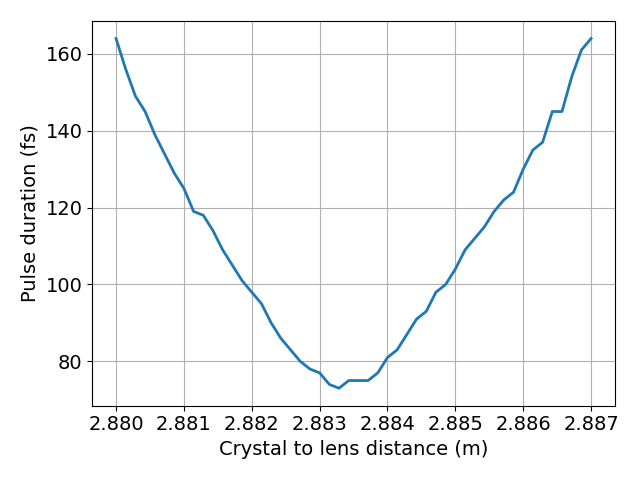

In [15]:

fig_path = '/Users/Matt/OneDrive - SLAC National Accelerator Laboratory/Projects/Tunable Mono/figures/'
plt.figure()
plt.plot(f1, np.abs(duration))
plt.xlabel('Crystal to lens distance (m)')
plt.ylabel('Pulse duration (fs)')
# plt.ylim(0,200)
plt.grid()
plt.savefig(fig_path+'pulse_duration.png')

In [2]:
lambda0 = 1239.8/9000*1e-9
phase = 80
path = phase*lambda0/2/np.pi

In [3]:
print(path)

1.7539582084029499e-09


In [8]:
1/(1/6+1/3)

2.0

In [34]:
37/20

1.85

In [11]:
400/8

50.0

In [32]:
9*2/20

0.9

In [45]:
np.pi*(10e-6)**2/b1.lambda0

4.509166097001966